In [3]:
import ipdb
import numpy as np
import xarray as xr
import matplotlib.pyplot as plt
import pandas as pd
import matplotlib.pylab as pylab
import cartopy
import cartopy.crs as ccrs
from utils import constants as cnst
from eod import msg
from utils import u_grid, u_interpolate as u_int, u_darrays as uda, u_arrays as ua
import datetime
import matplotlib.colors as mcolors
from cartopy.io.shapereader import Reader
from cartopy.feature import ShapelyFeature
from utils import u_plot as uplot
import salem
import numpy.ma as ma
from scipy import stats, ndimage
import warnings
from scipy.ndimage.measurements import label
import pickle as pkl
import matplotlib.patches as patches


pylab.rcParams['figure.figsize'] = (50., 50.)
%matplotlib inline

In [2]:
cd ..

/home/ck/pythonWorkspace/proj_CEH


In [4]:
fpath = cnst.network_data + 'figs/HUARAZ/'

In [5]:
def readERA(var):

    u200orig = xr.open_dataset('/media/ck/Elements/SouthAmerica/ERA5/hourly/'+var+'_15UTC_1981-2019_peru_big.nc')
    u200orig = uda.flip_lat(u200orig)
    datetimes = pd.to_datetime(u200orig.time.values)
    newtimes = []
    for t in datetimes:
        newtimes.append(t.replace(hour=0))
    u200orig['time'] = ('time', newtimes)
    return u200orig

In [6]:
era = readERA('u200')
era = era.sel(latitude=slice(-25,0), longitude=slice(-81,-65))

In [7]:
era850 = readERA('v850')
era850 = era850.sel(latitude=slice(-25,0), longitude=slice(-81,-65)).load()

In [8]:
topo = xr.open_dataarray(cnst.TOPO_1MIN).sel(lon=slice(-81,-65), lat=slice(-25,0))
topo_on_g = era850.salem.lookup_transform(topo)

In [9]:
tir_on_era = xr.open_mfdataset('/home/ck/DIR/mymachine/GRIDSAT/MCS18_peru/daily_-15ALLkm2_UTC_DAY_onBIGERA/*.nc',
                                combine='nested', concat_dim='time')
tir_doypick = tir_on_era['tir'].sel(time=((tir_on_era['time.year']>=1985)&(tir_on_era['time.year']<=2018))).sel(latitude=slice(-25,0), longitude=slice(-81,-65))
tir_monthly = tir_doypick.resample(time = '1m').mean()

In [50]:
ch_on_era = xr.open_mfdataset('/media/ck/Elements/SouthAmerica/CHIRPS/SA_daily_onERA/CHIRPS_daily_onERA_*.nc').chunk({'time':365})
chirps_doypick = ch_on_era['precip'].sel(time=((ch_on_era['time.year']>=1985)&(ch_on_era['time.year']<=2018))).sel(latitude=slice(-25,0), longitude=slice(-81,-65)).where(topo_on_g>=2000)
chirps_bimod = chirps_doypick#.rolling(time=30, min_periods=3, center=True).mean()#.where((chirps_doypick['time.month']!=8))
chirps_monthly = chirps_doypick.resample(time = '1m').mean()

In [11]:
# regions = {
# 'equatorial' : [(-5,0)],
# 'transition' : [(-8,-5)],
# 'central' : [(-12,-8)],
# 'southern' : [(-18,-15)]}
# h = 2000
fname = '/home/ck/DIR/cornkle/data/HUARAZ/shapes/riosan_sel_one.shp'
sdf = salem.read_shapefile(fname)
sdf = salem.transform_geopandas(sdf, to_crs=salem.wgs84)

In [73]:
regions = {
#'equatorial' : [(-5,0)],
#'transition' : [(-8,-5)],
'central' : [(-12,-8)],
'southern' : [(-18,-15)],
'northern' : [(-8,0)],}
#'RioSanta' : [sdf]}
h = 2000

In [74]:
rdic = pkl.load(open("/home/ck/DIR/cornkle/data/HUARAZ/saves/corr_GRIDSAT-15_start_end_regionMean.p", "rb"))
for r in regions.keys():
    if r == "RioSanta":
        #ipdb.set_trace()
        regions[r].append(rdic['central'][1])
    elif r == "northern":
        regions[r].append(rdic['transition'][1])    
    else:
        regions[r].append(rdic[r][1])

In [14]:
corrdic = pkl.load(open(cnst.network_data + 'data/HUARAZ/saves/corr_GRIDSAT-15_start_end.p', "rb"))

In [15]:
corr_start = corrdic['start_3d']
corr_end = corrdic['end_5d']

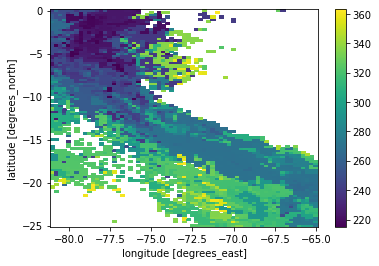

In [16]:
corr_start.plot()

In [17]:
wet_test = xr.open_dataarray('/media/ck/Elements/SouthAmerica/CHIRPS/wet_spells_1mm_3-7days_StartOfSpell.nc')

In [18]:
dry_test = xr.open_dataarray('/media/ck/Elements/SouthAmerica/CHIRPS/dry_spells_1mm_3-7days_StartOfSpell.nc')
alls = regions['central']

In [19]:
vvod = xr.open_mfdataset('/media/ck/Elements/SouthAmerica/VOD/onERA/*.nc').sel(latitude=slice(-25,0), longitude=slice(-81,-65)).load()

In [20]:
ndvi = xr.open_dataset('/media/ck/Elements/SouthAmerica/NDVI/onERA/NDVI_all_times.nc').sel(latitude=slice(-25,0), longitude=slice(-81,-65))

In [21]:
sm = xr.open_mfdataset('/media/ck/Elements/SouthAmerica/SM_CSI_ESA/onERA/*.nc').sel(latitude=slice(-25,0), longitude=slice(-81,-65)).load()
sm = sm['sm'].where(sm<999)

In [77]:
cutd = dry_test # spell
dry_dat = cutd.where(cutd>0)

cutw = wet_test # spell
wet_dat = cutw.where(cutw>0)

chdat = chirps_doypick
chclim = chdat.groupby('time.dayofyear').mean('time').load().rolling(dayofyear=15, min_periods=1, center=True).mean()#.sel(time=cut['time.year']>=2000)
vod_clim = vvod['vod'].sel(time=((vvod['time.year']>=2000) & (vvod['time.year']<=2018))).groupby('time.dayofyear').mean('time').rolling(dayofyear=15, min_periods=1, center=True).mean()
ndvi_clim = ndvi['precip'].groupby('time.dayofyear').mean('time').rolling(dayofyear=3, min_periods=1, center=True).mean()
vod = vvod['vod'].rolling(time=3, min_periods=1, center=True).mean()
vod_diff = vod_clim.max('dayofyear')-vod_clim.min('dayofyear')

sm_clim = sm.sel(time=((sm['time.year']>=2000) & (sm['time.year']<=2018))).groupby('time.dayofyear').mean('time').rolling(dayofyear=15, min_periods=1, center=True).mean()

/home/ck/miniconda3/lib/python3.7/site-packages/dask/array/numpy_compat.py:41: RuntimeWarning: invalid value encountered in true_divide
  x = np.divide(x1, x2, out)


In [65]:
vod_anoms = []
sm_anoms = []
ch_anoms = []

for rrs in ['northern', 'central', 'southern']:
    alls = regions[rrs]
    vodc =  vvod['vod'].sel(time=slice('2000-01','2018-12')).groupby('time.dayofyear').mean('time').rolling(dayofyear=15, min_periods=1, center=True).mean()
    smmc = sm['sm'].sel(time=slice('2000-01','2018-12')).groupby('time.dayofyear').mean('time').rolling(dayofyear=15, min_periods=1, center=True).mean()
    chc = chirps_doypick.sel(time=slice('2000-01','2018-12')).load().groupby('time.dayofyear').mean('time').rolling(dayofyear=15, min_periods=1, center=True).mean()

    vod_anom = (vod.sel(time=slice('2000-01','2018-12')).where((topo_on_g>h)).sel(latitude=slice(alls[0][0], alls[0][1])).mean(['latitude', 'longitude'])).groupby('time.dayofyear')-vodc.where((topo_on_g>h)).sel(latitude=slice(alls[0][0], alls[0][1])).mean(['latitude', 'longitude'])
    sm_anom = (sm['sm'].sel(time=slice('2000-01','2018-12')).where((topo_on_g>h)).sel(latitude=slice(alls[0][0], alls[0][1])).mean(['latitude', 'longitude'])).groupby('time.dayofyear')-smmc.where((topo_on_g>h)).sel(latitude=slice(alls[0][0], alls[0][1])).mean(['latitude', 'longitude'])
    ch_anom = (chirps_doypick.sel(time=slice('2000-01','2018-12')).where((topo_on_g>h)).sel(latitude=slice(alls[0][0], alls[0][1])).mean(['latitude', 'longitude'])).groupby('time.dayofyear')-chc.where((topo_on_g>h)).sel(latitude=slice(alls[0][0], alls[0][1])).mean(['latitude', 'longitude'])
    
    vod_anom = vod_anom.where((vod_anom['time.month'] >=12) | (vod_anom['time.month'] <=3))
    sm_anom = sm_anom.where((sm_anom['time.month'] >=12) | (sm_anom['time.month'] <=3))
    ch_anom = ch_anom.where((sm_anom['time.month'] >=12) | (sm_anom['time.month'] <=3))
    
    vod_anoms.append(vod_anom)
    sm_anoms.append(sm_anom)
    ch_anoms.append(ch_anom)

In [66]:
vod_anom

<xarray.DataArray (time: 6940)>
array([-0.01745924, -0.0132296 , -0.00326242, ...,  0.00607598,
       -0.00193816, -0.00153026])
Coordinates:
  * time       (time) datetime64[ns] 2000-01-01T12:00:00 ... 2018-12-31T12:00:00
    dayofyear  (time) int64 1 2 3 4 5 6 7 8 ... 358 359 360 361 362 363 364 365

In [67]:
from scipy.stats import gaussian_kde
 

def calc_density(v1,v2):

    xy = np.vstack([v1, v2])

    z = gaussian_kde(xy)(xy)

    return z / (z.max() - z.min())

northern -0.16431597190850916 3.3924162010676283e-14
central -0.5857800361852846 9.289449543084693e-201
southern -0.4448686180651645 1.1718343395257765e-109


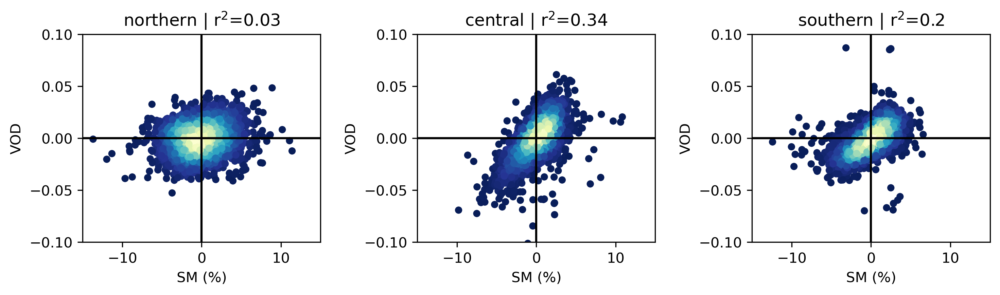

In [89]:
f = plt.figure(figsize=(10,3), dpi=300)

for ids, rrs in enumerate(['northern', 'central', 'southern']):
    
    
#     ax = f.add_subplot(2,3,ids+1)
#     finites = np.isfinite(sm_anoms[ids].values) & np.isfinite(ch_anoms[ids].values)
    
#     #ipdb.set_trace()
    
#     var1 = sm_anoms[ids][finites]
#     var2 = ch_anoms[ids][finites]
    
#     slope, inter, rval, pval, stderr = stats.linregress(var1, var2)
#     print(rrs, rval, pval)
    
#     density = calc_density(var2,var1*-1)
#     plt.scatter( ch_anoms[ids][finites], sm_anoms[ids][finites]*100, c=density, s=17, cmap="YlGnBu_r")
#     plt.xlabel('Precip (mm day$^{-1}$)')
#     plt.ylabel('SM (%)')
#     ax.axhline(0, color='k')
#     ax.axvline(0, color='k')
#     ax.set_xlim(-15,15)
#     ax.set_ylim(-10,10)
#     plt.title(rrs+' | r$^2$='+str(np.round(rval**2,2)))
    
    
    ########################################
    ########################################

    ax = f.add_subplot(1,3,ids+1)
    finites = np.isfinite(sm_anoms[ids].values) & np.isfinite(vod_anoms[ids].values)
    
    #ipdb.set_trace()
    
    var1 = sm_anoms[ids][finites]
    var2 = vod_anoms[ids][finites]
    
    slope, inter, rval, pval, stderr = stats.linregress(var1, var2)
    print(rrs, rval, pval)
    
    density = calc_density(var1,var2*-1)
    plt.scatter(sm_anoms[ids][finites]*100, vod_anoms[ids][finites]*-1, c=density, s=17, cmap="YlGnBu_r")
    plt.ylabel('VOD')
    plt.xlabel('SM (%)')
    ax.axhline(0, color='k')
    ax.axvline(0, color='k')
    ax.set_xlim(-15,15)
    ax.set_ylim(-0.1,0.1)
    plt.title(rrs+' | r$^2$='+str(np.round(rval**2,2)))
    
plt.tight_layout()
f.savefig('/home/ck/DIR/cornkle/figs/HUARAZ/paper/sm_vod_scatter.jpg')

In [27]:
vod_anom

<xarray.DataArray (time: 6940)>
array([-0.01745924, -0.0132296 , -0.00326242, ...,  0.00607598,
       -0.00193816, -0.00153026])
Coordinates:
  * time       (time) datetime64[ns] 2000-01-01T12:00:00 ... 2018-12-31T12:00:00
    dayofyear  (time) int64 1 2 3 4 5 6 7 8 ... 358 359 360 361 362 363 364 365

In [28]:
sm_anom = 

SyntaxError: invalid syntax (<ipython-input-28-dbd86e70a0eb>, line 1)

In [ ]:
plt.plot((vod.sel(time='2007').where((topo_on_g>h)).sel(latitude=slice(alls[0][0], alls[0][1])).mean(['latitude', 'longitude'])).values*-1)

In [ ]:
plt.plot((vod_clim.where((topo_on_g>h)).sel(latitude=slice(alls[0][0], alls[0][1])).mean(['latitude', 'longitude'])).values*-1)

In [31]:
vmonth = vvod['vod'].groupby('time.month').mean('time')
vmonth = vmonth.fillna(0)

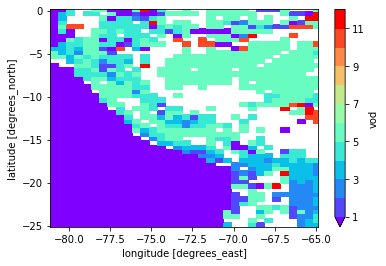

In [32]:
monthmax = vmonth.argmax(dim='month',skipna=True)
monthmax.where((monthmax < 6) | (monthmax > 9)).plot(cmap='rainbow', levels=np.arange(1,13))

In [33]:
vodmask = (monthmax < 6) | (monthmax > 9)

In [ ]:
f = plt.figure(figsize=(9,5),dpi=200)
ax = f.add_subplot(111)
ax1 = ax.twinx()
smclim_collect = {}
vodclim_collect = {}
for region in regions:
    alls = regions[region]
    if region == 'RioSanta':
        clims = vod_clim.where((vodmask) & (topo_on_g>h)).salem.roi(shape=sdf, all_touched=True).mean(['latitude', 'longitude'])*-1
        nclims = chclim.where(topo_on_g>h).salem.roi(shape=sdf, all_touched=True).mean(['latitude', 'longitude'])
        
    else:        
        clims = vod_clim.where((vodmask) & (topo_on_g>h)).sel(latitude=slice(alls[0][0], alls[0][1])).mean(['latitude', 'longitude'])*-1
        nclims = chclim.sel(latitude=slice(alls[0][0], alls[0][1])).where(topo_on_g>h).mean(['latitude', 'longitude'])
    ax.plot(vod_clim.dayofyear, clims - np.mean(clims), label=region+str(np.round(np.mean(nclims.values),2))+'mm/y')#.sel(latitude=-9.3, longitude=-77.5, method='nearest'))
    ax.set_ylabel('VOD daily (X band ~25km)')
    ax1.plot(sm_clim.dayofyear, nclims, label=region, linestyle='dotted')#.sel(latitude=-9.3, longitude=-77.5, method='nearest'), color='g')

    
# ax1.plot(ndvi_clim.dayofyear, ndvi_clim.sel(latitude=-9.5, longitude=-75.5, method='nearest'), color='k')
# ax.plot(vod_clim.dayofyear, vod_clim.sel(latitude=-9.5, longitude=-75.5, method='nearest')-0.7, color='k')
ax1.set_ylabel('NDVI (MOD13C2 4km)')
ax.legend()
ax.axvline(121)
ax.set_title('Climatological seasonal cycle (2000-2018), Huaraz pixel')

Text(0.5, 1.0, 'Climatological seasonal cycle')

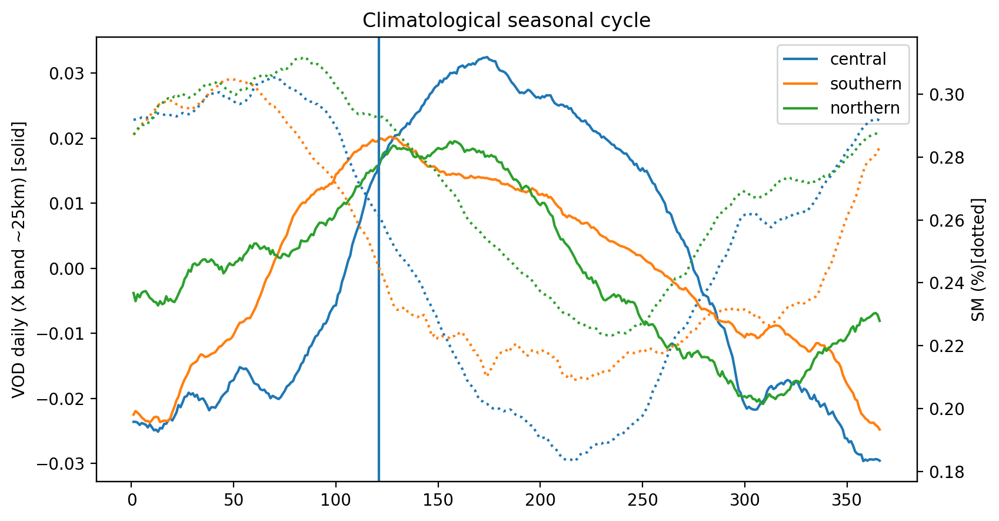

In [87]:
f = plt.figure(figsize=(9,5),dpi=200)
ax = f.add_subplot(111)
ax1 = ax.twinx()
smclim_collect = {}
vodclim_collect = {}
for region in regions:
    alls = regions[region]
    if region == 'RioSanta':
        clims = vod_clim.where((vodmask) & (topo_on_g>h)).salem.roi(shape=sdf, all_touched=True).mean(['latitude', 'longitude'])
        nclims = sm_clim['sm'].where(topo_on_g>h).salem.roi(shape=sdf, all_touched=True).mean(['latitude', 'longitude'])
        
    else:        
        clims = vod_clim.where((vodmask) & (topo_on_g>h)).sel(latitude=slice(alls[0][0], alls[0][1])).mean(['latitude', 'longitude'])
        nclims = sm_clim['sm'].sel(latitude=slice(alls[0][0], alls[0][1])).where(topo_on_g>h).mean(['latitude', 'longitude'])
    ax.plot(vod_clim.dayofyear, clims - np.nanmean(clims), label=region)#.sel(latitude=-9.3, longitude=-77.5, method='nearest'))
    ax.set_ylabel('VOD daily (X band ~25km) [solid]')
    ax1.plot(sm_clim.dayofyear, nclims, label=region, linestyle='dotted')#.sel(latitude=-9.3, longitude=-77.5, method='nearest'), color='g')
    
#     if region == 'southern':
#         ipdb.set_trace()

    smclim_collect[region] = nclims.max()-nclims.min()
    vodclim_collect[region] = clims.max()-clims.min()
    
    
    
# ax1.plot(ndvi_clim.dayofyear, ndvi_clim.sel(latitude=-9.5, longitude=-75.5, method='nearest'), color='k')
# ax.plot(vod_clim.dayofyear, vod_clim.sel(latitude=-9.5, longitude=-75.5, method='nearest')-0.7, color='k')
ax1.set_ylabel('SM (%)[dotted]')
ax.legend()
ax.axvline(121)
ax.set_title('Climatological seasonal cycle')

In [100]:
pkl.dump(smclim_collect, open('/home/ck/DIR/cornkle/data/HUARAZ/saves/climdiff_veg_smcollect.p', 'wb'))

In [101]:
pkl.dump(vodclim_collect, open('/home/ck/DIR/cornkle/data/HUARAZ/saves/climdiff_veg_vodcollect.p', 'wb'))

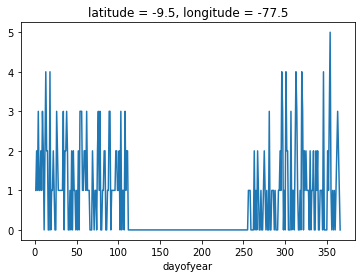

In [32]:
wet_test.where(wet_test==3).groupby('time.dayofyear').count('time').sel(latitude=-9.5, longitude=-77.5, method='nearest').plot()

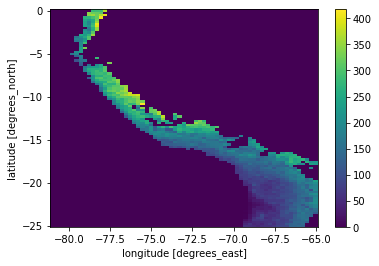

In [33]:
wet_test.where(wet_test==3).count('time').plot()

In [34]:
fname = '/home/ck/DIR/cornkle/data/HUARAZ/shapes/riosan_sel_one.shp'
sdf = salem.read_shapefile(fname)
sdf = salem.transform_geopandas(sdf, to_crs=salem.wgs84)

In [35]:
wet_test

<xarray.DataArray (time: 12418, latitude: 101, longitude: 65)>
array([[[0., 0., ..., 0., 0.],
        [0., 0., ..., 0., 0.],
        ...,
        [0., 0., ..., 0., 0.],
        [0., 0., ..., 0., 0.]],

       [[0., 0., ..., 0., 0.],
        [0., 0., ..., 0., 0.],
        ...,
        [0., 0., ..., 0., 0.],
        [0., 0., ..., 0., 0.]],

       ...,

       [[0., 0., ..., 0., 0.],
        [0., 0., ..., 0., 0.],
        ...,
        [0., 0., ..., 0., 0.],
        [0., 0., ..., 0., 0.]],

       [[0., 0., ..., 0., 0.],
        [0., 0., ..., 0., 0.],
        ...,
        [0., 0., ..., 0., 0.],
        [0., 0., ..., 0., 0.]]], dtype=float32)
Coordinates:
  * time       (time) datetime64[ns] 1985-01-01 1985-01-02 ... 2018-12-31
  * latitude   (latitude) float32 -25.0 -24.75 -24.5 -24.25 ... -0.5 -0.25 0.0
  * longitude  (longitude) float32 -81.0 -80.75 -80.5 ... -65.5 -65.25 -65.0

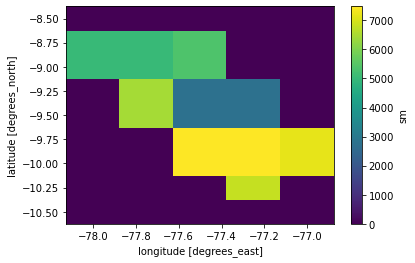

In [282]:
sm['sm'].salem.roi(shape=sdf, all_touched=True).sel(latitude=slice(-10.5,-8.5), longitude= slice(-78,-77), time=wet_test.time).count('time').plot()

In [34]:
def get_clim(spell_dat, vod, vod_clim, spell_length, topo, region='central', syear=2000, datatag='vod'):
    
    regions = {
    'equatorial' : [(-5,0)],
    'transition' : [(-8,-5)],
    'central' : [(-12,-8)],
    'southern' : [(-18,-15)],
    'northern' : [(-8,0)]}
    h = 2000

    
    alls = regions[region]

    sp = spell_dat.where((topo>h)).sel(latitude=slice(alls[0][0], alls[0][1])) #& ((spell_dat['time.month']>=12) | (spell_dat['time.month']<=3)

    vo = vod.where((vodmask) & (topo_on_g>h)).sel(latitude=slice(alls[0][0], alls[0][1]))
    vo_clim = vod_clim.where((vodmask) & (topo_on_g>h)).sel(latitude=slice(alls[0][0], alls[0][1]))
    
    ns = 30
    
    errlistv = None
    errlistc = None
    isnb = 0
    for ix, x in enumerate(sp.longitude):
        for iy, y in enumerate(sp.latitude):
                print('Doing', x.values, y.values)
                dates = sp.sel(time=sp['time.year']>=syear, latitude=y, longitude=x, method='nearest') # chirps
                
                if np.sum(np.isnan(dates.values)) == dates.shape: # if entire timeseries in nan, go to next pixel
                    print('Allnan, continue')
                    continue
                    
                d3 = dates[(dates==spell_length)]
                
                for dd in d3.time:

                    dd = pd.Timestamp(dd.values)
                    if datatag == 'vod':
                        dtime = dd.replace(hour=12)
                    else:
                        dtime = dd
                        
                    dtime2 = dtime + pd.Timedelta('27 days')
                    dtime1 = dtime - pd.Timedelta('2 days')
                    chdtime1 =  dtime - pd.Timedelta('3 days') # because chirps hour is 00 and vod hour is 12, dtime (at 12) - 1day is missing 12 hours if not day+1 is removed for chirps
                    
                    if datatag =='vod':
                        chdtime1 =  dtime - pd.Timedelta('3 days')
                    else:
                        chdtime1 = dtime1
                        
                    if dtime2.dayofyear - dtime1.dayofyear < 0:
                        print('doy error')
                        continue
                    if dtime1.dayofyear < dtime2.dayofyear:
                        ntime = vo.sel(time=((vo['time.dayofyear']>=dtime1.dayofyear) & (vo['time.dayofyear']<=dtime2.dayofyear))).sel(latitude=y, longitude=x)   
                    else:
                        ntime = vo.sel(time=((vo['time.dayofyear']>=dtime1.dayofyear) | (vo['time.dayofyear']<=dtime2.dayofyear))).sel(latitude=y, longitude=x)

                    #ipdb.set_trace()
                    nclim = vo_clim.sel(dayofyear=slice(dtime1.dayofyear,dtime2.dayofyear)).sel(latitude=y, longitude=x)
                    try:
                        ntime = np.reshape(ntime.values, (-1,ns))
                    except:
                        continue
                    #ipdb.set_trace()
                    if errlistv is not None:
                        errlistv = np.vstack((errlistv,ntime)) 
                    else:
                        errlistv = ntime
                        
                    if errlistc is not None:
                        errlistc = np.vstack((errlistc,nclim.values)) 
                    else:
                        errlistc = nclim.values

                                          
                    print('Doing', isnb)
                    isnb +=1
                               
    return errlistv, errlistc

In [36]:
pclim_smw, mclim_smw =  get_clim(wet_dat, sm['sm'], sm_clim['sm'], 3, topo_on_g, datatag='sm', region='central', syear=2005)
pkl.dump((pclim_smw, mclim_smw), open('/home/ck/DIR/cornkle/data/HUARAZ/saves/veg_sm_central_clim_3w.p', 'wb'))

pclim_smw, mclim_smw =  get_clim(wet_dat, sm['sm'], sm_clim['sm'], 5, topo_on_g, datatag='sm', region='central', syear=2005)
pkl.dump((pclim_smw, mclim_smw), open('/home/ck/DIR/cornkle/data/HUARAZ/saves/veg_sm_central_clim_5w.p', 'wb'))

pclim_smw, mclim_smw =  get_clim(wet_dat, sm['sm'], sm_clim['sm'], 7, topo_on_g, datatag='sm', region='central', syear=2005)
pkl.dump((pclim_smw, mclim_smw), open('/home/ck/DIR/cornkle/data/HUARAZ/saves/veg_sm_central_clim_7w.p', 'wb'))

Doing -81.0 -12.0
Allnan, continue
Doing -81.0 -11.75
Allnan, continue
Doing -81.0 -11.5
Allnan, continue
Doing -81.0 -11.25
Allnan, continue
Doing -81.0 -11.0
Allnan, continue
Doing -81.0 -10.75
Allnan, continue
Doing -81.0 -10.5
Allnan, continue
Doing -81.0 -10.25
Allnan, continue
Doing -81.0 -10.0
Allnan, continue
Doing -81.0 -9.75
Allnan, continue
Doing -81.0 -9.5
Allnan, continue
Doing -81.0 -9.25
Allnan, continue
Doing -81.0 -9.0
Allnan, continue
Doing -81.0 -8.75
Allnan, continue
Doing -81.0 -8.5
Allnan, continue
Doing -81.0 -8.25
Allnan, continue
Doing -81.0 -8.0
Allnan, continue
Doing -80.75 -12.0
Allnan, continue
Doing -80.75 -11.75
Allnan, continue
Doing -80.75 -11.5
Allnan, continue
Doing -80.75 -11.25
Allnan, continue
Doing -80.75 -11.0
Allnan, continue
Doing -80.75 -10.75
Allnan, continue
Doing -80.75 -10.5
Allnan, continue
Doing -80.75 -10.25
Allnan, continue
Doing -80.75 -10.0
Allnan, continue
Doing -80.75 -9.75
Allnan, continue
Doing -80.75 -9.5
Allnan, continue
Doing 

Doing 149
Doing 150
Doing 151
Doing 152
Doing 153
Doing 154
Doing 155
Doing 156
Doing 157
Doing 158
Doing 159
Doing 160
Doing 161
Doing 162
Doing 163
Doing 164
Doing 165
Doing 166
Doing 167
Doing 168
doy error
Doing 169
Doing 170
Doing 171
Doing 172
Doing 173
Doing 174
doy error
Doing 175
Doing 176
Doing 177
Doing 178
Doing 179
Doing 180
Doing 181
Doing 182
Doing 183
Doing 184
Doing 185
Doing 186
Doing 187
Doing 188
Doing 189
Doing 190
Doing 191
Doing 192
Doing 193
Doing 194
Doing 195
Doing -78.25 -8.25
Doing 196
Doing 197
Doing 198
Doing 199
doy error
Doing 200
Doing 201
Doing 202
Doing 203
Doing 204
doy error
doy error
Doing 205
Doing 206
Doing 207
Doing 208
doy error
Doing 209
Doing 210
Doing 211
Doing 212
Doing 213
Doing 214
Doing 215
Doing 216
Doing 217
Doing 218
Doing 219
Doing 220
Doing 221
Doing 222
Doing 223
Doing 224
Doing 225
Doing 226
doy error
doy error
Doing 227
Doing 228
Doing 229
Doing 230
doy error
doy error
Doing 231
Doing 232
Doing 233
Doing 234
Doing 235
Doing 236
D

Doing 834
Doing 835
doy error
doy error
Doing 836
Doing 837
Doing 838
doy error
Doing 839
Doing 840
Doing 841
Doing 842
Doing 843
Doing 844
Doing 845
Doing 846
Doing 847
Doing 848
Doing 849
Doing 850
Doing 851
Doing 852
Doing 853
doy error
Doing 854
Doing 855
Doing 856
Doing 857
doy error
Doing 858
Doing 859
Doing 860
Doing 861
doy error
Doing 862
Doing 863
Doing 864
Doing 865
Doing 866
Doing 867
Doing 868
Doing 869
Doing 870
doy error
doy error
Doing 871
Doing 872
Doing 873
doy error
Doing 874
Doing 875
Doing 876
doy error
Doing 877
Doing 878
Doing 879
Doing 880
doy error
Doing -77.75 -9.5
Doing 881
Doing 882
Doing 883
Doing 884
Doing 885
Doing 886
doy error
doy error
Doing 887
Doing 888
Doing 889
Doing 890
Doing 891
doy error
Doing 892
Doing 893
Doing 894
Doing 895
Doing 896
Doing 897
doy error
doy error
doy error
Doing 898
Doing 899
Doing 900
Doing 901
Doing 902
Doing 903
Doing 904
Doing 905
Doing 906
Doing 907
Doing 908
Doing 909
Doing 910
Doing 911
Doing 912
Doing 913
Doing 914
Do

Doing 1517
Doing 1518
Doing 1519
Doing 1520
Doing 1521
Doing 1522
Doing 1523
Doing 1524
Doing 1525
doy error
doy error
Doing 1526
Doing 1527
Doing 1528
Doing 1529
Doing 1530
doy error
Doing 1531
Doing 1532
Doing 1533
Doing 1534
Doing 1535
Doing 1536
Doing 1537
Doing 1538
Doing 1539
Doing 1540
Doing -77.5 -12.0
Allnan, continue
Doing -77.5 -11.75
Allnan, continue
Doing -77.5 -11.5
Allnan, continue
Doing -77.5 -11.25
Allnan, continue
Doing -77.5 -11.0
Allnan, continue
Doing -77.5 -10.75
Allnan, continue
Doing -77.5 -10.5
Allnan, continue
Doing -77.5 -10.25
Doing 1541
Doing 1542
Doing 1543
Doing 1544
Doing 1545
Doing 1546
Doing 1547
Doing 1548
Doing 1549
doy error
Doing 1550
Doing 1551
Doing 1552
Doing 1553
Doing 1554
Doing 1555
Doing 1556
Doing 1557
Doing 1558
Doing 1559
Doing 1560
Doing 1561
Doing 1562
Doing 1563
doy error
Doing 1564
Doing 1565
doy error
doy error
Doing 1566
Doing 1567
Doing 1568
Doing 1569
Doing 1570
Doing 1571
Doing 1572
Doing 1573
Doing 1574
Doing 1575
Doing 1576
Doi

Doing 2159
Doing 2160
Doing 2161
Doing 2162
Doing 2163
doy error
Doing 2164
Doing 2165
Doing 2166
Doing 2167
Doing 2168
Doing 2169
doy error
doy error
Doing 2170
Doing 2171
Doing 2172
Doing 2173
Doing 2174
Doing 2175
Doing 2176
Doing 2177
Doing 2178
Doing 2179
doy error
Doing 2180
Doing 2181
Doing 2182
Doing 2183
Doing 2184
Doing 2185
Doing 2186
Doing 2187
Doing 2188
Doing 2189
Doing 2190
Doing 2191
Doing 2192
Doing 2193
Doing 2194
Doing 2195
Doing 2196
Doing 2197
Doing 2198
Doing 2199
Doing 2200
Doing -77.5 -8.5
Doing 2201
Doing 2202
Doing 2203
Doing 2204
Doing 2205
Doing 2206
Doing 2207
Doing 2208
Doing 2209
Doing 2210
Doing 2211
Doing 2212
Doing 2213
Doing 2214
doy error
doy error
Doing 2215
Doing 2216
Doing 2217
doy error
Doing 2218
Doing 2219
Doing 2220
Doing 2221
doy error
Doing 2222
Doing 2223
Doing 2224
Doing 2225
Doing 2226
Doing 2227
Doing 2228
Doing 2229
Doing 2230
Doing 2231
Doing 2232
Doing 2233
Doing 2234
Doing 2235
Doing 2236
Doing 2237
Doing 2238
doy error
doy error
Doi

Doing 2806
Doing 2807
Doing 2808
Doing 2809
Doing 2810
Doing 2811
Doing 2812
Doing 2813
Doing 2814
Doing 2815
Doing 2816
Doing 2817
Doing 2818
Doing 2819
Doing 2820
doy error
Doing 2821
Doing 2822
Doing 2823
Doing 2824
Doing 2825
Doing 2826
Doing 2827
Doing 2828
Doing 2829
Doing 2830
Doing 2831
Doing 2832
Doing 2833
Doing 2834
Doing 2835
Doing -77.25 -9.75
Doing 2836
Doing 2837
Doing 2838
Doing 2839
Doing 2840
Doing 2841
Doing 2842
Doing 2843
Doing 2844
Doing 2845
Doing 2846
Doing 2847
doy error
Doing 2848
Doing 2849
Doing 2850
Doing 2851
Doing 2852
Doing 2853
Doing 2854
Doing 2855
Doing 2856
Doing 2857
Doing 2858
Doing 2859
Doing 2860
Doing 2861
Doing 2862
Doing 2863
Doing 2864
Doing 2865
Doing 2866
Doing 2867
Doing 2868
Doing 2869
Doing 2870
Doing 2871
Doing 2872
Doing 2873
Doing 2874
doy error
Doing 2875
Doing 2876
Doing 2877
Doing 2878
Doing 2879
Doing 2880
Doing 2881
Doing 2882
Doing 2883
Doing 2884
doy error
doy error
Doing 2885
Doing 2886
Doing 2887
Doing 2888
Doing 2889
Doing 2

Doing 3461
Doing 3462
Doing -77.25 -8.25
Doing 3463
Doing 3464
Doing 3465
Doing 3466
Doing 3467
Doing 3468
Doing 3469
Doing 3470
Doing 3471
Doing 3472
Doing 3473
Doing 3474
Doing 3475
Doing 3476
Doing 3477
Doing 3478
Doing 3479
Doing 3480
Doing 3481
Doing 3482
Doing 3483
Doing 3484
Doing 3485
Doing 3486
Doing 3487
Doing 3488
doy error
doy error
Doing 3489
Doing 3490
Doing 3491
Doing 3492
Doing 3493
Doing 3494
doy error
doy error
doy error
Doing 3495
Doing 3496
Doing 3497
Doing 3498
Doing 3499
doy error
doy error
Doing 3500
Doing 3501
Doing 3502
Doing 3503
Doing 3504
Doing 3505
Doing 3506
Doing 3507
Doing 3508
Doing 3509
doy error
doy error
Doing 3510
Doing 3511
Doing 3512
Doing 3513
Doing 3514
Doing 3515
Doing 3516
Doing 3517
Doing 3518
Doing 3519
Doing 3520
Doing 3521
Doing 3522
Doing 3523
Doing 3524
Doing 3525
Doing 3526
Doing 3527
Doing 3528
Doing 3529
Doing 3530
Doing 3531
Doing 3532
Doing 3533
Doing 3534
doy error
doy error
doy error
Doing 3535
Doing 3536
Doing 3537
Doing 3538
Doi

Doing 4092
Doing 4093
Doing 4094
Doing 4095
Doing 4096
Doing 4097
Doing 4098
Doing 4099
doy error
Doing 4100
Doing 4101
Doing 4102
Doing 4103
Doing 4104
Doing 4105
doy error
doy error
Doing 4106
Doing 4107
Doing 4108
Doing 4109
Doing 4110
Doing 4111
Doing 4112
Doing 4113
doy error
doy error
Doing 4114
Doing 4115
Doing 4116
Doing 4117
Doing 4118
Doing 4119
Doing 4120
Doing 4121
Doing -77.0 -10.0
Doing 4122
Doing 4123
Doing 4124
Doing 4125
Doing 4126
doy error
Doing 4127
Doing 4128
Doing 4129
Doing 4130
Doing 4131
Doing 4132
Doing 4133
Doing 4134
Doing 4135
Doing 4136
Doing 4137
Doing 4138
Doing 4139
Doing 4140
Doing 4141
Doing 4142
Doing 4143
Doing 4144
Doing 4145
Doing 4146
Doing 4147
Doing 4148
Doing 4149
Doing 4150
Doing 4151
Doing 4152
Doing 4153
Doing 4154
doy error
Doing 4155
Doing 4156
Doing 4157
Doing 4158
Doing 4159
Doing 4160
Doing 4161
Doing 4162
Doing 4163
Doing 4164
Doing 4165
Doing 4166
Doing 4167
Doing 4168
Doing 4169
Doing 4170
Doing 4171
Doing 4172
Doing 4173
Doing 4174

Doing 4752
Doing 4753
Doing 4754
Doing 4755
Doing 4756
Doing 4757
Doing 4758
Doing 4759
Doing 4760
doy error
doy error
doy error
Doing 4761
Doing 4762
Doing 4763
Doing 4764
Doing 4765
Doing 4766
doy error
doy error
Doing 4767
Doing 4768
Doing 4769
Doing 4770
Doing 4771
Doing 4772
Doing 4773
Doing 4774
Doing 4775
Doing 4776
Doing 4777
Doing 4778
Doing 4779
Doing 4780
Doing 4781
Doing 4782
Doing 4783
doy error
Doing 4784
Doing 4785
Doing 4786
Doing 4787
Doing 4788
Doing 4789
Doing 4790
doy error
doy error
Doing 4791
Doing 4792
Doing 4793
Doing 4794
Doing 4795
Doing 4796
Doing 4797
Doing 4798
doy error
Doing -77.0 -8.5
Doing 4799
Doing 4800
Doing 4801
Doing 4802
Doing 4803
doy error
doy error
Doing 4804
Doing 4805
Doing 4806
Doing 4807
Doing 4808
Doing 4809
Doing 4810
Doing 4811
Doing 4812
Doing 4813
Doing 4814
doy error
doy error
Doing 4815
Doing 4816
Doing 4817
Doing 4818
Doing 4819
Doing 4820
Doing 4821
Doing 4822
Doing 4823
Doing 4824
Doing 4825
doy error
Doing 4826
Doing 4827
Doing 4

Doing 5391
Doing 5392
Doing 5393
Doing 5394
doy error
Doing 5395
Doing 5396
Doing 5397
Doing 5398
doy error
Doing 5399
Doing 5400
Doing 5401
Doing 5402
Doing 5403
Doing 5404
Doing 5405
doy error
doy error
Doing 5406
Doing 5407
Doing 5408
Doing 5409
Doing 5410
Doing 5411
Doing 5412
Doing 5413
Doing 5414
Doing 5415
Doing 5416
Doing 5417
Doing 5418
Doing 5419
Doing 5420
doy error
Doing 5421
Doing 5422
Doing 5423
Doing 5424
Doing 5425
Doing 5426
Doing 5427
doy error
doy error
Doing 5428
Doing 5429
Doing 5430
Doing 5431
Doing 5432
Doing 5433
Doing 5434
doy error
doy error
Doing 5435
Doing 5436
Doing 5437
Doing 5438
doy error
Doing 5439
Doing 5440
Doing 5441
Doing 5442
doy error
doy error
doy error
Doing 5443
Doing 5444
Doing 5445
Doing 5446
Doing 5447
Doing 5448
Doing 5449
Doing 5450
Doing 5451
Doing 5452
doy error
Doing 5453
Doing 5454
Doing 5455
Doing 5456
Doing 5457
Doing 5458
Doing 5459
Doing 5460
Doing 5461
Doing 5462
Doing 5463
Doing 5464
Doing 5465
Doing 5466
Doing 5467
Doing 5468
Do

Doing 6036
Doing 6037
Doing 6038
Doing 6039
doy error
doy error
Doing 6040
Doing 6041
Doing 6042
Doing 6043
Doing 6044
Doing 6045
Doing 6046
Doing 6047
Doing 6048
doy error
doy error
Doing 6049
Doing 6050
Doing 6051
Doing 6052
Doing 6053
Doing 6054
Doing 6055
Doing 6056
Doing 6057
Doing 6058
Doing 6059
Doing 6060
Doing 6061
Doing 6062
Doing 6063
Doing 6064
Doing 6065
Doing 6066
Doing 6067
Doing 6068
Doing 6069
doy error
Doing 6070
Doing 6071
Doing 6072
Doing 6073
doy error
Doing 6074
Doing 6075
Doing 6076
doy error
Doing 6077
Doing 6078
Doing 6079
Doing 6080
Doing 6081
Doing 6082
Doing 6083
Doing 6084
Doing 6085
doy error
Doing 6086
Doing 6087
Doing 6088
Doing 6089
Doing 6090
Doing 6091
doy error
Doing 6092
Doing 6093
Doing 6094
Doing 6095
Doing 6096
Doing 6097
Doing 6098
Doing 6099
Doing 6100
doy error
Doing 6101
Doing 6102
Doing 6103
Doing 6104
Doing 6105
Doing 6106
Doing 6107
Doing 6108
Doing 6109
Doing 6110
Doing 6111
Doing 6112
Doing 6113
Doing 6114
doy error
Doing -76.75 -9.25
Do

Doing 6671
Doing 6672
Doing 6673
Doing 6674
doy error
Doing 6675
Doing 6676
Doing 6677
Doing 6678
Doing 6679
Doing 6680
Doing 6681
Doing 6682
Doing 6683
doy error
doy error
doy error
Doing 6684
Doing 6685
Doing 6686
Doing 6687
Doing 6688
Doing 6689
Doing 6690
Doing 6691
doy error
Doing 6692
Doing 6693
Doing 6694
Doing 6695
Doing 6696
Doing 6697
Doing 6698
Doing 6699
Doing 6700
Doing 6701
Doing 6702
Doing 6703
doy error
doy error
doy error
Doing 6704
Doing 6705
Doing 6706
doy error
Doing 6707
Doing 6708
Doing 6709
Doing 6710
doy error
doy error
Doing 6711
Doing 6712
Doing 6713
Doing 6714
Doing 6715
Doing 6716
Doing 6717
Doing 6718
Doing 6719
Doing 6720
Doing 6721
Doing 6722
Doing 6723
Doing 6724
doy error
Doing -76.5 -11.25
Doing 6725
Doing 6726
Doing 6727
Doing 6728
Doing 6729
Doing 6730
Doing 6731
Doing 6732
Doing 6733
Doing 6734
Doing 6735
Doing 6736
Doing 6737
Doing 6738
Doing 6739
doy error
Doing 6740
Doing 6741
Doing 6742
Doing 6743
Doing 6744
Doing 6745
Doing 6746
Doing 6747
Doin

Doing 7310
doy error
doy error
Doing 7311
Doing 7312
Doing 7313
Doing 7314
Doing 7315
Doing 7316
Doing 7317
Doing 7318
Doing 7319
Doing 7320
doy error
Doing 7321
Doing 7322
Doing 7323
Doing 7324
Doing 7325
Doing 7326
Doing 7327
doy error
Doing 7328
Doing 7329
Doing 7330
Doing 7331
Doing 7332
Doing 7333
Doing 7334
Doing 7335
Doing 7336
doy error
Doing 7337
Doing 7338
Doing 7339
Doing 7340
Doing 7341
Doing 7342
Doing 7343
Doing 7344
Doing 7345
Doing 7346
Doing 7347
doy error
Doing 7348
Doing 7349
Doing 7350
Doing 7351
Doing 7352
Doing 7353
Doing 7354
Doing 7355
Doing 7356
Doing 7357
Doing 7358
doy error
doy error
Doing -76.5 -9.75
Doing 7359
Doing 7360
Doing 7361
Doing 7362
Doing 7363
Doing 7364
Doing 7365
Doing 7366
doy error
Doing 7367
Doing 7368
Doing 7369
Doing 7370
Doing 7371
Doing 7372
Doing 7373
Doing 7374
Doing 7375
Doing 7376
Doing 7377
Doing 7378
Doing 7379
Doing 7380
Doing 7381
Doing 7382
Doing 7383
Doing 7384
Doing 7385
Doing 7386
Doing 7387
Doing 7388
Doing 7389
Doing 7390
d

Doing 7951
Doing 7952
Doing 7953
Doing 7954
Doing 7955
Doing 7956
Doing 7957
Doing 7958
Doing 7959
doy error
Doing 7960
Doing 7961
Doing 7962
Doing 7963
Doing 7964
Doing 7965
Doing 7966
Doing 7967
Doing 7968
Doing 7969
Doing 7970
Doing 7971
Doing 7972
Doing 7973
Doing 7974
Doing 7975
Doing 7976
Doing 7977
doy error
doy error
Doing 7978
Doing 7979
Doing 7980
Doing 7981
Doing 7982
Doing 7983
Doing 7984
doy error
Doing 7985
Doing 7986
Doing 7987
Doing 7988
Doing 7989
Doing 7990
Doing 7991
Doing 7992
Doing 7993
Doing 7994
Doing 7995
Doing 7996
Doing 7997
Doing 7998
Doing 7999
Doing 8000
Doing 8001
Doing 8002
Doing 8003
Doing 8004
doy error
Doing 8005
Doing 8006
Doing 8007
Doing 8008
Doing 8009
Doing 8010
Doing 8011
Doing 8012
Doing 8013
doy error
Doing 8014
Doing 8015
Doing 8016
Doing 8017
Doing 8018
Doing 8019
Doing 8020
Doing 8021
Doing 8022
Doing 8023
Doing 8024
Doing 8025
Doing 8026
Doing 8027
doy error
Doing -76.5 -8.5
Allnan, continue
Doing -76.5 -8.25
Allnan, continue
Doing -76.5 -8

Doing 8592
Doing 8593
Doing 8594
Doing 8595
Doing 8596
doy error
doy error
Doing 8597
Doing 8598
Doing 8599
Doing 8600
Doing 8601
Doing 8602
Doing 8603
doy error
doy error
Doing 8604
Doing 8605
Doing 8606
Doing 8607
Doing 8608
Doing 8609
doy error
Doing 8610
Doing 8611
Doing 8612
Doing 8613
Doing 8614
Doing 8615
Doing 8616
Doing 8617
Doing 8618
Doing 8619
Doing 8620
doy error
Doing 8621
Doing 8622
Doing 8623
Doing 8624
Doing 8625
Doing 8626
doy error
doy error
doy error
doy error
Doing 8627
Doing 8628
Doing 8629
Doing 8630
Doing 8631
Doing 8632
doy error
Doing 8633
Doing 8634
Doing 8635
Doing 8636
Doing 8637
Doing 8638
Doing 8639
Doing 8640
Doing 8641
Doing 8642
Doing 8643
Doing 8644
Doing 8645
Doing 8646
Doing 8647
Doing 8648
Doing 8649
doy error
Doing 8650
Doing 8651
Doing 8652
Doing 8653
Doing 8654
Doing 8655
Doing 8656
Doing 8657
Doing 8658
Doing 8659
doy error
Doing -76.25 -10.5
doy error
Doing 8660
Doing 8661
Doing 8662
Doing 8663
Doing 8664
Doing 8665
Doing 8666
doy error
Doing 

Doing 9227
Doing 9228
Doing 9229
Doing 9230
Doing 9231
Doing 9232
Doing 9233
Doing 9234
Doing 9235
doy error
doy error
doy error
Doing 9236
Doing 9237
Doing 9238
Doing 9239
Doing 9240
Doing 9241
Doing 9242
Doing 9243
Doing 9244
Doing 9245
Doing 9246
Doing 9247
Doing 9248
Doing 9249
Doing 9250
Doing 9251
Doing 9252
Doing 9253
doy error
doy error
Doing 9254
Doing 9255
Doing 9256
Doing 9257
Doing 9258
Doing 9259
Doing 9260
Doing 9261
Doing 9262
Doing 9263
Doing 9264
Doing 9265
Doing 9266
Doing 9267
Doing 9268
Doing 9269
Doing 9270
Doing 9271
Doing 9272
Doing 9273
Doing 9274
Doing 9275
Doing 9276
Doing 9277
Doing 9278
Doing 9279
Doing 9280
Doing 9281
Doing 9282
doy error
doy error
doy error
Doing 9283
Doing 9284
Doing 9285
Doing 9286
Doing 9287
Doing 9288
Doing 9289
Doing 9290
Doing 9291
Doing 9292
Doing 9293
Doing 9294
doy error
doy error
doy error
Doing -76.25 -9.25
Allnan, continue
Doing -76.25 -9.0
Allnan, continue
Doing -76.25 -8.75
Allnan, continue
Doing -76.25 -8.5
Allnan, continue


Doing 9839
Doing 9840
Doing 9841
Doing 9842
Doing 9843
Doing 9844
Doing 9845
Doing 9846
Doing 9847
Doing 9848
Doing 9849
Doing 9850
Doing 9851
Doing 9852
doy error
Doing 9853
Doing 9854
Doing 9855
Doing 9856
Doing 9857
Doing 9858
Doing 9859
Doing 9860
Doing 9861
Doing 9862
Doing 9863
Doing 9864
Doing 9865
Doing 9866
Doing -76.0 -10.0
doy error
Doing 9867
Doing 9868
Doing 9869
Doing 9870
Doing 9871
Doing 9872
Doing 9873
Doing 9874
Doing 9875
Doing 9876
Doing 9877
doy error
doy error
Doing 9878
Doing 9879
Doing 9880
Doing 9881
Doing 9882
Doing 9883
Doing 9884
Doing 9885
Doing 9886
Doing 9887
Doing 9888
doy error
doy error
Doing 9889
Doing 9890
Doing 9891
Doing 9892
Doing 9893
Doing 9894
Doing 9895
Doing 9896
Doing 9897
Doing 9898
Doing 9899
Doing 9900
Doing 9901
Doing 9902
doy error
doy error
doy error
doy error
Doing 9903
Doing 9904
Doing 9905
Doing 9906
Doing 9907
Doing 9908
Doing 9909
Doing 9910
Doing 9911
Doing 9912
doy error
doy error
doy error
Doing 9913
Doing 9914
Doing 9915
Doing

Doing 10425
Doing 10426
doy error
doy error
doy error
Doing 10427
Doing 10428
Doing 10429
Doing 10430
doy error
doy error
Doing 10431
Doing 10432
Doing 10433
doy error
Doing 10434
Doing 10435
Doing 10436
Doing 10437
doy error
doy error
Doing 10438
Doing 10439
Doing 10440
Doing 10441
doy error
doy error
Doing 10442
Doing 10443
Doing 10444
doy error
doy error
doy error
Doing -75.75 -11.0
doy error
Doing 10445
Doing 10446
Doing 10447
Doing 10448
doy error
doy error
doy error
Doing 10449
Doing 10450
Doing 10451
doy error
doy error
Doing 10452
Doing 10453
Doing 10454
Doing 10455
doy error
doy error
Doing 10456
Doing 10457
Doing 10458
Doing 10459
Doing 10460
doy error
Doing 10461
Doing 10462
Doing 10463
Doing 10464
Doing 10465
Doing 10466
doy error
Doing 10467
Doing 10468
Doing 10469
Doing 10470
Doing 10471
doy error
Doing 10472
Doing 10473
Doing 10474
Doing 10475
Doing 10476
doy error
doy error
doy error
Doing 10477
Doing 10478
Doing 10479
Doing 10480
Doing 10481
Doing 10482
doy error
Doing

Doing 10983
Doing 10984
Doing 10985
Doing 10986
Doing 10987
Doing 10988
Doing 10989
doy error
doy error
doy error
Doing 10990
Doing 10991
Doing 10992
Doing 10993
Doing 10994
Doing 10995
Doing 10996
Doing 10997
Doing 10998
doy error
doy error
Doing 10999
Doing 11000
Doing 11001
Doing 11002
Doing 11003
Doing 11004
Doing 11005
Doing 11006
Doing 11007
Doing 11008
Doing 11009
Doing 11010
Doing 11011
doy error
doy error
Doing 11012
Doing 11013
Doing 11014
Doing 11015
Doing 11016
Doing 11017
Doing 11018
Doing 11019
Doing 11020
Doing 11021
Doing 11022
Doing 11023
doy error
doy error
Doing 11024
Doing 11025
Doing 11026
Doing 11027
Doing 11028
Doing 11029
Doing 11030
Doing 11031
Doing 11032
Doing 11033
Doing 11034
Doing 11035
Doing 11036
Doing 11037
Doing 11038
doy error
Doing 11039
Doing 11040
Doing 11041
Doing 11042
Doing 11043
Doing 11044
Doing 11045
doy error
doy error
Doing 11046
Doing 11047
Doing 11048
Doing 11049
Doing 11050
Doing 11051
Doing 11052
Doing 11053
doy error
doy error
Doing 11

Doing 11532
Doing 11533
Doing 11534
doy error
Doing 11535
Doing 11536
Doing 11537
Doing 11538
Doing 11539
Doing 11540
Doing 11541
doy error
Doing 11542
Doing 11543
Doing 11544
Doing 11545
Doing 11546
Doing 11547
Doing 11548
Doing 11549
Doing 11550
Doing 11551
Doing 11552
Doing 11553
Doing 11554
Doing 11555
Doing 11556
doy error
doy error
Doing 11557
Doing 11558
Doing 11559
Doing 11560
doy error
Doing 11561
Doing 11562
Doing 11563
Doing 11564
Doing 11565
Doing 11566
Doing 11567
Doing 11568
Doing 11569
Doing 11570
doy error
Doing 11571
Doing 11572
Doing 11573
Doing 11574
Doing 11575
Doing 11576
Doing 11577
Doing 11578
Doing 11579
Doing 11580
Doing 11581
Doing 11582
Doing 11583
Doing 11584
Doing 11585
Doing 11586
Doing 11587
Doing 11588
Doing 11589
Doing 11590
Doing 11591
Doing 11592
Doing 11593
doy error
Doing 11594
Doing 11595
Doing 11596
Doing 11597
Doing 11598
Doing 11599
Doing 11600
Doing 11601
Doing 11602
Doing 11603
Doing 11604
doy error
Doing 11605
Doing 11606
Doing 11607
Doing 11

Doing 12043
Doing 12044
Doing 12045
Doing 12046
Doing 12047
doy error
doy error
Doing 12048
Doing 12049
Doing 12050
Doing 12051
Doing 12052
Doing 12053
Doing 12054
Doing 12055
Doing 12056
Doing 12057
Doing 12058
Doing 12059
Doing 12060
Doing 12061
Doing 12062
Doing 12063
Doing 12064
Doing 12065
Doing 12066
Doing 12067
Doing 12068
Doing 12069
Doing 12070
Doing 12071
Doing 12072
doy error
doy error
Doing 12073
Doing 12074
Doing 12075
Doing 12076
Doing 12077
Doing 12078
Doing 12079
Doing 12080
Doing 12081
Doing 12082
Doing 12083
doy error
doy error
doy error
doy error
Doing -75.0 -11.25
Doing 12084
Doing 12085
Doing 12086
Doing 12087
Doing 12088
Doing 12089
Doing 12090
Doing 12091
Doing 12092
Doing 12093
doy error
doy error
doy error
doy error
Doing 12094
Doing 12095
Doing 12096
Doing 12097
Doing 12098
Doing 12099
Doing 12100
Doing 12101
Doing 12102
Doing 12103
Doing 12104
Doing 12105
Doing 12106
Doing 12107
doy error
Doing 12108
Doing 12109
Doing 12110
Doing 12111
Doing 12112
Doing 12113

Doing 12556
Doing 12557
Doing 12558
Doing 12559
Doing 12560
Doing 12561
Doing 12562
Doing 12563
Doing 12564
Doing 12565
Doing 12566
Doing 12567
Doing 12568
Doing 12569
doy error
doy error
doy error
Doing 12570
Doing 12571
Doing 12572
Doing 12573
Doing 12574
Doing 12575
Doing 12576
Doing 12577
Doing 12578
Doing 12579
doy error
doy error
doy error
Doing 12580
Doing 12581
Doing 12582
Doing 12583
Doing 12584
Doing 12585
Doing 12586
Doing 12587
doy error
doy error
Doing 12588
Doing 12589
Doing 12590
Doing 12591
Doing 12592
Doing 12593
Doing 12594
Doing 12595
Doing 12596
Doing 12597
Doing 12598
Doing 12599
Doing 12600
Doing 12601
Doing 12602
Doing 12603
Doing 12604
doy error
doy error
doy error
doy error
Doing 12605
Doing 12606
Doing 12607
Doing 12608
Doing 12609
Doing 12610
Doing 12611
Doing 12612
doy error
Doing 12613
Doing 12614
Doing 12615
Doing 12616
Doing 12617
Doing 12618
doy error
doy error
Doing 12619
Doing 12620
Doing 12621
Doing 12622
Doing 12623
Doing 12624
Doing 12625
doy error


Allnan, continue
Doing -72.5 -10.75
Allnan, continue
Doing -72.5 -10.5
Allnan, continue
Doing -72.5 -10.25
Allnan, continue
Doing -72.5 -10.0
Allnan, continue
Doing -72.5 -9.75
Allnan, continue
Doing -72.5 -9.5
Allnan, continue
Doing -72.5 -9.25
Allnan, continue
Doing -72.5 -9.0
Allnan, continue
Doing -72.5 -8.75
Allnan, continue
Doing -72.5 -8.5
Allnan, continue
Doing -72.5 -8.25
Allnan, continue
Doing -72.5 -8.0
Allnan, continue
Doing -72.25 -12.0
Allnan, continue
Doing -72.25 -11.75
Allnan, continue
Doing -72.25 -11.5
Allnan, continue
Doing -72.25 -11.25
Allnan, continue
Doing -72.25 -11.0
Allnan, continue
Doing -72.25 -10.75
Allnan, continue
Doing -72.25 -10.5
Allnan, continue
Doing -72.25 -10.25
Allnan, continue
Doing -72.25 -10.0
Allnan, continue
Doing -72.25 -9.75
Allnan, continue
Doing -72.25 -9.5
Allnan, continue
Doing -72.25 -9.25
Allnan, continue
Doing -72.25 -9.0
Allnan, continue
Doing -72.25 -8.75
Allnan, continue
Doing -72.25 -8.5
Allnan, continue
Doing -72.25 -8.25
Allna

Allnan, continue
Doing -68.75 -9.0
Allnan, continue
Doing -68.75 -8.75
Allnan, continue
Doing -68.75 -8.5
Allnan, continue
Doing -68.75 -8.25
Allnan, continue
Doing -68.75 -8.0
Allnan, continue
Doing -68.5 -12.0
Allnan, continue
Doing -68.5 -11.75
Allnan, continue
Doing -68.5 -11.5
Allnan, continue
Doing -68.5 -11.25
Allnan, continue
Doing -68.5 -11.0
Allnan, continue
Doing -68.5 -10.75
Allnan, continue
Doing -68.5 -10.5
Allnan, continue
Doing -68.5 -10.25
Allnan, continue
Doing -68.5 -10.0
Allnan, continue
Doing -68.5 -9.75
Allnan, continue
Doing -68.5 -9.5
Allnan, continue
Doing -68.5 -9.25
Allnan, continue
Doing -68.5 -9.0
Allnan, continue
Doing -68.5 -8.75
Allnan, continue
Doing -68.5 -8.5
Allnan, continue
Doing -68.5 -8.25
Allnan, continue
Doing -68.5 -8.0
Allnan, continue
Doing -68.25 -12.0
Allnan, continue
Doing -68.25 -11.75
Allnan, continue
Doing -68.25 -11.5
Allnan, continue
Doing -68.25 -11.25
Allnan, continue
Doing -68.25 -11.0
Allnan, continue
Doing -68.25 -10.75
Allnan, c

Allnan, continue
Doing -65.0 -9.5
Allnan, continue
Doing -65.0 -9.25
Allnan, continue
Doing -65.0 -9.0
Allnan, continue
Doing -65.0 -8.75
Allnan, continue
Doing -65.0 -8.5
Allnan, continue
Doing -65.0 -8.25
Allnan, continue
Doing -65.0 -8.0
Allnan, continue
Doing -81.0 -12.0
Allnan, continue
Doing -81.0 -11.75
Allnan, continue
Doing -81.0 -11.5
Allnan, continue
Doing -81.0 -11.25
Allnan, continue
Doing -81.0 -11.0
Allnan, continue
Doing -81.0 -10.75
Allnan, continue
Doing -81.0 -10.5
Allnan, continue
Doing -81.0 -10.25
Allnan, continue
Doing -81.0 -10.0
Allnan, continue
Doing -81.0 -9.75
Allnan, continue
Doing -81.0 -9.5
Allnan, continue
Doing -81.0 -9.25
Allnan, continue
Doing -81.0 -9.0
Allnan, continue
Doing -81.0 -8.75
Allnan, continue
Doing -81.0 -8.5
Allnan, continue
Doing -81.0 -8.25
Allnan, continue
Doing -81.0 -8.0
Allnan, continue
Doing -80.75 -12.0
Allnan, continue
Doing -80.75 -11.75
Allnan, continue
Doing -80.75 -11.5
Allnan, continue
Doing -80.75 -11.25
Allnan, continue
D

Doing 86
doy error
Doing 87
Doing 88
Doing 89
Doing 90
Doing 91
Doing 92
Doing 93
Doing 94
Doing 95
Doing 96
Doing 97
Doing 98
Doing -78.25 -8.0
Doing 99
Doing 100
doy error
Doing 101
Doing 102
Doing 103
Doing 104
Doing 105
Doing 106
doy error
doy error
Doing 107
Doing 108
Doing 109
Doing 110
Doing 111
Doing 112
Doing 113
Doing 114
Doing 115
doy error
Doing 116
Doing 117
Doing 118
Doing 119
Doing 120
doy error
Doing 121
Doing 122
Doing 123
Doing 124
Doing 125
Doing 126
Doing 127
doy error
Doing 128
Doing 129
doy error
Doing 130
Doing 131
Doing 132
Doing 133
Doing 134
Doing -78.0 -12.0
Allnan, continue
Doing -78.0 -11.75
Allnan, continue
Doing -78.0 -11.5
Allnan, continue
Doing -78.0 -11.25
Allnan, continue
Doing -78.0 -11.0
Allnan, continue
Doing -78.0 -10.75
Allnan, continue
Doing -78.0 -10.5
Allnan, continue
Doing -78.0 -10.25
Allnan, continue
Doing -78.0 -10.0
Allnan, continue
Doing -78.0 -9.75
Allnan, continue
Doing -78.0 -9.5
Allnan, continue
Doing -78.0 -9.25
Doing 135
Doing 136


Doing 704
Doing 705
doy error
doy error
Doing 706
Doing 707
Doing 708
Doing 709
doy error
Doing 710
Doing 711
Doing 712
Doing 713
Doing 714
Doing 715
Doing 716
doy error
Doing -77.5 -9.25
Doing 717
Doing 718
Doing 719
Doing 720
Doing 721
Doing 722
Doing 723
Doing 724
Doing 725
doy error
Doing 726
Doing 727
Doing 728
Doing 729
Doing 730
Doing 731
Doing 732
Doing 733
Doing 734
Doing 735
doy error
Doing 736
Doing 737
Doing 738
Doing 739
Doing 740
Doing 741
Doing 742
Doing 743
Doing 744
Doing 745
Doing 746
Doing 747
Doing 748
Doing 749
Doing 750
Doing 751
Doing 752
Doing 753
Doing 754
Doing 755
Doing 756
Doing 757
Doing 758
Doing 759
Doing 760
Doing 761
Doing 762
Doing 763
Doing 764
Doing 765
Doing 766
Doing 767
Doing 768
doy error
doy error
Doing 769
Doing 770
Doing 771
Doing 772
Doing 773
doy error
Doing -77.5 -9.0
Doing 774
Doing 775
Doing 776
doy error
Doing 777
Doing 778
doy error
doy error
Doing 779
Doing 780
Doing 781
doy error
Doing 782
Doing 783
Doing 784
doy error
Doing 785
Doing

Doing 1355
Doing 1356
Doing 1357
doy error
Doing 1358
Doing 1359
Doing 1360
Doing 1361
doy error
Doing 1362
Doing 1363
Doing 1364
Doing 1365
Doing 1366
Doing 1367
Doing 1368
Doing 1369
Doing 1370
doy error
Doing 1371
Doing 1372
doy error
Doing -77.25 -8.0
Doing 1373
Doing 1374
Doing 1375
Doing 1376
Doing 1377
doy error
doy error
Doing 1378
Doing 1379
Doing 1380
Doing 1381
Doing 1382
Doing 1383
doy error
Doing 1384
Doing 1385
Doing 1386
Doing 1387
Doing 1388
Doing 1389
Doing 1390
Doing 1391
Doing 1392
Doing 1393
Doing 1394
doy error
Doing 1395
Doing 1396
Doing 1397
Doing 1398
doy error
Doing -77.0 -12.0
Allnan, continue
Doing -77.0 -11.75
Allnan, continue
Doing -77.0 -11.5
Allnan, continue
Doing -77.0 -11.25
Doing 1399
Doing 1400
Doing 1401
Doing 1402
Doing 1403
Doing 1404
Doing 1405
Doing 1406
Doing 1407
Doing 1408
Doing 1409
Doing 1410
Doing 1411
Doing 1412
Doing 1413
Doing 1414
Doing 1415
Doing 1416
Doing 1417
Doing 1418
Doing 1419
Doing 1420
Doing 1421
Doing 1422
Doing -77.0 -11.0
D

Doing 1979
Doing 1980
Doing 1981
Doing 1982
Doing 1983
Doing 1984
Doing 1985
Doing 1986
doy error
doy error
Doing 1987
Doing 1988
Doing 1989
Doing 1990
doy error
Doing 1991
Doing 1992
Doing 1993
doy error
Doing 1994
doy error
Doing 1995
Doing 1996
Doing 1997
Doing 1998
Doing 1999
Doing 2000
Doing -76.75 -11.0
Doing 2001
Doing 2002
Doing 2003
doy error
Doing 2004
Doing 2005
Doing 2006
Doing 2007
doy error
doy error
Doing 2008
Doing 2009
Doing 2010
Doing 2011
Doing 2012
doy error
doy error
Doing 2013
Doing 2014
Doing 2015
doy error
doy error
Doing 2016
Doing 2017
Doing 2018
doy error
doy error
Doing 2019
Doing 2020
Doing 2021
doy error
Doing 2022
Doing 2023
Doing 2024
doy error
Doing 2025
Doing 2026
Doing 2027
Doing 2028
Doing 2029
Doing 2030
Doing 2031
Doing 2032
Doing 2033
Doing -76.75 -10.75
Doing 2034
Doing 2035
Doing 2036
doy error
doy error
Doing 2037
Doing 2038
Doing 2039
Doing 2040
Doing 2041
Doing 2042
Doing 2043
doy error
Doing 2044
Doing 2045
Doing 2046
Doing 2047
doy error
do

Doing 2602
Doing 2603
Doing 2604
doy error
Doing 2605
Doing 2606
Doing 2607
Doing 2608
Doing 2609
Doing 2610
Doing 2611
Doing 2612
Doing 2613
Doing 2614
Doing 2615
Doing 2616
Doing 2617
Doing 2618
Doing 2619
Doing -76.5 -10.75
Doing 2620
doy error
doy error
Doing 2621
Doing 2622
Doing 2623
Doing 2624
Doing 2625
Doing 2626
Doing 2627
Doing 2628
Doing 2629
Doing 2630
doy error
Doing 2631
Doing 2632
Doing 2633
Doing 2634
Doing 2635
Doing 2636
Doing 2637
Doing 2638
Doing 2639
Doing 2640
Doing 2641
Doing 2642
Doing 2643
Doing 2644
Doing 2645
Doing 2646
Doing 2647
Doing 2648
Doing 2649
Doing 2650
Doing 2651
doy error
doy error
Doing 2652
Doing 2653
Doing 2654
Doing 2655
doy error
Doing 2656
Doing 2657
doy error
doy error
Doing 2658
Doing 2659
Doing 2660
Doing 2661
Doing 2662
Doing 2663
Doing 2664
Doing -76.5 -10.5
Doing 2665
Doing 2666
Doing 2667
Doing 2668
Doing 2669
Doing 2670
Doing 2671
Doing 2672
doy error
Doing 2673
Doing 2674
Doing 2675
Doing 2676
Doing 2677
Doing 2678
Doing 2679
Doing

Doing 3243
Doing 3244
doy error
Doing 3245
Doing 3246
doy error
Doing 3247
Doing 3248
Doing 3249
Doing 3250
Doing 3251
doy error
Doing 3252
Doing 3253
Doing 3254
Doing 3255
Doing 3256
Doing 3257
Doing 3258
Doing -76.25 -10.5
Doing 3259
Doing 3260
Doing 3261
Doing 3262
Doing 3263
Doing 3264
Doing 3265
Doing 3266
Doing 3267
Doing 3268
Doing 3269
Doing 3270
Doing 3271
Doing 3272
Doing 3273
Doing 3274
Doing 3275
doy error
Doing 3276
Doing 3277
Doing 3278
Doing 3279
Doing 3280
Doing 3281
Doing 3282
Doing 3283
Doing 3284
Doing 3285
Doing 3286
Doing 3287
Doing 3288
Doing 3289
Doing 3290
Doing 3291
doy error
Doing 3292
Doing 3293
doy error
Doing 3294
Doing 3295
Doing 3296
Doing -76.25 -10.25
Doing 3297
Doing 3298
Doing 3299
Doing 3300
Doing 3301
Doing 3302
Doing 3303
Doing 3304
Doing 3305
Doing 3306
Doing 3307
Doing 3308
Doing 3309
Doing 3310
Doing 3311
Doing 3312
Doing 3313
Doing 3314
Doing 3315
Doing 3316
doy error
Doing 3317
Doing 3318
Doing 3319
Doing 3320
Doing 3321
Doing 3322
Doing 3323


Doing 3844
doy error
Doing 3845
Doing 3846
Doing 3847
Doing 3848
Doing 3849
Doing 3850
Doing 3851
Doing -75.75 -11.5
Doing 3852
doy error
doy error
doy error
Doing 3853
Doing 3854
Doing 3855
doy error
Doing 3856
Doing 3857
Doing 3858
Doing 3859
doy error
Doing 3860
doy error
Doing 3861
Doing 3862
Doing 3863
Doing -75.75 -11.25
Doing 3864
Doing 3865
Doing 3866
Doing 3867
doy error
Doing 3868
Doing 3869
Doing 3870
doy error
doy error
Doing 3871
Doing 3872
Doing 3873
doy error
Doing 3874
doy error
Doing 3875
Doing 3876
Doing 3877
Doing -75.75 -11.0
Doing 3878
doy error
Doing 3879
Doing 3880
Doing 3881
Doing 3882
Doing 3883
Doing 3884
Doing 3885
Doing 3886
Doing 3887
Doing 3888
Doing 3889
Doing 3890
Doing 3891
Doing 3892
Doing 3893
Doing 3894
Doing 3895
Doing 3896
doy error
Doing 3897
Doing 3898
Doing 3899
doy error
Doing 3900
Doing -75.75 -10.75
Doing 3901
Doing 3902
Doing 3903
doy error
Doing 3904
Doing 3905
Doing 3906
Doing 3907
Doing 3908
Doing 3909
Doing 3910
Doing 3911
Doing 3912
Doi

Doing 4426
Doing 4427
Doing -75.25 -11.75
Allnan, continue
Doing -75.25 -11.5
Allnan, continue
Doing -75.25 -11.25
Allnan, continue
Doing -75.25 -11.0
Allnan, continue
Doing -75.25 -10.75
Allnan, continue
Doing -75.25 -10.5
Allnan, continue
Doing -75.25 -10.25
Allnan, continue
Doing -75.25 -10.0
Allnan, continue
Doing -75.25 -9.75
Allnan, continue
Doing -75.25 -9.5
Allnan, continue
Doing -75.25 -9.25
Allnan, continue
Doing -75.25 -9.0
Allnan, continue
Doing -75.25 -8.75
Allnan, continue
Doing -75.25 -8.5
Allnan, continue
Doing -75.25 -8.25
Allnan, continue
Doing -75.25 -8.0
Allnan, continue
Doing -75.0 -12.0
Doing 4428
Doing 4429
Doing 4430
Doing 4431
doy error
Doing 4432
Doing 4433
Doing 4434
Doing 4435
Doing 4436
Doing 4437
Doing 4438
doy error
Doing 4439
Doing 4440
doy error
Doing 4441
Doing 4442
Doing 4443
doy error
Doing 4444
Doing 4445
doy error
Doing 4446
doy error
Doing 4447
Doing 4448
Doing 4449
Doing -75.0 -11.75
Doing 4450
Doing 4451
Doing 4452
Doing 4453
Doing 4454
Doing 44

Allnan, continue
Doing -74.0 -9.75
Allnan, continue
Doing -74.0 -9.5
Allnan, continue
Doing -74.0 -9.25
Allnan, continue
Doing -74.0 -9.0
Allnan, continue
Doing -74.0 -8.75
Allnan, continue
Doing -74.0 -8.5
Allnan, continue
Doing -74.0 -8.25
Allnan, continue
Doing -74.0 -8.0
Allnan, continue
Doing -73.75 -12.0
Allnan, continue
Doing -73.75 -11.75
Allnan, continue
Doing -73.75 -11.5
Allnan, continue
Doing -73.75 -11.25
Allnan, continue
Doing -73.75 -11.0
Allnan, continue
Doing -73.75 -10.75
Allnan, continue
Doing -73.75 -10.5
Allnan, continue
Doing -73.75 -10.25
Allnan, continue
Doing -73.75 -10.0
Allnan, continue
Doing -73.75 -9.75
Allnan, continue
Doing -73.75 -9.5
Allnan, continue
Doing -73.75 -9.25
Allnan, continue
Doing -73.75 -9.0
Allnan, continue
Doing -73.75 -8.75
Allnan, continue
Doing -73.75 -8.5
Allnan, continue
Doing -73.75 -8.25
Allnan, continue
Doing -73.75 -8.0
Allnan, continue
Doing -73.5 -12.0
Doing 4828
Doing 4829
Doing 4830
Doing 4831
Doing 4832
Doing 4833
Doing 4834


Allnan, continue
Doing -70.5 -8.75
Allnan, continue
Doing -70.5 -8.5
Allnan, continue
Doing -70.5 -8.25
Allnan, continue
Doing -70.5 -8.0
Allnan, continue
Doing -70.25 -12.0
Allnan, continue
Doing -70.25 -11.75
Allnan, continue
Doing -70.25 -11.5
Allnan, continue
Doing -70.25 -11.25
Allnan, continue
Doing -70.25 -11.0
Allnan, continue
Doing -70.25 -10.75
Allnan, continue
Doing -70.25 -10.5
Allnan, continue
Doing -70.25 -10.25
Allnan, continue
Doing -70.25 -10.0
Allnan, continue
Doing -70.25 -9.75
Allnan, continue
Doing -70.25 -9.5
Allnan, continue
Doing -70.25 -9.25
Allnan, continue
Doing -70.25 -9.0
Allnan, continue
Doing -70.25 -8.75
Allnan, continue
Doing -70.25 -8.5
Allnan, continue
Doing -70.25 -8.25
Allnan, continue
Doing -70.25 -8.0
Allnan, continue
Doing -70.0 -12.0
Allnan, continue
Doing -70.0 -11.75
Allnan, continue
Doing -70.0 -11.5
Allnan, continue
Doing -70.0 -11.25
Allnan, continue
Doing -70.0 -11.0
Allnan, continue
Doing -70.0 -10.75
Allnan, continue
Doing -70.0 -10.5
Al

Allnan, continue
Doing -67.0 -9.25
Allnan, continue
Doing -67.0 -9.0
Allnan, continue
Doing -67.0 -8.75
Allnan, continue
Doing -67.0 -8.5
Allnan, continue
Doing -67.0 -8.25
Allnan, continue
Doing -67.0 -8.0
Allnan, continue
Doing -66.75 -12.0
Allnan, continue
Doing -66.75 -11.75
Allnan, continue
Doing -66.75 -11.5
Allnan, continue
Doing -66.75 -11.25
Allnan, continue
Doing -66.75 -11.0
Allnan, continue
Doing -66.75 -10.75
Allnan, continue
Doing -66.75 -10.5
Allnan, continue
Doing -66.75 -10.25
Allnan, continue
Doing -66.75 -10.0
Allnan, continue
Doing -66.75 -9.75
Allnan, continue
Doing -66.75 -9.5
Allnan, continue
Doing -66.75 -9.25
Allnan, continue
Doing -66.75 -9.0
Allnan, continue
Doing -66.75 -8.75
Allnan, continue
Doing -66.75 -8.5
Allnan, continue
Doing -66.75 -8.25
Allnan, continue
Doing -66.75 -8.0
Allnan, continue
Doing -66.5 -12.0
Allnan, continue
Doing -66.5 -11.75
Allnan, continue
Doing -66.5 -11.5
Allnan, continue
Doing -66.5 -11.25
Allnan, continue
Doing -66.5 -11.0
Alln

Allnan, continue
Doing -79.5 -8.75
Allnan, continue
Doing -79.5 -8.5
Allnan, continue
Doing -79.5 -8.25
Allnan, continue
Doing -79.5 -8.0
Allnan, continue
Doing -79.25 -12.0
Allnan, continue
Doing -79.25 -11.75
Allnan, continue
Doing -79.25 -11.5
Allnan, continue
Doing -79.25 -11.25
Allnan, continue
Doing -79.25 -11.0
Allnan, continue
Doing -79.25 -10.75
Allnan, continue
Doing -79.25 -10.5
Allnan, continue
Doing -79.25 -10.25
Allnan, continue
Doing -79.25 -10.0
Allnan, continue
Doing -79.25 -9.75
Allnan, continue
Doing -79.25 -9.5
Allnan, continue
Doing -79.25 -9.25
Allnan, continue
Doing -79.25 -9.0
Allnan, continue
Doing -79.25 -8.75
Allnan, continue
Doing -79.25 -8.5
Allnan, continue
Doing -79.25 -8.25
Allnan, continue
Doing -79.25 -8.0
Allnan, continue
Doing -79.0 -12.0
Allnan, continue
Doing -79.0 -11.75
Allnan, continue
Doing -79.0 -11.5
Allnan, continue
Doing -79.0 -11.25
Allnan, continue
Doing -79.0 -11.0
Allnan, continue
Doing -79.0 -10.75
Allnan, continue
Doing -79.0 -10.5
Al

Doing 331
doy error
Doing 332
Doing 333
Doing -77.5 -8.25
Doing 334
Doing 335
Doing 336
Doing 337
doy error
Doing 338
Doing 339
Doing 340
Doing 341
Doing 342
Doing 343
Doing 344
Doing 345
Doing 346
doy error
Doing -77.5 -8.0
Doing 347
Doing 348
Doing 349
Doing 350
Doing 351
Doing 352
Doing 353
Doing 354
Doing 355
Doing 356
doy error
Doing 357
Doing 358
Doing 359
Doing 360
Doing 361
Doing 362
Doing 363
Doing 364
Doing -77.25 -12.0
Allnan, continue
Doing -77.25 -11.75
Allnan, continue
Doing -77.25 -11.5
Allnan, continue
Doing -77.25 -11.25
Allnan, continue
Doing -77.25 -11.0
Allnan, continue
Doing -77.25 -10.75
Doing 365
Doing 366
Doing 367
Doing 368
Doing 369
Doing 370
Doing 371
Doing 372
Doing 373
Doing 374
Doing -77.25 -10.5
doy error
Doing 375
Doing 376
Doing 377
Doing 378
Doing 379
Doing 380
Doing 381
Doing 382
doy error
Doing -77.25 -10.25
doy error
Doing 383
Doing 384
Doing 385
Doing 386
doy error
Doing 387
Doing 388
Doing 389
Doing -77.25 -10.0
Doing 390
Doing 391
Doing 392
Doing

Doing 938
Doing 939
Doing 940
doy error
Doing 941
doy error
Doing 942
Doing 943
doy error
Doing 944
doy error
Doing 945
Doing 946
Doing 947
Doing -76.75 -8.75
Doing 948
Doing 949
doy error
Doing 950
Doing 951
Doing 952
Doing 953
doy error
Doing 954
Doing 955
doy error
doy error
Doing 956
Doing 957
Doing 958
Doing 959
Doing 960
Doing 961
Doing 962
Doing 963
Doing 964
doy error
Doing -76.75 -8.5
Allnan, continue
Doing -76.75 -8.25
Allnan, continue
Doing -76.75 -8.0
Allnan, continue
Doing -76.5 -12.0
Doing 965
Doing 966
Doing 967
Doing 968
Doing 969
Doing 970
Doing 971
Doing 972
Doing 973
Doing 974
Doing 975
Doing 976
Doing 977
Doing 978
Doing -76.5 -11.75
Doing 979
doy error
Doing 980
Doing 981
Doing 982
Doing 983
Doing 984
Doing 985
Doing 986
Doing 987
Doing 988
Doing 989
Doing 990
Doing 991
Doing -76.5 -11.5
Doing 992
Doing 993
Doing 994
Doing 995
Doing 996
Doing 997
Doing 998
doy error
Doing 999
Doing 1000
doy error
doy error
Doing 1001
Doing 1002
Doing 1003
doy error
Doing -76.5 -11.

Doing 1488
doy error
doy error
Doing 1489
Doing 1490
Doing -76.0 -9.75
Doing 1491
doy error
Doing 1492
Doing 1493
Doing 1494
Doing 1495
Doing 1496
Doing 1497
Doing 1498
Doing 1499
doy error
doy error
Doing 1500
Doing 1501
doy error
Doing 1502
doy error
Doing 1503
Doing 1504
doy error
Doing -76.0 -9.5
Allnan, continue
Doing -76.0 -9.25
Allnan, continue
Doing -76.0 -9.0
Allnan, continue
Doing -76.0 -8.75
Allnan, continue
Doing -76.0 -8.5
Allnan, continue
Doing -76.0 -8.25
Allnan, continue
Doing -76.0 -8.0
Allnan, continue
Doing -75.75 -12.0
Doing 1505
Doing 1506
doy error
Doing 1507
Doing 1508
Doing 1509
Doing 1510
Doing 1511
Doing 1512
doy error
Doing 1513
Doing 1514
Doing 1515
Doing 1516
Doing 1517
Doing 1518
Doing 1519
Doing 1520
Doing 1521
Doing 1522
doy error
Doing 1523
Doing 1524
Doing 1525
Doing 1526
Doing 1527
Doing 1528
Doing 1529
Doing 1530
Doing 1531
Doing 1532
Doing 1533
Doing 1534
Doing 1535
Doing 1536
Doing 1537
Doing 1538
Doing 1539
Doing 1540
Doing 1541
Doing -75.75 -11.7

Doing 1902
Doing 1903
Doing 1904
Doing 1905
Doing 1906
Doing 1907
doy error
Doing 1908
doy error
Doing 1909
Doing 1910
Doing 1911
Doing 1912
Doing 1913
Doing 1914
Doing 1915
Doing -74.5 -11.5
Allnan, continue
Doing -74.5 -11.25
Allnan, continue
Doing -74.5 -11.0
Allnan, continue
Doing -74.5 -10.75
Allnan, continue
Doing -74.5 -10.5
Allnan, continue
Doing -74.5 -10.25
Allnan, continue
Doing -74.5 -10.0
Allnan, continue
Doing -74.5 -9.75
Allnan, continue
Doing -74.5 -9.5
Allnan, continue
Doing -74.5 -9.25
Allnan, continue
Doing -74.5 -9.0
Allnan, continue
Doing -74.5 -8.75
Allnan, continue
Doing -74.5 -8.5
Allnan, continue
Doing -74.5 -8.25
Allnan, continue
Doing -74.5 -8.0
Allnan, continue
Doing -74.25 -12.0
Allnan, continue
Doing -74.25 -11.75
Allnan, continue
Doing -74.25 -11.5
Allnan, continue
Doing -74.25 -11.25
Allnan, continue
Doing -74.25 -11.0
Allnan, continue
Doing -74.25 -10.75
Allnan, continue
Doing -74.25 -10.5
Allnan, continue
Doing -74.25 -10.25
Allnan, continue
Doing -74.

Allnan, continue
Doing -70.5 -11.5
Allnan, continue
Doing -70.5 -11.25
Allnan, continue
Doing -70.5 -11.0
Allnan, continue
Doing -70.5 -10.75
Allnan, continue
Doing -70.5 -10.5
Allnan, continue
Doing -70.5 -10.25
Allnan, continue
Doing -70.5 -10.0
Allnan, continue
Doing -70.5 -9.75
Allnan, continue
Doing -70.5 -9.5
Allnan, continue
Doing -70.5 -9.25
Allnan, continue
Doing -70.5 -9.0
Allnan, continue
Doing -70.5 -8.75
Allnan, continue
Doing -70.5 -8.5
Allnan, continue
Doing -70.5 -8.25
Allnan, continue
Doing -70.5 -8.0
Allnan, continue
Doing -70.25 -12.0
Allnan, continue
Doing -70.25 -11.75
Allnan, continue
Doing -70.25 -11.5
Allnan, continue
Doing -70.25 -11.25
Allnan, continue
Doing -70.25 -11.0
Allnan, continue
Doing -70.25 -10.75
Allnan, continue
Doing -70.25 -10.5
Allnan, continue
Doing -70.25 -10.25
Allnan, continue
Doing -70.25 -10.0
Allnan, continue
Doing -70.25 -9.75
Allnan, continue
Doing -70.25 -9.5
Allnan, continue
Doing -70.25 -9.25
Allnan, continue
Doing -70.25 -9.0
Allnan

Allnan, continue
Doing -66.75 -10.0
Allnan, continue
Doing -66.75 -9.75
Allnan, continue
Doing -66.75 -9.5
Allnan, continue
Doing -66.75 -9.25
Allnan, continue
Doing -66.75 -9.0
Allnan, continue
Doing -66.75 -8.75
Allnan, continue
Doing -66.75 -8.5
Allnan, continue
Doing -66.75 -8.25
Allnan, continue
Doing -66.75 -8.0
Allnan, continue
Doing -66.5 -12.0
Allnan, continue
Doing -66.5 -11.75
Allnan, continue
Doing -66.5 -11.5
Allnan, continue
Doing -66.5 -11.25
Allnan, continue
Doing -66.5 -11.0
Allnan, continue
Doing -66.5 -10.75
Allnan, continue
Doing -66.5 -10.5
Allnan, continue
Doing -66.5 -10.25
Allnan, continue
Doing -66.5 -10.0
Allnan, continue
Doing -66.5 -9.75
Allnan, continue
Doing -66.5 -9.5
Allnan, continue
Doing -66.5 -9.25
Allnan, continue
Doing -66.5 -9.0
Allnan, continue
Doing -66.5 -8.75
Allnan, continue
Doing -66.5 -8.5
Allnan, continue
Doing -66.5 -8.25
Allnan, continue
Doing -66.5 -8.0
Allnan, continue
Doing -66.25 -12.0
Allnan, continue
Doing -66.25 -11.75
Allnan, cont

In [37]:
pclim_smw, mclim_smw =  get_clim(dry_dat, sm['sm'], sm_clim['sm'], 3, topo_on_g, datatag='sm', region='central', syear=2005)
pkl.dump((pclim_smw, mclim_smw), open('/home/ck/DIR/cornkle/data/HUARAZ/saves/veg_sm_central_clim_3d.p', 'wb'))

pclim_smw, mclim_smw =  get_clim(dry_dat, sm['sm'], sm_clim['sm'], 5, topo_on_g, datatag='sm', region='central', syear=2005)
pkl.dump((pclim_smw, mclim_smw), open('/home/ck/DIR/cornkle/data/HUARAZ/saves/veg_sm_central_clim_5d.p', 'wb'))

pclim_smw, mclim_smw =  get_clim(dry_dat, sm['sm'], sm_clim['sm'], 7, topo_on_g, datatag='sm', region='central', syear=2005)
pkl.dump((pclim_smw, mclim_smw), open('/home/ck/DIR/cornkle/data/HUARAZ/saves/veg_sm_central_clim_7d.p', 'wb'))

Doing -81.0 -12.0
Allnan, continue
Doing -81.0 -11.75
Allnan, continue
Doing -81.0 -11.5
Allnan, continue
Doing -81.0 -11.25
Allnan, continue
Doing -81.0 -11.0
Allnan, continue
Doing -81.0 -10.75
Allnan, continue
Doing -81.0 -10.5
Allnan, continue
Doing -81.0 -10.25
Allnan, continue
Doing -81.0 -10.0
Allnan, continue
Doing -81.0 -9.75
Allnan, continue
Doing -81.0 -9.5
Allnan, continue
Doing -81.0 -9.25
Allnan, continue
Doing -81.0 -9.0
Allnan, continue
Doing -81.0 -8.75
Allnan, continue
Doing -81.0 -8.5
Allnan, continue
Doing -81.0 -8.25
Allnan, continue
Doing -81.0 -8.0
Allnan, continue
Doing -80.75 -12.0
Allnan, continue
Doing -80.75 -11.75
Allnan, continue
Doing -80.75 -11.5
Allnan, continue
Doing -80.75 -11.25
Allnan, continue
Doing -80.75 -11.0
Allnan, continue
Doing -80.75 -10.75
Allnan, continue
Doing -80.75 -10.5
Allnan, continue
Doing -80.75 -10.25
Allnan, continue
Doing -80.75 -10.0
Allnan, continue
Doing -80.75 -9.75
Allnan, continue
Doing -80.75 -9.5
Allnan, continue
Doing 

Doing 157
Doing 158
Doing 159
Doing 160
Doing 161
Doing 162
Doing 163
Doing 164
doy error
Doing 165
Doing 166
Doing 167
Doing 168
Doing 169
Doing 170
doy error
doy error
Doing 171
Doing 172
doy error
doy error
Doing -78.25 -12.0
Allnan, continue
Doing -78.25 -11.75
Allnan, continue
Doing -78.25 -11.5
Allnan, continue
Doing -78.25 -11.25
Allnan, continue
Doing -78.25 -11.0
Allnan, continue
Doing -78.25 -10.75
Allnan, continue
Doing -78.25 -10.5
Allnan, continue
Doing -78.25 -10.25
Allnan, continue
Doing -78.25 -10.0
Allnan, continue
Doing -78.25 -9.75
Allnan, continue
Doing -78.25 -9.5
Allnan, continue
Doing -78.25 -9.25
Allnan, continue
Doing -78.25 -9.0
Allnan, continue
Doing -78.25 -8.75
Allnan, continue
Doing -78.25 -8.5
Doing 173
Doing 174
Doing 175
doy error
Doing 176
Doing 177
Doing 178
Doing 179
Doing 180
Doing 181
Doing 182
Doing 183
Doing 184
doy error
doy error
doy error
doy error
Doing 185
doy error
Doing 186
Doing 187
Doing 188
Doing 189
Doing 190
Doing 191
Doing 192
Doing 

Doing 802
Doing 803
Doing 804
Doing 805
Doing 806
Doing 807
Doing 808
doy error
Doing 809
Doing 810
Doing 811
Doing 812
Doing 813
Doing 814
Doing 815
Doing 816
doy error
doy error
doy error
doy error
Doing 817
Doing 818
Doing 819
Doing 820
Doing 821
Doing 822
Doing 823
doy error
doy error
Doing -78.0 -8.25
Doing 824
Doing 825
Doing 826
Doing 827
Doing 828
Doing 829
Doing 830
Doing 831
doy error
doy error
doy error
Doing 832
Doing 833
Doing 834
Doing 835
Doing 836
Doing 837
Doing 838
doy error
doy error
Doing 839
Doing 840
Doing 841
Doing 842
doy error
Doing 843
Doing 844
Doing 845
Doing 846
Doing 847
Doing 848
Doing 849
doy error
Doing 850
Doing 851
Doing 852
Doing 853
doy error
Doing 854
Doing 855
Doing 856
Doing 857
Doing 858
Doing 859
Doing 860
Doing 861
Doing 862
doy error
Doing 863
Doing 864
Doing 865
Doing 866
Doing 867
Doing 868
Doing 869
Doing 870
doy error
Doing 871
Doing 872
Doing 873
Doing 874
Doing 875
Doing 876
Doing 877
Doing 878
doy error
Doing 879
Doing 880
Doing 881
Do

Doing 1423
Doing 1424
Doing 1425
Doing 1426
Doing 1427
Doing 1428
Doing 1429
doy error
doy error
Doing 1430
Doing 1431
Doing 1432
Doing 1433
Doing 1434
Doing 1435
Doing 1436
Doing 1437
Doing 1438
doy error
doy error
doy error
Doing 1439
Doing 1440
Doing 1441
Doing 1442
Doing 1443
Doing 1444
Doing 1445
Doing 1446
Doing 1447
doy error
doy error
Doing -77.75 -8.75
Doing 1448
Doing 1449
Doing 1450
Doing 1451
Doing 1452
Doing 1453
Doing 1454
Doing 1455
doy error
doy error
doy error
doy error
Doing 1456
Doing 1457
Doing 1458
Doing 1459
Doing 1460
Doing 1461
Doing 1462
Doing 1463
Doing 1464
doy error
doy error
Doing 1465
Doing 1466
Doing 1467
Doing 1468
Doing 1469
doy error
doy error
Doing 1470
Doing 1471
Doing 1472
Doing 1473
Doing 1474
Doing 1475
Doing 1476
Doing 1477
Doing 1478
Doing 1479
Doing 1480
Doing 1481
Doing 1482
Doing 1483
Doing 1484
Doing 1485
Doing 1486
Doing 1487
Doing 1488
Doing 1489
Doing 1490
Doing 1491
Doing 1492
Doing 1493
doy error
Doing 1494
Doing 1495
Doing 1496
Doing 1

Doing 2038
Doing 2039
Doing 2040
Doing 2041
Doing 2042
doy error
Doing -77.5 -9.75
Doing 2043
Doing 2044
Doing 2045
Doing 2046
Doing 2047
Doing 2048
doy error
doy error
Doing 2049
Doing 2050
Doing 2051
Doing 2052
Doing 2053
Doing 2054
Doing 2055
Doing 2056
doy error
Doing 2057
Doing 2058
Doing 2059
Doing 2060
Doing 2061
Doing 2062
Doing 2063
doy error
Doing 2064
Doing 2065
Doing 2066
Doing 2067
Doing 2068
Doing 2069
Doing 2070
Doing 2071
Doing 2072
Doing 2073
Doing 2074
Doing 2075
Doing 2076
Doing 2077
Doing 2078
Doing 2079
Doing 2080
Doing 2081
Doing 2082
Doing 2083
Doing 2084
Doing 2085
Doing 2086
Doing 2087
Doing 2088
Doing 2089
Doing 2090
Doing 2091
doy error
Doing 2092
Doing 2093
Doing 2094
Doing 2095
Doing 2096
Doing 2097
Doing 2098
Doing 2099
Doing 2100
Doing 2101
Doing 2102
Doing 2103
Doing 2104
Doing 2105
Doing 2106
Doing 2107
Doing 2108
Doing 2109
Doing 2110
Doing 2111
Doing 2112
Doing 2113
Doing 2114
Doing 2115
Doing 2116
Doing 2117
Doing 2118
Doing 2119
Doing 2120
Doing 212

Doing 2702
Doing 2703
Doing 2704
Doing 2705
doy error
Doing 2706
Doing 2707
Doing 2708
Doing 2709
Doing 2710
Doing 2711
Doing 2712
doy error
Doing 2713
Doing 2714
Doing 2715
Doing 2716
Doing 2717
Doing 2718
doy error
Doing 2719
Doing 2720
Doing 2721
Doing 2722
Doing 2723
Doing 2724
Doing 2725
Doing 2726
Doing 2727
Doing 2728
Doing 2729
Doing 2730
Doing 2731
Doing 2732
Doing 2733
Doing 2734
Doing 2735
Doing 2736
Doing 2737
Doing 2738
Doing 2739
Doing 2740
Doing 2741
Doing 2742
Doing 2743
Doing 2744
Doing 2745
Doing 2746
Doing 2747
Doing 2748
Doing 2749
Doing 2750
Doing 2751
Doing 2752
Doing 2753
Doing 2754
doy error
doy error
Doing 2755
Doing 2756
Doing 2757
Doing 2758
Doing 2759
Doing 2760
Doing 2761
doy error
doy error
Doing 2762
Doing 2763
Doing 2764
Doing 2765
Doing 2766
doy error
Doing 2767
Doing 2768
Doing 2769
Doing 2770
Doing 2771
Doing 2772
Doing 2773
Doing 2774
Doing 2775
doy error
Doing 2776
Doing 2777
Doing 2778
Doing 2779
doy error
doy error
doy error
Doing 2780
Doing 2781


Doing 3322
Doing 3323
Doing 3324
doy error
doy error
Doing 3325
Doing 3326
Doing 3327
Doing 3328
Doing 3329
Doing 3330
doy error
Doing 3331
Doing 3332
Doing 3333
Doing 3334
doy error
doy error
doy error
Doing 3335
Doing 3336
Doing 3337
Doing 3338
Doing 3339
Doing 3340
Doing 3341
Doing 3342
Doing 3343
Doing 3344
Doing 3345
Doing 3346
Doing 3347
Doing 3348
Doing 3349
Doing 3350
Doing 3351
Doing 3352
Doing 3353
Doing 3354
Doing 3355
Doing 3356
Doing 3357
doy error
Doing 3358
Doing 3359
Doing 3360
Doing 3361
Doing 3362
Doing 3363
Doing 3364
Doing 3365
Doing 3366
Doing 3367
Doing 3368
Doing 3369
Doing 3370
doy error
Doing 3371
Doing 3372
Doing 3373
Doing 3374
Doing 3375
Doing 3376
Doing 3377
Doing 3378
Doing 3379
Doing 3380
Doing 3381
doy error
doy error
Doing 3382
Doing 3383
Doing 3384
Doing 3385
Doing 3386
Doing 3387
Doing 3388
Doing 3389
Doing 3390
doy error
Doing 3391
Doing 3392
Doing 3393
Doing 3394
Doing 3395
Doing 3396
Doing 3397
Doing 3398
doy error
Doing 3399
Doing 3400
Doing 3401


Doing 3985
Doing 3986
doy error
doy error
doy error
Doing 3987
Doing 3988
Doing 3989
Doing 3990
Doing 3991
Doing 3992
Doing 3993
Doing 3994
Doing 3995
Doing 3996
Doing 3997
Doing 3998
Doing 3999
Doing 4000
Doing 4001
Doing 4002
Doing 4003
Doing 4004
Doing 4005
Doing 4006
Doing 4007
Doing 4008
doy error
Doing 4009
Doing 4010
Doing 4011
Doing 4012
Doing 4013
Doing 4014
Doing 4015
Doing 4016
Doing 4017
Doing 4018
Doing 4019
Doing 4020
Doing 4021
Doing 4022
Doing 4023
Doing 4024
Doing 4025
Doing 4026
Doing 4027
Doing 4028
Doing 4029
Doing 4030
Doing 4031
Doing 4032
Doing 4033
Doing 4034
Doing 4035
Doing 4036
doy error
Doing 4037
Doing 4038
Doing 4039
Doing 4040
Doing 4041
Doing 4042
Doing 4043
Doing 4044
Doing 4045
doy error
doy error
Doing 4046
Doing 4047
Doing 4048
doy error
doy error
doy error
Doing 4049
Doing 4050
Doing 4051
Doing 4052
Doing 4053
Doing 4054
Doing 4055
doy error
doy error
doy error
doy error
Doing 4056
Doing 4057
Doing 4058
Doing 4059
Doing 4060
Doing 4061
Doing 4062
Do

Doing 4612
Doing 4613
Doing 4614
Doing 4615
Doing 4616
Doing 4617
Doing 4618
doy error
Doing 4619
Doing 4620
Doing 4621
Doing 4622
Doing 4623
Doing 4624
doy error
Doing 4625
Doing 4626
Doing 4627
Doing 4628
Doing 4629
Doing 4630
Doing 4631
Doing 4632
Doing 4633
Doing 4634
Doing 4635
Doing 4636
Doing 4637
doy error
Doing 4638
Doing 4639
Doing 4640
Doing 4641
Doing 4642
Doing 4643
Doing 4644
doy error
Doing 4645
Doing 4646
Doing 4647
Doing 4648
Doing 4649
Doing 4650
Doing 4651
Doing 4652
Doing 4653
Doing 4654
Doing 4655
Doing 4656
Doing 4657
Doing 4658
Doing 4659
Doing 4660
Doing 4661
Doing 4662
Doing 4663
Doing 4664
Doing 4665
doy error
Doing 4666
Doing 4667
Doing 4668
Doing 4669
Doing 4670
Doing 4671
doy error
doy error
Doing 4672
Doing 4673
Doing 4674
Doing 4675
doy error
Doing -77.0 -9.5
Doing 4676
Doing 4677
Doing 4678
Doing 4679
Doing 4680
Doing 4681
Doing 4682
Doing 4683
doy error
Doing 4684
Doing 4685
Doing 4686
Doing 4687
Doing 4688
Doing 4689
Doing 4690
Doing 4691
Doing 4692
Do

Doing 5278
Doing 5279
Doing 5280
Doing 5281
Doing 5282
Doing 5283
Doing 5284
Doing 5285
Doing 5286
Doing 5287
Doing 5288
Doing 5289
Doing 5290
Doing 5291
Doing 5292
Doing 5293
Doing 5294
Doing 5295
Doing 5296
Doing 5297
doy error
Doing 5298
Doing 5299
Doing 5300
Doing 5301
Doing 5302
doy error
doy error
Doing 5303
Doing 5304
Doing 5305
Doing 5306
doy error
doy error
Doing 5307
Doing 5308
Doing 5309
Doing 5310
Doing 5311
Doing 5312
Doing 5313
Doing 5314
Doing 5315
Doing 5316
Doing 5317
Doing 5318
Doing 5319
Doing 5320
Doing 5321
Doing 5322
Doing 5323
Doing 5324
Doing 5325
Doing 5326
Doing 5327
doy error
doy error
Doing 5328
Doing 5329
Doing 5330
Doing 5331
Doing 5332
Doing 5333
Doing 5334
Doing 5335
Doing 5336
Doing 5337
Doing 5338
Doing 5339
Doing 5340
Doing 5341
Doing 5342
Doing 5343
Doing 5344
doy error
Doing -77.0 -8.0
Doing 5345
Doing 5346
Doing 5347
Doing 5348
Doing 5349
doy error
doy error
doy error
Doing 5350
Doing 5351
Doing 5352
Doing 5353
Doing 5354
Doing 5355
Doing 5356
Doin

Doing 5930
Doing 5931
Doing 5932
Doing 5933
doy error
Doing 5934
Doing 5935
Doing 5936
Doing 5937
Doing 5938
Doing 5939
Doing -76.75 -10.25
Doing 5940
Doing 5941
Doing 5942
Doing 5943
Doing 5944
Doing 5945
Doing 5946
Doing 5947
Doing 5948
doy error
Doing 5949
Doing 5950
Doing 5951
Doing 5952
Doing 5953
Doing 5954
Doing 5955
Doing 5956
doy error
Doing 5957
Doing 5958
Doing 5959
doy error
Doing 5960
Doing 5961
Doing 5962
Doing 5963
Doing 5964
doy error
Doing 5965
Doing 5966
Doing 5967
doy error
Doing 5968
Doing 5969
Doing 5970
doy error
Doing 5971
Doing 5972
Doing 5973
Doing 5974
Doing 5975
Doing 5976
Doing 5977
doy error
Doing 5978
Doing 5979
Doing 5980
Doing 5981
Doing 5982
Doing 5983
Doing 5984
Doing 5985
Doing 5986
doy error
Doing 5987
Doing 5988
Doing 5989
Doing 5990
Doing 5991
Doing 5992
doy error
doy error
Doing 5993
Doing 5994
Doing 5995
Doing 5996
Doing 5997
Doing 5998
Doing 5999
Doing 6000
Doing 6001
doy error
Doing 6002
Doing 6003
Doing 6004
Doing 6005
Doing 6006
Doing 6007
Do

Doing 6606
Doing 6607
Doing 6608
Doing 6609
doy error
doy error
Doing 6610
Doing 6611
Doing 6612
Doing 6613
Doing 6614
Doing 6615
Doing 6616
Doing 6617
Doing 6618
Doing 6619
Doing 6620
Doing 6621
doy error
Doing 6622
Doing 6623
Doing 6624
Doing 6625
Doing 6626
Doing 6627
doy error
Doing 6628
Doing 6629
Doing 6630
Doing 6631
Doing 6632
Doing 6633
Doing 6634
Doing 6635
Doing 6636
Doing 6637
Doing 6638
doy error
Doing -76.75 -8.5
Allnan, continue
Doing -76.75 -8.25
Allnan, continue
Doing -76.75 -8.0
Allnan, continue
Doing -76.5 -12.0
Doing 6639
Doing 6640
Doing 6641
Doing 6642
doy error
Doing 6643
Doing 6644
Doing 6645
Doing 6646
Doing 6647
doy error
Doing 6648
Doing 6649
Doing 6650
Doing 6651
Doing 6652
doy error
doy error
Doing 6653
Doing 6654
Doing 6655
Doing 6656
Doing 6657
Doing 6658
Doing 6659
Doing 6660
Doing 6661
Doing 6662
Doing 6663
Doing 6664
Doing 6665
Doing 6666
Doing 6667
Doing 6668
Doing 6669
doy error
doy error
Doing 6670
Doing 6671
Doing 6672
Doing 6673
Doing 6674
doy err

Doing 7269
Doing 7270
Doing 7271
Doing 7272
Doing 7273
doy error
doy error
Doing 7274
Doing 7275
Doing 7276
Doing 7277
Doing 7278
Doing 7279
Doing 7280
doy error
Doing 7281
Doing 7282
Doing 7283
Doing 7284
doy error
doy error
Doing 7285
Doing 7286
Doing 7287
Doing 7288
Doing 7289
Doing 7290
Doing 7291
Doing 7292
Doing 7293
Doing 7294
Doing 7295
Doing 7296
Doing 7297
Doing 7298
Doing 7299
Doing 7300
doy error
doy error
Doing 7301
Doing 7302
Doing 7303
Doing 7304
Doing 7305
Doing 7306
Doing 7307
Doing 7308
Doing 7309
Doing 7310
doy error
Doing 7311
Doing 7312
Doing 7313
Doing 7314
Doing 7315
doy error
Doing 7316
Doing 7317
Doing 7318
Doing 7319
Doing 7320
Doing 7321
Doing 7322
Doing 7323
Doing 7324
Doing 7325
Doing 7326
Doing 7327
Doing 7328
Doing 7329
doy error
Doing 7330
Doing 7331
doy error
Doing 7332
Doing 7333
Doing 7334
doy error
Doing -76.5 -10.0
Doing 7335
Doing 7336
Doing 7337
Doing 7338
Doing 7339
Doing 7340
Doing 7341
Doing 7342
Doing 7343
Doing 7344
Doing 7345
Doing 7346
Doin

Doing 7945
Doing 7946
Doing 7947
doy error
Doing 7948
Doing 7949
Doing 7950
Doing 7951
Doing 7952
Doing 7953
Doing 7954
Doing 7955
doy error
Doing 7956
Doing 7957
Doing 7958
doy error
Doing -76.5 -8.5
Allnan, continue
Doing -76.5 -8.25
Allnan, continue
Doing -76.5 -8.0
Allnan, continue
Doing -76.25 -12.0
Doing 7959
Doing 7960
Doing 7961
Doing 7962
Doing 7963
Doing 7964
Doing 7965
Doing 7966
Doing 7967
Doing 7968
Doing 7969
Doing 7970
Doing 7971
Doing 7972
Doing 7973
Doing 7974
Doing 7975
Doing 7976
Doing 7977
Doing 7978
Doing 7979
Doing 7980
doy error
Doing 7981
Doing 7982
Doing 7983
Doing 7984
doy error
Doing 7985
Doing 7986
Doing 7987
doy error
Doing 7988
Doing 7989
Doing 7990
Doing 7991
Doing 7992
Doing 7993
Doing 7994
Doing 7995
Doing 7996
Doing 7997
doy error
Doing 7998
Doing 7999
Doing 8000
Doing 8001
Doing 8002
Doing 8003
Doing 8004
Doing 8005
Doing 8006
Doing 8007
Doing 8008
Doing 8009
Doing 8010
Doing 8011
Doing 8012
Doing 8013
Doing 8014
Doing 8015
Doing 8016
Doing 8017
Doing

Doing 8609
Doing 8610
doy error
Doing 8611
Doing 8612
Doing 8613
Doing 8614
Doing 8615
Doing 8616
Doing 8617
Doing 8618
Doing 8619
Doing 8620
Doing 8621
Doing 8622
Doing 8623
Doing 8624
Doing 8625
Doing 8626
doy error
Doing 8627
Doing 8628
Doing 8629
Doing 8630
Doing 8631
Doing 8632
doy error
doy error
Doing 8633
Doing 8634
Doing 8635
Doing 8636
Doing 8637
Doing 8638
Doing 8639
Doing 8640
doy error
Doing 8641
Doing 8642
Doing 8643
Doing 8644
Doing 8645
Doing 8646
Doing 8647
doy error
doy error
Doing 8648
Doing 8649
Doing 8650
doy error
doy error
Doing 8651
Doing 8652
Doing 8653
Doing 8654
Doing 8655
Doing 8656
Doing 8657
Doing 8658
doy error
doy error
Doing -76.25 -10.0
Doing 8659
Doing 8660
Doing 8661
Doing 8662
Doing 8663
Doing 8664
Doing 8665
Doing 8666
Doing 8667
Doing 8668
Doing 8669
Doing 8670
Doing 8671
Doing 8672
doy error
doy error
Doing 8673
Doing 8674
Doing 8675
Doing 8676
Doing 8677
Doing 8678
Doing 8679
Doing 8680
Doing 8681
Doing 8682
doy error
Doing 8683
Doing 8684
Doing

Doing 9260
Doing 9261
Doing 9262
Doing 9263
Doing 9264
Doing 9265
Doing 9266
Doing 9267
Doing 9268
Doing 9269
Doing 9270
Doing 9271
Doing 9272
Doing 9273
Doing 9274
Doing 9275
Doing 9276
Doing 9277
Doing 9278
Doing 9279
Doing 9280
doy error
doy error
Doing 9281
Doing 9282
Doing 9283
Doing 9284
doy error
Doing 9285
Doing 9286
Doing 9287
Doing 9288
Doing 9289
Doing 9290
Doing 9291
Doing 9292
doy error
doy error
Doing 9293
Doing 9294
Doing 9295
Doing 9296
Doing 9297
doy error
Doing 9298
Doing 9299
Doing 9300
Doing 9301
Doing 9302
Doing 9303
Doing -76.0 -10.5
Doing 9304
Doing 9305
Doing 9306
Doing 9307
Doing 9308
Doing 9309
Doing 9310
Doing 9311
Doing 9312
Doing 9313
doy error
Doing 9314
Doing 9315
Doing 9316
Doing 9317
Doing 9318
Doing 9319
Doing 9320
doy error
Doing 9321
Doing 9322
Doing 9323
Doing 9324
Doing 9325
doy error
Doing 9326
Doing 9327
Doing 9328
Doing 9329
Doing 9330
doy error
Doing 9331
Doing 9332
Doing 9333
Doing 9334
Doing 9335
Doing 9336
doy error
Doing 9337
Doing 9338
Doi

Doing 9899
Doing 9900
Doing 9901
doy error
Doing 9902
Doing 9903
Doing 9904
Doing 9905
Doing -75.75 -11.25
Doing 9906
doy error
Doing 9907
Doing 9908
Doing 9909
doy error
Doing 9910
Doing 9911
Doing 9912
Doing 9913
Doing 9914
doy error
doy error
Doing 9915
Doing 9916
doy error
doy error
doy error
Doing 9917
Doing 9918
Doing 9919
doy error
doy error
Doing 9920
doy error
Doing 9921
Doing 9922
Doing 9923
Doing 9924
Doing 9925
Doing 9926
Doing 9927
Doing 9928
doy error
Doing 9929
Doing 9930
Doing 9931
Doing 9932
Doing 9933
doy error
Doing 9934
Doing 9935
Doing 9936
doy error
doy error
Doing 9937
Doing 9938
Doing 9939
Doing 9940
doy error
doy error
doy error
Doing 9941
Doing 9942
Doing 9943
Doing 9944
Doing 9945
doy error
doy error
Doing 9946
Doing 9947
Doing 9948
Doing -75.75 -11.0
Doing 9949
Doing 9950
Doing 9951
doy error
Doing 9952
Doing 9953
Doing 9954
Doing 9955
doy error
Doing 9956
Doing 9957
Doing 9958
Doing 9959
Doing 9960
doy error
Doing 9961
Doing 9962
Doing 9963
doy error
doy er

Doing 10496
Doing 10497
Doing 10498
Doing 10499
doy error
Doing 10500
Doing 10501
Doing 10502
Doing 10503
Doing 10504
doy error
Doing 10505
Doing 10506
Doing 10507
Doing 10508
Doing 10509
Doing 10510
Doing 10511
Doing 10512
Doing 10513
doy error
Doing 10514
Doing 10515
Doing 10516
Doing 10517
doy error
doy error
Doing 10518
Doing 10519
Doing 10520
Doing 10521
Doing 10522
Doing 10523
Doing 10524
doy error
Doing 10525
Doing 10526
Doing 10527
doy error
Doing 10528
Doing 10529
Doing 10530
Doing 10531
doy error
Doing 10532
Doing 10533
Doing 10534
doy error
doy error
Doing 10535
Doing 10536
Doing 10537
doy error
Doing 10538
Doing 10539
Doing 10540
Doing 10541
Doing 10542
doy error
Doing 10543
Doing 10544
Doing 10545
Doing 10546
Doing 10547
Doing 10548
Doing 10549
doy error
doy error
Doing 10550
Doing 10551
doy error
Doing 10552
Doing 10553
Doing 10554
Doing -75.5 -11.75
Doing 10555
Doing 10556
doy error
Doing 10557
Doing 10558
Doing 10559
Doing 10560
Doing 10561
Doing 10562
Doing 10563
Doing

Doing 11019
Doing 11020
Doing 11021
Doing 11022
Doing 11023
Doing 11024
doy error
doy error
Doing 11025
Doing 11026
Doing 11027
Doing 11028
doy error
doy error
Doing 11029
Doing 11030
doy error
Doing -75.0 -11.75
Doing 11031
Doing 11032
Doing 11033
doy error
Doing 11034
Doing 11035
Doing 11036
Doing 11037
Doing 11038
Doing 11039
Doing 11040
Doing 11041
doy error
doy error
doy error
Doing 11042
Doing 11043
Doing 11044
Doing 11045
Doing 11046
Doing 11047
Doing 11048
Doing 11049
Doing 11050
doy error
Doing 11051
Doing 11052
Doing 11053
doy error
Doing 11054
Doing 11055
Doing 11056
Doing 11057
Doing 11058
Doing 11059
Doing 11060
Doing 11061
Doing 11062
Doing 11063
Doing 11064
doy error
Doing 11065
Doing 11066
Doing 11067
Doing 11068
Doing 11069
Doing 11070
Doing 11071
Doing 11072
Doing 11073
Doing 11074
Doing 11075
Doing 11076
Doing 11077
Doing 11078
Doing 11079
Doing 11080
Doing 11081
Doing 11082
Doing 11083
Doing 11084
Doing 11085
Doing 11086
Doing 11087
Doing 11088
Doing 11089
doy error

Doing 11548
Doing 11549
Doing 11550
doy error
doy error
Doing 11551
Doing 11552
Doing 11553
Doing 11554
Doing 11555
Doing 11556
Doing 11557
Doing 11558
Doing 11559
Doing 11560
Doing 11561
Doing 11562
Doing 11563
doy error
doy error
Doing 11564
Doing 11565
Doing 11566
Doing 11567
Doing 11568
doy error
Doing 11569
Doing 11570
Doing 11571
Doing 11572
Doing 11573
doy error
Doing -74.5 -11.75
Doing 11574
Doing 11575
Doing 11576
Doing 11577
Doing 11578
Doing 11579
Doing 11580
Doing 11581
Doing 11582
Doing 11583
Doing 11584
Doing 11585
Doing 11586
Doing 11587
Doing 11588
Doing 11589
Doing 11590
Doing 11591
Doing 11592
Doing 11593
Doing 11594
Doing 11595
Doing 11596
Doing 11597
Doing 11598
Doing 11599
Doing 11600
Doing 11601
Doing 11602
doy error
Doing 11603
Doing 11604
Doing 11605
Doing 11606
Doing 11607
Doing 11608
Doing 11609
Doing 11610
Doing 11611
Doing 11612
Doing 11613
Doing 11614
Doing 11615
Doing 11616
Doing 11617
Doing 11618
Doing 11619
Doing 11620
Doing 11621
Doing 11622
Doing 11623

Allnan, continue
Doing -71.75 -9.5
Allnan, continue
Doing -71.75 -9.25
Allnan, continue
Doing -71.75 -9.0
Allnan, continue
Doing -71.75 -8.75
Allnan, continue
Doing -71.75 -8.5
Allnan, continue
Doing -71.75 -8.25
Allnan, continue
Doing -71.75 -8.0
Allnan, continue
Doing -71.5 -12.0
Allnan, continue
Doing -71.5 -11.75
Allnan, continue
Doing -71.5 -11.5
Allnan, continue
Doing -71.5 -11.25
Allnan, continue
Doing -71.5 -11.0
Allnan, continue
Doing -71.5 -10.75
Allnan, continue
Doing -71.5 -10.5
Allnan, continue
Doing -71.5 -10.25
Allnan, continue
Doing -71.5 -10.0
Allnan, continue
Doing -71.5 -9.75
Allnan, continue
Doing -71.5 -9.5
Allnan, continue
Doing -71.5 -9.25
Allnan, continue
Doing -71.5 -9.0
Allnan, continue
Doing -71.5 -8.75
Allnan, continue
Doing -71.5 -8.5
Allnan, continue
Doing -71.5 -8.25
Allnan, continue
Doing -71.5 -8.0
Allnan, continue
Doing -71.25 -12.0
Allnan, continue
Doing -71.25 -11.75
Allnan, continue
Doing -71.25 -11.5
Allnan, continue
Doing -71.25 -11.25
Allnan, con

Allnan, continue
Doing -68.25 -9.0
Allnan, continue
Doing -68.25 -8.75
Allnan, continue
Doing -68.25 -8.5
Allnan, continue
Doing -68.25 -8.25
Allnan, continue
Doing -68.25 -8.0
Allnan, continue
Doing -68.0 -12.0
Allnan, continue
Doing -68.0 -11.75
Allnan, continue
Doing -68.0 -11.5
Allnan, continue
Doing -68.0 -11.25
Allnan, continue
Doing -68.0 -11.0
Allnan, continue
Doing -68.0 -10.75
Allnan, continue
Doing -68.0 -10.5
Allnan, continue
Doing -68.0 -10.25
Allnan, continue
Doing -68.0 -10.0
Allnan, continue
Doing -68.0 -9.75
Allnan, continue
Doing -68.0 -9.5
Allnan, continue
Doing -68.0 -9.25
Allnan, continue
Doing -68.0 -9.0
Allnan, continue
Doing -68.0 -8.75
Allnan, continue
Doing -68.0 -8.5
Allnan, continue
Doing -68.0 -8.25
Allnan, continue
Doing -68.0 -8.0
Allnan, continue
Doing -67.75 -12.0
Allnan, continue
Doing -67.75 -11.75
Allnan, continue
Doing -67.75 -11.5
Allnan, continue
Doing -67.75 -11.25
Allnan, continue
Doing -67.75 -11.0
Allnan, continue
Doing -67.75 -10.75
Allnan, c

Allnan, continue
Doing -80.25 -10.0
Allnan, continue
Doing -80.25 -9.75
Allnan, continue
Doing -80.25 -9.5
Allnan, continue
Doing -80.25 -9.25
Allnan, continue
Doing -80.25 -9.0
Allnan, continue
Doing -80.25 -8.75
Allnan, continue
Doing -80.25 -8.5
Allnan, continue
Doing -80.25 -8.25
Allnan, continue
Doing -80.25 -8.0
Allnan, continue
Doing -80.0 -12.0
Allnan, continue
Doing -80.0 -11.75
Allnan, continue
Doing -80.0 -11.5
Allnan, continue
Doing -80.0 -11.25
Allnan, continue
Doing -80.0 -11.0
Allnan, continue
Doing -80.0 -10.75
Allnan, continue
Doing -80.0 -10.5
Allnan, continue
Doing -80.0 -10.25
Allnan, continue
Doing -80.0 -10.0
Allnan, continue
Doing -80.0 -9.75
Allnan, continue
Doing -80.0 -9.5
Allnan, continue
Doing -80.0 -9.25
Allnan, continue
Doing -80.0 -9.0
Allnan, continue
Doing -80.0 -8.75
Allnan, continue
Doing -80.0 -8.5
Allnan, continue
Doing -80.0 -8.25
Allnan, continue
Doing -80.0 -8.0
Allnan, continue
Doing -79.75 -12.0
Allnan, continue
Doing -79.75 -11.75
Allnan, cont

Doing 253
Doing 254
Doing 255
Doing 256
doy error
doy error
Doing 257
Doing 258
Doing 259
doy error
doy error
Doing 260
Doing 261
doy error
Doing 262
Doing 263
Doing 264
Doing 265
doy error
Doing 266
Doing 267
Doing 268
doy error
doy error
Doing 269
Doing 270
Doing 271
Doing 272
Doing 273
Doing 274
Doing 275
Doing 276
Doing 277
doy error
Doing 278
Doing 279
Doing 280
Doing 281
doy error
doy error
Doing 282
Doing 283
Doing 284
Doing 285
doy error
Doing 286
Doing 287
Doing 288
Doing 289
doy error
Doing -78.0 -9.0
Doing 290
doy error
doy error
Doing 291
Doing 292
Doing 293
Doing 294
Doing 295
Doing 296
doy error
Doing 297
Doing 298
Doing 299
doy error
Doing 300
Doing 301
Doing 302
Doing 303
Doing 304
Doing 305
Doing 306
Doing 307
Doing 308
Doing 309
Doing 310
Doing 311
Doing 312
Doing 313
doy error
Doing 314
Doing 315
Doing 316
doy error
doy error
Doing 317
Doing 318
Doing 319
Doing 320
Doing 321
Doing 322
Doing -78.0 -8.75
Doing 323
Doing 324
doy error
doy error
Doing 325
Doing 326
Doing

Doing 893
Doing 894
Doing 895
Doing 896
Doing 897
Doing 898
Doing 899
doy error
Doing 900
doy error
Doing 901
Doing 902
doy error
doy error
Doing 903
Doing 904
Doing 905
Doing 906
doy error
Doing 907
Doing 908
doy error
Doing 909
Doing 910
Doing 911
doy error
Doing 912
Doing 913
Doing -77.5 -9.75
Doing 914
Doing 915
Doing 916
Doing 917
Doing 918
doy error
Doing 919
Doing 920
Doing 921
Doing 922
Doing 923
Doing 924
Doing 925
Doing 926
Doing 927
Doing 928
Doing 929
Doing 930
Doing 931
Doing 932
doy error
Doing 933
Doing 934
Doing 935
Doing 936
Doing 937
doy error
Doing 938
Doing 939
Doing 940
Doing 941
Doing -77.5 -9.5
Doing 942
Doing 943
doy error
Doing 944
Doing 945
Doing 946
Doing 947
Doing 948
doy error
doy error
Doing 949
Doing 950
Doing 951
Doing 952
doy error
Doing 953
Doing 954
Doing 955
Doing 956
Doing 957
Doing 958
Doing 959
doy error
Doing 960
Doing 961
Doing 962
Doing 963
Doing 964
Doing 965
Doing 966
Doing 967
doy error
Doing 968
Doing 969
Doing 970
Doing 971
Doing 972
Doing

Doing 1546
Doing 1547
Doing 1548
Doing 1549
Doing 1550
Doing 1551
doy error
Doing 1552
Doing 1553
Doing 1554
Doing 1555
Doing -77.25 -8.75
Doing 1556
Doing 1557
Doing 1558
Doing 1559
doy error
Doing 1560
Doing 1561
Doing 1562
Doing 1563
Doing 1564
Doing 1565
Doing 1566
Doing 1567
Doing 1568
doy error
Doing 1569
Doing 1570
Doing 1571
Doing 1572
Doing 1573
Doing 1574
Doing 1575
Doing 1576
Doing 1577
Doing 1578
Doing 1579
Doing 1580
doy error
Doing 1581
Doing 1582
Doing 1583
Doing 1584
doy error
Doing 1585
Doing 1586
Doing 1587
Doing 1588
Doing 1589
Doing 1590
Doing 1591
Doing 1592
Doing 1593
Doing 1594
Doing 1595
doy error
Doing 1596
Doing 1597
Doing 1598
Doing 1599
Doing 1600
Doing 1601
Doing 1602
Doing 1603
Doing -77.25 -8.5
Doing 1604
Doing 1605
Doing 1606
doy error
Doing 1607
Doing 1608
Doing 1609
Doing 1610
Doing 1611
Doing 1612
Doing 1613
Doing 1614
Doing 1615
Doing 1616
Doing 1617
Doing 1618
Doing 1619
Doing 1620
Doing 1621
Doing 1622
Doing 1623
Doing 1624
Doing 1625
Doing 1626
Do

Doing 2199
Doing 2200
Doing 2201
Doing 2202
Doing 2203
Doing 2204
doy error
Doing 2205
Doing 2206
Doing 2207
Doing 2208
Doing 2209
Doing 2210
doy error
Doing 2211
Doing 2212
Doing 2213
Doing 2214
Doing 2215
Doing 2216
Doing 2217
Doing 2218
Doing 2219
Doing 2220
Doing 2221
Doing 2222
Doing 2223
Doing 2224
Doing 2225
Doing 2226
Doing 2227
Doing 2228
Doing 2229
Doing 2230
Doing 2231
Doing 2232
Doing 2233
Doing 2234
Doing 2235
Doing 2236
Doing 2237
Doing 2238
Doing 2239
Doing 2240
Doing 2241
Doing 2242
Doing 2243
Doing 2244
doy error
doy error
Doing 2245
Doing 2246
Doing 2247
Doing 2248
Doing -77.0 -8.25
Doing 2249
Doing 2250
Doing 2251
Doing 2252
Doing 2253
Doing 2254
Doing 2255
Doing 2256
Doing 2257
Doing 2258
Doing 2259
Doing 2260
Doing 2261
Doing 2262
Doing 2263
Doing 2264
Doing 2265
doy error
Doing 2266
Doing 2267
Doing 2268
Doing 2269
Doing 2270
Doing 2271
Doing 2272
Doing 2273
Doing 2274
Doing 2275
Doing 2276
Doing 2277
Doing 2278
Doing 2279
Doing 2280
Doing 2281
Doing 2282
Doing 22

Doing 2861
Doing 2862
Doing 2863
Doing 2864
Doing 2865
Doing 2866
Doing 2867
Doing 2868
Doing 2869
Doing 2870
Doing 2871
Doing 2872
Doing 2873
Doing 2874
Doing 2875
Doing 2876
doy error
Doing 2877
Doing 2878
Doing 2879
doy error
Doing -76.75 -8.5
Allnan, continue
Doing -76.75 -8.25
Allnan, continue
Doing -76.75 -8.0
Allnan, continue
Doing -76.5 -12.0
Doing 2880
doy error
Doing 2881
Doing 2882
doy error
doy error
Doing 2883
Doing 2884
Doing 2885
doy error
doy error
doy error
doy error
Doing 2886
doy error
Doing 2887
doy error
Doing 2888
Doing 2889
Doing 2890
doy error
Doing 2891
Doing 2892
Doing 2893
Doing 2894
Doing 2895
Doing 2896
Doing 2897
Doing 2898
doy error
Doing 2899
Doing 2900
Doing 2901
Doing 2902
Doing 2903
Doing 2904
Doing 2905
Doing 2906
Doing 2907
Doing 2908
Doing 2909
Doing -76.5 -11.75
Doing 2910
Doing 2911
Doing 2912
Doing 2913
Doing 2914
Doing 2915
Doing 2916
Doing 2917
Doing 2918
doy error
Doing 2919
doy error
Doing 2920
Doing 2921
Doing 2922
Doing 2923
Doing 2924
Doi

Doing 3508
Doing 3509
doy error
Doing 3510
Doing 3511
Doing 3512
Doing 3513
Doing 3514
Doing 3515
Doing 3516
Doing 3517
Doing 3518
Doing 3519
Doing 3520
Doing 3521
Doing 3522
Doing 3523
Doing 3524
Doing 3525
doy error
doy error
Doing 3526
Doing 3527
Doing 3528
Doing 3529
Doing 3530
Doing 3531
Doing 3532
doy error
Doing -76.25 -11.0
Doing 3533
Doing 3534
Doing 3535
Doing 3536
Doing 3537
Doing 3538
Doing 3539
Doing 3540
Doing 3541
Doing 3542
Doing 3543
Doing 3544
Doing 3545
Doing 3546
Doing 3547
Doing 3548
Doing 3549
Doing 3550
doy error
Doing 3551
Doing 3552
doy error
doy error
Doing 3553
Doing 3554
Doing 3555
Doing 3556
doy error
Doing -76.25 -10.75
Doing 3557
Doing 3558
Doing 3559
Doing 3560
Doing 3561
Doing 3562
Doing 3563
Doing 3564
Doing 3565
Doing 3566
Doing 3567
Doing 3568
Doing 3569
Doing 3570
Doing 3571
doy error
Doing 3572
Doing 3573
Doing 3574
Doing 3575
Doing 3576
Doing 3577
Doing 3578
Doing -76.25 -10.5
Doing 3579
Doing 3580
Doing 3581
Doing 3582
Doing 3583
Doing 3584
Doing

Doing 4145
Doing 4146
Doing 4147
Doing 4148
Doing 4149
Doing 4150
Doing 4151
Doing 4152
Doing 4153
Doing 4154
Doing 4155
Doing 4156
Doing 4157
Doing 4158
Doing 4159
Doing 4160
Doing 4161
Doing 4162
Doing 4163
Doing 4164
doy error
doy error
Doing 4165
Doing 4166
Doing 4167
Doing -75.75 -10.5
Doing 4168
Doing 4169
Doing 4170
Doing 4171
Doing 4172
Doing 4173
Doing 4174
Doing 4175
Doing 4176
Doing 4177
Doing 4178
Doing 4179
Doing 4180
Doing 4181
Doing 4182
Doing 4183
Doing 4184
Doing 4185
Doing 4186
Doing 4187
Doing 4188
Doing 4189
Doing 4190
Doing 4191
Doing 4192
Doing 4193
Doing 4194
Doing 4195
Doing 4196
Doing 4197
Doing 4198
Doing 4199
Doing 4200
Doing 4201
Doing 4202
Doing 4203
Doing 4204
Doing 4205
Doing 4206
Doing 4207
Doing 4208
doy error
Doing 4209
Doing 4210
Doing 4211
Doing 4212
Doing 4213
doy error
doy error
doy error
Doing 4214
Doing 4215
Doing 4216
Doing 4217
Doing 4218
Doing 4219
Doing 4220
Doing 4221
Doing 4222
Doing -75.75 -10.25
Doing 4223
Doing 4224
Doing 4225
Doing 4226

Doing 4698
Doing 4699
Doing 4700
Doing 4701
doy error
Doing 4702
Doing 4703
Doing 4704
Doing 4705
Doing 4706
Doing 4707
Doing 4708
Doing 4709
Doing 4710
Doing 4711
Doing -74.75 -11.25
Allnan, continue
Doing -74.75 -11.0
Allnan, continue
Doing -74.75 -10.75
Allnan, continue
Doing -74.75 -10.5
Allnan, continue
Doing -74.75 -10.25
Allnan, continue
Doing -74.75 -10.0
Allnan, continue
Doing -74.75 -9.75
Allnan, continue
Doing -74.75 -9.5
Allnan, continue
Doing -74.75 -9.25
Allnan, continue
Doing -74.75 -9.0
Allnan, continue
Doing -74.75 -8.75
Allnan, continue
Doing -74.75 -8.5
Allnan, continue
Doing -74.75 -8.25
Allnan, continue
Doing -74.75 -8.0
Allnan, continue
Doing -74.5 -12.0
Doing 4712
Doing 4713
Doing 4714
Doing 4715
Doing 4716
Doing 4717
Doing 4718
Doing 4719
Doing 4720
Doing 4721
Doing 4722
Doing 4723
Doing 4724
Doing 4725
Doing 4726
Doing 4727
Doing 4728
Doing 4729
Doing 4730
Doing 4731
Doing 4732
Doing 4733
Doing 4734
Doing 4735
Doing 4736
doy error
Doing 4737
Doing 4738
Doing 47

Allnan, continue
Doing -71.75 -11.25
Allnan, continue
Doing -71.75 -11.0
Allnan, continue
Doing -71.75 -10.75
Allnan, continue
Doing -71.75 -10.5
Allnan, continue
Doing -71.75 -10.25
Allnan, continue
Doing -71.75 -10.0
Allnan, continue
Doing -71.75 -9.75
Allnan, continue
Doing -71.75 -9.5
Allnan, continue
Doing -71.75 -9.25
Allnan, continue
Doing -71.75 -9.0
Allnan, continue
Doing -71.75 -8.75
Allnan, continue
Doing -71.75 -8.5
Allnan, continue
Doing -71.75 -8.25
Allnan, continue
Doing -71.75 -8.0
Allnan, continue
Doing -71.5 -12.0
Allnan, continue
Doing -71.5 -11.75
Allnan, continue
Doing -71.5 -11.5
Allnan, continue
Doing -71.5 -11.25
Allnan, continue
Doing -71.5 -11.0
Allnan, continue
Doing -71.5 -10.75
Allnan, continue
Doing -71.5 -10.5
Allnan, continue
Doing -71.5 -10.25
Allnan, continue
Doing -71.5 -10.0
Allnan, continue
Doing -71.5 -9.75
Allnan, continue
Doing -71.5 -9.5
Allnan, continue
Doing -71.5 -9.25
Allnan, continue
Doing -71.5 -9.0
Allnan, continue
Doing -71.5 -8.75
Allna

Allnan, continue
Doing -68.0 -8.75
Allnan, continue
Doing -68.0 -8.5
Allnan, continue
Doing -68.0 -8.25
Allnan, continue
Doing -68.0 -8.0
Allnan, continue
Doing -67.75 -12.0
Allnan, continue
Doing -67.75 -11.75
Allnan, continue
Doing -67.75 -11.5
Allnan, continue
Doing -67.75 -11.25
Allnan, continue
Doing -67.75 -11.0
Allnan, continue
Doing -67.75 -10.75
Allnan, continue
Doing -67.75 -10.5
Allnan, continue
Doing -67.75 -10.25
Allnan, continue
Doing -67.75 -10.0
Allnan, continue
Doing -67.75 -9.75
Allnan, continue
Doing -67.75 -9.5
Allnan, continue
Doing -67.75 -9.25
Allnan, continue
Doing -67.75 -9.0
Allnan, continue
Doing -67.75 -8.75
Allnan, continue
Doing -67.75 -8.5
Allnan, continue
Doing -67.75 -8.25
Allnan, continue
Doing -67.75 -8.0
Allnan, continue
Doing -67.5 -12.0
Allnan, continue
Doing -67.5 -11.75
Allnan, continue
Doing -67.5 -11.5
Allnan, continue
Doing -67.5 -11.25
Allnan, continue
Doing -67.5 -11.0
Allnan, continue
Doing -67.5 -10.75
Allnan, continue
Doing -67.5 -10.5
Al

Allnan, continue
Doing -80.25 -9.5
Allnan, continue
Doing -80.25 -9.25
Allnan, continue
Doing -80.25 -9.0
Allnan, continue
Doing -80.25 -8.75
Allnan, continue
Doing -80.25 -8.5
Allnan, continue
Doing -80.25 -8.25
Allnan, continue
Doing -80.25 -8.0
Allnan, continue
Doing -80.0 -12.0
Allnan, continue
Doing -80.0 -11.75
Allnan, continue
Doing -80.0 -11.5
Allnan, continue
Doing -80.0 -11.25
Allnan, continue
Doing -80.0 -11.0
Allnan, continue
Doing -80.0 -10.75
Allnan, continue
Doing -80.0 -10.5
Allnan, continue
Doing -80.0 -10.25
Allnan, continue
Doing -80.0 -10.0
Allnan, continue
Doing -80.0 -9.75
Allnan, continue
Doing -80.0 -9.5
Allnan, continue
Doing -80.0 -9.25
Allnan, continue
Doing -80.0 -9.0
Allnan, continue
Doing -80.0 -8.75
Allnan, continue
Doing -80.0 -8.5
Allnan, continue
Doing -80.0 -8.25
Allnan, continue
Doing -80.0 -8.0
Allnan, continue
Doing -79.75 -12.0
Allnan, continue
Doing -79.75 -11.75
Allnan, continue
Doing -79.75 -11.5
Allnan, continue
Doing -79.75 -11.25
Allnan, con

Doing 244
Doing 245
Doing 246
Doing 247
Doing 248
Doing 249
Doing 250
Doing 251
Doing 252
Doing 253
Doing 254
Doing 255
Doing 256
Doing 257
Doing 258
Doing 259
Doing 260
Doing 261
Doing 262
Doing 263
Doing 264
Doing 265
Doing 266
Doing -78.0 -8.0
Doing 267
Doing 268
Doing 269
Doing 270
Doing 271
Doing 272
Doing 273
Doing 274
Doing 275
Doing 276
Doing 277
Doing 278
Doing 279
Doing 280
Doing 281
Doing 282
Doing 283
doy error
doy error
Doing 284
Doing 285
Doing 286
Doing -77.75 -12.0
Allnan, continue
Doing -77.75 -11.75
Allnan, continue
Doing -77.75 -11.5
Allnan, continue
Doing -77.75 -11.25
Allnan, continue
Doing -77.75 -11.0
Allnan, continue
Doing -77.75 -10.75
Allnan, continue
Doing -77.75 -10.5
Allnan, continue
Doing -77.75 -10.25
Allnan, continue
Doing -77.75 -10.0
Allnan, continue
Doing -77.75 -9.75
Doing 287
doy error
Doing 288
Doing 289
Doing 290
Doing 291
Doing 292
Doing 293
Doing 294
Doing 295
Doing 296
Doing 297
Doing 298
Doing 299
Doing 300
doy error
Doing 301
Doing 302
doy er

Doing 887
Doing 888
Doing 889
Doing 890
Doing 891
Doing 892
Doing 893
Doing 894
Doing 895
Doing 896
Doing 897
Doing 898
Doing 899
Doing 900
doy error
Doing 901
Doing 902
Doing 903
Doing 904
Doing 905
Doing 906
Doing 907
Doing 908
Doing 909
Doing 910
Doing -77.25 -8.75
Doing 911
Doing 912
Doing 913
Doing 914
Doing 915
Doing 916
Doing 917
Doing 918
Doing 919
Doing 920
Doing 921
Doing 922
Doing 923
Doing 924
Doing 925
Doing 926
Doing 927
Doing 928
Doing 929
Doing 930
Doing 931
Doing 932
Doing 933
Doing 934
Doing 935
Doing 936
Doing -77.25 -8.5
Doing 937
Doing 938
Doing 939
Doing 940
Doing 941
Doing 942
Doing 943
Doing 944
doy error
Doing 945
Doing 946
Doing 947
Doing 948
Doing 949
Doing 950
Doing 951
Doing 952
Doing 953
Doing 954
Doing 955
Doing 956
Doing 957
Doing 958
Doing 959
Doing 960
Doing 961
Doing 962
Doing 963
Doing 964
Doing 965
Doing 966
doy error
Doing 967
Doing 968
Doing -77.25 -8.25
Doing 969
Doing 970
Doing 971
Doing 972
Doing 973
Doing 974
Doing 975
Doing 976
Doing 977
Doin

Doing 1551
Doing 1552
Doing 1553
Doing 1554
Doing 1555
Doing 1556
Doing 1557
Doing 1558
Doing 1559
Doing 1560
Doing 1561
Doing 1562
Doing 1563
Doing 1564
Doing 1565
Doing 1566
Doing 1567
doy error
Doing 1568
Doing -76.75 -9.0
Doing 1569
Doing 1570
Doing 1571
Doing 1572
Doing 1573
Doing 1574
Doing 1575
Doing 1576
Doing 1577
Doing 1578
Doing 1579
Doing 1580
Doing 1581
doy error
doy error
Doing 1582
Doing 1583
Doing 1584
Doing 1585
Doing -76.75 -8.75
Doing 1586
Doing 1587
Doing 1588
Doing 1589
Doing 1590
Doing 1591
Doing 1592
Doing 1593
Doing 1594
Doing 1595
Doing 1596
Doing 1597
Doing 1598
doy error
Doing 1599
Doing 1600
Doing 1601
Doing 1602
Doing 1603
doy error
Doing 1604
Doing 1605
Doing 1606
Doing 1607
Doing 1608
Doing 1609
Doing 1610
Doing 1611
Doing 1612
Doing -76.75 -8.5
Allnan, continue
Doing -76.75 -8.25
Allnan, continue
Doing -76.75 -8.0
Allnan, continue
Doing -76.5 -12.0
Doing 1613
Doing 1614
Doing 1615
Doing 1616
Doing 1617
Doing 1618
Doing 1619
Doing 1620
Doing 1621
Doing 16

Doing 2191
Doing 2192
Doing 2193
Doing 2194
Doing 2195
Doing 2196
Doing 2197
Doing 2198
Doing 2199
Doing 2200
Doing -76.0 -10.0
Doing 2201
Doing 2202
Doing 2203
Doing 2204
Doing 2205
Doing 2206
Doing 2207
Doing 2208
Doing 2209
Doing 2210
Doing 2211
Doing 2212
Doing 2213
Doing 2214
Doing 2215
Doing -76.0 -9.75
Doing 2216
Doing 2217
Doing 2218
Doing 2219
Doing 2220
Doing 2221
Doing 2222
Doing 2223
Doing 2224
Doing 2225
Doing 2226
Doing 2227
Doing 2228
Doing 2229
Doing 2230
Doing 2231
Doing 2232
Doing 2233
Doing 2234
Doing -76.0 -9.5
Allnan, continue
Doing -76.0 -9.25
Allnan, continue
Doing -76.0 -9.0
Allnan, continue
Doing -76.0 -8.75
Allnan, continue
Doing -76.0 -8.5
Allnan, continue
Doing -76.0 -8.25
Allnan, continue
Doing -76.0 -8.0
Allnan, continue
Doing -75.75 -12.0
Doing 2235
Doing 2236
Doing 2237
Doing 2238
Doing 2239
Doing 2240
Doing 2241
Doing 2242
Doing 2243
Doing 2244
Doing 2245
Doing 2246
Doing 2247
Doing 2248
Doing 2249
Doing 2250
Doing 2251
Doing 2252
Doing 2253
Doing 2254


Doing 2594
Doing 2595
Doing -73.5 -11.75
Allnan, continue
Doing -73.5 -11.5
Allnan, continue
Doing -73.5 -11.25
Allnan, continue
Doing -73.5 -11.0
Allnan, continue
Doing -73.5 -10.75
Allnan, continue
Doing -73.5 -10.5
Allnan, continue
Doing -73.5 -10.25
Allnan, continue
Doing -73.5 -10.0
Allnan, continue
Doing -73.5 -9.75
Allnan, continue
Doing -73.5 -9.5
Allnan, continue
Doing -73.5 -9.25
Allnan, continue
Doing -73.5 -9.0
Allnan, continue
Doing -73.5 -8.75
Allnan, continue
Doing -73.5 -8.5
Allnan, continue
Doing -73.5 -8.25
Allnan, continue
Doing -73.5 -8.0
Allnan, continue
Doing -73.25 -12.0
Allnan, continue
Doing -73.25 -11.75
Allnan, continue
Doing -73.25 -11.5
Allnan, continue
Doing -73.25 -11.25
Allnan, continue
Doing -73.25 -11.0
Allnan, continue
Doing -73.25 -10.75
Allnan, continue
Doing -73.25 -10.5
Allnan, continue
Doing -73.25 -10.25
Allnan, continue
Doing -73.25 -10.0
Allnan, continue
Doing -73.25 -9.75
Allnan, continue
Doing -73.25 -9.5
Allnan, continue
Doing -73.25 -9.25


Allnan, continue
Doing -69.5 -10.0
Allnan, continue
Doing -69.5 -9.75
Allnan, continue
Doing -69.5 -9.5
Allnan, continue
Doing -69.5 -9.25
Allnan, continue
Doing -69.5 -9.0
Allnan, continue
Doing -69.5 -8.75
Allnan, continue
Doing -69.5 -8.5
Allnan, continue
Doing -69.5 -8.25
Allnan, continue
Doing -69.5 -8.0
Allnan, continue
Doing -69.25 -12.0
Allnan, continue
Doing -69.25 -11.75
Allnan, continue
Doing -69.25 -11.5
Allnan, continue
Doing -69.25 -11.25
Allnan, continue
Doing -69.25 -11.0
Allnan, continue
Doing -69.25 -10.75
Allnan, continue
Doing -69.25 -10.5
Allnan, continue
Doing -69.25 -10.25
Allnan, continue
Doing -69.25 -10.0
Allnan, continue
Doing -69.25 -9.75
Allnan, continue
Doing -69.25 -9.5
Allnan, continue
Doing -69.25 -9.25
Allnan, continue
Doing -69.25 -9.0
Allnan, continue
Doing -69.25 -8.75
Allnan, continue
Doing -69.25 -8.5
Allnan, continue
Doing -69.25 -8.25
Allnan, continue
Doing -69.25 -8.0
Allnan, continue
Doing -69.0 -12.0
Allnan, continue
Doing -69.0 -11.75
Allnan

Allnan, continue
Doing -65.25 -10.75
Allnan, continue
Doing -65.25 -10.5
Allnan, continue
Doing -65.25 -10.25
Allnan, continue
Doing -65.25 -10.0
Allnan, continue
Doing -65.25 -9.75
Allnan, continue
Doing -65.25 -9.5
Allnan, continue
Doing -65.25 -9.25
Allnan, continue
Doing -65.25 -9.0
Allnan, continue
Doing -65.25 -8.75
Allnan, continue
Doing -65.25 -8.5
Allnan, continue
Doing -65.25 -8.25
Allnan, continue
Doing -65.25 -8.0
Allnan, continue
Doing -65.0 -12.0
Allnan, continue
Doing -65.0 -11.75
Allnan, continue
Doing -65.0 -11.5
Allnan, continue
Doing -65.0 -11.25
Allnan, continue
Doing -65.0 -11.0
Allnan, continue
Doing -65.0 -10.75
Allnan, continue
Doing -65.0 -10.5
Allnan, continue
Doing -65.0 -10.25
Allnan, continue
Doing -65.0 -10.0
Allnan, continue
Doing -65.0 -9.75
Allnan, continue
Doing -65.0 -9.5
Allnan, continue
Doing -65.0 -9.25
Allnan, continue
Doing -65.0 -9.0
Allnan, continue
Doing -65.0 -8.75
Allnan, continue
Doing -65.0 -8.5
Allnan, continue
Doing -65.0 -8.25
Allnan, c

In [38]:
pclim_smw, mclim_smw =  get_clim(wet_dat, sm['sm'], sm_clim['sm'], 3, topo_on_g, datatag='sm', region='northern', syear=2005)
pkl.dump((pclim_smw, mclim_smw), open('/home/ck/DIR/cornkle/data/HUARAZ/saves/veg_sm_northern_clim_3w.p', 'wb'))

pclim_smw, mclim_smw =  get_clim(wet_dat, sm['sm'], sm_clim['sm'], 5, topo_on_g, datatag='sm', region='northern', syear=2005)
pkl.dump((pclim_smw, mclim_smw), open('/home/ck/DIR/cornkle/data/HUARAZ/saves/veg_sm_northern_clim_5w.p', 'wb'))

pclim_smw, mclim_smw =  get_clim(wet_dat, sm['sm'], sm_clim['sm'], 7, topo_on_g, datatag='sm', region='northern', syear=2005)
pkl.dump((pclim_smw, mclim_smw), open('/home/ck/DIR/cornkle/data/HUARAZ/saves/veg_sm_northern_clim_7w.p', 'wb'))

Doing -81.0 -8.0
Allnan, continue
Doing -81.0 -7.75
Allnan, continue
Doing -81.0 -7.5
Allnan, continue
Doing -81.0 -7.25
Allnan, continue
Doing -81.0 -7.0
Allnan, continue
Doing -81.0 -6.75
Allnan, continue
Doing -81.0 -6.5
Allnan, continue
Doing -81.0 -6.25
Allnan, continue
Doing -81.0 -6.0
Allnan, continue
Doing -81.0 -5.75
Allnan, continue
Doing -81.0 -5.5
Allnan, continue
Doing -81.0 -5.25
Allnan, continue
Doing -81.0 -5.0
Allnan, continue
Doing -81.0 -4.75
Allnan, continue
Doing -81.0 -4.5
Allnan, continue
Doing -81.0 -4.25
Allnan, continue
Doing -81.0 -4.0
Allnan, continue
Doing -81.0 -3.75
Allnan, continue
Doing -81.0 -3.5
Allnan, continue
Doing -81.0 -3.25
Allnan, continue
Doing -81.0 -3.0
Allnan, continue
Doing -81.0 -2.75
Allnan, continue
Doing -81.0 -2.5
Allnan, continue
Doing -81.0 -2.25
Allnan, continue
Doing -81.0 -2.0
Allnan, continue
Doing -81.0 -1.75
Allnan, continue
Doing -81.0 -1.5
Allnan, continue
Doing -81.0 -1.25
Allnan, continue
Doing -81.0 -1.0
Allnan, continue


Doing 106
Doing 107
Doing 108
Doing 109
Doing 110
Doing 111
Doing 112
Doing 113
Doing 114
Doing 115
doy error
Doing 116
Doing 117
Doing 118
Doing 119
Doing 120
Doing 121
Doing 122
Doing 123
Doing 124
Doing 125
Doing 126
Doing 127
Doing 128
doy error
Doing 129
Doing 130
Doing 131
Doing 132
Doing 133
Doing 134
Doing 135
Doing 136
Doing 137
Doing 138
Doing 139
Doing 140
Doing 141
Doing 142
Doing 143
Doing 144
Doing 145
doy error
Doing -79.5 -5.0
Doing 146
Doing 147
Doing 148
Doing 149
Doing 150
Doing 151
Doing 152
Doing 153
Doing 154
Doing 155
Doing 156
Doing 157
Doing 158
doy error
Doing 159
Doing 160
Doing 161
Doing 162
Doing 163
Doing 164
Doing 165
Doing 166
Doing 167
Doing 168
Doing 169
Doing 170
Doing 171
Doing 172
Doing 173
Doing 174
doy error
Doing 175
Doing 176
Doing 177
Doing 178
doy error
Doing 179
Doing 180
Doing 181
Doing 182
Doing 183
Doing 184
Doing 185
Doing 186
Doing 187
Doing 188
Doing 189
Doing 190
Doing 191
Doing 192
Doing 193
Doing 194
Doing 195
Doing 196
Doing 197
Doi

Doing 792
Doing 793
Doing 794
Doing 795
Doing 796
Doing 797
Doing 798
Doing 799
doy error
Doing 800
Doing 801
Doing 802
Doing 803
Doing 804
doy error
Doing -79.25 -5.0
Allnan, continue
Doing -79.25 -4.75
Doing 805
Doing 806
Doing 807
Doing 808
Doing 809
Doing 810
Doing 811
Doing 812
Doing 813
Doing 814
Doing 815
Doing 816
Doing 817
Doing 818
Doing 819
Doing 820
Doing 821
Doing 822
doy error
doy error
Doing 823
Doing 824
Doing 825
Doing 826
Doing 827
Doing 828
Doing 829
doy error
Doing 830
Doing 831
Doing 832
Doing 833
Doing 834
Doing 835
Doing 836
Doing 837
Doing 838
doy error
Doing 839
Doing 840
Doing 841
Doing 842
Doing 843
Doing 844
Doing 845
Doing 846
Doing 847
Doing 848
Doing 849
Doing 850
Doing 851
Doing 852
Doing 853
Doing 854
Doing 855
Doing 856
Doing 857
Doing 858
Doing 859
Doing 860
Doing 861
Doing 862
doy error
Doing 863
doy error
Doing 864
Doing 865
Doing 866
Doing 867
Doing 868
Doing 869
Doing 870
Doing 871
Doing 872
Doing 873
Doing 874
Doing 875
Doing 876
Doing 877
Doing 

Allnan, continue
Doing -79.25 -1.75
Allnan, continue
Doing -79.25 -1.5
Allnan, continue
Doing -79.25 -1.25
Allnan, continue
Doing -79.25 -1.0
Allnan, continue
Doing -79.25 -0.75
Allnan, continue
Doing -79.25 -0.5
Allnan, continue
Doing -79.25 -0.25
Allnan, continue
Doing -79.25 0.0
Allnan, continue
Doing -79.0 -8.0
Allnan, continue
Doing -79.0 -7.75
Allnan, continue
Doing -79.0 -7.5
Allnan, continue
Doing -79.0 -7.25
Allnan, continue
Doing -79.0 -7.0
Doing 1505
Doing 1506
Doing 1507
Doing 1508
Doing 1509
Doing 1510
doy error
Doing 1511
Doing 1512
Doing 1513
Doing 1514
Doing 1515
Doing 1516
Doing 1517
Doing 1518
Doing 1519
Doing 1520
doy error
Doing 1521
Doing 1522
Doing 1523
Doing 1524
doy error
doy error
Doing 1525
Doing 1526
Doing 1527
Doing 1528
Doing 1529
Doing 1530
Doing 1531
Doing 1532
Doing 1533
doy error
Doing 1534
Doing 1535
Doing 1536
Doing 1537
Doing 1538
Doing 1539
Doing 1540
doy error
Doing 1541
Doing 1542
Doing 1543
Doing 1544
Doing 1545
Doing 1546
Doing 1547
Doing 1548
D

Doing 2127
Doing 2128
Doing 2129
Doing 2130
Doing 2131
doy error
Doing 2132
Doing 2133
Doing 2134
Doing 2135
Doing 2136
Doing 2137
Doing 2138
Doing 2139
Doing 2140
Doing 2141
Doing 2142
Doing 2143
doy error
Doing 2144
Doing 2145
Doing 2146
Doing 2147
Doing 2148
Doing 2149
Doing 2150
Doing 2151
Doing 2152
Doing 2153
Doing 2154
doy error
doy error
Doing 2155
Doing 2156
Doing 2157
Doing 2158
Doing 2159
Doing 2160
Doing 2161
Doing 2162
Doing 2163
Doing 2164
Doing 2165
Doing 2166
Doing 2167
Doing 2168
Doing 2169
Doing 2170
doy error
Doing 2171
Doing 2172
Doing 2173
Doing 2174
Doing 2175
Doing 2176
Doing -79.0 -3.0
Doing 2177
Doing 2178
Doing 2179
Doing 2180
doy error
Doing 2181
Doing 2182
Doing 2183
Doing 2184
Doing 2185
doy error
doy error
Doing 2186
Doing 2187
Doing 2188
Doing 2189
doy error
doy error
Doing 2190
Doing 2191
Doing 2192
Doing 2193
Doing 2194
Doing 2195
Doing 2196
Doing 2197
Doing 2198
doy error
Doing 2199
Doing 2200
Doing 2201
Doing 2202
Doing 2203
Doing 2204
Doing 2205
Doin

Doing 2807
doy error
Doing 2808
Doing 2809
Doing 2810
Doing 2811
Doing 2812
Doing 2813
Doing 2814
Doing 2815
Doing 2816
Doing 2817
Doing 2818
Doing 2819
Doing 2820
Doing 2821
Doing 2822
doy error
doy error
Doing 2823
Doing 2824
Doing 2825
Doing 2826
Doing 2827
Doing 2828
doy error
doy error
Doing 2829
Doing 2830
Doing 2831
Doing 2832
Doing 2833
doy error
Doing 2834
Doing 2835
Doing 2836
Doing 2837
Doing 2838
Doing 2839
Doing 2840
Doing 2841
Doing 2842
Doing 2843
Doing 2844
Doing 2845
Doing 2846
Doing 2847
Doing 2848
Doing 2849
Doing 2850
Doing 2851
Doing 2852
doy error
Doing 2853
Doing 2854
Doing 2855
Doing 2856
Doing 2857
Doing 2858
Doing -79.0 -0.75
Doing 2859
Doing 2860
Doing 2861
Doing 2862
Doing 2863
Doing 2864
Doing 2865
Doing 2866
Doing 2867
Doing 2868
Doing 2869
Doing 2870
Doing 2871
Doing 2872
Doing 2873
Doing 2874
Doing 2875
Doing 2876
doy error
Doing 2877
Doing 2878
Doing 2879
Doing 2880
Doing 2881
Doing 2882
Doing 2883
doy error
doy error
Doing 2884
Doing 2885
Doing 2886
Do

Doing 3453
Doing 3454
Doing 3455
Doing 3456
Doing 3457
Doing 3458
Doing 3459
Doing 3460
Doing 3461
Doing 3462
Doing 3463
Doing 3464
Doing 3465
Doing 3466
Doing 3467
doy error
Doing 3468
Doing 3469
Doing 3470
Doing 3471
Doing 3472
Doing 3473
Doing 3474
Doing 3475
Doing 3476
Doing 3477
Doing 3478
Doing 3479
Doing 3480
doy error
Doing 3481
Doing 3482
Doing 3483
Doing 3484
Doing 3485
Doing 3486
Doing 3487
Doing 3488
Doing 3489
Doing 3490
Doing 3491
Doing 3492
Doing 3493
Doing 3494
Doing 3495
Doing 3496
Doing 3497
Doing 3498
Doing 3499
Doing 3500
Doing 3501
Doing 3502
Doing 3503
Doing 3504
Doing 3505
Doing 3506
Doing 3507
Doing 3508
Doing 3509
Doing 3510
Doing 3511
Doing 3512
doy error
Doing 3513
Doing 3514
Doing 3515
Doing 3516
Doing 3517
Doing 3518
Doing 3519
Doing 3520
Doing 3521
Doing 3522
Doing 3523
Doing 3524
Doing 3525
Doing 3526
Doing 3527
Doing 3528
Doing 3529
Doing 3530
Doing 3531
Doing 3532
Doing 3533
Doing 3534
doy error
Doing 3535
Doing 3536
Doing 3537
Doing 3538
Doing 3539
Doi

Doing 4148
Doing 4149
Doing 4150
Doing 4151
Doing 4152
Doing 4153
Doing 4154
Doing 4155
Doing 4156
Doing 4157
Doing 4158
Doing 4159
Doing 4160
Doing 4161
doy error
Doing -78.75 -1.0
Doing 4162
Doing 4163
Doing 4164
Doing 4165
Doing 4166
doy error
Doing 4167
Doing 4168
Doing 4169
Doing 4170
Doing 4171
Doing 4172
Doing 4173
Doing 4174
Doing 4175
Doing 4176
Doing 4177
Doing 4178
Doing 4179
Doing 4180
Doing 4181
Doing 4182
Doing 4183
doy error
Doing 4184
Doing 4185
Doing 4186
Doing 4187
Doing 4188
Doing 4189
Doing 4190
Doing 4191
Doing 4192
Doing 4193
Doing 4194
Doing 4195
Doing 4196
Doing 4197
Doing 4198
Doing 4199
Doing 4200
Doing 4201
Doing 4202
Doing 4203
Doing 4204
Doing 4205
Doing 4206
Doing 4207
Doing 4208
Doing 4209
Doing 4210
Doing 4211
Doing 4212
Doing 4213
Doing 4214
Doing 4215
Doing 4216
Doing 4217
Doing 4218
Doing 4219
Doing 4220
Doing 4221
Doing 4222
Doing 4223
Doing 4224
Doing 4225
Doing 4226
Doing 4227
Doing 4228
Doing 4229
Doing 4230
Doing 4231
Doing 4232
doy error
Doing 4

Doing 4840
doy error
Doing 4841
Doing 4842
Doing 4843
Doing 4844
Doing 4845
Doing 4846
Doing 4847
Doing 4848
Doing -78.5 -7.25
Doing 4849
Doing 4850
Doing 4851
Doing 4852
Doing 4853
Doing 4854
Doing 4855
Doing 4856
Doing 4857
Doing 4858
Doing 4859
Doing 4860
Doing 4861
Doing 4862
Doing 4863
Doing 4864
Doing 4865
doy error
Doing 4866
Doing 4867
Doing 4868
Doing 4869
doy error
doy error
Doing 4870
Doing 4871
Doing 4872
Doing 4873
Doing 4874
Doing 4875
Doing 4876
Doing 4877
Doing 4878
Doing 4879
Doing 4880
doy error
Doing 4881
Doing 4882
Doing 4883
Doing 4884
doy error
Doing 4885
Doing 4886
Doing 4887
Doing 4888
Doing 4889
Doing 4890
Doing 4891
Doing 4892
Doing 4893
Doing 4894
Doing 4895
doy error
doy error
Doing 4896
Doing 4897
Doing 4898
Doing 4899
Doing 4900
Doing 4901
Doing 4902
Doing 4903
Doing 4904
Doing 4905
Doing 4906
Doing 4907
doy error
Doing 4908
Doing 4909
Doing 4910
Doing 4911
Doing 4912
Doing 4913
Doing 4914
Doing 4915
Doing 4916
Doing 4917
Doing 4918
Doing 4919
Doing 4920
D

Doing 5500
Doing 5501
Doing 5502
Doing 5503
Doing 5504
Doing 5505
Doing 5506
Doing 5507
Doing 5508
Doing 5509
Doing 5510
doy error
doy error
Doing 5511
Doing 5512
Doing 5513
Doing 5514
Doing 5515
Doing 5516
Doing 5517
Doing 5518
Doing 5519
Doing 5520
Doing 5521
Doing 5522
Doing 5523
Doing 5524
Doing 5525
Doing 5526
Doing 5527
Doing 5528
Doing 5529
Doing 5530
Doing 5531
Doing 5532
Doing 5533
Doing 5534
Doing 5535
doy error
Doing 5536
Doing 5537
Doing 5538
Doing 5539
Doing 5540
Doing 5541
Doing 5542
Doing 5543
Doing 5544
Doing 5545
Doing 5546
Doing 5547
Doing 5548
Doing 5549
Doing 5550
Doing 5551
Doing 5552
Doing 5553
Doing 5554
doy error
Doing 5555
Doing 5556
Doing 5557
Doing 5558
Doing 5559
Doing 5560
Doing 5561
Doing 5562
Doing -78.5 -2.0
Doing 5563
Doing 5564
Doing 5565
Doing 5566
Doing 5567
Doing 5568
Doing 5569
Doing 5570
Doing 5571
Doing 5572
Doing 5573
Doing 5574
doy error
doy error
Doing 5575
Doing 5576
Doing 5577
Doing 5578
Doing 5579
Doing 5580
doy error
Doing 5581
Doing 5582


Doing 6202
Doing 6203
Doing 6204
Doing 6205
Doing 6206
Doing 6207
Doing 6208
Doing 6209
Doing 6210
Doing 6211
Doing 6212
Doing 6213
Doing 6214
Doing 6215
Doing 6216
Doing 6217
Doing 6218
doy error
Doing 6219
Doing 6220
Doing 6221
Doing 6222
Doing 6223
Doing 6224
Doing 6225
Doing 6226
Doing 6227
Doing 6228
Doing 6229
doy error
Doing 6230
Doing 6231
Doing 6232
Doing 6233
Doing 6234
Doing 6235
Doing 6236
doy error
Doing 6237
Doing 6238
Doing 6239
Doing 6240
Doing 6241
Doing 6242
Doing 6243
Doing 6244
Doing 6245
Doing 6246
Doing 6247
Doing 6248
Doing 6249
Doing 6250
doy error
doy error
Doing 6251
Doing 6252
Doing 6253
Doing 6254
Doing 6255
Doing 6256
Doing 6257
Doing 6258
Doing 6259
Doing 6260
Doing 6261
Doing 6262
Doing 6263
Doing 6264
Doing 6265
Doing 6266
Doing 6267
Doing 6268
Doing 6269
Doing 6270
Doing 6271
doy error
Doing 6272
Doing 6273
Doing 6274
Doing 6275
Doing 6276
Doing 6277
Doing 6278
Doing 6279
Doing 6280
Doing 6281
Doing 6282
Doing 6283
Doing 6284
Doing 6285
Doing 6286
Doing

Doing 6874
Doing 6875
Doing 6876
Doing 6877
Doing 6878
Doing 6879
Doing 6880
Doing 6881
Doing 6882
Doing 6883
Doing 6884
Doing 6885
Doing 6886
Doing 6887
Doing 6888
Doing 6889
Doing 6890
Doing 6891
Doing 6892
Doing 6893
Doing 6894
Doing 6895
Doing 6896
Doing 6897
Doing 6898
Doing 6899
doy error
doy error
Doing 6900
Doing 6901
Doing 6902
Doing 6903
Doing 6904
Doing 6905
Doing 6906
Doing 6907
Doing 6908
Doing 6909
Doing 6910
Doing 6911
Doing 6912
Doing 6913
Doing 6914
Doing 6915
doy error
Doing 6916
Doing 6917
Doing 6918
Doing 6919
Doing 6920
Doing 6921
doy error
doy error
Doing 6922
Doing 6923
Doing 6924
Doing 6925
Doing 6926
Doing 6927
Doing 6928
Doing 6929
Doing 6930
Doing 6931
Doing 6932
doy error
Doing -78.25 -7.0
Doing 6933
Doing 6934
Doing 6935
Doing 6936
Doing 6937
Doing 6938
Doing 6939
Doing 6940
Doing 6941
Doing 6942
Doing 6943
Doing 6944
Doing 6945
Doing 6946
Doing 6947
doy error
Doing 6948
Doing 6949
Doing 6950
Doing 6951
Doing 6952
Doing 6953
doy error
doy error
Doing 6954
D

Doing 7517
Doing 7518
Doing 7519
Doing 7520
Doing 7521
Doing 7522
Doing 7523
Doing 7524
Doing 7525
Doing 7526
Doing 7527
Doing 7528
Doing 7529
Doing 7530
Doing 7531
Doing 7532
Doing 7533
Doing 7534
Doing 7535
Doing 7536
Doing -78.25 -2.0
Doing 7537
Doing 7538
Doing 7539
Doing 7540
Doing 7541
Doing 7542
Doing 7543
Doing 7544
Doing 7545
Doing 7546
Doing 7547
Doing 7548
doy error
Doing 7549
Doing 7550
Doing 7551
Doing 7552
Doing 7553
Doing 7554
Doing 7555
Doing 7556
Doing 7557
Doing 7558
Doing 7559
doy error
Doing 7560
Doing 7561
Doing 7562
Doing 7563
Doing 7564
Doing 7565
Doing 7566
Doing 7567
Doing 7568
Doing 7569
Doing 7570
Doing 7571
doy error
Doing 7572
Doing 7573
Doing 7574
Doing 7575
Doing 7576
Doing 7577
Doing 7578
Doing 7579
Doing 7580
Doing 7581
Doing 7582
Doing 7583
Doing 7584
doy error
doy error
Doing 7585
Doing 7586
Doing 7587
Doing 7588
Doing 7589
Doing 7590
Doing 7591
Doing 7592
Doing 7593
Doing 7594
Doing 7595
Doing 7596
Doing 7597
Doing 7598
Doing 7599
doy error
doy error

Doing 8220
Doing 8221
Doing 8222
Doing 8223
Doing 8224
Doing 8225
Doing 8226
doy error
Doing 8227
Doing 8228
Doing -78.25 -0.75
Doing 8229
Doing 8230
Doing 8231
Doing 8232
Doing 8233
Doing 8234
Doing 8235
Doing 8236
Doing 8237
Doing 8238
Doing 8239
Doing 8240
Doing 8241
Doing 8242
Doing 8243
Doing 8244
Doing 8245
Doing 8246
Doing 8247
Doing 8248
Doing 8249
Doing 8250
Doing 8251
Doing 8252
Doing 8253
Doing 8254
Doing 8255
Doing 8256
Doing 8257
doy error
Doing 8258
Doing 8259
Doing 8260
Doing 8261
Doing 8262
Doing 8263
Doing 8264
doy error
Doing 8265
Doing 8266
Doing 8267
Doing 8268
Doing 8269
Doing 8270
Doing 8271
Doing 8272
Doing 8273
Doing 8274
Doing 8275
Doing 8276
Doing 8277
Doing 8278
Doing 8279
Doing 8280
Doing 8281
Doing 8282
Doing 8283
Doing 8284
Doing 8285
Doing 8286
Doing 8287
Doing 8288
Doing 8289
Doing 8290
Doing 8291
Doing 8292
Doing 8293
Doing 8294
Doing 8295
Doing 8296
Doing 8297
Doing 8298
Doing 8299
Doing 8300
Doing 8301
Doing 8302
Doing 8303
Doing 8304
Doing 8305
Doing

Doing 8916
Doing 8917
Doing 8918
Doing 8919
doy error
Doing 8920
Doing 8921
Doing 8922
Doing 8923
Doing 8924
Doing 8925
Doing 8926
Doing 8927
Doing 8928
Doing 8929
Doing 8930
Doing 8931
Doing 8932
Doing 8933
Doing 8934
Doing 8935
doy error
Doing 8936
Doing 8937
Doing 8938
Doing 8939
Doing 8940
Doing 8941
Doing 8942
Doing 8943
Doing 8944
Doing 8945
Doing -78.0 -7.5
Doing 8946
Doing 8947
Doing 8948
Doing 8949
Doing 8950
Doing 8951
Doing 8952
doy error
doy error
doy error
Doing 8953
Doing 8954
Doing 8955
Doing 8956
Doing 8957
Doing 8958
Doing 8959
Doing 8960
Doing 8961
Doing 8962
Doing 8963
Doing 8964
Doing 8965
Doing 8966
Doing 8967
Doing 8968
Doing 8969
Doing 8970
Doing 8971
Doing 8972
Doing 8973
Doing 8974
Doing 8975
Doing 8976
Doing 8977
Doing 8978
Doing 8979
doy error
Doing 8980
Doing 8981
Doing 8982
Doing 8983
Doing 8984
Doing 8985
Doing 8986
Doing 8987
Doing 8988
doy error
doy error
Doing 8989
Doing 8990
Doing 8991
Doing 8992
Doing 8993
Doing 8994
Doing 8995
Doing 8996
Doing 8997
D

Doing 9533
Doing 9534
Doing 9535
Doing 9536
Doing 9537
Doing 9538
Doing 9539
Doing 9540
Doing 9541
Doing 9542
Doing 9543
Doing 9544
Doing 9545
Doing 9546
Doing 9547
Doing 9548
Doing 9549
Doing 9550
Doing 9551
Doing 9552
Doing 9553
Doing 9554
Doing 9555
Doing 9556
Doing 9557
Doing 9558
Doing 9559
Doing 9560
Doing 9561
Doing 9562
Doing 9563
Doing 9564
Doing 9565
Doing 9566
Doing 9567
Doing 9568
Doing 9569
Doing 9570
doy error
Doing 9571
Doing 9572
Doing 9573
Doing 9574
Doing 9575
Doing 9576
Doing 9577
Doing 9578
Doing 9579
Doing 9580
Doing 9581
doy error
Doing 9582
Doing 9583
Doing 9584
Doing 9585
Doing 9586
Doing 9587
Doing 9588
Doing 9589
Doing 9590
Doing 9591
Doing 9592
Doing 9593
Doing 9594
Doing 9595
Doing 9596
doy error
doy error
Doing 9597
Doing 9598
Doing 9599
Doing 9600
Doing 9601
Doing 9602
Doing 9603
Doing 9604
Doing 9605
Doing 9606
Doing 9607
Doing 9608
doy error
Doing 9609
Doing 9610
Doing 9611
Doing 9612
Doing 9613
Doing 9614
Doing 9615
Doing 9616
Doing 9617
Doing 9618
Doin

Doing 10205
Doing 10206
Doing 10207
Doing 10208
Doing 10209
Doing 10210
Doing 10211
Doing 10212
Doing 10213
Doing 10214
Doing 10215
Doing 10216
Doing 10217
Doing 10218
Doing 10219
Doing 10220
doy error
Doing 10221
Doing 10222
Doing 10223
Doing 10224
Doing 10225
Doing 10226
Doing 10227
Doing 10228
Doing 10229
Doing 10230
Doing 10231
Doing 10232
Doing 10233
Doing 10234
Doing 10235
Doing 10236
Doing 10237
Doing 10238
Doing 10239
Doing 10240
Doing 10241
Doing 10242
Doing 10243
Doing 10244
Doing 10245
Doing 10246
Doing 10247
Doing 10248
doy error
doy error
doy error
Doing 10249
Doing 10250
Doing 10251
Doing 10252
Doing 10253
Doing 10254
Doing 10255
Doing 10256
Doing 10257
Doing 10258
Doing 10259
Doing 10260
Doing 10261
Doing 10262
Doing 10263
Doing 10264
Doing 10265
doy error
Doing -77.75 -7.5
Doing 10266
Doing 10267
Doing 10268
Doing 10269
Doing 10270
Doing 10271
Doing 10272
doy error
Doing 10273
Doing 10274
Doing 10275
Doing 10276
Doing 10277
Doing 10278
doy error
Doing 10279
Doing 10280


Doing 10799
Doing 10800
Doing 10801
Doing 10802
Doing 10803
Doing 10804
doy error
doy error
Doing 10805
Doing 10806
Doing 10807
Doing 10808
Doing 10809
Doing 10810
Doing 10811
Doing 10812
Doing 10813
Doing 10814
doy error
Doing 10815
Doing 10816
Doing 10817
Doing 10818
Doing 10819
Doing 10820
Doing 10821
Doing 10822
Doing 10823
Doing 10824
Doing 10825
doy error
Doing 10826
Doing 10827
Doing 10828
Doing 10829
Doing 10830
Doing 10831
Doing 10832
Doing 10833
Doing 10834
doy error
Doing 10835
Doing 10836
Doing 10837
Doing 10838
Doing 10839
Doing 10840
Doing 10841
Doing 10842
Doing 10843
Doing 10844
doy error
Doing 10845
Doing 10846
Doing 10847
Doing 10848
Doing 10849
Doing 10850
Doing 10851
Doing 10852
Doing 10853
Doing 10854
Doing 10855
doy error
doy error
Doing 10856
Doing 10857
Doing 10858
Doing 10859
Doing 10860
Doing 10861
doy error
Doing 10862
Doing 10863
Doing 10864
Doing 10865
Doing 10866
Doing 10867
Doing 10868
Doing 10869
Doing 10870
Doing 10871
Doing 10872
Doing 10873
Doing 1087

Doing 11428
Doing 11429
Doing 11430
Doing 11431
Doing 11432
doy error
Doing 11433
Doing 11434
Doing 11435
Doing 11436
Doing 11437
Doing 11438
Doing 11439
Doing 11440
Doing 11441
Doing 11442
Doing 11443
Doing 11444
Doing 11445
Doing 11446
Doing 11447
Doing 11448
Doing 11449
Doing 11450
Doing 11451
Doing 11452
Doing 11453
Doing 11454
doy error
doy error
Doing 11455
Doing 11456
Doing 11457
Doing 11458
Doing 11459
Doing 11460
Doing 11461
Doing 11462
Doing 11463
Doing 11464
Doing 11465
Doing 11466
Doing 11467
Doing 11468
Doing 11469
Doing 11470
Doing 11471
Doing 11472
doy error
Doing 11473
Doing 11474
Doing 11475
Doing 11476
Doing 11477
Doing 11478
Doing 11479
doy error
Doing 11480
Doing 11481
Doing 11482
doy error
Doing 11483
Doing 11484
Doing 11485
Doing 11486
Doing 11487
Doing 11488
Doing 11489
Doing 11490
Doing 11491
Doing 11492
Doing 11493
doy error
Doing 11494
Doing 11495
Doing 11496
Doing 11497
Doing 11498
doy error
doy error
Doing 11499
Doing 11500
Doing 11501
Doing 11502
Doing 1150

Doing 11885
Doing 11886
Doing 11887
Doing 11888
Doing 11889
Doing 11890
Doing 11891
Doing 11892
Doing 11893
doy error
doy error
Doing 11894
Doing 11895
Doing 11896
Doing 11897
Doing 11898
Doing 11899
Doing 11900
Doing 11901
Doing 11902
doy error
doy error
doy error
Doing 11903
Doing 11904
Doing 11905
Doing 11906
Doing 11907
Doing 11908
Doing 11909
Doing 11910
Doing 11911
Doing 11912
doy error
Doing 11913
Doing 11914
Doing 11915
Doing 11916
Doing 11917
Doing 11918
Doing 11919
Doing 11920
Doing 11921
Doing 11922
Doing 11923
Doing 11924
Doing 11925
Doing 11926
Doing 11927
Doing 11928
Doing 11929
Doing 11930
Doing 11931
doy error
doy error
Doing 11932
Doing 11933
Doing 11934
Doing 11935
Doing 11936
Doing 11937
Doing 11938
Doing 11939
doy error
Doing 11940
Doing 11941
Doing 11942
Doing 11943
Doing 11944
Doing 11945
Doing 11946
Doing 11947
Doing 11948
Doing 11949
Doing 11950
Doing 11951
Doing 11952
doy error
Doing 11953
Doing 11954
Doing 11955
Doing 11956
Doing 11957
Doing 11958
Doing 11959


Allnan, continue
Doing -75.75 -1.0
Allnan, continue
Doing -75.75 -0.75
Allnan, continue
Doing -75.75 -0.5
Allnan, continue
Doing -75.75 -0.25
Allnan, continue
Doing -75.75 0.0
Allnan, continue
Doing -75.5 -8.0
Allnan, continue
Doing -75.5 -7.75
Allnan, continue
Doing -75.5 -7.5
Allnan, continue
Doing -75.5 -7.25
Allnan, continue
Doing -75.5 -7.0
Allnan, continue
Doing -75.5 -6.75
Allnan, continue
Doing -75.5 -6.5
Allnan, continue
Doing -75.5 -6.25
Allnan, continue
Doing -75.5 -6.0
Allnan, continue
Doing -75.5 -5.75
Allnan, continue
Doing -75.5 -5.5
Allnan, continue
Doing -75.5 -5.25
Allnan, continue
Doing -75.5 -5.0
Allnan, continue
Doing -75.5 -4.75
Allnan, continue
Doing -75.5 -4.5
Allnan, continue
Doing -75.5 -4.25
Allnan, continue
Doing -75.5 -4.0
Allnan, continue
Doing -75.5 -3.75
Allnan, continue
Doing -75.5 -3.5
Allnan, continue
Doing -75.5 -3.25
Allnan, continue
Doing -75.5 -3.0
Allnan, continue
Doing -75.5 -2.75
Allnan, continue
Doing -75.5 -2.5
Allnan, continue
Doing -75.5 -2

Allnan, continue
Doing -73.5 -3.75
Allnan, continue
Doing -73.5 -3.5
Allnan, continue
Doing -73.5 -3.25
Allnan, continue
Doing -73.5 -3.0
Allnan, continue
Doing -73.5 -2.75
Allnan, continue
Doing -73.5 -2.5
Allnan, continue
Doing -73.5 -2.25
Allnan, continue
Doing -73.5 -2.0
Allnan, continue
Doing -73.5 -1.75
Allnan, continue
Doing -73.5 -1.5
Allnan, continue
Doing -73.5 -1.25
Allnan, continue
Doing -73.5 -1.0
Allnan, continue
Doing -73.5 -0.75
Allnan, continue
Doing -73.5 -0.5
Allnan, continue
Doing -73.5 -0.25
Allnan, continue
Doing -73.5 0.0
Allnan, continue
Doing -73.25 -8.0
Allnan, continue
Doing -73.25 -7.75
Allnan, continue
Doing -73.25 -7.5
Allnan, continue
Doing -73.25 -7.25
Allnan, continue
Doing -73.25 -7.0
Allnan, continue
Doing -73.25 -6.75
Allnan, continue
Doing -73.25 -6.5
Allnan, continue
Doing -73.25 -6.25
Allnan, continue
Doing -73.25 -6.0
Allnan, continue
Doing -73.25 -5.75
Allnan, continue
Doing -73.25 -5.5
Allnan, continue
Doing -73.25 -5.25
Allnan, continue
Doing 

Allnan, continue
Doing -71.75 -0.5
Allnan, continue
Doing -71.75 -0.25
Allnan, continue
Doing -71.75 0.0
Allnan, continue
Doing -71.5 -8.0
Allnan, continue
Doing -71.5 -7.75
Allnan, continue
Doing -71.5 -7.5
Allnan, continue
Doing -71.5 -7.25
Allnan, continue
Doing -71.5 -7.0
Allnan, continue
Doing -71.5 -6.75
Allnan, continue
Doing -71.5 -6.5
Allnan, continue
Doing -71.5 -6.25
Allnan, continue
Doing -71.5 -6.0
Allnan, continue
Doing -71.5 -5.75
Allnan, continue
Doing -71.5 -5.5
Allnan, continue
Doing -71.5 -5.25
Allnan, continue
Doing -71.5 -5.0
Allnan, continue
Doing -71.5 -4.75
Allnan, continue
Doing -71.5 -4.5
Allnan, continue
Doing -71.5 -4.25
Allnan, continue
Doing -71.5 -4.0
Allnan, continue
Doing -71.5 -3.75
Allnan, continue
Doing -71.5 -3.5
Allnan, continue
Doing -71.5 -3.25
Allnan, continue
Doing -71.5 -3.0
Allnan, continue
Doing -71.5 -2.75
Allnan, continue
Doing -71.5 -2.5
Allnan, continue
Doing -71.5 -2.25
Allnan, continue
Doing -71.5 -2.0
Allnan, continue
Doing -71.5 -1.7

Allnan, continue
Doing -69.5 -1.75
Allnan, continue
Doing -69.5 -1.5
Allnan, continue
Doing -69.5 -1.25
Allnan, continue
Doing -69.5 -1.0
Allnan, continue
Doing -69.5 -0.75
Allnan, continue
Doing -69.5 -0.5
Allnan, continue
Doing -69.5 -0.25
Allnan, continue
Doing -69.5 0.0
Allnan, continue
Doing -69.25 -8.0
Allnan, continue
Doing -69.25 -7.75
Allnan, continue
Doing -69.25 -7.5
Allnan, continue
Doing -69.25 -7.25
Allnan, continue
Doing -69.25 -7.0
Allnan, continue
Doing -69.25 -6.75
Allnan, continue
Doing -69.25 -6.5
Allnan, continue
Doing -69.25 -6.25
Allnan, continue
Doing -69.25 -6.0
Allnan, continue
Doing -69.25 -5.75
Allnan, continue
Doing -69.25 -5.5
Allnan, continue
Doing -69.25 -5.25
Allnan, continue
Doing -69.25 -5.0
Allnan, continue
Doing -69.25 -4.75
Allnan, continue
Doing -69.25 -4.5
Allnan, continue
Doing -69.25 -4.25
Allnan, continue
Doing -69.25 -4.0
Allnan, continue
Doing -69.25 -3.75
Allnan, continue
Doing -69.25 -3.5
Allnan, continue
Doing -69.25 -3.25
Allnan, continu

Allnan, continue
Doing -67.5 0.0
Allnan, continue
Doing -67.25 -8.0
Allnan, continue
Doing -67.25 -7.75
Allnan, continue
Doing -67.25 -7.5
Allnan, continue
Doing -67.25 -7.25
Allnan, continue
Doing -67.25 -7.0
Allnan, continue
Doing -67.25 -6.75
Allnan, continue
Doing -67.25 -6.5
Allnan, continue
Doing -67.25 -6.25
Allnan, continue
Doing -67.25 -6.0
Allnan, continue
Doing -67.25 -5.75
Allnan, continue
Doing -67.25 -5.5
Allnan, continue
Doing -67.25 -5.25
Allnan, continue
Doing -67.25 -5.0
Allnan, continue
Doing -67.25 -4.75
Allnan, continue
Doing -67.25 -4.5
Allnan, continue
Doing -67.25 -4.25
Allnan, continue
Doing -67.25 -4.0
Allnan, continue
Doing -67.25 -3.75
Allnan, continue
Doing -67.25 -3.5
Allnan, continue
Doing -67.25 -3.25
Allnan, continue
Doing -67.25 -3.0
Allnan, continue
Doing -67.25 -2.75
Allnan, continue
Doing -67.25 -2.5
Allnan, continue
Doing -67.25 -2.25
Allnan, continue
Doing -67.25 -2.0
Allnan, continue
Doing -67.25 -1.75
Allnan, continue
Doing -67.25 -1.5
Allnan, c

Allnan, continue
Doing -65.25 -6.0
Allnan, continue
Doing -65.25 -5.75
Allnan, continue
Doing -65.25 -5.5
Allnan, continue
Doing -65.25 -5.25
Allnan, continue
Doing -65.25 -5.0
Allnan, continue
Doing -65.25 -4.75
Allnan, continue
Doing -65.25 -4.5
Allnan, continue
Doing -65.25 -4.25
Allnan, continue
Doing -65.25 -4.0
Allnan, continue
Doing -65.25 -3.75
Allnan, continue
Doing -65.25 -3.5
Allnan, continue
Doing -65.25 -3.25
Allnan, continue
Doing -65.25 -3.0
Allnan, continue
Doing -65.25 -2.75
Allnan, continue
Doing -65.25 -2.5
Allnan, continue
Doing -65.25 -2.25
Allnan, continue
Doing -65.25 -2.0
Allnan, continue
Doing -65.25 -1.75
Allnan, continue
Doing -65.25 -1.5
Allnan, continue
Doing -65.25 -1.25
Allnan, continue
Doing -65.25 -1.0
Allnan, continue
Doing -65.25 -0.75
Allnan, continue
Doing -65.25 -0.5
Allnan, continue
Doing -65.25 -0.25
Allnan, continue
Doing -65.25 0.0
Allnan, continue
Doing -65.0 -8.0
Allnan, continue
Doing -65.0 -7.75
Allnan, continue
Doing -65.0 -7.5
Allnan, con

Doing 16
Doing 17
Doing 18
Doing 19
Doing 20
Doing -79.75 -4.75
Allnan, continue
Doing -79.75 -4.5
Allnan, continue
Doing -79.75 -4.25
Allnan, continue
Doing -79.75 -4.0
Allnan, continue
Doing -79.75 -3.75
Allnan, continue
Doing -79.75 -3.5
Allnan, continue
Doing -79.75 -3.25
Allnan, continue
Doing -79.75 -3.0
Allnan, continue
Doing -79.75 -2.75
Allnan, continue
Doing -79.75 -2.5
Allnan, continue
Doing -79.75 -2.25
Allnan, continue
Doing -79.75 -2.0
Allnan, continue
Doing -79.75 -1.75
Allnan, continue
Doing -79.75 -1.5
Allnan, continue
Doing -79.75 -1.25
Allnan, continue
Doing -79.75 -1.0
Allnan, continue
Doing -79.75 -0.75
Allnan, continue
Doing -79.75 -0.5
Allnan, continue
Doing -79.75 -0.25
Allnan, continue
Doing -79.75 0.0
Allnan, continue
Doing -79.5 -8.0
Allnan, continue
Doing -79.5 -7.75
Allnan, continue
Doing -79.5 -7.5
Allnan, continue
Doing -79.5 -7.25
Allnan, continue
Doing -79.5 -7.0
Allnan, continue
Doing -79.5 -6.75
Allnan, continue
Doing -79.5 -6.5
Allnan, continue
Doing

Doing 511
Doing 512
Doing 513
Doing 514
Doing 515
Doing 516
Doing 517
Doing 518
Doing 519
Doing 520
Doing 521
Doing 522
Doing 523
Doing 524
Doing 525
Doing 526
doy error
Doing -79.0 -3.5
Doing 527
Doing 528
Doing 529
Doing 530
Doing 531
Doing 532
Doing 533
Doing 534
Doing 535
Doing 536
Doing 537
Doing 538
Doing 539
Doing 540
Doing 541
Doing 542
Doing 543
Doing 544
Doing 545
doy error
Doing -79.0 -3.25
Doing 546
Doing 547
Doing 548
Doing 549
Doing 550
Doing 551
Doing 552
Doing 553
Doing 554
Doing 555
Doing 556
Doing 557
Doing 558
Doing 559
Doing 560
Doing 561
Doing 562
Doing 563
Doing 564
Doing 565
doy error
Doing 566
Doing 567
doy error
Doing -79.0 -3.0
Doing 568
Doing 569
Doing 570
Doing 571
Doing 572
Doing 573
Doing 574
Doing 575
Doing 576
Doing 577
Doing 578
Doing 579
doy error
Doing 580
Doing 581
Doing 582
doy error
Doing 583
Doing 584
Doing 585
Doing 586
Doing 587
Doing 588
doy error
Doing 589
Doing 590
Doing 591
doy error
Doing 592
Doing 593
Doing 594
doy error
Doing -79.0 -2.75


Doing 1169
Doing 1170
Doing 1171
Doing 1172
Doing 1173
Doing 1174
Doing 1175
doy error
Doing 1176
Doing 1177
Doing 1178
Doing 1179
Doing 1180
Doing 1181
Doing 1182
Doing 1183
Doing 1184
Doing 1185
Doing 1186
Doing 1187
Doing 1188
Doing 1189
Doing 1190
Doing 1191
Doing 1192
Doing 1193
Doing 1194
Doing 1195
Doing 1196
Doing 1197
Doing 1198
Doing 1199
Doing 1200
Doing 1201
Doing 1202
Doing 1203
Doing 1204
Doing 1205
Doing 1206
Doing 1207
doy error
Doing -78.75 -0.25
Doing 1208
Doing 1209
Doing 1210
Doing 1211
Doing 1212
Doing 1213
Doing 1214
Doing 1215
Doing 1216
Doing 1217
Doing 1218
Doing 1219
Doing 1220
Doing 1221
Doing 1222
Doing 1223
Doing 1224
doy error
Doing 1225
Doing 1226
Doing 1227
Doing 1228
Doing 1229
Doing 1230
Doing 1231
Doing 1232
Doing 1233
Doing 1234
doy error
Doing 1235
Doing 1236
Doing 1237
Doing 1238
Doing 1239
Doing 1240
Doing 1241
Doing 1242
Doing 1243
Doing 1244
Doing 1245
Doing 1246
Doing 1247
doy error
Doing -78.75 0.0
Allnan, continue
Doing -78.5 -8.0
Doing 1248


Doing 1801
doy error
Doing 1802
Doing 1803
Doing 1804
Doing 1805
Doing 1806
Doing 1807
Doing 1808
doy error
Doing 1809
Doing 1810
doy error
Doing 1811
Doing 1812
Doing 1813
Doing 1814
Doing 1815
Doing -78.25 -7.75
Doing 1816
doy error
Doing 1817
Doing 1818
Doing 1819
doy error
Doing 1820
Doing 1821
doy error
Doing 1822
Doing 1823
doy error
Doing 1824
Doing 1825
Doing 1826
doy error
Doing 1827
doy error
Doing 1828
Doing 1829
Doing 1830
Doing 1831
Doing 1832
Doing 1833
Doing 1834
Doing 1835
doy error
Doing 1836
Doing 1837
Doing 1838
Doing 1839
Doing 1840
Doing 1841
Doing 1842
doy error
Doing -78.25 -7.5
Doing 1843
Doing 1844
Doing 1845
Doing 1846
Doing 1847
Doing 1848
Doing 1849
Doing 1850
doy error
Doing 1851
Doing 1852
doy error
Doing 1853
Doing 1854
Doing 1855
Doing 1856
Doing 1857
Doing 1858
Doing 1859
Doing 1860
Doing 1861
doy error
Doing 1862
Doing 1863
Doing 1864
Doing 1865
Doing 1866
Doing 1867
doy error
Doing -78.25 -7.25
Doing 1868
Doing 1869
Doing 1870
Doing 1871
Doing 1872
Do

Doing 2433
Doing 2434
Doing 2435
Doing 2436
Doing 2437
Doing 2438
Doing 2439
Doing 2440
Doing 2441
Doing 2442
Doing 2443
Doing 2444
Doing 2445
Doing 2446
Doing 2447
Doing 2448
Doing 2449
Doing -78.0 -8.0
Doing 2450
Doing 2451
Doing 2452
doy error
Doing 2453
Doing 2454
Doing 2455
doy error
Doing 2456
Doing 2457
Doing 2458
Doing 2459
Doing 2460
Doing 2461
Doing 2462
Doing 2463
Doing 2464
Doing 2465
Doing 2466
Doing 2467
Doing 2468
Doing 2469
Doing 2470
Doing 2471
Doing 2472
Doing 2473
Doing 2474
Doing 2475
Doing 2476
Doing 2477
Doing 2478
Doing 2479
Doing 2480
Doing 2481
Doing 2482
Doing 2483
Doing 2484
doy error
Doing 2485
Doing 2486
Doing 2487
Doing 2488
Doing 2489
Doing -78.0 -7.75
Doing 2490
Doing 2491
Doing 2492
Doing 2493
Doing 2494
doy error
doy error
Doing 2495
Doing 2496
Doing 2497
Doing 2498
Doing 2499
Doing 2500
Doing 2501
Doing 2502
Doing 2503
Doing 2504
Doing 2505
doy error
Doing 2506
Doing 2507
Doing 2508
doy error
Doing 2509
Doing 2510
Doing 2511
Doing 2512
Doing 2513
Doin

Doing 3035
Doing 3036
Doing 3037
Doing 3038
Doing 3039
doy error
Doing 3040
Doing 3041
Doing 3042
Doing 3043
Doing 3044
Doing 3045
Doing 3046
doy error
Doing 3047
Doing 3048
Doing 3049
doy error
Doing 3050
Doing 3051
doy error
Doing -77.75 -6.5
doy error
Doing 3052
Doing 3053
Doing 3054
Doing 3055
Doing 3056
Doing 3057
Doing 3058
Doing 3059
Doing 3060
Doing 3061
Doing 3062
Doing 3063
Doing 3064
Doing 3065
Doing 3066
Doing 3067
Doing 3068
Doing 3069
Doing 3070
Doing 3071
Doing 3072
Doing 3073
Doing 3074
Doing 3075
Doing 3076
Doing 3077
Doing 3078
Doing 3079
Doing 3080
doy error
Doing 3081
Doing 3082
Doing 3083
Doing 3084
Doing 3085
Doing 3086
Doing 3087
Doing 3088
Doing 3089
Doing 3090
Doing 3091
Doing 3092
Doing 3093
doy error
doy error
Doing 3094
Doing 3095
doy error
Doing -77.75 -6.25
Allnan, continue
Doing -77.75 -6.0
Allnan, continue
Doing -77.75 -5.75
Allnan, continue
Doing -77.75 -5.5
Allnan, continue
Doing -77.75 -5.25
Allnan, continue
Doing -77.75 -5.0
Allnan, continue
Doing -7

Allnan, continue
Doing -77.0 -0.5
Allnan, continue
Doing -77.0 -0.25
Allnan, continue
Doing -77.0 0.0
Allnan, continue
Doing -76.75 -8.0
Allnan, continue
Doing -76.75 -7.75
Allnan, continue
Doing -76.75 -7.5
Allnan, continue
Doing -76.75 -7.25
Allnan, continue
Doing -76.75 -7.0
Allnan, continue
Doing -76.75 -6.75
Allnan, continue
Doing -76.75 -6.5
Allnan, continue
Doing -76.75 -6.25
Allnan, continue
Doing -76.75 -6.0
Allnan, continue
Doing -76.75 -5.75
Allnan, continue
Doing -76.75 -5.5
Allnan, continue
Doing -76.75 -5.25
Allnan, continue
Doing -76.75 -5.0
Allnan, continue
Doing -76.75 -4.75
Allnan, continue
Doing -76.75 -4.5
Allnan, continue
Doing -76.75 -4.25
Allnan, continue
Doing -76.75 -4.0
Allnan, continue
Doing -76.75 -3.75
Allnan, continue
Doing -76.75 -3.5
Allnan, continue
Doing -76.75 -3.25
Allnan, continue
Doing -76.75 -3.0
Allnan, continue
Doing -76.75 -2.75
Allnan, continue
Doing -76.75 -2.5
Allnan, continue
Doing -76.75 -2.25
Allnan, continue
Doing -76.75 -2.0
Allnan, con

Allnan, continue
Doing -75.0 -6.25
Allnan, continue
Doing -75.0 -6.0
Allnan, continue
Doing -75.0 -5.75
Allnan, continue
Doing -75.0 -5.5
Allnan, continue
Doing -75.0 -5.25
Allnan, continue
Doing -75.0 -5.0
Allnan, continue
Doing -75.0 -4.75
Allnan, continue
Doing -75.0 -4.5
Allnan, continue
Doing -75.0 -4.25
Allnan, continue
Doing -75.0 -4.0
Allnan, continue
Doing -75.0 -3.75
Allnan, continue
Doing -75.0 -3.5
Allnan, continue
Doing -75.0 -3.25
Allnan, continue
Doing -75.0 -3.0
Allnan, continue
Doing -75.0 -2.75
Allnan, continue
Doing -75.0 -2.5
Allnan, continue
Doing -75.0 -2.25
Allnan, continue
Doing -75.0 -2.0
Allnan, continue
Doing -75.0 -1.75
Allnan, continue
Doing -75.0 -1.5
Allnan, continue
Doing -75.0 -1.25
Allnan, continue
Doing -75.0 -1.0
Allnan, continue
Doing -75.0 -0.75
Allnan, continue
Doing -75.0 -0.5
Allnan, continue
Doing -75.0 -0.25
Allnan, continue
Doing -75.0 0.0
Allnan, continue
Doing -74.75 -8.0
Allnan, continue
Doing -74.75 -7.75
Allnan, continue
Doing -74.75 -7.

Allnan, continue
Doing -73.25 -3.75
Allnan, continue
Doing -73.25 -3.5
Allnan, continue
Doing -73.25 -3.25
Allnan, continue
Doing -73.25 -3.0
Allnan, continue
Doing -73.25 -2.75
Allnan, continue
Doing -73.25 -2.5
Allnan, continue
Doing -73.25 -2.25
Allnan, continue
Doing -73.25 -2.0
Allnan, continue
Doing -73.25 -1.75
Allnan, continue
Doing -73.25 -1.5
Allnan, continue
Doing -73.25 -1.25
Allnan, continue
Doing -73.25 -1.0
Allnan, continue
Doing -73.25 -0.75
Allnan, continue
Doing -73.25 -0.5
Allnan, continue
Doing -73.25 -0.25
Allnan, continue
Doing -73.25 0.0
Allnan, continue
Doing -73.0 -8.0
Allnan, continue
Doing -73.0 -7.75
Allnan, continue
Doing -73.0 -7.5
Allnan, continue
Doing -73.0 -7.25
Allnan, continue
Doing -73.0 -7.0
Allnan, continue
Doing -73.0 -6.75
Allnan, continue
Doing -73.0 -6.5
Allnan, continue
Doing -73.0 -6.25
Allnan, continue
Doing -73.0 -6.0
Allnan, continue
Doing -73.0 -5.75
Allnan, continue
Doing -73.0 -5.5
Allnan, continue
Doing -73.0 -5.25
Allnan, continue
Do

Allnan, continue
Doing -71.0 -6.0
Allnan, continue
Doing -71.0 -5.75
Allnan, continue
Doing -71.0 -5.5
Allnan, continue
Doing -71.0 -5.25
Allnan, continue
Doing -71.0 -5.0
Allnan, continue
Doing -71.0 -4.75
Allnan, continue
Doing -71.0 -4.5
Allnan, continue
Doing -71.0 -4.25
Allnan, continue
Doing -71.0 -4.0
Allnan, continue
Doing -71.0 -3.75
Allnan, continue
Doing -71.0 -3.5
Allnan, continue
Doing -71.0 -3.25
Allnan, continue
Doing -71.0 -3.0
Allnan, continue
Doing -71.0 -2.75
Allnan, continue
Doing -71.0 -2.5
Allnan, continue
Doing -71.0 -2.25
Allnan, continue
Doing -71.0 -2.0
Allnan, continue
Doing -71.0 -1.75
Allnan, continue
Doing -71.0 -1.5
Allnan, continue
Doing -71.0 -1.25
Allnan, continue
Doing -71.0 -1.0
Allnan, continue
Doing -71.0 -0.75
Allnan, continue
Doing -71.0 -0.5
Allnan, continue
Doing -71.0 -0.25
Allnan, continue
Doing -71.0 0.0
Allnan, continue
Doing -70.75 -8.0
Allnan, continue
Doing -70.75 -7.75
Allnan, continue
Doing -70.75 -7.5
Allnan, continue
Doing -70.75 -7.

Allnan, continue
Doing -68.75 -8.0
Allnan, continue
Doing -68.75 -7.75
Allnan, continue
Doing -68.75 -7.5
Allnan, continue
Doing -68.75 -7.25
Allnan, continue
Doing -68.75 -7.0
Allnan, continue
Doing -68.75 -6.75
Allnan, continue
Doing -68.75 -6.5
Allnan, continue
Doing -68.75 -6.25
Allnan, continue
Doing -68.75 -6.0
Allnan, continue
Doing -68.75 -5.75
Allnan, continue
Doing -68.75 -5.5
Allnan, continue
Doing -68.75 -5.25
Allnan, continue
Doing -68.75 -5.0
Allnan, continue
Doing -68.75 -4.75
Allnan, continue
Doing -68.75 -4.5
Allnan, continue
Doing -68.75 -4.25
Allnan, continue
Doing -68.75 -4.0
Allnan, continue
Doing -68.75 -3.75
Allnan, continue
Doing -68.75 -3.5
Allnan, continue
Doing -68.75 -3.25
Allnan, continue
Doing -68.75 -3.0
Allnan, continue
Doing -68.75 -2.75
Allnan, continue
Doing -68.75 -2.5
Allnan, continue
Doing -68.75 -2.25
Allnan, continue
Doing -68.75 -2.0
Allnan, continue
Doing -68.75 -1.75
Allnan, continue
Doing -68.75 -1.5
Allnan, continue
Doing -68.75 -1.25
Allnan

Allnan, continue
Doing -67.0 -5.5
Allnan, continue
Doing -67.0 -5.25
Allnan, continue
Doing -67.0 -5.0
Allnan, continue
Doing -67.0 -4.75
Allnan, continue
Doing -67.0 -4.5
Allnan, continue
Doing -67.0 -4.25
Allnan, continue
Doing -67.0 -4.0
Allnan, continue
Doing -67.0 -3.75
Allnan, continue
Doing -67.0 -3.5
Allnan, continue
Doing -67.0 -3.25
Allnan, continue
Doing -67.0 -3.0
Allnan, continue
Doing -67.0 -2.75
Allnan, continue
Doing -67.0 -2.5
Allnan, continue
Doing -67.0 -2.25
Allnan, continue
Doing -67.0 -2.0
Allnan, continue
Doing -67.0 -1.75
Allnan, continue
Doing -67.0 -1.5
Allnan, continue
Doing -67.0 -1.25
Allnan, continue
Doing -67.0 -1.0
Allnan, continue
Doing -67.0 -0.75
Allnan, continue
Doing -67.0 -0.5
Allnan, continue
Doing -67.0 -0.25
Allnan, continue
Doing -67.0 0.0
Allnan, continue
Doing -66.75 -8.0
Allnan, continue
Doing -66.75 -7.75
Allnan, continue
Doing -66.75 -7.5
Allnan, continue
Doing -66.75 -7.25
Allnan, continue
Doing -66.75 -7.0
Allnan, continue
Doing -66.75 -

Allnan, continue
Doing -65.25 -2.75
Allnan, continue
Doing -65.25 -2.5
Allnan, continue
Doing -65.25 -2.25
Allnan, continue
Doing -65.25 -2.0
Allnan, continue
Doing -65.25 -1.75
Allnan, continue
Doing -65.25 -1.5
Allnan, continue
Doing -65.25 -1.25
Allnan, continue
Doing -65.25 -1.0
Allnan, continue
Doing -65.25 -0.75
Allnan, continue
Doing -65.25 -0.5
Allnan, continue
Doing -65.25 -0.25
Allnan, continue
Doing -65.25 0.0
Allnan, continue
Doing -65.0 -8.0
Allnan, continue
Doing -65.0 -7.75
Allnan, continue
Doing -65.0 -7.5
Allnan, continue
Doing -65.0 -7.25
Allnan, continue
Doing -65.0 -7.0
Allnan, continue
Doing -65.0 -6.75
Allnan, continue
Doing -65.0 -6.5
Allnan, continue
Doing -65.0 -6.25
Allnan, continue
Doing -65.0 -6.0
Allnan, continue
Doing -65.0 -5.75
Allnan, continue
Doing -65.0 -5.5
Allnan, continue
Doing -65.0 -5.25
Allnan, continue
Doing -65.0 -5.0
Allnan, continue
Doing -65.0 -4.75
Allnan, continue
Doing -65.0 -4.5
Allnan, continue
Doing -65.0 -4.25
Allnan, continue
Doing 

Doing 13
Doing 14
Doing 15
Doing 16
Doing 17
Doing 18
Doing -79.5 -5.0
Doing 19
Doing 20
Doing 21
Doing 22
Doing 23
Doing 24
Doing -79.5 -4.75
Doing 25
Doing 26
Doing 27
Doing 28
Doing 29
Doing 30
Doing 31
Doing 32
Doing 33
Doing -79.5 -4.5
Allnan, continue
Doing -79.5 -4.25
Allnan, continue
Doing -79.5 -4.0
Allnan, continue
Doing -79.5 -3.75
Allnan, continue
Doing -79.5 -3.5
Doing 34
Doing 35
Doing 36
Doing 37
Doing 38
Doing 39
Doing 40
Doing -79.5 -3.25
Doing 41
Doing 42
Doing 43
Doing 44
Doing -79.5 -3.0
Doing 45
Doing 46
Doing 47
Doing 48
Doing 49
Doing -79.5 -2.75
Allnan, continue
Doing -79.5 -2.5
Allnan, continue
Doing -79.5 -2.25
Allnan, continue
Doing -79.5 -2.0
Allnan, continue
Doing -79.5 -1.75
Allnan, continue
Doing -79.5 -1.5
Allnan, continue
Doing -79.5 -1.25
Allnan, continue
Doing -79.5 -1.0
Allnan, continue
Doing -79.5 -0.75
Allnan, continue
Doing -79.5 -0.5
Allnan, continue
Doing -79.5 -0.25
Allnan, continue
Doing -79.5 0.0
Allnan, continue
Doing -79.25 -8.0
Allnan, con

Doing 488
Doing -78.5 -6.25
Allnan, continue
Doing -78.5 -6.0
Allnan, continue
Doing -78.5 -5.75
Allnan, continue
Doing -78.5 -5.5
Allnan, continue
Doing -78.5 -5.25
Allnan, continue
Doing -78.5 -5.0
Allnan, continue
Doing -78.5 -4.75
Allnan, continue
Doing -78.5 -4.5
Allnan, continue
Doing -78.5 -4.25
Allnan, continue
Doing -78.5 -4.0
Allnan, continue
Doing -78.5 -3.75
Allnan, continue
Doing -78.5 -3.5
Allnan, continue
Doing -78.5 -3.25
Allnan, continue
Doing -78.5 -3.0
Allnan, continue
Doing -78.5 -2.75
Doing 489
Doing 490
Doing 491
Doing 492
Doing 493
Doing 494
Doing 495
Doing 496
Doing 497
Doing 498
Doing 499
Doing 500
Doing 501
Doing 502
Doing 503
Doing -78.5 -2.5
Doing 504
Doing 505
Doing 506
Doing 507
Doing 508
Doing 509
Doing 510
Doing 511
Doing 512
Doing 513
Doing -78.5 -2.25
Doing 514
Doing 515
Doing 516
Doing 517
Doing 518
Doing 519
Doing 520
Doing 521
Doing 522
Doing -78.5 -2.0
Doing 523
Doing 524
Doing 525
Doing 526
Doing 527
Doing 528
Doing 529
Doing 530
Doing 531
Doing 5

Doing 1046
Doing 1047
Doing 1048
Doing 1049
doy error
Doing 1050
Doing 1051
doy error
doy error
Doing 1052
Doing 1053
Doing 1054
Doing 1055
doy error
Doing 1056
Doing -77.75 -7.75
Doing 1057
Doing 1058
Doing 1059
Doing 1060
Doing 1061
Doing 1062
Doing 1063
Doing 1064
doy error
Doing 1065
doy error
Doing 1066
Doing 1067
Doing 1068
Doing 1069
Doing 1070
Doing 1071
Doing 1072
Doing 1073
Doing 1074
Doing 1075
Doing 1076
Doing 1077
Doing 1078
Doing -77.75 -7.5
Doing 1079
Doing 1080
Doing 1081
Doing 1082
Doing 1083
Doing 1084
doy error
Doing 1085
Doing 1086
Doing 1087
Doing 1088
Doing 1089
Doing -77.75 -7.25
Doing 1090
Doing 1091
Doing 1092
doy error
Doing 1093
Doing 1094
Doing 1095
Doing 1096
Doing 1097
doy error
Doing 1098
Doing 1099
Doing 1100
Doing 1101
Doing 1102
Doing 1103
Doing -77.75 -7.0
Doing 1104
Doing 1105
Doing 1106
Doing 1107
Doing 1108
Doing 1109
Doing 1110
Doing 1111
Doing 1112
Doing 1113
Doing 1114
Doing 1115
Doing 1116
Doing 1117
Doing 1118
Doing 1119
Doing 1120
Doing -77.7

Allnan, continue
Doing -76.75 -3.5
Allnan, continue
Doing -76.75 -3.25
Allnan, continue
Doing -76.75 -3.0
Allnan, continue
Doing -76.75 -2.75
Allnan, continue
Doing -76.75 -2.5
Allnan, continue
Doing -76.75 -2.25
Allnan, continue
Doing -76.75 -2.0
Allnan, continue
Doing -76.75 -1.75
Allnan, continue
Doing -76.75 -1.5
Allnan, continue
Doing -76.75 -1.25
Allnan, continue
Doing -76.75 -1.0
Allnan, continue
Doing -76.75 -0.75
Allnan, continue
Doing -76.75 -0.5
Allnan, continue
Doing -76.75 -0.25
Allnan, continue
Doing -76.75 0.0
Allnan, continue
Doing -76.5 -8.0
Allnan, continue
Doing -76.5 -7.75
Allnan, continue
Doing -76.5 -7.5
Allnan, continue
Doing -76.5 -7.25
Allnan, continue
Doing -76.5 -7.0
Allnan, continue
Doing -76.5 -6.75
Allnan, continue
Doing -76.5 -6.5
Allnan, continue
Doing -76.5 -6.25
Allnan, continue
Doing -76.5 -6.0
Allnan, continue
Doing -76.5 -5.75
Allnan, continue
Doing -76.5 -5.5
Allnan, continue
Doing -76.5 -5.25
Allnan, continue
Doing -76.5 -5.0
Allnan, continue
Doin

Allnan, continue
Doing -75.0 -0.25
Allnan, continue
Doing -75.0 0.0
Allnan, continue
Doing -74.75 -8.0
Allnan, continue
Doing -74.75 -7.75
Allnan, continue
Doing -74.75 -7.5
Allnan, continue
Doing -74.75 -7.25
Allnan, continue
Doing -74.75 -7.0
Allnan, continue
Doing -74.75 -6.75
Allnan, continue
Doing -74.75 -6.5
Allnan, continue
Doing -74.75 -6.25
Allnan, continue
Doing -74.75 -6.0
Allnan, continue
Doing -74.75 -5.75
Allnan, continue
Doing -74.75 -5.5
Allnan, continue
Doing -74.75 -5.25
Allnan, continue
Doing -74.75 -5.0
Allnan, continue
Doing -74.75 -4.75
Allnan, continue
Doing -74.75 -4.5
Allnan, continue
Doing -74.75 -4.25
Allnan, continue
Doing -74.75 -4.0
Allnan, continue
Doing -74.75 -3.75
Allnan, continue
Doing -74.75 -3.5
Allnan, continue
Doing -74.75 -3.25
Allnan, continue
Doing -74.75 -3.0
Allnan, continue
Doing -74.75 -2.75
Allnan, continue
Doing -74.75 -2.5
Allnan, continue
Doing -74.75 -2.25
Allnan, continue
Doing -74.75 -2.0
Allnan, continue
Doing -74.75 -1.75
Allnan, c

Allnan, continue
Doing -73.0 -5.5
Allnan, continue
Doing -73.0 -5.25
Allnan, continue
Doing -73.0 -5.0
Allnan, continue
Doing -73.0 -4.75
Allnan, continue
Doing -73.0 -4.5
Allnan, continue
Doing -73.0 -4.25
Allnan, continue
Doing -73.0 -4.0
Allnan, continue
Doing -73.0 -3.75
Allnan, continue
Doing -73.0 -3.5
Allnan, continue
Doing -73.0 -3.25
Allnan, continue
Doing -73.0 -3.0
Allnan, continue
Doing -73.0 -2.75
Allnan, continue
Doing -73.0 -2.5
Allnan, continue
Doing -73.0 -2.25
Allnan, continue
Doing -73.0 -2.0
Allnan, continue
Doing -73.0 -1.75
Allnan, continue
Doing -73.0 -1.5
Allnan, continue
Doing -73.0 -1.25
Allnan, continue
Doing -73.0 -1.0
Allnan, continue
Doing -73.0 -0.75
Allnan, continue
Doing -73.0 -0.5
Allnan, continue
Doing -73.0 -0.25
Allnan, continue
Doing -73.0 0.0
Allnan, continue
Doing -72.75 -8.0
Allnan, continue
Doing -72.75 -7.75
Allnan, continue
Doing -72.75 -7.5
Allnan, continue
Doing -72.75 -7.25
Allnan, continue
Doing -72.75 -7.0
Allnan, continue
Doing -72.75 -

Allnan, continue
Doing -71.25 -2.25
Allnan, continue
Doing -71.25 -2.0
Allnan, continue
Doing -71.25 -1.75
Allnan, continue
Doing -71.25 -1.5
Allnan, continue
Doing -71.25 -1.25
Allnan, continue
Doing -71.25 -1.0
Allnan, continue
Doing -71.25 -0.75
Allnan, continue
Doing -71.25 -0.5
Allnan, continue
Doing -71.25 -0.25
Allnan, continue
Doing -71.25 0.0
Allnan, continue
Doing -71.0 -8.0
Allnan, continue
Doing -71.0 -7.75
Allnan, continue
Doing -71.0 -7.5
Allnan, continue
Doing -71.0 -7.25
Allnan, continue
Doing -71.0 -7.0
Allnan, continue
Doing -71.0 -6.75
Allnan, continue
Doing -71.0 -6.5
Allnan, continue
Doing -71.0 -6.25
Allnan, continue
Doing -71.0 -6.0
Allnan, continue
Doing -71.0 -5.75
Allnan, continue
Doing -71.0 -5.5
Allnan, continue
Doing -71.0 -5.25
Allnan, continue
Doing -71.0 -5.0
Allnan, continue
Doing -71.0 -4.75
Allnan, continue
Doing -71.0 -4.5
Allnan, continue
Doing -71.0 -4.25
Allnan, continue
Doing -71.0 -4.0
Allnan, continue
Doing -71.0 -3.75
Allnan, continue
Doing -7

Allnan, continue
Doing -69.25 -7.75
Allnan, continue
Doing -69.25 -7.5
Allnan, continue
Doing -69.25 -7.25
Allnan, continue
Doing -69.25 -7.0
Allnan, continue
Doing -69.25 -6.75
Allnan, continue
Doing -69.25 -6.5
Allnan, continue
Doing -69.25 -6.25
Allnan, continue
Doing -69.25 -6.0
Allnan, continue
Doing -69.25 -5.75
Allnan, continue
Doing -69.25 -5.5
Allnan, continue
Doing -69.25 -5.25
Allnan, continue
Doing -69.25 -5.0
Allnan, continue
Doing -69.25 -4.75
Allnan, continue
Doing -69.25 -4.5
Allnan, continue
Doing -69.25 -4.25
Allnan, continue
Doing -69.25 -4.0
Allnan, continue
Doing -69.25 -3.75
Allnan, continue
Doing -69.25 -3.5
Allnan, continue
Doing -69.25 -3.25
Allnan, continue
Doing -69.25 -3.0
Allnan, continue
Doing -69.25 -2.75
Allnan, continue
Doing -69.25 -2.5
Allnan, continue
Doing -69.25 -2.25
Allnan, continue
Doing -69.25 -2.0
Allnan, continue
Doing -69.25 -1.75
Allnan, continue
Doing -69.25 -1.5
Allnan, continue
Doing -69.25 -1.25
Allnan, continue
Doing -69.25 -1.0
Allnan

Allnan, continue
Doing -67.25 -3.0
Allnan, continue
Doing -67.25 -2.75
Allnan, continue
Doing -67.25 -2.5
Allnan, continue
Doing -67.25 -2.25
Allnan, continue
Doing -67.25 -2.0
Allnan, continue
Doing -67.25 -1.75
Allnan, continue
Doing -67.25 -1.5
Allnan, continue
Doing -67.25 -1.25
Allnan, continue
Doing -67.25 -1.0
Allnan, continue
Doing -67.25 -0.75
Allnan, continue
Doing -67.25 -0.5
Allnan, continue
Doing -67.25 -0.25
Allnan, continue
Doing -67.25 0.0
Allnan, continue
Doing -67.0 -8.0
Allnan, continue
Doing -67.0 -7.75
Allnan, continue
Doing -67.0 -7.5
Allnan, continue
Doing -67.0 -7.25
Allnan, continue
Doing -67.0 -7.0
Allnan, continue
Doing -67.0 -6.75
Allnan, continue
Doing -67.0 -6.5
Allnan, continue
Doing -67.0 -6.25
Allnan, continue
Doing -67.0 -6.0
Allnan, continue
Doing -67.0 -5.75
Allnan, continue
Doing -67.0 -5.5
Allnan, continue
Doing -67.0 -5.25
Allnan, continue
Doing -67.0 -5.0
Allnan, continue
Doing -67.0 -4.75
Allnan, continue
Doing -67.0 -4.5
Allnan, continue
Doing 

Allnan, continue
Doing -65.5 -1.0
Allnan, continue
Doing -65.5 -0.75
Allnan, continue
Doing -65.5 -0.5
Allnan, continue
Doing -65.5 -0.25
Allnan, continue
Doing -65.5 0.0
Allnan, continue
Doing -65.25 -8.0
Allnan, continue
Doing -65.25 -7.75
Allnan, continue
Doing -65.25 -7.5
Allnan, continue
Doing -65.25 -7.25
Allnan, continue
Doing -65.25 -7.0
Allnan, continue
Doing -65.25 -6.75
Allnan, continue
Doing -65.25 -6.5
Allnan, continue
Doing -65.25 -6.25
Allnan, continue
Doing -65.25 -6.0
Allnan, continue
Doing -65.25 -5.75
Allnan, continue
Doing -65.25 -5.5
Allnan, continue
Doing -65.25 -5.25
Allnan, continue
Doing -65.25 -5.0
Allnan, continue
Doing -65.25 -4.75
Allnan, continue
Doing -65.25 -4.5
Allnan, continue
Doing -65.25 -4.25
Allnan, continue
Doing -65.25 -4.0
Allnan, continue
Doing -65.25 -3.75
Allnan, continue
Doing -65.25 -3.5
Allnan, continue
Doing -65.25 -3.25
Allnan, continue
Doing -65.25 -3.0
Allnan, continue
Doing -65.25 -2.75
Allnan, continue
Doing -65.25 -2.5
Allnan, conti

In [39]:
pclim_smw, mclim_smw =  get_clim(dry_dat, sm['sm'], sm_clim['sm'], 3, topo_on_g, datatag='sm', region='northern', syear=2005)
pkl.dump((pclim_smw, mclim_smw), open('/home/ck/DIR/cornkle/data/HUARAZ/saves/veg_sm_northern_clim_3d.p', 'wb'))

pclim_smw, mclim_smw =  get_clim(dry_dat, sm['sm'], sm_clim['sm'], 5, topo_on_g, datatag='sm', region='northern', syear=2005)
pkl.dump((pclim_smw, mclim_smw), open('/home/ck/DIR/cornkle/data/HUARAZ/saves/veg_sm_northern_clim_5d.p', 'wb'))

pclim_smw, mclim_smw =  get_clim(dry_dat, sm['sm'], sm_clim['sm'], 7, topo_on_g, datatag='sm', region='northern', syear=2005)
pkl.dump((pclim_smw, mclim_smw), open('/home/ck/DIR/cornkle/data/HUARAZ/saves/veg_sm_northern_clim_7d.p', 'wb'))

Doing -81.0 -8.0
Allnan, continue
Doing -81.0 -7.75
Allnan, continue
Doing -81.0 -7.5
Allnan, continue
Doing -81.0 -7.25
Allnan, continue
Doing -81.0 -7.0
Allnan, continue
Doing -81.0 -6.75
Allnan, continue
Doing -81.0 -6.5
Allnan, continue
Doing -81.0 -6.25
Allnan, continue
Doing -81.0 -6.0
Allnan, continue
Doing -81.0 -5.75
Allnan, continue
Doing -81.0 -5.5
Allnan, continue
Doing -81.0 -5.25
Allnan, continue
Doing -81.0 -5.0
Allnan, continue
Doing -81.0 -4.75
Allnan, continue
Doing -81.0 -4.5
Allnan, continue
Doing -81.0 -4.25
Allnan, continue
Doing -81.0 -4.0
Allnan, continue
Doing -81.0 -3.75
Allnan, continue
Doing -81.0 -3.5
Allnan, continue
Doing -81.0 -3.25
Allnan, continue
Doing -81.0 -3.0
Allnan, continue
Doing -81.0 -2.75
Allnan, continue
Doing -81.0 -2.5
Allnan, continue
Doing -81.0 -2.25
Allnan, continue
Doing -81.0 -2.0
Allnan, continue
Doing -81.0 -1.75
Allnan, continue
Doing -81.0 -1.5
Allnan, continue
Doing -81.0 -1.25
Allnan, continue
Doing -81.0 -1.0
Allnan, continue


Doing 109
Doing 110
Doing 111
Doing 112
Doing 113
Doing 114
Doing 115
Doing 116
Doing 117
Doing 118
Doing 119
Doing 120
Doing 121
Doing 122
Doing 123
doy error
Doing 124
Doing 125
Doing 126
Doing 127
Doing 128
doy error
doy error
doy error
Doing 129
Doing 130
Doing 131
Doing 132
Doing 133
Doing 134
doy error
Doing 135
Doing 136
Doing 137
Doing 138
Doing 139
Doing 140
doy error
Doing 141
Doing 142
Doing 143
Doing 144
Doing 145
Doing 146
Doing 147
Doing 148
Doing 149
Doing 150
Doing 151
Doing 152
Doing 153
Doing 154
Doing 155
Doing 156
Doing 157
Doing 158
Doing 159
Doing 160
doy error
Doing 161
Doing 162
Doing 163
Doing 164
Doing 165
Doing 166
Doing -79.5 -5.5
Allnan, continue
Doing -79.5 -5.25
doy error
Doing 167
Doing 168
Doing 169
Doing 170
Doing 171
Doing 172
Doing 173
Doing 174
Doing 175
Doing 176
Doing 177
Doing 178
Doing 179
Doing 180
Doing 181
Doing 182
Doing 183
doy error
Doing 184
Doing 185
Doing 186
Doing 187
Doing 188
Doing 189
Doing 190
Doing 191
Doing 192
Doing 193
Doing 19

Allnan, continue
Doing -79.25 -6.5
Allnan, continue
Doing -79.25 -6.25
Doing 776
Doing 777
Doing 778
Doing 779
Doing 780
Doing 781
Doing 782
doy error
doy error
Doing 783
Doing 784
Doing 785
Doing 786
Doing 787
Doing 788
Doing 789
Doing 790
doy error
Doing 791
Doing 792
Doing 793
Doing 794
Doing 795
Doing 796
Doing 797
Doing 798
Doing 799
Doing 800
Doing 801
Doing 802
Doing 803
Doing 804
Doing 805
Doing 806
doy error
Doing 807
Doing 808
Doing 809
Doing 810
Doing 811
Doing 812
Doing 813
doy error
doy error
Doing 814
Doing 815
Doing 816
Doing 817
Doing 818
Doing 819
Doing 820
Doing 821
Doing 822
Doing 823
Doing 824
Doing 825
Doing 826
Doing 827
Doing 828
Doing 829
Doing 830
Doing 831
Doing 832
Doing 833
doy error
doy error
Doing 834
Doing 835
Doing 836
Doing 837
Doing 838
Doing 839
Doing 840
Doing 841
Doing 842
Doing 843
Doing 844
Doing 845
Doing 846
Doing 847
Doing 848
Doing 849
Doing 850
Doing 851
Doing 852
Doing 853
Doing 854
Doing 855
Doing 856
Doing 857
doy error
Doing -79.25 -6.0
D

Doing 1451
Doing 1452
Doing 1453
Doing 1454
Doing 1455
Doing 1456
doy error
Doing 1457
Doing 1458
doy error
doy error
Doing 1459
Doing 1460
Doing 1461
Doing 1462
Doing 1463
Doing 1464
Doing 1465
Doing 1466
Doing 1467
Doing 1468
Doing 1469
Doing 1470
Doing 1471
Doing 1472
Doing 1473
doy error
Doing 1474
Doing 1475
Doing 1476
Doing 1477
Doing 1478
Doing 1479
Doing 1480
Doing 1481
Doing 1482
doy error
doy error
Doing 1483
Doing 1484
Doing 1485
Doing 1486
Doing 1487
Doing 1488
Doing 1489
doy error
doy error
doy error
Doing 1490
Doing 1491
Doing 1492
Doing 1493
Doing 1494
Doing 1495
Doing 1496
Doing 1497
Doing 1498
Doing 1499
Doing 1500
Doing 1501
Doing 1502
Doing 1503
Doing 1504
Doing 1505
Doing 1506
Doing 1507
Doing 1508
Doing 1509
Doing 1510
Doing 1511
Doing 1512
doy error
Doing 1513
Doing 1514
Doing 1515
Doing 1516
Doing 1517
Doing 1518
Doing 1519
Doing 1520
Doing 1521
Doing 1522
doy error
doy error
Doing 1523
Doing 1524
Doing 1525
Doing 1526
Doing 1527
Doing 1528
Doing 1529
Doing 1530


Doing 2116
Doing 2117
Doing 2118
Doing 2119
Doing 2120
Doing 2121
Doing 2122
Doing 2123
Doing 2124
Doing 2125
Doing 2126
Doing 2127
Doing 2128
Doing 2129
Doing 2130
Doing 2131
Doing 2132
Doing 2133
Doing 2134
Doing 2135
Doing 2136
Doing 2137
Doing 2138
Doing 2139
Doing 2140
doy error
Doing 2141
Doing 2142
Doing 2143
Doing 2144
Doing 2145
Doing 2146
Doing 2147
Doing 2148
Doing 2149
Doing 2150
Doing 2151
Doing 2152
doy error
Doing 2153
Doing 2154
Doing 2155
Doing 2156
Doing 2157
Doing 2158
Doing 2159
Doing 2160
doy error
Doing 2161
Doing 2162
Doing 2163
Doing 2164
doy error
Doing 2165
Doing 2166
Doing 2167
Doing 2168
Doing 2169
Doing 2170
Doing 2171
Doing 2172
Doing 2173
Doing 2174
Doing 2175
Doing 2176
doy error
Doing 2177
Doing 2178
Doing 2179
Doing 2180
Doing 2181
Doing 2182
Doing 2183
Doing 2184
Doing 2185
Doing 2186
Doing 2187
Doing 2188
doy error
doy error
doy error
Doing 2189
Doing 2190
Doing 2191
Doing 2192
Doing 2193
Doing 2194
Doing 2195
Doing 2196
Doing 2197
Doing 2198
Doing 2

Doing 2755
Doing 2756
Doing 2757
Doing 2758
Doing 2759
Doing 2760
Doing 2761
Doing 2762
Doing 2763
Doing 2764
doy error
doy error
Doing 2765
Doing 2766
Doing 2767
Doing 2768
Doing 2769
Doing 2770
Doing 2771
Doing 2772
Doing 2773
Doing 2774
Doing 2775
Doing 2776
doy error
Doing 2777
Doing 2778
Doing 2779
Doing 2780
Doing 2781
Doing 2782
Doing 2783
Doing 2784
Doing 2785
doy error
doy error
Doing 2786
Doing 2787
Doing 2788
Doing 2789
Doing 2790
Doing 2791
Doing 2792
Doing 2793
Doing 2794
Doing 2795
Doing 2796
Doing 2797
Doing 2798
Doing 2799
Doing 2800
Doing 2801
Doing 2802
Doing 2803
Doing 2804
Doing 2805
Doing 2806
Doing 2807
Doing 2808
Doing 2809
doy error
doy error
Doing 2810
Doing 2811
Doing 2812
Doing 2813
Doing 2814
Doing 2815
Doing 2816
Doing 2817
Doing 2818
Doing 2819
Doing 2820
Doing 2821
doy error
Doing 2822
Doing 2823
Doing 2824
Doing 2825
Doing 2826
Doing 2827
Doing 2828
Doing 2829
doy error
doy error
Doing -79.0 -5.5
Allnan, continue
Doing -79.0 -5.25
Allnan, continue
Doing 

Doing 3420
Doing 3421
Doing 3422
Doing 3423
Doing 3424
Doing 3425
Doing 3426
Doing 3427
Doing 3428
doy error
Doing 3429
Doing 3430
Doing 3431
Doing 3432
Doing 3433
Doing 3434
Doing 3435
Doing 3436
doy error
doy error
doy error
Doing 3437
Doing 3438
Doing 3439
Doing 3440
Doing 3441
Doing 3442
Doing 3443
Doing 3444
Doing 3445
Doing 3446
Doing 3447
Doing 3448
Doing 3449
doy error
Doing 3450
Doing 3451
Doing 3452
Doing 3453
Doing 3454
Doing 3455
doy error
Doing 3456
Doing 3457
Doing 3458
Doing 3459
Doing 3460
Doing 3461
Doing 3462
Doing 3463
Doing 3464
Doing 3465
Doing 3466
Doing 3467
Doing 3468
doy error
doy error
Doing 3469
Doing 3470
Doing 3471
Doing 3472
Doing 3473
Doing 3474
Doing 3475
Doing 3476
doy error
Doing 3477
Doing 3478
Doing 3479
Doing 3480
Doing 3481
Doing 3482
Doing 3483
Doing 3484
Doing 3485
Doing 3486
Doing 3487
Doing 3488
Doing 3489
Doing 3490
Doing 3491
Doing 3492
Doing 3493
doy error
Doing 3494
Doing 3495
Doing 3496
Doing 3497
Doing 3498
Doing 3499
Doing 3500
Doing 350

Doing 4093
Doing 4094
Doing 4095
Doing 4096
Doing -79.0 -1.25
Doing 4097
Doing 4098
Doing 4099
Doing 4100
Doing 4101
Doing 4102
Doing 4103
Doing 4104
Doing 4105
Doing 4106
Doing 4107
Doing 4108
Doing 4109
Doing 4110
Doing 4111
Doing 4112
Doing 4113
Doing 4114
Doing 4115
Doing 4116
Doing 4117
Doing 4118
Doing 4119
Doing 4120
doy error
Doing 4121
Doing 4122
Doing 4123
Doing 4124
Doing 4125
Doing 4126
Doing 4127
Doing 4128
Doing 4129
Doing 4130
Doing 4131
Doing 4132
Doing 4133
Doing 4134
Doing 4135
Doing 4136
Doing 4137
Doing 4138
Doing 4139
Doing 4140
Doing 4141
Doing 4142
Doing 4143
Doing 4144
Doing 4145
doy error
Doing 4146
Doing 4147
Doing 4148
Doing 4149
Doing 4150
Doing 4151
doy error
Doing 4152
Doing 4153
Doing 4154
Doing 4155
Doing 4156
Doing 4157
Doing 4158
Doing 4159
Doing 4160
doy error
doy error
Doing 4161
Doing 4162
Doing 4163
Doing 4164
Doing 4165
Doing 4166
Doing 4167
Doing 4168
Doing 4169
Doing 4170
Doing 4171
doy error
Doing 4172
Doing 4173
Doing 4174
Doing 4175
Doing 417

Doing 4747
doy error
Doing 4748
Doing 4749
Doing 4750
Doing 4751
Doing 4752
Doing 4753
Doing 4754
Doing 4755
Doing 4756
Doing 4757
Doing 4758
Doing 4759
doy error
Doing 4760
Doing 4761
Doing 4762
Doing 4763
Doing 4764
Doing 4765
Doing 4766
Doing 4767
Doing 4768
Doing 4769
Doing 4770
Doing 4771
Doing 4772
doy error
Doing 4773
Doing 4774
Doing 4775
Doing 4776
Doing 4777
Doing 4778
Doing 4779
Doing 4780
Doing 4781
Doing 4782
Doing 4783
Doing 4784
doy error
doy error
Doing 4785
Doing 4786
Doing 4787
Doing 4788
Doing 4789
Doing 4790
Doing 4791
Doing 4792
Doing 4793
doy error
doy error
doy error
Doing 4794
Doing 4795
Doing 4796
Doing 4797
Doing 4798
Doing 4799
Doing 4800
Doing 4801
Doing 4802
Doing 4803
Doing 4804
Doing 4805
Doing 4806
Doing 4807
Doing 4808
Doing 4809
Doing 4810
Doing 4811
doy error
doy error
Doing 4812
Doing 4813
Doing 4814
Doing 4815
Doing 4816
Doing 4817
Doing 4818
Doing 4819
Doing 4820
Doing 4821
Doing 4822
Doing 4823
Doing 4824
Doing 4825
doy error
doy error
Doing 4826


Doing 5389
Doing 5390
Doing 5391
Doing 5392
Doing 5393
Doing 5394
Doing 5395
Doing 5396
Doing 5397
Doing 5398
Doing 5399
Doing 5400
Doing 5401
Doing 5402
Doing 5403
Doing 5404
Doing 5405
Doing 5406
Doing 5407
Doing 5408
Doing 5409
Doing 5410
Doing 5411
Doing 5412
Doing 5413
Doing 5414
Doing 5415
Doing 5416
Doing 5417
Doing 5418
Doing 5419
Doing 5420
Doing 5421
Doing 5422
Doing 5423
Doing 5424
Doing 5425
Doing 5426
Doing 5427
Doing 5428
Doing 5429
Doing 5430
Doing 5431
Doing -78.75 -2.75
Doing 5432
Doing 5433
Doing 5434
Doing 5435
Doing 5436
Doing 5437
Doing 5438
Doing 5439
Doing 5440
doy error
doy error
Doing 5441
Doing 5442
Doing 5443
Doing 5444
Doing 5445
Doing 5446
Doing 5447
Doing 5448
Doing 5449
Doing 5450
Doing 5451
Doing 5452
doy error
Doing 5453
Doing 5454
Doing 5455
Doing 5456
Doing 5457
Doing 5458
Doing 5459
Doing 5460
Doing 5461
Doing 5462
Doing 5463
doy error
doy error
Doing 5464
Doing 5465
Doing 5466
Doing 5467
Doing 5468
Doing 5469
Doing 5470
Doing 5471
Doing 5472
Doing 5

Doing 6096
Doing 6097
Doing 6098
Doing 6099
Doing 6100
Doing 6101
Doing 6102
Doing 6103
Doing 6104
Doing 6105
Doing 6106
Doing 6107
Doing 6108
Doing 6109
Doing 6110
Doing 6111
Doing 6112
Doing 6113
Doing 6114
Doing 6115
Doing 6116
Doing 6117
Doing 6118
Doing 6119
Doing 6120
Doing 6121
Doing 6122
Doing 6123
Doing 6124
Doing 6125
Doing 6126
doy error
Doing 6127
Doing 6128
Doing 6129
Doing 6130
Doing 6131
Doing 6132
Doing 6133
Doing 6134
Doing 6135
Doing 6136
Doing 6137
Doing 6138
Doing 6139
Doing 6140
Doing 6141
Doing 6142
Doing 6143
Doing 6144
Doing 6145
Doing 6146
Doing 6147
Doing 6148
Doing 6149
Doing 6150
Doing 6151
Doing 6152
Doing 6153
Doing 6154
Doing 6155
Doing 6156
Doing 6157
Doing 6158
Doing 6159
Doing 6160
Doing 6161
Doing 6162
Doing 6163
Doing 6164
Doing 6165
Doing 6166
Doing 6167
Doing 6168
Doing 6169
Doing 6170
Doing 6171
doy error
Doing 6172
Doing 6173
Doing 6174
Doing 6175
Doing 6176
Doing 6177
Doing 6178
Doing 6179
doy error
Doing 6180
Doing 6181
Doing 6182
Doing 6183
Do

Doing 6789
Doing 6790
Doing 6791
Doing 6792
Doing 6793
Doing 6794
Doing 6795
Doing 6796
Doing 6797
Doing 6798
doy error
Doing 6799
Doing 6800
Doing 6801
Doing 6802
Doing 6803
Doing 6804
Doing 6805
Doing 6806
Doing 6807
Doing 6808
Doing 6809
doy error
Doing -78.75 0.0
Allnan, continue
Doing -78.5 -8.0
Doing 6810
Doing 6811
Doing 6812
Doing 6813
Doing 6814
Doing 6815
Doing 6816
doy error
Doing 6817
Doing 6818
Doing 6819
Doing 6820
Doing 6821
Doing 6822
Doing 6823
Doing 6824
doy error
Doing 6825
Doing 6826
Doing 6827
Doing 6828
doy error
doy error
Doing 6829
Doing 6830
Doing 6831
Doing 6832
Doing 6833
Doing 6834
Doing 6835
Doing 6836
Doing 6837
Doing 6838
Doing 6839
Doing 6840
Doing 6841
Doing 6842
Doing 6843
Doing 6844
Doing 6845
Doing 6846
Doing 6847
Doing 6848
Doing 6849
Doing 6850
Doing 6851
Doing 6852
Doing 6853
doy error
doy error
Doing 6854
Doing 6855
Doing 6856
Doing 6857
Doing 6858
Doing 6859
doy error
doy error
doy error
Doing 6860
Doing 6861
Doing 6862
Doing 6863
Doing 6864
Doi

Doing 7437
Doing -78.5 -6.5
Doing 7438
Doing 7439
Doing 7440
Doing 7441
Doing 7442
doy error
doy error
Doing 7443
Doing 7444
Doing 7445
Doing 7446
Doing 7447
Doing 7448
Doing 7449
Doing 7450
Doing 7451
doy error
doy error
doy error
Doing 7452
Doing 7453
Doing 7454
Doing 7455
Doing 7456
Doing 7457
Doing 7458
Doing 7459
doy error
Doing 7460
Doing 7461
Doing 7462
Doing 7463
Doing 7464
Doing 7465
Doing 7466
Doing 7467
Doing 7468
Doing 7469
Doing 7470
Doing 7471
Doing 7472
Doing 7473
Doing 7474
Doing 7475
Doing 7476
Doing 7477
Doing 7478
Doing 7479
Doing 7480
doy error
doy error
doy error
Doing 7481
Doing 7482
Doing 7483
Doing 7484
Doing 7485
Doing 7486
Doing 7487
Doing 7488
Doing 7489
doy error
Doing 7490
Doing 7491
Doing 7492
Doing 7493
Doing 7494
Doing 7495
Doing 7496
Doing 7497
Doing 7498
Doing 7499
Doing 7500
Doing 7501
Doing 7502
Doing 7503
Doing 7504
Doing 7505
Doing 7506
Doing 7507
doy error
Doing 7508
Doing 7509
Doing 7510
Doing 7511
Doing 7512
Doing 7513
Doing 7514
Doing 7515
Doin

Doing 8081
doy error
doy error
Doing 8082
Doing 8083
Doing 8084
Doing 8085
Doing 8086
Doing 8087
Doing 8088
Doing 8089
Doing 8090
Doing 8091
Doing 8092
Doing 8093
Doing 8094
Doing 8095
Doing 8096
Doing 8097
Doing 8098
Doing 8099
Doing 8100
Doing 8101
Doing 8102
Doing 8103
Doing 8104
Doing 8105
Doing 8106
Doing 8107
Doing 8108
Doing 8109
Doing 8110
Doing 8111
Doing 8112
Doing 8113
doy error
Doing 8114
Doing 8115
Doing 8116
Doing 8117
Doing 8118
Doing 8119
Doing 8120
Doing 8121
Doing 8122
Doing 8123
Doing 8124
Doing 8125
Doing 8126
Doing 8127
Doing 8128
Doing 8129
Doing 8130
Doing 8131
Doing 8132
Doing 8133
Doing 8134
Doing 8135
Doing 8136
Doing 8137
Doing 8138
Doing 8139
doy error
Doing 8140
Doing 8141
Doing 8142
Doing 8143
Doing 8144
Doing 8145
Doing 8146
Doing 8147
Doing 8148
Doing 8149
Doing 8150
Doing 8151
Doing 8152
Doing 8153
Doing 8154
Doing 8155
Doing -78.5 -1.75
Doing 8156
Doing 8157
Doing 8158
Doing 8159
Doing 8160
Doing 8161
Doing 8162
Doing 8163
Doing 8164
Doing 8165
Doing 8

Doing 8786
Doing 8787
Doing 8788
doy error
Doing 8789
Doing 8790
Doing 8791
Doing 8792
Doing 8793
Doing 8794
Doing 8795
Doing 8796
Doing 8797
Doing 8798
Doing 8799
Doing 8800
Doing 8801
Doing 8802
doy error
Doing 8803
Doing 8804
Doing 8805
Doing 8806
Doing 8807
Doing 8808
Doing 8809
Doing 8810
Doing 8811
Doing 8812
Doing 8813
Doing 8814
Doing 8815
Doing 8816
Doing 8817
Doing 8818
Doing 8819
Doing 8820
Doing 8821
doy error
Doing 8822
Doing 8823
Doing 8824
Doing 8825
Doing 8826
Doing 8827
Doing 8828
Doing 8829
Doing 8830
Doing 8831
Doing 8832
Doing 8833
Doing 8834
Doing 8835
Doing 8836
Doing 8837
Doing 8838
Doing 8839
Doing 8840
Doing 8841
Doing 8842
doy error
doy error
Doing 8843
Doing 8844
Doing 8845
Doing 8846
Doing 8847
Doing 8848
Doing 8849
Doing 8850
Doing 8851
Doing 8852
Doing 8853
Doing 8854
Doing 8855
Doing -78.5 -0.5
Doing 8856
Doing 8857
Doing 8858
Doing 8859
Doing 8860
Doing 8861
Doing 8862
Doing 8863
Doing 8864
Doing 8865
Doing 8866
Doing 8867
Doing 8868
Doing 8869
Doing 887

Doing 9491
Doing 9492
Doing 9493
Doing 9494
Doing 9495
Doing 9496
Doing 9497
Doing 9498
Doing 9499
Doing 9500
Doing 9501
Doing 9502
Doing 9503
Doing 9504
Doing 9505
Doing 9506
Doing 9507
Doing 9508
Doing 9509
doy error
Doing 9510
Doing 9511
Doing 9512
Doing 9513
doy error
doy error
Doing 9514
Doing 9515
Doing 9516
Doing 9517
Doing 9518
Doing 9519
Doing 9520
Doing 9521
Doing 9522
Doing 9523
doy error
doy error
Doing 9524
Doing 9525
Doing 9526
Doing 9527
Doing 9528
doy error
Doing -78.25 -7.5
Doing 9529
Doing 9530
Doing 9531
Doing 9532
Doing 9533
doy error
doy error
Doing 9534
Doing 9535
Doing 9536
Doing 9537
Doing 9538
Doing 9539
Doing 9540
Doing 9541
Doing 9542
Doing 9543
Doing 9544
Doing 9545
Doing 9546
Doing 9547
doy error
Doing 9548
Doing 9549
Doing 9550
Doing 9551
Doing 9552
Doing 9553
Doing 9554
Doing 9555
Doing 9556
Doing 9557
Doing 9558
Doing 9559
Doing 9560
Doing 9561
Doing 9562
Doing 9563
Doing 9564
Doing 9565
Doing 9566
Doing 9567
Doing 9568
Doing 9569
doy error
doy error
Doi

Doing 10129
Doing 10130
Doing 10131
Doing 10132
Doing 10133
doy error
doy error
Doing 10134
Doing 10135
Doing 10136
Doing 10137
Doing 10138
Doing 10139
Doing 10140
Doing 10141
Doing 10142
Doing 10143
Doing 10144
Doing 10145
Doing 10146
Doing 10147
Doing 10148
Doing 10149
Doing 10150
Doing 10151
Doing 10152
Doing 10153
Doing 10154
Doing 10155
Doing 10156
Doing 10157
Doing 10158
Doing 10159
Doing 10160
doy error
doy error
doy error
Doing 10161
Doing 10162
Doing 10163
Doing 10164
Doing 10165
Doing 10166
Doing 10167
Doing 10168
Doing 10169
Doing 10170
Doing 10171
Doing 10172
Doing 10173
Doing 10174
Doing 10175
Doing 10176
Doing 10177
Doing 10178
Doing 10179
Doing 10180
Doing 10181
Doing 10182
Doing 10183
doy error
Doing 10184
Doing 10185
Doing 10186
Doing 10187
Doing 10188
Doing 10189
Doing 10190
Doing 10191
Doing 10192
Doing 10193
Doing 10194
Doing 10195
Doing 10196
Doing 10197
Doing 10198
Doing 10199
Doing 10200
Doing 10201
Doing 10202
Doing 10203
doy error
doy error
Doing 10204
Doing 10

Doing 10729
Doing 10730
Doing 10731
Doing 10732
Doing 10733
Doing 10734
Doing 10735
Doing 10736
Doing -78.25 -1.75
Doing 10737
Doing 10738
Doing 10739
Doing 10740
Doing 10741
Doing 10742
Doing 10743
Doing 10744
Doing 10745
Doing 10746
Doing 10747
Doing 10748
Doing 10749
Doing 10750
doy error
Doing 10751
Doing 10752
Doing 10753
Doing 10754
Doing 10755
Doing 10756
Doing 10757
doy error
Doing 10758
Doing 10759
Doing 10760
Doing 10761
Doing 10762
Doing 10763
Doing 10764
Doing 10765
Doing 10766
Doing 10767
Doing 10768
Doing 10769
doy error
Doing 10770
Doing 10771
Doing 10772
Doing 10773
Doing 10774
Doing 10775
Doing 10776
Doing 10777
Doing 10778
Doing 10779
Doing 10780
Doing 10781
Doing 10782
Doing 10783
Doing 10784
Doing 10785
Doing 10786
Doing 10787
Doing 10788
Doing 10789
Doing 10790
Doing 10791
Doing 10792
Doing 10793
Doing 10794
Doing 10795
doy error
Doing 10796
Doing 10797
Doing 10798
Doing 10799
Doing 10800
doy error
doy error
Doing 10801
Doing 10802
Doing 10803
Doing 10804
Doing 108

Doing 11364
Doing 11365
Doing 11366
Doing 11367
Doing 11368
Doing 11369
Doing 11370
Doing 11371
doy error
doy error
Doing 11372
Doing 11373
Doing 11374
Doing 11375
Doing 11376
Doing 11377
Doing 11378
Doing 11379
Doing 11380
Doing 11381
Doing 11382
Doing 11383
Doing 11384
Doing 11385
Doing 11386
Doing 11387
Doing 11388
Doing 11389
Doing 11390
Doing 11391
Doing 11392
Doing 11393
Doing 11394
Doing 11395
Doing 11396
Doing 11397
Doing 11398
Doing 11399
Doing 11400
Doing 11401
Doing 11402
Doing 11403
Doing 11404
Doing 11405
Doing 11406
Doing 11407
Doing 11408
Doing 11409
Doing 11410
Doing 11411
Doing 11412
Doing 11413
Doing 11414
Doing 11415
doy error
Doing 11416
Doing 11417
Doing 11418
Doing 11419
Doing 11420
Doing 11421
Doing 11422
Doing 11423
Doing 11424
Doing 11425
Doing 11426
Doing 11427
Doing 11428
Doing 11429
Doing 11430
Doing 11431
Doing 11432
Doing 11433
Doing 11434
Doing 11435
Doing 11436
Doing 11437
Doing 11438
Doing 11439
Doing 11440
Doing 11441
Doing 11442
Doing 11443
doy error


Doing 11997
Doing 11998
doy error
Doing 11999
Doing 12000
Doing 12001
Doing 12002
Doing 12003
Doing 12004
Doing 12005
Doing 12006
Doing 12007
Doing 12008
Doing 12009
doy error
Doing 12010
Doing 12011
Doing 12012
Doing 12013
Doing 12014
Doing 12015
Doing 12016
doy error
Doing -78.0 -7.75
doy error
Doing 12017
Doing 12018
Doing 12019
Doing 12020
Doing 12021
Doing 12022
Doing 12023
Doing 12024
Doing 12025
Doing 12026
doy error
doy error
Doing 12027
Doing 12028
Doing 12029
Doing 12030
Doing 12031
Doing 12032
Doing 12033
doy error
doy error
Doing 12034
Doing 12035
Doing 12036
Doing 12037
Doing 12038
doy error
Doing 12039
Doing 12040
Doing 12041
Doing 12042
Doing 12043
Doing 12044
Doing 12045
doy error
Doing 12046
Doing 12047
Doing 12048
Doing 12049
Doing 12050
Doing 12051
Doing 12052
Doing 12053
Doing 12054
Doing 12055
Doing 12056
doy error
Doing 12057
Doing 12058
Doing 12059
Doing 12060
Doing 12061
Doing 12062
Doing 12063
Doing 12064
Doing 12065
Doing 12066
Doing 12067
doy error
Doing 1206

Doing 12587
Doing 12588
Doing 12589
doy error
doy error
doy error
Doing 12590
Doing 12591
Doing 12592
Doing 12593
Doing 12594
Doing 12595
Doing 12596
Doing 12597
Doing 12598
Doing 12599
doy error
Doing 12600
Doing 12601
Doing 12602
Doing 12603
doy error
doy error
Doing 12604
Doing 12605
Doing 12606
Doing 12607
Doing 12608
Doing 12609
Doing 12610
Doing 12611
doy error
doy error
Doing 12612
Doing 12613
Doing 12614
Doing 12615
Doing 12616
Doing 12617
Doing 12618
Doing 12619
Doing 12620
Doing 12621
Doing 12622
Doing 12623
Doing 12624
Doing 12625
Doing 12626
Doing 12627
Doing 12628
Doing 12629
Doing 12630
doy error
doy error
doy error
doy error
Doing 12631
Doing 12632
Doing 12633
Doing 12634
Doing 12635
Doing 12636
Doing 12637
Doing 12638
Doing 12639
Doing 12640
Doing 12641
Doing 12642
Doing 12643
doy error
doy error
doy error
Doing 12644
Doing 12645
Doing 12646
Doing 12647
Doing 12648
Doing 12649
Doing 12650
Doing 12651
doy error
Doing 12652
Doing 12653
Doing 12654
Doing 12655
Doing 12656


Doing 13155
Doing 13156
doy error
doy error
doy error
Doing 13157
Doing 13158
Doing 13159
Doing 13160
Doing 13161
Doing 13162
Doing 13163
Doing 13164
Doing -78.0 -0.25
Doing 13165
Doing 13166
Doing 13167
Doing 13168
Doing 13169
Doing 13170
Doing 13171
Doing 13172
Doing 13173
Doing 13174
doy error
Doing 13175
Doing 13176
Doing 13177
Doing 13178
Doing 13179
Doing 13180
Doing 13181
doy error
Doing 13182
Doing 13183
Doing 13184
Doing 13185
Doing 13186
Doing 13187
Doing 13188
Doing 13189
Doing 13190
Doing 13191
Doing 13192
Doing 13193
Doing 13194
doy error
Doing 13195
Doing 13196
Doing 13197
Doing 13198
Doing 13199
Doing 13200
Doing 13201
Doing 13202
Doing 13203
Doing 13204
Doing 13205
Doing 13206
doy error
Doing 13207
Doing 13208
Doing 13209
Doing 13210
Doing 13211
Doing 13212
Doing 13213
Doing 13214
doy error
Doing 13215
Doing 13216
Doing 13217
Doing 13218
Doing 13219
Doing 13220
Doing 13221
Doing 13222
doy error
Doing 13223
Doing 13224
Doing 13225
Doing 13226
Doing 13227
Doing 13228
Doin

Doing 13769
Doing 13770
Doing 13771
Doing 13772
Doing 13773
Doing 13774
doy error
Doing 13775
Doing 13776
Doing 13777
Doing 13778
Doing 13779
Doing 13780
Doing 13781
Doing 13782
Doing 13783
doy error
doy error
doy error
Doing 13784
Doing 13785
Doing 13786
Doing 13787
Doing 13788
Doing 13789
Doing 13790
doy error
doy error
Doing -77.75 -7.25
Doing 13791
Doing 13792
Doing 13793
Doing 13794
Doing 13795
Doing 13796
Doing 13797
doy error
doy error
doy error
Doing 13798
Doing 13799
Doing 13800
Doing 13801
Doing 13802
Doing 13803
Doing 13804
Doing 13805
doy error
Doing 13806
Doing 13807
Doing 13808
Doing 13809
Doing 13810
Doing 13811
Doing 13812
Doing 13813
Doing 13814
doy error
doy error
doy error
Doing 13815
Doing 13816
Doing 13817
Doing 13818
Doing 13819
Doing 13820
Doing 13821
Doing 13822
Doing 13823
doy error
doy error
Doing 13824
Doing 13825
Doing 13826
Doing 13827
Doing 13828
Doing 13829
Doing 13830
Doing 13831
doy error
Doing 13832
Doing 13833
Doing 13834
Doing 13835
Doing 13836
Doing

Doing 14306
Doing 14307
doy error
Doing 14308
Doing 14309
Doing 14310
Doing 14311
Doing 14312
Doing 14313
Doing 14314
Doing 14315
Doing 14316
Doing 14317
Doing 14318
Doing 14319
Doing 14320
Doing 14321
Doing 14322
Doing 14323
Doing 14324
Doing 14325
Doing 14326
Doing 14327
Doing 14328
Doing 14329
Doing 14330
doy error
Doing 14331
Doing 14332
Doing 14333
Doing 14334
Doing 14335
Doing 14336
Doing 14337
Doing 14338
Doing 14339
Doing 14340
Doing 14341
Doing 14342
Doing 14343
doy error
Doing 14344
Doing 14345
Doing 14346
Doing 14347
Doing 14348
Doing 14349
Doing 14350
Doing 14351
Doing 14352
Doing 14353
Doing 14354
Doing 14355
Doing 14356
Doing 14357
doy error
Doing 14358
Doing 14359
Doing 14360
Doing 14361
Doing 14362
Doing 14363
Doing 14364
Doing 14365
Doing 14366
Doing 14367
Doing 14368
Doing 14369
doy error
Doing 14370
Doing 14371
Doing 14372
Doing 14373
Doing 14374
Doing 14375
Doing 14376
Doing 14377
Doing 14378
Doing 14379
Doing 14380
Doing 14381
Doing 14382
Doing 14383
Doing 14384
Do

Doing 14916
Doing 14917
Doing 14918
Doing 14919
Doing 14920
Doing 14921
Doing 14922
Doing 14923
Doing 14924
Doing 14925
Doing 14926
Doing 14927
Doing 14928
Doing 14929
Doing 14930
Doing 14931
Doing 14932
Doing 14933
Doing 14934
Doing 14935
Doing 14936
Doing 14937
Doing 14938
Doing 14939
doy error
Doing 14940
Doing 14941
Doing 14942
Doing 14943
Doing 14944
Doing 14945
Doing 14946
Doing 14947
Doing 14948
Doing 14949
doy error
Doing 14950
Doing 14951
Doing 14952
Doing 14953
Doing 14954
Doing 14955
Doing 14956
doy error
doy error
Doing 14957
Doing 14958
Doing 14959
Doing 14960
Doing 14961
Doing 14962
Doing 14963
Doing 14964
Doing 14965
Doing 14966
Doing 14967
doy error
Doing 14968
Doing 14969
Doing 14970
doy error
doy error
Doing 14971
Doing 14972
Doing 14973
Doing 14974
Doing 14975
Doing 14976
Doing 14977
Doing 14978
Doing 14979
doy error
Doing -77.5 -7.0
Allnan, continue
Doing -77.5 -6.75
Allnan, continue
Doing -77.5 -6.5
Allnan, continue
Doing -77.5 -6.25
Allnan, continue
Doing -77.5 -6

Doing 15376
Doing 15377
doy error
Doing 15378
Doing 15379
Doing 15380
Doing 15381
Doing 15382
Doing 15383
Doing 15384
Doing 15385
Doing 15386
Doing 15387
Doing 15388
Doing 15389
Doing 15390
Doing 15391
Doing 15392
Doing 15393
doy error
Doing 15394
Doing 15395
Doing 15396
Doing 15397
Doing 15398
Doing 15399
Doing 15400
Doing 15401
Doing 15402
Doing 15403
Doing 15404
Doing 15405
Doing 15406
Doing 15407
Doing 15408
Doing 15409
doy error
doy error
Doing 15410
Doing 15411
Doing 15412
Doing 15413
Doing 15414
Doing 15415
Doing 15416
Doing 15417
doy error
doy error
Doing 15418
Doing 15419
Doing 15420
Doing 15421
Doing 15422
Doing 15423
Doing 15424
Doing 15425
Doing 15426
Doing 15427
Doing 15428
Doing 15429
Doing 15430
Doing 15431
Doing 15432
Doing 15433
Doing 15434
Doing 15435
Doing 15436
Doing 15437
Doing 15438
Doing 15439
Doing 15440
Doing 15441
Doing 15442
doy error
Doing 15443
Doing 15444
Doing 15445
Doing 15446
Doing 15447
Doing 15448
Doing 15449
Doing 15450
Doing 15451
Doing 15452
Doing 

Allnan, continue
Doing -75.5 -1.75
Allnan, continue
Doing -75.5 -1.5
Allnan, continue
Doing -75.5 -1.25
Allnan, continue
Doing -75.5 -1.0
Allnan, continue
Doing -75.5 -0.75
Allnan, continue
Doing -75.5 -0.5
Allnan, continue
Doing -75.5 -0.25
Allnan, continue
Doing -75.5 0.0
Allnan, continue
Doing -75.25 -8.0
Allnan, continue
Doing -75.25 -7.75
Allnan, continue
Doing -75.25 -7.5
Allnan, continue
Doing -75.25 -7.25
Allnan, continue
Doing -75.25 -7.0
Allnan, continue
Doing -75.25 -6.75
Allnan, continue
Doing -75.25 -6.5
Allnan, continue
Doing -75.25 -6.25
Allnan, continue
Doing -75.25 -6.0
Allnan, continue
Doing -75.25 -5.75
Allnan, continue
Doing -75.25 -5.5
Allnan, continue
Doing -75.25 -5.25
Allnan, continue
Doing -75.25 -5.0
Allnan, continue
Doing -75.25 -4.75
Allnan, continue
Doing -75.25 -4.5
Allnan, continue
Doing -75.25 -4.25
Allnan, continue
Doing -75.25 -4.0
Allnan, continue
Doing -75.25 -3.75
Allnan, continue
Doing -75.25 -3.5
Allnan, continue
Doing -75.25 -3.25
Allnan, continu

Allnan, continue
Doing -73.5 -8.0
Allnan, continue
Doing -73.5 -7.75
Allnan, continue
Doing -73.5 -7.5
Allnan, continue
Doing -73.5 -7.25
Allnan, continue
Doing -73.5 -7.0
Allnan, continue
Doing -73.5 -6.75
Allnan, continue
Doing -73.5 -6.5
Allnan, continue
Doing -73.5 -6.25
Allnan, continue
Doing -73.5 -6.0
Allnan, continue
Doing -73.5 -5.75
Allnan, continue
Doing -73.5 -5.5
Allnan, continue
Doing -73.5 -5.25
Allnan, continue
Doing -73.5 -5.0
Allnan, continue
Doing -73.5 -4.75
Allnan, continue
Doing -73.5 -4.5
Allnan, continue
Doing -73.5 -4.25
Allnan, continue
Doing -73.5 -4.0
Allnan, continue
Doing -73.5 -3.75
Allnan, continue
Doing -73.5 -3.5
Allnan, continue
Doing -73.5 -3.25
Allnan, continue
Doing -73.5 -3.0
Allnan, continue
Doing -73.5 -2.75
Allnan, continue
Doing -73.5 -2.5
Allnan, continue
Doing -73.5 -2.25
Allnan, continue
Doing -73.5 -2.0
Allnan, continue
Doing -73.5 -1.75
Allnan, continue
Doing -73.5 -1.5
Allnan, continue
Doing -73.5 -1.25
Allnan, continue
Doing -73.5 -1.0


Allnan, continue
Doing -71.75 -5.5
Allnan, continue
Doing -71.75 -5.25
Allnan, continue
Doing -71.75 -5.0
Allnan, continue
Doing -71.75 -4.75
Allnan, continue
Doing -71.75 -4.5
Allnan, continue
Doing -71.75 -4.25
Allnan, continue
Doing -71.75 -4.0
Allnan, continue
Doing -71.75 -3.75
Allnan, continue
Doing -71.75 -3.5
Allnan, continue
Doing -71.75 -3.25
Allnan, continue
Doing -71.75 -3.0
Allnan, continue
Doing -71.75 -2.75
Allnan, continue
Doing -71.75 -2.5
Allnan, continue
Doing -71.75 -2.25
Allnan, continue
Doing -71.75 -2.0
Allnan, continue
Doing -71.75 -1.75
Allnan, continue
Doing -71.75 -1.5
Allnan, continue
Doing -71.75 -1.25
Allnan, continue
Doing -71.75 -1.0
Allnan, continue
Doing -71.75 -0.75
Allnan, continue
Doing -71.75 -0.5
Allnan, continue
Doing -71.75 -0.25
Allnan, continue
Doing -71.75 0.0
Allnan, continue
Doing -71.5 -8.0
Allnan, continue
Doing -71.5 -7.75
Allnan, continue
Doing -71.5 -7.5
Allnan, continue
Doing -71.5 -7.25
Allnan, continue
Doing -71.5 -7.0
Allnan, conti

Allnan, continue
Doing -70.0 -2.25
Allnan, continue
Doing -70.0 -2.0
Allnan, continue
Doing -70.0 -1.75
Allnan, continue
Doing -70.0 -1.5
Allnan, continue
Doing -70.0 -1.25
Allnan, continue
Doing -70.0 -1.0
Allnan, continue
Doing -70.0 -0.75
Allnan, continue
Doing -70.0 -0.5
Allnan, continue
Doing -70.0 -0.25
Allnan, continue
Doing -70.0 0.0
Allnan, continue
Doing -69.75 -8.0
Allnan, continue
Doing -69.75 -7.75
Allnan, continue
Doing -69.75 -7.5
Allnan, continue
Doing -69.75 -7.25
Allnan, continue
Doing -69.75 -7.0
Allnan, continue
Doing -69.75 -6.75
Allnan, continue
Doing -69.75 -6.5
Allnan, continue
Doing -69.75 -6.25
Allnan, continue
Doing -69.75 -6.0
Allnan, continue
Doing -69.75 -5.75
Allnan, continue
Doing -69.75 -5.5
Allnan, continue
Doing -69.75 -5.25
Allnan, continue
Doing -69.75 -5.0
Allnan, continue
Doing -69.75 -4.75
Allnan, continue
Doing -69.75 -4.5
Allnan, continue
Doing -69.75 -4.25
Allnan, continue
Doing -69.75 -4.0
Allnan, continue
Doing -69.75 -3.75
Allnan, continue


Allnan, continue
Doing -68.0 -8.0
Allnan, continue
Doing -68.0 -7.75
Allnan, continue
Doing -68.0 -7.5
Allnan, continue
Doing -68.0 -7.25
Allnan, continue
Doing -68.0 -7.0
Allnan, continue
Doing -68.0 -6.75
Allnan, continue
Doing -68.0 -6.5
Allnan, continue
Doing -68.0 -6.25
Allnan, continue
Doing -68.0 -6.0
Allnan, continue
Doing -68.0 -5.75
Allnan, continue
Doing -68.0 -5.5
Allnan, continue
Doing -68.0 -5.25
Allnan, continue
Doing -68.0 -5.0
Allnan, continue
Doing -68.0 -4.75
Allnan, continue
Doing -68.0 -4.5
Allnan, continue
Doing -68.0 -4.25
Allnan, continue
Doing -68.0 -4.0
Allnan, continue
Doing -68.0 -3.75
Allnan, continue
Doing -68.0 -3.5
Allnan, continue
Doing -68.0 -3.25
Allnan, continue
Doing -68.0 -3.0
Allnan, continue
Doing -68.0 -2.75
Allnan, continue
Doing -68.0 -2.5
Allnan, continue
Doing -68.0 -2.25
Allnan, continue
Doing -68.0 -2.0
Allnan, continue
Doing -68.0 -1.75
Allnan, continue
Doing -68.0 -1.5
Allnan, continue
Doing -68.0 -1.25
Allnan, continue
Doing -68.0 -1.0


Allnan, continue
Doing -66.25 -5.75
Allnan, continue
Doing -66.25 -5.5
Allnan, continue
Doing -66.25 -5.25
Allnan, continue
Doing -66.25 -5.0
Allnan, continue
Doing -66.25 -4.75
Allnan, continue
Doing -66.25 -4.5
Allnan, continue
Doing -66.25 -4.25
Allnan, continue
Doing -66.25 -4.0
Allnan, continue
Doing -66.25 -3.75
Allnan, continue
Doing -66.25 -3.5
Allnan, continue
Doing -66.25 -3.25
Allnan, continue
Doing -66.25 -3.0
Allnan, continue
Doing -66.25 -2.75
Allnan, continue
Doing -66.25 -2.5
Allnan, continue
Doing -66.25 -2.25
Allnan, continue
Doing -66.25 -2.0
Allnan, continue
Doing -66.25 -1.75
Allnan, continue
Doing -66.25 -1.5
Allnan, continue
Doing -66.25 -1.25
Allnan, continue
Doing -66.25 -1.0
Allnan, continue
Doing -66.25 -0.75
Allnan, continue
Doing -66.25 -0.5
Allnan, continue
Doing -66.25 -0.25
Allnan, continue
Doing -66.25 0.0
Allnan, continue
Doing -66.0 -8.0
Allnan, continue
Doing -66.0 -7.75
Allnan, continue
Doing -66.0 -7.5
Allnan, continue
Doing -66.0 -7.25
Allnan, con

Allnan, continue
Doing -80.75 -1.0
Allnan, continue
Doing -80.75 -0.75
Allnan, continue
Doing -80.75 -0.5
Allnan, continue
Doing -80.75 -0.25
Allnan, continue
Doing -80.75 0.0
Allnan, continue
Doing -80.5 -8.0
Allnan, continue
Doing -80.5 -7.75
Allnan, continue
Doing -80.5 -7.5
Allnan, continue
Doing -80.5 -7.25
Allnan, continue
Doing -80.5 -7.0
Allnan, continue
Doing -80.5 -6.75
Allnan, continue
Doing -80.5 -6.5
Allnan, continue
Doing -80.5 -6.25
Allnan, continue
Doing -80.5 -6.0
Allnan, continue
Doing -80.5 -5.75
Allnan, continue
Doing -80.5 -5.5
Allnan, continue
Doing -80.5 -5.25
Allnan, continue
Doing -80.5 -5.0
Allnan, continue
Doing -80.5 -4.75
Allnan, continue
Doing -80.5 -4.5
Allnan, continue
Doing -80.5 -4.25
Allnan, continue
Doing -80.5 -4.0
Allnan, continue
Doing -80.5 -3.75
Allnan, continue
Doing -80.5 -3.5
Allnan, continue
Doing -80.5 -3.25
Allnan, continue
Doing -80.5 -3.0
Allnan, continue
Doing -80.5 -2.75
Allnan, continue
Doing -80.5 -2.5
Allnan, continue
Doing -80.5 -2

Doing 276
Doing 277
Doing 278
Doing 279
Doing 280
Doing 281
Doing 282
Doing 283
Doing 284
Doing 285
Doing 286
Doing 287
Doing 288
doy error
Doing -79.5 -4.5
Allnan, continue
Doing -79.5 -4.25
Allnan, continue
Doing -79.5 -4.0
Allnan, continue
Doing -79.5 -3.75
Allnan, continue
Doing -79.5 -3.5
Doing 289
Doing 290
Doing 291
doy error
doy error
Doing 292
Doing 293
Doing 294
Doing 295
Doing 296
Doing 297
Doing 298
Doing 299
doy error
Doing 300
Doing 301
Doing 302
Doing 303
Doing 304
Doing 305
Doing 306
Doing 307
doy error
Doing 308
Doing 309
Doing 310
Doing 311
Doing 312
Doing 313
Doing 314
Doing 315
Doing 316
Doing 317
Doing 318
Doing 319
Doing 320
Doing 321
doy error
Doing 322
Doing 323
Doing 324
Doing 325
Doing 326
Doing 327
Doing 328
Doing 329
Doing 330
Doing 331
Doing 332
doy error
Doing 333
Doing 334
Doing 335
Doing 336
Doing 337
Doing 338
doy error
Doing 339
Doing 340
Doing 341
Doing 342
Doing 343
Doing 344
Doing 345
doy error
Doing -79.5 -3.25
Doing 346
Doing 347
Doing 348
Doing 3

Doing 941
Doing 942
doy error
Doing 943
Doing 944
Doing 945
Doing 946
Doing 947
Doing 948
Doing 949
Doing 950
Doing 951
doy error
Doing 952
Doing 953
Doing 954
Doing 955
Doing 956
doy error
doy error
Doing 957
Doing 958
Doing 959
Doing 960
Doing 961
Doing 962
Doing 963
Doing 964
Doing 965
Doing 966
Doing 967
Doing 968
doy error
Doing 969
Doing 970
Doing 971
doy error
Doing 972
Doing 973
Doing 974
Doing 975
Doing 976
Doing 977
Doing 978
Doing 979
doy error
Doing 980
Doing 981
Doing 982
Doing 983
Doing 984
Doing 985
Doing 986
Doing 987
Doing 988
Doing 989
doy error
doy error
Doing 990
Doing 991
Doing 992
Doing 993
Doing 994
Doing 995
Doing 996
Doing -79.25 -4.25
Doing 997
Doing 998
Doing 999
Doing 1000
Doing 1001
doy error
doy error
Doing 1002
Doing 1003
Doing 1004
Doing 1005
Doing 1006
doy error
Doing 1007
Doing 1008
Doing 1009
Doing 1010
Doing 1011
Doing 1012
Doing 1013
Doing 1014
Doing 1015
Doing 1016
Doing 1017
doy error
Doing 1018
Doing 1019
Doing 1020
Doing 1021
Doing 1022
Doing 10

Doing 1564
Doing 1565
Doing 1566
doy error
Doing 1567
Doing 1568
Doing 1569
Doing 1570
doy error
Doing 1571
Doing 1572
Doing 1573
doy error
doy error
Doing 1574
Doing 1575
Doing 1576
Doing 1577
Doing 1578
Doing 1579
Doing 1580
Doing 1581
Doing 1582
Doing 1583
doy error
Doing 1584
Doing 1585
Doing 1586
Doing 1587
Doing 1588
Doing 1589
Doing 1590
Doing 1591
Doing 1592
doy error
Doing 1593
Doing 1594
Doing 1595
Doing 1596
Doing 1597
Doing 1598
Doing 1599
Doing 1600
Doing 1601
Doing 1602
Doing 1603
Doing 1604
Doing 1605
Doing 1606
Doing 1607
Doing 1608
Doing 1609
Doing 1610
doy error
doy error
Doing 1611
Doing 1612
Doing 1613
Doing 1614
Doing 1615
Doing 1616
Doing 1617
doy error
Doing 1618
Doing 1619
Doing 1620
Doing 1621
Doing 1622
doy error
Doing 1623
Doing 1624
Doing 1625
Doing 1626
Doing 1627
Doing 1628
Doing 1629
Doing 1630
Doing 1631
Doing 1632
Doing 1633
Doing 1634
Doing -79.0 -6.5
Doing 1635
Doing 1636
Doing 1637
Doing 1638
Doing 1639
doy error
Doing 1640
Doing 1641
Doing 1642
Doin

Doing 2224
Doing 2225
Doing 2226
Doing 2227
Doing 2228
Doing 2229
Doing 2230
Doing 2231
doy error
Doing 2232
Doing 2233
Doing 2234
Doing 2235
Doing 2236
Doing 2237
Doing 2238
Doing 2239
Doing 2240
Doing 2241
Doing 2242
Doing 2243
Doing 2244
Doing 2245
Doing 2246
Doing 2247
Doing 2248
doy error
Doing -79.0 -2.5
Doing 2249
Doing 2250
Doing 2251
Doing 2252
Doing 2253
Doing 2254
Doing 2255
Doing 2256
Doing 2257
doy error
Doing 2258
Doing 2259
Doing 2260
Doing 2261
Doing 2262
doy error
doy error
Doing 2263
Doing 2264
Doing 2265
Doing 2266
Doing 2267
Doing 2268
Doing 2269
Doing 2270
Doing 2271
Doing 2272
Doing 2273
doy error
Doing 2274
Doing 2275
Doing 2276
Doing 2277
Doing 2278
Doing 2279
Doing 2280
Doing 2281
Doing 2282
Doing 2283
Doing 2284
doy error
Doing 2285
Doing 2286
Doing 2287
Doing 2288
Doing 2289
Doing 2290
Doing 2291
doy error
Doing 2292
Doing 2293
Doing 2294
Doing 2295
Doing 2296
Doing 2297
Doing 2298
Doing 2299
Doing 2300
Doing 2301
Doing 2302
Doing 2303
Doing 2304
Doing 2305
D

Doing 2892
Doing 2893
Doing 2894
doy error
doy error
Doing 2895
Doing 2896
Doing 2897
Doing 2898
Doing 2899
Doing 2900
Doing 2901
Doing 2902
Doing 2903
Doing 2904
Doing 2905
Doing 2906
Doing 2907
Doing 2908
Doing 2909
doy error
Doing 2910
Doing 2911
Doing 2912
Doing 2913
Doing 2914
Doing 2915
Doing 2916
Doing 2917
Doing 2918
Doing 2919
Doing 2920
Doing 2921
Doing 2922
Doing 2923
Doing 2924
doy error
doy error
Doing 2925
Doing 2926
Doing 2927
Doing 2928
Doing 2929
Doing 2930
Doing 2931
Doing 2932
doy error
doy error
Doing 2933
Doing 2934
Doing 2935
Doing 2936
doy error
doy error
Doing 2937
Doing 2938
Doing 2939
Doing 2940
Doing 2941
Doing 2942
Doing 2943
Doing 2944
Doing 2945
Doing 2946
Doing 2947
Doing 2948
Doing 2949
Doing 2950
Doing 2951
doy error
Doing 2952
Doing 2953
Doing 2954
Doing 2955
Doing 2956
Doing 2957
Doing 2958
Doing 2959
Doing -78.75 -6.5
Doing 2960
Doing 2961
Doing 2962
Doing 2963
Doing 2964
Doing 2965
doy error
Doing 2966
Doing 2967
Doing 2968
Doing 2969
Doing 2970
Doi

Doing 3535
Doing 3536
Doing 3537
Doing 3538
Doing 3539
Doing 3540
Doing 3541
Doing 3542
Doing 3543
Doing 3544
Doing 3545
Doing 3546
Doing 3547
doy error
Doing 3548
Doing 3549
Doing 3550
Doing 3551
Doing 3552
Doing 3553
Doing 3554
Doing 3555
Doing 3556
Doing 3557
Doing 3558
Doing 3559
Doing 3560
Doing 3561
Doing 3562
Doing 3563
Doing 3564
Doing 3565
Doing 3566
Doing 3567
Doing 3568
Doing 3569
Doing 3570
Doing 3571
Doing 3572
Doing 3573
Doing 3574
Doing 3575
Doing 3576
Doing 3577
Doing 3578
doy error
Doing -78.75 -1.5
Doing 3579
Doing 3580
doy error
doy error
Doing 3581
Doing 3582
Doing 3583
doy error
Doing 3584
Doing 3585
Doing 3586
Doing 3587
Doing 3588
Doing 3589
doy error
Doing 3590
Doing 3591
Doing 3592
Doing 3593
Doing 3594
Doing 3595
Doing 3596
Doing 3597
Doing 3598
Doing 3599
Doing 3600
Doing 3601
doy error
doy error
Doing 3602
Doing 3603
Doing 3604
Doing 3605
Doing 3606
Doing 3607
Doing 3608
Doing 3609
Doing 3610
Doing 3611
Doing 3612
Doing 3613
Doing 3614
Doing 3615
Doing 3616


Doing 4177
Doing 4178
Doing 4179
Doing 4180
Doing 4181
Doing 4182
Doing 4183
Doing 4184
Doing 4185
Doing 4186
Doing 4187
Doing 4188
Doing 4189
Doing 4190
Doing 4191
Doing 4192
Doing 4193
Doing 4194
Doing 4195
Doing 4196
Doing 4197
Doing 4198
Doing 4199
Doing 4200
Doing 4201
Doing 4202
Doing 4203
Doing 4204
doy error
doy error
Doing 4205
Doing 4206
Doing 4207
Doing 4208
Doing 4209
Doing 4210
Doing 4211
Doing 4212
Doing 4213
doy error
doy error
doy error
Doing 4214
Doing 4215
Doing 4216
Doing 4217
doy error
Doing -78.5 -6.75
Doing 4218
Doing 4219
Doing 4220
doy error
doy error
doy error
Doing 4221
Doing 4222
Doing 4223
doy error
Doing 4224
Doing 4225
Doing 4226
Doing 4227
Doing 4228
Doing 4229
doy error
doy error
Doing 4230
Doing 4231
Doing 4232
Doing 4233
Doing 4234
Doing 4235
Doing 4236
Doing 4237
Doing 4238
Doing 4239
Doing 4240
Doing 4241
Doing 4242
Doing 4243
Doing 4244
Doing 4245
Doing 4246
doy error
Doing 4247
Doing 4248
Doing 4249
Doing 4250
Doing 4251
Doing 4252
Doing 4253
Doing

Doing 4807
Doing 4808
Doing 4809
Doing 4810
Doing 4811
Doing 4812
Doing 4813
Doing 4814
Doing 4815
Doing 4816
Doing 4817
Doing 4818
Doing 4819
Doing 4820
doy error
Doing 4821
Doing 4822
Doing 4823
Doing 4824
Doing 4825
Doing 4826
Doing 4827
Doing 4828
Doing 4829
Doing 4830
Doing 4831
Doing 4832
Doing 4833
Doing 4834
Doing 4835
Doing 4836
Doing 4837
Doing 4838
Doing 4839
Doing 4840
doy error
doy error
Doing -78.5 -1.0
Doing 4841
Doing 4842
Doing 4843
Doing 4844
Doing 4845
Doing 4846
Doing 4847
Doing 4848
Doing 4849
Doing 4850
Doing 4851
Doing 4852
Doing 4853
Doing 4854
Doing 4855
Doing 4856
Doing 4857
Doing 4858
Doing 4859
Doing 4860
Doing 4861
Doing 4862
Doing 4863
doy error
Doing 4864
Doing 4865
Doing 4866
Doing 4867
Doing 4868
Doing 4869
Doing 4870
Doing 4871
Doing 4872
Doing 4873
Doing 4874
Doing 4875
Doing 4876
Doing 4877
Doing 4878
Doing 4879
Doing 4880
Doing 4881
Doing 4882
Doing 4883
Doing 4884
doy error
doy error
Doing 4885
Doing 4886
Doing 4887
Doing 4888
Doing 4889
Doing 4890

Doing 5462
Doing 5463
Doing 5464
Doing 5465
Doing 5466
Doing 5467
Doing 5468
Doing 5469
Doing 5470
Doing 5471
Doing 5472
Doing 5473
Doing 5474
Doing 5475
Doing 5476
Doing 5477
Doing 5478
Doing 5479
Doing 5480
Doing 5481
Doing 5482
Doing 5483
Doing 5484
doy error
Doing 5485
Doing 5486
Doing 5487
Doing 5488
Doing 5489
Doing 5490
Doing 5491
doy error
doy error
doy error
Doing 5492
Doing 5493
Doing 5494
Doing 5495
Doing 5496
Doing 5497
Doing 5498
Doing 5499
Doing 5500
doy error
Doing 5501
Doing 5502
Doing 5503
Doing 5504
Doing 5505
Doing 5506
Doing 5507
Doing 5508
Doing 5509
Doing 5510
Doing 5511
doy error
Doing -78.25 -6.5
Doing 5512
Doing 5513
Doing 5514
Doing 5515
doy error
doy error
doy error
Doing 5516
Doing 5517
Doing 5518
Doing 5519
doy error
Doing 5520
Doing 5521
doy error
Doing 5522
Doing 5523
Doing 5524
Doing 5525
Doing 5526
Doing 5527
Doing 5528
Doing 5529
Doing 5530
Doing 5531
Doing 5532
Doing 5533
Doing 5534
Doing 5535
Doing 5536
Doing 5537
Doing 5538
Doing 5539
Doing 5540
Doi

Doing 6093
Doing 6094
Doing 6095
Doing 6096
Doing 6097
Doing 6098
Doing 6099
Doing 6100
Doing 6101
Doing 6102
Doing 6103
Doing 6104
Doing 6105
Doing 6106
doy error
Doing 6107
Doing 6108
Doing 6109
Doing 6110
Doing 6111
Doing 6112
Doing 6113
Doing 6114
Doing 6115
Doing 6116
Doing 6117
doy error
Doing -78.25 -0.75
Doing 6118
Doing 6119
Doing 6120
Doing 6121
Doing 6122
Doing 6123
doy error
Doing 6124
Doing 6125
Doing 6126
Doing 6127
Doing 6128
doy error
Doing 6129
Doing 6130
Doing 6131
Doing 6132
Doing 6133
Doing 6134
Doing 6135
Doing 6136
doy error
Doing 6137
Doing 6138
Doing 6139
Doing 6140
Doing 6141
Doing 6142
Doing 6143
Doing 6144
Doing 6145
Doing 6146
Doing 6147
Doing 6148
Doing 6149
Doing 6150
Doing 6151
doy error
Doing 6152
Doing 6153
Doing 6154
doy error
Doing 6155
Doing 6156
Doing 6157
Doing 6158
Doing 6159
Doing 6160
Doing 6161
Doing 6162
Doing 6163
Doing 6164
Doing 6165
Doing 6166
Doing 6167
Doing 6168
Doing 6169
Doing 6170
Doing 6171
Doing 6172
Doing 6173
doy error
Doing 6174

Doing 6755
Doing 6756
Doing 6757
Doing 6758
Doing 6759
Doing 6760
Doing 6761
Doing 6762
Doing 6763
Doing 6764
Doing 6765
Doing 6766
Doing 6767
Doing 6768
Doing 6769
Doing 6770
Doing 6771
Doing 6772
Doing 6773
Doing 6774
Doing 6775
doy error
doy error
Doing 6776
Doing 6777
Doing 6778
Doing 6779
Doing 6780
Doing 6781
Doing 6782
Doing 6783
doy error
Doing 6784
Doing 6785
Doing 6786
Doing 6787
Doing 6788
Doing 6789
Doing 6790
Doing 6791
Doing 6792
doy error
Doing -78.0 -6.25
Doing 6793
Doing 6794
Doing 6795
Doing 6796
Doing 6797
doy error
doy error
Doing 6798
Doing 6799
Doing 6800
Doing 6801
Doing 6802
Doing 6803
Doing 6804
Doing 6805
Doing 6806
Doing 6807
doy error
Doing 6808
Doing 6809
Doing 6810
doy error
Doing 6811
Doing 6812
Doing 6813
Doing 6814
Doing 6815
Doing 6816
Doing 6817
Doing 6818
Doing 6819
Doing 6820
Doing 6821
Doing 6822
Doing 6823
Doing 6824
Doing 6825
Doing 6826
Doing 6827
Doing 6828
Doing 6829
Doing 6830
Doing 6831
Doing 6832
Doing 6833
Doing 6834
Doing 6835
Doing 6836


Doing 7365
Doing 7366
Doing 7367
Doing 7368
Doing 7369
Doing 7370
Doing 7371
Doing 7372
Doing 7373
Doing 7374
Doing 7375
Doing 7376
Doing 7377
Doing 7378
Doing 7379
Doing 7380
Doing 7381
Doing 7382
Doing 7383
Doing 7384
Doing 7385
Doing 7386
Doing 7387
Doing 7388
Doing 7389
Doing 7390
Doing 7391
Doing 7392
Doing 7393
Doing 7394
doy error
Doing 7395
Doing 7396
doy error
doy error
Doing 7397
Doing 7398
Doing 7399
Doing 7400
Doing 7401
Doing 7402
Doing 7403
Doing 7404
Doing 7405
Doing 7406
doy error
Doing 7407
Doing 7408
doy error
doy error
Doing -77.75 -6.75
Doing 7409
Doing 7410
Doing 7411
doy error
Doing 7412
Doing 7413
Doing 7414
Doing 7415
Doing 7416
Doing 7417
Doing 7418
Doing 7419
Doing 7420
Doing 7421
Doing 7422
Doing 7423
Doing 7424
Doing 7425
Doing 7426
Doing 7427
Doing 7428
Doing 7429
Doing 7430
Doing 7431
Doing 7432
Doing 7433
Doing 7434
doy error
Doing 7435
Doing 7436
Doing 7437
Doing 7438
Doing 7439
Doing 7440
Doing 7441
Doing 7442
Doing 7443
doy error
doy error
Doing 7444
D

Doing 7913
Doing 7914
Doing 7915
Doing 7916
doy error
doy error
Doing 7917
doy error
Doing 7918
Doing 7919
Doing 7920
Doing 7921
Doing 7922
Doing 7923
Doing 7924
Doing 7925
Doing 7926
Doing 7927
doy error
Doing 7928
Doing 7929
Doing 7930
Doing 7931
Doing 7932
Doing 7933
Doing 7934
Doing 7935
Doing 7936
Doing 7937
Doing 7938
Doing 7939
doy error
Doing 7940
Doing 7941
Doing 7942
Doing 7943
doy error
Doing 7944
Doing 7945
Doing 7946
Doing 7947
Doing 7948
Doing 7949
Doing 7950
doy error
doy error
Doing 7951
Doing 7952
Doing 7953
doy error
Doing -77.25 -7.75
Doing 7954
Doing 7955
Doing 7956
Doing 7957
Doing 7958
Doing 7959
Doing 7960
Doing 7961
Doing 7962
Doing 7963
Doing 7964
Doing 7965
Doing 7966
doy error
Doing 7967
doy error
Doing 7968
Doing 7969
Doing 7970
Doing 7971
Doing 7972
Doing 7973
doy error
Doing 7974
Doing 7975
Doing 7976
Doing 7977
Doing 7978
doy error
Doing 7979
Doing 7980
Doing 7981
Doing 7982
Doing 7983
Doing 7984
Doing 7985
Doing 7986
Doing 7987
doy error
doy error
doy er

Allnan, continue
Doing -75.5 -6.5
Allnan, continue
Doing -75.5 -6.25
Allnan, continue
Doing -75.5 -6.0
Allnan, continue
Doing -75.5 -5.75
Allnan, continue
Doing -75.5 -5.5
Allnan, continue
Doing -75.5 -5.25
Allnan, continue
Doing -75.5 -5.0
Allnan, continue
Doing -75.5 -4.75
Allnan, continue
Doing -75.5 -4.5
Allnan, continue
Doing -75.5 -4.25
Allnan, continue
Doing -75.5 -4.0
Allnan, continue
Doing -75.5 -3.75
Allnan, continue
Doing -75.5 -3.5
Allnan, continue
Doing -75.5 -3.25
Allnan, continue
Doing -75.5 -3.0
Allnan, continue
Doing -75.5 -2.75
Allnan, continue
Doing -75.5 -2.5
Allnan, continue
Doing -75.5 -2.25
Allnan, continue
Doing -75.5 -2.0
Allnan, continue
Doing -75.5 -1.75
Allnan, continue
Doing -75.5 -1.5
Allnan, continue
Doing -75.5 -1.25
Allnan, continue
Doing -75.5 -1.0
Allnan, continue
Doing -75.5 -0.75
Allnan, continue
Doing -75.5 -0.5
Allnan, continue
Doing -75.5 -0.25
Allnan, continue
Doing -75.5 0.0
Allnan, continue
Doing -75.25 -8.0
Allnan, continue
Doing -75.25 -7.75

Allnan, continue
Doing -73.5 -0.25
Allnan, continue
Doing -73.5 0.0
Allnan, continue
Doing -73.25 -8.0
Allnan, continue
Doing -73.25 -7.75
Allnan, continue
Doing -73.25 -7.5
Allnan, continue
Doing -73.25 -7.25
Allnan, continue
Doing -73.25 -7.0
Allnan, continue
Doing -73.25 -6.75
Allnan, continue
Doing -73.25 -6.5
Allnan, continue
Doing -73.25 -6.25
Allnan, continue
Doing -73.25 -6.0
Allnan, continue
Doing -73.25 -5.75
Allnan, continue
Doing -73.25 -5.5
Allnan, continue
Doing -73.25 -5.25
Allnan, continue
Doing -73.25 -5.0
Allnan, continue
Doing -73.25 -4.75
Allnan, continue
Doing -73.25 -4.5
Allnan, continue
Doing -73.25 -4.25
Allnan, continue
Doing -73.25 -4.0
Allnan, continue
Doing -73.25 -3.75
Allnan, continue
Doing -73.25 -3.5
Allnan, continue
Doing -73.25 -3.25
Allnan, continue
Doing -73.25 -3.0
Allnan, continue
Doing -73.25 -2.75
Allnan, continue
Doing -73.25 -2.5
Allnan, continue
Doing -73.25 -2.25
Allnan, continue
Doing -73.25 -2.0
Allnan, continue
Doing -73.25 -1.75
Allnan, c

Allnan, continue
Doing -71.5 -5.25
Allnan, continue
Doing -71.5 -5.0
Allnan, continue
Doing -71.5 -4.75
Allnan, continue
Doing -71.5 -4.5
Allnan, continue
Doing -71.5 -4.25
Allnan, continue
Doing -71.5 -4.0
Allnan, continue
Doing -71.5 -3.75
Allnan, continue
Doing -71.5 -3.5
Allnan, continue
Doing -71.5 -3.25
Allnan, continue
Doing -71.5 -3.0
Allnan, continue
Doing -71.5 -2.75
Allnan, continue
Doing -71.5 -2.5
Allnan, continue
Doing -71.5 -2.25
Allnan, continue
Doing -71.5 -2.0
Allnan, continue
Doing -71.5 -1.75
Allnan, continue
Doing -71.5 -1.5
Allnan, continue
Doing -71.5 -1.25
Allnan, continue
Doing -71.5 -1.0
Allnan, continue
Doing -71.5 -0.75
Allnan, continue
Doing -71.5 -0.5
Allnan, continue
Doing -71.5 -0.25
Allnan, continue
Doing -71.5 0.0
Allnan, continue
Doing -71.25 -8.0
Allnan, continue
Doing -71.25 -7.75
Allnan, continue
Doing -71.25 -7.5
Allnan, continue
Doing -71.25 -7.25
Allnan, continue
Doing -71.25 -7.0
Allnan, continue
Doing -71.25 -6.75
Allnan, continue
Doing -71.25

Allnan, continue
Doing -69.75 -1.5
Allnan, continue
Doing -69.75 -1.25
Allnan, continue
Doing -69.75 -1.0
Allnan, continue
Doing -69.75 -0.75
Allnan, continue
Doing -69.75 -0.5
Allnan, continue
Doing -69.75 -0.25
Allnan, continue
Doing -69.75 0.0
Allnan, continue
Doing -69.5 -8.0
Allnan, continue
Doing -69.5 -7.75
Allnan, continue
Doing -69.5 -7.5
Allnan, continue
Doing -69.5 -7.25
Allnan, continue
Doing -69.5 -7.0
Allnan, continue
Doing -69.5 -6.75
Allnan, continue
Doing -69.5 -6.5
Allnan, continue
Doing -69.5 -6.25
Allnan, continue
Doing -69.5 -6.0
Allnan, continue
Doing -69.5 -5.75
Allnan, continue
Doing -69.5 -5.5
Allnan, continue
Doing -69.5 -5.25
Allnan, continue
Doing -69.5 -5.0
Allnan, continue
Doing -69.5 -4.75
Allnan, continue
Doing -69.5 -4.5
Allnan, continue
Doing -69.5 -4.25
Allnan, continue
Doing -69.5 -4.0
Allnan, continue
Doing -69.5 -3.75
Allnan, continue
Doing -69.5 -3.5
Allnan, continue
Doing -69.5 -3.25
Allnan, continue
Doing -69.5 -3.0
Allnan, continue
Doing -69.5 

Allnan, continue
Doing -67.75 -6.25
Allnan, continue
Doing -67.75 -6.0
Allnan, continue
Doing -67.75 -5.75
Allnan, continue
Doing -67.75 -5.5
Allnan, continue
Doing -67.75 -5.25
Allnan, continue
Doing -67.75 -5.0
Allnan, continue
Doing -67.75 -4.75
Allnan, continue
Doing -67.75 -4.5
Allnan, continue
Doing -67.75 -4.25
Allnan, continue
Doing -67.75 -4.0
Allnan, continue
Doing -67.75 -3.75
Allnan, continue
Doing -67.75 -3.5
Allnan, continue
Doing -67.75 -3.25
Allnan, continue
Doing -67.75 -3.0
Allnan, continue
Doing -67.75 -2.75
Allnan, continue
Doing -67.75 -2.5
Allnan, continue
Doing -67.75 -2.25
Allnan, continue
Doing -67.75 -2.0
Allnan, continue
Doing -67.75 -1.75
Allnan, continue
Doing -67.75 -1.5
Allnan, continue
Doing -67.75 -1.25
Allnan, continue
Doing -67.75 -1.0
Allnan, continue
Doing -67.75 -0.75
Allnan, continue
Doing -67.75 -0.5
Allnan, continue
Doing -67.75 -0.25
Allnan, continue
Doing -67.75 0.0
Allnan, continue
Doing -67.5 -8.0
Allnan, continue
Doing -67.5 -7.75
Allnan, c

Allnan, continue
Doing -65.75 -1.75
Allnan, continue
Doing -65.75 -1.5
Allnan, continue
Doing -65.75 -1.25
Allnan, continue
Doing -65.75 -1.0
Allnan, continue
Doing -65.75 -0.75
Allnan, continue
Doing -65.75 -0.5
Allnan, continue
Doing -65.75 -0.25
Allnan, continue
Doing -65.75 0.0
Allnan, continue
Doing -65.5 -8.0
Allnan, continue
Doing -65.5 -7.75
Allnan, continue
Doing -65.5 -7.5
Allnan, continue
Doing -65.5 -7.25
Allnan, continue
Doing -65.5 -7.0
Allnan, continue
Doing -65.5 -6.75
Allnan, continue
Doing -65.5 -6.5
Allnan, continue
Doing -65.5 -6.25
Allnan, continue
Doing -65.5 -6.0
Allnan, continue
Doing -65.5 -5.75
Allnan, continue
Doing -65.5 -5.5
Allnan, continue
Doing -65.5 -5.25
Allnan, continue
Doing -65.5 -5.0
Allnan, continue
Doing -65.5 -4.75
Allnan, continue
Doing -65.5 -4.5
Allnan, continue
Doing -65.5 -4.25
Allnan, continue
Doing -65.5 -4.0
Allnan, continue
Doing -65.5 -3.75
Allnan, continue
Doing -65.5 -3.5
Allnan, continue
Doing -65.5 -3.25
Allnan, continue
Doing -65.

Allnan, continue
Doing -79.75 -6.25
Allnan, continue
Doing -79.75 -6.0
Allnan, continue
Doing -79.75 -5.75
Allnan, continue
Doing -79.75 -5.5
Allnan, continue
Doing -79.75 -5.25
Allnan, continue
Doing -79.75 -5.0
Doing 0
Doing 1
Doing 2
doy error
doy error
Doing 3
Doing 4
Doing 5
Doing 6
Doing 7
Doing 8
doy error
Doing 9
Doing 10
Doing 11
doy error
doy error
Doing 12
Doing 13
Doing 14
Doing 15
Doing 16
Doing 17
doy error
doy error
Doing 18
Doing 19
doy error
Doing 20
Doing 21
Doing 22
Doing 23
Doing 24
Doing 25
Doing 26
doy error
Doing 27
Doing 28
Doing 29
Doing 30
Doing 31
Doing 32
Doing 33
Doing 34
Doing 35
Doing 36
Doing 37
Doing 38
Doing 39
Doing 40
doy error
Doing -79.75 -4.75
Allnan, continue
Doing -79.75 -4.5
Allnan, continue
Doing -79.75 -4.25
Allnan, continue
Doing -79.75 -4.0
Allnan, continue
Doing -79.75 -3.75
Allnan, continue
Doing -79.75 -3.5
Allnan, continue
Doing -79.75 -3.25
Allnan, continue
Doing -79.75 -3.0
Allnan, continue
Doing -79.75 -2.75
Allnan, continue
Doing -7

Doing 542
Doing 543
Doing 544
Doing 545
Doing 546
Doing 547
Doing 548
Doing 549
Doing 550
Doing 551
Doing 552
doy error
Doing -79.25 -5.0
Allnan, continue
Doing -79.25 -4.75
Doing 553
Doing 554
Doing 555
doy error
Doing 556
Doing 557
doy error
doy error
Doing 558
Doing 559
Doing 560
Doing 561
Doing 562
Doing 563
Doing 564
Doing 565
Doing 566
Doing 567
Doing 568
Doing 569
Doing 570
Doing 571
Doing 572
Doing 573
Doing 574
Doing 575
Doing 576
Doing 577
Doing 578
Doing 579
doy error
Doing 580
Doing 581
Doing 582
Doing 583
Doing 584
Doing 585
doy error
Doing 586
Doing 587
Doing 588
Doing 589
Doing 590
Doing 591
Doing 592
Doing 593
Doing 594
Doing 595
Doing 596
Doing 597
Doing 598
doy error
Doing -79.25 -4.5
Doing 599
Doing 600
Doing 601
Doing 602
doy error
Doing 603
Doing 604
Doing 605
doy error
doy error
Doing 606
Doing 607
Doing 608
Doing 609
Doing 610
Doing 611
Doing 612
Doing 613
Doing 614
Doing 615
Doing 616
Doing 617
Doing 618
Doing 619
Doing 620
Doing 621
Doing 622
Doing 623
Doing 62

Doing 1194
Doing 1195
Doing 1196
Doing 1197
Doing 1198
doy error
Doing 1199
Doing 1200
Doing 1201
Doing 1202
Doing 1203
Doing 1204
Doing 1205
Doing 1206
Doing 1207
Doing 1208
Doing -79.0 -4.0
Allnan, continue
Doing -79.0 -3.75
Doing 1209
Doing 1210
Doing 1211
Doing 1212
Doing 1213
Doing 1214
Doing 1215
Doing 1216
Doing 1217
Doing 1218
Doing 1219
doy error
doy error
Doing 1220
Doing 1221
Doing 1222
Doing 1223
Doing 1224
doy error
Doing 1225
Doing 1226
Doing 1227
Doing 1228
Doing 1229
Doing 1230
Doing 1231
Doing 1232
Doing 1233
Doing 1234
doy error
Doing 1235
Doing 1236
Doing 1237
Doing 1238
Doing 1239
Doing 1240
Doing 1241
Doing 1242
Doing 1243
Doing 1244
Doing 1245
Doing 1246
Doing 1247
Doing 1248
Doing -79.0 -3.5
Doing 1249
Doing 1250
Doing 1251
doy error
Doing 1252
Doing 1253
Doing 1254
Doing 1255
Doing 1256
doy error
Doing 1257
Doing 1258
Doing 1259
Doing 1260
Doing 1261
Doing 1262
doy error
Doing 1263
Doing 1264
Doing 1265
Doing 1266
Doing 1267
doy error
doy error
Doing 1268
Doing 

Doing 1839
Doing 1840
Doing 1841
Doing 1842
Doing 1843
Doing 1844
Doing 1845
Doing 1846
Doing 1847
Doing 1848
doy error
Doing 1849
Doing 1850
Doing 1851
Doing -78.75 -6.5
Doing 1852
doy error
Doing 1853
doy error
Doing 1854
Doing 1855
Doing 1856
doy error
Doing 1857
Doing 1858
Doing 1859
Doing 1860
Doing 1861
Doing 1862
Doing 1863
Doing 1864
Doing 1865
doy error
Doing 1866
Doing 1867
Doing 1868
Doing 1869
doy error
Doing 1870
Doing 1871
Doing 1872
doy error
Doing 1873
Doing 1874
Doing 1875
Doing 1876
Doing 1877
Doing 1878
Doing 1879
Doing 1880
Doing 1881
Doing 1882
Doing 1883
Doing 1884
Doing 1885
Doing 1886
doy error
Doing 1887
Doing 1888
Doing -78.75 -6.25
Doing 1889
doy error
Doing 1890
Doing 1891
doy error
Doing 1892
Doing 1893
Doing 1894
Doing 1895
doy error
doy error
Doing 1896
Doing 1897
Doing 1898
doy error
Doing 1899
Doing 1900
Doing 1901
Doing 1902
Doing 1903
Doing 1904
Doing 1905
Doing 1906
Doing 1907
Doing 1908
doy error
Doing 1909
Doing 1910
Doing 1911
Doing 1912
Doing 191

Doing 2464
Doing 2465
Doing 2466
Doing 2467
doy error
Doing -78.75 0.0
Allnan, continue
Doing -78.5 -8.0
Doing 2468
Doing 2469
Doing 2470
Doing 2471
doy error
Doing 2472
Doing 2473
Doing 2474
Doing 2475
Doing 2476
doy error
doy error
Doing 2477
Doing 2478
Doing 2479
Doing 2480
Doing 2481
Doing 2482
Doing 2483
Doing 2484
Doing 2485
Doing 2486
Doing 2487
Doing 2488
Doing 2489
Doing 2490
Doing 2491
Doing 2492
Doing 2493
Doing 2494
Doing 2495
Doing 2496
Doing 2497
Doing 2498
Doing -78.5 -7.75
Doing 2499
Doing 2500
Doing 2501
doy error
Doing 2502
Doing 2503
Doing 2504
doy error
Doing 2505
Doing 2506
Doing 2507
Doing 2508
Doing 2509
Doing 2510
Doing 2511
Doing 2512
Doing 2513
Doing 2514
Doing 2515
doy error
Doing 2516
Doing 2517
Doing 2518
Doing 2519
Doing 2520
Doing 2521
Doing 2522
Doing 2523
Doing 2524
Doing 2525
Doing 2526
Doing 2527
Doing 2528
Doing -78.5 -7.5
Doing 2529
Doing 2530
Doing 2531
Doing 2532
Doing 2533
Doing 2534
doy error
Doing 2535
Doing 2536
Doing 2537
Doing 2538
Doing 253

Doing 3110
Doing 3111
Doing 3112
Doing 3113
Doing 3114
Doing 3115
Doing 3116
Doing 3117
Doing 3118
Doing 3119
Doing 3120
doy error
Doing 3121
Doing 3122
Doing 3123
doy error
Doing 3124
Doing 3125
Doing 3126
Doing 3127
Doing 3128
Doing 3129
Doing 3130
Doing 3131
Doing 3132
Doing 3133
Doing 3134
Doing 3135
Doing 3136
Doing 3137
Doing 3138
Doing 3139
Doing 3140
doy error
Doing 3141
Doing 3142
Doing 3143
Doing 3144
Doing 3145
Doing 3146
Doing 3147
Doing 3148
Doing 3149
Doing -78.5 -0.5
Doing 3150
Doing 3151
Doing 3152
Doing 3153
Doing 3154
Doing 3155
Doing 3156
Doing 3157
Doing 3158
Doing 3159
Doing 3160
Doing 3161
Doing 3162
Doing 3163
doy error
Doing 3164
Doing 3165
Doing 3166
Doing 3167
doy error
doy error
Doing 3168
Doing 3169
Doing 3170
Doing 3171
Doing 3172
Doing 3173
Doing 3174
Doing 3175
Doing 3176
Doing 3177
Doing 3178
Doing 3179
Doing 3180
Doing 3181
Doing 3182
Doing 3183
doy error
Doing 3184
Doing 3185
Doing 3186
Doing 3187
Doing 3188
Doing 3189
Doing -78.5 -0.25
Doing 3190
Doin

Doing 3737
Doing 3738
Doing 3739
Doing 3740
Doing 3741
Doing 3742
Doing 3743
Doing 3744
Doing 3745
doy error
Doing 3746
Doing 3747
Doing 3748
Doing 3749
Doing 3750
Doing 3751
Doing -78.25 -1.0
Doing 3752
Doing 3753
doy error
Doing 3754
Doing 3755
Doing 3756
Doing 3757
Doing 3758
Doing 3759
Doing 3760
Doing 3761
Doing 3762
Doing 3763
Doing 3764
Doing 3765
Doing 3766
Doing 3767
doy error
Doing 3768
Doing 3769
Doing 3770
Doing 3771
doy error
Doing 3772
Doing 3773
Doing 3774
Doing 3775
Doing 3776
Doing 3777
Doing 3778
doy error
Doing 3779
Doing 3780
Doing 3781
Doing 3782
Doing 3783
Doing 3784
Doing 3785
Doing 3786
Doing 3787
Doing 3788
Doing 3789
Doing 3790
Doing 3791
Doing 3792
Doing 3793
Doing 3794
Doing 3795
Doing 3796
doy error
Doing 3797
Doing 3798
Doing 3799
Doing 3800
Doing -78.25 -0.75
Doing 3801
Doing 3802
doy error
Doing 3803
Doing 3804
Doing 3805
Doing 3806
Doing 3807
Doing 3808
Doing 3809
Doing 3810
Doing 3811
Doing 3812
Doing 3813
Doing 3814
doy error
Doing 3815
Doing 3816
Doi

Doing 4347
Doing 4348
Doing 4349
Doing 4350
Doing -78.0 0.0
Doing 4351
Doing 4352
Doing 4353
Doing 4354
Doing 4355
Doing 4356
Doing 4357
Doing 4358
Doing 4359
Doing 4360
Doing 4361
Doing 4362
Doing 4363
Doing 4364
Doing 4365
Doing 4366
Doing 4367
Doing 4368
Doing 4369
Doing 4370
Doing 4371
Doing 4372
Doing 4373
Doing 4374
Doing 4375
Doing 4376
Doing 4377
Doing 4378
Doing 4379
Doing 4380
Doing 4381
doy error
Doing 4382
Doing 4383
Doing 4384
Doing 4385
Doing 4386
doy error
Doing 4387
Doing 4388
doy error
Doing -77.75 -8.0
Doing 4389
Doing 4390
Doing 4391
Doing 4392
Doing 4393
Doing 4394
Doing 4395
Doing 4396
Doing 4397
Doing 4398
Doing 4399
Doing 4400
Doing 4401
Doing 4402
Doing 4403
Doing 4404
Doing 4405
Doing 4406
Doing 4407
Doing 4408
Doing 4409
Doing 4410
Doing 4411
Doing 4412
Doing 4413
Doing 4414
Doing 4415
Doing 4416
Doing 4417
Doing 4418
Doing 4419
Doing -77.75 -7.75
Doing 4420
Doing 4421
Doing 4422
Doing 4423
Doing 4424
Doing 4425
Doing 4426
Doing 4427
Doing 4428
Doing 4429
Doin

Doing 4869
Doing 4870
Doing 4871
Doing 4872
Doing 4873
Doing 4874
Doing 4875
Doing 4876
Doing 4877
Doing 4878
Doing 4879
Doing 4880
Doing 4881
Doing -77.25 -7.5
Allnan, continue
Doing -77.25 -7.25
Allnan, continue
Doing -77.25 -7.0
Allnan, continue
Doing -77.25 -6.75
Allnan, continue
Doing -77.25 -6.5
Allnan, continue
Doing -77.25 -6.25
Allnan, continue
Doing -77.25 -6.0
Allnan, continue
Doing -77.25 -5.75
Allnan, continue
Doing -77.25 -5.5
Allnan, continue
Doing -77.25 -5.25
Allnan, continue
Doing -77.25 -5.0
Allnan, continue
Doing -77.25 -4.75
Allnan, continue
Doing -77.25 -4.5
Allnan, continue
Doing -77.25 -4.25
Allnan, continue
Doing -77.25 -4.0
Allnan, continue
Doing -77.25 -3.75
Allnan, continue
Doing -77.25 -3.5
Allnan, continue
Doing -77.25 -3.25
Allnan, continue
Doing -77.25 -3.0
Allnan, continue
Doing -77.25 -2.75
Allnan, continue
Doing -77.25 -2.5
Allnan, continue
Doing -77.25 -2.25
Allnan, continue
Doing -77.25 -2.0
Allnan, continue
Doing -77.25 -1.75
Allnan, continue
Doing

Allnan, continue
Doing -75.5 -7.25
Allnan, continue
Doing -75.5 -7.0
Allnan, continue
Doing -75.5 -6.75
Allnan, continue
Doing -75.5 -6.5
Allnan, continue
Doing -75.5 -6.25
Allnan, continue
Doing -75.5 -6.0
Allnan, continue
Doing -75.5 -5.75
Allnan, continue
Doing -75.5 -5.5
Allnan, continue
Doing -75.5 -5.25
Allnan, continue
Doing -75.5 -5.0
Allnan, continue
Doing -75.5 -4.75
Allnan, continue
Doing -75.5 -4.5
Allnan, continue
Doing -75.5 -4.25
Allnan, continue
Doing -75.5 -4.0
Allnan, continue
Doing -75.5 -3.75
Allnan, continue
Doing -75.5 -3.5
Allnan, continue
Doing -75.5 -3.25
Allnan, continue
Doing -75.5 -3.0
Allnan, continue
Doing -75.5 -2.75
Allnan, continue
Doing -75.5 -2.5
Allnan, continue
Doing -75.5 -2.25
Allnan, continue
Doing -75.5 -2.0
Allnan, continue
Doing -75.5 -1.75
Allnan, continue
Doing -75.5 -1.5
Allnan, continue
Doing -75.5 -1.25
Allnan, continue
Doing -75.5 -1.0
Allnan, continue
Doing -75.5 -0.75
Allnan, continue
Doing -75.5 -0.5
Allnan, continue
Doing -75.5 -0.25

Allnan, continue
Doing -73.25 -8.0
Allnan, continue
Doing -73.25 -7.75
Allnan, continue
Doing -73.25 -7.5
Allnan, continue
Doing -73.25 -7.25
Allnan, continue
Doing -73.25 -7.0
Allnan, continue
Doing -73.25 -6.75
Allnan, continue
Doing -73.25 -6.5
Allnan, continue
Doing -73.25 -6.25
Allnan, continue
Doing -73.25 -6.0
Allnan, continue
Doing -73.25 -5.75
Allnan, continue
Doing -73.25 -5.5
Allnan, continue
Doing -73.25 -5.25
Allnan, continue
Doing -73.25 -5.0
Allnan, continue
Doing -73.25 -4.75
Allnan, continue
Doing -73.25 -4.5
Allnan, continue
Doing -73.25 -4.25
Allnan, continue
Doing -73.25 -4.0
Allnan, continue
Doing -73.25 -3.75
Allnan, continue
Doing -73.25 -3.5
Allnan, continue
Doing -73.25 -3.25
Allnan, continue
Doing -73.25 -3.0
Allnan, continue
Doing -73.25 -2.75
Allnan, continue
Doing -73.25 -2.5
Allnan, continue
Doing -73.25 -2.25
Allnan, continue
Doing -73.25 -2.0
Allnan, continue
Doing -73.25 -1.75
Allnan, continue
Doing -73.25 -1.5
Allnan, continue
Doing -73.25 -1.25
Allnan

Allnan, continue
Doing -71.5 -7.25
Allnan, continue
Doing -71.5 -7.0
Allnan, continue
Doing -71.5 -6.75
Allnan, continue
Doing -71.5 -6.5
Allnan, continue
Doing -71.5 -6.25
Allnan, continue
Doing -71.5 -6.0
Allnan, continue
Doing -71.5 -5.75
Allnan, continue
Doing -71.5 -5.5
Allnan, continue
Doing -71.5 -5.25
Allnan, continue
Doing -71.5 -5.0
Allnan, continue
Doing -71.5 -4.75
Allnan, continue
Doing -71.5 -4.5
Allnan, continue
Doing -71.5 -4.25
Allnan, continue
Doing -71.5 -4.0
Allnan, continue
Doing -71.5 -3.75
Allnan, continue
Doing -71.5 -3.5
Allnan, continue
Doing -71.5 -3.25
Allnan, continue
Doing -71.5 -3.0
Allnan, continue
Doing -71.5 -2.75
Allnan, continue
Doing -71.5 -2.5
Allnan, continue
Doing -71.5 -2.25
Allnan, continue
Doing -71.5 -2.0
Allnan, continue
Doing -71.5 -1.75
Allnan, continue
Doing -71.5 -1.5
Allnan, continue
Doing -71.5 -1.25
Allnan, continue
Doing -71.5 -1.0
Allnan, continue
Doing -71.5 -0.75
Allnan, continue
Doing -71.5 -0.5
Allnan, continue
Doing -71.5 -0.25

Allnan, continue
Doing -69.5 -0.75
Allnan, continue
Doing -69.5 -0.5
Allnan, continue
Doing -69.5 -0.25
Allnan, continue
Doing -69.5 0.0
Allnan, continue
Doing -69.25 -8.0
Allnan, continue
Doing -69.25 -7.75
Allnan, continue
Doing -69.25 -7.5
Allnan, continue
Doing -69.25 -7.25
Allnan, continue
Doing -69.25 -7.0
Allnan, continue
Doing -69.25 -6.75
Allnan, continue
Doing -69.25 -6.5
Allnan, continue
Doing -69.25 -6.25
Allnan, continue
Doing -69.25 -6.0
Allnan, continue
Doing -69.25 -5.75
Allnan, continue
Doing -69.25 -5.5
Allnan, continue
Doing -69.25 -5.25
Allnan, continue
Doing -69.25 -5.0
Allnan, continue
Doing -69.25 -4.75
Allnan, continue
Doing -69.25 -4.5
Allnan, continue
Doing -69.25 -4.25
Allnan, continue
Doing -69.25 -4.0
Allnan, continue
Doing -69.25 -3.75
Allnan, continue
Doing -69.25 -3.5
Allnan, continue
Doing -69.25 -3.25
Allnan, continue
Doing -69.25 -3.0
Allnan, continue
Doing -69.25 -2.75
Allnan, continue
Doing -69.25 -2.5
Allnan, continue
Doing -69.25 -2.25
Allnan, con

Allnan, continue
Doing -67.5 -8.0
Allnan, continue
Doing -67.5 -7.75
Allnan, continue
Doing -67.5 -7.5
Allnan, continue
Doing -67.5 -7.25
Allnan, continue
Doing -67.5 -7.0
Allnan, continue
Doing -67.5 -6.75
Allnan, continue
Doing -67.5 -6.5
Allnan, continue
Doing -67.5 -6.25
Allnan, continue
Doing -67.5 -6.0
Allnan, continue
Doing -67.5 -5.75
Allnan, continue
Doing -67.5 -5.5
Allnan, continue
Doing -67.5 -5.25
Allnan, continue
Doing -67.5 -5.0
Allnan, continue
Doing -67.5 -4.75
Allnan, continue
Doing -67.5 -4.5
Allnan, continue
Doing -67.5 -4.25
Allnan, continue
Doing -67.5 -4.0
Allnan, continue
Doing -67.5 -3.75
Allnan, continue
Doing -67.5 -3.5
Allnan, continue
Doing -67.5 -3.25
Allnan, continue
Doing -67.5 -3.0
Allnan, continue
Doing -67.5 -2.75
Allnan, continue
Doing -67.5 -2.5
Allnan, continue
Doing -67.5 -2.25
Allnan, continue
Doing -67.5 -2.0
Allnan, continue
Doing -67.5 -1.75
Allnan, continue
Doing -67.5 -1.5
Allnan, continue
Doing -67.5 -1.25
Allnan, continue
Doing -67.5 -1.0


Allnan, continue
Doing -65.75 -4.75
Allnan, continue
Doing -65.75 -4.5
Allnan, continue
Doing -65.75 -4.25
Allnan, continue
Doing -65.75 -4.0
Allnan, continue
Doing -65.75 -3.75
Allnan, continue
Doing -65.75 -3.5
Allnan, continue
Doing -65.75 -3.25
Allnan, continue
Doing -65.75 -3.0
Allnan, continue
Doing -65.75 -2.75
Allnan, continue
Doing -65.75 -2.5
Allnan, continue
Doing -65.75 -2.25
Allnan, continue
Doing -65.75 -2.0
Allnan, continue
Doing -65.75 -1.75
Allnan, continue
Doing -65.75 -1.5
Allnan, continue
Doing -65.75 -1.25
Allnan, continue
Doing -65.75 -1.0
Allnan, continue
Doing -65.75 -0.75
Allnan, continue
Doing -65.75 -0.5
Allnan, continue
Doing -65.75 -0.25
Allnan, continue
Doing -65.75 0.0
Allnan, continue
Doing -65.5 -8.0
Allnan, continue
Doing -65.5 -7.75
Allnan, continue
Doing -65.5 -7.5
Allnan, continue
Doing -65.5 -7.25
Allnan, continue
Doing -65.5 -7.0
Allnan, continue
Doing -65.5 -6.75
Allnan, continue
Doing -65.5 -6.5
Allnan, continue
Doing -65.5 -6.25
Allnan, continu

In [40]:
pclim_smw, mclim_smw =  get_clim(wet_dat, sm['sm'], sm_clim['sm'], 3, topo_on_g, datatag='sm', region='southern', syear=2005)
pkl.dump((pclim_smw, mclim_smw), open('/home/ck/DIR/cornkle/data/HUARAZ/saves/veg_sm_southern_clim_3w.p', 'wb'))

pclim_smw, mclim_smw =  get_clim(wet_dat, sm['sm'], sm_clim['sm'], 5, topo_on_g, datatag='sm', region='southern', syear=2005)
pkl.dump((pclim_smw, mclim_smw), open('/home/ck/DIR/cornkle/data/HUARAZ/saves/veg_sm_southern_clim_5w.p', 'wb'))

pclim_smw, mclim_smw =  get_clim(wet_dat, sm['sm'], sm_clim['sm'], 7, topo_on_g, datatag='sm', region='southern', syear=2005)
pkl.dump((pclim_smw, mclim_smw), open('/home/ck/DIR/cornkle/data/HUARAZ/saves/veg_sm_southern_clim_7w.p', 'wb'))

Doing -81.0 -18.0
Allnan, continue
Doing -81.0 -17.75
Allnan, continue
Doing -81.0 -17.5
Allnan, continue
Doing -81.0 -17.25
Allnan, continue
Doing -81.0 -17.0
Allnan, continue
Doing -81.0 -16.75
Allnan, continue
Doing -81.0 -16.5
Allnan, continue
Doing -81.0 -16.25
Allnan, continue
Doing -81.0 -16.0
Allnan, continue
Doing -81.0 -15.75
Allnan, continue
Doing -81.0 -15.5
Allnan, continue
Doing -81.0 -15.25
Allnan, continue
Doing -81.0 -15.0
Allnan, continue
Doing -80.75 -18.0
Allnan, continue
Doing -80.75 -17.75
Allnan, continue
Doing -80.75 -17.5
Allnan, continue
Doing -80.75 -17.25
Allnan, continue
Doing -80.75 -17.0
Allnan, continue
Doing -80.75 -16.75
Allnan, continue
Doing -80.75 -16.5
Allnan, continue
Doing -80.75 -16.25
Allnan, continue
Doing -80.75 -16.0
Allnan, continue
Doing -80.75 -15.75
Allnan, continue
Doing -80.75 -15.5
Allnan, continue
Doing -80.75 -15.25
Allnan, continue
Doing -80.75 -15.0
Allnan, continue
Doing -80.5 -18.0
Allnan, continue
Doing -80.5 -17.75
Allnan, con

Allnan, continue
Doing -76.5 -16.5
Allnan, continue
Doing -76.5 -16.25
Allnan, continue
Doing -76.5 -16.0
Allnan, continue
Doing -76.5 -15.75
Allnan, continue
Doing -76.5 -15.5
Allnan, continue
Doing -76.5 -15.25
Allnan, continue
Doing -76.5 -15.0
Allnan, continue
Doing -76.25 -18.0
Allnan, continue
Doing -76.25 -17.75
Allnan, continue
Doing -76.25 -17.5
Allnan, continue
Doing -76.25 -17.25
Allnan, continue
Doing -76.25 -17.0
Allnan, continue
Doing -76.25 -16.75
Allnan, continue
Doing -76.25 -16.5
Allnan, continue
Doing -76.25 -16.25
Allnan, continue
Doing -76.25 -16.0
Allnan, continue
Doing -76.25 -15.75
Allnan, continue
Doing -76.25 -15.5
Allnan, continue
Doing -76.25 -15.25
Allnan, continue
Doing -76.25 -15.0
Allnan, continue
Doing -76.0 -18.0
Allnan, continue
Doing -76.0 -17.75
Allnan, continue
Doing -76.0 -17.5
Allnan, continue
Doing -76.0 -17.25
Allnan, continue
Doing -76.0 -17.0
Allnan, continue
Doing -76.0 -16.75
Allnan, continue
Doing -76.0 -16.5
Allnan, continue
Doing -76.0 -

Doing 298
Doing 299
Doing 300
Doing 301
Doing 302
doy error
Doing 303
Doing 304
Doing 305
doy error
Doing 306
Doing 307
Doing 308
Doing 309
Doing 310
Doing 311
Doing 312
Doing 313
Doing 314
Doing 315
Doing 316
Doing 317
doy error
Doing 318
Doing 319
Doing 320
Doing 321
Doing 322
Doing 323
Doing 324
Doing 325
doy error
Doing 326
Doing 327
Doing -73.75 -15.5
Doing 328
Doing 329
Doing 330
doy error
Doing 331
Doing 332
Doing 333
Doing 334
doy error
Doing 335
Doing 336
Doing 337
Doing 338
Doing 339
doy error
Doing 340
Doing 341
doy error
Doing 342
Doing 343
Doing 344
Doing 345
Doing 346
Doing 347
Doing 348
Doing 349
Doing 350
Doing 351
Doing 352
Doing 353
Doing 354
doy error
Doing 355
Doing 356
Doing 357
Doing 358
doy error
Doing 359
Doing 360
Doing 361
Doing 362
Doing 363
Doing 364
Doing 365
Doing 366
Doing 367
doy error
doy error
Doing 368
Doing 369
Doing 370
Doing 371
Doing 372
Doing 373
Doing 374
Doing 375
Doing 376
doy error
Doing -73.75 -15.25
Doing 377
Doing 378
Doing 379
Doing 380
d

Doing 893
Doing 894
Doing 895
Doing 896
Doing 897
doy error
Doing 898
Doing 899
doy error
Doing 900
Doing 901
Doing 902
Doing 903
Doing 904
Doing 905
Doing 906
Doing 907
Doing 908
doy error
Doing 909
Doing 910
Doing 911
Doing 912
Doing 913
Doing 914
doy error
Doing -73.0 -15.25
Doing 915
Doing 916
Doing 917
doy error
Doing 918
Doing 919
doy error
Doing 920
Doing 921
Doing 922
doy error
Doing 923
Doing 924
Doing 925
Doing 926
doy error
Doing 927
Doing 928
Doing 929
Doing 930
Doing 931
Doing 932
Doing 933
doy error
Doing 934
Doing 935
Doing 936
Doing 937
Doing 938
doy error
Doing 939
Doing 940
Doing 941
Doing 942
Doing 943
Doing 944
Doing 945
Doing 946
Doing 947
doy error
doy error
Doing 948
Doing 949
Doing 950
Doing 951
doy error
Doing 952
Doing 953
Doing 954
Doing 955
doy error
Doing 956
Doing 957
Doing 958
Doing 959
Doing 960
Doing 961
Doing 962
doy error
Doing 963
Doing 964
Doing 965
Doing 966
Doing 967
Doing 968
Doing 969
Doing 970
doy error
Doing -73.0 -15.0
Doing 971
Doing 972
Doi

Doing 1469
Doing 1470
Doing 1471
Doing 1472
Doing 1473
Doing 1474
Doing 1475
Doing 1476
Doing 1477
Doing 1478
Doing 1479
Doing -72.25 -18.0
Allnan, continue
Doing -72.25 -17.75
Allnan, continue
Doing -72.25 -17.5
Allnan, continue
Doing -72.25 -17.25
Allnan, continue
Doing -72.25 -17.0
Allnan, continue
Doing -72.25 -16.75
Allnan, continue
Doing -72.25 -16.5
Allnan, continue
Doing -72.25 -16.25
Allnan, continue
Doing -72.25 -16.0
Doing 1480
Doing 1481
Doing 1482
Doing 1483
doy error
Doing 1484
Doing 1485
Doing 1486
Doing 1487
Doing 1488
Doing 1489
doy error
doy error
doy error
Doing 1490
Doing 1491
Doing 1492
Doing 1493
doy error
doy error
Doing 1494
Doing 1495
Doing 1496
Doing 1497
doy error
Doing 1498
Doing 1499
Doing 1500
doy error
Doing 1501
Doing 1502
Doing 1503
doy error
Doing 1504
doy error
Doing 1505
Doing 1506
Doing 1507
Doing 1508
Doing 1509
doy error
Doing -72.25 -15.75
Doing 1510
doy error
doy error
Doing 1511
Doing 1512
Doing 1513
Doing 1514
Doing 1515
doy error
Doing 1516
D

Doing 1996
doy error
Doing 1997
Doing 1998
Doing 1999
doy error
Doing 2000
Doing 2001
Doing 2002
Doing 2003
Doing 2004
Doing 2005
Doing 2006
Doing 2007
Doing 2008
Doing 2009
Doing 2010
doy error
Doing 2011
Doing 2012
Doing 2013
Doing 2014
Doing 2015
Doing 2016
Doing 2017
Doing 2018
doy error
Doing 2019
Doing 2020
Doing 2021
Doing 2022
Doing 2023
Doing 2024
doy error
doy error
Doing 2025
Doing 2026
Doing 2027
Doing 2028
Doing 2029
doy error
doy error
Doing -71.75 -15.5
Doing 2030
Doing 2031
Doing 2032
doy error
Doing 2033
Doing 2034
Doing 2035
Doing 2036
Doing 2037
doy error
Doing 2038
Doing 2039
Doing 2040
Doing 2041
Doing 2042
doy error
doy error
doy error
Doing 2043
Doing 2044
doy error
doy error
Doing 2045
Doing 2046
Doing 2047
Doing 2048
Doing 2049
Doing 2050
doy error
Doing 2051
doy error
Doing 2052
Doing 2053
Doing 2054
Doing 2055
Doing 2056
Doing 2057
doy error
Doing 2058
Doing 2059
Doing 2060
Doing 2061
doy error
doy error
Doing 2062
Doing 2063
Doing 2064
Doing 2065
Doing 2066


Doing 2564
Doing 2565
doy error
Doing 2566
Doing 2567
Doing 2568
Doing 2569
Doing 2570
Doing 2571
Doing 2572
Doing 2573
doy error
doy error
Doing 2574
Doing 2575
doy error
Doing 2576
Doing 2577
Doing 2578
Doing 2579
Doing 2580
doy error
Doing 2581
Doing 2582
Doing 2583
doy error
Doing 2584
Doing 2585
Doing 2586
doy error
doy error
Doing 2587
Doing 2588
Doing 2589
doy error
Doing 2590
Doing 2591
Doing 2592
Doing 2593
Doing 2594
doy error
Doing 2595
Doing 2596
Doing 2597
Doing 2598
Doing -71.25 -16.25
Doing 2599
Doing 2600
doy error
Doing 2601
Doing 2602
Doing 2603
doy error
Doing 2604
Doing 2605
Doing 2606
Doing 2607
Doing 2608
Doing 2609
Doing 2610
Doing 2611
doy error
doy error
Doing 2612
Doing 2613
Doing 2614
Doing 2615
doy error
doy error
doy error
Doing 2616
Doing 2617
Doing 2618
Doing 2619
Doing 2620
Doing 2621
Doing 2622
Doing 2623
Doing 2624
Doing 2625
Doing 2626
Doing 2627
doy error
doy error
doy error
Doing 2628
Doing 2629
doy error
Doing 2630
Doing 2631
Doing 2632
Doing 2633


Doing 3165
Doing 3166
Doing 3167
Doing 3168
Doing 3169
Doing 3170
Doing 3171
Doing 3172
Doing 3173
Doing 3174
Doing 3175
Doing 3176
Doing 3177
Doing 3178
Doing 3179
Doing 3180
Doing 3181
doy error
doy error
Doing 3182
Doing 3183
Doing 3184
Doing 3185
Doing 3186
Doing 3187
Doing 3188
Doing -71.0 -15.25
Doing 3189
Doing 3190
Doing 3191
Doing 3192
Doing 3193
doy error
Doing 3194
Doing 3195
Doing 3196
Doing 3197
Doing 3198
Doing 3199
doy error
Doing 3200
Doing 3201
Doing 3202
Doing 3203
Doing 3204
Doing 3205
Doing 3206
Doing 3207
Doing 3208
Doing 3209
Doing 3210
Doing 3211
Doing 3212
Doing 3213
Doing 3214
Doing 3215
Doing 3216
doy error
Doing 3217
Doing 3218
Doing 3219
Doing 3220
Doing 3221
Doing 3222
Doing 3223
Doing 3224
Doing 3225
Doing 3226
Doing 3227
Doing 3228
Doing 3229
Doing 3230
Doing 3231
Doing 3232
Doing 3233
Doing 3234
Doing 3235
Doing 3236
Doing 3237
Doing 3238
Doing 3239
Doing 3240
Doing 3241
Doing 3242
Doing 3243
Doing 3244
Doing 3245
Doing 3246
Doing 3247
Doing 3248
Doing 3

Doing 3797
Doing 3798
Doing 3799
Doing 3800
doy error
Doing 3801
Doing 3802
Doing 3803
Doing 3804
Doing 3805
Doing 3806
Doing 3807
Doing 3808
Doing 3809
doy error
Doing -70.5 -18.0
Allnan, continue
Doing -70.5 -17.75
Allnan, continue
Doing -70.5 -17.5
Allnan, continue
Doing -70.5 -17.25
Doing 3810
Doing 3811
Doing 3812
Doing 3813
Doing 3814
Doing 3815
Doing 3816
Doing 3817
Doing 3818
Doing 3819
Doing 3820
doy error
Doing 3821
Doing 3822
Doing 3823
Doing 3824
Doing 3825
Doing 3826
Doing 3827
Doing 3828
Doing 3829
Doing 3830
Doing 3831
Doing 3832
Doing 3833
Doing 3834
Doing 3835
Doing 3836
Doing 3837
doy error
Doing 3838
doy error
Doing 3839
doy error
Doing 3840
Doing 3841
Doing 3842
Doing 3843
doy error
Doing 3844
Doing 3845
Doing 3846
Doing 3847
Doing -70.5 -17.0
Doing 3848
Doing 3849
Doing 3850
Doing 3851
Doing 3852
Doing 3853
doy error
Doing 3854
doy error
Doing 3855
Doing 3856
Doing 3857
doy error
doy error
Doing 3858
Doing 3859
doy error
Doing 3860
Doing 3861
Doing 3862
Doing 3863


Doing 4409
Doing -70.25 -16.75
Doing 4410
doy error
Doing 4411
Doing 4412
doy error
Doing 4413
Doing 4414
Doing 4415
Doing 4416
Doing 4417
doy error
Doing 4418
Doing 4419
Doing 4420
Doing 4421
Doing 4422
Doing 4423
Doing 4424
Doing 4425
Doing 4426
Doing 4427
Doing 4428
Doing 4429
Doing 4430
Doing 4431
Doing 4432
Doing 4433
Doing 4434
Doing 4435
doy error
doy error
Doing 4436
Doing 4437
Doing 4438
Doing 4439
doy error
Doing 4440
Doing 4441
Doing 4442
Doing 4443
Doing 4444
Doing 4445
doy error
doy error
Doing 4446
Doing 4447
doy error
doy error
Doing 4448
Doing -70.25 -16.5
Doing 4449
Doing 4450
doy error
Doing 4451
Doing 4452
Doing 4453
Doing 4454
Doing 4455
Doing 4456
Doing 4457
doy error
Doing 4458
Doing 4459
Doing 4460
Doing 4461
Doing 4462
Doing 4463
Doing 4464
Doing 4465
doy error
Doing 4466
Doing 4467
Doing 4468
doy error
Doing 4469
Doing 4470
Doing 4471
Doing 4472
Doing 4473
Doing 4474
Doing 4475
Doing 4476
doy error
Doing 4477
Doing 4478
doy error
Doing 4479
Doing 4480
Doing 448

Doing 5024
doy error
Doing 5025
Doing 5026
Doing 5027
Doing 5028
Doing 5029
Doing 5030
Doing 5031
Doing 5032
Doing 5033
Doing 5034
Doing 5035
Doing 5036
Doing 5037
doy error
Doing 5038
Doing 5039
Doing 5040
Doing 5041
Doing 5042
Doing 5043
Doing 5044
Doing 5045
Doing 5046
Doing 5047
doy error
Doing 5048
Doing 5049
Doing 5050
Doing 5051
Doing 5052
Doing 5053
Doing 5054
Doing 5055
Doing 5056
Doing 5057
Doing 5058
Doing 5059
Doing 5060
doy error
Doing 5061
Doing 5062
Doing 5063
doy error
doy error
doy error
Doing 5064
Doing 5065
Doing 5066
Doing 5067
Doing 5068
doy error
Doing 5069
Doing 5070
Doing 5071
Doing 5072
Doing 5073
Doing -70.0 -16.0
Doing 5074
Doing 5075
Doing 5076
Doing 5077
Doing 5078
Doing 5079
doy error
Doing 5080
Doing 5081
Doing 5082
Doing 5083
Doing 5084
doy error
Doing 5085
Doing 5086
Doing 5087
Doing 5088
doy error
Doing 5089
Doing 5090
Doing 5091
doy error
doy error
Doing 5092
Doing 5093
Doing 5094
Doing 5095
Doing 5096
doy error
doy error
doy error
Doing 5097
Doing 50

Doing 5615
doy error
Doing 5616
Doing 5617
Doing 5618
doy error
Doing 5619
Doing 5620
Doing -69.5 -17.75
Doing 5621
Doing 5622
Doing 5623
Doing 5624
Doing 5625
Doing 5626
doy error
Doing 5627
Doing 5628
Doing 5629
Doing 5630
Doing 5631
Doing 5632
doy error
doy error
Doing 5633
doy error
doy error
Doing 5634
Doing 5635
Doing 5636
doy error
Doing 5637
Doing 5638
Doing 5639
Doing 5640
Doing 5641
Doing 5642
doy error
doy error
doy error
Doing 5643
Doing 5644
Doing 5645
doy error
doy error
Doing 5646
Doing 5647
doy error
Doing 5648
Doing 5649
Doing 5650
Doing 5651
Doing 5652
Doing 5653
Doing 5654
doy error
doy error
Doing -69.5 -17.5
Doing 5655
Doing 5656
Doing 5657
doy error
Doing 5658
Doing 5659
doy error
Doing 5660
Doing 5661
Doing 5662
Doing 5663
Doing 5664
Doing 5665
Doing 5666
Doing 5667
doy error
Doing 5668
Doing 5669
Doing 5670
Doing 5671
doy error
doy error
Doing 5672
Doing 5673
Doing 5674
Doing 5675
doy error
Doing 5676
Doing 5677
Doing 5678
Doing 5679
doy error
doy error
Doing 56

Doing 6205
Doing 6206
Doing 6207
Doing 6208
Doing 6209
Doing 6210
Doing 6211
Doing 6212
Doing 6213
Doing 6214
Doing 6215
Doing 6216
Doing 6217
Doing 6218
Doing 6219
Doing 6220
Doing 6221
doy error
Doing 6222
Doing 6223
Doing 6224
Doing 6225
doy error
Doing 6226
Doing 6227
Doing 6228
Doing -69.25 -17.0
Doing 6229
Doing 6230
Doing 6231
doy error
Doing 6232
Doing 6233
Doing 6234
Doing 6235
Doing 6236
doy error
doy error
Doing 6237
Doing 6238
Doing 6239
Doing 6240
Doing 6241
Doing 6242
Doing 6243
Doing 6244
Doing 6245
doy error
doy error
Doing 6246
Doing 6247
Doing 6248
Doing 6249
Doing 6250
Doing 6251
Doing 6252
Doing 6253
Doing 6254
Doing 6255
doy error
doy error
doy error
Doing 6256
Doing 6257
Doing 6258
Doing 6259
Doing 6260
Doing 6261
Doing 6262
Doing 6263
Doing 6264
Doing 6265
Doing 6266
Doing 6267
Doing 6268
Doing 6269
Doing 6270
Doing 6271
Doing 6272
Doing 6273
doy error
Doing 6274
Doing 6275
Doing 6276
Doing 6277
Doing 6278
doy error
Doing 6279
Doing 6280
Doing 6281
Doing 6282
doy

Doing 6810
Doing 6811
Doing 6812
Doing 6813
doy error
Doing 6814
Doing 6815
Doing 6816
Doing 6817
Doing 6818
doy error
Doing 6819
Doing 6820
Doing 6821
Doing 6822
doy error
Doing 6823
Doing 6824
Doing 6825
Doing 6826
Doing 6827
Doing 6828
doy error
Doing 6829
Doing 6830
Doing 6831
Doing 6832
Doing 6833
Doing 6834
doy error
Doing -69.0 -16.75
Doing 6835
Doing 6836
Doing 6837
Doing 6838
Doing 6839
doy error
Doing 6840
Doing 6841
Doing 6842
Doing 6843
Doing 6844
Doing 6845
doy error
doy error
Doing 6846
Doing 6847
Doing 6848
Doing 6849
Doing 6850
Doing 6851
Doing 6852
Doing 6853
Doing 6854
Doing 6855
Doing 6856
Doing 6857
Doing 6858
Doing 6859
Doing 6860
Doing 6861
Doing 6862
doy error
doy error
Doing 6863
Doing 6864
doy error
Doing 6865
Doing 6866
Doing 6867
Doing 6868
Doing 6869
Doing 6870
Doing 6871
Doing 6872
Doing 6873
Doing 6874
Doing 6875
Doing 6876
Doing 6877
Doing 6878
Doing 6879
Doing 6880
Doing 6881
Doing 6882
Doing 6883
Doing 6884
Doing 6885
Doing 6886
Doing 6887
Doing 6888
Do

Doing 7418
doy error
Doing 7419
Doing 7420
Doing 7421
Doing 7422
Doing 7423
Doing 7424
doy error
doy error
doy error
Doing 7425
doy error
doy error
Doing 7426
Doing 7427
doy error
Doing 7428
Doing 7429
Doing 7430
Doing 7431
Doing 7432
Doing 7433
Doing 7434
Doing 7435
Doing 7436
doy error
Doing 7437
Doing 7438
Doing 7439
Doing 7440
Doing 7441
Doing 7442
Doing 7443
Doing 7444
Doing 7445
Doing 7446
Doing 7447
doy error
Doing 7448
Doing 7449
Doing 7450
Doing 7451
Doing 7452
Doing 7453
Doing 7454
Doing 7455
Doing 7456
Doing 7457
Doing -68.75 -17.25
Doing 7458
Doing 7459
Doing 7460
Doing 7461
Doing 7462
Doing 7463
Doing 7464
Doing 7465
doy error
doy error
Doing 7466
Doing 7467
Doing 7468
Doing 7469
Doing 7470
doy error
Doing 7471
Doing 7472
Doing 7473
doy error
Doing 7474
Doing 7475
Doing 7476
doy error
Doing 7477
Doing 7478
Doing 7479
Doing 7480
Doing 7481
Doing 7482
Doing 7483
Doing 7484
Doing 7485
Doing 7486
Doing 7487
Doing 7488
doy error
doy error
Doing 7489
Doing 7490
Doing 7491
Doing 

Doing 8030
Doing 8031
Doing 8032
Doing 8033
Doing 8034
doy error
doy error
Doing 8035
Doing 8036
Doing 8037
Doing 8038
Doing 8039
Doing 8040
Doing 8041
Doing 8042
Doing 8043
Doing 8044
Doing 8045
Doing 8046
Doing 8047
Doing 8048
Doing 8049
Doing 8050
Doing 8051
doy error
doy error
doy error
doy error
Doing 8052
Doing 8053
doy error
doy error
doy error
Doing 8054
Doing 8055
Doing 8056
doy error
doy error
Doing 8057
Doing 8058
Doing 8059
Doing 8060
Doing 8061
Doing 8062
doy error
doy error
Doing -68.5 -18.0
Doing 8063
Doing 8064
Doing 8065
Doing 8066
Doing 8067
Doing 8068
Doing 8069
Doing 8070
Doing 8071
Doing 8072
Doing 8073
Doing 8074
Doing 8075
Doing 8076
Doing 8077
Doing 8078
Doing 8079
Doing 8080
Doing 8081
doy error
Doing 8082
Doing 8083
Doing 8084
Doing 8085
Doing 8086
Doing 8087
Doing 8088
Doing 8089
Doing 8090
Doing 8091
Doing 8092
Doing 8093
Doing 8094
Doing 8095
Doing 8096
Doing 8097
Doing 8098
Doing 8099
doy error
Doing 8100
Doing 8101
Doing 8102
Doing 8103
Doing 8104
doy err

Doing 8626
Doing 8627
Doing 8628
Doing 8629
Doing 8630
Doing 8631
Doing 8632
doy error
Doing 8633
Doing 8634
Doing 8635
doy error
Doing 8636
Doing 8637
Doing 8638
Doing 8639
Doing 8640
Doing 8641
Doing 8642
doy error
doy error
Doing 8643
Doing 8644
Doing 8645
Doing 8646
Doing 8647
Doing 8648
Doing 8649
Doing 8650
Doing 8651
doy error
doy error
Doing -68.5 -15.25
Allnan, continue
Doing -68.5 -15.0
Allnan, continue
Doing -68.25 -18.0
Doing 8652
Doing 8653
Doing 8654
doy error
doy error
Doing 8655
Doing 8656
Doing 8657
Doing 8658
Doing 8659
Doing 8660
Doing 8661
Doing 8662
doy error
Doing 8663
Doing 8664
Doing 8665
Doing 8666
Doing 8667
doy error
Doing 8668
Doing 8669
Doing 8670
Doing 8671
Doing 8672
Doing 8673
Doing 8674
Doing 8675
Doing 8676
Doing 8677
Doing 8678
Doing 8679
doy error
doy error
Doing 8680
Doing 8681
Doing 8682
Doing 8683
Doing 8684
doy error
Doing 8685
Doing 8686
doy error
Doing 8687
Doing 8688
Doing 8689
doy error
doy error
doy error
Doing 8690
Doing 8691
Doing 8692
doy

Doing 9180
doy error
Doing 9181
Doing 9182
Doing 9183
Doing 9184
Doing -68.0 -17.5
Doing 9185
Doing 9186
Doing 9187
Doing 9188
Doing 9189
Doing 9190
Doing 9191
Doing 9192
Doing 9193
Doing 9194
Doing 9195
Doing 9196
Doing 9197
doy error
Doing 9198
Doing 9199
Doing 9200
Doing 9201
Doing 9202
Doing 9203
Doing 9204
Doing 9205
Doing 9206
Doing 9207
Doing 9208
Doing 9209
doy error
doy error
doy error
Doing 9210
Doing 9211
Doing 9212
Doing 9213
doy error
doy error
doy error
Doing 9214
Doing 9215
Doing 9216
Doing 9217
Doing 9218
Doing 9219
Doing 9220
Doing 9221
Doing 9222
Doing 9223
Doing 9224
Doing 9225
doy error
doy error
Doing 9226
Doing 9227
doy error
Doing 9228
Doing 9229
Doing 9230
Doing 9231
doy error
Doing 9232
Doing 9233
Doing 9234
Doing 9235
doy error
Doing 9236
Doing 9237
Doing 9238
doy error
doy error
Doing 9239
doy error
Doing -68.0 -17.25
doy error
doy error
doy error
Doing 9240
Doing 9241
Doing 9242
Doing 9243
Doing 9244
Doing 9245
doy error
Doing 9246
Doing 9247
Doing 9248
Doin

Doing 9735
Doing 9736
Doing 9737
Doing 9738
Doing 9739
Doing 9740
Doing 9741
Doing 9742
Doing 9743
Doing 9744
Doing 9745
Doing 9746
Doing 9747
doy error
doy error
doy error
doy error
Doing 9748
Doing 9749
Doing 9750
Doing 9751
Doing 9752
Doing 9753
Doing 9754
Doing 9755
Doing 9756
doy error
doy error
doy error
doy error
Doing 9757
Doing 9758
Doing 9759
doy error
doy error
Doing 9760
Doing 9761
Doing 9762
Doing 9763
Doing 9764
Doing 9765
Doing 9766
Doing 9767
Doing 9768
Doing 9769
Doing 9770
Doing 9771
Doing 9772
Doing 9773
Doing 9774
Doing 9775
Doing 9776
Doing 9777
Doing 9778
Doing 9779
doy error
doy error
doy error
Doing 9780
Doing 9781
doy error
doy error
Doing 9782
Doing 9783
Doing 9784
doy error
doy error
doy error
Doing 9785
Doing 9786
Doing 9787
Doing 9788
Doing 9789
Doing 9790
Doing 9791
doy error
Doing -67.75 -16.25
Allnan, continue
Doing -67.75 -16.0
Allnan, continue
Doing -67.75 -15.75
Allnan, continue
Doing -67.75 -15.5
Allnan, continue
Doing -67.75 -15.25
Allnan, continue


Doing 10280
Doing 10281
doy error
Doing 10282
Doing 10283
Doing 10284
doy error
Doing 10285
Doing 10286
Doing 10287
Doing 10288
doy error
doy error
Doing 10289
Doing 10290
Doing 10291
Doing 10292
Doing 10293
Doing 10294
Doing 10295
Doing 10296
doy error
doy error
Doing 10297
Doing 10298
Doing 10299
doy error
doy error
Doing 10300
Doing 10301
Doing 10302
Doing 10303
Doing 10304
doy error
Doing 10305
Doing 10306
doy error
Doing 10307
Doing 10308
Doing 10309
Doing 10310
Doing 10311
Doing 10312
Doing 10313
Doing 10314
doy error
Doing -67.25 -17.5
Doing 10315
Doing 10316
Doing 10317
Doing 10318
Doing 10319
doy error
Doing 10320
Doing 10321
Doing 10322
Doing 10323
Doing 10324
Doing 10325
doy error
Doing 10326
Doing 10327
Doing 10328
Doing 10329
Doing 10330
doy error
Doing 10331
Doing 10332
Doing 10333
doy error
Doing 10334
Doing 10335
Doing 10336
Doing 10337
doy error
Doing 10338
doy error
Doing 10339
Doing 10340
Doing 10341
Doing 10342
doy error
doy error
Doing 10343
Doing 10344
Doing 10345

Doing 10811
Doing 10812
Doing 10813
doy error
doy error
Doing 10814
Doing 10815
Doing 10816
Doing 10817
Doing 10818
Doing 10819
Doing 10820
Doing 10821
Doing 10822
Doing 10823
Doing 10824
Doing 10825
Doing 10826
Doing 10827
Doing 10828
Doing 10829
doy error
doy error
Doing 10830
Doing 10831
Doing 10832
Doing 10833
Doing 10834
Doing 10835
Doing 10836
doy error
doy error
doy error
Doing -67.0 -17.0
Doing 10837
Doing 10838
Doing 10839
Doing 10840
Doing 10841
Doing 10842
Doing 10843
Doing 10844
Doing 10845
Doing 10846
Doing 10847
Doing 10848
Doing 10849
Doing 10850
Doing 10851
Doing 10852
Doing 10853
doy error
Doing 10854
Doing 10855
Doing 10856
Doing 10857
Doing 10858
Doing 10859
doy error
doy error
Doing 10860
Doing 10861
Doing 10862
Doing 10863
Doing 10864
Doing 10865
Doing 10866
Doing 10867
Doing 10868
Doing 10869
Doing 10870
Doing 10871
Doing 10872
doy error
doy error
Doing 10873
Doing 10874
doy error
doy error
Doing 10875
Doing 10876
Doing 10877
Doing 10878
Doing 10879
doy error
Doin

Doing 11352
Doing 11353
Doing 11354
Doing 11355
Doing 11356
Doing 11357
Doing 11358
doy error
Doing 11359
Doing 11360
Doing 11361
Doing 11362
Doing 11363
Doing 11364
Doing 11365
Doing 11366
doy error
Doing 11367
Doing 11368
Doing 11369
Doing 11370
Doing 11371
Doing 11372
doy error
doy error
doy error
Doing 11373
Doing 11374
Doing 11375
doy error
doy error
Doing 11376
Doing 11377
Doing 11378
Doing 11379
doy error
doy error
doy error
Doing 11380
Doing 11381
Doing 11382
Doing 11383
Doing 11384
Doing 11385
Doing 11386
Doing 11387
Doing 11388
Doing 11389
Doing 11390
Doing 11391
Doing 11392
Doing 11393
Doing 11394
Doing 11395
doy error
Doing 11396
Doing 11397
Doing 11398
Doing 11399
Doing 11400
Doing 11401
Doing 11402
Doing 11403
Doing 11404
Doing 11405
Doing 11406
Doing 11407
Doing 11408
Doing 11409
Doing 11410
Doing 11411
Doing 11412
doy error
doy error
doy error
Doing 11413
Doing 11414
Doing 11415
Doing 11416
Doing 11417
Doing 11418
Doing 11419
Doing 11420
doy error
Doing -66.75 -16.75
Do

Doing 11902
Doing 11903
Doing 11904
Doing 11905
Doing 11906
Doing 11907
Doing 11908
Doing 11909
Doing 11910
Doing 11911
Doing 11912
Doing 11913
Doing 11914
Doing 11915
doy error
Doing 11916
Doing 11917
Doing 11918
Doing 11919
Doing 11920
doy error
doy error
doy error
doy error
Doing 11921
Doing 11922
Doing 11923
Doing 11924
Doing 11925
Doing 11926
doy error
Doing -66.5 -17.0
doy error
Doing 11927
Doing 11928
Doing 11929
Doing 11930
Doing 11931
Doing 11932
Doing 11933
Doing 11934
doy error
doy error
Doing 11935
Doing 11936
Doing 11937
Doing 11938
Doing 11939
Doing 11940
Doing 11941
Doing 11942
Doing 11943
Doing 11944
Doing 11945
doy error
doy error
doy error
Doing 11946
Doing 11947
Doing 11948
Doing 11949
Doing 11950
doy error
doy error
Doing 11951
Doing 11952
Doing 11953
Doing 11954
Doing 11955
doy error
Doing 11956
Doing 11957
Doing 11958
Doing 11959
Doing 11960
Doing 11961
Doing 11962
Doing 11963
doy error
Doing 11964
Doing 11965
Doing 11966
Doing 11967
Doing 11968
Doing 11969
doy er

Doing 12457
Doing 12458
Doing 12459
doy error
Doing 12460
Doing 12461
Doing 12462
Doing 12463
Doing 12464
Doing 12465
doy error
doy error
doy error
doy error
Doing 12466
Doing 12467
Doing 12468
Doing 12469
Doing 12470
Doing 12471
doy error
doy error
Doing 12472
Doing 12473
Doing 12474
Doing 12475
Doing 12476
Doing 12477
doy error
Doing 12478
Doing 12479
Doing 12480
Doing 12481
Doing 12482
Doing 12483
Doing 12484
Doing 12485
doy error
Doing 12486
Doing 12487
Doing 12488
Doing 12489
Doing 12490
Doing 12491
Doing 12492
Doing 12493
Doing 12494
Doing 12495
Doing 12496
Doing 12497
Doing 12498
doy error
doy error
Doing 12499
Doing 12500
Doing 12501
Doing 12502
Doing 12503
Doing 12504
doy error
Doing 12505
Doing 12506
Doing 12507
Doing 12508
Doing 12509
Doing 12510
Doing 12511
doy error
doy error
Doing 12512
Doing 12513
Doing 12514
Doing 12515
Doing 12516
Doing 12517
Doing 12518
Doing 12519
Doing -66.25 -16.75
doy error
Doing 12520
Doing 12521
Doing 12522
Doing 12523
Doing 12524
Doing 12525
Do

Doing 12979
Doing 12980
doy error
doy error
Doing 12981
Doing 12982
Doing 12983
Doing 12984
Doing 12985
doy error
doy error
Doing 12986
Doing 12987
Doing 12988
Doing 12989
Doing 12990
Doing 12991
doy error
Doing 12992
Doing 12993
Doing 12994
Doing 12995
doy error
doy error
Doing -65.75 -17.5
Allnan, continue
Doing -65.75 -17.25
doy error
Doing 12996
Doing 12997
Doing 12998
Doing 12999
Doing 13000
Doing 13001
Doing 13002
Doing 13003
doy error
Doing 13004
Doing 13005
Doing 13006
Doing 13007
Doing 13008
Doing 13009
Doing 13010
Doing 13011
Doing 13012
doy error
doy error
Doing 13013
Doing 13014
Doing 13015
Doing 13016
Doing 13017
Doing 13018
doy error
Doing 13019
Doing 13020
Doing 13021
Doing 13022
Doing 13023
Doing 13024
doy error
doy error
Doing 13025
Doing 13026
Doing 13027
Doing 13028
Doing 13029
Doing 13030
doy error
doy error
Doing 13031
Doing 13032
Doing 13033
Doing 13034
Doing 13035
doy error
doy error
doy error
Doing 13036
Doing 13037
Doing 13038
doy error
doy error
doy error
Doin

Doing 13456
Doing 13457
Doing 13458
Doing 13459
Doing 13460
Doing 13461
doy error
doy error
doy error
Doing 13462
Doing 13463
Doing 13464
Doing 13465
Doing 13466
Doing 13467
doy error
Doing -65.0 -17.5
Doing 13468
Doing 13469
Doing 13470
Doing 13471
Doing 13472
Doing 13473
Doing 13474
Doing 13475
doy error
doy error
Doing 13476
Doing 13477
Doing 13478
Doing 13479
Doing 13480
Doing 13481
doy error
Doing 13482
Doing 13483
Doing 13484
Doing 13485
Doing 13486
Doing 13487
Doing 13488
Doing 13489
doy error
Doing 13490
Doing 13491
Doing 13492
doy error
doy error
Doing 13493
Doing 13494
Doing 13495
Doing 13496
Doing 13497
Doing 13498
Doing 13499
doy error
Doing 13500
Doing 13501
Doing 13502
Doing 13503
Doing 13504
Doing 13505
Doing 13506
doy error
doy error
Doing 13507
Doing 13508
Doing 13509
Doing 13510
Doing 13511
doy error
Doing 13512
Doing 13513
Doing 13514
Doing 13515
Doing 13516
Doing 13517
Doing 13518
Doing 13519
Doing 13520
Doing 13521
Doing 13522
Doing 13523
Doing 13524
Doing 13525
Do

Allnan, continue
Doing -76.5 -17.75
Allnan, continue
Doing -76.5 -17.5
Allnan, continue
Doing -76.5 -17.25
Allnan, continue
Doing -76.5 -17.0
Allnan, continue
Doing -76.5 -16.75
Allnan, continue
Doing -76.5 -16.5
Allnan, continue
Doing -76.5 -16.25
Allnan, continue
Doing -76.5 -16.0
Allnan, continue
Doing -76.5 -15.75
Allnan, continue
Doing -76.5 -15.5
Allnan, continue
Doing -76.5 -15.25
Allnan, continue
Doing -76.5 -15.0
Allnan, continue
Doing -76.25 -18.0
Allnan, continue
Doing -76.25 -17.75
Allnan, continue
Doing -76.25 -17.5
Allnan, continue
Doing -76.25 -17.25
Allnan, continue
Doing -76.25 -17.0
Allnan, continue
Doing -76.25 -16.75
Allnan, continue
Doing -76.25 -16.5
Allnan, continue
Doing -76.25 -16.25
Allnan, continue
Doing -76.25 -16.0
Allnan, continue
Doing -76.25 -15.75
Allnan, continue
Doing -76.25 -15.5
Allnan, continue
Doing -76.25 -15.25
Allnan, continue
Doing -76.25 -15.0
Allnan, continue
Doing -76.0 -18.0
Allnan, continue
Doing -76.0 -17.75
Allnan, continue
Doing -76.0 

Doing 225
Doing 226
Doing 227
Doing 228
Doing 229
Doing 230
Doing 231
doy error
doy error
Doing 232
Doing 233
Doing 234
Doing 235
Doing 236
Doing 237
doy error
Doing 238
Doing 239
Doing 240
Doing -73.5 -15.25
Doing 241
Doing 242
Doing 243
Doing 244
Doing 245
Doing 246
doy error
Doing 247
Doing 248
Doing 249
doy error
Doing 250
Doing 251
Doing 252
Doing 253
doy error
Doing 254
Doing 255
doy error
Doing 256
Doing 257
Doing 258
doy error
Doing 259
Doing 260
doy error
doy error
Doing 261
Doing 262
Doing -73.5 -15.0
Doing 263
Doing 264
doy error
Doing 265
Doing 266
Doing 267
doy error
Doing 268
Doing 269
Doing 270
doy error
Doing 271
Doing 272
Doing 273
doy error
Doing 274
Doing 275
Doing 276
doy error
doy error
doy error
Doing 277
Doing 278
Doing 279
doy error
Doing 280
Doing 281
doy error
doy error
doy error
Doing 282
Doing 283
Doing 284
Doing 285
doy error
Doing 286
doy error
Doing 287
Doing 288
Doing -73.25 -18.0
Allnan, continue
Doing -73.25 -17.75
Allnan, continue
Doing -73.25 -17.5
A

Doing 752
Doing 753
Doing 754
Doing 755
Doing 756
Doing 757
doy error
doy error
doy error
doy error
Doing 758
doy error
Doing 759
Doing 760
Doing 761
Doing 762
Doing 763
Doing 764
doy error
Doing 765
Doing 766
Doing 767
Doing 768
Doing 769
Doing 770
doy error
doy error
Doing 771
Doing 772
Doing 773
Doing 774
Doing 775
doy error
Doing -72.25 -15.25
Doing 776
Doing 777
Doing 778
Doing 779
Doing 780
Doing 781
Doing 782
doy error
Doing 783
Doing 784
Doing 785
Doing 786
Doing 787
doy error
Doing 788
Doing 789
Doing 790
Doing 791
Doing 792
Doing 793
Doing 794
Doing 795
doy error
doy error
doy error
Doing 796
Doing 797
Doing 798
Doing -72.25 -15.0
Doing 799
Doing 800
Doing 801
doy error
Doing 802
Doing 803
Doing 804
Doing 805
Doing 806
Doing 807
doy error
doy error
Doing 808
doy error
Doing 809
Doing 810
Doing 811
doy error
doy error
Doing 812
Doing 813
Doing 814
Doing 815
Doing 816
Doing 817
Doing 818
Doing 819
Doing 820
Doing 821
Doing 822
Doing 823
Doing 824
Doing 825
Doing 826
doy error
D

Doing 1288
Doing 1289
Doing 1290
Doing 1291
Doing 1292
Doing 1293
doy error
Doing 1294
doy error
Doing 1295
Doing 1296
Doing 1297
doy error
Doing 1298
doy error
Doing 1299
Doing 1300
doy error
Doing 1301
Doing 1302
Doing -71.25 -16.25
Doing 1303
Doing 1304
Doing 1305
Doing 1306
Doing 1307
doy error
Doing 1308
Doing 1309
doy error
Doing 1310
Doing 1311
doy error
doy error
Doing 1312
doy error
Doing 1313
Doing 1314
doy error
Doing 1315
Doing -71.25 -16.0
Doing 1316
doy error
Doing 1317
Doing 1318
doy error
Doing 1319
Doing 1320
doy error
Doing 1321
Doing 1322
doy error
Doing 1323
Doing 1324
Doing 1325
doy error
doy error
Doing 1326
Doing 1327
Doing 1328
Doing 1329
Doing 1330
Doing 1331
doy error
Doing 1332
Doing 1333
Doing -71.25 -15.75
Doing 1334
Doing 1335
Doing 1336
Doing 1337
doy error
Doing 1338
doy error
Doing 1339
doy error
Doing 1340
doy error
doy error
doy error
Doing 1341
doy error
Doing 1342
Doing 1343
Doing 1344
Doing 1345
Doing 1346
doy error
Doing 1347
doy error
Doing 1348


Doing 1865
Doing 1866
Doing 1867
Doing 1868
Doing 1869
doy error
Doing 1870
Doing 1871
doy error
Doing 1872
doy error
Doing 1873
Doing 1874
Doing 1875
Doing 1876
Doing 1877
Doing 1878
doy error
Doing 1879
Doing 1880
doy error
Doing -70.75 -15.0
Doing 1881
Doing 1882
Doing 1883
Doing 1884
Doing 1885
Doing 1886
Doing 1887
Doing 1888
Doing 1889
doy error
Doing 1890
doy error
Doing 1891
Doing 1892
doy error
Doing 1893
Doing 1894
doy error
Doing 1895
Doing 1896
Doing 1897
Doing 1898
Doing 1899
Doing 1900
Doing 1901
Doing 1902
Doing 1903
Doing 1904
doy error
Doing 1905
Doing 1906
Doing 1907
Doing 1908
doy error
Doing 1909
doy error
Doing 1910
Doing 1911
Doing 1912
doy error
Doing 1913
Doing -70.5 -18.0
Allnan, continue
Doing -70.5 -17.75
Allnan, continue
Doing -70.5 -17.5
Allnan, continue
Doing -70.5 -17.25
Doing 1914
Doing 1915
Doing 1916
doy error
Doing 1917
Doing 1918
doy error
Doing 1919
Doing 1920
Doing 1921
Doing 1922
Doing 1923
Doing 1924
Doing 1925
doy error
doy error
Doing 1926
Doin

Doing 2427
Doing 2428
doy error
doy error
doy error
Doing 2429
Doing 2430
doy error
doy error
doy error
Doing -70.0 -16.75
Doing 2431
Doing 2432
Doing 2433
Doing 2434
Doing 2435
Doing 2436
Doing 2437
Doing 2438
Doing 2439
Doing 2440
Doing 2441
doy error
Doing 2442
doy error
Doing 2443
Doing 2444
Doing 2445
doy error
Doing 2446
doy error
doy error
Doing 2447
Doing 2448
doy error
Doing 2449
Doing 2450
Doing 2451
Doing 2452
Doing 2453
Doing 2454
doy error
Doing 2455
Doing 2456
doy error
Doing 2457
Doing -70.0 -16.5
Doing 2458
Doing 2459
Doing 2460
Doing 2461
doy error
Doing 2462
Doing 2463
doy error
Doing 2464
doy error
Doing 2465
Doing 2466
Doing 2467
doy error
Doing 2468
Doing 2469
Doing 2470
Doing 2471
Doing 2472
Doing 2473
doy error
Doing 2474
Doing 2475
Doing 2476
Doing 2477
Doing 2478
Doing 2479
Doing 2480
Doing 2481
Doing 2482
Doing 2483
Doing 2484
Doing 2485
Doing 2486
Doing 2487
Doing -70.0 -16.25
Doing 2488
Doing 2489
Doing 2490
Doing 2491
doy error
Doing 2492
Doing 2493
Doing 2

Doing 3000
Doing 3001
doy error
Doing 3002
Doing 3003
Doing 3004
Doing -69.5 -15.5
Allnan, continue
Doing -69.5 -15.25
Allnan, continue
Doing -69.5 -15.0
Allnan, continue
Doing -69.25 -18.0
Doing 3005
Doing 3006
Doing 3007
Doing 3008
Doing 3009
Doing 3010
doy error
Doing 3011
Doing 3012
Doing 3013
Doing 3014
doy error
doy error
Doing 3015
Doing 3016
Doing 3017
Doing 3018
Doing 3019
doy error
Doing 3020
Doing -69.25 -17.75
Doing 3021
Doing 3022
Doing 3023
Doing 3024
doy error
Doing 3025
Doing 3026
Doing 3027
doy error
Doing 3028
Doing 3029
Doing 3030
Doing 3031
Doing 3032
doy error
Doing 3033
Doing 3034
Doing 3035
Doing 3036
Doing 3037
doy error
Doing -69.25 -17.5
doy error
doy error
Doing 3038
Doing 3039
Doing 3040
doy error
Doing 3041
Doing 3042
Doing 3043
Doing 3044
Doing 3045
doy error
Doing 3046
doy error
doy error
Doing 3047
Doing 3048
Doing 3049
Doing 3050
Doing 3051
Doing 3052
doy error
Doing 3053
Doing 3054
doy error
doy error
Doing -69.25 -17.25
Doing 3055
Doing 3056
doy error

Doing 3522
Doing 3523
Doing 3524
Doing 3525
doy error
Doing -68.75 -17.5
Doing 3526
Doing 3527
Doing 3528
Doing 3529
doy error
Doing 3530
Doing 3531
Doing 3532
Doing 3533
doy error
Doing 3534
Doing 3535
doy error
doy error
Doing 3536
Doing 3537
Doing 3538
Doing 3539
Doing 3540
doy error
doy error
Doing 3541
Doing 3542
doy error
Doing 3543
Doing 3544
Doing 3545
doy error
Doing 3546
doy error
doy error
Doing -68.75 -17.25
Doing 3547
Doing 3548
Doing 3549
doy error
Doing 3550
Doing 3551
Doing 3552
doy error
Doing 3553
Doing 3554
Doing 3555
Doing 3556
Doing 3557
doy error
doy error
Doing 3558
Doing 3559
Doing 3560
Doing 3561
doy error
Doing 3562
Doing 3563
Doing 3564
doy error
Doing 3565
Doing 3566
Doing 3567
Doing 3568
doy error
Doing 3569
Doing -68.75 -17.0
Doing 3570
Doing 3571
Doing 3572
Doing 3573
Doing 3574
doy error
Doing 3575
Doing 3576
Doing 3577
Doing 3578
doy error
Doing 3579
doy error
Doing 3580
Doing 3581
Doing 3582
Doing 3583
Doing 3584
Doing 3585
Doing 3586
Doing 3587
Doing 

Doing 4070
doy error
Doing 4071
doy error
doy error
Doing -68.5 -15.25
Allnan, continue
Doing -68.5 -15.0
Allnan, continue
Doing -68.25 -18.0
Doing 4072
Doing 4073
Doing 4074
doy error
Doing 4075
Doing 4076
Doing 4077
doy error
Doing 4078
doy error
Doing 4079
doy error
doy error
Doing 4080
Doing 4081
Doing 4082
Doing 4083
Doing 4084
Doing 4085
Doing 4086
doy error
Doing 4087
doy error
Doing 4088
Doing 4089
Doing 4090
Doing 4091
doy error
Doing -68.25 -17.75
Doing 4092
Doing 4093
Doing 4094
doy error
Doing 4095
Doing 4096
Doing 4097
Doing 4098
Doing 4099
Doing 4100
Doing 4101
Doing 4102
doy error
Doing 4103
Doing 4104
doy error
Doing 4105
Doing 4106
Doing 4107
Doing 4108
Doing 4109
Doing 4110
doy error
Doing 4111
Doing 4112
Doing 4113
doy error
Doing 4114
Doing 4115
Doing 4116
Doing 4117
doy error
Doing -68.25 -17.5
Doing 4118
Doing 4119
Doing 4120
doy error
Doing 4121
doy error
Doing 4122
Doing 4123
Doing 4124
doy error
Doing 4125
doy error
Doing 4126
Doing 4127
doy error
doy error
Doi

Doing 4548
doy error
Doing 4549
doy error
doy error
doy error
Doing 4550
Doing 4551
Doing 4552
doy error
doy error
doy error
Doing 4553
Doing 4554
doy error
Doing 4555
Doing 4556
Doing 4557
doy error
Doing -67.5 -17.75
Doing 4558
Doing 4559
doy error
Doing 4560
Doing 4561
Doing 4562
doy error
doy error
Doing 4563
Doing 4564
Doing 4565
Doing 4566
doy error
doy error
Doing 4567
doy error
Doing 4568
doy error
Doing 4569
Doing 4570
doy error
doy error
Doing 4571
Doing 4572
doy error
Doing 4573
Doing 4574
doy error
Doing -67.5 -17.5
Doing 4575
Doing 4576
Doing 4577
doy error
Doing 4578
doy error
Doing 4579
Doing 4580
doy error
Doing 4581
doy error
doy error
Doing 4582
Doing 4583
doy error
doy error
Doing 4584
Doing 4585
Doing 4586
doy error
Doing 4587
doy error
Doing 4588
doy error
Doing 4589
Doing 4590
Doing 4591
Doing 4592
Doing -67.5 -17.25
Doing 4593
Doing 4594
Doing 4595
Doing 4596
Doing 4597
Doing 4598
Doing 4599
Doing 4600
Doing 4601
Doing 4602
Doing 4603
Doing 4604
Doing 4605
Doing 

Doing 4992
doy error
Doing 4993
doy error
Doing 4994
Doing 4995
Doing -66.75 -17.5
Doing 4996
Doing 4997
Doing 4998
doy error
Doing 4999
Doing 5000
Doing 5001
Doing 5002
doy error
doy error
Doing 5003
Doing 5004
Doing 5005
doy error
doy error
Doing 5006
Doing 5007
Doing 5008
Doing 5009
doy error
Doing 5010
Doing 5011
doy error
Doing 5012
Doing 5013
doy error
Doing 5014
doy error
doy error
Doing 5015
Doing 5016
Doing 5017
Doing 5018
Doing 5019
Doing 5020
Doing -66.75 -17.25
Doing 5021
Doing 5022
doy error
Doing 5023
doy error
Doing 5024
Doing 5025
doy error
Doing 5026
Doing 5027
Doing 5028
doy error
doy error
Doing 5029
doy error
doy error
doy error
doy error
doy error
Doing 5030
Doing 5031
Doing 5032
Doing -66.75 -17.0
Doing 5033
doy error
Doing 5034
Doing 5035
Doing 5036
Doing 5037
Doing 5038
Doing 5039
Doing 5040
Doing 5041
Doing 5042
Doing 5043
Doing 5044
doy error
Doing 5045
Doing 5046
Doing 5047
doy error
doy error
Doing 5048
doy error
Doing 5049
Doing 5050
Doing 5051
doy error
Do

Doing 5481
Doing 5482
Doing 5483
Doing 5484
Doing 5485
Doing -66.0 -17.25
Doing 5486
doy error
Doing 5487
Doing 5488
Doing 5489
doy error
Doing 5490
Doing 5491
Doing 5492
doy error
Doing 5493
Doing 5494
doy error
Doing 5495
Doing 5496
Doing 5497
doy error
Doing 5498
Doing 5499
doy error
Doing 5500
Doing 5501
doy error
Doing 5502
Doing 5503
doy error
Doing 5504
Doing 5505
Doing 5506
doy error
doy error
Doing 5507
Doing 5508
Doing 5509
doy error
Doing -66.0 -17.0
doy error
Doing 5510
Doing 5511
Doing 5512
doy error
doy error
Doing 5513
Doing 5514
Doing 5515
Doing 5516
Doing 5517
Doing 5518
doy error
Doing 5519
Doing 5520
Doing 5521
Doing 5522
Doing 5523
Doing 5524
Doing 5525
Doing 5526
Doing 5527
doy error
Doing 5528
Doing 5529
Doing 5530
Doing 5531
doy error
Doing 5532
Doing 5533
doy error
Doing 5534
Doing 5535
Doing 5536
doy error
doy error
Doing 5537
doy error
Doing 5538
Doing 5539
doy error
Doing -66.0 -16.75
Allnan, continue
Doing -66.0 -16.5
Allnan, continue
Doing -66.0 -16.25
Alln

Allnan, continue
Doing -79.0 -16.0
Allnan, continue
Doing -79.0 -15.75
Allnan, continue
Doing -79.0 -15.5
Allnan, continue
Doing -79.0 -15.25
Allnan, continue
Doing -79.0 -15.0
Allnan, continue
Doing -78.75 -18.0
Allnan, continue
Doing -78.75 -17.75
Allnan, continue
Doing -78.75 -17.5
Allnan, continue
Doing -78.75 -17.25
Allnan, continue
Doing -78.75 -17.0
Allnan, continue
Doing -78.75 -16.75
Allnan, continue
Doing -78.75 -16.5
Allnan, continue
Doing -78.75 -16.25
Allnan, continue
Doing -78.75 -16.0
Allnan, continue
Doing -78.75 -15.75
Allnan, continue
Doing -78.75 -15.5
Allnan, continue
Doing -78.75 -15.25
Allnan, continue
Doing -78.75 -15.0
Allnan, continue
Doing -78.5 -18.0
Allnan, continue
Doing -78.5 -17.75
Allnan, continue
Doing -78.5 -17.5
Allnan, continue
Doing -78.5 -17.25
Allnan, continue
Doing -78.5 -17.0
Allnan, continue
Doing -78.5 -16.75
Allnan, continue
Doing -78.5 -16.5
Allnan, continue
Doing -78.5 -16.25
Allnan, continue
Doing -78.5 -16.0
Allnan, continue
Doing -78.5 -

Doing 15
Doing 16
Doing 17
Doing 18
Doing 19
Doing -74.25 -15.25
Doing 20
Doing 21
Doing 22
doy error
Doing 23
Doing 24
Doing 25
Doing 26
Doing 27
Doing 28
Doing -74.25 -15.0
doy error
Doing 29
Doing 30
doy error
doy error
Doing 31
Doing 32
Doing 33
doy error
Doing 34
Doing 35
Doing 36
Doing 37
Doing 38
Doing 39
Doing 40
Doing 41
doy error
Doing -74.0 -18.0
Allnan, continue
Doing -74.0 -17.75
Allnan, continue
Doing -74.0 -17.5
Allnan, continue
Doing -74.0 -17.25
Allnan, continue
Doing -74.0 -17.0
Allnan, continue
Doing -74.0 -16.75
Allnan, continue
Doing -74.0 -16.5
Allnan, continue
Doing -74.0 -16.25
Allnan, continue
Doing -74.0 -16.0
Allnan, continue
Doing -74.0 -15.75
Allnan, continue
Doing -74.0 -15.5
Doing 42
Doing 43
Doing 44
Doing 45
Doing 46
Doing 47
Doing 48
Doing -74.0 -15.25
Doing 49
Doing 50
doy error
Doing 51
Doing 52
Doing 53
Doing 54
Doing 55
Doing 56
Doing 57
Doing 58
Doing 59
Doing 60
Doing 61
doy error
Doing -74.0 -15.0
Doing 62
doy error
Doing 63
Doing 64
Doing 65
do

Doing 470
doy error
Doing 471
Doing 472
Doing 473
Doing 474
Doing -72.25 -15.0
Doing 475
Doing 476
Doing 477
doy error
Doing 478
Doing 479
Doing 480
Doing 481
doy error
doy error
Doing 482
Doing 483
Doing 484
Doing 485
Doing 486
Doing 487
doy error
Doing 488
Doing 489
Doing 490
Doing -72.0 -18.0
Allnan, continue
Doing -72.0 -17.75
Allnan, continue
Doing -72.0 -17.5
Allnan, continue
Doing -72.0 -17.25
Allnan, continue
Doing -72.0 -17.0
Allnan, continue
Doing -72.0 -16.75
Allnan, continue
Doing -72.0 -16.5
Allnan, continue
Doing -72.0 -16.25
Allnan, continue
Doing -72.0 -16.0
Doing 491
doy error
Doing 492
Doing 493
Doing 494
Doing 495
Doing 496
Doing 497
Doing 498
Doing 499
Doing 500
Doing 501
Doing 502
Doing 503
doy error
doy error
Doing -72.0 -15.75
Doing 504
Doing 505
Doing 506
Doing 507
doy error
Doing 508
Doing 509
doy error
Doing 510
Doing 511
doy error
doy error
Doing 512
doy error
Doing -72.0 -15.5
Doing 513
Doing 514
doy error
Doing 515
Doing 516
doy error
Doing 517
Doing 518
Do

Doing 997
Doing 998
Doing 999
doy error
doy error
Doing -70.75 -17.0
Doing 1000
Doing 1001
Doing 1002
Doing 1003
Doing 1004
Doing 1005
Doing 1006
Doing 1007
Doing 1008
Doing -70.75 -16.75
Doing 1009
Doing 1010
Doing 1011
Doing 1012
doy error
Doing 1013
Doing 1014
Doing 1015
Doing 1016
doy error
Doing 1017
doy error
Doing -70.75 -16.5
Doing 1018
doy error
doy error
Doing 1019
doy error
doy error
Doing 1020
doy error
doy error
Doing 1021
doy error
doy error
Doing 1022
Doing 1023
doy error
Doing -70.75 -16.25
Doing 1024
Doing 1025
Doing 1026
Doing 1027
Doing 1028
Doing 1029
Doing 1030
doy error
Doing 1031
Doing 1032
doy error
doy error
doy error
Doing 1033
doy error
Doing 1034
Doing 1035
Doing 1036
Doing 1037
doy error
doy error
Doing 1038
Doing 1039
doy error
doy error
Doing -70.75 -16.0
Doing 1040
Doing 1041
Doing 1042
Doing 1043
Doing 1044
doy error
Doing 1045
Doing 1046
doy error
Doing 1047
Doing 1048
doy error
doy error
doy error
doy error
Doing 1049
Doing 1050
Doing 1051
Doing 1052


Doing 1521
Doing 1522
Doing 1523
Doing 1524
Doing 1525
Doing 1526
Doing 1527
doy error
Doing -69.75 -17.75
Doing 1528
Doing 1529
Doing 1530
Doing 1531
Doing 1532
doy error
Doing 1533
Doing 1534
Doing 1535
Doing 1536
Doing 1537
Doing 1538
Doing 1539
doy error
Doing -69.75 -17.5
Doing 1540
Doing 1541
Doing 1542
Doing 1543
Doing 1544
doy error
Doing 1545
Doing 1546
Doing 1547
doy error
Doing -69.75 -17.25
Doing 1548
Doing 1549
Doing 1550
Doing 1551
Doing 1552
Doing 1553
Doing 1554
doy error
Doing 1555
Doing 1556
doy error
Doing 1557
Doing 1558
doy error
doy error
Doing 1559
Doing 1560
doy error
Doing -69.75 -17.0
Doing 1561
Doing 1562
doy error
Doing 1563
Doing 1564
Doing 1565
doy error
doy error
Doing 1566
Doing 1567
Doing 1568
doy error
doy error
Doing 1569
Doing 1570
doy error
Doing 1571
doy error
Doing 1572
Doing 1573
Doing 1574
doy error
doy error
Doing 1575
Doing 1576
Doing 1577
doy error
doy error
Doing -69.75 -16.75
Doing 1578
Doing 1579
Doing 1580
Doing 1581
Doing 1582
Doing 1583

Doing 1991
Doing 1992
doy error
doy error
Doing 1993
Doing 1994
Doing 1995
Doing 1996
doy error
Doing 1997
Doing 1998
Doing 1999
doy error
Doing 2000
Doing 2001
Doing -69.0 -15.75
Doing 2002
Doing 2003
Doing 2004
doy error
Doing 2005
doy error
doy error
Doing 2006
doy error
Doing 2007
Doing -69.0 -15.5
Doing 2008
Doing 2009
doy error
Doing 2010
doy error
Doing 2011
doy error
Doing 2012
Doing 2013
Doing 2014
Doing -69.0 -15.25
Doing 2015
Doing 2016
Doing 2017
doy error
Doing 2018
Doing 2019
doy error
Doing 2020
Doing 2021
Doing 2022
Doing 2023
doy error
Doing 2024
doy error
Doing 2025
Doing 2026
Doing 2027
Doing -69.0 -15.0
Doing 2028
Doing 2029
Doing 2030
Doing 2031
doy error
Doing 2032
Doing 2033
doy error
Doing 2034
Doing 2035
doy error
Doing 2036
doy error
Doing 2037
Doing 2038
Doing 2039
doy error
Doing -68.75 -18.0
Doing 2040
Doing 2041
Doing 2042
Doing 2043
doy error
Doing 2044
Doing 2045
Doing 2046
Doing 2047
doy error
doy error
doy error
Doing 2048
doy error
Doing 2049
Doing 20

Allnan, continue
Doing -68.0 -16.25
Allnan, continue
Doing -68.0 -16.0
doy error
Doing 2468
Doing 2469
Doing 2470
doy error
Doing 2471
doy error
Doing 2472
Doing 2473
Doing 2474
Doing -68.0 -15.75
Allnan, continue
Doing -68.0 -15.5
Allnan, continue
Doing -68.0 -15.25
Allnan, continue
Doing -68.0 -15.0
Allnan, continue
Doing -67.75 -18.0
Doing 2475
Doing 2476
Doing 2477
doy error
doy error
Doing 2478
doy error
doy error
Doing 2479
Doing 2480
Doing 2481
Doing 2482
Doing 2483
Doing 2484
doy error
doy error
Doing -67.75 -17.75
Doing 2485
Doing 2486
doy error
Doing 2487
Doing 2488
Doing 2489
Doing 2490
doy error
Doing 2491
Doing 2492
doy error
Doing 2493
doy error
doy error
Doing -67.75 -17.5
Doing 2494
Doing 2495
Doing 2496
Doing 2497
Doing 2498
Doing 2499
Doing 2500
Doing 2501
Doing 2502
doy error
doy error
Doing 2503
Doing 2504
doy error
Doing 2505
Doing 2506
doy error
doy error
Doing -67.75 -17.25
Doing 2507
Doing 2508
doy error
Doing 2509
doy error
Doing 2510
doy error
doy error
doy er

Doing 2892
Doing 2893
doy error
Doing 2894
Doing 2895
Doing 2896
Doing 2897
Doing 2898
doy error
Doing -66.25 -17.5
Doing 2899
Doing 2900
Doing 2901
Doing 2902
Doing 2903
doy error
Doing 2904
doy error
Doing 2905
doy error
Doing 2906
doy error
Doing 2907
Doing 2908
Doing 2909
Doing -66.25 -17.25
Doing 2910
Doing 2911
Doing 2912
doy error
Doing 2913
doy error
doy error
Doing 2914
doy error
doy error
Doing 2915
doy error
Doing 2916
Doing 2917
Doing 2918
Doing -66.25 -17.0
Doing 2919
Doing 2920
Doing 2921
Doing 2922
doy error
Doing 2923
Doing 2924
Doing 2925
Doing 2926
Doing 2927
doy error
Doing 2928
Doing 2929
Doing 2930
Doing 2931
Doing 2932
Doing 2933
Doing 2934
doy error
Doing -66.25 -16.75
Doing 2935
Doing 2936
Doing 2937
doy error
Doing 2938
Doing 2939
doy error
doy error
Doing 2940
Doing 2941
Doing 2942
doy error
Doing 2943
Doing 2944
Doing 2945
Doing 2946
doy error
Doing 2947
Doing 2948
Doing 2949
Doing 2950
Doing 2951
doy error
Doing 2952
Doing 2953
Doing 2954
Doing -66.25 -16.5


In [42]:
pclim_smw, mclim_smw =  get_clim(dry_dat, sm['sm'], sm_clim['sm'], 3, topo_on_g, datatag='sm', region='southern', syear=2005)
pkl.dump((pclim_smw, mclim_smw), open('/home/ck/DIR/cornkle/data/HUARAZ/saves/veg_sm_southern_clim_3d.p', 'wb'))

pclim_smw, mclim_smw =  get_clim(dry_dat, sm['sm'], sm_clim['sm'], 5, topo_on_g, datatag='sm', region='southern', syear=2005)
pkl.dump((pclim_smw, mclim_smw), open('/home/ck/DIR/cornkle/data/HUARAZ/saves/veg_sm_southern_clim_5d.p', 'wb'))

pclim_smw, mclim_smw =  get_clim(dry_dat, sm['sm'], sm_clim['sm'], 7, topo_on_g, datatag='sm', region='southern', syear=2005)
pkl.dump((pclim_smw, mclim_smw), open('/home/ck/DIR/cornkle/data/HUARAZ/saves/veg_sm_southern_clim_7d.p', 'wb'))

Doing -81.0 -18.0
Allnan, continue
Doing -81.0 -17.75
Allnan, continue
Doing -81.0 -17.5
Allnan, continue
Doing -81.0 -17.25
Allnan, continue
Doing -81.0 -17.0
Allnan, continue
Doing -81.0 -16.75
Allnan, continue
Doing -81.0 -16.5
Allnan, continue
Doing -81.0 -16.25
Allnan, continue
Doing -81.0 -16.0
Allnan, continue
Doing -81.0 -15.75
Allnan, continue
Doing -81.0 -15.5
Allnan, continue
Doing -81.0 -15.25
Allnan, continue
Doing -81.0 -15.0
Allnan, continue
Doing -80.75 -18.0
Allnan, continue
Doing -80.75 -17.75
Allnan, continue
Doing -80.75 -17.5
Allnan, continue
Doing -80.75 -17.25
Allnan, continue
Doing -80.75 -17.0
Allnan, continue
Doing -80.75 -16.75
Allnan, continue
Doing -80.75 -16.5
Allnan, continue
Doing -80.75 -16.25
Allnan, continue
Doing -80.75 -16.0
Allnan, continue
Doing -80.75 -15.75
Allnan, continue
Doing -80.75 -15.5
Allnan, continue
Doing -80.75 -15.25
Allnan, continue
Doing -80.75 -15.0
Allnan, continue
Doing -80.5 -18.0
Allnan, continue
Doing -80.5 -17.75
Allnan, con

Allnan, continue
Doing -76.75 -15.0
Allnan, continue
Doing -76.5 -18.0
Allnan, continue
Doing -76.5 -17.75
Allnan, continue
Doing -76.5 -17.5
Allnan, continue
Doing -76.5 -17.25
Allnan, continue
Doing -76.5 -17.0
Allnan, continue
Doing -76.5 -16.75
Allnan, continue
Doing -76.5 -16.5
Allnan, continue
Doing -76.5 -16.25
Allnan, continue
Doing -76.5 -16.0
Allnan, continue
Doing -76.5 -15.75
Allnan, continue
Doing -76.5 -15.5
Allnan, continue
Doing -76.5 -15.25
Allnan, continue
Doing -76.5 -15.0
Allnan, continue
Doing -76.25 -18.0
Allnan, continue
Doing -76.25 -17.75
Allnan, continue
Doing -76.25 -17.5
Allnan, continue
Doing -76.25 -17.25
Allnan, continue
Doing -76.25 -17.0
Allnan, continue
Doing -76.25 -16.75
Allnan, continue
Doing -76.25 -16.5
Allnan, continue
Doing -76.25 -16.25
Allnan, continue
Doing -76.25 -16.0
Allnan, continue
Doing -76.25 -15.75
Allnan, continue
Doing -76.25 -15.5
Allnan, continue
Doing -76.25 -15.25
Allnan, continue
Doing -76.25 -15.0
Allnan, continue
Doing -76.0 

Doing 294
Doing 295
Doing 296
Doing 297
Doing 298
Doing 299
Doing 300
Doing 301
doy error
Doing 302
Doing 303
Doing 304
Doing 305
Doing 306
doy error
doy error
Doing 307
Doing 308
doy error
Doing 309
Doing 310
Doing 311
Doing 312
Doing 313
Doing 314
Doing 315
Doing 316
Doing 317
Doing 318
Doing 319
doy error
Doing 320
Doing 321
Doing 322
Doing 323
Doing 324
Doing 325
Doing 326
doy error
Doing 327
Doing 328
Doing 329
Doing 330
Doing -73.75 -18.0
Allnan, continue
Doing -73.75 -17.75
Allnan, continue
Doing -73.75 -17.5
Allnan, continue
Doing -73.75 -17.25
Allnan, continue
Doing -73.75 -17.0
Allnan, continue
Doing -73.75 -16.75
Allnan, continue
Doing -73.75 -16.5
Allnan, continue
Doing -73.75 -16.25
Allnan, continue
Doing -73.75 -16.0
Allnan, continue
Doing -73.75 -15.75
Doing 331
doy error
Doing 332
Doing 333
Doing 334
Doing 335
Doing 336
Doing 337
Doing 338
Doing 339
Doing 340
Doing 341
Doing 342
Doing 343
doy error
Doing 344
Doing 345
Doing 346
doy error
Doing 347
Doing 348
Doing 349
Do

Doing 889
Doing 890
Doing 891
Doing 892
Doing 893
Doing 894
Doing 895
Doing 896
Doing 897
Doing 898
Doing 899
Doing 900
doy error
Doing 901
Doing 902
Doing 903
Doing 904
doy error
Doing -73.0 -18.0
Allnan, continue
Doing -73.0 -17.75
Allnan, continue
Doing -73.0 -17.5
Allnan, continue
Doing -73.0 -17.25
Allnan, continue
Doing -73.0 -17.0
Allnan, continue
Doing -73.0 -16.75
Allnan, continue
Doing -73.0 -16.5
Allnan, continue
Doing -73.0 -16.25
Allnan, continue
Doing -73.0 -16.0
Allnan, continue
Doing -73.0 -15.75
Doing 905
Doing 906
doy error
Doing 907
doy error
Doing 908
Doing 909
Doing 910
Doing 911
Doing 912
Doing 913
Doing 914
Doing 915
doy error
Doing 916
Doing 917
Doing 918
Doing 919
Doing 920
Doing 921
Doing 922
Doing 923
Doing 924
Doing 925
Doing 926
Doing 927
Doing 928
doy error
Doing 929
Doing 930
Doing 931
doy error
Doing 932
Doing 933
Doing 934
Doing 935
Doing 936
Doing 937
Doing 938
Doing 939
doy error
Doing 940
Doing 941
Doing 942
Doing 943
Doing 944
doy error
Doing -73.0 

Doing 1431
Doing 1432
Doing 1433
doy error
Doing 1434
Doing 1435
Doing 1436
doy error
doy error
Doing 1437
Doing 1438
Doing 1439
Doing 1440
Doing 1441
doy error
doy error
Doing -72.5 -15.5
Doing 1442
Doing 1443
Doing 1444
Doing 1445
Doing 1446
Doing 1447
Doing 1448
doy error
Doing 1449
Doing 1450
Doing 1451
Doing 1452
Doing 1453
Doing 1454
Doing 1455
doy error
doy error
Doing 1456
Doing 1457
Doing 1458
Doing 1459
Doing 1460
Doing 1461
Doing 1462
Doing 1463
Doing 1464
Doing 1465
Doing 1466
Doing 1467
doy error
doy error
doy error
Doing 1468
Doing 1469
Doing 1470
Doing 1471
Doing 1472
Doing 1473
doy error
Doing 1474
Doing 1475
Doing 1476
Doing 1477
Doing 1478
Doing 1479
Doing 1480
doy error
doy error
doy error
Doing 1481
Doing 1482
Doing 1483
Doing 1484
Doing 1485
doy error
Doing 1486
Doing 1487
Doing 1488
Doing 1489
Doing 1490
doy error
doy error
Doing 1491
Doing 1492
Doing 1493
Doing 1494
Doing 1495
Doing 1496
Doing 1497
doy error
Doing 1498
Doing 1499
Doing 1500
Doing 1501
Doing 1502


Doing 2019
Doing 2020
Doing 2021
Doing 2022
doy error
doy error
Doing 2023
Doing 2024
Doing 2025
Doing 2026
doy error
Doing -72.0 -15.25
Doing 2027
Doing 2028
Doing 2029
Doing 2030
Doing 2031
Doing 2032
Doing 2033
Doing 2034
Doing 2035
Doing 2036
Doing 2037
Doing 2038
doy error
Doing 2039
Doing 2040
Doing 2041
Doing 2042
doy error
Doing 2043
Doing 2044
Doing 2045
Doing 2046
Doing 2047
doy error
Doing 2048
Doing 2049
Doing 2050
Doing 2051
Doing 2052
Doing 2053
Doing 2054
Doing 2055
Doing 2056
Doing 2057
Doing 2058
Doing 2059
Doing 2060
doy error
Doing 2061
Doing 2062
Doing 2063
Doing 2064
Doing 2065
Doing 2066
Doing 2067
doy error
Doing 2068
Doing 2069
Doing 2070
Doing 2071
Doing 2072
Doing 2073
Doing 2074
Doing 2075
Doing 2076
Doing 2077
Doing 2078
Doing 2079
Doing 2080
Doing 2081
Doing -72.0 -15.0
Doing 2082
Doing 2083
Doing 2084
Doing 2085
Doing 2086
Doing 2087
Doing 2088
Doing 2089
Doing 2090
Doing 2091
Doing 2092
Doing 2093
Doing 2094
Doing 2095
Doing 2096
Doing 2097
doy error
doy 

Doing 2617
Doing 2618
doy error
Doing 2619
Doing 2620
doy error
doy error
Doing 2621
Doing 2622
Doing 2623
Doing 2624
doy error
Doing 2625
Doing 2626
Doing 2627
Doing 2628
Doing 2629
Doing 2630
Doing 2631
Doing 2632
Doing 2633
Doing 2634
Doing 2635
Doing 2636
doy error
Doing 2637
Doing 2638
Doing 2639
Doing 2640
Doing 2641
Doing 2642
Doing 2643
Doing -71.5 -15.5
Doing 2644
Doing 2645
Doing 2646
Doing 2647
Doing 2648
doy error
Doing 2649
Doing 2650
Doing 2651
Doing 2652
Doing 2653
Doing 2654
Doing 2655
Doing 2656
Doing 2657
Doing 2658
Doing 2659
doy error
Doing 2660
Doing 2661
Doing 2662
Doing 2663
Doing 2664
Doing 2665
Doing 2666
Doing 2667
Doing 2668
Doing 2669
Doing 2670
Doing 2671
Doing 2672
doy error
Doing 2673
Doing 2674
Doing 2675
doy error
Doing 2676
Doing 2677
Doing 2678
Doing 2679
Doing 2680
Doing 2681
Doing 2682
Doing 2683
Doing 2684
Doing 2685
Doing 2686
doy error
doy error
Doing 2687
Doing 2688
Doing 2689
Doing 2690
Doing 2691
doy error
Doing 2692
Doing 2693
Doing 2694
Doin

Doing 3237
Doing 3238
Doing 3239
Doing 3240
doy error
Doing 3241
Doing 3242
Doing 3243
Doing 3244
doy error
Doing 3245
Doing 3246
Doing 3247
Doing 3248
Doing 3249
Doing 3250
doy error
doy error
Doing 3251
Doing 3252
Doing 3253
doy error
doy error
Doing 3254
Doing 3255
doy error
doy error
Doing 3256
Doing 3257
Doing 3258
doy error
Doing 3259
Doing 3260
Doing 3261
Doing 3262
doy error
Doing 3263
Doing 3264
Doing 3265
doy error
Doing 3266
Doing 3267
Doing 3268
Doing -71.0 -16.75
Doing 3269
Doing 3270
Doing 3271
Doing 3272
Doing 3273
Doing 3274
doy error
Doing 3275
Doing 3276
Doing 3277
doy error
doy error
doy error
Doing 3278
doy error
Doing 3279
Doing 3280
Doing 3281
Doing 3282
Doing 3283
doy error
Doing 3284
doy error
doy error
doy error
Doing 3285
Doing 3286
Doing 3287
Doing 3288
doy error
doy error
Doing 3289
Doing 3290
Doing 3291
Doing 3292
Doing 3293
Doing 3294
doy error
Doing 3295
doy error
Doing 3296
doy error
Doing 3297
Doing 3298
Doing 3299
Doing -71.0 -16.5
Doing 3300
Doing 330

Doing 3844
doy error
Doing 3845
Doing 3846
Doing 3847
doy error
Doing -70.75 -16.25
Doing 3848
Doing 3849
Doing 3850
Doing 3851
doy error
Doing 3852
Doing 3853
Doing 3854
Doing 3855
Doing 3856
Doing 3857
Doing 3858
Doing 3859
Doing 3860
Doing 3861
Doing 3862
Doing 3863
Doing 3864
Doing 3865
doy error
Doing 3866
Doing 3867
Doing 3868
Doing 3869
Doing 3870
Doing 3871
doy error
Doing 3872
Doing 3873
Doing 3874
Doing 3875
doy error
Doing 3876
Doing 3877
Doing 3878
Doing 3879
Doing 3880
Doing 3881
Doing 3882
doy error
Doing 3883
Doing 3884
Doing 3885
Doing 3886
Doing 3887
doy error
Doing 3888
Doing 3889
Doing 3890
Doing 3891
Doing 3892
Doing 3893
Doing 3894
Doing 3895
Doing 3896
Doing 3897
Doing 3898
Doing 3899
Doing 3900
Doing 3901
Doing 3902
doy error
Doing 3903
Doing 3904
Doing 3905
Doing 3906
Doing 3907
Doing 3908
Doing 3909
doy error
Doing -70.75 -16.0
Doing 3910
Doing 3911
Doing 3912
Doing 3913
Doing 3914
Doing 3915
doy error
Doing 3916
Doing 3917
Doing 3918
Doing 3919
Doing 3920
Doin

Doing 4480
doy error
Doing 4481
Doing 4482
Doing 4483
Doing 4484
Doing 4485
Doing 4486
Doing 4487
doy error
Doing 4488
Doing 4489
Doing 4490
Doing 4491
Doing 4492
Doing 4493
doy error
Doing 4494
Doing 4495
Doing 4496
Doing 4497
Doing 4498
Doing 4499
Doing 4500
Doing 4501
Doing 4502
Doing 4503
Doing 4504
Doing 4505
Doing 4506
Doing 4507
Doing 4508
Doing 4509
Doing 4510
Doing 4511
Doing 4512
Doing 4513
Doing 4514
doy error
Doing 4515
Doing 4516
Doing 4517
Doing 4518
Doing 4519
Doing 4520
Doing 4521
Doing 4522
Doing 4523
Doing 4524
doy error
Doing 4525
Doing 4526
Doing 4527
Doing 4528
Doing 4529
Doing 4530
Doing 4531
Doing -70.5 -15.75
Doing 4532
Doing 4533
Doing 4534
Doing 4535
doy error
doy error
Doing 4536
Doing 4537
doy error
Doing 4538
Doing 4539
Doing 4540
doy error
Doing 4541
Doing 4542
Doing 4543
Doing 4544
Doing 4545
Doing 4546
doy error
Doing 4547
Doing 4548
Doing 4549
Doing 4550
doy error
doy error
Doing 4551
Doing 4552
Doing 4553
Doing 4554
Doing 4555
Doing 4556
Doing 4557
Doi

Doing 5106
Doing 5107
Doing 5108
Doing 5109
Doing 5110
Doing 5111
doy error
Doing 5112
Doing 5113
Doing 5114
Doing 5115
doy error
Doing 5116
doy error
Doing 5117
Doing 5118
Doing 5119
Doing 5120
Doing 5121
Doing 5122
Doing 5123
Doing 5124
Doing 5125
Doing 5126
Doing 5127
Doing 5128
Doing 5129
Doing 5130
Doing 5131
doy error
doy error
Doing 5132
Doing 5133
Doing 5134
Doing 5135
Doing 5136
Doing 5137
Doing 5138
doy error
Doing 5139
Doing 5140
doy error
Doing 5141
Doing 5142
Doing 5143
Doing 5144
Doing 5145
Doing 5146
Doing 5147
doy error
Doing -70.25 -15.25
Allnan, continue
Doing -70.25 -15.0
Doing 5148
Doing 5149
Doing 5150
Doing 5151
doy error
Doing 5152
Doing 5153
Doing 5154
Doing 5155
Doing 5156
Doing 5157
Doing 5158
Doing 5159
doy error
Doing 5160
Doing 5161
Doing 5162
Doing 5163
Doing 5164
Doing 5165
Doing 5166
Doing 5167
Doing 5168
Doing 5169
Doing 5170
Doing 5171
Doing 5172
Doing 5173
Doing 5174
Doing 5175
doy error
Doing 5176
Doing 5177
Doing 5178
Doing 5179
Doing 5180
Doing 518

Doing 5731
Doing 5732
Doing 5733
Doing 5734
doy error
doy error
doy error
Doing 5735
Doing 5736
Doing 5737
Doing 5738
Doing 5739
doy error
Doing 5740
doy error
Doing 5741
doy error
Doing 5742
Doing 5743
Doing 5744
Doing 5745
Doing 5746
doy error
Doing 5747
Doing 5748
Doing 5749
Doing 5750
doy error
doy error
Doing 5751
Doing 5752
doy error
doy error
Doing 5753
Doing 5754
Doing 5755
Doing 5756
Doing 5757
doy error
Doing 5758
Doing 5759
Doing 5760
Doing 5761
Doing 5762
Doing 5763
Doing 5764
Doing 5765
Doing 5766
Doing 5767
doy error
doy error
Doing 5768
Doing 5769
Doing 5770
Doing 5771
doy error
doy error
Doing -69.75 -17.25
Doing 5772
Doing 5773
Doing 5774
Doing 5775
Doing 5776
Doing 5777
Doing 5778
Doing 5779
Doing 5780
Doing 5781
doy error
doy error
Doing 5782
Doing 5783
Doing 5784
Doing 5785
Doing 5786
doy error
Doing 5787
Doing 5788
Doing 5789
Doing 5790
Doing 5791
doy error
Doing 5792
Doing 5793
Doing 5794
Doing 5795
doy error
Doing 5796
Doing 5797
doy error
Doing 5798
Doing 5799
D

Doing 6340
Doing 6341
Doing 6342
Doing 6343
doy error
Doing 6344
Doing 6345
Doing 6346
Doing 6347
doy error
Doing 6348
Doing 6349
Doing 6350
Doing 6351
doy error
Doing 6352
Doing 6353
Doing 6354
Doing 6355
Doing 6356
Doing 6357
doy error
Doing 6358
Doing 6359
Doing 6360
doy error
Doing -69.5 -16.5
Doing 6361
Doing 6362
Doing 6363
Doing 6364
Doing 6365
Doing 6366
Doing 6367
Doing 6368
Doing 6369
Doing 6370
Doing 6371
Doing 6372
Doing 6373
Doing 6374
Doing 6375
Doing 6376
Doing 6377
doy error
Doing 6378
Doing 6379
Doing 6380
Doing 6381
Doing 6382
Doing 6383
Doing 6384
Doing 6385
Doing 6386
Doing 6387
Doing 6388
doy error
Doing 6389
Doing 6390
Doing 6391
Doing 6392
Doing 6393
doy error
Doing 6394
Doing 6395
Doing 6396
Doing 6397
Doing 6398
Doing 6399
Doing 6400
Doing 6401
Doing 6402
doy error
Doing -69.5 -16.25
Doing 6403
Doing 6404
Doing 6405
Doing 6406
doy error
Doing 6407
Doing 6408
Doing 6409
Doing 6410
Doing 6411
Doing 6412
Doing 6413
Doing 6414
Doing 6415
Doing 6416
Doing 6417
Doing

Doing 6961
doy error
Doing 6962
Doing 6963
Doing 6964
doy error
Doing 6965
Doing 6966
doy error
doy error
Doing 6967
Doing 6968
Doing 6969
Doing 6970
doy error
doy error
Doing 6971
Doing 6972
Doing 6973
Doing 6974
Doing 6975
Doing 6976
Doing 6977
Doing 6978
Doing 6979
doy error
Doing -69.25 -15.5
Allnan, continue
Doing -69.25 -15.25
Allnan, continue
Doing -69.25 -15.0
Allnan, continue
Doing -69.0 -18.0
Doing 6980
Doing 6981
Doing 6982
Doing 6983
Doing 6984
Doing 6985
Doing 6986
Doing 6987
Doing 6988
doy error
doy error
Doing 6989
Doing 6990
Doing 6991
Doing 6992
doy error
doy error
Doing 6993
Doing 6994
Doing 6995
Doing 6996
Doing 6997
Doing 6998
Doing 6999
Doing 7000
Doing 7001
Doing 7002
Doing 7003
doy error
Doing 7004
Doing 7005
Doing 7006
doy error
Doing 7007
Doing 7008
Doing 7009
Doing 7010
doy error
doy error
doy error
Doing 7011
Doing 7012
Doing 7013
Doing 7014
Doing 7015
doy error
doy error
Doing 7016
Doing 7017
Doing 7018
doy error
Doing 7019
Doing 7020
Doing 7021
Doing 7022
D

Doing 7601
doy error
Doing 7602
Doing 7603
doy error
doy error
Doing 7604
Doing 7605
Doing 7606
Doing 7607
Doing 7608
Doing 7609
Doing 7610
Doing 7611
Doing -68.75 -18.0
Doing 7612
Doing 7613
Doing 7614
Doing 7615
Doing 7616
Doing 7617
Doing 7618
doy error
Doing 7619
Doing 7620
Doing 7621
Doing 7622
Doing 7623
Doing 7624
doy error
Doing 7625
Doing 7626
Doing 7627
doy error
doy error
Doing 7628
Doing 7629
Doing 7630
Doing 7631
doy error
Doing 7632
Doing 7633
Doing 7634
Doing 7635
doy error
Doing 7636
Doing 7637
Doing 7638
doy error
Doing 7639
Doing 7640
Doing 7641
Doing 7642
Doing 7643
doy error
doy error
Doing 7644
Doing 7645
Doing 7646
Doing 7647
Doing 7648
Doing 7649
Doing 7650
Doing 7651
Doing 7652
Doing 7653
Doing 7654
Doing 7655
Doing 7656
Doing 7657
Doing 7658
doy error
Doing 7659
Doing 7660
Doing 7661
doy error
Doing -68.75 -17.75
Doing 7662
Doing 7663
Doing 7664
doy error
Doing 7665
Doing 7666
Doing 7667
Doing 7668
Doing 7669
Doing 7670
Doing 7671
doy error
doy error
Doing 7672

Doing 8259
Doing 8260
Doing 8261
Doing 8262
Doing 8263
Doing 8264
Doing 8265
Doing 8266
Doing 8267
Doing 8268
Doing 8269
Doing 8270
Doing 8271
Doing 8272
Doing 8273
Doing 8274
Doing 8275
Doing 8276
Doing 8277
Doing 8278
Doing 8279
doy error
Doing 8280
Doing 8281
Doing 8282
Doing 8283
Doing 8284
Doing 8285
Doing 8286
Doing 8287
Doing 8288
Doing 8289
Doing 8290
Doing 8291
Doing 8292
Doing 8293
Doing 8294
Doing 8295
Doing 8296
Doing 8297
Doing 8298
Doing 8299
Doing -68.5 -18.0
Doing 8300
Doing 8301
Doing 8302
Doing 8303
Doing 8304
doy error
Doing 8305
Doing 8306
Doing 8307
Doing 8308
doy error
doy error
Doing 8309
Doing 8310
Doing 8311
Doing 8312
Doing 8313
Doing 8314
doy error
Doing 8315
Doing 8316
Doing 8317
Doing 8318
Doing 8319
Doing 8320
doy error
Doing 8321
Doing 8322
Doing 8323
Doing 8324
Doing 8325
Doing 8326
Doing 8327
Doing 8328
Doing 8329
doy error
Doing 8330
Doing 8331
Doing 8332
doy error
Doing 8333
Doing 8334
Doing 8335
Doing 8336
Doing 8337
Doing 8338
Doing 8339
Doing 8340


Doing 8898
Doing 8899
Doing 8900
Doing 8901
doy error
doy error
Doing 8902
Doing 8903
Doing 8904
Doing 8905
Doing 8906
Doing 8907
Doing 8908
doy error
Doing 8909
Doing 8910
Doing 8911
doy error
Doing 8912
Doing 8913
Doing 8914
Doing 8915
Doing 8916
Doing 8917
doy error
doy error
Doing 8918
Doing 8919
Doing 8920
Doing 8921
doy error
doy error
Doing 8922
Doing 8923
Doing 8924
Doing 8925
Doing 8926
Doing 8927
Doing 8928
Doing 8929
Doing 8930
Doing 8931
Doing 8932
Doing 8933
Doing 8934
Doing 8935
Doing 8936
Doing 8937
Doing 8938
Doing 8939
doy error
Doing -68.25 -17.75
doy error
Doing 8940
Doing 8941
Doing 8942
doy error
Doing 8943
Doing 8944
Doing 8945
doy error
doy error
Doing 8946
Doing 8947
Doing 8948
doy error
Doing 8949
Doing 8950
Doing 8951
Doing 8952
doy error
doy error
Doing 8953
Doing 8954
Doing 8955
doy error
Doing 8956
Doing 8957
Doing 8958
Doing 8959
Doing 8960
doy error
Doing 8961
Doing 8962
Doing 8963
Doing 8964
doy error
Doing 8965
Doing 8966
doy error
doy error
Doing 8967


Doing 9498
doy error
doy error
Doing 9499
Doing 9500
Doing 9501
doy error
doy error
doy error
Doing 9502
Doing 9503
Doing 9504
Doing 9505
Doing 9506
Doing 9507
Doing 9508
doy error
doy error
Doing 9509
Doing 9510
Doing 9511
Doing 9512
Doing 9513
Doing 9514
Doing 9515
Doing 9516
doy error
Doing 9517
Doing 9518
Doing 9519
Doing 9520
Doing 9521
Doing 9522
Doing 9523
Doing 9524
Doing 9525
doy error
Doing 9526
Doing 9527
Doing 9528
doy error
Doing 9529
Doing 9530
Doing 9531
doy error
Doing 9532
Doing 9533
Doing 9534
Doing 9535
doy error
Doing -68.0 -16.75
Allnan, continue
Doing -68.0 -16.5
Allnan, continue
Doing -68.0 -16.25
Allnan, continue
Doing -68.0 -16.0
Doing 9536
Doing 9537
Doing 9538
Doing 9539
Doing 9540
Doing 9541
Doing 9542
Doing 9543
Doing 9544
Doing 9545
Doing 9546
Doing 9547
Doing 9548
Doing 9549
Doing 9550
Doing 9551
Doing 9552
Doing 9553
Doing 9554
Doing 9555
Doing 9556
Doing 9557
Doing 9558
Doing 9559
Doing 9560
Doing 9561
doy error
Doing 9562
Doing 9563
Doing 9564
Doing 95

Doing 10072
Doing 10073
Doing 10074
doy error
Doing 10075
Doing 10076
Doing 10077
Doing 10078
Doing 10079
Doing 10080
Doing 10081
doy error
Doing 10082
Doing 10083
Doing 10084
Doing 10085
Doing 10086
Doing 10087
Doing 10088
Doing 10089
Doing 10090
doy error
Doing -67.5 -17.5
Doing 10091
Doing 10092
Doing 10093
Doing 10094
Doing 10095
Doing 10096
doy error
Doing 10097
Doing 10098
Doing 10099
Doing 10100
Doing 10101
Doing 10102
doy error
Doing 10103
Doing 10104
Doing 10105
Doing 10106
Doing 10107
Doing 10108
doy error
doy error
doy error
Doing 10109
Doing 10110
Doing 10111
Doing 10112
doy error
Doing 10113
Doing 10114
Doing 10115
Doing 10116
doy error
Doing 10117
Doing 10118
Doing 10119
Doing 10120
Doing 10121
Doing 10122
doy error
doy error
Doing 10123
Doing 10124
Doing 10125
doy error
Doing 10126
Doing 10127
Doing 10128
Doing 10129
Doing 10130
Doing 10131
doy error
Doing 10132
Doing 10133
Doing 10134
Doing 10135
doy error
Doing 10136
Doing 10137
Doing 10138
Doing 10139
Doing 10140
Doin

Doing 10624
Doing 10625
Doing 10626
Doing 10627
Doing 10628
Doing 10629
Doing 10630
Doing -67.25 -17.0
Doing 10631
Doing 10632
Doing 10633
doy error
Doing 10634
Doing 10635
Doing 10636
doy error
doy error
Doing 10637
Doing 10638
Doing 10639
Doing 10640
Doing 10641
doy error
Doing 10642
Doing 10643
Doing 10644
Doing 10645
Doing 10646
Doing 10647
Doing 10648
doy error
doy error
Doing 10649
Doing 10650
Doing 10651
Doing 10652
Doing 10653
Doing 10654
Doing 10655
Doing 10656
Doing 10657
Doing 10658
Doing 10659
Doing 10660
Doing 10661
doy error
Doing 10662
Doing 10663
Doing 10664
Doing 10665
Doing 10666
Doing 10667
Doing 10668
Doing 10669
Doing 10670
Doing 10671
doy error
Doing 10672
Doing 10673
Doing 10674
Doing 10675
Doing 10676
Doing 10677
Doing 10678
Doing 10679
Doing 10680
Doing 10681
Doing 10682
Doing 10683
doy error
Doing 10684
Doing 10685
Doing 10686
Doing 10687
Doing 10688
doy error
Doing 10689
Doing 10690
Doing 10691
Doing 10692
Doing 10693
Doing 10694
Doing 10695
Doing 10696
Doing

Doing 11189
doy error
Doing 11190
Doing 11191
Doing 11192
Doing 11193
Doing 11194
Doing 11195
doy error
Doing 11196
Doing 11197
Doing 11198
Doing 11199
Doing 11200
Doing 11201
Doing 11202
Doing 11203
Doing 11204
Doing 11205
doy error
Doing 11206
Doing 11207
Doing 11208
Doing 11209
Doing 11210
Doing 11211
Doing 11212
Doing 11213
Doing 11214
Doing 11215
Doing 11216
Doing 11217
Doing 11218
Doing 11219
Doing 11220
Doing 11221
Doing 11222
Doing 11223
doy error
Doing 11224
Doing 11225
Doing 11226
Doing 11227
Doing 11228
Doing 11229
doy error
Doing 11230
Doing 11231
Doing 11232
Doing 11233
Doing 11234
doy error
Doing 11235
Doing 11236
Doing -67.0 -16.25
Allnan, continue
Doing -67.0 -16.0
Allnan, continue
Doing -67.0 -15.75
Allnan, continue
Doing -67.0 -15.5
Allnan, continue
Doing -67.0 -15.25
Allnan, continue
Doing -67.0 -15.0
Allnan, continue
Doing -66.75 -18.0
Doing 11237
Doing 11238
Doing 11239
Doing 11240
Doing 11241
Doing 11242
Doing 11243
doy error
doy error
Doing 11244
Doing 11245
Doin

Doing 11744
Doing 11745
Doing 11746
Doing 11747
Doing 11748
Doing 11749
doy error
doy error
Doing 11750
Doing 11751
Doing 11752
Doing 11753
Doing 11754
doy error
doy error
Doing 11755
Doing 11756
Doing 11757
Doing 11758
Doing 11759
Doing 11760
Doing 11761
Doing 11762
Doing 11763
Doing 11764
Doing 11765
Doing 11766
Doing 11767
Doing 11768
Doing 11769
doy error
Doing 11770
Doing 11771
Doing 11772
Doing 11773
Doing 11774
Doing 11775
Doing 11776
Doing 11777
doy error
doy error
Doing 11778
Doing 11779
Doing 11780
Doing 11781
Doing 11782
Doing 11783
doy error
doy error
Doing 11784
Doing 11785
Doing 11786
Doing 11787
Doing 11788
Doing 11789
Doing 11790
Doing 11791
doy error
Doing 11792
Doing 11793
Doing 11794
Doing 11795
Doing 11796
Doing 11797
Doing 11798
Doing 11799
Doing 11800
doy error
doy error
Doing 11801
Doing 11802
Doing 11803
Doing 11804
Doing 11805
Doing 11806
Doing 11807
Doing 11808
Doing 11809
Doing 11810
doy error
Doing 11811
Doing 11812
Doing 11813
Doing 11814
Doing 11815
Doing 

Doing 12344
doy error
doy error
Doing 12345
Doing 12346
Doing 12347
Doing 12348
doy error
doy error
doy error
Doing 12349
Doing 12350
Doing 12351
Doing 12352
Doing 12353
doy error
Doing -66.5 -16.25
Allnan, continue
Doing -66.5 -16.0
Allnan, continue
Doing -66.5 -15.75
Allnan, continue
Doing -66.5 -15.5
Allnan, continue
Doing -66.5 -15.25
Allnan, continue
Doing -66.5 -15.0
Allnan, continue
Doing -66.25 -18.0
Allnan, continue
Doing -66.25 -17.75
Doing 12354
Doing 12355
Doing 12356
Doing 12357
Doing 12358
Doing 12359
doy error
doy error
Doing 12360
Doing 12361
Doing 12362
Doing 12363
Doing 12364
Doing 12365
doy error
Doing 12366
Doing 12367
Doing 12368
doy error
Doing 12369
Doing 12370
Doing 12371
Doing 12372
Doing 12373
Doing 12374
Doing 12375
Doing 12376
Doing 12377
Doing 12378
Doing 12379
Doing 12380
Doing 12381
Doing 12382
Doing 12383
Doing 12384
Doing 12385
Doing 12386
Doing 12387
Doing 12388
Doing 12389
Doing 12390
Doing 12391
doy error
doy error
Doing 12392
Doing 12393
Doing 12394

Doing 12902
Doing 12903
Doing 12904
Doing 12905
Doing 12906
Doing 12907
Doing 12908
Doing 12909
doy error
doy error
Doing 12910
Doing 12911
Doing 12912
Doing 12913
Doing 12914
Doing 12915
Doing 12916
doy error
Doing 12917
Doing 12918
Doing 12919
Doing 12920
Doing 12921
Doing 12922
Doing 12923
Doing 12924
Doing 12925
Doing 12926
Doing 12927
Doing 12928
Doing 12929
Doing 12930
Doing 12931
Doing 12932
doy error
Doing 12933
Doing 12934
Doing 12935
Doing 12936
Doing 12937
Doing 12938
Doing 12939
Doing 12940
doy error
Doing 12941
Doing 12942
Doing 12943
Doing 12944
Doing 12945
Doing 12946
Doing 12947
Doing 12948
Doing 12949
Doing 12950
Doing 12951
Doing 12952
Doing 12953
doy error
Doing 12954
Doing 12955
Doing 12956
Doing 12957
Doing 12958
Doing 12959
Doing 12960
Doing 12961
Doing 12962
Doing 12963
Doing 12964
doy error
Doing -66.0 -17.0
Doing 12965
Doing 12966
Doing 12967
Doing 12968
Doing 12969
Doing 12970
Doing 12971
Doing 12972
Doing 12973
Doing 12974
Doing 12975
Doing 12976
Doing 12977


Doing 13444
Doing 13445
Doing 13446
Doing 13447
doy error
doy error
Doing 13448
Doing 13449
Doing 13450
Doing 13451
Doing 13452
Doing 13453
Doing 13454
Doing 13455
Doing 13456
Doing 13457
Doing 13458
Doing 13459
Doing 13460
Doing 13461
Doing 13462
Doing 13463
doy error
Doing 13464
Doing 13465
Doing 13466
Doing 13467
Doing 13468
Doing 13469
doy error
Doing 13470
Doing 13471
Doing 13472
Doing 13473
doy error
doy error
Doing 13474
Doing 13475
Doing 13476
Doing -65.25 -17.25
Allnan, continue
Doing -65.25 -17.0
Allnan, continue
Doing -65.25 -16.75
Allnan, continue
Doing -65.25 -16.5
Allnan, continue
Doing -65.25 -16.25
Allnan, continue
Doing -65.25 -16.0
Allnan, continue
Doing -65.25 -15.75
Allnan, continue
Doing -65.25 -15.5
Allnan, continue
Doing -65.25 -15.25
Allnan, continue
Doing -65.25 -15.0
Allnan, continue
Doing -65.0 -18.0
Allnan, continue
Doing -65.0 -17.75
Doing 13477
Doing 13478
doy error
doy error
Doing 13479
Doing 13480
Doing 13481
Doing 13482
Doing 13483
Doing 13484
Doing 134

Allnan, continue
Doing -78.0 -16.5
Allnan, continue
Doing -78.0 -16.25
Allnan, continue
Doing -78.0 -16.0
Allnan, continue
Doing -78.0 -15.75
Allnan, continue
Doing -78.0 -15.5
Allnan, continue
Doing -78.0 -15.25
Allnan, continue
Doing -78.0 -15.0
Allnan, continue
Doing -77.75 -18.0
Allnan, continue
Doing -77.75 -17.75
Allnan, continue
Doing -77.75 -17.5
Allnan, continue
Doing -77.75 -17.25
Allnan, continue
Doing -77.75 -17.0
Allnan, continue
Doing -77.75 -16.75
Allnan, continue
Doing -77.75 -16.5
Allnan, continue
Doing -77.75 -16.25
Allnan, continue
Doing -77.75 -16.0
Allnan, continue
Doing -77.75 -15.75
Allnan, continue
Doing -77.75 -15.5
Allnan, continue
Doing -77.75 -15.25
Allnan, continue
Doing -77.75 -15.0
Allnan, continue
Doing -77.5 -18.0
Allnan, continue
Doing -77.5 -17.75
Allnan, continue
Doing -77.5 -17.5
Allnan, continue
Doing -77.5 -17.25
Allnan, continue
Doing -77.5 -17.0
Allnan, continue
Doing -77.5 -16.75
Allnan, continue
Doing -77.5 -16.5
Allnan, continue
Doing -77.5 -

Doing 82
Doing 83
doy error
Doing 84
Doing 85
Doing 86
Doing 87
Doing 88
Doing 89
Doing 90
Doing -74.0 -18.0
Allnan, continue
Doing -74.0 -17.75
Allnan, continue
Doing -74.0 -17.5
Allnan, continue
Doing -74.0 -17.25
Allnan, continue
Doing -74.0 -17.0
Allnan, continue
Doing -74.0 -16.75
Allnan, continue
Doing -74.0 -16.5
Allnan, continue
Doing -74.0 -16.25
Allnan, continue
Doing -74.0 -16.0
Allnan, continue
Doing -74.0 -15.75
Allnan, continue
Doing -74.0 -15.5
doy error
Doing 91
Doing 92
Doing 93
doy error
Doing 94
doy error
Doing 95
Doing 96
Doing 97
Doing 98
Doing 99
doy error
Doing 100
Doing 101
Doing 102
Doing 103
doy error
Doing 104
Doing 105
Doing 106
doy error
Doing 107
Doing 108
Doing 109
Doing 110
Doing 111
doy error
Doing 112
Doing 113
Doing 114
Doing 115
Doing 116
Doing 117
Doing 118
Doing 119
Doing 120
doy error
Doing 121
Doing 122
Doing 123
Doing 124
Doing -74.0 -15.25
Doing 125
doy error
Doing 126
Doing 127
doy error
doy error
Doing 128
Doing 129
Doing 130
doy error
Doing 

Doing 589
Doing -72.75 -15.75
Doing 590
Doing 591
Doing 592
Doing 593
Doing 594
Doing 595
Doing 596
Doing 597
Doing 598
Doing 599
Doing 600
Doing 601
Doing 602
Doing 603
Doing 604
doy error
Doing 605
doy error
Doing 606
Doing 607
Doing 608
Doing 609
Doing 610
Doing 611
Doing 612
Doing 613
Doing 614
Doing 615
Doing 616
Doing 617
Doing 618
Doing 619
doy error
doy error
Doing 620
Doing 621
Doing 622
Doing 623
doy error
Doing -72.75 -15.5
Doing 624
Doing 625
doy error
Doing 626
Doing 627
Doing 628
doy error
Doing 629
Doing 630
doy error
Doing 631
Doing 632
doy error
Doing 633
Doing 634
doy error
Doing 635
Doing 636
Doing 637
Doing 638
Doing 639
Doing 640
Doing 641
Doing 642
Doing 643
Doing 644
Doing 645
Doing 646
Doing 647
Doing 648
Doing 649
Doing 650
Doing 651
doy error
Doing 652
Doing 653
Doing -72.75 -15.25
Doing 654
Doing 655
Doing 656
Doing 657
Doing 658
doy error
Doing 659
Doing 660
Doing 661
Doing 662
Doing 663
Doing 664
Doing 665
Doing 666
Doing 667
Doing 668
Doing 669
Doing 670
D

Doing 1132
Doing -71.75 -15.5
Doing 1133
Doing 1134
Doing 1135
doy error
Doing 1136
doy error
Doing 1137
Doing 1138
Doing 1139
Doing 1140
Doing 1141
Doing 1142
Doing 1143
Doing 1144
Doing 1145
Doing 1146
Doing 1147
Doing 1148
Doing 1149
Doing 1150
Doing 1151
Doing 1152
doy error
Doing 1153
doy error
Doing 1154
Doing 1155
Doing 1156
doy error
Doing 1157
Doing -71.75 -15.25
Doing 1158
Doing 1159
doy error
Doing 1160
Doing 1161
Doing 1162
Doing 1163
Doing 1164
Doing 1165
Doing 1166
Doing 1167
Doing 1168
Doing 1169
Doing 1170
Doing 1171
Doing 1172
Doing 1173
Doing 1174
Doing 1175
doy error
Doing 1176
doy error
Doing 1177
Doing 1178
Doing 1179
Doing 1180
doy error
Doing -71.75 -15.0
Doing 1181
Doing 1182
Doing 1183
Doing 1184
Doing 1185
Doing 1186
doy error
Doing 1187
Doing 1188
Doing 1189
Doing 1190
Doing 1191
Doing 1192
Doing 1193
Doing 1194
Doing 1195
Doing 1196
Doing 1197
Doing 1198
Doing 1199
Doing 1200
Doing 1201
Doing 1202
Doing 1203
doy error
Doing 1204
Doing 1205
Doing 1206
Doing 1

Doing 1697
Doing 1698
Doing 1699
Doing 1700
Doing 1701
Doing 1702
Doing 1703
Doing 1704
Doing 1705
doy error
doy error
doy error
Doing 1706
Doing 1707
Doing 1708
Doing 1709
doy error
Doing 1710
Doing -71.0 -15.0
Doing 1711
Doing 1712
Doing 1713
Doing 1714
Doing 1715
Doing 1716
Doing 1717
Doing 1718
Doing 1719
Doing 1720
Doing 1721
Doing 1722
Doing 1723
Doing 1724
Doing 1725
Doing 1726
Doing 1727
Doing 1728
Doing 1729
Doing 1730
Doing 1731
Doing 1732
Doing 1733
doy error
Doing 1734
Doing 1735
Doing 1736
Doing 1737
Doing 1738
Doing -70.75 -18.0
Allnan, continue
Doing -70.75 -17.75
Allnan, continue
Doing -70.75 -17.5
Allnan, continue
Doing -70.75 -17.25
Doing 1739
Doing 1740
Doing 1741
Doing 1742
Doing 1743
Doing 1744
Doing 1745
Doing 1746
doy error
Doing 1747
doy error
Doing 1748
Doing 1749
Doing 1750
doy error
Doing 1751
Doing 1752
doy error
Doing 1753
Doing 1754
Doing 1755
Doing 1756
Doing 1757
Doing 1758
Doing 1759
Doing 1760
doy error
Doing 1761
Doing 1762
Doing 1763
Doing 1764
Doing

Doing 2308
Doing 2309
Doing 2310
Doing 2311
Doing 2312
Doing 2313
Doing 2314
Doing 2315
Doing 2316
Doing 2317
Doing 2318
Doing 2319
Doing 2320
Doing 2321
Doing 2322
Doing 2323
doy error
Doing 2324
Doing 2325
Doing 2326
Doing -70.25 -18.0
Allnan, continue
Doing -70.25 -17.75
Allnan, continue
Doing -70.25 -17.5
Doing 2327
Doing 2328
Doing 2329
Doing 2330
Doing 2331
Doing 2332
Doing 2333
Doing 2334
doy error
Doing 2335
Doing 2336
Doing 2337
doy error
Doing 2338
Doing 2339
doy error
Doing 2340
Doing 2341
doy error
Doing -70.25 -17.25
Doing 2342
Doing 2343
Doing 2344
Doing 2345
doy error
Doing 2346
Doing 2347
doy error
Doing 2348
Doing 2349
Doing 2350
doy error
doy error
doy error
Doing 2351
doy error
Doing 2352
doy error
Doing 2353
Doing 2354
doy error
Doing 2355
Doing 2356
Doing 2357
Doing 2358
doy error
Doing 2359
doy error
doy error
Doing 2360
Doing 2361
doy error
Doing -70.25 -17.0
Doing 2362
Doing 2363
Doing 2364
Doing 2365
Doing 2366
doy error
doy error
Doing 2367
Doing 2368
Doing 23

Doing 2890
Doing 2891
doy error
Doing 2892
Doing 2893
Doing 2894
Doing -69.75 -17.0
Doing 2895
Doing 2896
Doing 2897
Doing 2898
Doing 2899
Doing 2900
Doing 2901
doy error
doy error
Doing 2902
Doing 2903
Doing 2904
Doing 2905
Doing 2906
Doing 2907
doy error
Doing 2908
Doing 2909
Doing 2910
Doing 2911
Doing 2912
Doing 2913
Doing 2914
Doing 2915
Doing 2916
doy error
Doing 2917
Doing 2918
Doing 2919
Doing 2920
Doing 2921
Doing 2922
Doing 2923
Doing 2924
Doing -69.75 -16.75
Doing 2925
Doing 2926
Doing 2927
Doing 2928
Doing 2929
doy error
doy error
Doing 2930
Doing 2931
doy error
Doing 2932
Doing 2933
Doing 2934
Doing 2935
Doing 2936
Doing 2937
Doing 2938
Doing 2939
Doing 2940
Doing 2941
Doing 2942
Doing 2943
Doing 2944
Doing 2945
Doing 2946
Doing 2947
Doing 2948
Doing 2949
Doing 2950
Doing 2951
Doing -69.75 -16.5
Doing 2952
Doing 2953
Doing 2954
Doing 2955
Doing 2956
doy error
Doing 2957
Doing 2958
Doing 2959
doy error
Doing 2960
Doing 2961
doy error
Doing 2962
Doing 2963
Doing 2964
Doing 2

Allnan, continue
Doing -69.25 -15.0
Allnan, continue
Doing -69.0 -18.0
Doing 3454
Doing 3455
doy error
Doing 3456
Doing 3457
Doing 3458
Doing 3459
Doing 3460
Doing 3461
Doing 3462
Doing 3463
Doing 3464
Doing 3465
Doing 3466
Doing 3467
Doing 3468
doy error
Doing 3469
Doing 3470
Doing 3471
doy error
doy error
Doing 3472
Doing 3473
Doing 3474
Doing 3475
Doing 3476
Doing 3477
Doing 3478
doy error
Doing 3479
Doing 3480
doy error
doy error
Doing 3481
Doing 3482
doy error
Doing 3483
Doing 3484
doy error
Doing -69.0 -17.75
Doing 3485
Doing 3486
doy error
Doing 3487
Doing 3488
Doing 3489
doy error
Doing 3490
Doing 3491
Doing 3492
Doing 3493
Doing 3494
Doing 3495
doy error
Doing 3496
Doing 3497
Doing 3498
Doing 3499
doy error
doy error
Doing 3500
Doing 3501
Doing 3502
Doing 3503
Doing 3504
Doing 3505
Doing 3506
Doing 3507
doy error
Doing 3508
Doing 3509
doy error
Doing 3510
Doing 3511
doy error
doy error
Doing -69.0 -17.5
Doing 3512
Doing 3513
Doing 3514
Doing 3515
doy error
Doing 3516
Doing 351

Doing 4033
doy error
Doing 4034
doy error
Doing 4035
doy error
doy error
Doing 4036
Doing 4037
Doing 4038
Doing 4039
Doing 4040
Doing -68.5 -17.75
Doing 4041
Doing 4042
Doing 4043
Doing 4044
Doing 4045
Doing 4046
Doing 4047
doy error
doy error
Doing 4048
Doing 4049
Doing 4050
Doing 4051
Doing 4052
doy error
Doing 4053
Doing 4054
Doing 4055
doy error
Doing 4056
Doing 4057
Doing 4058
Doing 4059
Doing 4060
doy error
Doing 4061
Doing 4062
doy error
doy error
Doing 4063
Doing 4064
Doing 4065
Doing -68.5 -17.5
Doing 4066
Doing 4067
Doing 4068
Doing 4069
doy error
Doing 4070
doy error
Doing 4071
Doing 4072
Doing 4073
Doing 4074
doy error
Doing 4075
Doing 4076
doy error
Doing 4077
Doing 4078
Doing 4079
Doing 4080
Doing 4081
Doing 4082
Doing 4083
Doing 4084
Doing 4085
Doing 4086
Doing 4087
Doing 4088
doy error
Doing 4089
Doing 4090
Doing 4091
doy error
Doing -68.5 -17.25
Doing 4092
Doing 4093
Doing 4094
Doing 4095
Doing 4096
Doing 4097
Doing 4098
doy error
Doing 4099
doy error
Doing 4100
doy er

Doing 4570
Doing 4571
Doing -67.75 -17.0
Doing 4572
Doing 4573
doy error
Doing 4574
Doing 4575
Doing 4576
Doing 4577
doy error
Doing 4578
Doing 4579
Doing 4580
Doing 4581
Doing 4582
doy error
Doing 4583
Doing 4584
doy error
Doing 4585
Doing 4586
doy error
Doing -67.75 -16.75
Doing 4587
Doing 4588
Doing 4589
Doing 4590
Doing 4591
Doing 4592
Doing 4593
Doing 4594
doy error
Doing 4595
Doing 4596
Doing 4597
Doing 4598
Doing 4599
Doing 4600
Doing 4601
Doing 4602
Doing 4603
Doing 4604
Doing 4605
Doing -67.75 -16.5
Doing 4606
Doing 4607
Doing 4608
Doing 4609
Doing 4610
Doing 4611
Doing 4612
Doing 4613
Doing 4614
Doing 4615
doy error
Doing 4616
Doing 4617
Doing 4618
Doing 4619
Doing 4620
Doing 4621
Doing 4622
Doing 4623
Doing 4624
Doing 4625
Doing 4626
Doing 4627
Doing 4628
Doing 4629
Doing 4630
Doing 4631
Doing 4632
Doing 4633
doy error
Doing 4634
Doing 4635
Doing -67.75 -16.25
Allnan, continue
Doing -67.75 -16.0
Allnan, continue
Doing -67.75 -15.75
Allnan, continue
Doing -67.75 -15.5
Allnan,

Doing 5112
Doing 5113
Doing -66.75 -17.75
Doing 5114
Doing 5115
doy error
Doing 5116
Doing 5117
doy error
Doing 5118
Doing 5119
Doing 5120
doy error
Doing 5121
Doing 5122
Doing 5123
doy error
Doing 5124
Doing 5125
doy error
Doing 5126
Doing 5127
Doing 5128
Doing 5129
Doing 5130
Doing 5131
Doing 5132
doy error
Doing 5133
Doing 5134
Doing 5135
Doing 5136
Doing 5137
Doing 5138
Doing 5139
Doing 5140
Doing 5141
doy error
doy error
Doing 5142
Doing 5143
Doing -66.75 -17.5
Doing 5144
doy error
Doing 5145
Doing 5146
Doing 5147
doy error
Doing 5148
Doing 5149
doy error
Doing 5150
doy error
Doing 5151
Doing 5152
Doing 5153
Doing 5154
Doing 5155
doy error
Doing 5156
Doing 5157
Doing 5158
doy error
Doing 5159
Doing -66.75 -17.25
Doing 5160
Doing 5161
Doing 5162
Doing 5163
Doing 5164
Doing 5165
Doing 5166
Doing 5167
Doing 5168
Doing 5169
Doing 5170
Doing 5171
doy error
Doing 5172
Doing 5173
Doing 5174
Doing 5175
Doing 5176
Doing 5177
Doing 5178
Doing 5179
Doing 5180
Doing 5181
Doing 5182
Doing 5183

Doing 5726
doy error
Doing 5727
doy error
Doing 5728
Doing 5729
doy error
Doing 5730
Doing 5731
Doing 5732
Doing 5733
Doing 5734
Doing 5735
Doing 5736
Doing -66.0 -17.5
Doing 5737
Doing 5738
Doing 5739
Doing 5740
Doing 5741
Doing 5742
Doing 5743
Doing 5744
doy error
Doing 5745
Doing 5746
Doing 5747
Doing 5748
Doing 5749
Doing 5750
Doing 5751
Doing 5752
Doing 5753
Doing 5754
Doing 5755
doy error
Doing 5756
Doing 5757
Doing 5758
Doing 5759
Doing 5760
Doing 5761
Doing 5762
Doing 5763
Doing 5764
Doing 5765
Doing 5766
Doing 5767
Doing 5768
Doing 5769
Doing 5770
Doing 5771
Doing 5772
Doing 5773
Doing 5774
Doing -66.0 -17.25
Doing 5775
Doing 5776
Doing 5777
Doing 5778
Doing 5779
Doing 5780
Doing 5781
Doing 5782
Doing 5783
Doing 5784
Doing 5785
Doing 5786
Doing 5787
Doing 5788
Doing 5789
Doing 5790
Doing 5791
Doing 5792
Doing 5793
doy error
Doing 5794
Doing 5795
Doing 5796
Doing 5797
Doing 5798
Doing 5799
Doing 5800
Doing 5801
Doing 5802
doy error
doy error
Doing 5803
Doing 5804
Doing 5805
Doi

Allnan, continue
Doing -80.0 -16.0
Allnan, continue
Doing -80.0 -15.75
Allnan, continue
Doing -80.0 -15.5
Allnan, continue
Doing -80.0 -15.25
Allnan, continue
Doing -80.0 -15.0
Allnan, continue
Doing -79.75 -18.0
Allnan, continue
Doing -79.75 -17.75
Allnan, continue
Doing -79.75 -17.5
Allnan, continue
Doing -79.75 -17.25
Allnan, continue
Doing -79.75 -17.0
Allnan, continue
Doing -79.75 -16.75
Allnan, continue
Doing -79.75 -16.5
Allnan, continue
Doing -79.75 -16.25
Allnan, continue
Doing -79.75 -16.0
Allnan, continue
Doing -79.75 -15.75
Allnan, continue
Doing -79.75 -15.5
Allnan, continue
Doing -79.75 -15.25
Allnan, continue
Doing -79.75 -15.0
Allnan, continue
Doing -79.5 -18.0
Allnan, continue
Doing -79.5 -17.75
Allnan, continue
Doing -79.5 -17.5
Allnan, continue
Doing -79.5 -17.25
Allnan, continue
Doing -79.5 -17.0
Allnan, continue
Doing -79.5 -16.75
Allnan, continue
Doing -79.5 -16.5
Allnan, continue
Doing -79.5 -16.25
Allnan, continue
Doing -79.5 -16.0
Allnan, continue
Doing -79.5 -

Allnan, continue
Doing -75.25 -18.0
Allnan, continue
Doing -75.25 -17.75
Allnan, continue
Doing -75.25 -17.5
Allnan, continue
Doing -75.25 -17.25
Allnan, continue
Doing -75.25 -17.0
Allnan, continue
Doing -75.25 -16.75
Allnan, continue
Doing -75.25 -16.5
Allnan, continue
Doing -75.25 -16.25
Allnan, continue
Doing -75.25 -16.0
Allnan, continue
Doing -75.25 -15.75
Allnan, continue
Doing -75.25 -15.5
Allnan, continue
Doing -75.25 -15.25
Allnan, continue
Doing -75.25 -15.0
Allnan, continue
Doing -75.0 -18.0
Allnan, continue
Doing -75.0 -17.75
Allnan, continue
Doing -75.0 -17.5
Allnan, continue
Doing -75.0 -17.25
Allnan, continue
Doing -75.0 -17.0
Allnan, continue
Doing -75.0 -16.75
Allnan, continue
Doing -75.0 -16.5
Allnan, continue
Doing -75.0 -16.25
Allnan, continue
Doing -75.0 -16.0
Allnan, continue
Doing -75.0 -15.75
Allnan, continue
Doing -75.0 -15.5
Allnan, continue
Doing -75.0 -15.25
Allnan, continue
Doing -75.0 -15.0
Allnan, continue
Doing -74.75 -18.0
Allnan, continue
Doing -74.75

Doing 387
doy error
doy error
Doing 388
Doing 389
Doing 390
doy error
Doing 391
Doing 392
Doing 393
doy error
Doing 394
Doing 395
Doing 396
Doing 397
Doing 398
Doing -73.0 -15.5
Doing 399
doy error
Doing 400
doy error
Doing 401
Doing 402
Doing 403
Doing 404
Doing 405
Doing 406
doy error
Doing 407
Doing 408
Doing 409
doy error
Doing 410
Doing 411
doy error
doy error
Doing 412
Doing 413
doy error
Doing 414
Doing 415
Doing 416
Doing 417
Doing 418
Doing 419
Doing -73.0 -15.25
Doing 420
Doing 421
Doing 422
Doing 423
doy error
Doing 424
Doing 425
Doing 426
Doing 427
Doing 428
Doing 429
Doing 430
Doing 431
Doing 432
Doing 433
Doing 434
Doing 435
Doing 436
Doing 437
Doing 438
Doing 439
Doing 440
doy error
Doing 441
Doing 442
Doing 443
Doing 444
Doing -73.0 -15.0
Doing 445
Doing 446
Doing 447
Doing 448
Doing 449
Doing 450
Doing 451
Doing 452
Doing 453
Doing 454
Doing 455
Doing 456
Doing 457
Doing 458
Doing 459
Doing 460
doy error
Doing 461
Doing 462
Doing 463
Doing 464
Doing 465
Doing 466
Doing

Doing 950
Doing 951
Doing 952
Doing 953
Doing 954
Doing 955
Doing 956
Doing 957
Doing 958
Doing 959
Doing 960
Doing 961
Doing 962
Doing 963
Doing 964
Doing 965
Doing 966
Doing 967
Doing 968
Doing 969
Doing 970
Doing 971
Doing -71.75 -15.0
Doing 972
Doing 973
Doing 974
Doing 975
Doing 976
Doing 977
Doing 978
Doing 979
Doing 980
Doing 981
Doing 982
Doing 983
Doing 984
Doing 985
Doing 986
Doing 987
Doing 988
Doing 989
Doing 990
Doing 991
Doing 992
Doing 993
Doing 994
Doing 995
Doing 996
Doing 997
Doing 998
Doing -71.5 -18.0
Allnan, continue
Doing -71.5 -17.75
Allnan, continue
Doing -71.5 -17.5
Allnan, continue
Doing -71.5 -17.25
Allnan, continue
Doing -71.5 -17.0
Allnan, continue
Doing -71.5 -16.75
Doing 999
Doing 1000
Doing 1001
Doing 1002
Doing 1003
Doing 1004
Doing 1005
doy error
Doing 1006
Doing 1007
doy error
Doing 1008
Doing 1009
Doing 1010
Doing 1011
Doing 1012
Doing 1013
Doing 1014
Doing 1015
Doing 1016
Doing 1017
Doing -71.5 -16.5
Doing 1018
Doing 1019
Doing 1020
Doing 1021
doy e

Doing 1550
doy error
Doing 1551
Doing 1552
Doing 1553
Doing 1554
Doing 1555
Doing 1556
Doing 1557
doy error
Doing 1558
doy error
Doing 1559
doy error
Doing -70.75 -16.0
Doing 1560
Doing 1561
Doing 1562
Doing 1563
Doing 1564
Doing 1565
Doing 1566
Doing 1567
Doing 1568
Doing 1569
Doing 1570
Doing 1571
Doing 1572
doy error
Doing 1573
doy error
Doing 1574
Doing 1575
doy error
Doing -70.75 -15.75
Doing 1576
Doing 1577
Doing 1578
Doing 1579
Doing 1580
Doing 1581
Doing 1582
Doing 1583
Doing 1584
Doing 1585
Doing 1586
Doing 1587
Doing 1588
Doing 1589
Doing 1590
Doing 1591
doy error
Doing 1592
Doing 1593
Doing 1594
Doing 1595
Doing -70.75 -15.5
Doing 1596
Doing 1597
Doing 1598
Doing 1599
Doing 1600
Doing 1601
Doing 1602
Doing 1603
Doing 1604
Doing 1605
Doing 1606
Doing 1607
Doing 1608
Doing 1609
Doing 1610
Doing 1611
Doing 1612
Doing 1613
Doing 1614
Doing 1615
Doing 1616
Doing 1617
Doing 1618
Doing -70.75 -15.25
Doing 1619
Doing 1620
Doing 1621
Doing 1622
Doing 1623
Doing 1624
Doing 1625
Doing 

Doing 2122
Doing 2123
Doing 2124
Doing 2125
Doing 2126
Doing 2127
Doing 2128
Doing -69.75 -18.0
doy error
doy error
doy error
Doing 2129
Doing 2130
Doing 2131
doy error
Doing 2132
Doing 2133
Doing 2134
Doing 2135
Doing 2136
Doing 2137
doy error
Doing -69.75 -17.75
doy error
Doing 2138
Doing 2139
doy error
Doing 2140
Doing 2141
doy error
doy error
doy error
Doing 2142
Doing 2143
Doing 2144
Doing 2145
Doing 2146
doy error
Doing 2147
Doing 2148
Doing 2149
Doing 2150
Doing 2151
doy error
Doing 2152
doy error
doy error
Doing 2153
Doing 2154
Doing -69.75 -17.5
Doing 2155
Doing 2156
Doing 2157
Doing 2158
doy error
Doing 2159
Doing 2160
Doing 2161
Doing 2162
Doing 2163
Doing 2164
Doing 2165
Doing 2166
Doing 2167
Doing 2168
Doing 2169
Doing 2170
doy error
Doing 2171
Doing 2172
doy error
doy error
Doing 2173
Doing -69.75 -17.25
Doing 2174
Doing 2175
Doing 2176
Doing 2177
doy error
Doing 2178
Doing 2179
Doing 2180
Doing 2181
Doing 2182
Doing 2183
Doing 2184
Doing 2185
Doing 2186
Doing 2187
Doing 

Doing 2698
Doing 2699
Doing 2700
Doing 2701
Doing 2702
Doing 2703
Doing 2704
Doing 2705
doy error
Doing 2706
Doing 2707
doy error
Doing 2708
Doing 2709
Doing -69.0 -16.25
Doing 2710
Doing 2711
Doing 2712
Doing 2713
Doing 2714
Doing 2715
Doing 2716
Doing 2717
doy error
Doing -69.0 -16.0
Doing 2718
Doing 2719
Doing 2720
Doing 2721
Doing 2722
Doing 2723
Doing 2724
Doing 2725
Doing 2726
Doing 2727
Doing 2728
Doing 2729
doy error
Doing -69.0 -15.75
Doing 2730
doy error
Doing 2731
Doing 2732
Doing 2733
Doing 2734
Doing 2735
Doing 2736
Doing 2737
Doing 2738
Doing 2739
Doing 2740
Doing 2741
Doing 2742
doy error
Doing 2743
doy error
Doing -69.0 -15.5
Doing 2744
doy error
Doing 2745
Doing 2746
Doing 2747
Doing 2748
Doing 2749
Doing 2750
Doing 2751
Doing 2752
Doing -69.0 -15.25
Doing 2753
Doing 2754
Doing 2755
Doing 2756
Doing 2757
Doing 2758
Doing 2759
Doing 2760
Doing 2761
Doing 2762
Doing 2763
Doing -69.0 -15.0
Doing 2764
Doing 2765
doy error
Doing -68.75 -18.0
Doing 2766
Doing 2767
doy error


Doing 3279
Doing 3280
Doing 3281
Doing 3282
Doing 3283
Doing 3284
Doing 3285
Doing 3286
doy error
Doing 3287
Doing 3288
doy error
Doing 3289
Doing 3290
Doing 3291
Doing -67.75 -17.75
Doing 3292
Doing 3293
Doing 3294
Doing 3295
Doing 3296
Doing 3297
Doing 3298
Doing 3299
doy error
Doing 3300
doy error
Doing 3301
Doing -67.75 -17.5
Doing 3302
Doing 3303
Doing 3304
Doing 3305
doy error
Doing -67.75 -17.25
Doing 3306
Doing 3307
Doing 3308
Doing 3309
Doing 3310
doy error
Doing -67.75 -17.0
Doing 3311
Doing 3312
Doing 3313
Doing 3314
Doing 3315
Doing 3316
Doing 3317
Doing 3318
doy error
Doing 3319
Doing -67.75 -16.75
Doing 3320
Doing 3321
doy error
Doing 3322
Doing 3323
Doing 3324
Doing 3325
Doing 3326
Doing 3327
Doing 3328
Doing 3329
doy error
Doing 3330
Doing 3331
Doing 3332
Doing 3333
Doing 3334
Doing 3335
doy error
Doing -67.75 -16.5
Doing 3336
Doing 3337
Doing 3338
Doing 3339
Doing 3340
Doing 3341
Doing 3342
doy error
Doing 3343
Doing 3344
Doing 3345
Doing 3346
Doing -67.75 -16.25
Allna

Allnan, continue
Doing -66.5 -15.25
Allnan, continue
Doing -66.5 -15.0
Allnan, continue
Doing -66.25 -18.0
Allnan, continue
Doing -66.25 -17.75
Doing 3807
Doing 3808
Doing 3809
Doing 3810
Doing 3811
Doing 3812
Doing 3813
Doing 3814
Doing 3815
Doing 3816
Doing 3817
Doing 3818
Doing 3819
Doing 3820
Doing 3821
Doing 3822
doy error
Doing 3823
Doing 3824
Doing 3825
Doing 3826
Doing 3827
Doing 3828
Doing 3829
Doing 3830
Doing 3831
Doing 3832
Doing -66.25 -17.5
Doing 3833
Doing 3834
Doing 3835
Doing 3836
Doing 3837
Doing 3838
Doing 3839
doy error
Doing 3840
Doing 3841
Doing 3842
Doing 3843
Doing 3844
Doing 3845
doy error
Doing 3846
Doing -66.25 -17.25
Doing 3847
Doing 3848
Doing 3849
Doing 3850
Doing 3851
Doing 3852
Doing 3853
doy error
doy error
Doing 3854
Doing 3855
doy error
Doing 3856
Doing 3857
Doing 3858
doy error
Doing 3859
Doing 3860
Doing -66.25 -17.0
Doing 3861
Doing 3862
Doing 3863
Doing 3864
Doing 3865
Doing 3866
Doing 3867
Doing 3868
Doing 3869
Doing 3870
Doing 3871
doy error
Doi

In [43]:
pclim_smw, mclim_smw =  get_clim(wet_dat,  vod, vod_clim, 3, topo_on_g, datatag='vod', region='northern', syear=2005)
pkl.dump((pclim_smw, mclim_smw), open('/home/ck/DIR/cornkle/data/HUARAZ/saves/veg_vod_northern_clim_3w.p', 'wb'))

pclim_smw, mclim_smw =  get_clim(wet_dat,  vod, vod_clim, 5, topo_on_g, datatag='vod', region='northern', syear=2005)
pkl.dump((pclim_smw, mclim_smw), open('/home/ck/DIR/cornkle/data/HUARAZ/saves/veg_vod_northern_clim_5w.p', 'wb'))

pclim_smw, mclim_smw =  get_clim(wet_dat,  vod, vod_clim, 7, topo_on_g, datatag='vod', region='northern', syear=2005)
pkl.dump((pclim_smw, mclim_smw), open('/home/ck/DIR/cornkle/data/HUARAZ/saves/veg_vod_northern_clim_7w.p', 'wb'))

Doing -81.0 -8.0
Allnan, continue
Doing -81.0 -7.75
Allnan, continue
Doing -81.0 -7.5
Allnan, continue
Doing -81.0 -7.25
Allnan, continue
Doing -81.0 -7.0
Allnan, continue
Doing -81.0 -6.75
Allnan, continue
Doing -81.0 -6.5
Allnan, continue
Doing -81.0 -6.25
Allnan, continue
Doing -81.0 -6.0
Allnan, continue
Doing -81.0 -5.75
Allnan, continue
Doing -81.0 -5.5
Allnan, continue
Doing -81.0 -5.25
Allnan, continue
Doing -81.0 -5.0
Allnan, continue
Doing -81.0 -4.75
Allnan, continue
Doing -81.0 -4.5
Allnan, continue
Doing -81.0 -4.25
Allnan, continue
Doing -81.0 -4.0
Allnan, continue
Doing -81.0 -3.75
Allnan, continue
Doing -81.0 -3.5
Allnan, continue
Doing -81.0 -3.25
Allnan, continue
Doing -81.0 -3.0
Allnan, continue
Doing -81.0 -2.75
Allnan, continue
Doing -81.0 -2.5
Allnan, continue
Doing -81.0 -2.25
Allnan, continue
Doing -81.0 -2.0
Allnan, continue
Doing -81.0 -1.75
Allnan, continue
Doing -81.0 -1.5
Allnan, continue
Doing -81.0 -1.25
Allnan, continue
Doing -81.0 -1.0
Allnan, continue


Doing 97
Doing 98
Doing 99
doy error
Doing 100
Doing 101
Doing 102
Doing 103
Doing 104
Doing 105
doy error
Doing 106
Doing 107
Doing 108
Doing 109
Doing 110
Doing 111
Doing 112
Doing 113
Doing 114
Doing 115
doy error
Doing 116
Doing 117
Doing 118
Doing 119
Doing 120
Doing 121
Doing 122
Doing 123
Doing 124
Doing 125
Doing 126
Doing 127
Doing 128
doy error
Doing 129
Doing 130
Doing 131
Doing 132
Doing 133
Doing 134
Doing 135
Doing 136
Doing 137
Doing 138
Doing 139
Doing 140
Doing 141
Doing 142
Doing 143
Doing 144
Doing 145
doy error
Doing -79.5 -5.0
Doing 146
Doing 147
Doing 148
Doing 149
Doing 150
Doing 151
Doing 152
Doing 153
Doing 154
Doing 155
Doing 156
Doing 157
Doing 158
doy error
Doing 159
Doing 160
Doing 161
Doing 162
Doing 163
Doing 164
Doing 165
Doing 166
Doing 167
Doing 168
Doing 169
Doing 170
Doing 171
Doing 172
Doing 173
Doing 174
doy error
Doing 175
Doing 176
Doing 177
Doing 178
doy error
Doing 179
Doing 180
Doing 181
Doing 182
Doing 183
Doing 184
Doing 185
Doing 186
Doing 

Doing 775
Doing 776
Doing 777
Doing 778
doy error
Doing 779
Doing 780
Doing 781
Doing 782
Doing 783
doy error
Doing 784
Doing 785
doy error
Doing 786
Doing 787
Doing 788
Doing 789
Doing 790
Doing 791
Doing 792
Doing 793
Doing 794
Doing 795
Doing 796
Doing 797
Doing 798
Doing 799
doy error
Doing 800
Doing 801
Doing 802
Doing 803
Doing 804
doy error
Doing -79.25 -5.0
Allnan, continue
Doing -79.25 -4.75
Doing 805
Doing 806
Doing 807
Doing 808
Doing 809
Doing 810
Doing 811
Doing 812
Doing 813
Doing 814
Doing 815
Doing 816
Doing 817
Doing 818
Doing 819
Doing 820
Doing 821
Doing 822
doy error
doy error
Doing 823
Doing 824
Doing 825
Doing 826
Doing 827
Doing 828
Doing 829
doy error
Doing 830
Doing 831
Doing 832
Doing 833
Doing 834
Doing 835
Doing 836
Doing 837
Doing 838
doy error
Doing 839
Doing 840
Doing 841
Doing 842
Doing 843
Doing 844
Doing 845
Doing 846
Doing 847
Doing 848
Doing 849
Doing 850
Doing 851
Doing 852
Doing 853
Doing 854
Doing 855
Doing 856
Doing 857
Doing 858
Doing 859
Doing 

Doing 1480
Doing 1481
Doing 1482
Doing 1483
Doing 1484
Doing 1485
Doing 1486
Doing 1487
Doing 1488
Doing 1489
Doing 1490
Doing 1491
Doing 1492
Doing 1493
Doing 1494
Doing 1495
Doing 1496
Doing 1497
Doing 1498
Doing 1499
Doing 1500
Doing 1501
Doing 1502
Doing 1503
Doing 1504
doy error
Doing -79.25 -2.5
Allnan, continue
Doing -79.25 -2.25
Allnan, continue
Doing -79.25 -2.0
Allnan, continue
Doing -79.25 -1.75
Allnan, continue
Doing -79.25 -1.5
Allnan, continue
Doing -79.25 -1.25
Allnan, continue
Doing -79.25 -1.0
Allnan, continue
Doing -79.25 -0.75
Allnan, continue
Doing -79.25 -0.5
Allnan, continue
Doing -79.25 -0.25
Allnan, continue
Doing -79.25 0.0
Allnan, continue
Doing -79.0 -8.0
Allnan, continue
Doing -79.0 -7.75
Allnan, continue
Doing -79.0 -7.5
Allnan, continue
Doing -79.0 -7.25
Allnan, continue
Doing -79.0 -7.0
Doing 1505
Doing 1506
Doing 1507
Doing 1508
Doing 1509
Doing 1510
doy error
Doing 1511
Doing 1512
Doing 1513
Doing 1514
Doing 1515
Doing 1516
Doing 1517
Doing 1518
Doing 1

Doing 2097
Doing 2098
Doing 2099
Doing 2100
Doing -79.0 -3.25
Doing 2101
Doing 2102
Doing 2103
Doing 2104
Doing 2105
Doing 2106
Doing 2107
Doing 2108
Doing 2109
Doing 2110
Doing 2111
Doing 2112
Doing 2113
doy error
Doing 2114
Doing 2115
Doing 2116
Doing 2117
Doing 2118
doy error
Doing 2119
Doing 2120
Doing 2121
Doing 2122
Doing 2123
Doing 2124
Doing 2125
doy error
Doing 2126
Doing 2127
Doing 2128
Doing 2129
Doing 2130
Doing 2131
doy error
Doing 2132
Doing 2133
Doing 2134
Doing 2135
Doing 2136
Doing 2137
Doing 2138
Doing 2139
Doing 2140
Doing 2141
Doing 2142
Doing 2143
doy error
Doing 2144
Doing 2145
Doing 2146
Doing 2147
Doing 2148
Doing 2149
Doing 2150
Doing 2151
Doing 2152
Doing 2153
Doing 2154
doy error
doy error
Doing 2155
Doing 2156
Doing 2157
Doing 2158
Doing 2159
Doing 2160
Doing 2161
Doing 2162
Doing 2163
Doing 2164
Doing 2165
Doing 2166
Doing 2167
Doing 2168
Doing 2169
Doing 2170
doy error
Doing 2171
Doing 2172
Doing 2173
Doing 2174
Doing 2175
Doing 2176
Doing -79.0 -3.0
Doing

Doing 2778
doy error
Doing 2779
Doing 2780
Doing 2781
Doing 2782
Doing 2783
Doing 2784
Doing 2785
doy error
Doing 2786
Doing 2787
Doing 2788
Doing 2789
Doing 2790
Doing 2791
Doing 2792
Doing 2793
Doing 2794
Doing 2795
Doing 2796
Doing 2797
Doing 2798
Doing 2799
Doing 2800
Doing 2801
Doing 2802
Doing 2803
Doing 2804
Doing 2805
Doing 2806
Doing 2807
doy error
Doing 2808
Doing 2809
Doing 2810
Doing 2811
Doing 2812
Doing 2813
Doing 2814
Doing 2815
Doing 2816
Doing 2817
Doing 2818
Doing 2819
Doing 2820
Doing 2821
Doing 2822
doy error
doy error
Doing 2823
Doing 2824
Doing 2825
Doing 2826
Doing 2827
Doing 2828
doy error
doy error
Doing 2829
Doing 2830
Doing 2831
Doing 2832
Doing 2833
doy error
Doing 2834
Doing 2835
Doing 2836
Doing 2837
Doing 2838
Doing 2839
Doing 2840
Doing 2841
Doing 2842
Doing 2843
Doing 2844
Doing 2845
Doing 2846
Doing 2847
Doing 2848
Doing 2849
Doing 2850
Doing 2851
Doing 2852
doy error
Doing 2853
Doing 2854
Doing 2855
Doing 2856
Doing 2857
Doing 2858
Doing -79.0 -0.75
D

Doing 3443
Doing 3444
Doing 3445
Doing 3446
Doing 3447
Doing 3448
Doing 3449
doy error
Doing 3450
Doing 3451
Doing 3452
Doing 3453
Doing 3454
Doing 3455
Doing 3456
Doing 3457
Doing 3458
Doing 3459
Doing 3460
Doing 3461
Doing 3462
Doing 3463
Doing 3464
Doing 3465
Doing 3466
Doing 3467
doy error
Doing 3468
Doing 3469
Doing 3470
Doing 3471
Doing 3472
Doing 3473
Doing 3474
Doing 3475
Doing 3476
Doing 3477
Doing 3478
Doing 3479
Doing 3480
doy error
Doing 3481
Doing 3482
Doing 3483
Doing 3484
Doing 3485
Doing 3486
Doing 3487
Doing 3488
Doing 3489
Doing 3490
Doing 3491
Doing 3492
Doing 3493
Doing 3494
Doing 3495
Doing 3496
Doing 3497
Doing 3498
Doing 3499
Doing 3500
Doing 3501
Doing 3502
Doing 3503
Doing 3504
Doing 3505
Doing 3506
Doing 3507
Doing 3508
Doing 3509
Doing 3510
Doing 3511
Doing 3512
doy error
Doing 3513
Doing 3514
Doing 3515
Doing 3516
Doing 3517
Doing 3518
Doing 3519
Doing 3520
Doing 3521
Doing 3522
Doing 3523
Doing 3524
Doing 3525
Doing 3526
Doing 3527
Doing 3528
Doing 3529
Doi

Doing 4144
Doing 4145
Doing 4146
Doing 4147
Doing 4148
Doing 4149
Doing 4150
Doing 4151
Doing 4152
Doing 4153
Doing 4154
Doing 4155
Doing 4156
Doing 4157
Doing 4158
Doing 4159
Doing 4160
Doing 4161
doy error
Doing -78.75 -1.0
Doing 4162
Doing 4163
Doing 4164
Doing 4165
Doing 4166
doy error
Doing 4167
Doing 4168
Doing 4169
Doing 4170
Doing 4171
Doing 4172
Doing 4173
Doing 4174
Doing 4175
Doing 4176
Doing 4177
Doing 4178
Doing 4179
Doing 4180
Doing 4181
Doing 4182
Doing 4183
doy error
Doing 4184
Doing 4185
Doing 4186
Doing 4187
Doing 4188
Doing 4189
Doing 4190
Doing 4191
Doing 4192
Doing 4193
Doing 4194
Doing 4195
Doing 4196
Doing 4197
Doing 4198
Doing 4199
Doing 4200
Doing 4201
Doing 4202
Doing 4203
Doing 4204
Doing 4205
Doing 4206
Doing 4207
Doing 4208
Doing 4209
Doing 4210
Doing 4211
Doing 4212
Doing 4213
Doing 4214
Doing 4215
Doing 4216
Doing 4217
Doing 4218
Doing 4219
Doing 4220
Doing 4221
Doing 4222
Doing 4223
Doing 4224
Doing 4225
Doing 4226
Doing 4227
Doing 4228
Doing 4229
Doing 

Doing 4844
Doing 4845
Doing 4846
Doing 4847
Doing 4848
Doing -78.5 -7.25
Doing 4849
Doing 4850
Doing 4851
Doing 4852
Doing 4853
Doing 4854
Doing 4855
Doing 4856
Doing 4857
Doing 4858
Doing 4859
Doing 4860
Doing 4861
Doing 4862
Doing 4863
Doing 4864
Doing 4865
doy error
Doing 4866
Doing 4867
Doing 4868
Doing 4869
doy error
doy error
Doing 4870
Doing 4871
Doing 4872
Doing 4873
Doing 4874
Doing 4875
Doing 4876
Doing 4877
Doing 4878
Doing 4879
Doing 4880
doy error
Doing 4881
Doing 4882
Doing 4883
Doing 4884
doy error
Doing 4885
Doing 4886
Doing 4887
Doing 4888
Doing 4889
Doing 4890
Doing 4891
Doing 4892
Doing 4893
Doing 4894
Doing 4895
doy error
doy error
Doing 4896
Doing 4897
Doing 4898
Doing 4899
Doing 4900
Doing 4901
Doing 4902
Doing 4903
Doing 4904
Doing 4905
Doing 4906
Doing 4907
doy error
Doing 4908
Doing 4909
Doing 4910
Doing 4911
Doing 4912
Doing 4913
Doing 4914
Doing 4915
Doing 4916
Doing 4917
Doing 4918
Doing 4919
Doing 4920
Doing 4921
Doing 4922
Doing 4923
Doing 4924
Doing 4925


Doing 5497
Doing 5498
Doing 5499
Doing 5500
Doing 5501
Doing 5502
Doing 5503
Doing 5504
Doing 5505
Doing 5506
Doing 5507
Doing 5508
Doing 5509
Doing 5510
doy error
doy error
Doing 5511
Doing 5512
Doing 5513
Doing 5514
Doing 5515
Doing 5516
Doing 5517
Doing 5518
Doing 5519
Doing 5520
Doing 5521
Doing 5522
Doing 5523
Doing 5524
Doing 5525
Doing 5526
Doing 5527
Doing 5528
Doing 5529
Doing 5530
Doing 5531
Doing 5532
Doing 5533
Doing 5534
Doing 5535
doy error
Doing 5536
Doing 5537
Doing 5538
Doing 5539
Doing 5540
Doing 5541
Doing 5542
Doing 5543
Doing 5544
Doing 5545
Doing 5546
Doing 5547
Doing 5548
Doing 5549
Doing 5550
Doing 5551
Doing 5552
Doing 5553
Doing 5554
doy error
Doing 5555
Doing 5556
Doing 5557
Doing 5558
Doing 5559
Doing 5560
Doing 5561
Doing 5562
Doing -78.5 -2.0
Doing 5563
Doing 5564
Doing 5565
Doing 5566
Doing 5567
Doing 5568
Doing 5569
Doing 5570
Doing 5571
Doing 5572
Doing 5573
Doing 5574
doy error
doy error
Doing 5575
Doing 5576
Doing 5577
Doing 5578
Doing 5579
Doing 5580

Doing 6194
Doing 6195
Doing 6196
Doing 6197
Doing 6198
Doing 6199
doy error
doy error
Doing 6200
Doing 6201
Doing 6202
Doing 6203
Doing 6204
Doing 6205
Doing 6206
Doing 6207
Doing 6208
Doing 6209
Doing 6210
Doing 6211
Doing 6212
Doing 6213
Doing 6214
Doing 6215
Doing 6216
Doing 6217
Doing 6218
doy error
Doing 6219
Doing 6220
Doing 6221
Doing 6222
Doing 6223
Doing 6224
Doing 6225
Doing 6226
Doing 6227
Doing 6228
Doing 6229
doy error
Doing 6230
Doing 6231
Doing 6232
Doing 6233
Doing 6234
Doing 6235
Doing 6236
doy error
Doing 6237
Doing 6238
Doing 6239
Doing 6240
Doing 6241
Doing 6242
Doing 6243
Doing 6244
Doing 6245
Doing 6246
Doing 6247
Doing 6248
Doing 6249
Doing 6250
doy error
doy error
Doing 6251
Doing 6252
Doing 6253
Doing 6254
Doing 6255
Doing 6256
Doing 6257
Doing 6258
Doing 6259
Doing 6260
Doing 6261
Doing 6262
Doing 6263
Doing 6264
Doing 6265
Doing 6266
Doing 6267
Doing 6268
Doing 6269
Doing 6270
Doing 6271
doy error
Doing 6272
Doing 6273
Doing 6274
Doing 6275
Doing 6276
Doing 6

Doing 6866
Doing 6867
Doing 6868
Doing 6869
Doing 6870
Doing 6871
Doing 6872
Doing 6873
doy error
Doing 6874
Doing 6875
Doing 6876
Doing 6877
Doing 6878
Doing 6879
Doing 6880
Doing 6881
Doing 6882
Doing 6883
Doing 6884
Doing 6885
Doing 6886
Doing 6887
Doing 6888
Doing 6889
Doing 6890
Doing 6891
Doing 6892
Doing 6893
Doing 6894
Doing 6895
Doing 6896
Doing 6897
Doing 6898
Doing 6899
doy error
doy error
Doing 6900
Doing 6901
Doing 6902
Doing 6903
Doing 6904
Doing 6905
Doing 6906
Doing 6907
Doing 6908
Doing 6909
Doing 6910
Doing 6911
Doing 6912
Doing 6913
Doing 6914
Doing 6915
doy error
Doing 6916
Doing 6917
Doing 6918
Doing 6919
Doing 6920
Doing 6921
doy error
doy error
Doing 6922
Doing 6923
Doing 6924
Doing 6925
Doing 6926
Doing 6927
Doing 6928
Doing 6929
Doing 6930
Doing 6931
Doing 6932
doy error
Doing -78.25 -7.0
Doing 6933
Doing 6934
Doing 6935
Doing 6936
Doing 6937
Doing 6938
Doing 6939
Doing 6940
Doing 6941
Doing 6942
Doing 6943
Doing 6944
Doing 6945
Doing 6946
Doing 6947
doy error


Doing 7509
Doing 7510
Doing 7511
Doing 7512
Doing 7513
Doing 7514
Doing 7515
Doing 7516
Doing 7517
Doing 7518
Doing 7519
Doing 7520
Doing 7521
Doing 7522
Doing 7523
Doing 7524
Doing 7525
Doing 7526
Doing 7527
Doing 7528
Doing 7529
Doing 7530
Doing 7531
Doing 7532
Doing 7533
Doing 7534
Doing 7535
Doing 7536
Doing -78.25 -2.0
Doing 7537
Doing 7538
Doing 7539
Doing 7540
Doing 7541
Doing 7542
Doing 7543
Doing 7544
Doing 7545
Doing 7546
Doing 7547
Doing 7548
doy error
Doing 7549
Doing 7550
Doing 7551
Doing 7552
Doing 7553
Doing 7554
Doing 7555
Doing 7556
Doing 7557
Doing 7558
Doing 7559
doy error
Doing 7560
Doing 7561
Doing 7562
Doing 7563
Doing 7564
Doing 7565
Doing 7566
Doing 7567
Doing 7568
Doing 7569
Doing 7570
Doing 7571
doy error
Doing 7572
Doing 7573
Doing 7574
Doing 7575
Doing 7576
Doing 7577
Doing 7578
Doing 7579
Doing 7580
Doing 7581
Doing 7582
Doing 7583
Doing 7584
doy error
doy error
Doing 7585
Doing 7586
Doing 7587
Doing 7588
Doing 7589
Doing 7590
Doing 7591
Doing 7592
Doing 75

Doing 8221
Doing 8222
Doing 8223
Doing 8224
Doing 8225
Doing 8226
doy error
Doing 8227
Doing 8228
Doing -78.25 -0.75
Doing 8229
Doing 8230
Doing 8231
Doing 8232
Doing 8233
Doing 8234
Doing 8235
Doing 8236
Doing 8237
Doing 8238
Doing 8239
Doing 8240
Doing 8241
Doing 8242
Doing 8243
Doing 8244
Doing 8245
Doing 8246
Doing 8247
Doing 8248
Doing 8249
Doing 8250
Doing 8251
Doing 8252
Doing 8253
Doing 8254
Doing 8255
Doing 8256
Doing 8257
doy error
Doing 8258
Doing 8259
Doing 8260
Doing 8261
Doing 8262
Doing 8263
Doing 8264
doy error
Doing 8265
Doing 8266
Doing 8267
Doing 8268
Doing 8269
Doing 8270
Doing 8271
Doing 8272
Doing 8273
Doing 8274
Doing 8275
Doing 8276
Doing 8277
Doing 8278
Doing 8279
Doing 8280
Doing 8281
Doing 8282
Doing 8283
Doing 8284
Doing 8285
Doing 8286
Doing 8287
Doing 8288
Doing 8289
Doing 8290
Doing 8291
Doing 8292
Doing 8293
Doing 8294
Doing 8295
Doing 8296
Doing 8297
Doing 8298
Doing 8299
Doing 8300
Doing 8301
Doing 8302
Doing 8303
Doing 8304
Doing 8305
Doing 8306
Doing

Doing 8908
Doing 8909
Doing 8910
Doing 8911
Doing 8912
Doing 8913
Doing 8914
Doing 8915
Doing 8916
Doing 8917
Doing 8918
Doing 8919
doy error
Doing 8920
Doing 8921
Doing 8922
Doing 8923
Doing 8924
Doing 8925
Doing 8926
Doing 8927
Doing 8928
Doing 8929
Doing 8930
Doing 8931
Doing 8932
Doing 8933
Doing 8934
Doing 8935
doy error
Doing 8936
Doing 8937
Doing 8938
Doing 8939
Doing 8940
Doing 8941
Doing 8942
Doing 8943
Doing 8944
Doing 8945
Doing -78.0 -7.5
Doing 8946
Doing 8947
Doing 8948
Doing 8949
Doing 8950
Doing 8951
Doing 8952
doy error
doy error
doy error
Doing 8953
Doing 8954
Doing 8955
Doing 8956
Doing 8957
Doing 8958
Doing 8959
Doing 8960
Doing 8961
Doing 8962
Doing 8963
Doing 8964
Doing 8965
Doing 8966
Doing 8967
Doing 8968
Doing 8969
Doing 8970
Doing 8971
Doing 8972
Doing 8973
Doing 8974
Doing 8975
Doing 8976
Doing 8977
Doing 8978
Doing 8979
doy error
Doing 8980
Doing 8981
Doing 8982
Doing 8983
Doing 8984
Doing 8985
Doing 8986
Doing 8987
Doing 8988
doy error
doy error
Doing 8989
D

Doing 9541
Doing 9542
Doing 9543
Doing 9544
Doing 9545
Doing 9546
Doing 9547
Doing 9548
Doing 9549
Doing 9550
Doing 9551
Doing 9552
Doing 9553
Doing 9554
Doing 9555
Doing 9556
Doing 9557
Doing 9558
Doing 9559
Doing 9560
Doing 9561
Doing 9562
Doing 9563
Doing 9564
Doing 9565
Doing 9566
Doing 9567
Doing 9568
Doing 9569
Doing 9570
doy error
Doing 9571
Doing 9572
Doing 9573
Doing 9574
Doing 9575
Doing 9576
Doing 9577
Doing 9578
Doing 9579
Doing 9580
Doing 9581
doy error
Doing 9582
Doing 9583
Doing 9584
Doing 9585
Doing 9586
Doing 9587
Doing 9588
Doing 9589
Doing 9590
Doing 9591
Doing 9592
Doing 9593
Doing 9594
Doing 9595
Doing 9596
doy error
doy error
Doing 9597
Doing 9598
Doing 9599
Doing 9600
Doing 9601
Doing 9602
Doing 9603
Doing 9604
Doing 9605
Doing 9606
Doing 9607
Doing 9608
doy error
Doing 9609
Doing 9610
Doing 9611
Doing 9612
Doing 9613
Doing 9614
Doing 9615
Doing 9616
Doing 9617
Doing 9618
Doing 9619
Doing 9620
Doing 9621
Doing 9622
Doing 9623
Doing 9624
Doing 9625
Doing 9626
Doin

Doing 10215
Doing 10216
Doing 10217
Doing 10218
Doing 10219
Doing 10220
doy error
Doing 10221
Doing 10222
Doing 10223
Doing 10224
Doing 10225
Doing 10226
Doing 10227
Doing 10228
Doing 10229
Doing 10230
Doing 10231
Doing 10232
Doing 10233
Doing 10234
Doing 10235
Doing 10236
Doing 10237
Doing 10238
Doing 10239
Doing 10240
Doing 10241
Doing 10242
Doing 10243
Doing 10244
Doing 10245
Doing 10246
Doing 10247
Doing 10248
doy error
doy error
doy error
Doing 10249
Doing 10250
Doing 10251
Doing 10252
Doing 10253
Doing 10254
Doing 10255
Doing 10256
Doing 10257
Doing 10258
Doing 10259
Doing 10260
Doing 10261
Doing 10262
Doing 10263
Doing 10264
Doing 10265
doy error
Doing -77.75 -7.5
Doing 10266
Doing 10267
Doing 10268
Doing 10269
Doing 10270
Doing 10271
Doing 10272
doy error
Doing 10273
Doing 10274
Doing 10275
Doing 10276
Doing 10277
Doing 10278
doy error
Doing 10279
Doing 10280
Doing 10281
Doing 10282
Doing 10283
Doing 10284
Doing 10285
Doing 10286
doy error
Doing 10287
Doing 10288
Doing 10289
Do

Doing 10799
Doing 10800
Doing 10801
Doing 10802
Doing 10803
Doing 10804
doy error
doy error
Doing 10805
Doing 10806
Doing 10807
Doing 10808
Doing 10809
Doing 10810
Doing 10811
Doing 10812
Doing 10813
Doing 10814
doy error
Doing 10815
Doing 10816
Doing 10817
Doing 10818
Doing 10819
Doing 10820
Doing 10821
Doing 10822
Doing 10823
Doing 10824
Doing 10825
doy error
Doing 10826
Doing 10827
Doing 10828
Doing 10829
Doing 10830
Doing 10831
Doing 10832
Doing 10833
Doing 10834
doy error
Doing 10835
Doing 10836
Doing 10837
Doing 10838
Doing 10839
Doing 10840
Doing 10841
Doing 10842
Doing 10843
Doing 10844
doy error
Doing 10845
Doing 10846
Doing 10847
Doing 10848
Doing 10849
Doing 10850
Doing 10851
Doing 10852
Doing 10853
Doing 10854
Doing 10855
doy error
doy error
Doing 10856
Doing 10857
Doing 10858
Doing 10859
Doing 10860
Doing 10861
doy error
Doing 10862
Doing 10863
Doing 10864
Doing 10865
Doing 10866
Doing 10867
Doing 10868
Doing 10869
Doing 10870
Doing 10871
Doing 10872
Doing 10873
Doing 1087

Doing 11422
Doing 11423
Doing 11424
Doing 11425
Doing 11426
Doing 11427
Doing 11428
Doing 11429
Doing 11430
Doing 11431
Doing 11432
doy error
Doing 11433
Doing 11434
Doing 11435
Doing 11436
Doing 11437
Doing 11438
Doing 11439
Doing 11440
Doing 11441
Doing 11442
Doing 11443
Doing 11444
Doing 11445
Doing 11446
Doing 11447
Doing 11448
Doing 11449
Doing 11450
Doing 11451
Doing 11452
Doing 11453
Doing 11454
doy error
doy error
Doing 11455
Doing 11456
Doing 11457
Doing 11458
Doing 11459
Doing 11460
Doing 11461
Doing 11462
Doing 11463
Doing 11464
Doing 11465
Doing 11466
Doing 11467
Doing 11468
Doing 11469
Doing 11470
Doing 11471
Doing 11472
doy error
Doing 11473
Doing 11474
Doing 11475
Doing 11476
Doing 11477
Doing 11478
Doing 11479
doy error
Doing 11480
Doing 11481
Doing 11482
doy error
Doing 11483
Doing 11484
Doing 11485
Doing 11486
Doing 11487
Doing 11488
Doing 11489
Doing 11490
Doing 11491
Doing 11492
Doing 11493
doy error
Doing 11494
Doing 11495
Doing 11496
Doing 11497
Doing 11498
doy er

Doing 11882
Doing 11883
Doing 11884
doy error
doy error
Doing 11885
Doing 11886
Doing 11887
Doing 11888
Doing 11889
Doing 11890
Doing 11891
Doing 11892
Doing 11893
doy error
doy error
Doing 11894
Doing 11895
Doing 11896
Doing 11897
Doing 11898
Doing 11899
Doing 11900
Doing 11901
Doing 11902
doy error
doy error
doy error
Doing 11903
Doing 11904
Doing 11905
Doing 11906
Doing 11907
Doing 11908
Doing 11909
Doing 11910
Doing 11911
Doing 11912
doy error
Doing 11913
Doing 11914
Doing 11915
Doing 11916
Doing 11917
Doing 11918
Doing 11919
Doing 11920
Doing 11921
Doing 11922
Doing 11923
Doing 11924
Doing 11925
Doing 11926
Doing 11927
Doing 11928
Doing 11929
Doing 11930
Doing 11931
doy error
doy error
Doing 11932
Doing 11933
Doing 11934
Doing 11935
Doing 11936
Doing 11937
Doing 11938
Doing 11939
doy error
Doing 11940
Doing 11941
Doing 11942
Doing 11943
Doing 11944
Doing 11945
Doing 11946
Doing 11947
Doing 11948
Doing 11949
Doing 11950
Doing 11951
Doing 11952
doy error
Doing 11953
Doing 11954
Doin

Allnan, continue
Doing -75.25 -4.25
Allnan, continue
Doing -75.25 -4.0
Allnan, continue
Doing -75.25 -3.75
Allnan, continue
Doing -75.25 -3.5
Allnan, continue
Doing -75.25 -3.25
Allnan, continue
Doing -75.25 -3.0
Allnan, continue
Doing -75.25 -2.75
Allnan, continue
Doing -75.25 -2.5
Allnan, continue
Doing -75.25 -2.25
Allnan, continue
Doing -75.25 -2.0
Allnan, continue
Doing -75.25 -1.75
Allnan, continue
Doing -75.25 -1.5
Allnan, continue
Doing -75.25 -1.25
Allnan, continue
Doing -75.25 -1.0
Allnan, continue
Doing -75.25 -0.75
Allnan, continue
Doing -75.25 -0.5
Allnan, continue
Doing -75.25 -0.25
Allnan, continue
Doing -75.25 0.0
Allnan, continue
Doing -75.0 -8.0
Allnan, continue
Doing -75.0 -7.75
Allnan, continue
Doing -75.0 -7.5
Allnan, continue
Doing -75.0 -7.25
Allnan, continue
Doing -75.0 -7.0
Allnan, continue
Doing -75.0 -6.75
Allnan, continue
Doing -75.0 -6.5
Allnan, continue
Doing -75.0 -6.25
Allnan, continue
Doing -75.0 -6.0
Allnan, continue
Doing -75.0 -5.75
Allnan, continue


Allnan, continue
Doing -73.5 -1.25
Allnan, continue
Doing -73.5 -1.0
Allnan, continue
Doing -73.5 -0.75
Allnan, continue
Doing -73.5 -0.5
Allnan, continue
Doing -73.5 -0.25
Allnan, continue
Doing -73.5 0.0
Allnan, continue
Doing -73.25 -8.0
Allnan, continue
Doing -73.25 -7.75
Allnan, continue
Doing -73.25 -7.5
Allnan, continue
Doing -73.25 -7.25
Allnan, continue
Doing -73.25 -7.0
Allnan, continue
Doing -73.25 -6.75
Allnan, continue
Doing -73.25 -6.5
Allnan, continue
Doing -73.25 -6.25
Allnan, continue
Doing -73.25 -6.0
Allnan, continue
Doing -73.25 -5.75
Allnan, continue
Doing -73.25 -5.5
Allnan, continue
Doing -73.25 -5.25
Allnan, continue
Doing -73.25 -5.0
Allnan, continue
Doing -73.25 -4.75
Allnan, continue
Doing -73.25 -4.5
Allnan, continue
Doing -73.25 -4.25
Allnan, continue
Doing -73.25 -4.0
Allnan, continue
Doing -73.25 -3.75
Allnan, continue
Doing -73.25 -3.5
Allnan, continue
Doing -73.25 -3.25
Allnan, continue
Doing -73.25 -3.0
Allnan, continue
Doing -73.25 -2.75
Allnan, conti

Allnan, continue
Doing -71.5 -6.75
Allnan, continue
Doing -71.5 -6.5
Allnan, continue
Doing -71.5 -6.25
Allnan, continue
Doing -71.5 -6.0
Allnan, continue
Doing -71.5 -5.75
Allnan, continue
Doing -71.5 -5.5
Allnan, continue
Doing -71.5 -5.25
Allnan, continue
Doing -71.5 -5.0
Allnan, continue
Doing -71.5 -4.75
Allnan, continue
Doing -71.5 -4.5
Allnan, continue
Doing -71.5 -4.25
Allnan, continue
Doing -71.5 -4.0
Allnan, continue
Doing -71.5 -3.75
Allnan, continue
Doing -71.5 -3.5
Allnan, continue
Doing -71.5 -3.25
Allnan, continue
Doing -71.5 -3.0
Allnan, continue
Doing -71.5 -2.75
Allnan, continue
Doing -71.5 -2.5
Allnan, continue
Doing -71.5 -2.25
Allnan, continue
Doing -71.5 -2.0
Allnan, continue
Doing -71.5 -1.75
Allnan, continue
Doing -71.5 -1.5
Allnan, continue
Doing -71.5 -1.25
Allnan, continue
Doing -71.5 -1.0
Allnan, continue
Doing -71.5 -0.75
Allnan, continue
Doing -71.5 -0.5
Allnan, continue
Doing -71.5 -0.25
Allnan, continue
Doing -71.5 0.0
Allnan, continue
Doing -71.25 -8.0


Allnan, continue
Doing -69.75 -3.75
Allnan, continue
Doing -69.75 -3.5
Allnan, continue
Doing -69.75 -3.25
Allnan, continue
Doing -69.75 -3.0
Allnan, continue
Doing -69.75 -2.75
Allnan, continue
Doing -69.75 -2.5
Allnan, continue
Doing -69.75 -2.25
Allnan, continue
Doing -69.75 -2.0
Allnan, continue
Doing -69.75 -1.75
Allnan, continue
Doing -69.75 -1.5
Allnan, continue
Doing -69.75 -1.25
Allnan, continue
Doing -69.75 -1.0
Allnan, continue
Doing -69.75 -0.75
Allnan, continue
Doing -69.75 -0.5
Allnan, continue
Doing -69.75 -0.25
Allnan, continue
Doing -69.75 0.0
Allnan, continue
Doing -69.5 -8.0
Allnan, continue
Doing -69.5 -7.75
Allnan, continue
Doing -69.5 -7.5
Allnan, continue
Doing -69.5 -7.25
Allnan, continue
Doing -69.5 -7.0
Allnan, continue
Doing -69.5 -6.75
Allnan, continue
Doing -69.5 -6.5
Allnan, continue
Doing -69.5 -6.25
Allnan, continue
Doing -69.5 -6.0
Allnan, continue
Doing -69.5 -5.75
Allnan, continue
Doing -69.5 -5.5
Allnan, continue
Doing -69.5 -5.25
Allnan, continue
Do

Allnan, continue
Doing -68.0 -1.0
Allnan, continue
Doing -68.0 -0.75
Allnan, continue
Doing -68.0 -0.5
Allnan, continue
Doing -68.0 -0.25
Allnan, continue
Doing -68.0 0.0
Allnan, continue
Doing -67.75 -8.0
Allnan, continue
Doing -67.75 -7.75
Allnan, continue
Doing -67.75 -7.5
Allnan, continue
Doing -67.75 -7.25
Allnan, continue
Doing -67.75 -7.0
Allnan, continue
Doing -67.75 -6.75
Allnan, continue
Doing -67.75 -6.5
Allnan, continue
Doing -67.75 -6.25
Allnan, continue
Doing -67.75 -6.0
Allnan, continue
Doing -67.75 -5.75
Allnan, continue
Doing -67.75 -5.5
Allnan, continue
Doing -67.75 -5.25
Allnan, continue
Doing -67.75 -5.0
Allnan, continue
Doing -67.75 -4.75
Allnan, continue
Doing -67.75 -4.5
Allnan, continue
Doing -67.75 -4.25
Allnan, continue
Doing -67.75 -4.0
Allnan, continue
Doing -67.75 -3.75
Allnan, continue
Doing -67.75 -3.5
Allnan, continue
Doing -67.75 -3.25
Allnan, continue
Doing -67.75 -3.0
Allnan, continue
Doing -67.75 -2.75
Allnan, continue
Doing -67.75 -2.5
Allnan, conti

Allnan, continue
Doing -66.0 -6.5
Allnan, continue
Doing -66.0 -6.25
Allnan, continue
Doing -66.0 -6.0
Allnan, continue
Doing -66.0 -5.75
Allnan, continue
Doing -66.0 -5.5
Allnan, continue
Doing -66.0 -5.25
Allnan, continue
Doing -66.0 -5.0
Allnan, continue
Doing -66.0 -4.75
Allnan, continue
Doing -66.0 -4.5
Allnan, continue
Doing -66.0 -4.25
Allnan, continue
Doing -66.0 -4.0
Allnan, continue
Doing -66.0 -3.75
Allnan, continue
Doing -66.0 -3.5
Allnan, continue
Doing -66.0 -3.25
Allnan, continue
Doing -66.0 -3.0
Allnan, continue
Doing -66.0 -2.75
Allnan, continue
Doing -66.0 -2.5
Allnan, continue
Doing -66.0 -2.25
Allnan, continue
Doing -66.0 -2.0
Allnan, continue
Doing -66.0 -1.75
Allnan, continue
Doing -66.0 -1.5
Allnan, continue
Doing -66.0 -1.25
Allnan, continue
Doing -66.0 -1.0
Allnan, continue
Doing -66.0 -0.75
Allnan, continue
Doing -66.0 -0.5
Allnan, continue
Doing -66.0 -0.25
Allnan, continue
Doing -66.0 0.0
Allnan, continue
Doing -65.75 -8.0
Allnan, continue
Doing -65.75 -7.75

Allnan, continue
Doing -80.25 -2.0
Allnan, continue
Doing -80.25 -1.75
Allnan, continue
Doing -80.25 -1.5
Allnan, continue
Doing -80.25 -1.25
Allnan, continue
Doing -80.25 -1.0
Allnan, continue
Doing -80.25 -0.75
Allnan, continue
Doing -80.25 -0.5
Allnan, continue
Doing -80.25 -0.25
Allnan, continue
Doing -80.25 0.0
Allnan, continue
Doing -80.0 -8.0
Allnan, continue
Doing -80.0 -7.75
Allnan, continue
Doing -80.0 -7.5
Allnan, continue
Doing -80.0 -7.25
Allnan, continue
Doing -80.0 -7.0
Allnan, continue
Doing -80.0 -6.75
Allnan, continue
Doing -80.0 -6.5
Allnan, continue
Doing -80.0 -6.25
Allnan, continue
Doing -80.0 -6.0
Allnan, continue
Doing -80.0 -5.75
Allnan, continue
Doing -80.0 -5.5
Allnan, continue
Doing -80.0 -5.25
Allnan, continue
Doing -80.0 -5.0
Allnan, continue
Doing -80.0 -4.75
Allnan, continue
Doing -80.0 -4.5
Allnan, continue
Doing -80.0 -4.25
Allnan, continue
Doing -80.0 -4.0
Allnan, continue
Doing -80.0 -3.75
Allnan, continue
Doing -80.0 -3.5
Allnan, continue
Doing -80.

Allnan, continue
Doing -79.0 -7.25
Allnan, continue
Doing -79.0 -7.0
Doing 386
Doing 387
Doing 388
Doing 389
Doing 390
Doing 391
Doing 392
Doing 393
Doing 394
Doing 395
doy error
Doing 396
Doing 397
Doing 398
Doing 399
Doing 400
Doing 401
Doing 402
Doing 403
Doing 404
Doing 405
Doing 406
Doing -79.0 -6.75
Doing 407
Doing 408
Doing 409
Doing 410
Doing 411
Doing 412
Doing 413
Doing 414
Doing 415
Doing 416
Doing 417
Doing 418
Doing 419
Doing 420
Doing 421
Doing 422
Doing 423
Doing 424
Doing 425
Doing 426
Doing 427
Doing 428
Doing -79.0 -6.5
Doing 429
Doing 430
Doing 431
Doing 432
Doing 433
Doing 434
Doing 435
Doing 436
Doing 437
Doing 438
Doing 439
Doing 440
Doing 441
Doing 442
Doing 443
Doing 444
Doing 445
Doing 446
Doing 447
Doing 448
Doing -79.0 -6.25
Allnan, continue
Doing -79.0 -6.0
Allnan, continue
Doing -79.0 -5.75
Doing 449
Doing 450
Doing 451
Doing 452
Doing 453
Doing 454
Doing 455
Doing 456
Doing 457
Doing 458
Doing 459
Doing 460
Doing 461
Doing 462
Doing 463
Doing 464
Doing 465

Doing 1025
Doing 1026
Doing 1027
doy error
doy error
Doing -78.75 -2.25
Doing 1028
Doing 1029
Doing 1030
Doing 1031
Doing 1032
Doing 1033
Doing 1034
Doing 1035
Doing 1036
Doing 1037
Doing 1038
Doing 1039
Doing 1040
Doing 1041
Doing 1042
doy error
Doing -78.75 -2.0
Doing 1043
Doing 1044
Doing 1045
Doing 1046
Doing 1047
Doing 1048
Doing 1049
Doing 1050
Doing 1051
Doing 1052
Doing 1053
Doing 1054
Doing 1055
Doing 1056
Doing 1057
Doing 1058
Doing 1059
Doing 1060
Doing 1061
Doing -78.75 -1.75
Doing 1062
Doing 1063
Doing 1064
Doing 1065
Doing 1066
Doing 1067
Doing 1068
Doing 1069
doy error
Doing 1070
Doing 1071
Doing 1072
Doing 1073
Doing 1074
Doing 1075
Doing 1076
Doing 1077
Doing 1078
Doing 1079
Doing 1080
Doing 1081
Doing 1082
doy error
Doing -78.75 -1.5
Doing 1083
Doing 1084
Doing 1085
Doing 1086
Doing 1087
Doing 1088
Doing 1089
Doing 1090
Doing 1091
Doing 1092
Doing 1093
Doing 1094
Doing 1095
Doing -78.75 -1.25
Doing 1096
Doing 1097
Doing 1098
Doing 1099
Doing 1100
Doing 1101
Doing 1102

Doing 1643
Doing 1644
doy error
Doing -78.5 -0.75
Doing 1645
Doing 1646
Doing 1647
Doing 1648
Doing 1649
Doing 1650
Doing 1651
Doing 1652
Doing 1653
Doing 1654
Doing 1655
Doing 1656
Doing 1657
Doing 1658
Doing 1659
Doing 1660
Doing 1661
Doing 1662
Doing 1663
Doing 1664
Doing 1665
Doing 1666
Doing 1667
Doing 1668
doy error
Doing -78.5 -0.5
Doing 1669
Doing 1670
Doing 1671
doy error
Doing 1672
Doing 1673
Doing 1674
Doing 1675
Doing 1676
Doing 1677
Doing 1678
Doing 1679
Doing 1680
doy error
Doing 1681
Doing 1682
Doing 1683
Doing 1684
Doing 1685
Doing 1686
Doing 1687
Doing 1688
Doing 1689
Doing 1690
Doing 1691
Doing 1692
Doing 1693
Doing 1694
Doing 1695
Doing 1696
Doing 1697
Doing 1698
Doing 1699
doy error
Doing 1700
Doing 1701
Doing 1702
doy error
Doing 1703
Doing 1704
Doing 1705
doy error
Doing -78.5 -0.25
Doing 1706
Doing 1707
Doing 1708
Doing 1709
Doing 1710
Doing 1711
Doing 1712
Doing 1713
doy error
Doing 1714
Doing 1715
Doing 1716
Doing 1717
Doing 1718
Doing 1719
Doing 1720
Doing 172

Doing 2260
Doing 2261
doy error
Doing -78.25 -1.0
Doing 2262
Doing 2263
Doing 2264
Doing 2265
Doing 2266
Doing 2267
Doing 2268
Doing 2269
Doing 2270
Doing 2271
Doing 2272
Doing 2273
Doing 2274
Doing 2275
Doing 2276
Doing 2277
Doing 2278
Doing 2279
Doing 2280
Doing 2281
Doing 2282
Doing 2283
Doing 2284
Doing 2285
Doing 2286
Doing 2287
Doing 2288
Doing 2289
Doing 2290
Doing 2291
Doing 2292
Doing 2293
Doing 2294
Doing 2295
Doing 2296
Doing 2297
Doing 2298
Doing 2299
Doing 2300
Doing 2301
Doing 2302
Doing 2303
doy error
Doing -78.25 -0.75
Doing 2304
Doing 2305
Doing 2306
Doing 2307
Doing 2308
Doing 2309
Doing 2310
doy error
Doing 2311
Doing 2312
Doing 2313
Doing 2314
Doing 2315
Doing 2316
Doing 2317
Doing 2318
Doing 2319
Doing 2320
Doing 2321
Doing 2322
Doing 2323
Doing 2324
Doing 2325
Doing 2326
Doing 2327
Doing 2328
Doing 2329
Doing 2330
Doing 2331
Doing 2332
doy error
Doing 2333
Doing 2334
Doing 2335
Doing 2336
Doing 2337
Doing 2338
Doing 2339
Doing 2340
Doing 2341
Doing 2342
doy error


Doing 2884
doy error
Doing 2885
Doing 2886
Doing 2887
Doing 2888
Doing 2889
Doing 2890
Doing 2891
Doing 2892
Doing 2893
doy error
Doing 2894
Doing 2895
Doing 2896
Doing 2897
Doing 2898
Doing 2899
Doing 2900
Doing 2901
doy error
doy error
Doing 2902
Doing 2903
Doing 2904
Doing 2905
Doing 2906
doy error
Doing -77.75 -7.5
Doing 2907
Doing 2908
Doing 2909
Doing 2910
Doing 2911
Doing 2912
Doing 2913
Doing 2914
doy error
Doing 2915
Doing 2916
Doing 2917
Doing 2918
Doing 2919
doy error
Doing 2920
Doing 2921
Doing 2922
Doing 2923
Doing 2924
Doing 2925
Doing 2926
Doing 2927
Doing 2928
Doing 2929
Doing 2930
Doing 2931
Doing 2932
Doing 2933
Doing 2934
doy error
Doing -77.75 -7.25
Doing 2935
Doing 2936
Doing 2937
Doing 2938
Doing 2939
Doing 2940
Doing 2941
Doing 2942
doy error
Doing 2943
Doing 2944
Doing 2945
Doing 2946
Doing 2947
Doing 2948
Doing 2949
doy error
Doing 2950
Doing 2951
Doing 2952
Doing 2953
doy error
Doing 2954
Doing 2955
Doing 2956
Doing 2957
Doing 2958
Doing 2959
Doing 2960
Doing 

Doing 3399
Doing 3400
Doing 3401
Doing 3402
Doing 3403
Doing 3404
Doing 3405
Doing 3406
Doing 3407
Doing 3408
Doing 3409
Doing 3410
Doing 3411
Doing 3412
Doing 3413
doy error
Doing 3414
Doing 3415
Doing 3416
Doing 3417
doy error
Doing 3418
Doing 3419
Doing -77.25 -7.5
Allnan, continue
Doing -77.25 -7.25
Allnan, continue
Doing -77.25 -7.0
Allnan, continue
Doing -77.25 -6.75
Allnan, continue
Doing -77.25 -6.5
Allnan, continue
Doing -77.25 -6.25
Allnan, continue
Doing -77.25 -6.0
Allnan, continue
Doing -77.25 -5.75
Allnan, continue
Doing -77.25 -5.5
Allnan, continue
Doing -77.25 -5.25
Allnan, continue
Doing -77.25 -5.0
Allnan, continue
Doing -77.25 -4.75
Allnan, continue
Doing -77.25 -4.5
Allnan, continue
Doing -77.25 -4.25
Allnan, continue
Doing -77.25 -4.0
Allnan, continue
Doing -77.25 -3.75
Allnan, continue
Doing -77.25 -3.5
Allnan, continue
Doing -77.25 -3.25
Allnan, continue
Doing -77.25 -3.0
Allnan, continue
Doing -77.25 -2.75
Allnan, continue
Doing -77.25 -2.5
Allnan, continue
Doin

Allnan, continue
Doing -75.5 -4.0
Allnan, continue
Doing -75.5 -3.75
Allnan, continue
Doing -75.5 -3.5
Allnan, continue
Doing -75.5 -3.25
Allnan, continue
Doing -75.5 -3.0
Allnan, continue
Doing -75.5 -2.75
Allnan, continue
Doing -75.5 -2.5
Allnan, continue
Doing -75.5 -2.25
Allnan, continue
Doing -75.5 -2.0
Allnan, continue
Doing -75.5 -1.75
Allnan, continue
Doing -75.5 -1.5
Allnan, continue
Doing -75.5 -1.25
Allnan, continue
Doing -75.5 -1.0
Allnan, continue
Doing -75.5 -0.75
Allnan, continue
Doing -75.5 -0.5
Allnan, continue
Doing -75.5 -0.25
Allnan, continue
Doing -75.5 0.0
Allnan, continue
Doing -75.25 -8.0
Allnan, continue
Doing -75.25 -7.75
Allnan, continue
Doing -75.25 -7.5
Allnan, continue
Doing -75.25 -7.25
Allnan, continue
Doing -75.25 -7.0
Allnan, continue
Doing -75.25 -6.75
Allnan, continue
Doing -75.25 -6.5
Allnan, continue
Doing -75.25 -6.25
Allnan, continue
Doing -75.25 -6.0
Allnan, continue
Doing -75.25 -5.75
Allnan, continue
Doing -75.25 -5.5
Allnan, continue
Doing -7

Allnan, continue
Doing -73.25 -5.0
Allnan, continue
Doing -73.25 -4.75
Allnan, continue
Doing -73.25 -4.5
Allnan, continue
Doing -73.25 -4.25
Allnan, continue
Doing -73.25 -4.0
Allnan, continue
Doing -73.25 -3.75
Allnan, continue
Doing -73.25 -3.5
Allnan, continue
Doing -73.25 -3.25
Allnan, continue
Doing -73.25 -3.0
Allnan, continue
Doing -73.25 -2.75
Allnan, continue
Doing -73.25 -2.5
Allnan, continue
Doing -73.25 -2.25
Allnan, continue
Doing -73.25 -2.0
Allnan, continue
Doing -73.25 -1.75
Allnan, continue
Doing -73.25 -1.5
Allnan, continue
Doing -73.25 -1.25
Allnan, continue
Doing -73.25 -1.0
Allnan, continue
Doing -73.25 -0.75
Allnan, continue
Doing -73.25 -0.5
Allnan, continue
Doing -73.25 -0.25
Allnan, continue
Doing -73.25 0.0
Allnan, continue
Doing -73.0 -8.0
Allnan, continue
Doing -73.0 -7.75
Allnan, continue
Doing -73.0 -7.5
Allnan, continue
Doing -73.0 -7.25
Allnan, continue
Doing -73.0 -7.0
Allnan, continue
Doing -73.0 -6.75
Allnan, continue
Doing -73.0 -6.5
Allnan, continu

Allnan, continue
Doing -71.5 -3.75
Allnan, continue
Doing -71.5 -3.5
Allnan, continue
Doing -71.5 -3.25
Allnan, continue
Doing -71.5 -3.0
Allnan, continue
Doing -71.5 -2.75
Allnan, continue
Doing -71.5 -2.5
Allnan, continue
Doing -71.5 -2.25
Allnan, continue
Doing -71.5 -2.0
Allnan, continue
Doing -71.5 -1.75
Allnan, continue
Doing -71.5 -1.5
Allnan, continue
Doing -71.5 -1.25
Allnan, continue
Doing -71.5 -1.0
Allnan, continue
Doing -71.5 -0.75
Allnan, continue
Doing -71.5 -0.5
Allnan, continue
Doing -71.5 -0.25
Allnan, continue
Doing -71.5 0.0
Allnan, continue
Doing -71.25 -8.0
Allnan, continue
Doing -71.25 -7.75
Allnan, continue
Doing -71.25 -7.5
Allnan, continue
Doing -71.25 -7.25
Allnan, continue
Doing -71.25 -7.0
Allnan, continue
Doing -71.25 -6.75
Allnan, continue
Doing -71.25 -6.5
Allnan, continue
Doing -71.25 -6.25
Allnan, continue
Doing -71.25 -6.0
Allnan, continue
Doing -71.25 -5.75
Allnan, continue
Doing -71.25 -5.5
Allnan, continue
Doing -71.25 -5.25
Allnan, continue
Doing 

Allnan, continue
Doing -69.75 -0.75
Allnan, continue
Doing -69.75 -0.5
Allnan, continue
Doing -69.75 -0.25
Allnan, continue
Doing -69.75 0.0
Allnan, continue
Doing -69.5 -8.0
Allnan, continue
Doing -69.5 -7.75
Allnan, continue
Doing -69.5 -7.5
Allnan, continue
Doing -69.5 -7.25
Allnan, continue
Doing -69.5 -7.0
Allnan, continue
Doing -69.5 -6.75
Allnan, continue
Doing -69.5 -6.5
Allnan, continue
Doing -69.5 -6.25
Allnan, continue
Doing -69.5 -6.0
Allnan, continue
Doing -69.5 -5.75
Allnan, continue
Doing -69.5 -5.5
Allnan, continue
Doing -69.5 -5.25
Allnan, continue
Doing -69.5 -5.0
Allnan, continue
Doing -69.5 -4.75
Allnan, continue
Doing -69.5 -4.5
Allnan, continue
Doing -69.5 -4.25
Allnan, continue
Doing -69.5 -4.0
Allnan, continue
Doing -69.5 -3.75
Allnan, continue
Doing -69.5 -3.5
Allnan, continue
Doing -69.5 -3.25
Allnan, continue
Doing -69.5 -3.0
Allnan, continue
Doing -69.5 -2.75
Allnan, continue
Doing -69.5 -2.5
Allnan, continue
Doing -69.5 -2.25
Allnan, continue
Doing -69.5 -2

Allnan, continue
Doing -67.75 -5.5
Allnan, continue
Doing -67.75 -5.25
Allnan, continue
Doing -67.75 -5.0
Allnan, continue
Doing -67.75 -4.75
Allnan, continue
Doing -67.75 -4.5
Allnan, continue
Doing -67.75 -4.25
Allnan, continue
Doing -67.75 -4.0
Allnan, continue
Doing -67.75 -3.75
Allnan, continue
Doing -67.75 -3.5
Allnan, continue
Doing -67.75 -3.25
Allnan, continue
Doing -67.75 -3.0
Allnan, continue
Doing -67.75 -2.75
Allnan, continue
Doing -67.75 -2.5
Allnan, continue
Doing -67.75 -2.25
Allnan, continue
Doing -67.75 -2.0
Allnan, continue
Doing -67.75 -1.75
Allnan, continue
Doing -67.75 -1.5
Allnan, continue
Doing -67.75 -1.25
Allnan, continue
Doing -67.75 -1.0
Allnan, continue
Doing -67.75 -0.75
Allnan, continue
Doing -67.75 -0.5
Allnan, continue
Doing -67.75 -0.25
Allnan, continue
Doing -67.75 0.0
Allnan, continue
Doing -67.5 -8.0
Allnan, continue
Doing -67.5 -7.75
Allnan, continue
Doing -67.5 -7.5
Allnan, continue
Doing -67.5 -7.25
Allnan, continue
Doing -67.5 -7.0
Allnan, conti

Allnan, continue
Doing -66.0 -1.75
Allnan, continue
Doing -66.0 -1.5
Allnan, continue
Doing -66.0 -1.25
Allnan, continue
Doing -66.0 -1.0
Allnan, continue
Doing -66.0 -0.75
Allnan, continue
Doing -66.0 -0.5
Allnan, continue
Doing -66.0 -0.25
Allnan, continue
Doing -66.0 0.0
Allnan, continue
Doing -65.75 -8.0
Allnan, continue
Doing -65.75 -7.75
Allnan, continue
Doing -65.75 -7.5
Allnan, continue
Doing -65.75 -7.25
Allnan, continue
Doing -65.75 -7.0
Allnan, continue
Doing -65.75 -6.75
Allnan, continue
Doing -65.75 -6.5
Allnan, continue
Doing -65.75 -6.25
Allnan, continue
Doing -65.75 -6.0
Allnan, continue
Doing -65.75 -5.75
Allnan, continue
Doing -65.75 -5.5
Allnan, continue
Doing -65.75 -5.25
Allnan, continue
Doing -65.75 -5.0
Allnan, continue
Doing -65.75 -4.75
Allnan, continue
Doing -65.75 -4.5
Allnan, continue
Doing -65.75 -4.25
Allnan, continue
Doing -65.75 -4.0
Allnan, continue
Doing -65.75 -3.75
Allnan, continue
Doing -65.75 -3.5
Allnan, continue
Doing -65.75 -3.25
Allnan, continu

Allnan, continue
Doing -80.25 -1.75
Allnan, continue
Doing -80.25 -1.5
Allnan, continue
Doing -80.25 -1.25
Allnan, continue
Doing -80.25 -1.0
Allnan, continue
Doing -80.25 -0.75
Allnan, continue
Doing -80.25 -0.5
Allnan, continue
Doing -80.25 -0.25
Allnan, continue
Doing -80.25 0.0
Allnan, continue
Doing -80.0 -8.0
Allnan, continue
Doing -80.0 -7.75
Allnan, continue
Doing -80.0 -7.5
Allnan, continue
Doing -80.0 -7.25
Allnan, continue
Doing -80.0 -7.0
Allnan, continue
Doing -80.0 -6.75
Allnan, continue
Doing -80.0 -6.5
Allnan, continue
Doing -80.0 -6.25
Allnan, continue
Doing -80.0 -6.0
Allnan, continue
Doing -80.0 -5.75
Allnan, continue
Doing -80.0 -5.5
Allnan, continue
Doing -80.0 -5.25
Allnan, continue
Doing -80.0 -5.0
Allnan, continue
Doing -80.0 -4.75
Allnan, continue
Doing -80.0 -4.5
Allnan, continue
Doing -80.0 -4.25
Allnan, continue
Doing -80.0 -4.0
Allnan, continue
Doing -80.0 -3.75
Allnan, continue
Doing -80.0 -3.5
Allnan, continue
Doing -80.0 -3.25
Allnan, continue
Doing -80.

Doing 271
Doing 272
Doing 273
Doing -78.75 -6.5
Doing 274
Doing 275
Doing 276
Doing 277
Doing 278
Doing 279
Doing -78.75 -6.25
Doing 280
Doing 281
Doing 282
Doing 283
Doing 284
Doing 285
doy error
Doing -78.75 -6.0
Allnan, continue
Doing -78.75 -5.75
Allnan, continue
Doing -78.75 -5.5
Allnan, continue
Doing -78.75 -5.25
Allnan, continue
Doing -78.75 -5.0
Allnan, continue
Doing -78.75 -4.75
Allnan, continue
Doing -78.75 -4.5
Allnan, continue
Doing -78.75 -4.25
Allnan, continue
Doing -78.75 -4.0
Allnan, continue
Doing -78.75 -3.75
Allnan, continue
Doing -78.75 -3.5
Allnan, continue
Doing -78.75 -3.25
Doing 286
Doing 287
Doing 288
Doing 289
Doing 290
Doing 291
Doing 292
Doing 293
Doing 294
Doing 295
Doing -78.75 -3.0
Doing 296
Doing 297
Doing 298
Doing 299
Doing 300
Doing -78.75 -2.75
Doing 301
Doing 302
Doing 303
Doing 304
Doing 305
Doing 306
Doing 307
Doing 308
Doing 309
Doing -78.75 -2.5
Doing 310
Doing 311
Doing 312
Doing 313
Doing 314
Doing 315
Doing -78.75 -2.25
Doing 316
Doing 317


Doing 859
Doing 860
Doing 861
Doing 862
Doing 863
Doing 864
Doing 865
Doing 866
Doing 867
Doing -78.25 0.0
Doing 868
Doing 869
doy error
Doing 870
Doing 871
Doing 872
Doing 873
Doing 874
Doing 875
Doing -78.0 -8.0
Doing 876
Doing 877
Doing 878
doy error
Doing 879
doy error
Doing 880
Doing 881
doy error
Doing 882
Doing 883
Doing 884
Doing 885
Doing 886
Doing 887
Doing 888
Doing -78.0 -7.75
Doing 889
Doing 890
Doing 891
doy error
Doing 892
Doing 893
Doing 894
Doing 895
Doing 896
Doing 897
Doing 898
Doing 899
Doing 900
doy error
Doing 901
Doing 902
Doing 903
Doing 904
Doing 905
Doing 906
Doing -78.0 -7.5
Doing 907
Doing 908
Doing 909
Doing 910
Doing 911
Doing 912
Doing 913
Doing 914
Doing 915
Doing 916
Doing 917
Doing 918
Doing 919
Doing 920
Doing 921
Doing -78.0 -7.25
Doing 922
Doing 923
Doing 924
Doing 925
Doing 926
Doing 927
Doing 928
Doing 929
Doing 930
Doing 931
Doing 932
Doing 933
Doing 934
Doing 935
Doing 936
doy error
Doing -78.0 -7.0
Doing 937
Doing 938
Doing 939
Doing 940
Doing 

Doing 1317
Doing 1318
Doing 1319
Doing 1320
Doing 1321
Doing 1322
doy error
Doing 1323
Doing 1324
Doing 1325
Doing 1326
Doing 1327
Doing 1328
Doing 1329
Doing 1330
Doing 1331
Doing -77.0 -7.75
Allnan, continue
Doing -77.0 -7.5
Allnan, continue
Doing -77.0 -7.25
Allnan, continue
Doing -77.0 -7.0
Allnan, continue
Doing -77.0 -6.75
Allnan, continue
Doing -77.0 -6.5
Allnan, continue
Doing -77.0 -6.25
Allnan, continue
Doing -77.0 -6.0
Allnan, continue
Doing -77.0 -5.75
Allnan, continue
Doing -77.0 -5.5
Allnan, continue
Doing -77.0 -5.25
Allnan, continue
Doing -77.0 -5.0
Allnan, continue
Doing -77.0 -4.75
Allnan, continue
Doing -77.0 -4.5
Allnan, continue
Doing -77.0 -4.25
Allnan, continue
Doing -77.0 -4.0
Allnan, continue
Doing -77.0 -3.75
Allnan, continue
Doing -77.0 -3.5
Allnan, continue
Doing -77.0 -3.25
Allnan, continue
Doing -77.0 -3.0
Allnan, continue
Doing -77.0 -2.75
Allnan, continue
Doing -77.0 -2.5
Allnan, continue
Doing -77.0 -2.25
Allnan, continue
Doing -77.0 -2.0
Allnan, contin

Allnan, continue
Doing -75.0 -7.25
Allnan, continue
Doing -75.0 -7.0
Allnan, continue
Doing -75.0 -6.75
Allnan, continue
Doing -75.0 -6.5
Allnan, continue
Doing -75.0 -6.25
Allnan, continue
Doing -75.0 -6.0
Allnan, continue
Doing -75.0 -5.75
Allnan, continue
Doing -75.0 -5.5
Allnan, continue
Doing -75.0 -5.25
Allnan, continue
Doing -75.0 -5.0
Allnan, continue
Doing -75.0 -4.75
Allnan, continue
Doing -75.0 -4.5
Allnan, continue
Doing -75.0 -4.25
Allnan, continue
Doing -75.0 -4.0
Allnan, continue
Doing -75.0 -3.75
Allnan, continue
Doing -75.0 -3.5
Allnan, continue
Doing -75.0 -3.25
Allnan, continue
Doing -75.0 -3.0
Allnan, continue
Doing -75.0 -2.75
Allnan, continue
Doing -75.0 -2.5
Allnan, continue
Doing -75.0 -2.25
Allnan, continue
Doing -75.0 -2.0
Allnan, continue
Doing -75.0 -1.75
Allnan, continue
Doing -75.0 -1.5
Allnan, continue
Doing -75.0 -1.25
Allnan, continue
Doing -75.0 -1.0
Allnan, continue
Doing -75.0 -0.75
Allnan, continue
Doing -75.0 -0.5
Allnan, continue
Doing -75.0 -0.25

Allnan, continue
Doing -73.0 -3.25
Allnan, continue
Doing -73.0 -3.0
Allnan, continue
Doing -73.0 -2.75
Allnan, continue
Doing -73.0 -2.5
Allnan, continue
Doing -73.0 -2.25
Allnan, continue
Doing -73.0 -2.0
Allnan, continue
Doing -73.0 -1.75
Allnan, continue
Doing -73.0 -1.5
Allnan, continue
Doing -73.0 -1.25
Allnan, continue
Doing -73.0 -1.0
Allnan, continue
Doing -73.0 -0.75
Allnan, continue
Doing -73.0 -0.5
Allnan, continue
Doing -73.0 -0.25
Allnan, continue
Doing -73.0 0.0
Allnan, continue
Doing -72.75 -8.0
Allnan, continue
Doing -72.75 -7.75
Allnan, continue
Doing -72.75 -7.5
Allnan, continue
Doing -72.75 -7.25
Allnan, continue
Doing -72.75 -7.0
Allnan, continue
Doing -72.75 -6.75
Allnan, continue
Doing -72.75 -6.5
Allnan, continue
Doing -72.75 -6.25
Allnan, continue
Doing -72.75 -6.0
Allnan, continue
Doing -72.75 -5.75
Allnan, continue
Doing -72.75 -5.5
Allnan, continue
Doing -72.75 -5.25
Allnan, continue
Doing -72.75 -5.0
Allnan, continue
Doing -72.75 -4.75
Allnan, continue
Doin

Allnan, continue
Doing -71.0 -7.75
Allnan, continue
Doing -71.0 -7.5
Allnan, continue
Doing -71.0 -7.25
Allnan, continue
Doing -71.0 -7.0
Allnan, continue
Doing -71.0 -6.75
Allnan, continue
Doing -71.0 -6.5
Allnan, continue
Doing -71.0 -6.25
Allnan, continue
Doing -71.0 -6.0
Allnan, continue
Doing -71.0 -5.75
Allnan, continue
Doing -71.0 -5.5
Allnan, continue
Doing -71.0 -5.25
Allnan, continue
Doing -71.0 -5.0
Allnan, continue
Doing -71.0 -4.75
Allnan, continue
Doing -71.0 -4.5
Allnan, continue
Doing -71.0 -4.25
Allnan, continue
Doing -71.0 -4.0
Allnan, continue
Doing -71.0 -3.75
Allnan, continue
Doing -71.0 -3.5
Allnan, continue
Doing -71.0 -3.25
Allnan, continue
Doing -71.0 -3.0
Allnan, continue
Doing -71.0 -2.75
Allnan, continue
Doing -71.0 -2.5
Allnan, continue
Doing -71.0 -2.25
Allnan, continue
Doing -71.0 -2.0
Allnan, continue
Doing -71.0 -1.75
Allnan, continue
Doing -71.0 -1.5
Allnan, continue
Doing -71.0 -1.25
Allnan, continue
Doing -71.0 -1.0
Allnan, continue
Doing -71.0 -0.75

Allnan, continue
Doing -69.25 -5.0
Allnan, continue
Doing -69.25 -4.75
Allnan, continue
Doing -69.25 -4.5
Allnan, continue
Doing -69.25 -4.25
Allnan, continue
Doing -69.25 -4.0
Allnan, continue
Doing -69.25 -3.75
Allnan, continue
Doing -69.25 -3.5
Allnan, continue
Doing -69.25 -3.25
Allnan, continue
Doing -69.25 -3.0
Allnan, continue
Doing -69.25 -2.75
Allnan, continue
Doing -69.25 -2.5
Allnan, continue
Doing -69.25 -2.25
Allnan, continue
Doing -69.25 -2.0
Allnan, continue
Doing -69.25 -1.75
Allnan, continue
Doing -69.25 -1.5
Allnan, continue
Doing -69.25 -1.25
Allnan, continue
Doing -69.25 -1.0
Allnan, continue
Doing -69.25 -0.75
Allnan, continue
Doing -69.25 -0.5
Allnan, continue
Doing -69.25 -0.25
Allnan, continue
Doing -69.25 0.0
Allnan, continue
Doing -69.0 -8.0
Allnan, continue
Doing -69.0 -7.75
Allnan, continue
Doing -69.0 -7.5
Allnan, continue
Doing -69.0 -7.25
Allnan, continue
Doing -69.0 -7.0
Allnan, continue
Doing -69.0 -6.75
Allnan, continue
Doing -69.0 -6.5
Allnan, continu

Allnan, continue
Doing -67.25 -3.25
Allnan, continue
Doing -67.25 -3.0
Allnan, continue
Doing -67.25 -2.75
Allnan, continue
Doing -67.25 -2.5
Allnan, continue
Doing -67.25 -2.25
Allnan, continue
Doing -67.25 -2.0
Allnan, continue
Doing -67.25 -1.75
Allnan, continue
Doing -67.25 -1.5
Allnan, continue
Doing -67.25 -1.25
Allnan, continue
Doing -67.25 -1.0
Allnan, continue
Doing -67.25 -0.75
Allnan, continue
Doing -67.25 -0.5
Allnan, continue
Doing -67.25 -0.25
Allnan, continue
Doing -67.25 0.0
Allnan, continue
Doing -67.0 -8.0
Allnan, continue
Doing -67.0 -7.75
Allnan, continue
Doing -67.0 -7.5
Allnan, continue
Doing -67.0 -7.25
Allnan, continue
Doing -67.0 -7.0
Allnan, continue
Doing -67.0 -6.75
Allnan, continue
Doing -67.0 -6.5
Allnan, continue
Doing -67.0 -6.25
Allnan, continue
Doing -67.0 -6.0
Allnan, continue
Doing -67.0 -5.75
Allnan, continue
Doing -67.0 -5.5
Allnan, continue
Doing -67.0 -5.25
Allnan, continue
Doing -67.0 -5.0
Allnan, continue
Doing -67.0 -4.75
Allnan, continue
Doin

Doing -65.0 -6.0
Allnan, continue
Doing -65.0 -5.75
Allnan, continue
Doing -65.0 -5.5
Allnan, continue
Doing -65.0 -5.25
Allnan, continue
Doing -65.0 -5.0
Allnan, continue
Doing -65.0 -4.75
Allnan, continue
Doing -65.0 -4.5
Allnan, continue
Doing -65.0 -4.25
Allnan, continue
Doing -65.0 -4.0
Allnan, continue
Doing -65.0 -3.75
Allnan, continue
Doing -65.0 -3.5
Allnan, continue
Doing -65.0 -3.25
Allnan, continue
Doing -65.0 -3.0
Allnan, continue
Doing -65.0 -2.75
Allnan, continue
Doing -65.0 -2.5
Allnan, continue
Doing -65.0 -2.25
Allnan, continue
Doing -65.0 -2.0
Allnan, continue
Doing -65.0 -1.75
Allnan, continue
Doing -65.0 -1.5
Allnan, continue
Doing -65.0 -1.25
Allnan, continue
Doing -65.0 -1.0
Allnan, continue
Doing -65.0 -0.75
Allnan, continue
Doing -65.0 -0.5
Allnan, continue
Doing -65.0 -0.25
Allnan, continue
Doing -65.0 0.0
Allnan, continue


In [44]:
pclim_smw, mclim_smw =  get_clim(dry_dat, vod, vod_clim, 3, topo_on_g, datatag='vod', region='central', syear=2005)
pkl.dump((pclim_smw, mclim_smw), open('/home/ck/DIR/cornkle/data/HUARAZ/saves/veg_vod_central_clim_3d.p', 'wb'))

pclim_smw, mclim_smw =  get_clim(dry_dat, vod, vod_clim, 5, topo_on_g, datatag='vod', region='central', syear=2005)
pkl.dump((pclim_smw, mclim_smw), open('/home/ck/DIR/cornkle/data/HUARAZ/saves/veg_vod_central_clim_5d.p', 'wb'))

pclim_smw, mclim_smw =  get_clim(dry_dat, vod, vod_clim, 7, topo_on_g, datatag='vod', region='central', syear=2005)
pkl.dump((pclim_smw, mclim_smw), open('/home/ck/DIR/cornkle/data/HUARAZ/saves/veg_vod_central_clim_7d.p', 'wb'))

Doing -81.0 -12.0
Allnan, continue
Doing -81.0 -11.75
Allnan, continue
Doing -81.0 -11.5
Allnan, continue
Doing -81.0 -11.25
Allnan, continue
Doing -81.0 -11.0
Allnan, continue
Doing -81.0 -10.75
Allnan, continue
Doing -81.0 -10.5
Allnan, continue
Doing -81.0 -10.25
Allnan, continue
Doing -81.0 -10.0
Allnan, continue
Doing -81.0 -9.75
Allnan, continue
Doing -81.0 -9.5
Allnan, continue
Doing -81.0 -9.25
Allnan, continue
Doing -81.0 -9.0
Allnan, continue
Doing -81.0 -8.75
Allnan, continue
Doing -81.0 -8.5
Allnan, continue
Doing -81.0 -8.25
Allnan, continue
Doing -81.0 -8.0
Allnan, continue
Doing -80.75 -12.0
Allnan, continue
Doing -80.75 -11.75
Allnan, continue
Doing -80.75 -11.5
Allnan, continue
Doing -80.75 -11.25
Allnan, continue
Doing -80.75 -11.0
Allnan, continue
Doing -80.75 -10.75
Allnan, continue
Doing -80.75 -10.5
Allnan, continue
Doing -80.75 -10.25
Allnan, continue
Doing -80.75 -10.0
Allnan, continue
Doing -80.75 -9.75
Allnan, continue
Doing -80.75 -9.5
Allnan, continue
Doing 

Doing 166
Doing 167
Doing 168
Doing 169
Doing 170
doy error
doy error
Doing 171
Doing 172
doy error
doy error
Doing -78.25 -12.0
Allnan, continue
Doing -78.25 -11.75
Allnan, continue
Doing -78.25 -11.5
Allnan, continue
Doing -78.25 -11.25
Allnan, continue
Doing -78.25 -11.0
Allnan, continue
Doing -78.25 -10.75
Allnan, continue
Doing -78.25 -10.5
Allnan, continue
Doing -78.25 -10.25
Allnan, continue
Doing -78.25 -10.0
Allnan, continue
Doing -78.25 -9.75
Allnan, continue
Doing -78.25 -9.5
Allnan, continue
Doing -78.25 -9.25
Allnan, continue
Doing -78.25 -9.0
Allnan, continue
Doing -78.25 -8.75
Allnan, continue
Doing -78.25 -8.5
Doing 173
Doing 174
Doing 175
doy error
Doing 176
Doing 177
Doing 178
Doing 179
Doing 180
Doing 181
Doing 182
Doing 183
Doing 184
doy error
doy error
doy error
doy error
Doing 185
doy error
Doing 186
Doing 187
Doing 188
Doing 189
Doing 190
Doing 191
Doing 192
Doing 193
Doing 194
Doing 195
Doing 196
Doing 197
Doing 198
Doing 199
Doing 200
Doing 201
Doing 202
Doing 

Doing 792
Doing 793
Doing 794
Doing 795
Doing 796
Doing 797
Doing 798
Doing 799
Doing 800
Doing 801
Doing 802
Doing 803
Doing 804
Doing 805
Doing 806
Doing 807
Doing 808
doy error
Doing 809
Doing 810
Doing 811
Doing 812
Doing 813
Doing 814
Doing 815
Doing 816
doy error
doy error
doy error
doy error
Doing 817
Doing 818
Doing 819
Doing 820
Doing 821
Doing 822
Doing 823
doy error
doy error
Doing -78.0 -8.25
Doing 824
Doing 825
Doing 826
Doing 827
Doing 828
Doing 829
Doing 830
Doing 831
doy error
doy error
doy error
Doing 832
Doing 833
Doing 834
Doing 835
Doing 836
Doing 837
Doing 838
doy error
doy error
Doing 839
Doing 840
Doing 841
Doing 842
doy error
Doing 843
Doing 844
Doing 845
Doing 846
Doing 847
Doing 848
Doing 849
doy error
Doing 850
Doing 851
Doing 852
Doing 853
doy error
Doing 854
Doing 855
Doing 856
Doing 857
Doing 858
Doing 859
Doing 860
Doing 861
Doing 862
doy error
Doing 863
Doing 864
Doing 865
Doing 866
Doing 867
Doing 868
Doing 869
Doing 870
doy error
Doing 871
Doing 872
Do

Doing 1432
Doing 1433
Doing 1434
Doing 1435
Doing 1436
Doing 1437
Doing 1438
doy error
doy error
doy error
Doing 1439
Doing 1440
Doing 1441
Doing 1442
Doing 1443
Doing 1444
Doing 1445
Doing 1446
Doing 1447
doy error
doy error
Doing -77.75 -8.75
Doing 1448
Doing 1449
Doing 1450
Doing 1451
Doing 1452
Doing 1453
Doing 1454
Doing 1455
doy error
doy error
doy error
doy error
Doing 1456
Doing 1457
Doing 1458
Doing 1459
Doing 1460
Doing 1461
Doing 1462
Doing 1463
Doing 1464
doy error
doy error
Doing 1465
Doing 1466
Doing 1467
Doing 1468
Doing 1469
doy error
doy error
Doing 1470
Doing 1471
Doing 1472
Doing 1473
Doing 1474
Doing 1475
Doing 1476
Doing 1477
Doing 1478
Doing 1479
Doing 1480
Doing 1481
Doing 1482
Doing 1483
Doing 1484
Doing 1485
Doing 1486
Doing 1487
Doing 1488
Doing 1489
Doing 1490
Doing 1491
Doing 1492
Doing 1493
doy error
Doing 1494
Doing 1495
Doing 1496
Doing 1497
Doing 1498
Doing 1499
Doing 1500
Doing 1501
Doing 1502
Doing 1503
doy error
doy error
doy error
Doing 1504
Doing 15

Doing 2043
Doing 2044
Doing 2045
Doing 2046
Doing 2047
Doing 2048
doy error
doy error
Doing 2049
Doing 2050
Doing 2051
Doing 2052
Doing 2053
Doing 2054
Doing 2055
Doing 2056
doy error
Doing 2057
Doing 2058
Doing 2059
Doing 2060
Doing 2061
Doing 2062
Doing 2063
doy error
Doing 2064
Doing 2065
Doing 2066
Doing 2067
Doing 2068
Doing 2069
Doing 2070
Doing 2071
Doing 2072
Doing 2073
Doing 2074
Doing 2075
Doing 2076
Doing 2077
Doing 2078
Doing 2079
Doing 2080
Doing 2081
Doing 2082
Doing 2083
Doing 2084
Doing 2085
Doing 2086
Doing 2087
Doing 2088
Doing 2089
Doing 2090
Doing 2091
doy error
Doing 2092
Doing 2093
Doing 2094
Doing 2095
Doing 2096
Doing 2097
Doing 2098
Doing 2099
Doing 2100
Doing 2101
Doing 2102
Doing 2103
Doing 2104
Doing 2105
Doing 2106
Doing 2107
Doing 2108
Doing 2109
Doing 2110
Doing 2111
Doing 2112
Doing 2113
Doing 2114
Doing 2115
Doing 2116
Doing 2117
Doing 2118
Doing 2119
Doing 2120
Doing 2121
Doing 2122
Doing 2123
Doing 2124
Doing 2125
Doing 2126
doy error
doy error
Doing 

Doing 2699
Doing 2700
Doing 2701
doy error
doy error
Doing 2702
Doing 2703
Doing 2704
Doing 2705
doy error
Doing 2706
Doing 2707
Doing 2708
Doing 2709
Doing 2710
Doing 2711
Doing 2712
doy error
Doing 2713
Doing 2714
Doing 2715
Doing 2716
Doing 2717
Doing 2718
doy error
Doing 2719
Doing 2720
Doing 2721
Doing 2722
Doing 2723
Doing 2724
Doing 2725
Doing 2726
Doing 2727
Doing 2728
Doing 2729
Doing 2730
Doing 2731
Doing 2732
Doing 2733
Doing 2734
Doing 2735
Doing 2736
Doing 2737
Doing 2738
Doing 2739
Doing 2740
Doing 2741
Doing 2742
Doing 2743
Doing 2744
Doing 2745
Doing 2746
Doing 2747
Doing 2748
Doing 2749
Doing 2750
Doing 2751
Doing 2752
Doing 2753
Doing 2754
doy error
doy error
Doing 2755
Doing 2756
Doing 2757
Doing 2758
Doing 2759
Doing 2760
Doing 2761
doy error
doy error
Doing 2762
Doing 2763
Doing 2764
Doing 2765
Doing 2766
doy error
Doing 2767
Doing 2768
Doing 2769
Doing 2770
Doing 2771
Doing 2772
Doing 2773
Doing 2774
Doing 2775
doy error
Doing 2776
Doing 2777
Doing 2778
Doing 2779

Doing 3319
doy error
doy error
doy error
Doing 3320
Doing 3321
Doing 3322
Doing 3323
Doing 3324
doy error
doy error
Doing 3325
Doing 3326
Doing 3327
Doing 3328
Doing 3329
Doing 3330
doy error
Doing 3331
Doing 3332
Doing 3333
Doing 3334
doy error
doy error
doy error
Doing 3335
Doing 3336
Doing 3337
Doing 3338
Doing 3339
Doing 3340
Doing 3341
Doing 3342
Doing 3343
Doing 3344
Doing 3345
Doing 3346
Doing 3347
Doing 3348
Doing 3349
Doing 3350
Doing 3351
Doing 3352
Doing 3353
Doing 3354
Doing 3355
Doing 3356
Doing 3357
doy error
Doing 3358
Doing 3359
Doing 3360
Doing 3361
Doing 3362
Doing 3363
Doing 3364
Doing 3365
Doing 3366
Doing 3367
Doing 3368
Doing 3369
Doing 3370
doy error
Doing 3371
Doing 3372
Doing 3373
Doing 3374
Doing 3375
Doing 3376
Doing 3377
Doing 3378
Doing 3379
Doing 3380
Doing 3381
doy error
doy error
Doing 3382
Doing 3383
Doing 3384
Doing 3385
Doing 3386
Doing 3387
Doing 3388
Doing 3389
Doing 3390
doy error
Doing 3391
Doing 3392
Doing 3393
Doing 3394
Doing 3395
Doing 3396
Do

Doing 3999
Doing 4000
Doing 4001
Doing 4002
Doing 4003
Doing 4004
Doing 4005
Doing 4006
Doing 4007
Doing 4008
doy error
Doing 4009
Doing 4010
Doing 4011
Doing 4012
Doing 4013
Doing 4014
Doing 4015
Doing 4016
Doing 4017
Doing 4018
Doing 4019
Doing 4020
Doing 4021
Doing 4022
Doing 4023
Doing 4024
Doing 4025
Doing 4026
Doing 4027
Doing 4028
Doing 4029
Doing 4030
Doing 4031
Doing 4032
Doing 4033
Doing 4034
Doing 4035
Doing 4036
doy error
Doing 4037
Doing 4038
Doing 4039
Doing 4040
Doing 4041
Doing 4042
Doing 4043
Doing 4044
Doing 4045
doy error
doy error
Doing 4046
Doing 4047
Doing 4048
doy error
doy error
doy error
Doing 4049
Doing 4050
Doing 4051
Doing 4052
Doing 4053
Doing 4054
Doing 4055
doy error
doy error
doy error
doy error
Doing 4056
Doing 4057
Doing 4058
Doing 4059
Doing 4060
Doing 4061
Doing 4062
Doing 4063
Doing 4064
Doing 4065
Doing 4066
Doing 4067
doy error
Doing 4068
Doing 4069
Doing 4070
Doing 4071
Doing 4072
Doing 4073
Doing 4074
Doing 4075
Doing 4076
Doing 4077
Doing 4078


Doing 4624
doy error
Doing 4625
Doing 4626
Doing 4627
Doing 4628
Doing 4629
Doing 4630
Doing 4631
Doing 4632
Doing 4633
Doing 4634
Doing 4635
Doing 4636
Doing 4637
doy error
Doing 4638
Doing 4639
Doing 4640
Doing 4641
Doing 4642
Doing 4643
Doing 4644
doy error
Doing 4645
Doing 4646
Doing 4647
Doing 4648
Doing 4649
Doing 4650
Doing 4651
Doing 4652
Doing 4653
Doing 4654
Doing 4655
Doing 4656
Doing 4657
Doing 4658
Doing 4659
Doing 4660
Doing 4661
Doing 4662
Doing 4663
Doing 4664
Doing 4665
doy error
Doing 4666
Doing 4667
Doing 4668
Doing 4669
Doing 4670
Doing 4671
doy error
doy error
Doing 4672
Doing 4673
Doing 4674
Doing 4675
doy error
Doing -77.0 -9.5
Doing 4676
Doing 4677
Doing 4678
Doing 4679
Doing 4680
Doing 4681
Doing 4682
Doing 4683
doy error
Doing 4684
Doing 4685
Doing 4686
Doing 4687
Doing 4688
Doing 4689
Doing 4690
Doing 4691
Doing 4692
Doing 4693
Doing 4694
Doing 4695
Doing 4696
doy error
Doing 4697
Doing 4698
Doing 4699
Doing 4700
Doing 4701
Doing 4702
Doing 4703
Doing 4704
Do

Doing 5305
Doing 5306
doy error
doy error
Doing 5307
Doing 5308
Doing 5309
Doing 5310
Doing 5311
Doing 5312
Doing 5313
Doing 5314
Doing 5315
Doing 5316
Doing 5317
Doing 5318
Doing 5319
Doing 5320
Doing 5321
Doing 5322
Doing 5323
Doing 5324
Doing 5325
Doing 5326
Doing 5327
doy error
doy error
Doing 5328
Doing 5329
Doing 5330
Doing 5331
Doing 5332
Doing 5333
Doing 5334
Doing 5335
Doing 5336
Doing 5337
Doing 5338
Doing 5339
Doing 5340
Doing 5341
Doing 5342
Doing 5343
Doing 5344
doy error
Doing -77.0 -8.0
Doing 5345
Doing 5346
Doing 5347
Doing 5348
Doing 5349
doy error
doy error
doy error
Doing 5350
Doing 5351
Doing 5352
Doing 5353
Doing 5354
Doing 5355
Doing 5356
Doing 5357
doy error
Doing 5358
Doing 5359
Doing 5360
Doing 5361
Doing 5362
Doing 5363
doy error
Doing 5364
Doing 5365
Doing 5366
Doing 5367
Doing 5368
Doing 5369
Doing 5370
doy error
Doing 5371
Doing 5372
Doing 5373
Doing 5374
Doing 5375
Doing 5376
Doing 5377
Doing 5378
Doing 5379
doy error
Doing 5380
Doing 5381
Doing 5382
Doing

Doing 5954
Doing 5955
Doing 5956
doy error
Doing 5957
Doing 5958
Doing 5959
doy error
Doing 5960
Doing 5961
Doing 5962
Doing 5963
Doing 5964
doy error
Doing 5965
Doing 5966
Doing 5967
doy error
Doing 5968
Doing 5969
Doing 5970
doy error
Doing 5971
Doing 5972
Doing 5973
Doing 5974
Doing 5975
Doing 5976
Doing 5977
doy error
Doing 5978
Doing 5979
Doing 5980
Doing 5981
Doing 5982
Doing 5983
Doing 5984
Doing 5985
Doing 5986
doy error
Doing 5987
Doing 5988
Doing 5989
Doing 5990
Doing 5991
Doing 5992
doy error
doy error
Doing 5993
Doing 5994
Doing 5995
Doing 5996
Doing 5997
Doing 5998
Doing 5999
Doing 6000
Doing 6001
doy error
Doing 6002
Doing 6003
Doing 6004
Doing 6005
Doing 6006
Doing 6007
Doing 6008
Doing 6009
Doing 6010
Doing 6011
doy error
Doing 6012
Doing 6013
doy error
Doing 6014
Doing 6015
Doing 6016
Doing 6017
Doing -76.75 -10.0
Doing 6018
Doing 6019
Doing 6020
Doing 6021
Doing 6022
Doing 6023
Doing 6024
Doing 6025
Doing 6026
Doing 6027
Doing 6028
Doing 6029
Doing 6030
doy error
Doin

Doing 6625
Doing 6626
Doing 6627
doy error
Doing 6628
Doing 6629
Doing 6630
Doing 6631
Doing 6632
Doing 6633
Doing 6634
Doing 6635
Doing 6636
Doing 6637
Doing 6638
doy error
Doing -76.75 -8.5
Allnan, continue
Doing -76.75 -8.25
Allnan, continue
Doing -76.75 -8.0
Allnan, continue
Doing -76.5 -12.0
Doing 6639
Doing 6640
Doing 6641
Doing 6642
doy error
Doing 6643
Doing 6644
Doing 6645
Doing 6646
Doing 6647
doy error
Doing 6648
Doing 6649
Doing 6650
Doing 6651
Doing 6652
doy error
doy error
Doing 6653
Doing 6654
Doing 6655
Doing 6656
Doing 6657
Doing 6658
Doing 6659
Doing 6660
Doing 6661
Doing 6662
Doing 6663
Doing 6664
Doing 6665
Doing 6666
Doing 6667
Doing 6668
Doing 6669
doy error
doy error
Doing 6670
Doing 6671
Doing 6672
Doing 6673
Doing 6674
doy error
doy error
Doing 6675
Doing 6676
Doing 6677
Doing 6678
Doing 6679
doy error
doy error
doy error
Doing 6680
Doing 6681
Doing 6682
Doing 6683
Doing 6684
doy error
Doing 6685
Doing 6686
Doing 6687
Doing 6688
Doing 6689
Doing 6690
Doing 6691

Doing 7289
Doing 7290
Doing 7291
Doing 7292
Doing 7293
Doing 7294
Doing 7295
Doing 7296
Doing 7297
Doing 7298
Doing 7299
Doing 7300
doy error
doy error
Doing 7301
Doing 7302
Doing 7303
Doing 7304
Doing 7305
Doing 7306
Doing 7307
Doing 7308
Doing 7309
Doing 7310
doy error
Doing 7311
Doing 7312
Doing 7313
Doing 7314
Doing 7315
doy error
Doing 7316
Doing 7317
Doing 7318
Doing 7319
Doing 7320
Doing 7321
Doing 7322
Doing 7323
Doing 7324
Doing 7325
Doing 7326
Doing 7327
Doing 7328
Doing 7329
doy error
Doing 7330
Doing 7331
doy error
Doing 7332
Doing 7333
Doing 7334
doy error
Doing -76.5 -10.0
Doing 7335
Doing 7336
Doing 7337
Doing 7338
Doing 7339
Doing 7340
Doing 7341
Doing 7342
Doing 7343
Doing 7344
Doing 7345
Doing 7346
Doing 7347
Doing 7348
Doing 7349
doy error
Doing 7350
Doing 7351
Doing 7352
Doing 7353
Doing 7354
Doing 7355
Doing 7356
Doing 7357
Doing 7358
Doing 7359
doy error
Doing 7360
Doing 7361
Doing 7362
Doing 7363
Doing 7364
Doing 7365
doy error
Doing 7366
Doing 7367
Doing 7368
do

Doing 7962
Doing 7963
Doing 7964
Doing 7965
Doing 7966
Doing 7967
Doing 7968
Doing 7969
Doing 7970
Doing 7971
Doing 7972
Doing 7973
Doing 7974
Doing 7975
Doing 7976
Doing 7977
Doing 7978
Doing 7979
Doing 7980
doy error
Doing 7981
Doing 7982
Doing 7983
Doing 7984
doy error
Doing 7985
Doing 7986
Doing 7987
doy error
Doing 7988
Doing 7989
Doing 7990
Doing 7991
Doing 7992
Doing 7993
Doing 7994
Doing 7995
Doing 7996
Doing 7997
doy error
Doing 7998
Doing 7999
Doing 8000
Doing 8001
Doing 8002
Doing 8003
Doing 8004
Doing 8005
Doing 8006
Doing 8007
Doing 8008
Doing 8009
Doing 8010
Doing 8011
Doing 8012
Doing 8013
Doing 8014
Doing 8015
Doing 8016
Doing 8017
Doing 8018
Doing 8019
Doing 8020
Doing 8021
Doing 8022
Doing 8023
Doing 8024
Doing 8025
Doing 8026
Doing 8027
Doing 8028
Doing 8029
Doing 8030
doy error
doy error
Doing 8031
Doing 8032
Doing 8033
Doing 8034
Doing 8035
Doing 8036
Doing 8037
Doing 8038
Doing 8039
Doing 8040
Doing 8041
Doing -76.25 -11.75
Doing 8042
Doing 8043
Doing 8044
Doing 8

Doing 8626
doy error
Doing 8627
Doing 8628
Doing 8629
Doing 8630
Doing 8631
Doing 8632
doy error
doy error
Doing 8633
Doing 8634
Doing 8635
Doing 8636
Doing 8637
Doing 8638
Doing 8639
Doing 8640
doy error
Doing 8641
Doing 8642
Doing 8643
Doing 8644
Doing 8645
Doing 8646
Doing 8647
doy error
doy error
Doing 8648
Doing 8649
Doing 8650
doy error
doy error
Doing 8651
Doing 8652
Doing 8653
Doing 8654
Doing 8655
Doing 8656
Doing 8657
Doing 8658
doy error
doy error
Doing -76.25 -10.0
Doing 8659
Doing 8660
Doing 8661
Doing 8662
Doing 8663
Doing 8664
Doing 8665
Doing 8666
Doing 8667
Doing 8668
Doing 8669
Doing 8670
Doing 8671
Doing 8672
doy error
doy error
Doing 8673
Doing 8674
Doing 8675
Doing 8676
Doing 8677
Doing 8678
Doing 8679
Doing 8680
Doing 8681
Doing 8682
doy error
Doing 8683
Doing 8684
Doing 8685
Doing 8686
Doing 8687
Doing 8688
Doing 8689
Doing 8690
Doing 8691
Doing 8692
Doing 8693
Doing 8694
Doing 8695
Doing 8696
Doing 8697
Doing 8698
Doing 8699
doy error
Doing 8700
Doing 8701
Doing

Doing 9274
Doing 9275
Doing 9276
Doing 9277
Doing 9278
Doing 9279
Doing 9280
doy error
doy error
Doing 9281
Doing 9282
Doing 9283
Doing 9284
doy error
Doing 9285
Doing 9286
Doing 9287
Doing 9288
Doing 9289
Doing 9290
Doing 9291
Doing 9292
doy error
doy error
Doing 9293
Doing 9294
Doing 9295
Doing 9296
Doing 9297
doy error
Doing 9298
Doing 9299
Doing 9300
Doing 9301
Doing 9302
Doing 9303
Doing -76.0 -10.5
Doing 9304
Doing 9305
Doing 9306
Doing 9307
Doing 9308
Doing 9309
Doing 9310
Doing 9311
Doing 9312
Doing 9313
doy error
Doing 9314
Doing 9315
Doing 9316
Doing 9317
Doing 9318
Doing 9319
Doing 9320
doy error
Doing 9321
Doing 9322
Doing 9323
Doing 9324
Doing 9325
doy error
Doing 9326
Doing 9327
Doing 9328
Doing 9329
Doing 9330
doy error
Doing 9331
Doing 9332
Doing 9333
Doing 9334
Doing 9335
Doing 9336
doy error
Doing 9337
Doing 9338
Doing 9339
Doing 9340
Doing 9341
doy error
Doing 9342
Doing 9343
Doing 9344
Doing 9345
Doing 9346
Doing 9347
Doing 9348
Doing 9349
Doing 9350
Doing 9351
Doin

Doing 9912
Doing 9913
Doing 9914
doy error
doy error
Doing 9915
Doing 9916
doy error
doy error
doy error
Doing 9917
Doing 9918
Doing 9919
doy error
doy error
Doing 9920
doy error
Doing 9921
Doing 9922
Doing 9923
Doing 9924
Doing 9925
Doing 9926
Doing 9927
Doing 9928
doy error
Doing 9929
Doing 9930
Doing 9931
Doing 9932
Doing 9933
doy error
Doing 9934
Doing 9935
Doing 9936
doy error
doy error
Doing 9937
Doing 9938
Doing 9939
Doing 9940
doy error
doy error
doy error
Doing 9941
Doing 9942
Doing 9943
Doing 9944
Doing 9945
doy error
doy error
Doing 9946
Doing 9947
Doing 9948
Doing -75.75 -11.0
Doing 9949
Doing 9950
Doing 9951
doy error
Doing 9952
Doing 9953
Doing 9954
Doing 9955
doy error
Doing 9956
Doing 9957
Doing 9958
Doing 9959
Doing 9960
doy error
Doing 9961
Doing 9962
Doing 9963
doy error
doy error
doy error
doy error
Doing 9964
Doing 9965
doy error
Doing 9966
Doing 9967
Doing 9968
Doing 9969
Doing 9970
Doing 9971
doy error
Doing 9972
Doing 9973
Doing 9974
Doing 9975
Doing 9976
Doing 

Doing 10517
doy error
doy error
Doing 10518
Doing 10519
Doing 10520
Doing 10521
Doing 10522
Doing 10523
Doing 10524
doy error
Doing 10525
Doing 10526
Doing 10527
doy error
Doing 10528
Doing 10529
Doing 10530
Doing 10531
doy error
Doing 10532
Doing 10533
Doing 10534
doy error
doy error
Doing 10535
Doing 10536
Doing 10537
doy error
Doing 10538
Doing 10539
Doing 10540
Doing 10541
Doing 10542
doy error
Doing 10543
Doing 10544
Doing 10545
Doing 10546
Doing 10547
Doing 10548
Doing 10549
doy error
doy error
Doing 10550
Doing 10551
doy error
Doing 10552
Doing 10553
Doing 10554
Doing -75.5 -11.75
Doing 10555
Doing 10556
doy error
Doing 10557
Doing 10558
Doing 10559
Doing 10560
Doing 10561
Doing 10562
Doing 10563
Doing 10564
Doing 10565
Doing 10566
Doing 10567
Doing 10568
Doing 10569
Doing 10570
Doing 10571
doy error
Doing 10572
Doing 10573
Doing 10574
doy error
doy error
doy error
Doing 10575
Doing 10576
Doing 10577
Doing 10578
Doing 10579
Doing 10580
Doing 10581
doy error
Doing 10582
Doing 105

Doing 11040
Doing 11041
doy error
doy error
doy error
Doing 11042
Doing 11043
Doing 11044
Doing 11045
Doing 11046
Doing 11047
Doing 11048
Doing 11049
Doing 11050
doy error
Doing 11051
Doing 11052
Doing 11053
doy error
Doing 11054
Doing 11055
Doing 11056
Doing 11057
Doing 11058
Doing 11059
Doing 11060
Doing 11061
Doing 11062
Doing 11063
Doing 11064
doy error
Doing 11065
Doing 11066
Doing 11067
Doing 11068
Doing 11069
Doing 11070
Doing 11071
Doing 11072
Doing 11073
Doing 11074
Doing 11075
Doing 11076
Doing 11077
Doing 11078
Doing 11079
Doing 11080
Doing 11081
Doing 11082
Doing 11083
Doing 11084
Doing 11085
Doing 11086
Doing 11087
Doing 11088
Doing 11089
doy error
doy error
Doing 11090
Doing 11091
Doing 11092
Doing 11093
Doing 11094
Doing 11095
Doing 11096
Doing 11097
Doing 11098
doy error
Doing 11099
Doing 11100
Doing 11101
doy error
Doing 11102
Doing 11103
Doing 11104
Doing 11105
Doing 11106
Doing 11107
Doing 11108
doy error
doy error
Doing 11109
Doing 11110
Doing 11111
Doing 11112
Doin

Doing 11580
Doing 11581
Doing 11582
Doing 11583
Doing 11584
Doing 11585
Doing 11586
Doing 11587
Doing 11588
Doing 11589
Doing 11590
Doing 11591
Doing 11592
Doing 11593
Doing 11594
Doing 11595
Doing 11596
Doing 11597
Doing 11598
Doing 11599
Doing 11600
Doing 11601
Doing 11602
doy error
Doing 11603
Doing 11604
Doing 11605
Doing 11606
Doing 11607
Doing 11608
Doing 11609
Doing 11610
Doing 11611
Doing 11612
Doing 11613
Doing 11614
Doing 11615
Doing 11616
Doing 11617
Doing 11618
Doing 11619
Doing 11620
Doing 11621
Doing 11622
Doing 11623
Doing 11624
Doing 11625
Doing 11626
Doing 11627
Doing 11628
doy error
Doing 11629
Doing 11630
Doing 11631
Doing 11632
Doing 11633
Doing 11634
Doing 11635
Doing 11636
Doing 11637
Doing 11638
Doing 11639
doy error
Doing 11640
Doing 11641
Doing 11642
Doing 11643
Doing 11644
Doing 11645
Doing 11646
Doing 11647
Doing 11648
Doing 11649
Doing 11650
Doing 11651
doy error
doy error
doy error
Doing 11652
doy error
doy error
Doing 11653
Doing 11654
Doing 11655
Doing 11

Allnan, continue
Doing -71.25 -9.5
Allnan, continue
Doing -71.25 -9.25
Allnan, continue
Doing -71.25 -9.0
Allnan, continue
Doing -71.25 -8.75
Allnan, continue
Doing -71.25 -8.5
Allnan, continue
Doing -71.25 -8.25
Allnan, continue
Doing -71.25 -8.0
Allnan, continue
Doing -71.0 -12.0
Allnan, continue
Doing -71.0 -11.75
Allnan, continue
Doing -71.0 -11.5
Allnan, continue
Doing -71.0 -11.25
Allnan, continue
Doing -71.0 -11.0
Allnan, continue
Doing -71.0 -10.75
Allnan, continue
Doing -71.0 -10.5
Allnan, continue
Doing -71.0 -10.25
Allnan, continue
Doing -71.0 -10.0
Allnan, continue
Doing -71.0 -9.75
Allnan, continue
Doing -71.0 -9.5
Allnan, continue
Doing -71.0 -9.25
Allnan, continue
Doing -71.0 -9.0
Allnan, continue
Doing -71.0 -8.75
Allnan, continue
Doing -71.0 -8.5
Allnan, continue
Doing -71.0 -8.25
Allnan, continue
Doing -71.0 -8.0
Allnan, continue
Doing -70.75 -12.0
Allnan, continue
Doing -70.75 -11.75
Allnan, continue
Doing -70.75 -11.5
Allnan, continue
Doing -70.75 -11.25
Allnan, con

Allnan, continue
Doing -67.0 -11.5
Allnan, continue
Doing -67.0 -11.25
Allnan, continue
Doing -67.0 -11.0
Allnan, continue
Doing -67.0 -10.75
Allnan, continue
Doing -67.0 -10.5
Allnan, continue
Doing -67.0 -10.25
Allnan, continue
Doing -67.0 -10.0
Allnan, continue
Doing -67.0 -9.75
Allnan, continue
Doing -67.0 -9.5
Allnan, continue
Doing -67.0 -9.25
Allnan, continue
Doing -67.0 -9.0
Allnan, continue
Doing -67.0 -8.75
Allnan, continue
Doing -67.0 -8.5
Allnan, continue
Doing -67.0 -8.25
Allnan, continue
Doing -67.0 -8.0
Allnan, continue
Doing -66.75 -12.0
Allnan, continue
Doing -66.75 -11.75
Allnan, continue
Doing -66.75 -11.5
Allnan, continue
Doing -66.75 -11.25
Allnan, continue
Doing -66.75 -11.0
Allnan, continue
Doing -66.75 -10.75
Allnan, continue
Doing -66.75 -10.5
Allnan, continue
Doing -66.75 -10.25
Allnan, continue
Doing -66.75 -10.0
Allnan, continue
Doing -66.75 -9.75
Allnan, continue
Doing -66.75 -9.5
Allnan, continue
Doing -66.75 -9.25
Allnan, continue
Doing -66.75 -9.0
Allnan

Allnan, continue
Doing -79.25 -12.0
Allnan, continue
Doing -79.25 -11.75
Allnan, continue
Doing -79.25 -11.5
Allnan, continue
Doing -79.25 -11.25
Allnan, continue
Doing -79.25 -11.0
Allnan, continue
Doing -79.25 -10.75
Allnan, continue
Doing -79.25 -10.5
Allnan, continue
Doing -79.25 -10.25
Allnan, continue
Doing -79.25 -10.0
Allnan, continue
Doing -79.25 -9.75
Allnan, continue
Doing -79.25 -9.5
Allnan, continue
Doing -79.25 -9.25
Allnan, continue
Doing -79.25 -9.0
Allnan, continue
Doing -79.25 -8.75
Allnan, continue
Doing -79.25 -8.5
Allnan, continue
Doing -79.25 -8.25
Allnan, continue
Doing -79.25 -8.0
Allnan, continue
Doing -79.0 -12.0
Allnan, continue
Doing -79.0 -11.75
Allnan, continue
Doing -79.0 -11.5
Allnan, continue
Doing -79.0 -11.25
Allnan, continue
Doing -79.0 -11.0
Allnan, continue
Doing -79.0 -10.75
Allnan, continue
Doing -79.0 -10.5
Allnan, continue
Doing -79.0 -10.25
Allnan, continue
Doing -79.0 -10.0
Allnan, continue
Doing -79.0 -9.75
Allnan, continue
Doing -79.0 -9.5


Doing 439
Doing 440
Doing 441
Doing 442
Doing 443
doy error
Doing 444
Doing 445
Doing 446
Doing 447
Doing 448
doy error
doy error
Doing 449
Doing 450
doy error
Doing 451
Doing -78.0 -8.0
doy error
Doing 452
Doing 453
Doing 454
Doing 455
Doing 456
Doing 457
Doing 458
Doing 459
Doing 460
Doing 461
Doing 462
doy error
doy error
Doing 463
Doing 464
doy error
Doing 465
Doing 466
Doing 467
Doing 468
Doing 469
Doing 470
Doing 471
Doing 472
Doing 473
Doing 474
Doing 475
Doing 476
Doing 477
Doing 478
Doing 479
Doing 480
Doing 481
Doing 482
Doing 483
Doing 484
Doing 485
doy error
Doing 486
Doing 487
Doing 488
Doing 489
Doing 490
Doing 491
Doing 492
doy error
Doing 493
Doing 494
Doing 495
Doing 496
Doing 497
Doing 498
Doing 499
Doing 500
Doing 501
Doing 502
Doing 503
Doing 504
Doing 505
Doing 506
Doing -77.75 -12.0
Allnan, continue
Doing -77.75 -11.75
Allnan, continue
Doing -77.75 -11.5
Allnan, continue
Doing -77.75 -11.25
Allnan, continue
Doing -77.75 -11.0
Allnan, continue
Doing -77.75 -10.75
A

Doing 1075
Doing 1076
Doing 1077
Doing 1078
Doing 1079
Doing -77.5 -8.75
Doing 1080
Doing 1081
Doing 1082
doy error
Doing 1083
Doing 1084
Doing 1085
Doing 1086
Doing 1087
doy error
doy error
Doing 1088
Doing 1089
Doing 1090
Doing 1091
Doing 1092
Doing 1093
Doing 1094
Doing 1095
Doing 1096
Doing 1097
Doing 1098
Doing 1099
Doing 1100
Doing 1101
Doing 1102
doy error
Doing 1103
Doing 1104
Doing 1105
doy error
Doing 1106
Doing 1107
Doing 1108
Doing 1109
Doing 1110
Doing 1111
Doing 1112
Doing 1113
Doing 1114
Doing 1115
Doing 1116
Doing 1117
Doing 1118
Doing -77.5 -8.5
Doing 1119
doy error
doy error
Doing 1120
Doing 1121
Doing 1122
Doing 1123
Doing 1124
Doing 1125
Doing 1126
Doing 1127
Doing 1128
Doing 1129
doy error
Doing 1130
Doing 1131
doy error
Doing 1132
Doing 1133
Doing 1134
Doing 1135
Doing 1136
Doing 1137
Doing 1138
Doing 1139
Doing 1140
Doing 1141
Doing 1142
Doing 1143
Doing 1144
Doing 1145
Doing 1146
Doing 1147
doy error
Doing 1148
Doing 1149
Doing 1150
Doing 1151
Doing 1152
Doing 1

Doing 1708
Doing 1709
Doing 1710
Doing 1711
Doing 1712
Doing 1713
Doing 1714
Doing 1715
doy error
Doing 1716
Doing 1717
Doing 1718
Doing 1719
Doing 1720
Doing 1721
Doing 1722
Doing 1723
Doing 1724
Doing 1725
Doing 1726
Doing 1727
doy error
Doing 1728
Doing 1729
Doing 1730
Doing 1731
doy error
Doing 1732
Doing 1733
Doing 1734
Doing 1735
Doing 1736
Doing 1737
Doing 1738
doy error
doy error
Doing 1739
Doing 1740
Doing 1741
doy error
Doing -77.0 -12.0
Allnan, continue
Doing -77.0 -11.75
Allnan, continue
Doing -77.0 -11.5
Allnan, continue
Doing -77.0 -11.25
Doing 1742
doy error
doy error
Doing 1743
Doing 1744
Doing 1745
Doing 1746
Doing 1747
Doing 1748
doy error
Doing 1749
Doing 1750
Doing 1751
doy error
Doing 1752
Doing 1753
Doing 1754
Doing 1755
Doing 1756
Doing 1757
Doing 1758
Doing 1759
Doing 1760
Doing 1761
Doing 1762
Doing 1763
Doing 1764
Doing 1765
Doing 1766
doy error
doy error
Doing 1767
doy error
Doing 1768
Doing 1769
Doing 1770
Doing 1771
doy error
doy error
Doing 1772
Doing 1773

Doing 2359
Doing 2360
Doing 2361
Doing 2362
Doing 2363
Doing 2364
Doing 2365
Doing 2366
doy error
Doing 2367
Doing 2368
Doing 2369
Doing 2370
Doing 2371
Doing 2372
Doing 2373
Doing 2374
doy error
doy error
Doing 2375
Doing 2376
doy error
Doing 2377
Doing 2378
Doing 2379
Doing 2380
Doing 2381
Doing 2382
Doing 2383
doy error
Doing 2384
Doing 2385
Doing 2386
Doing 2387
Doing 2388
Doing 2389
doy error
Doing 2390
Doing 2391
Doing 2392
Doing 2393
Doing 2394
doy error
Doing 2395
Doing 2396
doy error
Doing 2397
Doing 2398
Doing 2399
Doing 2400
Doing 2401
Doing 2402
Doing -76.75 -11.5
Doing 2403
Doing 2404
Doing 2405
Doing 2406
doy error
Doing 2407
Doing 2408
Doing 2409
Doing 2410
Doing 2411
Doing 2412
Doing 2413
Doing 2414
Doing 2415
Doing 2416
Doing 2417
Doing 2418
Doing 2419
doy error
Doing 2420
Doing 2421
Doing 2422
Doing 2423
Doing 2424
Doing 2425
Doing 2426
doy error
Doing 2427
Doing 2428
Doing 2429
doy error
Doing 2430
Doing 2431
Doing 2432
doy error
Doing 2433
Doing 2434
Doing 2435
Doin

Doing 3014
Doing 3015
Doing 3016
Doing 3017
Doing 3018
Doing 3019
Doing 3020
Doing 3021
Doing 3022
Doing 3023
Doing 3024
Doing 3025
Doing 3026
Doing 3027
Doing 3028
Doing 3029
Doing 3030
doy error
doy error
doy error
Doing 3031
Doing 3032
Doing 3033
Doing 3034
Doing 3035
Doing 3036
Doing 3037
Doing 3038
Doing -76.5 -10.75
Doing 3039
Doing 3040
Doing 3041
Doing 3042
doy error
Doing 3043
doy error
Doing 3044
Doing 3045
Doing 3046
Doing 3047
Doing 3048
Doing 3049
Doing 3050
Doing 3051
Doing 3052
Doing 3053
Doing 3054
Doing 3055
Doing 3056
Doing 3057
Doing 3058
Doing 3059
Doing 3060
Doing 3061
Doing 3062
Doing 3063
Doing 3064
Doing 3065
Doing 3066
Doing 3067
Doing 3068
Doing 3069
Doing 3070
Doing 3071
Doing 3072
Doing -76.5 -10.5
Doing 3073
Doing 3074
Doing 3075
Doing 3076
Doing 3077
Doing 3078
Doing 3079
doy error
Doing 3080
Doing 3081
Doing 3082
Doing 3083
Doing 3084
Doing 3085
Doing 3086
Doing 3087
Doing 3088
Doing 3089
Doing 3090
doy error
Doing 3091
Doing 3092
Doing 3093
Doing 3094
Do

Doing 3691
Doing 3692
Doing 3693
Doing 3694
Doing 3695
Doing 3696
Doing 3697
Doing 3698
doy error
Doing 3699
Doing 3700
Doing 3701
Doing 3702
Doing 3703
Doing 3704
Doing 3705
Doing 3706
Doing 3707
Doing 3708
doy error
Doing 3709
Doing 3710
Doing 3711
Doing 3712
Doing 3713
Doing 3714
Doing 3715
Doing 3716
Doing 3717
doy error
Doing 3718
Doing 3719
Doing 3720
Doing 3721
Doing 3722
Doing 3723
Doing 3724
doy error
Doing 3725
Doing 3726
Doing 3727
doy error
Doing 3728
Doing 3729
Doing 3730
Doing 3731
Doing -76.25 -9.5
Doing 3732
Doing 3733
Doing 3734
Doing 3735
Doing 3736
Doing 3737
Doing 3738
Doing 3739
Doing 3740
Doing 3741
Doing 3742
Doing 3743
Doing 3744
Doing 3745
Doing 3746
Doing 3747
Doing 3748
Doing 3749
Doing 3750
Doing 3751
Doing 3752
Doing 3753
Doing 3754
Doing 3755
Doing 3756
Doing 3757
Doing 3758
Doing 3759
Doing 3760
Doing 3761
Doing 3762
Doing 3763
Doing 3764
Doing 3765
Doing -76.25 -9.25
Allnan, continue
Doing -76.25 -9.0
Allnan, continue
Doing -76.25 -8.75
Allnan, continue


Doing 4314
Doing 4315
doy error
Doing -75.75 -9.75
Doing 4316
Doing 4317
Doing 4318
Doing 4319
Doing 4320
Doing 4321
Doing 4322
Doing 4323
Doing 4324
Doing 4325
Doing 4326
Doing 4327
Doing 4328
Doing 4329
Doing 4330
Doing 4331
Doing 4332
Doing 4333
Doing 4334
Doing 4335
Doing 4336
Doing 4337
Doing 4338
Doing 4339
Doing 4340
Doing 4341
Doing 4342
Doing 4343
Doing 4344
Doing 4345
doy error
Doing 4346
Doing 4347
Doing 4348
Doing 4349
Doing 4350
Doing 4351
Doing 4352
Doing 4353
Doing 4354
Doing 4355
Doing 4356
Doing 4357
Doing 4358
Doing -75.75 -9.5
Allnan, continue
Doing -75.75 -9.25
Allnan, continue
Doing -75.75 -9.0
Allnan, continue
Doing -75.75 -8.75
Allnan, continue
Doing -75.75 -8.5
Allnan, continue
Doing -75.75 -8.25
Allnan, continue
Doing -75.75 -8.0
Allnan, continue
Doing -75.5 -12.0
Doing 4359
Doing 4360
Doing 4361
Doing 4362
Doing 4363
Doing 4364
Doing 4365
Doing 4366
Doing 4367
Doing 4368
Doing 4369
doy error
Doing 4370
Doing 4371
Doing -75.5 -11.75
Doing 4372
Doing 4373
Doing 

Allnan, continue
Doing -74.0 -12.0
Allnan, continue
Doing -74.0 -11.75
Allnan, continue
Doing -74.0 -11.5
Allnan, continue
Doing -74.0 -11.25
Allnan, continue
Doing -74.0 -11.0
Allnan, continue
Doing -74.0 -10.75
Allnan, continue
Doing -74.0 -10.5
Allnan, continue
Doing -74.0 -10.25
Allnan, continue
Doing -74.0 -10.0
Allnan, continue
Doing -74.0 -9.75
Allnan, continue
Doing -74.0 -9.5
Allnan, continue
Doing -74.0 -9.25
Allnan, continue
Doing -74.0 -9.0
Allnan, continue
Doing -74.0 -8.75
Allnan, continue
Doing -74.0 -8.5
Allnan, continue
Doing -74.0 -8.25
Allnan, continue
Doing -74.0 -8.0
Allnan, continue
Doing -73.75 -12.0
Allnan, continue
Doing -73.75 -11.75
Allnan, continue
Doing -73.75 -11.5
Allnan, continue
Doing -73.75 -11.25
Allnan, continue
Doing -73.75 -11.0
Allnan, continue
Doing -73.75 -10.75
Allnan, continue
Doing -73.75 -10.5
Allnan, continue
Doing -73.75 -10.25
Allnan, continue
Doing -73.75 -10.0
Allnan, continue
Doing -73.75 -9.75
Allnan, continue
Doing -73.75 -9.5
Allnan

Allnan, continue
Doing -70.0 -12.0
Allnan, continue
Doing -70.0 -11.75
Allnan, continue
Doing -70.0 -11.5
Allnan, continue
Doing -70.0 -11.25
Allnan, continue
Doing -70.0 -11.0
Allnan, continue
Doing -70.0 -10.75
Allnan, continue
Doing -70.0 -10.5
Allnan, continue
Doing -70.0 -10.25
Allnan, continue
Doing -70.0 -10.0
Allnan, continue
Doing -70.0 -9.75
Allnan, continue
Doing -70.0 -9.5
Allnan, continue
Doing -70.0 -9.25
Allnan, continue
Doing -70.0 -9.0
Allnan, continue
Doing -70.0 -8.75
Allnan, continue
Doing -70.0 -8.5
Allnan, continue
Doing -70.0 -8.25
Allnan, continue
Doing -70.0 -8.0
Allnan, continue
Doing -69.75 -12.0
Allnan, continue
Doing -69.75 -11.75
Allnan, continue
Doing -69.75 -11.5
Allnan, continue
Doing -69.75 -11.25
Allnan, continue
Doing -69.75 -11.0
Allnan, continue
Doing -69.75 -10.75
Allnan, continue
Doing -69.75 -10.5
Allnan, continue
Doing -69.75 -10.25
Allnan, continue
Doing -69.75 -10.0
Allnan, continue
Doing -69.75 -9.75
Allnan, continue
Doing -69.75 -9.5
Allnan

Allnan, continue
Doing -66.75 -8.25
Allnan, continue
Doing -66.75 -8.0
Allnan, continue
Doing -66.5 -12.0
Allnan, continue
Doing -66.5 -11.75
Allnan, continue
Doing -66.5 -11.5
Allnan, continue
Doing -66.5 -11.25
Allnan, continue
Doing -66.5 -11.0
Allnan, continue
Doing -66.5 -10.75
Allnan, continue
Doing -66.5 -10.5
Allnan, continue
Doing -66.5 -10.25
Allnan, continue
Doing -66.5 -10.0
Allnan, continue
Doing -66.5 -9.75
Allnan, continue
Doing -66.5 -9.5
Allnan, continue
Doing -66.5 -9.25
Allnan, continue
Doing -66.5 -9.0
Allnan, continue
Doing -66.5 -8.75
Allnan, continue
Doing -66.5 -8.5
Allnan, continue
Doing -66.5 -8.25
Allnan, continue
Doing -66.5 -8.0
Allnan, continue
Doing -66.25 -12.0
Allnan, continue
Doing -66.25 -11.75
Allnan, continue
Doing -66.25 -11.5
Allnan, continue
Doing -66.25 -11.25
Allnan, continue
Doing -66.25 -11.0
Allnan, continue
Doing -66.25 -10.75
Allnan, continue
Doing -66.25 -10.5
Allnan, continue
Doing -66.25 -10.25
Allnan, continue
Doing -66.25 -10.0
Allnan

Allnan, continue
Doing -79.25 -11.5
Allnan, continue
Doing -79.25 -11.25
Allnan, continue
Doing -79.25 -11.0
Allnan, continue
Doing -79.25 -10.75
Allnan, continue
Doing -79.25 -10.5
Allnan, continue
Doing -79.25 -10.25
Allnan, continue
Doing -79.25 -10.0
Allnan, continue
Doing -79.25 -9.75
Allnan, continue
Doing -79.25 -9.5
Allnan, continue
Doing -79.25 -9.25
Allnan, continue
Doing -79.25 -9.0
Allnan, continue
Doing -79.25 -8.75
Allnan, continue
Doing -79.25 -8.5
Allnan, continue
Doing -79.25 -8.25
Allnan, continue
Doing -79.25 -8.0
Allnan, continue
Doing -79.0 -12.0
Allnan, continue
Doing -79.0 -11.75
Allnan, continue
Doing -79.0 -11.5
Allnan, continue
Doing -79.0 -11.25
Allnan, continue
Doing -79.0 -11.0
Allnan, continue
Doing -79.0 -10.75
Allnan, continue
Doing -79.0 -10.5
Allnan, continue
Doing -79.0 -10.25
Allnan, continue
Doing -79.0 -10.0
Allnan, continue
Doing -79.0 -9.75
Allnan, continue
Doing -79.0 -9.5
Allnan, continue
Doing -79.0 -9.25
Allnan, continue
Doing -79.0 -9.0
Alln

Doing 404
Doing 405
Doing 406
Doing 407
doy error
Doing 408
Doing 409
Doing 410
Doing -77.75 -8.5
Doing 411
Doing 412
Doing 413
Doing 414
Doing 415
Doing 416
Doing 417
Doing 418
Doing 419
Doing 420
Doing 421
Doing 422
doy error
Doing 423
Doing 424
Doing 425
Doing 426
Doing 427
Doing 428
Doing 429
Doing 430
Doing 431
Doing 432
Doing 433
Doing 434
Doing 435
Doing 436
Doing 437
Doing 438
Doing 439
Doing 440
Doing 441
Doing -77.75 -8.25
Doing 442
Doing 443
Doing 444
Doing 445
Doing 446
Doing 447
Doing 448
Doing 449
Doing 450
Doing 451
Doing 452
Doing 453
Doing 454
Doing 455
Doing 456
Doing 457
doy error
Doing 458
Doing 459
Doing 460
Doing 461
Doing 462
Doing 463
Doing 464
Doing 465
Doing 466
Doing 467
Doing 468
Doing 469
Doing 470
Doing 471
Doing 472
Doing -77.75 -8.0
Doing 473
Doing 474
Doing 475
Doing 476
Doing 477
Doing 478
Doing 479
Doing 480
Doing 481
Doing 482
Doing 483
Doing 484
Doing 485
Doing 486
Doing 487
Doing 488
Doing 489
Doing 490
Doing 491
Doing 492
Doing 493
Doing 494
Doing

Doing 1083
Doing 1084
Doing 1085
Doing 1086
Doing 1087
Doing 1088
Doing 1089
Doing 1090
Doing 1091
Doing 1092
Doing 1093
Doing 1094
Doing 1095
Doing 1096
Doing -77.0 -10.25
Doing 1097
Doing 1098
Doing 1099
Doing 1100
Doing 1101
Doing 1102
Doing 1103
Doing 1104
Doing 1105
Doing 1106
Doing 1107
Doing 1108
Doing 1109
Doing 1110
Doing 1111
Doing 1112
Doing 1113
Doing 1114
Doing 1115
Doing 1116
Doing -77.0 -10.0
Doing 1117
Doing 1118
Doing 1119
Doing 1120
Doing 1121
Doing 1122
Doing 1123
Doing 1124
Doing 1125
Doing 1126
Doing 1127
Doing 1128
Doing 1129
Doing 1130
Doing 1131
Doing 1132
Doing -77.0 -9.75
Doing 1133
Doing 1134
Doing 1135
Doing 1136
Doing 1137
Doing 1138
Doing 1139
Doing 1140
Doing 1141
Doing 1142
Doing 1143
Doing 1144
Doing 1145
Doing 1146
Doing 1147
Doing 1148
Doing 1149
Doing 1150
Doing 1151
Doing 1152
Doing 1153
Doing 1154
Doing 1155
Doing 1156
Doing 1157
Doing -77.0 -9.5
Doing 1158
Doing 1159
Doing 1160
Doing 1161
Doing 1162
Doing 1163
Doing 1164
Doing 1165
Doing 1166
Doin

Doing 1735
Doing 1736
Doing 1737
Doing 1738
Doing 1739
Doing 1740
Doing 1741
Doing 1742
Doing 1743
doy error
Doing 1744
Doing 1745
Doing -76.5 -10.5
Doing 1746
Doing 1747
Doing 1748
Doing 1749
Doing 1750
Doing 1751
Doing 1752
Doing 1753
Doing 1754
Doing 1755
Doing 1756
Doing 1757
Doing -76.5 -10.25
Doing 1758
Doing 1759
Doing 1760
Doing 1761
Doing 1762
Doing 1763
Doing 1764
Doing 1765
Doing 1766
Doing -76.5 -10.0
Doing 1767
Doing 1768
Doing 1769
Doing 1770
Doing 1771
Doing 1772
Doing 1773
Doing 1774
Doing 1775
Doing 1776
Doing 1777
Doing 1778
Doing 1779
Doing 1780
Doing 1781
Doing 1782
Doing 1783
Doing 1784
Doing 1785
Doing -76.5 -9.75
Doing 1786
Doing 1787
Doing 1788
Doing 1789
Doing 1790
Doing 1791
Doing 1792
Doing 1793
Doing 1794
Doing 1795
Doing 1796
Doing 1797
Doing 1798
Doing 1799
Doing 1800
Doing 1801
Doing 1802
doy error
Doing 1803
Doing 1804
Doing 1805
Doing 1806
Doing 1807
Doing 1808
Doing 1809
Doing -76.5 -9.5
Doing 1810
Doing 1811
Doing 1812
Doing 1813
doy error
Doing 1814


Doing 2370
Doing 2371
Doing 2372
Doing 2373
Doing 2374
Doing 2375
Doing 2376
Doing 2377
Doing 2378
Doing 2379
Doing 2380
Doing 2381
Doing -75.75 -9.75
Doing 2382
Doing 2383
Doing 2384
Doing 2385
Doing 2386
Doing 2387
Doing 2388
Doing 2389
Doing 2390
Doing 2391
Doing 2392
Doing 2393
Doing 2394
Doing 2395
Doing 2396
Doing 2397
Doing 2398
Doing 2399
doy error
Doing 2400
Doing 2401
Doing 2402
Doing 2403
Doing 2404
Doing 2405
Doing -75.75 -9.5
Allnan, continue
Doing -75.75 -9.25
Allnan, continue
Doing -75.75 -9.0
Allnan, continue
Doing -75.75 -8.75
Allnan, continue
Doing -75.75 -8.5
Allnan, continue
Doing -75.75 -8.25
Allnan, continue
Doing -75.75 -8.0
Allnan, continue
Doing -75.5 -12.0
Doing 2406
Doing 2407
Doing 2408
Doing 2409
Doing 2410
Doing 2411
Doing 2412
Doing 2413
Doing 2414
Doing 2415
Doing 2416
Doing 2417
Doing -75.5 -11.75
Doing 2418
Doing 2419
Doing 2420
Doing 2421
Doing 2422
Doing 2423
Doing 2424
Doing 2425
Doing 2426
Doing 2427
Doing 2428
Doing 2429
Doing 2430
Doing 2431
Doin

Allnan, continue
Doing -73.0 -10.5
Allnan, continue
Doing -73.0 -10.25
Allnan, continue
Doing -73.0 -10.0
Allnan, continue
Doing -73.0 -9.75
Allnan, continue
Doing -73.0 -9.5
Allnan, continue
Doing -73.0 -9.25
Allnan, continue
Doing -73.0 -9.0
Allnan, continue
Doing -73.0 -8.75
Allnan, continue
Doing -73.0 -8.5
Allnan, continue
Doing -73.0 -8.25
Allnan, continue
Doing -73.0 -8.0
Allnan, continue
Doing -72.75 -12.0
Allnan, continue
Doing -72.75 -11.75
Allnan, continue
Doing -72.75 -11.5
Allnan, continue
Doing -72.75 -11.25
Allnan, continue
Doing -72.75 -11.0
Allnan, continue
Doing -72.75 -10.75
Allnan, continue
Doing -72.75 -10.5
Allnan, continue
Doing -72.75 -10.25
Allnan, continue
Doing -72.75 -10.0
Allnan, continue
Doing -72.75 -9.75
Allnan, continue
Doing -72.75 -9.5
Allnan, continue
Doing -72.75 -9.25
Allnan, continue
Doing -72.75 -9.0
Allnan, continue
Doing -72.75 -8.75
Allnan, continue
Doing -72.75 -8.5
Allnan, continue
Doing -72.75 -8.25
Allnan, continue
Doing -72.75 -8.0
Allnan

Allnan, continue
Doing -69.0 -11.0
Allnan, continue
Doing -69.0 -10.75
Allnan, continue
Doing -69.0 -10.5
Allnan, continue
Doing -69.0 -10.25
Allnan, continue
Doing -69.0 -10.0
Allnan, continue
Doing -69.0 -9.75
Allnan, continue
Doing -69.0 -9.5
Allnan, continue
Doing -69.0 -9.25
Allnan, continue
Doing -69.0 -9.0
Allnan, continue
Doing -69.0 -8.75
Allnan, continue
Doing -69.0 -8.5
Allnan, continue
Doing -69.0 -8.25
Allnan, continue
Doing -69.0 -8.0
Allnan, continue
Doing -68.75 -12.0
Allnan, continue
Doing -68.75 -11.75
Allnan, continue
Doing -68.75 -11.5
Allnan, continue
Doing -68.75 -11.25
Allnan, continue
Doing -68.75 -11.0
Allnan, continue
Doing -68.75 -10.75
Allnan, continue
Doing -68.75 -10.5
Allnan, continue
Doing -68.75 -10.25
Allnan, continue
Doing -68.75 -10.0
Allnan, continue
Doing -68.75 -9.75
Allnan, continue
Doing -68.75 -9.5
Allnan, continue
Doing -68.75 -9.25
Allnan, continue
Doing -68.75 -9.0
Allnan, continue
Doing -68.75 -8.75
Allnan, continue
Doing -68.75 -8.5
Allnan

Allnan, continue


In [45]:
pclim_smw, mclim_smw =  get_clim(dry_dat, vod, vod_clim, 3, topo_on_g, datatag='vod', region='northern', syear=2005)
pkl.dump((pclim_smw, mclim_smw), open('/home/ck/DIR/cornkle/data/HUARAZ/saves/veg_vod_northern_clim_3d.p', 'wb'))

pclim_smw, mclim_smw =  get_clim(dry_dat, vod, vod_clim, 5, topo_on_g, datatag='vod', region='northern', syear=2005)
pkl.dump((pclim_smw, mclim_smw), open('/home/ck/DIR/cornkle/data/HUARAZ/saves/veg_vod_northern_clim_5d.p', 'wb'))

pclim_smw, mclim_smw =  get_clim(dry_dat, vod, vod_clim, 7, topo_on_g, datatag='vod', region='northern', syear=2005)
pkl.dump((pclim_smw, mclim_smw), open('/home/ck/DIR/cornkle/data/HUARAZ/saves/veg_vod_northern_clim_7d.p', 'wb'))

Doing -81.0 -8.0
Allnan, continue
Doing -81.0 -7.75
Allnan, continue
Doing -81.0 -7.5
Allnan, continue
Doing -81.0 -7.25
Allnan, continue
Doing -81.0 -7.0
Allnan, continue
Doing -81.0 -6.75
Allnan, continue
Doing -81.0 -6.5
Allnan, continue
Doing -81.0 -6.25
Allnan, continue
Doing -81.0 -6.0
Allnan, continue
Doing -81.0 -5.75
Allnan, continue
Doing -81.0 -5.5
Allnan, continue
Doing -81.0 -5.25
Allnan, continue
Doing -81.0 -5.0
Allnan, continue
Doing -81.0 -4.75
Allnan, continue
Doing -81.0 -4.5
Allnan, continue
Doing -81.0 -4.25
Allnan, continue
Doing -81.0 -4.0
Allnan, continue
Doing -81.0 -3.75
Allnan, continue
Doing -81.0 -3.5
Allnan, continue
Doing -81.0 -3.25
Allnan, continue
Doing -81.0 -3.0
Allnan, continue
Doing -81.0 -2.75
Allnan, continue
Doing -81.0 -2.5
Allnan, continue
Doing -81.0 -2.25
Allnan, continue
Doing -81.0 -2.0
Allnan, continue
Doing -81.0 -1.75
Allnan, continue
Doing -81.0 -1.5
Allnan, continue
Doing -81.0 -1.25
Allnan, continue
Doing -81.0 -1.0
Allnan, continue


Doing 100
Doing 101
Doing 102
Doing 103
Doing 104
Doing 105
Doing 106
Doing 107
Doing 108
Doing 109
Doing 110
Doing 111
Doing 112
Doing 113
Doing 114
Doing 115
Doing 116
Doing 117
Doing 118
Doing 119
Doing 120
Doing 121
Doing 122
Doing 123
doy error
Doing 124
Doing 125
Doing 126
Doing 127
Doing 128
doy error
doy error
doy error
Doing 129
Doing 130
Doing 131
Doing 132
Doing 133
Doing 134
doy error
Doing 135
Doing 136
Doing 137
Doing 138
Doing 139
Doing 140
doy error
Doing 141
Doing 142
Doing 143
Doing 144
Doing 145
Doing 146
Doing 147
Doing 148
Doing 149
Doing 150
Doing 151
Doing 152
Doing 153
Doing 154
Doing 155
Doing 156
Doing 157
Doing 158
Doing 159
Doing 160
doy error
Doing 161
Doing 162
Doing 163
Doing 164
Doing 165
Doing 166
Doing -79.5 -5.5
Allnan, continue
Doing -79.5 -5.25
doy error
Doing 167
Doing 168
Doing 169
Doing 170
Doing 171
Doing 172
Doing 173
Doing 174
Doing 175
Doing 176
Doing 177
Doing 178
Doing 179
Doing 180
Doing 181
Doing 182
Doing 183
doy error
Doing 184
Doing 18

Doing 790
doy error
Doing 791
Doing 792
Doing 793
Doing 794
Doing 795
Doing 796
Doing 797
Doing 798
Doing 799
Doing 800
Doing 801
Doing 802
Doing 803
Doing 804
Doing 805
Doing 806
doy error
Doing 807
Doing 808
Doing 809
Doing 810
Doing 811
Doing 812
Doing 813
doy error
doy error
Doing 814
Doing 815
Doing 816
Doing 817
Doing 818
Doing 819
Doing 820
Doing 821
Doing 822
Doing 823
Doing 824
Doing 825
Doing 826
Doing 827
Doing 828
Doing 829
Doing 830
Doing 831
Doing 832
Doing 833
doy error
doy error
Doing 834
Doing 835
Doing 836
Doing 837
Doing 838
Doing 839
Doing 840
Doing 841
Doing 842
Doing 843
Doing 844
Doing 845
Doing 846
Doing 847
Doing 848
Doing 849
Doing 850
Doing 851
Doing 852
Doing 853
Doing 854
Doing 855
Doing 856
Doing 857
doy error
Doing -79.25 -6.0
Doing 858
Doing 859
Doing 860
Doing 861
Doing 862
Doing 863
Doing 864
Doing 865
Doing 866
Doing 867
doy error
doy error
Doing 868
Doing 869
Doing 870
Doing 871
Doing 872
Doing 873
Doing 874
Doing 875
Doing 876
Doing 877
doy error
Do

Doing 1477
Doing 1478
Doing 1479
Doing 1480
Doing 1481
Doing 1482
doy error
doy error
Doing 1483
Doing 1484
Doing 1485
Doing 1486
Doing 1487
Doing 1488
Doing 1489
doy error
doy error
doy error
Doing 1490
Doing 1491
Doing 1492
Doing 1493
Doing 1494
Doing 1495
Doing 1496
Doing 1497
Doing 1498
Doing 1499
Doing 1500
Doing 1501
Doing 1502
Doing 1503
Doing 1504
Doing 1505
Doing 1506
Doing 1507
Doing 1508
Doing 1509
Doing 1510
Doing 1511
Doing 1512
doy error
Doing 1513
Doing 1514
Doing 1515
Doing 1516
Doing 1517
Doing 1518
Doing 1519
Doing 1520
Doing 1521
Doing 1522
doy error
doy error
Doing 1523
Doing 1524
Doing 1525
Doing 1526
Doing 1527
Doing 1528
Doing 1529
Doing 1530
doy error
doy error
Doing 1531
Doing 1532
Doing 1533
Doing 1534
Doing 1535
Doing 1536
Doing 1537
Doing 1538
Doing 1539
doy error
doy error
Doing 1540
Doing 1541
Doing 1542
Doing 1543
Doing 1544
Doing 1545
Doing 1546
Doing 1547
Doing 1548
Doing 1549
Doing 1550
Doing 1551
Doing 1552
Doing 1553
Doing 1554
Doing 1555
Doing 1556


Doing 2157
Doing 2158
Doing 2159
Doing 2160
doy error
Doing 2161
Doing 2162
Doing 2163
Doing 2164
doy error
Doing 2165
Doing 2166
Doing 2167
Doing 2168
Doing 2169
Doing 2170
Doing 2171
Doing 2172
Doing 2173
Doing 2174
Doing 2175
Doing 2176
doy error
Doing 2177
Doing 2178
Doing 2179
Doing 2180
Doing 2181
Doing 2182
Doing 2183
Doing 2184
Doing 2185
Doing 2186
Doing 2187
Doing 2188
doy error
doy error
doy error
Doing 2189
Doing 2190
Doing 2191
Doing 2192
Doing 2193
Doing 2194
Doing 2195
Doing 2196
Doing 2197
Doing 2198
Doing 2199
Doing 2200
Doing 2201
Doing 2202
Doing 2203
Doing 2204
Doing 2205
Doing 2206
Doing 2207
Doing 2208
Doing 2209
Doing 2210
Doing 2211
Doing 2212
Doing 2213
Doing 2214
Doing 2215
Doing 2216
Doing 2217
Doing 2218
Doing 2219
Doing 2220
Doing 2221
Doing 2222
Doing 2223
Doing 2224
Doing 2225
Doing 2226
Doing 2227
Doing 2228
Doing 2229
Doing 2230
Doing 2231
doy error
Doing -79.25 -2.75
Doing 2232
Doing 2233
Doing 2234
Doing 2235
Doing 2236
Doing 2237
Doing 2238
Doing 223

Doing 2777
Doing 2778
Doing 2779
Doing 2780
Doing 2781
Doing 2782
Doing 2783
Doing 2784
Doing 2785
doy error
doy error
Doing 2786
Doing 2787
Doing 2788
Doing 2789
Doing 2790
Doing 2791
Doing 2792
Doing 2793
Doing 2794
Doing 2795
Doing 2796
Doing 2797
Doing 2798
Doing 2799
Doing 2800
Doing 2801
Doing 2802
Doing 2803
Doing 2804
Doing 2805
Doing 2806
Doing 2807
Doing 2808
Doing 2809
doy error
doy error
Doing 2810
Doing 2811
Doing 2812
Doing 2813
Doing 2814
Doing 2815
Doing 2816
Doing 2817
Doing 2818
Doing 2819
Doing 2820
Doing 2821
doy error
Doing 2822
Doing 2823
Doing 2824
Doing 2825
Doing 2826
Doing 2827
Doing 2828
Doing 2829
doy error
doy error
Doing -79.0 -5.5
Allnan, continue
Doing -79.0 -5.25
Allnan, continue
Doing -79.0 -5.0
Allnan, continue
Doing -79.0 -4.75
Allnan, continue
Doing -79.0 -4.5
Allnan, continue
Doing -79.0 -4.25
Doing 2830
Doing 2831
Doing 2832
Doing 2833
Doing 2834
Doing 2835
Doing 2836
Doing 2837
doy error
Doing 2838
Doing 2839
Doing 2840
Doing 2841
Doing 2842
Doin

Doing 3430
Doing 3431
Doing 3432
Doing 3433
Doing 3434
Doing 3435
Doing 3436
doy error
doy error
doy error
Doing 3437
Doing 3438
Doing 3439
Doing 3440
Doing 3441
Doing 3442
Doing 3443
Doing 3444
Doing 3445
Doing 3446
Doing 3447
Doing 3448
Doing 3449
doy error
Doing 3450
Doing 3451
Doing 3452
Doing 3453
Doing 3454
Doing 3455
doy error
Doing 3456
Doing 3457
Doing 3458
Doing 3459
Doing 3460
Doing 3461
Doing 3462
Doing 3463
Doing 3464
Doing 3465
Doing 3466
Doing 3467
Doing 3468
doy error
doy error
Doing 3469
Doing 3470
Doing 3471
Doing 3472
Doing 3473
Doing 3474
Doing 3475
Doing 3476
doy error
Doing 3477
Doing 3478
Doing 3479
Doing 3480
Doing 3481
Doing 3482
Doing 3483
Doing 3484
Doing 3485
Doing 3486
Doing 3487
Doing 3488
Doing 3489
Doing 3490
Doing 3491
Doing 3492
Doing 3493
doy error
Doing 3494
Doing 3495
Doing 3496
Doing 3497
Doing 3498
Doing 3499
Doing 3500
Doing 3501
Doing 3502
Doing 3503
Doing 3504
Doing 3505
Doing 3506
Doing 3507
Doing 3508
Doing 3509
Doing 3510
Doing 3511
Doing 35

Doing 4112
Doing 4113
Doing 4114
Doing 4115
Doing 4116
Doing 4117
Doing 4118
Doing 4119
Doing 4120
doy error
Doing 4121
Doing 4122
Doing 4123
Doing 4124
Doing 4125
Doing 4126
Doing 4127
Doing 4128
Doing 4129
Doing 4130
Doing 4131
Doing 4132
Doing 4133
Doing 4134
Doing 4135
Doing 4136
Doing 4137
Doing 4138
Doing 4139
Doing 4140
Doing 4141
Doing 4142
Doing 4143
Doing 4144
Doing 4145
doy error
Doing 4146
Doing 4147
Doing 4148
Doing 4149
Doing 4150
Doing 4151
doy error
Doing 4152
Doing 4153
Doing 4154
Doing 4155
Doing 4156
Doing 4157
Doing 4158
Doing 4159
Doing 4160
doy error
doy error
Doing 4161
Doing 4162
Doing 4163
Doing 4164
Doing 4165
Doing 4166
Doing 4167
Doing 4168
Doing 4169
Doing 4170
Doing 4171
doy error
Doing 4172
Doing 4173
Doing 4174
Doing 4175
Doing 4176
Doing 4177
Doing 4178
Doing 4179
Doing 4180
Doing 4181
doy error
doy error
doy error
doy error
doy error
Doing 4182
Doing 4183
Doing 4184
Doing 4185
Doing 4186
Doing 4187
Doing 4188
Doing 4189
Doing 4190
Doing 4191
Doing 4192

Doing 4757
Doing 4758
Doing 4759
doy error
Doing 4760
Doing 4761
Doing 4762
Doing 4763
Doing 4764
Doing 4765
Doing 4766
Doing 4767
Doing 4768
Doing 4769
Doing 4770
Doing 4771
Doing 4772
doy error
Doing 4773
Doing 4774
Doing 4775
Doing 4776
Doing 4777
Doing 4778
Doing 4779
Doing 4780
Doing 4781
Doing 4782
Doing 4783
Doing 4784
doy error
doy error
Doing 4785
Doing 4786
Doing 4787
Doing 4788
Doing 4789
Doing 4790
Doing 4791
Doing 4792
Doing 4793
doy error
doy error
doy error
Doing 4794
Doing 4795
Doing 4796
Doing 4797
Doing 4798
Doing 4799
Doing 4800
Doing 4801
Doing 4802
Doing 4803
Doing 4804
Doing 4805
Doing 4806
Doing 4807
Doing 4808
Doing 4809
Doing 4810
Doing 4811
doy error
doy error
Doing 4812
Doing 4813
Doing 4814
Doing 4815
Doing 4816
Doing 4817
Doing 4818
Doing 4819
Doing 4820
Doing 4821
Doing 4822
Doing 4823
Doing 4824
Doing 4825
doy error
doy error
Doing 4826
Doing 4827
Doing 4828
Doing 4829
Doing 4830
Doing 4831
Doing 4832
doy error
doy error
Doing 4833
Doing 4834
Doing 4835
D

Doing 5405
Doing 5406
Doing 5407
Doing 5408
Doing 5409
Doing 5410
Doing 5411
Doing 5412
Doing 5413
Doing 5414
Doing 5415
Doing 5416
Doing 5417
Doing 5418
Doing 5419
Doing 5420
Doing 5421
Doing 5422
Doing 5423
Doing 5424
Doing 5425
Doing 5426
Doing 5427
Doing 5428
Doing 5429
Doing 5430
Doing 5431
Doing -78.75 -2.75
Doing 5432
Doing 5433
Doing 5434
Doing 5435
Doing 5436
Doing 5437
Doing 5438
Doing 5439
Doing 5440
doy error
doy error
Doing 5441
Doing 5442
Doing 5443
Doing 5444
Doing 5445
Doing 5446
Doing 5447
Doing 5448
Doing 5449
Doing 5450
Doing 5451
Doing 5452
doy error
Doing 5453
Doing 5454
Doing 5455
Doing 5456
Doing 5457
Doing 5458
Doing 5459
Doing 5460
Doing 5461
Doing 5462
Doing 5463
doy error
doy error
Doing 5464
Doing 5465
Doing 5466
Doing 5467
Doing 5468
Doing 5469
Doing 5470
Doing 5471
Doing 5472
Doing 5473
Doing 5474
Doing 5475
doy error
Doing 5476
Doing 5477
Doing 5478
Doing 5479
Doing 5480
Doing 5481
Doing 5482
Doing 5483
doy error
doy error
Doing 5484
Doing 5485
Doing 5486

Doing 6105
Doing 6106
Doing 6107
Doing 6108
Doing 6109
Doing 6110
Doing 6111
Doing 6112
Doing 6113
Doing 6114
Doing 6115
Doing 6116
Doing 6117
Doing 6118
Doing 6119
Doing 6120
Doing 6121
Doing 6122
Doing 6123
Doing 6124
Doing 6125
Doing 6126
doy error
Doing 6127
Doing 6128
Doing 6129
Doing 6130
Doing 6131
Doing 6132
Doing 6133
Doing 6134
Doing 6135
Doing 6136
Doing 6137
Doing 6138
Doing 6139
Doing 6140
Doing 6141
Doing 6142
Doing 6143
Doing 6144
Doing 6145
Doing 6146
Doing 6147
Doing 6148
Doing 6149
Doing 6150
Doing 6151
Doing 6152
Doing 6153
Doing 6154
Doing 6155
Doing 6156
Doing 6157
Doing 6158
Doing 6159
Doing 6160
Doing 6161
Doing 6162
Doing 6163
Doing 6164
Doing 6165
Doing 6166
Doing 6167
Doing 6168
Doing 6169
Doing 6170
Doing 6171
doy error
Doing 6172
Doing 6173
Doing 6174
Doing 6175
Doing 6176
Doing 6177
Doing 6178
Doing 6179
doy error
Doing 6180
Doing 6181
Doing 6182
Doing 6183
Doing 6184
Doing 6185
Doing 6186
Doing 6187
Doing 6188
Doing 6189
Doing 6190
Doing 6191
Doing 6192
Do

Doing 6804
Doing 6805
Doing 6806
Doing 6807
Doing 6808
Doing 6809
doy error
Doing -78.75 0.0
Allnan, continue
Doing -78.5 -8.0
Doing 6810
Doing 6811
Doing 6812
Doing 6813
Doing 6814
Doing 6815
Doing 6816
doy error
Doing 6817
Doing 6818
Doing 6819
Doing 6820
Doing 6821
Doing 6822
Doing 6823
Doing 6824
doy error
Doing 6825
Doing 6826
Doing 6827
Doing 6828
doy error
doy error
Doing 6829
Doing 6830
Doing 6831
Doing 6832
Doing 6833
Doing 6834
Doing 6835
Doing 6836
Doing 6837
Doing 6838
Doing 6839
Doing 6840
Doing 6841
Doing 6842
Doing 6843
Doing 6844
Doing 6845
Doing 6846
Doing 6847
Doing 6848
Doing 6849
Doing 6850
Doing 6851
Doing 6852
Doing 6853
doy error
doy error
Doing 6854
Doing 6855
Doing 6856
Doing 6857
Doing 6858
Doing 6859
doy error
doy error
doy error
Doing 6860
Doing 6861
Doing 6862
Doing 6863
Doing 6864
Doing 6865
Doing 6866
Doing 6867
Doing 6868
Doing 6869
Doing 6870
Doing 6871
doy error
doy error
Doing 6872
Doing 6873
Doing 6874
Doing 6875
Doing 6876
Doing 6877
Doing 6878
Doin

Doing 7448
Doing 7449
Doing 7450
Doing 7451
doy error
doy error
doy error
Doing 7452
Doing 7453
Doing 7454
Doing 7455
Doing 7456
Doing 7457
Doing 7458
Doing 7459
doy error
Doing 7460
Doing 7461
Doing 7462
Doing 7463
Doing 7464
Doing 7465
Doing 7466
Doing 7467
Doing 7468
Doing 7469
Doing 7470
Doing 7471
Doing 7472
Doing 7473
Doing 7474
Doing 7475
Doing 7476
Doing 7477
Doing 7478
Doing 7479
Doing 7480
doy error
doy error
doy error
Doing 7481
Doing 7482
Doing 7483
Doing 7484
Doing 7485
Doing 7486
Doing 7487
Doing 7488
Doing 7489
doy error
Doing 7490
Doing 7491
Doing 7492
Doing 7493
Doing 7494
Doing 7495
Doing 7496
Doing 7497
Doing 7498
Doing 7499
Doing 7500
Doing 7501
Doing 7502
Doing 7503
Doing 7504
Doing 7505
Doing 7506
Doing 7507
doy error
Doing 7508
Doing 7509
Doing 7510
Doing 7511
Doing 7512
Doing 7513
Doing 7514
Doing 7515
Doing 7516
doy error
doy error
Doing 7517
Doing 7518
Doing 7519
Doing 7520
Doing 7521
Doing 7522
Doing 7523
Doing 7524
doy error
doy error
doy error
Doing 7525
Do

Doing 8098
Doing 8099
Doing 8100
Doing 8101
Doing 8102
Doing 8103
Doing 8104
Doing 8105
Doing 8106
Doing 8107
Doing 8108
Doing 8109
Doing 8110
Doing 8111
Doing 8112
Doing 8113
doy error
Doing 8114
Doing 8115
Doing 8116
Doing 8117
Doing 8118
Doing 8119
Doing 8120
Doing 8121
Doing 8122
Doing 8123
Doing 8124
Doing 8125
Doing 8126
Doing 8127
Doing 8128
Doing 8129
Doing 8130
Doing 8131
Doing 8132
Doing 8133
Doing 8134
Doing 8135
Doing 8136
Doing 8137
Doing 8138
Doing 8139
doy error
Doing 8140
Doing 8141
Doing 8142
Doing 8143
Doing 8144
Doing 8145
Doing 8146
Doing 8147
Doing 8148
Doing 8149
Doing 8150
Doing 8151
Doing 8152
Doing 8153
Doing 8154
Doing 8155
Doing -78.5 -1.75
Doing 8156
Doing 8157
Doing 8158
Doing 8159
Doing 8160
Doing 8161
Doing 8162
Doing 8163
Doing 8164
Doing 8165
Doing 8166
Doing 8167
Doing 8168
Doing 8169
Doing 8170
doy error
Doing 8171
Doing 8172
Doing 8173
Doing 8174
Doing 8175
Doing 8176
Doing 8177
Doing 8178
Doing 8179
doy error
Doing 8180
Doing 8181
Doing 8182
Doing 8

Doing 8808
Doing 8809
Doing 8810
Doing 8811
Doing 8812
Doing 8813
Doing 8814
Doing 8815
Doing 8816
Doing 8817
Doing 8818
Doing 8819
Doing 8820
Doing 8821
doy error
Doing 8822
Doing 8823
Doing 8824
Doing 8825
Doing 8826
Doing 8827
Doing 8828
Doing 8829
Doing 8830
Doing 8831
Doing 8832
Doing 8833
Doing 8834
Doing 8835
Doing 8836
Doing 8837
Doing 8838
Doing 8839
Doing 8840
Doing 8841
Doing 8842
doy error
doy error
Doing 8843
Doing 8844
Doing 8845
Doing 8846
Doing 8847
Doing 8848
Doing 8849
Doing 8850
Doing 8851
Doing 8852
Doing 8853
Doing 8854
Doing 8855
Doing -78.5 -0.5
Doing 8856
Doing 8857
Doing 8858
Doing 8859
Doing 8860
Doing 8861
Doing 8862
Doing 8863
Doing 8864
Doing 8865
Doing 8866
Doing 8867
Doing 8868
Doing 8869
Doing 8870
Doing 8871
Doing 8872
Doing 8873
Doing 8874
Doing 8875
Doing 8876
Doing 8877
Doing 8878
Doing 8879
Doing 8880
Doing 8881
Doing 8882
Doing 8883
Doing 8884
Doing 8885
Doing 8886
Doing 8887
Doing 8888
Doing 8889
Doing 8890
Doing 8891
Doing 8892
Doing 8893
Doing 8

Doing 9517
Doing 9518
Doing 9519
Doing 9520
Doing 9521
Doing 9522
Doing 9523
doy error
doy error
Doing 9524
Doing 9525
Doing 9526
Doing 9527
Doing 9528
doy error
Doing -78.25 -7.5
Doing 9529
Doing 9530
Doing 9531
Doing 9532
Doing 9533
doy error
doy error
Doing 9534
Doing 9535
Doing 9536
Doing 9537
Doing 9538
Doing 9539
Doing 9540
Doing 9541
Doing 9542
Doing 9543
Doing 9544
Doing 9545
Doing 9546
Doing 9547
doy error
Doing 9548
Doing 9549
Doing 9550
Doing 9551
Doing 9552
Doing 9553
Doing 9554
Doing 9555
Doing 9556
Doing 9557
Doing 9558
Doing 9559
Doing 9560
Doing 9561
Doing 9562
Doing 9563
Doing 9564
Doing 9565
Doing 9566
Doing 9567
Doing 9568
Doing 9569
doy error
doy error
Doing 9570
Doing 9571
Doing 9572
Doing 9573
Doing 9574
Doing 9575
Doing 9576
Doing 9577
Doing 9578
Doing 9579
Doing 9580
doy error
doy error
doy error
Doing 9581
Doing 9582
Doing 9583
Doing 9584
Doing 9585
Doing 9586
Doing 9587
Doing 9588
Doing 9589
Doing 9590
Doing 9591
doy error
Doing 9592
Doing 9593
Doing 9594
Doin

Doing 10162
Doing 10163
Doing 10164
Doing 10165
Doing 10166
Doing 10167
Doing 10168
Doing 10169
Doing 10170
Doing 10171
Doing 10172
Doing 10173
Doing 10174
Doing 10175
Doing 10176
Doing 10177
Doing 10178
Doing 10179
Doing 10180
Doing 10181
Doing 10182
Doing 10183
doy error
Doing 10184
Doing 10185
Doing 10186
Doing 10187
Doing 10188
Doing 10189
Doing 10190
Doing 10191
Doing 10192
Doing 10193
Doing 10194
Doing 10195
Doing 10196
Doing 10197
Doing 10198
Doing 10199
Doing 10200
Doing 10201
Doing 10202
Doing 10203
doy error
doy error
Doing 10204
Doing 10205
Doing 10206
Doing 10207
Doing 10208
Doing 10209
Doing 10210
Doing 10211
doy error
Doing 10212
Doing 10213
Doing 10214
Doing 10215
Doing 10216
Doing 10217
Doing 10218
Doing 10219
Doing 10220
Doing 10221
Doing 10222
Doing 10223
Doing 10224
Doing 10225
Doing 10226
Doing 10227
Doing 10228
Doing 10229
Doing 10230
Doing 10231
doy error
Doing -78.25 -6.0
Allnan, continue
Doing -78.25 -5.75
Allnan, continue
Doing -78.25 -5.5
Doing 10232
Doing 102

Doing 10761
Doing 10762
Doing 10763
Doing 10764
Doing 10765
Doing 10766
Doing 10767
Doing 10768
Doing 10769
doy error
Doing 10770
Doing 10771
Doing 10772
Doing 10773
Doing 10774
Doing 10775
Doing 10776
Doing 10777
Doing 10778
Doing 10779
Doing 10780
Doing 10781
Doing 10782
Doing 10783
Doing 10784
Doing 10785
Doing 10786
Doing 10787
Doing 10788
Doing 10789
Doing 10790
Doing 10791
Doing 10792
Doing 10793
Doing 10794
Doing 10795
doy error
Doing 10796
Doing 10797
Doing 10798
Doing 10799
Doing 10800
doy error
doy error
Doing 10801
Doing 10802
Doing 10803
Doing 10804
Doing 10805
doy error
doy error
Doing 10806
Doing 10807
Doing 10808
Doing 10809
Doing 10810
Doing 10811
Doing 10812
Doing 10813
Doing 10814
Doing 10815
Doing 10816
doy error
Doing 10817
Doing 10818
Doing 10819
Doing 10820
Doing 10821
Doing 10822
Doing 10823
Doing 10824
Doing 10825
Doing 10826
Doing 10827
Doing 10828
Doing 10829
Doing 10830
Doing 10831
Doing 10832
Doing 10833
Doing 10834
doy error
Doing 10835
Doing 10836
Doing 10

Doing 11397
Doing 11398
Doing 11399
Doing 11400
Doing 11401
Doing 11402
Doing 11403
Doing 11404
Doing 11405
Doing 11406
Doing 11407
Doing 11408
Doing 11409
Doing 11410
Doing 11411
Doing 11412
Doing 11413
Doing 11414
Doing 11415
doy error
Doing 11416
Doing 11417
Doing 11418
Doing 11419
Doing 11420
Doing 11421
Doing 11422
Doing 11423
Doing 11424
Doing 11425
Doing 11426
Doing 11427
Doing 11428
Doing 11429
Doing 11430
Doing 11431
Doing 11432
Doing 11433
Doing 11434
Doing 11435
Doing 11436
Doing 11437
Doing 11438
Doing 11439
Doing 11440
Doing 11441
Doing 11442
Doing 11443
doy error
Doing 11444
Doing 11445
Doing 11446
Doing 11447
Doing 11448
Doing 11449
Doing 11450
Doing 11451
Doing 11452
Doing 11453
Doing 11454
Doing -78.25 -0.5
Doing 11455
Doing 11456
Doing 11457
Doing 11458
Doing 11459
Doing 11460
Doing 11461
Doing 11462
Doing 11463
Doing 11464
Doing 11465
Doing 11466
Doing 11467
doy error
doy error
Doing 11468
Doing 11469
Doing 11470
Doing 11471
Doing 11472
Doing 11473
Doing 11474
Doing 

Doing 12034
Doing 12035
Doing 12036
Doing 12037
Doing 12038
doy error
Doing 12039
Doing 12040
Doing 12041
Doing 12042
Doing 12043
Doing 12044
Doing 12045
doy error
Doing 12046
Doing 12047
Doing 12048
Doing 12049
Doing 12050
Doing 12051
Doing 12052
Doing 12053
Doing 12054
Doing 12055
Doing 12056
doy error
Doing 12057
Doing 12058
Doing 12059
Doing 12060
Doing 12061
Doing 12062
Doing 12063
Doing 12064
Doing 12065
Doing 12066
Doing 12067
doy error
Doing 12068
Doing 12069
Doing 12070
Doing 12071
Doing 12072
Doing 12073
Doing 12074
Doing 12075
Doing 12076
Doing 12077
doy error
doy error
Doing 12078
Doing 12079
Doing 12080
Doing 12081
Doing 12082
Doing 12083
Doing 12084
Doing 12085
Doing 12086
Doing 12087
Doing 12088
Doing 12089
Doing 12090
Doing 12091
Doing 12092
Doing 12093
Doing 12094
Doing 12095
Doing 12096
Doing 12097
Doing 12098
Doing 12099
Doing 12100
doy error
Doing 12101
Doing 12102
Doing 12103
Doing 12104
doy error
doy error
Doing 12105
Doing 12106
Doing 12107
Doing 12108
Doing 1210

Doing 12621
Doing 12622
Doing 12623
Doing 12624
Doing 12625
Doing 12626
Doing 12627
Doing 12628
Doing 12629
Doing 12630
doy error
doy error
doy error
doy error
Doing 12631
Doing 12632
Doing 12633
Doing 12634
Doing 12635
Doing 12636
Doing 12637
Doing 12638
Doing 12639
Doing 12640
Doing 12641
Doing 12642
Doing 12643
doy error
doy error
doy error
Doing 12644
Doing 12645
Doing 12646
Doing 12647
Doing 12648
Doing 12649
Doing 12650
Doing 12651
doy error
Doing 12652
Doing 12653
Doing 12654
Doing 12655
Doing 12656
Doing 12657
Doing 12658
Doing 12659
doy error
Doing 12660
Doing 12661
Doing 12662
Doing 12663
Doing 12664
Doing 12665
Doing 12666
Doing 12667
Doing 12668
Doing 12669
Doing 12670
Doing 12671
Doing 12672
Doing 12673
Doing 12674
Doing 12675
Doing 12676
Doing 12677
Doing 12678
Doing 12679
doy error
Doing 12680
Doing 12681
Doing 12682
Doing 12683
Doing 12684
Doing 12685
Doing 12686
Doing 12687
Doing 12688
doy error
Doing 12689
Doing 12690
Doing 12691
Doing 12692
Doing 12693
Doing 12694
Do

Doing 13195
Doing 13196
Doing 13197
Doing 13198
Doing 13199
Doing 13200
Doing 13201
Doing 13202
Doing 13203
Doing 13204
Doing 13205
Doing 13206
doy error
Doing 13207
Doing 13208
Doing 13209
Doing 13210
Doing 13211
Doing 13212
Doing 13213
Doing 13214
doy error
Doing 13215
Doing 13216
Doing 13217
Doing 13218
Doing 13219
Doing 13220
Doing 13221
Doing 13222
doy error
Doing 13223
Doing 13224
Doing 13225
Doing 13226
Doing 13227
Doing 13228
Doing 13229
Doing 13230
Doing 13231
Doing 13232
Doing 13233
Doing 13234
Doing 13235
Doing 13236
Doing 13237
Doing 13238
Doing 13239
Doing 13240
Doing 13241
Doing 13242
Doing 13243
Doing 13244
Doing 13245
Doing 13246
Doing 13247
Doing 13248
Doing 13249
Doing 13250
Doing 13251
Doing 13252
Doing 13253
Doing 13254
Doing 13255
Doing 13256
Doing 13257
Doing 13258
Doing 13259
Doing 13260
Doing 13261
Doing 13262
doy error
doy error
Doing 13263
Doing 13264
Doing 13265
Doing 13266
Doing 13267
Doing 13268
Doing 13269
Doing 13270
Doing 13271
Doing 13272
Doing 13273
Do

Doing 13804
Doing 13805
doy error
Doing 13806
Doing 13807
Doing 13808
Doing 13809
Doing 13810
Doing 13811
Doing 13812
Doing 13813
Doing 13814
doy error
doy error
doy error
Doing 13815
Doing 13816
Doing 13817
Doing 13818
Doing 13819
Doing 13820
Doing 13821
Doing 13822
Doing 13823
doy error
doy error
Doing 13824
Doing 13825
Doing 13826
Doing 13827
Doing 13828
Doing 13829
Doing 13830
Doing 13831
doy error
Doing 13832
Doing 13833
Doing 13834
Doing 13835
Doing 13836
Doing 13837
Doing 13838
Doing 13839
Doing 13840
Doing 13841
Doing 13842
Doing 13843
Doing 13844
Doing 13845
Doing 13846
Doing 13847
Doing 13848
doy error
Doing 13849
Doing 13850
Doing 13851
Doing 13852
Doing 13853
Doing 13854
Doing 13855
Doing 13856
Doing 13857
Doing 13858
Doing 13859
Doing 13860
Doing 13861
Doing 13862
Doing 13863
Doing 13864
Doing 13865
Doing 13866
doy error
Doing 13867
Doing 13868
Doing 13869
Doing 13870
Doing 13871
Doing 13872
doy error
Doing 13873
Doing 13874
Doing 13875
Doing 13876
Doing 13877
Doing 13878


Doing 14339
Doing 14340
Doing 14341
Doing 14342
Doing 14343
doy error
Doing 14344
Doing 14345
Doing 14346
Doing 14347
Doing 14348
Doing 14349
Doing 14350
Doing 14351
Doing 14352
Doing 14353
Doing 14354
Doing 14355
Doing 14356
Doing 14357
doy error
Doing 14358
Doing 14359
Doing 14360
Doing 14361
Doing 14362
Doing 14363
Doing 14364
Doing 14365
Doing 14366
Doing 14367
Doing 14368
Doing 14369
doy error
Doing 14370
Doing 14371
Doing 14372
Doing 14373
Doing 14374
Doing 14375
Doing 14376
Doing 14377
Doing 14378
Doing 14379
Doing 14380
Doing 14381
Doing 14382
Doing 14383
Doing 14384
Doing 14385
Doing 14386
Doing 14387
Doing 14388
Doing 14389
Doing 14390
Doing 14391
Doing 14392
Doing 14393
Doing 14394
Doing 14395
Doing 14396
Doing 14397
Doing 14398
Doing 14399
Doing 14400
Doing 14401
doy error
Doing 14402
Doing 14403
Doing 14404
Doing 14405
Doing 14406
Doing 14407
Doing 14408
Doing 14409
Doing 14410
Doing 14411
Doing -77.75 -0.25
Allnan, continue
Doing -77.75 0.0
Doing 14412
Doing 14413
Doing 1

Doing 14953
Doing 14954
Doing 14955
Doing 14956
doy error
doy error
Doing 14957
Doing 14958
Doing 14959
Doing 14960
Doing 14961
Doing 14962
Doing 14963
Doing 14964
Doing 14965
Doing 14966
Doing 14967
doy error
Doing 14968
Doing 14969
Doing 14970
doy error
doy error
Doing 14971
Doing 14972
Doing 14973
Doing 14974
Doing 14975
Doing 14976
Doing 14977
Doing 14978
Doing 14979
doy error
Doing -77.5 -7.0
Allnan, continue
Doing -77.5 -6.75
Allnan, continue
Doing -77.5 -6.5
Allnan, continue
Doing -77.5 -6.25
Allnan, continue
Doing -77.5 -6.0
Doing 14980
Doing 14981
Doing 14982
Doing 14983
Doing 14984
Doing 14985
Doing 14986
Doing 14987
Doing 14988
Doing 14989
Doing 14990
Doing 14991
doy error
Doing 14992
Doing 14993
Doing 14994
Doing 14995
Doing 14996
Doing 14997
Doing 14998
Doing 14999
doy error
Doing 15000
Doing 15001
Doing 15002
Doing 15003
Doing 15004
Doing 15005
Doing 15006
doy error
Doing 15007
Doing 15008
Doing 15009
Doing 15010
Doing 15011
Doing 15012
Doing 15013
Doing 15014
Doing 15015

Doing 15410
Doing 15411
Doing 15412
Doing 15413
Doing 15414
Doing 15415
Doing 15416
Doing 15417
doy error
doy error
Doing 15418
Doing 15419
Doing 15420
Doing 15421
Doing 15422
Doing 15423
Doing 15424
Doing 15425
Doing 15426
Doing 15427
Doing 15428
Doing 15429
Doing 15430
Doing 15431
Doing 15432
Doing 15433
Doing 15434
Doing 15435
Doing 15436
Doing 15437
Doing 15438
Doing 15439
Doing 15440
Doing 15441
Doing 15442
doy error
Doing 15443
Doing 15444
Doing 15445
Doing 15446
Doing 15447
Doing 15448
Doing 15449
Doing 15450
Doing 15451
Doing 15452
Doing 15453
Doing 15454
Doing 15455
Doing 15456
Doing 15457
Doing 15458
Doing 15459
doy error
Doing -77.0 -7.75
Allnan, continue
Doing -77.0 -7.5
Allnan, continue
Doing -77.0 -7.25
Allnan, continue
Doing -77.0 -7.0
Allnan, continue
Doing -77.0 -6.75
Allnan, continue
Doing -77.0 -6.5
Allnan, continue
Doing -77.0 -6.25
Allnan, continue
Doing -77.0 -6.0
Allnan, continue
Doing -77.0 -5.75
Allnan, continue
Doing -77.0 -5.5
Allnan, continue
Doing -77.0 -5.

Allnan, continue
Doing -75.25 -7.25
Allnan, continue
Doing -75.25 -7.0
Allnan, continue
Doing -75.25 -6.75
Allnan, continue
Doing -75.25 -6.5
Allnan, continue
Doing -75.25 -6.25
Allnan, continue
Doing -75.25 -6.0
Allnan, continue
Doing -75.25 -5.75
Allnan, continue
Doing -75.25 -5.5
Allnan, continue
Doing -75.25 -5.25
Allnan, continue
Doing -75.25 -5.0
Allnan, continue
Doing -75.25 -4.75
Allnan, continue
Doing -75.25 -4.5
Allnan, continue
Doing -75.25 -4.25
Allnan, continue
Doing -75.25 -4.0
Allnan, continue
Doing -75.25 -3.75
Allnan, continue
Doing -75.25 -3.5
Allnan, continue
Doing -75.25 -3.25
Allnan, continue
Doing -75.25 -3.0
Allnan, continue
Doing -75.25 -2.75
Allnan, continue
Doing -75.25 -2.5
Allnan, continue
Doing -75.25 -2.25
Allnan, continue
Doing -75.25 -2.0
Allnan, continue
Doing -75.25 -1.75
Allnan, continue
Doing -75.25 -1.5
Allnan, continue
Doing -75.25 -1.25
Allnan, continue
Doing -75.25 -1.0
Allnan, continue
Doing -75.25 -0.75
Allnan, continue
Doing -75.25 -0.5
Allnan

Allnan, continue
Doing -73.5 -4.25
Allnan, continue
Doing -73.5 -4.0
Allnan, continue
Doing -73.5 -3.75
Allnan, continue
Doing -73.5 -3.5
Allnan, continue
Doing -73.5 -3.25
Allnan, continue
Doing -73.5 -3.0
Allnan, continue
Doing -73.5 -2.75
Allnan, continue
Doing -73.5 -2.5
Allnan, continue
Doing -73.5 -2.25
Allnan, continue
Doing -73.5 -2.0
Allnan, continue
Doing -73.5 -1.75
Allnan, continue
Doing -73.5 -1.5
Allnan, continue
Doing -73.5 -1.25
Allnan, continue
Doing -73.5 -1.0
Allnan, continue
Doing -73.5 -0.75
Allnan, continue
Doing -73.5 -0.5
Allnan, continue
Doing -73.5 -0.25
Allnan, continue
Doing -73.5 0.0
Allnan, continue
Doing -73.25 -8.0
Allnan, continue
Doing -73.25 -7.75
Allnan, continue
Doing -73.25 -7.5
Allnan, continue
Doing -73.25 -7.25
Allnan, continue
Doing -73.25 -7.0
Allnan, continue
Doing -73.25 -6.75
Allnan, continue
Doing -73.25 -6.5
Allnan, continue
Doing -73.25 -6.25
Allnan, continue
Doing -73.25 -6.0
Allnan, continue
Doing -73.25 -5.75
Allnan, continue
Doing -7

Allnan, continue
Doing -71.75 -1.0
Allnan, continue
Doing -71.75 -0.75
Allnan, continue
Doing -71.75 -0.5
Allnan, continue
Doing -71.75 -0.25
Allnan, continue
Doing -71.75 0.0
Allnan, continue
Doing -71.5 -8.0
Allnan, continue
Doing -71.5 -7.75
Allnan, continue
Doing -71.5 -7.5
Allnan, continue
Doing -71.5 -7.25
Allnan, continue
Doing -71.5 -7.0
Allnan, continue
Doing -71.5 -6.75
Allnan, continue
Doing -71.5 -6.5
Allnan, continue
Doing -71.5 -6.25
Allnan, continue
Doing -71.5 -6.0
Allnan, continue
Doing -71.5 -5.75
Allnan, continue
Doing -71.5 -5.5
Allnan, continue
Doing -71.5 -5.25
Allnan, continue
Doing -71.5 -5.0
Allnan, continue
Doing -71.5 -4.75
Allnan, continue
Doing -71.5 -4.5
Allnan, continue
Doing -71.5 -4.25
Allnan, continue
Doing -71.5 -4.0
Allnan, continue
Doing -71.5 -3.75
Allnan, continue
Doing -71.5 -3.5
Allnan, continue
Doing -71.5 -3.25
Allnan, continue
Doing -71.5 -3.0
Allnan, continue
Doing -71.5 -2.75
Allnan, continue
Doing -71.5 -2.5
Allnan, continue
Doing -71.5 -2

Allnan, continue
Doing -69.75 -6.5
Allnan, continue
Doing -69.75 -6.25
Allnan, continue
Doing -69.75 -6.0
Allnan, continue
Doing -69.75 -5.75
Allnan, continue
Doing -69.75 -5.5
Allnan, continue
Doing -69.75 -5.25
Allnan, continue
Doing -69.75 -5.0
Allnan, continue
Doing -69.75 -4.75
Allnan, continue
Doing -69.75 -4.5
Allnan, continue
Doing -69.75 -4.25
Allnan, continue
Doing -69.75 -4.0
Allnan, continue
Doing -69.75 -3.75
Allnan, continue
Doing -69.75 -3.5
Allnan, continue
Doing -69.75 -3.25
Allnan, continue
Doing -69.75 -3.0
Allnan, continue
Doing -69.75 -2.75
Allnan, continue
Doing -69.75 -2.5
Allnan, continue
Doing -69.75 -2.25
Allnan, continue
Doing -69.75 -2.0
Allnan, continue
Doing -69.75 -1.75
Allnan, continue
Doing -69.75 -1.5
Allnan, continue
Doing -69.75 -1.25
Allnan, continue
Doing -69.75 -1.0
Allnan, continue
Doing -69.75 -0.75
Allnan, continue
Doing -69.75 -0.5
Allnan, continue
Doing -69.75 -0.25
Allnan, continue
Doing -69.75 0.0
Allnan, continue
Doing -69.5 -8.0
Allnan, c

Allnan, continue
Doing -68.0 -3.5
Allnan, continue
Doing -68.0 -3.25
Allnan, continue
Doing -68.0 -3.0
Allnan, continue
Doing -68.0 -2.75
Allnan, continue
Doing -68.0 -2.5
Allnan, continue
Doing -68.0 -2.25
Allnan, continue
Doing -68.0 -2.0
Allnan, continue
Doing -68.0 -1.75
Allnan, continue
Doing -68.0 -1.5
Allnan, continue
Doing -68.0 -1.25
Allnan, continue
Doing -68.0 -1.0
Allnan, continue
Doing -68.0 -0.75
Allnan, continue
Doing -68.0 -0.5
Allnan, continue
Doing -68.0 -0.25
Allnan, continue
Doing -68.0 0.0
Allnan, continue
Doing -67.75 -8.0
Allnan, continue
Doing -67.75 -7.75
Allnan, continue
Doing -67.75 -7.5
Allnan, continue
Doing -67.75 -7.25
Allnan, continue
Doing -67.75 -7.0
Allnan, continue
Doing -67.75 -6.75
Allnan, continue
Doing -67.75 -6.5
Allnan, continue
Doing -67.75 -6.25
Allnan, continue
Doing -67.75 -6.0
Allnan, continue
Doing -67.75 -5.75
Allnan, continue
Doing -67.75 -5.5
Allnan, continue
Doing -67.75 -5.25
Allnan, continue
Doing -67.75 -5.0
Allnan, continue
Doing 

Allnan, continue
Doing -66.25 0.0
Allnan, continue
Doing -66.0 -8.0
Allnan, continue
Doing -66.0 -7.75
Allnan, continue
Doing -66.0 -7.5
Allnan, continue
Doing -66.0 -7.25
Allnan, continue
Doing -66.0 -7.0
Allnan, continue
Doing -66.0 -6.75
Allnan, continue
Doing -66.0 -6.5
Allnan, continue
Doing -66.0 -6.25
Allnan, continue
Doing -66.0 -6.0
Allnan, continue
Doing -66.0 -5.75
Allnan, continue
Doing -66.0 -5.5
Allnan, continue
Doing -66.0 -5.25
Allnan, continue
Doing -66.0 -5.0
Allnan, continue
Doing -66.0 -4.75
Allnan, continue
Doing -66.0 -4.5
Allnan, continue
Doing -66.0 -4.25
Allnan, continue
Doing -66.0 -4.0
Allnan, continue
Doing -66.0 -3.75
Allnan, continue
Doing -66.0 -3.5
Allnan, continue
Doing -66.0 -3.25
Allnan, continue
Doing -66.0 -3.0
Allnan, continue
Doing -66.0 -2.75
Allnan, continue
Doing -66.0 -2.5
Allnan, continue
Doing -66.0 -2.25
Allnan, continue
Doing -66.0 -2.0
Allnan, continue
Doing -66.0 -1.75
Allnan, continue
Doing -66.0 -1.5
Allnan, continue
Doing -66.0 -1.25


Allnan, continue
Doing -80.25 -3.5
Allnan, continue
Doing -80.25 -3.25
Allnan, continue
Doing -80.25 -3.0
Allnan, continue
Doing -80.25 -2.75
Allnan, continue
Doing -80.25 -2.5
Allnan, continue
Doing -80.25 -2.25
Allnan, continue
Doing -80.25 -2.0
Allnan, continue
Doing -80.25 -1.75
Allnan, continue
Doing -80.25 -1.5
Allnan, continue
Doing -80.25 -1.25
Allnan, continue
Doing -80.25 -1.0
Allnan, continue
Doing -80.25 -0.75
Allnan, continue
Doing -80.25 -0.5
Allnan, continue
Doing -80.25 -0.25
Allnan, continue
Doing -80.25 0.0
Allnan, continue
Doing -80.0 -8.0
Allnan, continue
Doing -80.0 -7.75
Allnan, continue
Doing -80.0 -7.5
Allnan, continue
Doing -80.0 -7.25
Allnan, continue
Doing -80.0 -7.0
Allnan, continue
Doing -80.0 -6.75
Allnan, continue
Doing -80.0 -6.5
Allnan, continue
Doing -80.0 -6.25
Allnan, continue
Doing -80.0 -6.0
Allnan, continue
Doing -80.0 -5.75
Allnan, continue
Doing -80.0 -5.5
Allnan, continue
Doing -80.0 -5.25
Allnan, continue
Doing -80.0 -5.0
Allnan, continue
Doin

Doing 451
Doing 452
doy error
doy error
Doing 453
Doing 454
Doing 455
Doing 456
Doing 457
Doing 458
Doing 459
Doing 460
Doing 461
doy error
Doing 462
Doing 463
Doing 464
Doing 465
Doing 466
Doing 467
Doing 468
Doing 469
Doing 470
Doing 471
Doing 472
Doing 473
doy error
Doing -79.5 -2.75
Allnan, continue
Doing -79.5 -2.5
Allnan, continue
Doing -79.5 -2.25
Allnan, continue
Doing -79.5 -2.0
Allnan, continue
Doing -79.5 -1.75
Allnan, continue
Doing -79.5 -1.5
Allnan, continue
Doing -79.5 -1.25
Allnan, continue
Doing -79.5 -1.0
Allnan, continue
Doing -79.5 -0.75
Allnan, continue
Doing -79.5 -0.5
Allnan, continue
Doing -79.5 -0.25
Allnan, continue
Doing -79.5 0.0
Allnan, continue
Doing -79.25 -8.0
Allnan, continue
Doing -79.25 -7.75
Allnan, continue
Doing -79.25 -7.5
Allnan, continue
Doing -79.25 -7.25
Allnan, continue
Doing -79.25 -7.0
Allnan, continue
Doing -79.25 -6.75
Allnan, continue
Doing -79.25 -6.5
Allnan, continue
Doing -79.25 -6.25
Doing 474
Doing 475
Doing 476
Doing 477
Doing 478


Doing 1113
Doing 1114
Doing 1115
Doing 1116
Doing 1117
doy error
Doing 1118
Doing 1119
Doing 1120
Doing 1121
Doing 1122
Doing 1123
Doing 1124
Doing 1125
Doing 1126
Doing 1127
Doing 1128
Doing 1129
Doing 1130
Doing 1131
Doing 1132
Doing 1133
Doing 1134
doy error
Doing 1135
Doing 1136
Doing 1137
Doing 1138
Doing 1139
Doing 1140
Doing 1141
Doing 1142
doy error
Doing 1143
Doing 1144
Doing 1145
Doing 1146
Doing 1147
Doing 1148
Doing 1149
Doing 1150
Doing 1151
doy error
doy error
Doing 1152
Doing 1153
Doing 1154
Doing 1155
Doing 1156
Doing 1157
Doing 1158
Doing 1159
Doing 1160
Doing 1161
Doing 1162
Doing 1163
Doing 1164
Doing 1165
Doing 1166
Doing 1167
Doing 1168
Doing 1169
Doing 1170
Doing 1171
doy error
Doing 1172
Doing 1173
Doing 1174
Doing 1175
Doing 1176
Doing 1177
doy error
Doing 1178
Doing 1179
Doing 1180
Doing 1181
Doing 1182
Doing 1183
Doing 1184
Doing 1185
Doing 1186
Doing -79.25 -3.5
Doing 1187
Doing 1188
Doing 1189
Doing 1190
Doing 1191
Doing 1192
Doing 1193
doy error
Doing 1194


Doing 1741
Doing 1742
Doing 1743
Doing 1744
Doing 1745
Doing 1746
Doing 1747
Doing 1748
Doing 1749
Doing 1750
doy error
Doing 1751
Doing 1752
Doing 1753
Doing 1754
Doing 1755
Doing 1756
Doing 1757
Doing 1758
Doing 1759
Doing 1760
Doing 1761
Doing 1762
Doing 1763
Doing 1764
Doing 1765
Doing 1766
Doing 1767
Doing 1768
Doing 1769
Doing 1770
Doing 1771
Doing 1772
Doing 1773
Doing 1774
Doing 1775
Doing 1776
Doing 1777
Doing 1778
Doing 1779
Doing 1780
Doing 1781
Doing 1782
Doing 1783
Doing 1784
doy error
Doing 1785
Doing 1786
Doing 1787
Doing 1788
Doing 1789
Doing 1790
Doing 1791
doy error
doy error
Doing 1792
Doing 1793
Doing 1794
Doing 1795
Doing 1796
Doing 1797
Doing 1798
Doing 1799
Doing 1800
Doing 1801
Doing 1802
Doing 1803
Doing 1804
Doing 1805
Doing -79.0 -5.5
Allnan, continue
Doing -79.0 -5.25
Allnan, continue
Doing -79.0 -5.0
Allnan, continue
Doing -79.0 -4.75
Allnan, continue
Doing -79.0 -4.5
Allnan, continue
Doing -79.0 -4.25
Doing 1806
Doing 1807
Doing 1808
Doing 1809
Doing 1810


Doing 2407
Doing 2408
Doing 2409
Doing 2410
Doing 2411
Doing 2412
Doing 2413
Doing 2414
Doing 2415
Doing 2416
Doing 2417
Doing 2418
doy error
Doing 2419
Doing 2420
Doing 2421
Doing 2422
Doing 2423
Doing 2424
Doing 2425
Doing 2426
Doing 2427
Doing 2428
Doing 2429
doy error
Doing 2430
Doing 2431
Doing 2432
Doing 2433
Doing 2434
Doing 2435
Doing 2436
Doing 2437
Doing 2438
Doing 2439
Doing 2440
Doing 2441
Doing 2442
Doing 2443
doy error
doy error
Doing -79.0 -1.5
Doing 2444
Doing 2445
Doing 2446
Doing 2447
Doing 2448
Doing 2449
Doing 2450
Doing 2451
Doing 2452
Doing 2453
Doing 2454
Doing 2455
Doing 2456
Doing 2457
doy error
Doing 2458
Doing 2459
Doing 2460
Doing 2461
Doing 2462
Doing 2463
Doing 2464
Doing 2465
Doing 2466
Doing 2467
Doing 2468
Doing 2469
Doing 2470
Doing 2471
Doing 2472
Doing 2473
Doing 2474
Doing 2475
Doing 2476
Doing 2477
Doing 2478
Doing 2479
Doing 2480
Doing 2481
Doing 2482
Doing 2483
Doing 2484
Doing 2485
Doing 2486
doy error
Doing 2487
Doing 2488
Doing 2489
Doing 2490

Doing 3067
Doing 3068
doy error
Doing 3069
Doing 3070
Doing 3071
Doing 3072
Doing 3073
Doing 3074
Doing 3075
Doing 3076
Doing 3077
Doing 3078
doy error
Doing 3079
Doing 3080
Doing 3081
Doing 3082
Doing 3083
Doing 3084
doy error
Doing 3085
Doing 3086
Doing 3087
Doing 3088
Doing 3089
Doing 3090
Doing 3091
Doing 3092
Doing 3093
Doing 3094
Doing 3095
Doing 3096
Doing 3097
Doing 3098
Doing 3099
Doing 3100
Doing 3101
Doing 3102
Doing 3103
Doing 3104
Doing 3105
Doing 3106
Doing 3107
doy error
Doing 3108
Doing 3109
Doing 3110
Doing 3111
Doing 3112
Doing 3113
Doing 3114
Doing 3115
Doing 3116
Doing 3117
Doing -78.75 -6.0
Allnan, continue
Doing -78.75 -5.75
Allnan, continue
Doing -78.75 -5.5
Allnan, continue
Doing -78.75 -5.25
Allnan, continue
Doing -78.75 -5.0
Allnan, continue
Doing -78.75 -4.75
Allnan, continue
Doing -78.75 -4.5
Allnan, continue
Doing -78.75 -4.25
Allnan, continue
Doing -78.75 -4.0
Allnan, continue
Doing -78.75 -3.75
Allnan, continue
Doing -78.75 -3.5
Allnan, continue
Doing -78

Doing 3705
Doing 3706
Doing 3707
Doing 3708
Doing 3709
Doing 3710
Doing 3711
doy error
Doing 3712
Doing 3713
Doing 3714
Doing 3715
Doing 3716
Doing 3717
Doing 3718
Doing 3719
Doing 3720
Doing 3721
Doing 3722
doy error
Doing 3723
Doing 3724
Doing 3725
Doing 3726
Doing 3727
Doing 3728
Doing 3729
Doing 3730
Doing 3731
Doing 3732
Doing 3733
Doing 3734
Doing 3735
Doing 3736
Doing 3737
Doing 3738
Doing 3739
Doing 3740
Doing 3741
Doing 3742
Doing 3743
Doing 3744
Doing 3745
doy error
Doing 3746
Doing 3747
Doing 3748
Doing 3749
Doing 3750
Doing 3751
Doing 3752
Doing 3753
Doing 3754
Doing 3755
Doing 3756
Doing 3757
Doing 3758
Doing 3759
Doing 3760
Doing 3761
Doing 3762
Doing 3763
doy error
doy error
Doing -78.75 -0.75
Doing 3764
Doing 3765
Doing 3766
Doing 3767
Doing 3768
Doing 3769
Doing 3770
Doing 3771
Doing 3772
Doing 3773
Doing 3774
Doing 3775
Doing 3776
Doing 3777
Doing 3778
Doing 3779
Doing 3780
doy error
Doing 3781
Doing 3782
Doing 3783
Doing 3784
doy error
Doing 3785
Doing 3786
Doing 378

Doing 4345
Doing 4346
doy error
Doing 4347
Doing 4348
Doing 4349
Doing 4350
Doing 4351
Doing 4352
Doing 4353
Doing 4354
Doing 4355
Doing 4356
Doing -78.5 -6.25
Allnan, continue
Doing -78.5 -6.0
Allnan, continue
Doing -78.5 -5.75
Allnan, continue
Doing -78.5 -5.5
Allnan, continue
Doing -78.5 -5.25
Allnan, continue
Doing -78.5 -5.0
Allnan, continue
Doing -78.5 -4.75
Allnan, continue
Doing -78.5 -4.5
Allnan, continue
Doing -78.5 -4.25
Allnan, continue
Doing -78.5 -4.0
Allnan, continue
Doing -78.5 -3.75
Allnan, continue
Doing -78.5 -3.5
Allnan, continue
Doing -78.5 -3.25
Allnan, continue
Doing -78.5 -3.0
Allnan, continue
Doing -78.5 -2.75
Doing 4357
Doing 4358
Doing 4359
Doing 4360
doy error
Doing 4361
Doing 4362
Doing 4363
Doing 4364
Doing 4365
Doing 4366
Doing 4367
Doing 4368
Doing 4369
Doing 4370
Doing 4371
Doing 4372
Doing 4373
Doing 4374
Doing 4375
doy error
Doing 4376
Doing 4377
Doing 4378
Doing 4379
Doing 4380
Doing 4381
Doing 4382
Doing 4383
Doing 4384
Doing 4385
Doing 4386
Doing 4

Doing 4996
Doing 4997
Doing 4998
doy error
doy error
Doing 4999
Doing 5000
doy error
Doing 5001
Doing 5002
Doing 5003
Doing 5004
doy error
doy error
Doing 5005
Doing 5006
Doing 5007
Doing 5008
Doing 5009
Doing 5010
Doing 5011
Doing 5012
Doing 5013
Doing 5014
Doing 5015
Doing 5016
Doing 5017
Doing 5018
Doing 5019
Doing 5020
Doing 5021
Doing 5022
Doing 5023
Doing 5024
Doing 5025
Doing 5026
Doing 5027
Doing 5028
Doing 5029
Doing 5030
doy error
Doing 5031
Doing 5032
Doing 5033
Doing 5034
Doing 5035
Doing 5036
Doing 5037
Doing 5038
Doing 5039
Doing 5040
doy error
Doing 5041
Doing 5042
Doing 5043
Doing 5044
Doing 5045
Doing 5046
Doing 5047
Doing 5048
Doing 5049
doy error
Doing -78.5 -0.25
Doing 5050
Doing 5051
Doing 5052
Doing 5053
Doing 5054
Doing 5055
Doing 5056
Doing 5057
doy error
doy error
doy error
Doing 5058
Doing 5059
Doing 5060
Doing 5061
Doing 5062
Doing 5063
Doing 5064
Doing 5065
doy error
Doing 5066
Doing 5067
Doing 5068
Doing 5069
Doing 5070
Doing 5071
Doing 5072
Doing 5073
Doin

Doing 5632
doy error
Doing -78.25 -6.0
Allnan, continue
Doing -78.25 -5.75
Allnan, continue
Doing -78.25 -5.5
Doing 5633
Doing 5634
Doing 5635
Doing 5636
Doing 5637
Doing 5638
Doing 5639
Doing 5640
Doing 5641
Doing 5642
Doing 5643
Doing 5644
Doing 5645
Doing 5646
Doing 5647
Doing 5648
Doing 5649
Doing 5650
Doing 5651
Doing 5652
Doing 5653
Doing 5654
Doing 5655
Doing 5656
doy error
doy error
Doing 5657
Doing 5658
Doing 5659
Doing 5660
Doing 5661
doy error
Doing 5662
Doing 5663
Doing 5664
Doing 5665
Doing 5666
doy error
Doing 5667
Doing 5668
Doing 5669
Doing 5670
Doing 5671
Doing 5672
Doing 5673
Doing 5674
Doing 5675
Doing 5676
doy error
Doing 5677
Doing 5678
Doing 5679
Doing 5680
Doing 5681
Doing 5682
Doing 5683
Doing 5684
Doing 5685
Doing 5686
Doing 5687
Doing 5688
Doing 5689
Doing 5690
Doing 5691
doy error
Doing 5692
Doing 5693
Doing 5694
Doing 5695
Doing 5696
Doing 5697
Doing 5698
Doing 5699
Doing 5700
Doing 5701
Doing 5702
Doing 5703
Doing 5704
Doing 5705
Doing 5706
Doing 5707
Doing

Doing 6270
Doing 6271
doy error
doy error
Doing 6272
Doing 6273
Doing 6274
Doing 6275
Doing 6276
doy error
Doing 6277
Doing 6278
Doing 6279
Doing 6280
Doing 6281
Doing 6282
Doing 6283
Doing 6284
Doing 6285
Doing 6286
Doing 6287
Doing 6288
Doing 6289
Doing 6290
Doing 6291
Doing 6292
Doing 6293
Doing 6294
Doing 6295
Doing 6296
Doing 6297
Doing 6298
Doing 6299
Doing 6300
Doing 6301
Doing 6302
Doing 6303
Doing 6304
Doing 6305
Doing 6306
Doing 6307
Doing 6308
Doing 6309
doy error
Doing 6310
Doing 6311
Doing 6312
Doing 6313
Doing 6314
Doing 6315
doy error
Doing 6316
Doing 6317
Doing 6318
Doing 6319
Doing 6320
Doing 6321
Doing 6322
Doing 6323
Doing 6324
Doing 6325
Doing 6326
Doing 6327
Doing 6328
Doing 6329
Doing 6330
Doing 6331
Doing 6332
Doing 6333
Doing 6334
Doing 6335
Doing 6336
Doing -78.25 0.0
Doing 6337
Doing 6338
Doing 6339
Doing 6340
Doing 6341
Doing 6342
Doing 6343
Doing 6344
Doing 6345
doy error
doy error
Doing 6346
Doing 6347
Doing 6348
Doing 6349
Doing 6350
Doing 6351
Doing 6352


Doing 6887
Doing 6888
Doing 6889
Doing 6890
Doing 6891
doy error
Doing 6892
Doing 6893
Doing 6894
Doing 6895
Doing 6896
Doing 6897
Doing 6898
Doing 6899
Doing 6900
Doing 6901
Doing 6902
Doing 6903
Doing 6904
Doing 6905
Doing 6906
Doing 6907
Doing 6908
doy error
Doing 6909
Doing 6910
Doing 6911
Doing 6912
Doing 6913
Doing 6914
Doing 6915
Doing 6916
Doing 6917
Doing 6918
Doing 6919
Doing 6920
Doing 6921
Doing 6922
Doing 6923
Doing 6924
Doing 6925
doy error
Doing 6926
Doing 6927
Doing 6928
Doing 6929
Doing 6930
Doing 6931
doy error
Doing -78.0 -0.5
Doing 6932
Doing 6933
Doing 6934
Doing 6935
Doing 6936
Doing 6937
Doing 6938
doy error
Doing 6939
Doing 6940
Doing 6941
Doing 6942
Doing 6943
Doing 6944
Doing 6945
Doing 6946
Doing 6947
Doing 6948
Doing 6949
Doing 6950
Doing 6951
Doing 6952
Doing 6953
doy error
Doing 6954
Doing 6955
Doing 6956
Doing 6957
Doing 6958
Doing 6959
Doing 6960
Doing 6961
doy error
doy error
Doing 6962
Doing 6963
Doing 6964
Doing 6965
Doing 6966
doy error
Doing 6967
Do

Allnan, continue
Doing -77.75 -1.5
Allnan, continue
Doing -77.75 -1.25
Allnan, continue
Doing -77.75 -1.0
Allnan, continue
Doing -77.75 -0.75
Allnan, continue
Doing -77.75 -0.5
Doing 7533
Doing 7534
Doing 7535
doy error
Doing 7536
Doing 7537
Doing 7538
Doing 7539
Doing 7540
Doing 7541
Doing 7542
Doing 7543
Doing 7544
Doing 7545
Doing 7546
Doing 7547
Doing 7548
Doing 7549
Doing 7550
Doing 7551
Doing 7552
Doing 7553
Doing 7554
Doing 7555
Doing 7556
Doing 7557
doy error
Doing 7558
Doing 7559
Doing 7560
Doing 7561
Doing 7562
Doing 7563
Doing 7564
Doing 7565
Doing 7566
Doing 7567
Doing 7568
Doing 7569
Doing 7570
doy error
Doing 7571
Doing 7572
Doing 7573
Doing 7574
Doing 7575
Doing 7576
Doing 7577
doy error
Doing 7578
Doing 7579
Doing 7580
Doing 7581
Doing 7582
Doing 7583
Doing 7584
Doing 7585
Doing 7586
Doing 7587
Doing 7588
Doing 7589
Doing 7590
Doing 7591
Doing 7592
Doing 7593
Doing 7594
Doing 7595
Doing 7596
Doing 7597
doy error
doy error
Doing -77.75 -0.25
Allnan, continue
Doing -77.75

Doing 8022
Doing 8023
Doing 8024
doy error
Doing 8025
Doing 8026
doy error
Doing 8027
Doing 8028
Doing 8029
Doing 8030
Doing 8031
Doing 8032
Doing 8033
Doing 8034
Doing 8035
Doing 8036
Doing 8037
Doing 8038
Doing 8039
Doing 8040
Doing 8041
Doing 8042
Doing 8043
Doing 8044
Doing 8045
Doing 8046
Doing 8047
Doing 8048
Doing 8049
Doing 8050
doy error
Doing 8051
Doing 8052
Doing 8053
Doing 8054
Doing 8055
doy error
Doing 8056
Doing 8057
Doing 8058
Doing 8059
Doing 8060
Doing 8061
Doing 8062
Doing 8063
Doing 8064
doy error
doy error
Doing 8065
Doing 8066
Doing 8067
Doing -77.0 -7.75
Allnan, continue
Doing -77.0 -7.5
Allnan, continue
Doing -77.0 -7.25
Allnan, continue
Doing -77.0 -7.0
Allnan, continue
Doing -77.0 -6.75
Allnan, continue
Doing -77.0 -6.5
Allnan, continue
Doing -77.0 -6.25
Allnan, continue
Doing -77.0 -6.0
Allnan, continue
Doing -77.0 -5.75
Allnan, continue
Doing -77.0 -5.5
Allnan, continue
Doing -77.0 -5.25
Allnan, continue
Doing -77.0 -5.0
Allnan, continue
Doing -77.0 -4.75
Al

Allnan, continue
Doing -75.0 -5.5
Allnan, continue
Doing -75.0 -5.25
Allnan, continue
Doing -75.0 -5.0
Allnan, continue
Doing -75.0 -4.75
Allnan, continue
Doing -75.0 -4.5
Allnan, continue
Doing -75.0 -4.25
Allnan, continue
Doing -75.0 -4.0
Allnan, continue
Doing -75.0 -3.75
Allnan, continue
Doing -75.0 -3.5
Allnan, continue
Doing -75.0 -3.25
Allnan, continue
Doing -75.0 -3.0
Allnan, continue
Doing -75.0 -2.75
Allnan, continue
Doing -75.0 -2.5
Allnan, continue
Doing -75.0 -2.25
Allnan, continue
Doing -75.0 -2.0
Allnan, continue
Doing -75.0 -1.75
Allnan, continue
Doing -75.0 -1.5
Allnan, continue
Doing -75.0 -1.25
Allnan, continue
Doing -75.0 -1.0
Allnan, continue
Doing -75.0 -0.75
Allnan, continue
Doing -75.0 -0.5
Allnan, continue
Doing -75.0 -0.25
Allnan, continue
Doing -75.0 0.0
Allnan, continue
Doing -74.75 -8.0
Allnan, continue
Doing -74.75 -7.75
Allnan, continue
Doing -74.75 -7.5
Allnan, continue
Doing -74.75 -7.25
Allnan, continue
Doing -74.75 -7.0
Allnan, continue
Doing -74.75 -

Allnan, continue
Doing -73.25 -4.25
Allnan, continue
Doing -73.25 -4.0
Allnan, continue
Doing -73.25 -3.75
Allnan, continue
Doing -73.25 -3.5
Allnan, continue
Doing -73.25 -3.25
Allnan, continue
Doing -73.25 -3.0
Allnan, continue
Doing -73.25 -2.75
Allnan, continue
Doing -73.25 -2.5
Allnan, continue
Doing -73.25 -2.25
Allnan, continue
Doing -73.25 -2.0
Allnan, continue
Doing -73.25 -1.75
Allnan, continue
Doing -73.25 -1.5
Allnan, continue
Doing -73.25 -1.25
Allnan, continue
Doing -73.25 -1.0
Allnan, continue
Doing -73.25 -0.75
Allnan, continue
Doing -73.25 -0.5
Allnan, continue
Doing -73.25 -0.25
Allnan, continue
Doing -73.25 0.0
Allnan, continue
Doing -73.0 -8.0
Allnan, continue
Doing -73.0 -7.75
Allnan, continue
Doing -73.0 -7.5
Allnan, continue
Doing -73.0 -7.25
Allnan, continue
Doing -73.0 -7.0
Allnan, continue
Doing -73.0 -6.75
Allnan, continue
Doing -73.0 -6.5
Allnan, continue
Doing -73.0 -6.25
Allnan, continue
Doing -73.0 -6.0
Allnan, continue
Doing -73.0 -5.75
Allnan, continue


Allnan, continue
Doing -71.25 -7.75
Allnan, continue
Doing -71.25 -7.5
Allnan, continue
Doing -71.25 -7.25
Allnan, continue
Doing -71.25 -7.0
Allnan, continue
Doing -71.25 -6.75
Allnan, continue
Doing -71.25 -6.5
Allnan, continue
Doing -71.25 -6.25
Allnan, continue
Doing -71.25 -6.0
Allnan, continue
Doing -71.25 -5.75
Allnan, continue
Doing -71.25 -5.5
Allnan, continue
Doing -71.25 -5.25
Allnan, continue
Doing -71.25 -5.0
Allnan, continue
Doing -71.25 -4.75
Allnan, continue
Doing -71.25 -4.5
Allnan, continue
Doing -71.25 -4.25
Allnan, continue
Doing -71.25 -4.0
Allnan, continue
Doing -71.25 -3.75
Allnan, continue
Doing -71.25 -3.5
Allnan, continue
Doing -71.25 -3.25
Allnan, continue
Doing -71.25 -3.0
Allnan, continue
Doing -71.25 -2.75
Allnan, continue
Doing -71.25 -2.5
Allnan, continue
Doing -71.25 -2.25
Allnan, continue
Doing -71.25 -2.0
Allnan, continue
Doing -71.25 -1.75
Allnan, continue
Doing -71.25 -1.5
Allnan, continue
Doing -71.25 -1.25
Allnan, continue
Doing -71.25 -1.0
Allnan

Allnan, continue
Doing -69.5 -4.0
Allnan, continue
Doing -69.5 -3.75
Allnan, continue
Doing -69.5 -3.5
Allnan, continue
Doing -69.5 -3.25
Allnan, continue
Doing -69.5 -3.0
Allnan, continue
Doing -69.5 -2.75
Allnan, continue
Doing -69.5 -2.5
Allnan, continue
Doing -69.5 -2.25
Allnan, continue
Doing -69.5 -2.0
Allnan, continue
Doing -69.5 -1.75
Allnan, continue
Doing -69.5 -1.5
Allnan, continue
Doing -69.5 -1.25
Allnan, continue
Doing -69.5 -1.0
Allnan, continue
Doing -69.5 -0.75
Allnan, continue
Doing -69.5 -0.5
Allnan, continue
Doing -69.5 -0.25
Allnan, continue
Doing -69.5 0.0
Allnan, continue
Doing -69.25 -8.0
Allnan, continue
Doing -69.25 -7.75
Allnan, continue
Doing -69.25 -7.5
Allnan, continue
Doing -69.25 -7.25
Allnan, continue
Doing -69.25 -7.0
Allnan, continue
Doing -69.25 -6.75
Allnan, continue
Doing -69.25 -6.5
Allnan, continue
Doing -69.25 -6.25
Allnan, continue
Doing -69.25 -6.0
Allnan, continue
Doing -69.25 -5.75
Allnan, continue
Doing -69.25 -5.5
Allnan, continue
Doing -6

Allnan, continue
Doing -67.75 0.0
Allnan, continue
Doing -67.5 -8.0
Allnan, continue
Doing -67.5 -7.75
Allnan, continue
Doing -67.5 -7.5
Allnan, continue
Doing -67.5 -7.25
Allnan, continue
Doing -67.5 -7.0
Allnan, continue
Doing -67.5 -6.75
Allnan, continue
Doing -67.5 -6.5
Allnan, continue
Doing -67.5 -6.25
Allnan, continue
Doing -67.5 -6.0
Allnan, continue
Doing -67.5 -5.75
Allnan, continue
Doing -67.5 -5.5
Allnan, continue
Doing -67.5 -5.25
Allnan, continue
Doing -67.5 -5.0
Allnan, continue
Doing -67.5 -4.75
Allnan, continue
Doing -67.5 -4.5
Allnan, continue
Doing -67.5 -4.25
Allnan, continue
Doing -67.5 -4.0
Allnan, continue
Doing -67.5 -3.75
Allnan, continue
Doing -67.5 -3.5
Allnan, continue
Doing -67.5 -3.25
Allnan, continue
Doing -67.5 -3.0
Allnan, continue
Doing -67.5 -2.75
Allnan, continue
Doing -67.5 -2.5
Allnan, continue
Doing -67.5 -2.25
Allnan, continue
Doing -67.5 -2.0
Allnan, continue
Doing -67.5 -1.75
Allnan, continue
Doing -67.5 -1.5
Allnan, continue
Doing -67.5 -1.25


Allnan, continue
Doing -65.5 -0.75
Allnan, continue
Doing -65.5 -0.5
Allnan, continue
Doing -65.5 -0.25
Allnan, continue
Doing -65.5 0.0
Allnan, continue
Doing -65.25 -8.0
Allnan, continue
Doing -65.25 -7.75
Allnan, continue
Doing -65.25 -7.5
Allnan, continue
Doing -65.25 -7.25
Allnan, continue
Doing -65.25 -7.0
Allnan, continue
Doing -65.25 -6.75
Allnan, continue
Doing -65.25 -6.5
Allnan, continue
Doing -65.25 -6.25
Allnan, continue
Doing -65.25 -6.0
Allnan, continue
Doing -65.25 -5.75
Allnan, continue
Doing -65.25 -5.5
Allnan, continue
Doing -65.25 -5.25
Allnan, continue
Doing -65.25 -5.0
Allnan, continue
Doing -65.25 -4.75
Allnan, continue
Doing -65.25 -4.5
Allnan, continue
Doing -65.25 -4.25
Allnan, continue
Doing -65.25 -4.0
Allnan, continue
Doing -65.25 -3.75
Allnan, continue
Doing -65.25 -3.5
Allnan, continue
Doing -65.25 -3.25
Allnan, continue
Doing -65.25 -3.0
Allnan, continue
Doing -65.25 -2.75
Allnan, continue
Doing -65.25 -2.5
Allnan, continue
Doing -65.25 -2.25
Allnan, con

Allnan, continue
Doing -79.75 -6.75
Allnan, continue
Doing -79.75 -6.5
Allnan, continue
Doing -79.75 -6.25
Allnan, continue
Doing -79.75 -6.0
Allnan, continue
Doing -79.75 -5.75
Allnan, continue
Doing -79.75 -5.5
Allnan, continue
Doing -79.75 -5.25
Allnan, continue
Doing -79.75 -5.0
Doing 0
Doing 1
Doing 2
doy error
doy error
Doing 3
Doing 4
Doing 5
Doing 6
Doing 7
Doing 8
doy error
Doing 9
Doing 10
Doing 11
doy error
doy error
Doing 12
Doing 13
Doing 14
Doing 15
Doing 16
Doing 17
doy error
doy error
Doing 18
Doing 19
doy error
Doing 20
Doing 21
Doing 22
Doing 23
Doing 24
Doing 25
Doing 26
doy error
Doing 27
Doing 28
Doing 29
Doing 30
Doing 31
Doing 32
Doing 33
Doing 34
Doing 35
Doing 36
Doing 37
Doing 38
Doing 39
Doing 40
doy error
Doing -79.75 -4.75
Allnan, continue
Doing -79.75 -4.5
Allnan, continue
Doing -79.75 -4.25
Allnan, continue
Doing -79.75 -4.0
Allnan, continue
Doing -79.75 -3.75
Allnan, continue
Doing -79.75 -3.5
Allnan, continue
Doing -79.75 -3.25
Allnan, continue
Doing -7

Doing 545
Doing 546
Doing 547
Doing 548
Doing 549
Doing 550
Doing 551
Doing 552
doy error
Doing -79.25 -5.0
Allnan, continue
Doing -79.25 -4.75
Doing 553
Doing 554
Doing 555
doy error
Doing 556
Doing 557
doy error
doy error
Doing 558
Doing 559
Doing 560
Doing 561
Doing 562
Doing 563
Doing 564
Doing 565
Doing 566
Doing 567
Doing 568
Doing 569
Doing 570
Doing 571
Doing 572
Doing 573
Doing 574
Doing 575
Doing 576
Doing 577
Doing 578
Doing 579
doy error
Doing 580
Doing 581
Doing 582
Doing 583
Doing 584
Doing 585
doy error
Doing 586
Doing 587
Doing 588
Doing 589
Doing 590
Doing 591
Doing 592
Doing 593
Doing 594
Doing 595
Doing 596
Doing 597
Doing 598
doy error
Doing -79.25 -4.5
Doing 599
Doing 600
Doing 601
Doing 602
doy error
Doing 603
Doing 604
Doing 605
doy error
doy error
Doing 606
Doing 607
Doing 608
Doing 609
Doing 610
Doing 611
Doing 612
Doing 613
Doing 614
Doing 615
Doing 616
Doing 617
Doing 618
Doing 619
Doing 620
Doing 621
Doing 622
Doing 623
Doing 624
Doing 625
doy error
Doing 62

Doing 1181
Doing 1182
doy error
Doing 1183
Doing 1184
Doing 1185
Doing 1186
doy error
Doing 1187
Doing 1188
Doing 1189
doy error
Doing 1190
Doing 1191
Doing 1192
Doing 1193
Doing 1194
Doing 1195
Doing 1196
Doing 1197
Doing 1198
doy error
Doing 1199
Doing 1200
Doing 1201
Doing 1202
Doing 1203
Doing 1204
Doing 1205
Doing 1206
Doing 1207
Doing 1208
Doing -79.0 -4.0
Allnan, continue
Doing -79.0 -3.75
Doing 1209
Doing 1210
Doing 1211
Doing 1212
Doing 1213
Doing 1214
Doing 1215
Doing 1216
Doing 1217
Doing 1218
Doing 1219
doy error
doy error
Doing 1220
Doing 1221
Doing 1222
Doing 1223
Doing 1224
doy error
Doing 1225
Doing 1226
Doing 1227
Doing 1228
Doing 1229
Doing 1230
Doing 1231
Doing 1232
Doing 1233
Doing 1234
doy error
Doing 1235
Doing 1236
Doing 1237
Doing 1238
Doing 1239
Doing 1240
Doing 1241
Doing 1242
Doing 1243
Doing 1244
Doing 1245
Doing 1246
Doing 1247
Doing 1248
Doing -79.0 -3.5
Doing 1249
Doing 1250
Doing 1251
doy error
Doing 1252
Doing 1253
Doing 1254
Doing 1255
Doing 1256
doy e

Doing 1810
Doing 1811
Doing 1812
Doing 1813
Doing 1814
Doing 1815
Doing 1816
Doing 1817
Doing 1818
Doing 1819
Doing 1820
Doing 1821
Doing 1822
Doing 1823
Doing 1824
Doing 1825
doy error
Doing 1826
Doing 1827
Doing 1828
Doing 1829
Doing 1830
Doing 1831
Doing 1832
Doing 1833
Doing 1834
Doing 1835
Doing 1836
Doing 1837
Doing 1838
Doing 1839
Doing 1840
Doing 1841
Doing 1842
Doing 1843
Doing 1844
Doing 1845
Doing 1846
Doing 1847
Doing 1848
doy error
Doing 1849
Doing 1850
Doing 1851
Doing -78.75 -6.5
Doing 1852
doy error
Doing 1853
doy error
Doing 1854
Doing 1855
Doing 1856
doy error
Doing 1857
Doing 1858
Doing 1859
Doing 1860
Doing 1861
Doing 1862
Doing 1863
Doing 1864
Doing 1865
doy error
Doing 1866
Doing 1867
Doing 1868
Doing 1869
doy error
Doing 1870
Doing 1871
Doing 1872
doy error
Doing 1873
Doing 1874
Doing 1875
Doing 1876
Doing 1877
Doing 1878
Doing 1879
Doing 1880
Doing 1881
Doing 1882
Doing 1883
Doing 1884
Doing 1885
Doing 1886
doy error
Doing 1887
Doing 1888
Doing -78.75 -6.25
Doin

Doing 2459
doy error
Doing 2460
Doing 2461
Doing 2462
Doing 2463
doy error
doy error
Doing 2464
Doing 2465
Doing 2466
Doing 2467
doy error
Doing -78.75 0.0
Allnan, continue
Doing -78.5 -8.0
Doing 2468
Doing 2469
Doing 2470
Doing 2471
doy error
Doing 2472
Doing 2473
Doing 2474
Doing 2475
Doing 2476
doy error
doy error
Doing 2477
Doing 2478
Doing 2479
Doing 2480
Doing 2481
Doing 2482
Doing 2483
Doing 2484
Doing 2485
Doing 2486
Doing 2487
Doing 2488
Doing 2489
Doing 2490
Doing 2491
Doing 2492
Doing 2493
Doing 2494
Doing 2495
Doing 2496
Doing 2497
Doing 2498
Doing -78.5 -7.75
Doing 2499
Doing 2500
Doing 2501
doy error
Doing 2502
Doing 2503
Doing 2504
doy error
Doing 2505
Doing 2506
Doing 2507
Doing 2508
Doing 2509
Doing 2510
Doing 2511
Doing 2512
Doing 2513
Doing 2514
Doing 2515
doy error
Doing 2516
Doing 2517
Doing 2518
Doing 2519
Doing 2520
Doing 2521
Doing 2522
Doing 2523
Doing 2524
Doing 2525
Doing 2526
Doing 2527
Doing 2528
Doing -78.5 -7.5
Doing 2529
Doing 2530
Doing 2531
Doing 2532


Doing 3113
Doing 3114
Doing 3115
Doing 3116
Doing 3117
Doing 3118
Doing 3119
Doing 3120
doy error
Doing 3121
Doing 3122
Doing 3123
doy error
Doing 3124
Doing 3125
Doing 3126
Doing 3127
Doing 3128
Doing 3129
Doing 3130
Doing 3131
Doing 3132
Doing 3133
Doing 3134
Doing 3135
Doing 3136
Doing 3137
Doing 3138
Doing 3139
Doing 3140
doy error
Doing 3141
Doing 3142
Doing 3143
Doing 3144
Doing 3145
Doing 3146
Doing 3147
Doing 3148
Doing 3149
Doing -78.5 -0.5
Doing 3150
Doing 3151
Doing 3152
Doing 3153
Doing 3154
Doing 3155
Doing 3156
Doing 3157
Doing 3158
Doing 3159
Doing 3160
Doing 3161
Doing 3162
Doing 3163
doy error
Doing 3164
Doing 3165
Doing 3166
Doing 3167
doy error
doy error
Doing 3168
Doing 3169
Doing 3170
Doing 3171
Doing 3172
Doing 3173
Doing 3174
Doing 3175
Doing 3176
Doing 3177
Doing 3178
Doing 3179
Doing 3180
Doing 3181
Doing 3182
Doing 3183
doy error
Doing 3184
Doing 3185
Doing 3186
Doing 3187
Doing 3188
Doing 3189
Doing -78.5 -0.25
Doing 3190
Doing 3191
doy error
Doing 3192
Doing

Doing 3738
Doing 3739
Doing 3740
Doing 3741
Doing 3742
Doing 3743
Doing 3744
Doing 3745
doy error
Doing 3746
Doing 3747
Doing 3748
Doing 3749
Doing 3750
Doing 3751
Doing -78.25 -1.0
Doing 3752
Doing 3753
doy error
Doing 3754
Doing 3755
Doing 3756
Doing 3757
Doing 3758
Doing 3759
Doing 3760
Doing 3761
Doing 3762
Doing 3763
Doing 3764
Doing 3765
Doing 3766
Doing 3767
doy error
Doing 3768
Doing 3769
Doing 3770
Doing 3771
doy error
Doing 3772
Doing 3773
Doing 3774
Doing 3775
Doing 3776
Doing 3777
Doing 3778
doy error
Doing 3779
Doing 3780
Doing 3781
Doing 3782
Doing 3783
Doing 3784
Doing 3785
Doing 3786
Doing 3787
Doing 3788
Doing 3789
Doing 3790
Doing 3791
Doing 3792
Doing 3793
Doing 3794
Doing 3795
Doing 3796
doy error
Doing 3797
Doing 3798
Doing 3799
Doing 3800
Doing -78.25 -0.75
Doing 3801
Doing 3802
doy error
Doing 3803
Doing 3804
Doing 3805
Doing 3806
Doing 3807
Doing 3808
Doing 3809
Doing 3810
Doing 3811
Doing 3812
Doing 3813
Doing 3814
doy error
Doing 3815
Doing 3816
Doing 3817
Doi

Doing 4346
doy error
Doing 4347
Doing 4348
Doing 4349
Doing 4350
Doing -78.0 0.0
Doing 4351
Doing 4352
Doing 4353
Doing 4354
Doing 4355
Doing 4356
Doing 4357
Doing 4358
Doing 4359
Doing 4360
Doing 4361
Doing 4362
Doing 4363
Doing 4364
Doing 4365
Doing 4366
Doing 4367
Doing 4368
Doing 4369
Doing 4370
Doing 4371
Doing 4372
Doing 4373
Doing 4374
Doing 4375
Doing 4376
Doing 4377
Doing 4378
Doing 4379
Doing 4380
Doing 4381
doy error
Doing 4382
Doing 4383
Doing 4384
Doing 4385
Doing 4386
doy error
Doing 4387
Doing 4388
doy error
Doing -77.75 -8.0
Doing 4389
Doing 4390
Doing 4391
Doing 4392
Doing 4393
Doing 4394
Doing 4395
Doing 4396
Doing 4397
Doing 4398
Doing 4399
Doing 4400
Doing 4401
Doing 4402
Doing 4403
Doing 4404
Doing 4405
Doing 4406
Doing 4407
Doing 4408
Doing 4409
Doing 4410
Doing 4411
Doing 4412
Doing 4413
Doing 4414
Doing 4415
Doing 4416
Doing 4417
Doing 4418
Doing 4419
Doing -77.75 -7.75
Doing 4420
Doing 4421
Doing 4422
Doing 4423
Doing 4424
Doing 4425
Doing 4426
Doing 4427
Doing

Doing 4876
Doing 4877
Doing 4878
Doing 4879
Doing 4880
Doing 4881
Doing -77.25 -7.5
Allnan, continue
Doing -77.25 -7.25
Allnan, continue
Doing -77.25 -7.0
Allnan, continue
Doing -77.25 -6.75
Allnan, continue
Doing -77.25 -6.5
Allnan, continue
Doing -77.25 -6.25
Allnan, continue
Doing -77.25 -6.0
Allnan, continue
Doing -77.25 -5.75
Allnan, continue
Doing -77.25 -5.5
Allnan, continue
Doing -77.25 -5.25
Allnan, continue
Doing -77.25 -5.0
Allnan, continue
Doing -77.25 -4.75
Allnan, continue
Doing -77.25 -4.5
Allnan, continue
Doing -77.25 -4.25
Allnan, continue
Doing -77.25 -4.0
Allnan, continue
Doing -77.25 -3.75
Allnan, continue
Doing -77.25 -3.5
Allnan, continue
Doing -77.25 -3.25
Allnan, continue
Doing -77.25 -3.0
Allnan, continue
Doing -77.25 -2.75
Allnan, continue
Doing -77.25 -2.5
Allnan, continue
Doing -77.25 -2.25
Allnan, continue
Doing -77.25 -2.0
Allnan, continue
Doing -77.25 -1.75
Allnan, continue
Doing -77.25 -1.5
Allnan, continue
Doing -77.25 -1.25
Allnan, continue
Doing -77.2

Allnan, continue
Doing -75.25 -6.25
Allnan, continue
Doing -75.25 -6.0
Allnan, continue
Doing -75.25 -5.75
Allnan, continue
Doing -75.25 -5.5
Allnan, continue
Doing -75.25 -5.25
Allnan, continue
Doing -75.25 -5.0
Allnan, continue
Doing -75.25 -4.75
Allnan, continue
Doing -75.25 -4.5
Allnan, continue
Doing -75.25 -4.25
Allnan, continue
Doing -75.25 -4.0
Allnan, continue
Doing -75.25 -3.75
Allnan, continue
Doing -75.25 -3.5
Allnan, continue
Doing -75.25 -3.25
Allnan, continue
Doing -75.25 -3.0
Allnan, continue
Doing -75.25 -2.75
Allnan, continue
Doing -75.25 -2.5
Allnan, continue
Doing -75.25 -2.25
Allnan, continue
Doing -75.25 -2.0
Allnan, continue
Doing -75.25 -1.75
Allnan, continue
Doing -75.25 -1.5
Allnan, continue
Doing -75.25 -1.25
Allnan, continue
Doing -75.25 -1.0
Allnan, continue
Doing -75.25 -0.75
Allnan, continue
Doing -75.25 -0.5
Allnan, continue
Doing -75.25 -0.25
Allnan, continue
Doing -75.25 0.0
Allnan, continue
Doing -75.0 -8.0
Allnan, continue
Doing -75.0 -7.75
Allnan, c

Allnan, continue
Doing -73.25 -2.25
Allnan, continue
Doing -73.25 -2.0
Allnan, continue
Doing -73.25 -1.75
Allnan, continue
Doing -73.25 -1.5
Allnan, continue
Doing -73.25 -1.25
Allnan, continue
Doing -73.25 -1.0
Allnan, continue
Doing -73.25 -0.75
Allnan, continue
Doing -73.25 -0.5
Allnan, continue
Doing -73.25 -0.25
Allnan, continue
Doing -73.25 0.0
Allnan, continue
Doing -73.0 -8.0
Allnan, continue
Doing -73.0 -7.75
Allnan, continue
Doing -73.0 -7.5
Allnan, continue
Doing -73.0 -7.25
Allnan, continue
Doing -73.0 -7.0
Allnan, continue
Doing -73.0 -6.75
Allnan, continue
Doing -73.0 -6.5
Allnan, continue
Doing -73.0 -6.25
Allnan, continue
Doing -73.0 -6.0
Allnan, continue
Doing -73.0 -5.75
Allnan, continue
Doing -73.0 -5.5
Allnan, continue
Doing -73.0 -5.25
Allnan, continue
Doing -73.0 -5.0
Allnan, continue
Doing -73.0 -4.75
Allnan, continue
Doing -73.0 -4.5
Allnan, continue
Doing -73.0 -4.25
Allnan, continue
Doing -73.0 -4.0
Allnan, continue
Doing -73.0 -3.75
Allnan, continue
Doing -7

Allnan, continue
Doing -71.0 -5.75
Allnan, continue
Doing -71.0 -5.5
Allnan, continue
Doing -71.0 -5.25
Allnan, continue
Doing -71.0 -5.0
Allnan, continue
Doing -71.0 -4.75
Allnan, continue
Doing -71.0 -4.5
Allnan, continue
Doing -71.0 -4.25
Allnan, continue
Doing -71.0 -4.0
Allnan, continue
Doing -71.0 -3.75
Allnan, continue
Doing -71.0 -3.5
Allnan, continue
Doing -71.0 -3.25
Allnan, continue
Doing -71.0 -3.0
Allnan, continue
Doing -71.0 -2.75
Allnan, continue
Doing -71.0 -2.5
Allnan, continue
Doing -71.0 -2.25
Allnan, continue
Doing -71.0 -2.0
Allnan, continue
Doing -71.0 -1.75
Allnan, continue
Doing -71.0 -1.5
Allnan, continue
Doing -71.0 -1.25
Allnan, continue
Doing -71.0 -1.0
Allnan, continue
Doing -71.0 -0.75
Allnan, continue
Doing -71.0 -0.5
Allnan, continue
Doing -71.0 -0.25
Allnan, continue
Doing -71.0 0.0
Allnan, continue
Doing -70.75 -8.0
Allnan, continue
Doing -70.75 -7.75
Allnan, continue
Doing -70.75 -7.5
Allnan, continue
Doing -70.75 -7.25
Allnan, continue
Doing -70.75 -

Allnan, continue
Doing -68.75 -8.0
Allnan, continue
Doing -68.75 -7.75
Allnan, continue
Doing -68.75 -7.5
Allnan, continue
Doing -68.75 -7.25
Allnan, continue
Doing -68.75 -7.0
Allnan, continue
Doing -68.75 -6.75
Allnan, continue
Doing -68.75 -6.5
Allnan, continue
Doing -68.75 -6.25
Allnan, continue
Doing -68.75 -6.0
Allnan, continue
Doing -68.75 -5.75
Allnan, continue
Doing -68.75 -5.5
Allnan, continue
Doing -68.75 -5.25
Allnan, continue
Doing -68.75 -5.0
Allnan, continue
Doing -68.75 -4.75
Allnan, continue
Doing -68.75 -4.5
Allnan, continue
Doing -68.75 -4.25
Allnan, continue
Doing -68.75 -4.0
Allnan, continue
Doing -68.75 -3.75
Allnan, continue
Doing -68.75 -3.5
Allnan, continue
Doing -68.75 -3.25
Allnan, continue
Doing -68.75 -3.0
Allnan, continue
Doing -68.75 -2.75
Allnan, continue
Doing -68.75 -2.5
Allnan, continue
Doing -68.75 -2.25
Allnan, continue
Doing -68.75 -2.0
Allnan, continue
Doing -68.75 -1.75
Allnan, continue
Doing -68.75 -1.5
Allnan, continue
Doing -68.75 -1.25
Allnan

Allnan, continue
Doing -67.0 -6.0
Allnan, continue
Doing -67.0 -5.75
Allnan, continue
Doing -67.0 -5.5
Allnan, continue
Doing -67.0 -5.25
Allnan, continue
Doing -67.0 -5.0
Allnan, continue
Doing -67.0 -4.75
Allnan, continue
Doing -67.0 -4.5
Allnan, continue
Doing -67.0 -4.25
Allnan, continue
Doing -67.0 -4.0
Allnan, continue
Doing -67.0 -3.75
Allnan, continue
Doing -67.0 -3.5
Allnan, continue
Doing -67.0 -3.25
Allnan, continue
Doing -67.0 -3.0
Allnan, continue
Doing -67.0 -2.75
Allnan, continue
Doing -67.0 -2.5
Allnan, continue
Doing -67.0 -2.25
Allnan, continue
Doing -67.0 -2.0
Allnan, continue
Doing -67.0 -1.75
Allnan, continue
Doing -67.0 -1.5
Allnan, continue
Doing -67.0 -1.25
Allnan, continue
Doing -67.0 -1.0
Allnan, continue
Doing -67.0 -0.75
Allnan, continue
Doing -67.0 -0.5
Allnan, continue
Doing -67.0 -0.25
Allnan, continue
Doing -67.0 0.0
Allnan, continue
Doing -66.75 -8.0
Allnan, continue
Doing -66.75 -7.75
Allnan, continue
Doing -66.75 -7.5
Allnan, continue
Doing -66.75 -7.

Allnan, continue
Doing -65.25 -1.25
Allnan, continue
Doing -65.25 -1.0
Allnan, continue
Doing -65.25 -0.75
Allnan, continue
Doing -65.25 -0.5
Allnan, continue
Doing -65.25 -0.25
Allnan, continue
Doing -65.25 0.0
Allnan, continue
Doing -65.0 -8.0
Allnan, continue
Doing -65.0 -7.75
Allnan, continue
Doing -65.0 -7.5
Allnan, continue
Doing -65.0 -7.25
Allnan, continue
Doing -65.0 -7.0
Allnan, continue
Doing -65.0 -6.75
Allnan, continue
Doing -65.0 -6.5
Allnan, continue
Doing -65.0 -6.25
Allnan, continue
Doing -65.0 -6.0
Allnan, continue
Doing -65.0 -5.75
Allnan, continue
Doing -65.0 -5.5
Allnan, continue
Doing -65.0 -5.25
Allnan, continue
Doing -65.0 -5.0
Allnan, continue
Doing -65.0 -4.75
Allnan, continue
Doing -65.0 -4.5
Allnan, continue
Doing -65.0 -4.25
Allnan, continue
Doing -65.0 -4.0
Allnan, continue
Doing -65.0 -3.75
Allnan, continue
Doing -65.0 -3.5
Allnan, continue
Doing -65.0 -3.25
Allnan, continue
Doing -65.0 -3.0
Allnan, continue
Doing -65.0 -2.75
Allnan, continue
Doing -65.0 

In [46]:
pclim_smw, mclim_smw =  get_clim(wet_dat,  vod, vod_clim, 3, topo_on_g, datatag='vod', region='central', syear=2005)
pkl.dump((pclim_smw, mclim_smw), open('/home/ck/DIR/cornkle/data/HUARAZ/saves/veg_vod_central_clim_3w.p', 'wb'))

pclim_smw, mclim_smw =  get_clim(wet_dat,  vod, vod_clim, 5, topo_on_g, datatag='vod', region='central', syear=2005)
pkl.dump((pclim_smw, mclim_smw), open('/home/ck/DIR/cornkle/data/HUARAZ/saves/veg_vod_central_clim_5w.p', 'wb'))

pclim_smw, mclim_smw =  get_clim(wet_dat,  vod, vod_clim, 7, topo_on_g, datatag='vod', region='central', syear=2005)
pkl.dump((pclim_smw, mclim_smw), open('/home/ck/DIR/cornkle/data/HUARAZ/saves/veg_vod_central_clim_7w.p', 'wb'))

Doing -81.0 -12.0
Allnan, continue
Doing -81.0 -11.75
Allnan, continue
Doing -81.0 -11.5
Allnan, continue
Doing -81.0 -11.25
Allnan, continue
Doing -81.0 -11.0
Allnan, continue
Doing -81.0 -10.75
Allnan, continue
Doing -81.0 -10.5
Allnan, continue
Doing -81.0 -10.25
Allnan, continue
Doing -81.0 -10.0
Allnan, continue
Doing -81.0 -9.75
Allnan, continue
Doing -81.0 -9.5
Allnan, continue
Doing -81.0 -9.25
Allnan, continue
Doing -81.0 -9.0
Allnan, continue
Doing -81.0 -8.75
Allnan, continue
Doing -81.0 -8.5
Allnan, continue
Doing -81.0 -8.25
Allnan, continue
Doing -81.0 -8.0
Allnan, continue
Doing -80.75 -12.0
Allnan, continue
Doing -80.75 -11.75
Allnan, continue
Doing -80.75 -11.5
Allnan, continue
Doing -80.75 -11.25
Allnan, continue
Doing -80.75 -11.0
Allnan, continue
Doing -80.75 -10.75
Allnan, continue
Doing -80.75 -10.5
Allnan, continue
Doing -80.75 -10.25
Allnan, continue
Doing -80.75 -10.0
Allnan, continue
Doing -80.75 -9.75
Allnan, continue
Doing -80.75 -9.5
Allnan, continue
Doing 

Doing 134
Doing 135
doy error
Doing 136
Doing 137
Doing 138
Doing 139
doy error
doy error
Doing 140
Doing 141
Doing 142
Doing 143
Doing 144
Doing 145
Doing 146
Doing 147
Doing 148
Doing 149
Doing 150
Doing 151
Doing 152
Doing 153
Doing 154
Doing 155
Doing 156
Doing 157
Doing 158
Doing 159
Doing 160
Doing 161
Doing 162
Doing 163
Doing 164
Doing 165
Doing 166
Doing 167
Doing 168
doy error
Doing 169
Doing 170
Doing 171
Doing 172
Doing 173
Doing 174
doy error
Doing 175
Doing 176
Doing 177
Doing 178
Doing 179
Doing 180
Doing 181
Doing 182
Doing 183
Doing 184
Doing 185
Doing 186
Doing 187
Doing 188
Doing 189
Doing 190
Doing 191
Doing 192
Doing 193
Doing 194
Doing 195
Doing -78.25 -8.25
Doing 196
Doing 197
Doing 198
Doing 199
doy error
Doing 200
Doing 201
Doing 202
Doing 203
Doing 204
doy error
doy error
Doing 205
Doing 206
Doing 207
Doing 208
doy error
Doing 209
Doing 210
Doing 211
Doing 212
Doing 213
Doing 214
Doing 215
Doing 216
Doing 217
Doing 218
Doing 219
Doing 220
Doing 221
Doing 222
D

Doing 841
Doing 842
Doing 843
Doing 844
Doing 845
Doing 846
Doing 847
Doing 848
Doing 849
Doing 850
Doing 851
Doing 852
Doing 853
doy error
Doing 854
Doing 855
Doing 856
Doing 857
doy error
Doing 858
Doing 859
Doing 860
Doing 861
doy error
Doing 862
Doing 863
Doing 864
Doing 865
Doing 866
Doing 867
Doing 868
Doing 869
Doing 870
doy error
doy error
Doing 871
Doing 872
Doing 873
doy error
Doing 874
Doing 875
Doing 876
doy error
Doing 877
Doing 878
Doing 879
Doing 880
doy error
Doing -77.75 -9.5
Doing 881
Doing 882
Doing 883
Doing 884
Doing 885
Doing 886
doy error
doy error
Doing 887
Doing 888
Doing 889
Doing 890
Doing 891
doy error
Doing 892
Doing 893
Doing 894
Doing 895
Doing 896
Doing 897
doy error
doy error
doy error
Doing 898
Doing 899
Doing 900
Doing 901
Doing 902
Doing 903
Doing 904
Doing 905
Doing 906
Doing 907
Doing 908
Doing 909
Doing 910
Doing 911
Doing 912
Doing 913
Doing 914
Doing 915
Doing 916
Doing 917
Doing 918
Doing 919
Doing 920
Doing 921
Doing 922
doy error
Doing 923
Do

Doing 1509
Doing 1510
Doing 1511
Doing 1512
Doing 1513
doy error
Doing 1514
Doing 1515
Doing 1516
Doing 1517
Doing 1518
Doing 1519
Doing 1520
Doing 1521
Doing 1522
Doing 1523
Doing 1524
Doing 1525
doy error
doy error
Doing 1526
Doing 1527
Doing 1528
Doing 1529
Doing 1530
doy error
Doing 1531
Doing 1532
Doing 1533
Doing 1534
Doing 1535
Doing 1536
Doing 1537
Doing 1538
Doing 1539
Doing 1540
Doing -77.5 -12.0
Allnan, continue
Doing -77.5 -11.75
Allnan, continue
Doing -77.5 -11.5
Allnan, continue
Doing -77.5 -11.25
Allnan, continue
Doing -77.5 -11.0
Allnan, continue
Doing -77.5 -10.75
Allnan, continue
Doing -77.5 -10.5
Allnan, continue
Doing -77.5 -10.25
Doing 1541
Doing 1542
Doing 1543
Doing 1544
Doing 1545
Doing 1546
Doing 1547
Doing 1548
Doing 1549
doy error
Doing 1550
Doing 1551
Doing 1552
Doing 1553
Doing 1554
Doing 1555
Doing 1556
Doing 1557
Doing 1558
Doing 1559
Doing 1560
Doing 1561
Doing 1562
Doing 1563
doy error
Doing 1564
Doing 1565
doy error
doy error
Doing 1566
Doing 1567
Doin

Doing 2138
Doing 2139
Doing 2140
Doing 2141
Doing 2142
Doing 2143
Doing 2144
Doing 2145
doy error
Doing 2146
Doing 2147
Doing 2148
Doing 2149
Doing 2150
Doing 2151
Doing 2152
Doing 2153
Doing 2154
doy error
doy error
Doing 2155
Doing 2156
Doing 2157
Doing 2158
Doing 2159
Doing 2160
Doing 2161
Doing 2162
Doing 2163
doy error
Doing 2164
Doing 2165
Doing 2166
Doing 2167
Doing 2168
Doing 2169
doy error
doy error
Doing 2170
Doing 2171
Doing 2172
Doing 2173
Doing 2174
Doing 2175
Doing 2176
Doing 2177
Doing 2178
Doing 2179
doy error
Doing 2180
Doing 2181
Doing 2182
Doing 2183
Doing 2184
Doing 2185
Doing 2186
Doing 2187
Doing 2188
Doing 2189
Doing 2190
Doing 2191
Doing 2192
Doing 2193
Doing 2194
Doing 2195
Doing 2196
Doing 2197
Doing 2198
Doing 2199
Doing 2200
Doing -77.5 -8.5
Doing 2201
Doing 2202
Doing 2203
Doing 2204
Doing 2205
Doing 2206
Doing 2207
Doing 2208
Doing 2209
Doing 2210
Doing 2211
Doing 2212
Doing 2213
Doing 2214
doy error
doy error
Doing 2215
Doing 2216
Doing 2217
doy error
Doi

Doing 2777
Doing 2778
Doing 2779
doy error
Doing 2780
Doing 2781
Doing 2782
Doing 2783
Doing 2784
Doing 2785
doy error
doy error
doy error
Doing 2786
Doing 2787
Doing 2788
Doing 2789
Doing 2790
Doing 2791
Doing 2792
Doing 2793
Doing 2794
Doing 2795
Doing 2796
doy error
doy error
Doing 2797
Doing 2798
Doing 2799
Doing 2800
Doing 2801
Doing 2802
Doing 2803
Doing 2804
Doing 2805
Doing 2806
Doing 2807
Doing 2808
Doing 2809
Doing 2810
Doing 2811
Doing 2812
Doing 2813
Doing 2814
Doing 2815
Doing 2816
Doing 2817
Doing 2818
Doing 2819
Doing 2820
doy error
Doing 2821
Doing 2822
Doing 2823
Doing 2824
Doing 2825
Doing 2826
Doing 2827
Doing 2828
Doing 2829
Doing 2830
Doing 2831
Doing 2832
Doing 2833
Doing 2834
Doing 2835
Doing -77.25 -9.75
Doing 2836
Doing 2837
Doing 2838
Doing 2839
Doing 2840
Doing 2841
Doing 2842
Doing 2843
Doing 2844
Doing 2845
Doing 2846
Doing 2847
doy error
Doing 2848
Doing 2849
Doing 2850
Doing 2851
Doing 2852
Doing 2853
Doing 2854
Doing 2855
Doing 2856
Doing 2857
Doing 2858

Doing 3422
Doing 3423
Doing 3424
Doing 3425
doy error
Doing 3426
Doing 3427
Doing 3428
Doing 3429
Doing 3430
Doing 3431
Doing 3432
Doing 3433
doy error
doy error
Doing 3434
Doing 3435
Doing 3436
Doing 3437
doy error
Doing 3438
Doing 3439
Doing 3440
Doing 3441
Doing 3442
doy error
doy error
Doing 3443
Doing 3444
Doing 3445
Doing 3446
Doing 3447
Doing 3448
Doing 3449
Doing 3450
Doing 3451
Doing 3452
Doing 3453
Doing 3454
Doing 3455
doy error
doy error
Doing 3456
Doing 3457
Doing 3458
Doing 3459
Doing 3460
Doing 3461
Doing 3462
Doing -77.25 -8.25
Doing 3463
Doing 3464
Doing 3465
Doing 3466
Doing 3467
Doing 3468
Doing 3469
Doing 3470
Doing 3471
Doing 3472
Doing 3473
Doing 3474
Doing 3475
Doing 3476
Doing 3477
Doing 3478
Doing 3479
Doing 3480
Doing 3481
Doing 3482
Doing 3483
Doing 3484
Doing 3485
Doing 3486
Doing 3487
Doing 3488
doy error
doy error
Doing 3489
Doing 3490
Doing 3491
Doing 3492
Doing 3493
Doing 3494
doy error
doy error
doy error
Doing 3495
Doing 3496
Doing 3497
Doing 3498
Doin

Doing 4055
Doing 4056
Doing 4057
Doing 4058
Doing 4059
Doing 4060
Doing 4061
Doing 4062
doy error
Doing 4063
Doing 4064
Doing 4065
Doing 4066
Doing 4067
Doing 4068
Doing 4069
Doing 4070
doy error
Doing 4071
Doing 4072
Doing 4073
Doing 4074
Doing 4075
Doing 4076
doy error
doy error
Doing 4077
Doing 4078
Doing 4079
Doing 4080
Doing 4081
Doing 4082
Doing 4083
Doing 4084
doy error
doy error
Doing 4085
Doing 4086
Doing 4087
Doing 4088
Doing 4089
Doing 4090
Doing 4091
Doing 4092
Doing 4093
Doing 4094
Doing 4095
Doing 4096
Doing 4097
Doing 4098
Doing 4099
doy error
Doing 4100
Doing 4101
Doing 4102
Doing 4103
Doing 4104
Doing 4105
doy error
doy error
Doing 4106
Doing 4107
Doing 4108
Doing 4109
Doing 4110
Doing 4111
Doing 4112
Doing 4113
doy error
doy error
Doing 4114
Doing 4115
Doing 4116
Doing 4117
Doing 4118
Doing 4119
Doing 4120
Doing 4121
Doing -77.0 -10.0
Doing 4122
Doing 4123
Doing 4124
Doing 4125
Doing 4126
doy error
Doing 4127
Doing 4128
Doing 4129
Doing 4130
Doing 4131
Doing 4132
Doin

Doing 4726
Doing 4727
Doing 4728
Doing 4729
Doing 4730
Doing 4731
Doing 4732
Doing 4733
doy error
doy error
Doing 4734
Doing 4735
Doing 4736
Doing 4737
Doing 4738
Doing 4739
Doing 4740
Doing 4741
Doing 4742
Doing 4743
Doing 4744
Doing 4745
Doing 4746
Doing 4747
Doing 4748
Doing 4749
Doing 4750
Doing 4751
Doing 4752
Doing 4753
Doing 4754
Doing 4755
Doing 4756
Doing 4757
Doing 4758
Doing 4759
Doing 4760
doy error
doy error
doy error
Doing 4761
Doing 4762
Doing 4763
Doing 4764
Doing 4765
Doing 4766
doy error
doy error
Doing 4767
Doing 4768
Doing 4769
Doing 4770
Doing 4771
Doing 4772
Doing 4773
Doing 4774
Doing 4775
Doing 4776
Doing 4777
Doing 4778
Doing 4779
Doing 4780
Doing 4781
Doing 4782
Doing 4783
doy error
Doing 4784
Doing 4785
Doing 4786
Doing 4787
Doing 4788
Doing 4789
Doing 4790
doy error
doy error
Doing 4791
Doing 4792
Doing 4793
Doing 4794
Doing 4795
Doing 4796
Doing 4797
Doing 4798
doy error
Doing -77.0 -8.5
Doing 4799
Doing 4800
Doing 4801
Doing 4802
Doing 4803
doy error
doy e

Doing 5377
Doing 5378
Doing 5379
Doing 5380
Doing 5381
Doing 5382
Doing -76.75 -11.0
Doing 5383
Doing 5384
Doing 5385
Doing 5386
Doing 5387
Doing 5388
doy error
Doing 5389
Doing 5390
Doing 5391
Doing 5392
Doing 5393
Doing 5394
doy error
Doing 5395
Doing 5396
Doing 5397
Doing 5398
doy error
Doing 5399
Doing 5400
Doing 5401
Doing 5402
Doing 5403
Doing 5404
Doing 5405
doy error
doy error
Doing 5406
Doing 5407
Doing 5408
Doing 5409
Doing 5410
Doing 5411
Doing 5412
Doing 5413
Doing 5414
Doing 5415
Doing 5416
Doing 5417
Doing 5418
Doing 5419
Doing 5420
doy error
Doing 5421
Doing 5422
Doing 5423
Doing 5424
Doing 5425
Doing 5426
Doing 5427
doy error
doy error
Doing 5428
Doing 5429
Doing 5430
Doing 5431
Doing 5432
Doing 5433
Doing 5434
doy error
doy error
Doing 5435
Doing 5436
Doing 5437
Doing 5438
doy error
Doing 5439
Doing 5440
Doing 5441
Doing 5442
doy error
doy error
doy error
Doing 5443
Doing 5444
Doing 5445
Doing 5446
Doing 5447
Doing 5448
Doing 5449
Doing 5450
Doing 5451
Doing 5452
doy e

Doing 6013
Doing 6014
Doing 6015
Doing 6016
Doing 6017
Doing 6018
Doing 6019
doy error
doy error
Doing 6020
Doing 6021
Doing 6022
Doing 6023
Doing 6024
Doing 6025
Doing 6026
Doing 6027
Doing 6028
Doing 6029
doy error
doy error
Doing 6030
Doing 6031
Doing 6032
Doing 6033
Doing 6034
Doing 6035
Doing 6036
Doing 6037
Doing 6038
Doing 6039
doy error
doy error
Doing 6040
Doing 6041
Doing 6042
Doing 6043
Doing 6044
Doing 6045
Doing 6046
Doing 6047
Doing 6048
doy error
doy error
Doing 6049
Doing 6050
Doing 6051
Doing 6052
Doing 6053
Doing 6054
Doing 6055
Doing 6056
Doing 6057
Doing 6058
Doing 6059
Doing 6060
Doing 6061
Doing 6062
Doing 6063
Doing 6064
Doing 6065
Doing 6066
Doing 6067
Doing 6068
Doing 6069
doy error
Doing 6070
Doing 6071
Doing 6072
Doing 6073
doy error
Doing 6074
Doing 6075
Doing 6076
doy error
Doing 6077
Doing 6078
Doing 6079
Doing 6080
Doing 6081
Doing 6082
Doing 6083
Doing 6084
Doing 6085
doy error
Doing 6086
Doing 6087
Doing 6088
Doing 6089
Doing 6090
Doing 6091
doy error
D

Doing 6650
Doing 6651
Doing 6652
Doing 6653
Doing 6654
Doing 6655
Doing 6656
Doing 6657
Doing 6658
Doing 6659
doy error
Doing 6660
Doing 6661
Doing 6662
Doing 6663
Doing 6664
Doing 6665
Doing 6666
Doing 6667
doy error
doy error
doy error
doy error
Doing 6668
Doing 6669
Doing 6670
Doing 6671
Doing 6672
Doing 6673
Doing 6674
doy error
Doing 6675
Doing 6676
Doing 6677
Doing 6678
Doing 6679
Doing 6680
Doing 6681
Doing 6682
Doing 6683
doy error
doy error
doy error
Doing 6684
Doing 6685
Doing 6686
Doing 6687
Doing 6688
Doing 6689
Doing 6690
Doing 6691
doy error
Doing 6692
Doing 6693
Doing 6694
Doing 6695
Doing 6696
Doing 6697
Doing 6698
Doing 6699
Doing 6700
Doing 6701
Doing 6702
Doing 6703
doy error
doy error
doy error
Doing 6704
Doing 6705
Doing 6706
doy error
Doing 6707
Doing 6708
Doing 6709
Doing 6710
doy error
doy error
Doing 6711
Doing 6712
Doing 6713
Doing 6714
Doing 6715
Doing 6716
Doing 6717
Doing 6718
Doing 6719
Doing 6720
Doing 6721
Doing 6722
Doing 6723
Doing 6724
doy error
Doing

Doing 7292
Doing 7293
Doing 7294
Doing 7295
Doing 7296
Doing 7297
Doing 7298
Doing 7299
doy error
Doing 7300
Doing 7301
Doing 7302
Doing 7303
Doing 7304
Doing 7305
Doing 7306
Doing 7307
Doing 7308
Doing 7309
Doing 7310
doy error
doy error
Doing 7311
Doing 7312
Doing 7313
Doing 7314
Doing 7315
Doing 7316
Doing 7317
Doing 7318
Doing 7319
Doing 7320
doy error
Doing 7321
Doing 7322
Doing 7323
Doing 7324
Doing 7325
Doing 7326
Doing 7327
doy error
Doing 7328
Doing 7329
Doing 7330
Doing 7331
Doing 7332
Doing 7333
Doing 7334
Doing 7335
Doing 7336
doy error
Doing 7337
Doing 7338
Doing 7339
Doing 7340
Doing 7341
Doing 7342
Doing 7343
Doing 7344
Doing 7345
Doing 7346
Doing 7347
doy error
Doing 7348
Doing 7349
Doing 7350
Doing 7351
Doing 7352
Doing 7353
Doing 7354
Doing 7355
Doing 7356
Doing 7357
Doing 7358
doy error
doy error
Doing -76.5 -9.75
Doing 7359
Doing 7360
Doing 7361
Doing 7362
Doing 7363
Doing 7364
Doing 7365
Doing 7366
doy error
Doing 7367
Doing 7368
Doing 7369
Doing 7370
Doing 7371
Do

Doing 7952
Doing 7953
Doing 7954
Doing 7955
Doing 7956
Doing 7957
Doing 7958
Doing 7959
doy error
Doing 7960
Doing 7961
Doing 7962
Doing 7963
Doing 7964
Doing 7965
Doing 7966
Doing 7967
Doing 7968
Doing 7969
Doing 7970
Doing 7971
Doing 7972
Doing 7973
Doing 7974
Doing 7975
Doing 7976
Doing 7977
doy error
doy error
Doing 7978
Doing 7979
Doing 7980
Doing 7981
Doing 7982
Doing 7983
Doing 7984
doy error
Doing 7985
Doing 7986
Doing 7987
Doing 7988
Doing 7989
Doing 7990
Doing 7991
Doing 7992
Doing 7993
Doing 7994
Doing 7995
Doing 7996
Doing 7997
Doing 7998
Doing 7999
Doing 8000
Doing 8001
Doing 8002
Doing 8003
Doing 8004
doy error
Doing 8005
Doing 8006
Doing 8007
Doing 8008
Doing 8009
Doing 8010
Doing 8011
Doing 8012
Doing 8013
doy error
Doing 8014
Doing 8015
Doing 8016
Doing 8017
Doing 8018
Doing 8019
Doing 8020
Doing 8021
Doing 8022
Doing 8023
Doing 8024
Doing 8025
Doing 8026
Doing 8027
doy error
Doing -76.5 -8.5
Allnan, continue
Doing -76.5 -8.25
Allnan, continue
Doing -76.5 -8.0
Allnan, 

Doing 8588
Doing 8589
doy error
doy error
Doing 8590
Doing 8591
Doing 8592
Doing 8593
Doing 8594
Doing 8595
Doing 8596
doy error
doy error
Doing 8597
Doing 8598
Doing 8599
Doing 8600
Doing 8601
Doing 8602
Doing 8603
doy error
doy error
Doing 8604
Doing 8605
Doing 8606
Doing 8607
Doing 8608
Doing 8609
doy error
Doing 8610
Doing 8611
Doing 8612
Doing 8613
Doing 8614
Doing 8615
Doing 8616
Doing 8617
Doing 8618
Doing 8619
Doing 8620
doy error
Doing 8621
Doing 8622
Doing 8623
Doing 8624
Doing 8625
Doing 8626
doy error
doy error
doy error
doy error
Doing 8627
Doing 8628
Doing 8629
Doing 8630
Doing 8631
Doing 8632
doy error
Doing 8633
Doing 8634
Doing 8635
Doing 8636
Doing 8637
Doing 8638
Doing 8639
Doing 8640
Doing 8641
Doing 8642
Doing 8643
Doing 8644
Doing 8645
Doing 8646
Doing 8647
Doing 8648
Doing 8649
doy error
Doing 8650
Doing 8651
Doing 8652
Doing 8653
Doing 8654
Doing 8655
Doing 8656
Doing 8657
Doing 8658
Doing 8659
doy error
Doing -76.25 -10.5
doy error
Doing 8660
Doing 8661
Doing 8

Doing 9236
Doing 9237
Doing 9238
Doing 9239
Doing 9240
Doing 9241
Doing 9242
Doing 9243
Doing 9244
Doing 9245
Doing 9246
Doing 9247
Doing 9248
Doing 9249
Doing 9250
Doing 9251
Doing 9252
Doing 9253
doy error
doy error
Doing 9254
Doing 9255
Doing 9256
Doing 9257
Doing 9258
Doing 9259
Doing 9260
Doing 9261
Doing 9262
Doing 9263
Doing 9264
Doing 9265
Doing 9266
Doing 9267
Doing 9268
Doing 9269
Doing 9270
Doing 9271
Doing 9272
Doing 9273
Doing 9274
Doing 9275
Doing 9276
Doing 9277
Doing 9278
Doing 9279
Doing 9280
Doing 9281
Doing 9282
doy error
doy error
doy error
Doing 9283
Doing 9284
Doing 9285
Doing 9286
Doing 9287
Doing 9288
Doing 9289
Doing 9290
Doing 9291
Doing 9292
Doing 9293
Doing 9294
doy error
doy error
doy error
Doing -76.25 -9.25
Allnan, continue
Doing -76.25 -9.0
Allnan, continue
Doing -76.25 -8.75
Allnan, continue
Doing -76.25 -8.5
Allnan, continue
Doing -76.25 -8.25
Allnan, continue
Doing -76.25 -8.0
Allnan, continue
Doing -76.0 -12.0
Doing 9295
Doing 9296
Doing 9297
Doing 9

Doing 9856
Doing 9857
Doing 9858
Doing 9859
Doing 9860
Doing 9861
Doing 9862
Doing 9863
Doing 9864
Doing 9865
Doing 9866
Doing -76.0 -10.0
doy error
Doing 9867
Doing 9868
Doing 9869
Doing 9870
Doing 9871
Doing 9872
Doing 9873
Doing 9874
Doing 9875
Doing 9876
Doing 9877
doy error
doy error
Doing 9878
Doing 9879
Doing 9880
Doing 9881
Doing 9882
Doing 9883
Doing 9884
Doing 9885
Doing 9886
Doing 9887
Doing 9888
doy error
doy error
Doing 9889
Doing 9890
Doing 9891
Doing 9892
Doing 9893
Doing 9894
Doing 9895
Doing 9896
Doing 9897
Doing 9898
Doing 9899
Doing 9900
Doing 9901
Doing 9902
doy error
doy error
doy error
doy error
Doing 9903
Doing 9904
Doing 9905
Doing 9906
Doing 9907
Doing 9908
Doing 9909
Doing 9910
Doing 9911
Doing 9912
doy error
doy error
doy error
Doing 9913
Doing 9914
Doing 9915
Doing 9916
Doing 9917
doy error
doy error
Doing 9918
Doing 9919
Doing 9920
Doing 9921
Doing 9922
Doing 9923
Doing 9924
Doing 9925
Doing 9926
Doing 9927
Doing 9928
Doing 9929
Doing 9930
Doing 9931
Doing 

Doing 10431
Doing 10432
Doing 10433
doy error
Doing 10434
Doing 10435
Doing 10436
Doing 10437
doy error
doy error
Doing 10438
Doing 10439
Doing 10440
Doing 10441
doy error
doy error
Doing 10442
Doing 10443
Doing 10444
doy error
doy error
doy error
Doing -75.75 -11.0
doy error
Doing 10445
Doing 10446
Doing 10447
Doing 10448
doy error
doy error
doy error
Doing 10449
Doing 10450
Doing 10451
doy error
doy error
Doing 10452
Doing 10453
Doing 10454
Doing 10455
doy error
doy error
Doing 10456
Doing 10457
Doing 10458
Doing 10459
Doing 10460
doy error
Doing 10461
Doing 10462
Doing 10463
Doing 10464
Doing 10465
Doing 10466
doy error
Doing 10467
Doing 10468
Doing 10469
Doing 10470
Doing 10471
doy error
Doing 10472
Doing 10473
Doing 10474
Doing 10475
Doing 10476
doy error
doy error
doy error
Doing 10477
Doing 10478
Doing 10479
Doing 10480
Doing 10481
Doing 10482
doy error
Doing 10483
Doing 10484
doy error
doy error
doy error
Doing 10485
Doing 10486
Doing 10487
Doing 10488
doy error
Doing 10489
Doi

Doing 10987
Doing 10988
Doing 10989
doy error
doy error
doy error
Doing 10990
Doing 10991
Doing 10992
Doing 10993
Doing 10994
Doing 10995
Doing 10996
Doing 10997
Doing 10998
doy error
doy error
Doing 10999
Doing 11000
Doing 11001
Doing 11002
Doing 11003
Doing 11004
Doing 11005
Doing 11006
Doing 11007
Doing 11008
Doing 11009
Doing 11010
Doing 11011
doy error
doy error
Doing 11012
Doing 11013
Doing 11014
Doing 11015
Doing 11016
Doing 11017
Doing 11018
Doing 11019
Doing 11020
Doing 11021
Doing 11022
Doing 11023
doy error
doy error
Doing 11024
Doing 11025
Doing 11026
Doing 11027
Doing 11028
Doing 11029
Doing 11030
Doing 11031
Doing 11032
Doing 11033
Doing 11034
Doing 11035
Doing 11036
Doing 11037
Doing 11038
doy error
Doing 11039
Doing 11040
Doing 11041
Doing 11042
Doing 11043
Doing 11044
Doing 11045
doy error
doy error
Doing 11046
Doing 11047
Doing 11048
Doing 11049
Doing 11050
Doing 11051
Doing 11052
Doing 11053
doy error
doy error
Doing 11054
Doing 11055
Doing 11056
Doing 11057
Doing 11

Doing 11543
Doing 11544
Doing 11545
Doing 11546
Doing 11547
Doing 11548
Doing 11549
Doing 11550
Doing 11551
Doing 11552
Doing 11553
Doing 11554
Doing 11555
Doing 11556
doy error
doy error
Doing 11557
Doing 11558
Doing 11559
Doing 11560
doy error
Doing 11561
Doing 11562
Doing 11563
Doing 11564
Doing 11565
Doing 11566
Doing 11567
Doing 11568
Doing 11569
Doing 11570
doy error
Doing 11571
Doing 11572
Doing 11573
Doing 11574
Doing 11575
Doing 11576
Doing 11577
Doing 11578
Doing 11579
Doing 11580
Doing 11581
Doing 11582
Doing 11583
Doing 11584
Doing 11585
Doing 11586
Doing 11587
Doing 11588
Doing 11589
Doing 11590
Doing 11591
Doing 11592
Doing 11593
doy error
Doing 11594
Doing 11595
Doing 11596
Doing 11597
Doing 11598
Doing 11599
Doing 11600
Doing 11601
Doing 11602
Doing 11603
Doing 11604
doy error
Doing 11605
Doing 11606
Doing 11607
Doing 11608
Doing 11609
Doing 11610
Doing 11611
Doing 11612
doy error
Doing -75.5 -10.5
Doing 11613
Doing 11614
Doing 11615
Doing 11616
Doing 11617
Doing 11618


Doing 12062
Doing 12063
Doing 12064
Doing 12065
Doing 12066
Doing 12067
Doing 12068
Doing 12069
Doing 12070
Doing 12071
Doing 12072
doy error
doy error
Doing 12073
Doing 12074
Doing 12075
Doing 12076
Doing 12077
Doing 12078
Doing 12079
Doing 12080
Doing 12081
Doing 12082
Doing 12083
doy error
doy error
doy error
doy error
Doing -75.0 -11.25
Doing 12084
Doing 12085
Doing 12086
Doing 12087
Doing 12088
Doing 12089
Doing 12090
Doing 12091
Doing 12092
Doing 12093
doy error
doy error
doy error
doy error
Doing 12094
Doing 12095
Doing 12096
Doing 12097
Doing 12098
Doing 12099
Doing 12100
Doing 12101
Doing 12102
Doing 12103
Doing 12104
Doing 12105
Doing 12106
Doing 12107
doy error
Doing 12108
Doing 12109
Doing 12110
Doing 12111
Doing 12112
Doing 12113
doy error
Doing 12114
Doing 12115
Doing 12116
Doing 12117
Doing 12118
Doing 12119
Doing 12120
Doing 12121
Doing 12122
Doing 12123
Doing 12124
Doing 12125
Doing 12126
Doing 12127
Doing 12128
Doing 12129
Doing 12130
Doing 12131
Doing 12132
Doing 121

Doing 12571
Doing 12572
Doing 12573
Doing 12574
Doing 12575
Doing 12576
Doing 12577
Doing 12578
Doing 12579
doy error
doy error
doy error
Doing 12580
Doing 12581
Doing 12582
Doing 12583
Doing 12584
Doing 12585
Doing 12586
Doing 12587
doy error
doy error
Doing 12588
Doing 12589
Doing 12590
Doing 12591
Doing 12592
Doing 12593
Doing 12594
Doing 12595
Doing 12596
Doing 12597
Doing 12598
Doing 12599
Doing 12600
Doing 12601
Doing 12602
Doing 12603
Doing 12604
doy error
doy error
doy error
doy error
Doing 12605
Doing 12606
Doing 12607
Doing 12608
Doing 12609
Doing 12610
Doing 12611
Doing 12612
doy error
Doing 12613
Doing 12614
Doing 12615
Doing 12616
Doing 12617
Doing 12618
doy error
doy error
Doing 12619
Doing 12620
Doing 12621
Doing 12622
Doing 12623
Doing 12624
Doing 12625
doy error
doy error
Doing 12626
Doing 12627
Doing 12628
Doing 12629
Doing 12630
Doing 12631
Doing 12632
Doing 12633
doy error
Doing -74.5 -11.75
doy error
Doing 12634
Doing 12635
Doing 12636
Doing 12637
Doing 12638
Doing

Allnan, continue
Doing -72.5 -9.0
Allnan, continue
Doing -72.5 -8.75
Allnan, continue
Doing -72.5 -8.5
Allnan, continue
Doing -72.5 -8.25
Allnan, continue
Doing -72.5 -8.0
Allnan, continue
Doing -72.25 -12.0
Allnan, continue
Doing -72.25 -11.75
Allnan, continue
Doing -72.25 -11.5
Allnan, continue
Doing -72.25 -11.25
Allnan, continue
Doing -72.25 -11.0
Allnan, continue
Doing -72.25 -10.75
Allnan, continue
Doing -72.25 -10.5
Allnan, continue
Doing -72.25 -10.25
Allnan, continue
Doing -72.25 -10.0
Allnan, continue
Doing -72.25 -9.75
Allnan, continue
Doing -72.25 -9.5
Allnan, continue
Doing -72.25 -9.25
Allnan, continue
Doing -72.25 -9.0
Allnan, continue
Doing -72.25 -8.75
Allnan, continue
Doing -72.25 -8.5
Allnan, continue
Doing -72.25 -8.25
Allnan, continue
Doing -72.25 -8.0
Allnan, continue
Doing -72.0 -12.0
Allnan, continue
Doing -72.0 -11.75
Allnan, continue
Doing -72.0 -11.5
Allnan, continue
Doing -72.0 -11.25
Allnan, continue
Doing -72.0 -11.0
Allnan, continue
Doing -72.0 -10.75
All

Allnan, continue
Doing -69.0 -9.75
Allnan, continue
Doing -69.0 -9.5
Allnan, continue
Doing -69.0 -9.25
Allnan, continue
Doing -69.0 -9.0
Allnan, continue
Doing -69.0 -8.75
Allnan, continue
Doing -69.0 -8.5
Allnan, continue
Doing -69.0 -8.25
Allnan, continue
Doing -69.0 -8.0
Allnan, continue
Doing -68.75 -12.0
Allnan, continue
Doing -68.75 -11.75
Allnan, continue
Doing -68.75 -11.5
Allnan, continue
Doing -68.75 -11.25
Allnan, continue
Doing -68.75 -11.0
Allnan, continue
Doing -68.75 -10.75
Allnan, continue
Doing -68.75 -10.5
Allnan, continue
Doing -68.75 -10.25
Allnan, continue
Doing -68.75 -10.0
Allnan, continue
Doing -68.75 -9.75
Allnan, continue
Doing -68.75 -9.5
Allnan, continue
Doing -68.75 -9.25
Allnan, continue
Doing -68.75 -9.0
Allnan, continue
Doing -68.75 -8.75
Allnan, continue
Doing -68.75 -8.5
Allnan, continue
Doing -68.75 -8.25
Allnan, continue
Doing -68.75 -8.0
Allnan, continue
Doing -68.5 -12.0
Allnan, continue
Doing -68.5 -11.75
Allnan, continue
Doing -68.5 -11.5
Allnan

Allnan, continue
Doing -65.5 -10.25
Allnan, continue
Doing -65.5 -10.0
Allnan, continue
Doing -65.5 -9.75
Allnan, continue
Doing -65.5 -9.5
Allnan, continue
Doing -65.5 -9.25
Allnan, continue
Doing -65.5 -9.0
Allnan, continue
Doing -65.5 -8.75
Allnan, continue
Doing -65.5 -8.5
Allnan, continue
Doing -65.5 -8.25
Allnan, continue
Doing -65.5 -8.0
Allnan, continue
Doing -65.25 -12.0
Allnan, continue
Doing -65.25 -11.75
Allnan, continue
Doing -65.25 -11.5
Allnan, continue
Doing -65.25 -11.25
Allnan, continue
Doing -65.25 -11.0
Allnan, continue
Doing -65.25 -10.75
Allnan, continue
Doing -65.25 -10.5
Allnan, continue
Doing -65.25 -10.25
Allnan, continue
Doing -65.25 -10.0
Allnan, continue
Doing -65.25 -9.75
Allnan, continue
Doing -65.25 -9.5
Allnan, continue
Doing -65.25 -9.25
Allnan, continue
Doing -65.25 -9.0
Allnan, continue
Doing -65.25 -8.75
Allnan, continue
Doing -65.25 -8.5
Allnan, continue
Doing -65.25 -8.25
Allnan, continue
Doing -65.25 -8.0
Allnan, continue
Doing -65.0 -12.0
Allnan

Doing 26
Doing 27
Doing 28
Doing 29
Doing 30
Doing 31
Doing 32
Doing 33
Doing 34
Doing 35
Doing 36
Doing 37
Doing 38
Doing 39
Doing 40
Doing 41
Doing 42
Doing 43
doy error
Doing -78.25 -12.0
Allnan, continue
Doing -78.25 -11.75
Allnan, continue
Doing -78.25 -11.5
Allnan, continue
Doing -78.25 -11.25
Allnan, continue
Doing -78.25 -11.0
Allnan, continue
Doing -78.25 -10.75
Allnan, continue
Doing -78.25 -10.5
Allnan, continue
Doing -78.25 -10.25
Allnan, continue
Doing -78.25 -10.0
Allnan, continue
Doing -78.25 -9.75
Allnan, continue
Doing -78.25 -9.5
Allnan, continue
Doing -78.25 -9.25
Allnan, continue
Doing -78.25 -9.0
Allnan, continue
Doing -78.25 -8.75
Allnan, continue
Doing -78.25 -8.5
Doing 44
Doing 45
Doing 46
Doing 47
Doing 48
doy error
Doing 49
doy error
Doing 50
Doing 51
Doing 52
Doing 53
Doing 54
Doing 55
Doing 56
Doing 57
Doing 58
Doing 59
Doing 60
Doing 61
Doing 62
Doing 63
doy error
Doing -78.25 -8.25
Doing 64
Doing 65
doy error
Doing 66
Doing 67
doy error
Doing 68
Doing 69
d

Doing 621
Doing 622
Doing 623
Doing 624
Doing 625
Doing 626
Doing 627
Doing 628
Doing 629
Doing 630
Doing 631
Doing 632
Doing 633
Doing 634
Doing 635
Doing 636
Doing 637
Doing 638
Doing 639
Doing 640
Doing 641
doy error
Doing 642
doy error
doy error
Doing 643
doy error
Doing 644
Doing 645
Doing 646
doy error
doy error
Doing 647
Doing 648
Doing 649
Doing 650
Doing 651
Doing 652
Doing 653
Doing 654
Doing 655
Doing -77.5 -9.5
Doing 656
Doing 657
Doing 658
doy error
doy error
Doing 659
Doing 660
doy error
Doing 661
Doing 662
Doing 663
Doing 664
Doing 665
Doing 666
Doing 667
Doing 668
Doing 669
Doing 670
Doing 671
Doing 672
Doing 673
Doing 674
Doing 675
Doing 676
Doing 677
Doing 678
Doing 679
Doing 680
Doing 681
Doing 682
Doing 683
Doing 684
Doing 685
Doing 686
Doing 687
doy error
Doing 688
Doing 689
Doing 690
Doing 691
Doing 692
Doing 693
Doing 694
Doing 695
Doing 696
Doing 697
Doing 698
Doing 699
doy error
doy error
doy error
Doing 700
Doing 701
Doing 702
Doing 703
Doing 704
Doing 705
doy

Doing 1268
Doing 1269
Doing 1270
Doing 1271
Doing 1272
Doing 1273
Doing 1274
Doing 1275
Doing 1276
Doing 1277
Doing 1278
Doing 1279
Doing 1280
Doing 1281
Doing 1282
Doing 1283
Doing 1284
Doing 1285
Doing 1286
doy error
Doing 1287
Doing 1288
Doing 1289
Doing 1290
Doing 1291
Doing 1292
Doing 1293
Doing 1294
Doing 1295
Doing 1296
doy error
Doing -77.25 -8.5
Doing 1297
Doing 1298
Doing 1299
Doing 1300
Doing 1301
Doing 1302
Doing 1303
Doing 1304
Doing 1305
Doing 1306
Doing 1307
Doing 1308
Doing 1309
Doing 1310
doy error
Doing 1311
Doing 1312
Doing 1313
Doing 1314
Doing 1315
Doing 1316
Doing 1317
Doing 1318
Doing 1319
Doing 1320
Doing 1321
Doing 1322
Doing 1323
Doing 1324
Doing 1325
Doing 1326
Doing 1327
Doing 1328
Doing 1329
Doing 1330
Doing 1331
doy error
Doing 1332
Doing 1333
Doing 1334
Doing 1335
Doing 1336
Doing 1337
Doing 1338
Doing 1339
Doing 1340
Doing 1341
Doing 1342
Doing 1343
doy error
doy error
Doing -77.25 -8.25
Doing 1344
Doing 1345
Doing 1346
Doing 1347
Doing 1348
doy error
do

Doing 1908
Doing 1909
Doing 1910
Doing 1911
Doing 1912
Doing 1913
Doing 1914
Doing 1915
Doing 1916
Doing 1917
Doing 1918
Doing 1919
doy error
Doing 1920
Doing 1921
Doing 1922
doy error
Doing 1923
Doing 1924
Doing 1925
Doing 1926
Doing 1927
Doing 1928
Doing 1929
doy error
Doing -76.75 -12.0
Allnan, continue
Doing -76.75 -11.75
Doing 1930
Doing 1931
Doing 1932
Doing 1933
Doing 1934
Doing 1935
Doing 1936
Doing 1937
Doing 1938
Doing 1939
Doing 1940
Doing 1941
Doing 1942
Doing 1943
Doing 1944
Doing 1945
Doing 1946
Doing 1947
Doing -76.75 -11.5
Doing 1948
doy error
Doing 1949
Doing 1950
Doing 1951
Doing 1952
Doing 1953
Doing 1954
Doing 1955
Doing 1956
Doing 1957
doy error
Doing 1958
Doing 1959
doy error
Doing 1960
Doing 1961
doy error
Doing 1962
Doing 1963
doy error
Doing 1964
Doing 1965
Doing 1966
doy error
Doing 1967
Doing -76.75 -11.25
Doing 1968
Doing 1969
Doing 1970
Doing 1971
Doing 1972
Doing 1973
Doing 1974
Doing 1975
Doing 1976
Doing 1977
Doing 1978
Doing 1979
Doing 1980
Doing 1981
D

Doing 2532
Doing 2533
doy error
Doing 2534
Doing 2535
Doing 2536
Doing 2537
Doing 2538
Doing 2539
doy error
doy error
Doing 2540
doy error
Doing 2541
Doing 2542
doy error
Doing 2543
Doing 2544
Doing 2545
Doing 2546
doy error
Doing 2547
Doing 2548
Doing 2549
Doing 2550
Doing 2551
doy error
Doing 2552
Doing 2553
Doing 2554
Doing 2555
Doing 2556
Doing 2557
Doing 2558
Doing 2559
Doing 2560
Doing -76.5 -11.0
Doing 2561
Doing 2562
Doing 2563
Doing 2564
Doing 2565
Doing 2566
Doing 2567
Doing 2568
Doing 2569
Doing 2570
Doing 2571
Doing 2572
Doing 2573
Doing 2574
Doing 2575
Doing 2576
Doing 2577
Doing 2578
Doing 2579
Doing 2580
Doing 2581
Doing 2582
Doing 2583
Doing 2584
Doing 2585
Doing 2586
Doing 2587
Doing 2588
doy error
doy error
Doing 2589
Doing 2590
Doing 2591
Doing 2592
doy error
Doing 2593
Doing 2594
Doing 2595
Doing 2596
Doing 2597
Doing 2598
doy error
Doing 2599
Doing 2600
Doing 2601
Doing 2602
Doing 2603
Doing 2604
doy error
Doing 2605
Doing 2606
Doing 2607
Doing 2608
Doing 2609
Doin

Doing 3164
doy error
doy error
Doing 3165
Doing 3166
Doing 3167
Doing 3168
Doing 3169
Doing 3170
Doing 3171
Doing 3172
doy error
doy error
Doing 3173
doy error
Doing 3174
Doing 3175
Doing 3176
Doing 3177
Doing 3178
Doing 3179
Doing 3180
doy error
Doing 3181
Doing 3182
Doing 3183
Doing 3184
Doing 3185
Doing -76.25 -11.0
Doing 3186
Doing 3187
Doing 3188
Doing 3189
doy error
Doing 3190
Doing 3191
doy error
Doing 3192
Doing 3193
Doing 3194
Doing 3195
Doing 3196
Doing 3197
Doing 3198
Doing 3199
Doing 3200
doy error
doy error
Doing 3201
doy error
Doing 3202
Doing 3203
Doing 3204
Doing 3205
doy error
Doing 3206
Doing 3207
Doing 3208
Doing 3209
Doing 3210
Doing 3211
Doing 3212
Doing 3213
doy error
Doing 3214
Doing 3215
doy error
Doing 3216
Doing 3217
Doing 3218
Doing -76.25 -10.75
Doing 3219
Doing 3220
Doing 3221
Doing 3222
Doing 3223
doy error
Doing 3224
Doing 3225
Doing 3226
Doing 3227
doy error
Doing 3228
Doing 3229
Doing 3230
Doing 3231
Doing 3232
Doing 3233
Doing 3234
Doing 3235
Doing 323

Doing 3795
Doing 3796
Doing 3797
Doing 3798
Doing 3799
Doing 3800
Doing 3801
Doing 3802
Doing 3803
Doing 3804
doy error
Doing 3805
Doing 3806
Doing 3807
Doing 3808
Doing 3809
doy error
doy error
Doing 3810
Doing 3811
Doing 3812
Doing -75.75 -11.75
Doing 3813
doy error
Doing 3814
Doing 3815
Doing 3816
Doing 3817
Doing 3818
doy error
Doing 3819
Doing 3820
Doing 3821
doy error
Doing 3822
Doing 3823
Doing 3824
Doing 3825
Doing 3826
Doing 3827
Doing 3828
Doing 3829
doy error
Doing 3830
Doing 3831
doy error
Doing 3832
Doing 3833
Doing 3834
Doing 3835
doy error
Doing 3836
Doing 3837
Doing 3838
Doing 3839
Doing 3840
Doing 3841
Doing 3842
Doing 3843
Doing 3844
doy error
Doing 3845
Doing 3846
Doing 3847
Doing 3848
Doing 3849
Doing 3850
Doing 3851
Doing -75.75 -11.5
Doing 3852
doy error
doy error
doy error
Doing 3853
Doing 3854
Doing 3855
doy error
Doing 3856
Doing 3857
Doing 3858
Doing 3859
doy error
Doing 3860
doy error
Doing 3861
Doing 3862
Doing 3863
Doing -75.75 -11.25
Doing 3864
Doing 3865


Doing 4405
Doing 4406
Doing 4407
Doing 4408
Doing 4409
Doing -75.5 -10.25
Allnan, continue
Doing -75.5 -10.0
Allnan, continue
Doing -75.5 -9.75
Allnan, continue
Doing -75.5 -9.5
Allnan, continue
Doing -75.5 -9.25
Allnan, continue
Doing -75.5 -9.0
Allnan, continue
Doing -75.5 -8.75
Allnan, continue
Doing -75.5 -8.5
Allnan, continue
Doing -75.5 -8.25
Allnan, continue
Doing -75.5 -8.0
Allnan, continue
Doing -75.25 -12.0
Doing 4410
Doing 4411
Doing 4412
Doing 4413
Doing 4414
Doing 4415
Doing 4416
Doing 4417
Doing 4418
Doing 4419
doy error
doy error
Doing 4420
Doing 4421
doy error
doy error
Doing 4422
Doing 4423
Doing 4424
Doing 4425
Doing 4426
Doing 4427
Doing -75.25 -11.75
Allnan, continue
Doing -75.25 -11.5
Allnan, continue
Doing -75.25 -11.25
Allnan, continue
Doing -75.25 -11.0
Allnan, continue
Doing -75.25 -10.75
Allnan, continue
Doing -75.25 -10.5
Allnan, continue
Doing -75.25 -10.25
Allnan, continue
Doing -75.25 -10.0
Allnan, continue
Doing -75.25 -9.75
Allnan, continue
Doing -75.25 

Allnan, continue
Doing -73.5 -12.0
Doing 4828
Doing 4829
Doing 4830
Doing 4831
Doing 4832
Doing 4833
Doing 4834
Doing 4835
doy error
Doing 4836
Doing 4837
Doing 4838
Doing 4839
Doing 4840
Doing 4841
Doing 4842
doy error
Doing 4843
Doing 4844
Doing 4845
doy error
Doing 4846
Doing 4847
Doing 4848
Doing 4849
Doing 4850
Doing 4851
Doing 4852
Doing 4853
Doing 4854
Doing 4855
Doing 4856
Doing 4857
Doing 4858
doy error
Doing 4859
Doing 4860
doy error
Doing 4861
Doing 4862
Doing 4863
Doing 4864
Doing 4865
Doing 4866
doy error
Doing 4867
Doing 4868
doy error
Doing -73.5 -11.75
Allnan, continue
Doing -73.5 -11.5
Allnan, continue
Doing -73.5 -11.25
Allnan, continue
Doing -73.5 -11.0
Allnan, continue
Doing -73.5 -10.75
Allnan, continue
Doing -73.5 -10.5
Allnan, continue
Doing -73.5 -10.25
Allnan, continue
Doing -73.5 -10.0
Allnan, continue
Doing -73.5 -9.75
Allnan, continue
Doing -73.5 -9.5
Allnan, continue
Doing -73.5 -9.25
Allnan, continue
Doing -73.5 -9.0
Allnan, continue
Doing -73.5 -8.75
Alln

Allnan, continue
Doing -69.75 -10.5
Allnan, continue
Doing -69.75 -10.25
Allnan, continue
Doing -69.75 -10.0
Allnan, continue
Doing -69.75 -9.75
Allnan, continue
Doing -69.75 -9.5
Allnan, continue
Doing -69.75 -9.25
Allnan, continue
Doing -69.75 -9.0
Allnan, continue
Doing -69.75 -8.75
Allnan, continue
Doing -69.75 -8.5
Allnan, continue
Doing -69.75 -8.25
Allnan, continue
Doing -69.75 -8.0
Allnan, continue
Doing -69.5 -12.0
Allnan, continue
Doing -69.5 -11.75
Allnan, continue
Doing -69.5 -11.5
Allnan, continue
Doing -69.5 -11.25
Allnan, continue
Doing -69.5 -11.0
Allnan, continue
Doing -69.5 -10.75
Allnan, continue
Doing -69.5 -10.5
Allnan, continue
Doing -69.5 -10.25
Allnan, continue
Doing -69.5 -10.0
Allnan, continue
Doing -69.5 -9.75
Allnan, continue
Doing -69.5 -9.5
Allnan, continue
Doing -69.5 -9.25
Allnan, continue
Doing -69.5 -9.0
Allnan, continue
Doing -69.5 -8.75
Allnan, continue
Doing -69.5 -8.5
Allnan, continue
Doing -69.5 -8.25
Allnan, continue
Doing -69.5 -8.0
Allnan, cont

Allnan, continue
Doing -66.25 -11.0
Allnan, continue
Doing -66.25 -10.75
Allnan, continue
Doing -66.25 -10.5
Allnan, continue
Doing -66.25 -10.25
Allnan, continue
Doing -66.25 -10.0
Allnan, continue
Doing -66.25 -9.75
Allnan, continue
Doing -66.25 -9.5
Allnan, continue
Doing -66.25 -9.25
Allnan, continue
Doing -66.25 -9.0
Allnan, continue
Doing -66.25 -8.75
Allnan, continue
Doing -66.25 -8.5
Allnan, continue
Doing -66.25 -8.25
Allnan, continue
Doing -66.25 -8.0
Allnan, continue
Doing -66.0 -12.0
Allnan, continue
Doing -66.0 -11.75
Allnan, continue
Doing -66.0 -11.5
Allnan, continue
Doing -66.0 -11.25
Allnan, continue
Doing -66.0 -11.0
Allnan, continue
Doing -66.0 -10.75
Allnan, continue
Doing -66.0 -10.5
Allnan, continue
Doing -66.0 -10.25
Allnan, continue
Doing -66.0 -10.0
Allnan, continue
Doing -66.0 -9.75
Allnan, continue
Doing -66.0 -9.5
Allnan, continue
Doing -66.0 -9.25
Allnan, continue
Doing -66.0 -9.0
Allnan, continue
Doing -66.0 -8.75
Allnan, continue
Doing -66.0 -8.5
Allnan, 

Allnan, continue
Doing -78.5 -10.25
Allnan, continue
Doing -78.5 -10.0
Allnan, continue
Doing -78.5 -9.75
Allnan, continue
Doing -78.5 -9.5
Allnan, continue
Doing -78.5 -9.25
Allnan, continue
Doing -78.5 -9.0
Allnan, continue
Doing -78.5 -8.75
Allnan, continue
Doing -78.5 -8.5
Allnan, continue
Doing -78.5 -8.25
Doing 0
Doing 1
Doing 2
Doing 3
Doing 4
Doing 5
Doing 6
Doing 7
Doing -78.5 -8.0
Doing 8
Doing 9
doy error
Doing 10
Doing 11
Doing 12
Doing 13
Doing 14
doy error
Doing 15
Doing 16
Doing 17
Doing 18
Doing 19
Doing -78.25 -12.0
Allnan, continue
Doing -78.25 -11.75
Allnan, continue
Doing -78.25 -11.5
Allnan, continue
Doing -78.25 -11.25
Allnan, continue
Doing -78.25 -11.0
Allnan, continue
Doing -78.25 -10.75
Allnan, continue
Doing -78.25 -10.5
Allnan, continue
Doing -78.25 -10.25
Allnan, continue
Doing -78.25 -10.0
Allnan, continue
Doing -78.25 -9.75
Allnan, continue
Doing -78.25 -9.5
Allnan, continue
Doing -78.25 -9.25
Allnan, continue
Doing -78.25 -9.0
Allnan, continue
Doing -78.

Doing 508
Doing 509
Doing 510
doy error
Doing 511
Doing 512
Doing 513
Doing 514
doy error
Doing 515
Doing 516
Doing 517
Doing 518
Doing 519
Doing -77.25 -8.25
Doing 520
Doing 521
Doing 522
Doing 523
Doing 524
Doing 525
Doing 526
Doing 527
Doing 528
Doing 529
Doing 530
doy error
Doing 531
Doing 532
Doing 533
Doing 534
Doing -77.25 -8.0
Doing 535
Doing 536
Doing 537
Doing 538
Doing 539
Doing 540
Doing 541
Doing 542
Doing 543
doy error
Doing 544
Doing 545
Doing 546
doy error
Doing 547
Doing 548
Doing 549
Doing 550
Doing 551
Doing 552
Doing -77.0 -12.0
Allnan, continue
Doing -77.0 -11.75
Allnan, continue
Doing -77.0 -11.5
Allnan, continue
Doing -77.0 -11.25
Doing 553
Doing 554
Doing 555
Doing 556
Doing 557
Doing 558
Doing -77.0 -11.0
Doing 559
Doing 560
Doing 561
Doing 562
Doing 563
Doing 564
Doing 565
Doing 566
Doing 567
Doing 568
doy error
Doing 569
Doing 570
Doing -77.0 -10.75
Doing 571
Doing 572
Doing 573
Doing 574
Doing 575
Doing 576
Doing 577
Doing 578
doy error
Doing 579
Doing 580
D

Doing 1104
Doing 1105
Doing 1106
Doing 1107
Doing 1108
doy error
Doing -76.5 -9.5
Doing 1109
Doing 1110
Doing 1111
Doing 1112
Doing 1113
Doing 1114
Doing 1115
doy error
Doing 1116
Doing 1117
Doing 1118
doy error
Doing 1119
Doing 1120
doy error
Doing 1121
Doing 1122
Doing 1123
Doing 1124
Doing 1125
Doing -76.5 -9.25
doy error
Doing 1126
Doing 1127
doy error
Doing 1128
Doing 1129
Doing 1130
Doing 1131
Doing 1132
doy error
Doing 1133
Doing 1134
Doing 1135
Doing -76.5 -9.0
Doing 1136
Doing 1137
Doing 1138
Doing 1139
Doing 1140
doy error
Doing 1141
Doing 1142
Doing 1143
Doing 1144
Doing 1145
doy error
Doing 1146
Doing 1147
Doing 1148
Doing 1149
Doing 1150
Doing 1151
Doing 1152
Doing -76.5 -8.75
Doing 1153
Doing 1154
Doing 1155
Doing 1156
Doing 1157
Doing 1158
Doing 1159
Doing 1160
Doing 1161
Doing 1162
Doing 1163
Doing 1164
doy error
Doing 1165
Doing 1166
doy error
doy error
Doing 1167
Doing 1168
Doing 1169
Doing 1170
Doing 1171
Doing 1172
Doing 1173
Doing 1174
Doing -76.5 -8.5
Allnan, cont

Doing 1652
Doing -75.75 -9.75
Doing 1653
Doing 1654
Doing 1655
Doing 1656
Doing 1657
Doing 1658
Doing 1659
Doing 1660
Doing 1661
Doing 1662
Doing 1663
doy error
Doing 1664
Doing 1665
doy error
Doing 1666
Doing 1667
Doing 1668
Doing 1669
Doing 1670
doy error
Doing 1671
Doing 1672
Doing 1673
Doing 1674
Doing 1675
doy error
Doing -75.75 -9.5
Allnan, continue
Doing -75.75 -9.25
Allnan, continue
Doing -75.75 -9.0
Allnan, continue
Doing -75.75 -8.75
Allnan, continue
Doing -75.75 -8.5
Allnan, continue
Doing -75.75 -8.25
Allnan, continue
Doing -75.75 -8.0
Allnan, continue
Doing -75.5 -12.0
doy error
doy error
doy error
Doing 1676
Doing 1677
doy error
Doing 1678
Doing 1679
Doing 1680
Doing 1681
doy error
Doing 1682
doy error
Doing 1683
doy error
Doing 1684
Doing 1685
Doing 1686
Doing 1687
Doing -75.5 -11.75
Doing 1688
Doing 1689
Doing 1690
Doing 1691
Doing 1692
Doing 1693
Doing 1694
Doing 1695
Doing 1696
Doing 1697
Doing 1698
Doing -75.5 -11.5
Doing 1699
Doing 1700
Doing 1701
Doing 1702
Doing -

Doing 1919
Doing 1920
Doing 1921
Doing 1922
Doing 1923
Doing 1924
Doing 1925
Doing 1926
Doing 1927
Doing 1928
doy error
doy error
Doing 1929
Doing 1930
Doing 1931
Doing 1932
doy error
Doing 1933
Doing 1934
Doing 1935
Doing 1936
Doing 1937
Doing 1938
Doing 1939
Doing 1940
Doing 1941
doy error
Doing 1942
Doing -73.5 -11.75
Allnan, continue
Doing -73.5 -11.5
Allnan, continue
Doing -73.5 -11.25
Allnan, continue
Doing -73.5 -11.0
Allnan, continue
Doing -73.5 -10.75
Allnan, continue
Doing -73.5 -10.5
Allnan, continue
Doing -73.5 -10.25
Allnan, continue
Doing -73.5 -10.0
Allnan, continue
Doing -73.5 -9.75
Allnan, continue
Doing -73.5 -9.5
Allnan, continue
Doing -73.5 -9.25
Allnan, continue
Doing -73.5 -9.0
Allnan, continue
Doing -73.5 -8.75
Allnan, continue
Doing -73.5 -8.5
Allnan, continue
Doing -73.5 -8.25
Allnan, continue
Doing -73.5 -8.0
Allnan, continue
Doing -73.25 -12.0
Allnan, continue
Doing -73.25 -11.75
Allnan, continue
Doing -73.25 -11.5
Allnan, continue
Doing -73.25 -11.25
Allnan,

Allnan, continue
Doing -70.0 -9.0
Allnan, continue
Doing -70.0 -8.75
Allnan, continue
Doing -70.0 -8.5
Allnan, continue
Doing -70.0 -8.25
Allnan, continue
Doing -70.0 -8.0
Allnan, continue
Doing -69.75 -12.0
Allnan, continue
Doing -69.75 -11.75
Allnan, continue
Doing -69.75 -11.5
Allnan, continue
Doing -69.75 -11.25
Allnan, continue
Doing -69.75 -11.0
Allnan, continue
Doing -69.75 -10.75
Allnan, continue
Doing -69.75 -10.5
Allnan, continue
Doing -69.75 -10.25
Allnan, continue
Doing -69.75 -10.0
Allnan, continue
Doing -69.75 -9.75
Allnan, continue
Doing -69.75 -9.5
Allnan, continue
Doing -69.75 -9.25
Allnan, continue
Doing -69.75 -9.0
Allnan, continue
Doing -69.75 -8.75
Allnan, continue
Doing -69.75 -8.5
Allnan, continue
Doing -69.75 -8.25
Allnan, continue
Doing -69.75 -8.0
Allnan, continue
Doing -69.5 -12.0
Allnan, continue
Doing -69.5 -11.75
Allnan, continue
Doing -69.5 -11.5
Allnan, continue
Doing -69.5 -11.25
Allnan, continue
Doing -69.5 -11.0
Allnan, continue
Doing -69.5 -10.75
All

Allnan, continue
Doing -66.5 -9.5
Allnan, continue
Doing -66.5 -9.25
Allnan, continue
Doing -66.5 -9.0
Allnan, continue
Doing -66.5 -8.75
Allnan, continue
Doing -66.5 -8.5
Allnan, continue
Doing -66.5 -8.25
Allnan, continue
Doing -66.5 -8.0
Allnan, continue
Doing -66.25 -12.0
Allnan, continue
Doing -66.25 -11.75
Allnan, continue
Doing -66.25 -11.5
Allnan, continue
Doing -66.25 -11.25
Allnan, continue
Doing -66.25 -11.0
Allnan, continue
Doing -66.25 -10.75
Allnan, continue
Doing -66.25 -10.5
Allnan, continue
Doing -66.25 -10.25
Allnan, continue
Doing -66.25 -10.0
Allnan, continue
Doing -66.25 -9.75
Allnan, continue
Doing -66.25 -9.5
Allnan, continue
Doing -66.25 -9.25
Allnan, continue
Doing -66.25 -9.0
Allnan, continue
Doing -66.25 -8.75
Allnan, continue
Doing -66.25 -8.5
Allnan, continue
Doing -66.25 -8.25
Allnan, continue
Doing -66.25 -8.0
Allnan, continue
Doing -66.0 -12.0
Allnan, continue
Doing -66.0 -11.75
Allnan, continue
Doing -66.0 -11.5
Allnan, continue
Doing -66.0 -11.25
Allna

In [47]:
pclim_smw, mclim_smw =  get_clim(wet_dat,  vod, vod_clim, 3, topo_on_g, datatag='vod', region='southern', syear=2005)
pkl.dump((pclim_smw, mclim_smw), open('/home/ck/DIR/cornkle/data/HUARAZ/saves/veg_vod_southern_clim_3w.p', 'wb'))

pclim_smw, mclim_smw =  get_clim(wet_dat,  vod, vod_clim, 5, topo_on_g, datatag='vod', region='southern', syear=2005)
pkl.dump((pclim_smw, mclim_smw), open('/home/ck/DIR/cornkle/data/HUARAZ/saves/veg_vod_southern_clim_5w.p', 'wb'))

pclim_smw, mclim_smw =  get_clim(wet_dat,  vod, vod_clim, 7, topo_on_g, datatag='vod', region='southern', syear=2005)
pkl.dump((pclim_smw, mclim_smw), open('/home/ck/DIR/cornkle/data/HUARAZ/saves/veg_vod_southern_clim_7w.p', 'wb'))

Doing -81.0 -18.0
Allnan, continue
Doing -81.0 -17.75
Allnan, continue
Doing -81.0 -17.5
Allnan, continue
Doing -81.0 -17.25
Allnan, continue
Doing -81.0 -17.0
Allnan, continue
Doing -81.0 -16.75
Allnan, continue
Doing -81.0 -16.5
Allnan, continue
Doing -81.0 -16.25
Allnan, continue
Doing -81.0 -16.0
Allnan, continue
Doing -81.0 -15.75
Allnan, continue
Doing -81.0 -15.5
Allnan, continue
Doing -81.0 -15.25
Allnan, continue
Doing -81.0 -15.0
Allnan, continue
Doing -80.75 -18.0
Allnan, continue
Doing -80.75 -17.75
Allnan, continue
Doing -80.75 -17.5
Allnan, continue
Doing -80.75 -17.25
Allnan, continue
Doing -80.75 -17.0
Allnan, continue
Doing -80.75 -16.75
Allnan, continue
Doing -80.75 -16.5
Allnan, continue
Doing -80.75 -16.25
Allnan, continue
Doing -80.75 -16.0
Allnan, continue
Doing -80.75 -15.75
Allnan, continue
Doing -80.75 -15.5
Allnan, continue
Doing -80.75 -15.25
Allnan, continue
Doing -80.75 -15.0
Allnan, continue
Doing -80.5 -18.0
Allnan, continue
Doing -80.5 -17.75
Allnan, con

Allnan, continue
Doing -76.5 -17.75
Allnan, continue
Doing -76.5 -17.5
Allnan, continue
Doing -76.5 -17.25
Allnan, continue
Doing -76.5 -17.0
Allnan, continue
Doing -76.5 -16.75
Allnan, continue
Doing -76.5 -16.5
Allnan, continue
Doing -76.5 -16.25
Allnan, continue
Doing -76.5 -16.0
Allnan, continue
Doing -76.5 -15.75
Allnan, continue
Doing -76.5 -15.5
Allnan, continue
Doing -76.5 -15.25
Allnan, continue
Doing -76.5 -15.0
Allnan, continue
Doing -76.25 -18.0
Allnan, continue
Doing -76.25 -17.75
Allnan, continue
Doing -76.25 -17.5
Allnan, continue
Doing -76.25 -17.25
Allnan, continue
Doing -76.25 -17.0
Allnan, continue
Doing -76.25 -16.75
Allnan, continue
Doing -76.25 -16.5
Allnan, continue
Doing -76.25 -16.25
Allnan, continue
Doing -76.25 -16.0
Allnan, continue
Doing -76.25 -15.75
Allnan, continue
Doing -76.25 -15.5
Allnan, continue
Doing -76.25 -15.25
Allnan, continue
Doing -76.25 -15.0
Allnan, continue
Doing -76.0 -18.0
Allnan, continue
Doing -76.0 -17.75
Allnan, continue
Doing -76.0 

Doing 296
Doing 297
doy error
Doing -73.75 -18.0
Allnan, continue
Doing -73.75 -17.75
Allnan, continue
Doing -73.75 -17.5
Allnan, continue
Doing -73.75 -17.25
Allnan, continue
Doing -73.75 -17.0
Allnan, continue
Doing -73.75 -16.75
Allnan, continue
Doing -73.75 -16.5
Allnan, continue
Doing -73.75 -16.25
Allnan, continue
Doing -73.75 -16.0
Allnan, continue
Doing -73.75 -15.75
Doing 298
Doing 299
Doing 300
Doing 301
Doing 302
doy error
Doing 303
Doing 304
Doing 305
doy error
Doing 306
Doing 307
Doing 308
Doing 309
Doing 310
Doing 311
Doing 312
Doing 313
Doing 314
Doing 315
Doing 316
Doing 317
doy error
Doing 318
Doing 319
Doing 320
Doing 321
Doing 322
Doing 323
Doing 324
Doing 325
doy error
Doing 326
Doing 327
Doing -73.75 -15.5
Doing 328
Doing 329
Doing 330
doy error
Doing 331
Doing 332
Doing 333
Doing 334
doy error
Doing 335
Doing 336
Doing 337
Doing 338
Doing 339
doy error
Doing 340
Doing 341
doy error
Doing 342
Doing 343
Doing 344
Doing 345
Doing 346
Doing 347
Doing 348
Doing 349
Doi

Doing 863
doy error
Doing -73.0 -15.5
Doing 864
Doing 865
Doing 866
doy error
Doing 867
Doing 868
Doing 869
Doing 870
Doing 871
Doing 872
Doing 873
Doing 874
Doing 875
Doing 876
doy error
doy error
Doing 877
Doing 878
Doing 879
Doing 880
doy error
Doing 881
doy error
Doing 882
Doing 883
Doing 884
Doing 885
doy error
Doing 886
Doing 887
Doing 888
Doing 889
Doing 890
Doing 891
Doing 892
Doing 893
Doing 894
Doing 895
Doing 896
Doing 897
doy error
Doing 898
Doing 899
doy error
Doing 900
Doing 901
Doing 902
Doing 903
Doing 904
Doing 905
Doing 906
Doing 907
Doing 908
doy error
Doing 909
Doing 910
Doing 911
Doing 912
Doing 913
Doing 914
doy error
Doing -73.0 -15.25
Doing 915
Doing 916
Doing 917
doy error
Doing 918
Doing 919
doy error
Doing 920
Doing 921
Doing 922
doy error
Doing 923
Doing 924
Doing 925
Doing 926
doy error
Doing 927
Doing 928
Doing 929
Doing 930
Doing 931
Doing 932
Doing 933
doy error
Doing 934
Doing 935
Doing 936
Doing 937
Doing 938
doy error
Doing 939
Doing 940
Doing 941
Doi

Doing 1418
Doing 1419
Doing 1420
Doing 1421
Doing 1422
doy error
Doing 1423
Doing 1424
Doing 1425
Doing 1426
Doing 1427
Doing -72.5 -15.0
Doing 1428
Doing 1429
Doing 1430
Doing 1431
doy error
Doing 1432
Doing 1433
Doing 1434
doy error
Doing 1435
Doing 1436
Doing 1437
Doing 1438
Doing 1439
Doing 1440
doy error
doy error
Doing 1441
Doing 1442
Doing 1443
Doing 1444
doy error
doy error
Doing 1445
Doing 1446
Doing 1447
Doing 1448
Doing 1449
Doing 1450
Doing 1451
Doing 1452
Doing 1453
Doing 1454
Doing 1455
Doing 1456
Doing 1457
Doing 1458
Doing 1459
Doing 1460
Doing 1461
Doing 1462
Doing 1463
Doing 1464
Doing 1465
Doing 1466
doy error
Doing 1467
Doing 1468
Doing 1469
Doing 1470
Doing 1471
Doing 1472
Doing 1473
Doing 1474
Doing 1475
Doing 1476
Doing 1477
Doing 1478
Doing 1479
Doing -72.25 -18.0
Allnan, continue
Doing -72.25 -17.75
Allnan, continue
Doing -72.25 -17.5
Allnan, continue
Doing -72.25 -17.25
Allnan, continue
Doing -72.25 -17.0
Allnan, continue
Doing -72.25 -16.75
Allnan, continue
D

Doing 1941
Doing 1942
Doing 1943
doy error
doy error
Doing 1944
doy error
Doing 1945
Doing 1946
Doing 1947
doy error
doy error
Doing 1948
Doing 1949
Doing 1950
Doing 1951
Doing 1952
Doing 1953
Doing -71.75 -16.0
Doing 1954
Doing 1955
Doing 1956
Doing 1957
doy error
Doing 1958
Doing 1959
Doing 1960
Doing 1961
doy error
Doing 1962
Doing 1963
doy error
doy error
Doing 1964
doy error
Doing 1965
Doing 1966
doy error
doy error
Doing 1967
Doing 1968
doy error
Doing 1969
Doing 1970
Doing 1971
Doing 1972
Doing 1973
Doing 1974
doy error
Doing 1975
Doing 1976
Doing 1977
doy error
Doing 1978
Doing 1979
Doing 1980
Doing 1981
Doing 1982
doy error
Doing 1983
Doing 1984
Doing 1985
Doing -71.75 -15.75
Doing 1986
Doing 1987
doy error
Doing 1988
Doing 1989
Doing 1990
doy error
Doing 1991
Doing 1992
Doing 1993
Doing 1994
Doing 1995
Doing 1996
doy error
Doing 1997
Doing 1998
Doing 1999
doy error
Doing 2000
Doing 2001
Doing 2002
Doing 2003
Doing 2004
Doing 2005
Doing 2006
Doing 2007
Doing 2008
Doing 2009
Do

Doing 2518
Doing 2519
Doing 2520
Doing 2521
doy error
Doing 2522
Doing 2523
Doing 2524
Doing 2525
Doing 2526
Doing 2527
Doing 2528
doy error
Doing 2529
Doing 2530
Doing 2531
doy error
Doing -71.25 -18.0
Allnan, continue
Doing -71.25 -17.75
Allnan, continue
Doing -71.25 -17.5
Allnan, continue
Doing -71.25 -17.25
Allnan, continue
Doing -71.25 -17.0
Allnan, continue
Doing -71.25 -16.75
Doing 2532
Doing 2533
doy error
doy error
Doing 2534
Doing 2535
Doing 2536
Doing 2537
Doing 2538
Doing 2539
Doing 2540
doy error
doy error
Doing 2541
Doing 2542
doy error
Doing 2543
doy error
Doing 2544
Doing 2545
Doing 2546
doy error
Doing 2547
Doing 2548
Doing 2549
Doing 2550
Doing 2551
Doing 2552
doy error
Doing 2553
Doing 2554
Doing 2555
Doing 2556
Doing 2557
Doing 2558
Doing -71.25 -16.5
Doing 2559
Doing 2560
doy error
Doing 2561
Doing 2562
Doing 2563
Doing 2564
Doing 2565
doy error
Doing 2566
Doing 2567
Doing 2568
Doing 2569
Doing 2570
Doing 2571
Doing 2572
Doing 2573
doy error
doy error
Doing 2574
Do

Doing 3108
Doing 3109
Doing 3110
Doing 3111
Doing 3112
Doing 3113
Doing 3114
Doing 3115
Doing 3116
Doing 3117
doy error
Doing 3118
Doing 3119
Doing 3120
Doing 3121
Doing 3122
doy error
doy error
Doing 3123
Doing 3124
Doing 3125
Doing 3126
Doing 3127
Doing 3128
Doing 3129
Doing 3130
Doing 3131
Doing 3132
Doing -71.0 -15.5
Doing 3133
Doing 3134
Doing 3135
Doing 3136
Doing 3137
Doing 3138
Doing 3139
Doing 3140
Doing 3141
doy error
Doing 3142
Doing 3143
Doing 3144
Doing 3145
Doing 3146
Doing 3147
Doing 3148
Doing 3149
Doing 3150
Doing 3151
Doing 3152
doy error
Doing 3153
Doing 3154
Doing 3155
Doing 3156
Doing 3157
Doing 3158
doy error
Doing 3159
Doing 3160
Doing 3161
Doing 3162
doy error
doy error
doy error
Doing 3163
Doing 3164
Doing 3165
Doing 3166
Doing 3167
Doing 3168
Doing 3169
Doing 3170
Doing 3171
Doing 3172
Doing 3173
Doing 3174
Doing 3175
Doing 3176
Doing 3177
Doing 3178
Doing 3179
Doing 3180
Doing 3181
doy error
doy error
Doing 3182
Doing 3183
Doing 3184
Doing 3185
Doing 3186
Doi

Doing 3741
doy error
Doing -70.75 -15.0
Doing 3742
Doing 3743
Doing 3744
Doing 3745
Doing 3746
Doing 3747
Doing 3748
doy error
Doing 3749
Doing 3750
Doing 3751
Doing 3752
doy error
doy error
Doing 3753
Doing 3754
Doing 3755
Doing 3756
Doing 3757
doy error
doy error
Doing 3758
Doing 3759
Doing 3760
Doing 3761
Doing 3762
Doing 3763
Doing 3764
Doing 3765
Doing 3766
Doing 3767
Doing 3768
Doing 3769
Doing 3770
Doing 3771
Doing 3772
Doing 3773
Doing 3774
Doing 3775
Doing 3776
Doing 3777
Doing 3778
Doing 3779
Doing 3780
Doing 3781
Doing 3782
Doing 3783
Doing 3784
doy error
Doing 3785
Doing 3786
Doing 3787
Doing 3788
Doing 3789
Doing 3790
Doing 3791
Doing 3792
Doing 3793
Doing 3794
doy error
Doing 3795
Doing 3796
Doing 3797
Doing 3798
Doing 3799
Doing 3800
doy error
Doing 3801
Doing 3802
Doing 3803
Doing 3804
Doing 3805
Doing 3806
Doing 3807
Doing 3808
Doing 3809
doy error
Doing -70.5 -18.0
Allnan, continue
Doing -70.5 -17.75
Allnan, continue
Doing -70.5 -17.5
Allnan, continue
Doing -70.5 -17.

Doing 4360
Doing 4361
Doing 4362
Doing 4363
Doing 4364
doy error
doy error
doy error
Doing 4365
Doing 4366
doy error
Doing 4367
Doing 4368
Doing 4369
Doing 4370
Doing 4371
Doing -70.25 -17.0
Doing 4372
Doing 4373
doy error
Doing 4374
Doing 4375
Doing 4376
doy error
Doing 4377
Doing 4378
Doing 4379
doy error
Doing 4380
doy error
doy error
Doing 4381
Doing 4382
Doing 4383
Doing 4384
Doing 4385
Doing 4386
Doing 4387
Doing 4388
Doing 4389
Doing 4390
Doing 4391
Doing 4392
Doing 4393
Doing 4394
Doing 4395
Doing 4396
Doing 4397
doy error
doy error
doy error
Doing 4398
Doing 4399
Doing 4400
Doing 4401
Doing 4402
Doing 4403
Doing 4404
Doing 4405
doy error
doy error
Doing 4406
Doing 4407
Doing 4408
Doing 4409
Doing -70.25 -16.75
Doing 4410
doy error
Doing 4411
Doing 4412
doy error
Doing 4413
Doing 4414
Doing 4415
Doing 4416
Doing 4417
doy error
Doing 4418
Doing 4419
Doing 4420
Doing 4421
Doing 4422
Doing 4423
Doing 4424
Doing 4425
Doing 4426
Doing 4427
Doing 4428
Doing 4429
Doing 4430
Doing 4431

Doing 4983
Doing 4984
Doing 4985
doy error
doy error
Doing 4986
Doing 4987
Doing 4988
doy error
doy error
Doing 4989
Doing 4990
Doing 4991
Doing 4992
Doing -70.0 -16.25
Doing 4993
Doing 4994
Doing 4995
Doing 4996
Doing 4997
Doing 4998
Doing 4999
doy error
Doing 5000
Doing 5001
Doing 5002
Doing 5003
Doing 5004
Doing 5005
Doing 5006
Doing 5007
Doing 5008
doy error
doy error
Doing 5009
Doing 5010
Doing 5011
Doing 5012
Doing 5013
Doing 5014
doy error
Doing 5015
Doing 5016
Doing 5017
doy error
Doing 5018
Doing 5019
Doing 5020
Doing 5021
Doing 5022
Doing 5023
Doing 5024
doy error
Doing 5025
Doing 5026
Doing 5027
Doing 5028
Doing 5029
Doing 5030
Doing 5031
Doing 5032
Doing 5033
Doing 5034
Doing 5035
Doing 5036
Doing 5037
doy error
Doing 5038
Doing 5039
Doing 5040
Doing 5041
Doing 5042
Doing 5043
Doing 5044
Doing 5045
Doing 5046
Doing 5047
doy error
Doing 5048
Doing 5049
Doing 5050
Doing 5051
Doing 5052
Doing 5053
Doing 5054
Doing 5055
Doing 5056
Doing 5057
Doing 5058
Doing 5059
Doing 5060
doy

Doing 5584
Doing 5585
Doing 5586
Doing 5587
Doing 5588
doy error
Doing 5589
Doing 5590
Doing 5591
doy error
Doing -69.75 -15.75
Allnan, continue
Doing -69.75 -15.5
Allnan, continue
Doing -69.75 -15.25
Allnan, continue
Doing -69.75 -15.0
Allnan, continue
Doing -69.5 -18.0
Doing 5592
Doing 5593
Doing 5594
Doing 5595
Doing 5596
Doing 5597
Doing 5598
doy error
Doing 5599
Doing 5600
doy error
Doing 5601
Doing 5602
doy error
doy error
Doing 5603
Doing 5604
Doing 5605
Doing 5606
Doing 5607
Doing 5608
Doing 5609
Doing 5610
Doing 5611
Doing 5612
doy error
doy error
Doing 5613
doy error
doy error
Doing 5614
Doing 5615
doy error
Doing 5616
Doing 5617
Doing 5618
doy error
Doing 5619
Doing 5620
Doing -69.5 -17.75
Doing 5621
Doing 5622
Doing 5623
Doing 5624
Doing 5625
Doing 5626
doy error
Doing 5627
Doing 5628
Doing 5629
Doing 5630
Doing 5631
Doing 5632
doy error
doy error
Doing 5633
doy error
doy error
Doing 5634
Doing 5635
Doing 5636
doy error
Doing 5637
Doing 5638
Doing 5639
Doing 5640
Doing 5641

Doing 6167
Doing 6168
Doing 6169
Doing 6170
doy error
Doing 6171
Doing 6172
Doing 6173
doy error
doy error
Doing 6174
Doing 6175
doy error
Doing 6176
Doing -69.25 -17.25
Doing 6177
Doing 6178
Doing 6179
doy error
Doing 6180
Doing 6181
Doing 6182
Doing 6183
Doing 6184
doy error
Doing 6185
Doing 6186
Doing 6187
Doing 6188
Doing 6189
Doing 6190
doy error
doy error
Doing 6191
Doing 6192
Doing 6193
Doing 6194
Doing 6195
Doing 6196
Doing 6197
Doing 6198
Doing 6199
Doing 6200
Doing 6201
doy error
Doing 6202
Doing 6203
Doing 6204
doy error
Doing 6205
Doing 6206
Doing 6207
Doing 6208
Doing 6209
Doing 6210
Doing 6211
Doing 6212
Doing 6213
Doing 6214
Doing 6215
Doing 6216
Doing 6217
Doing 6218
Doing 6219
Doing 6220
Doing 6221
doy error
Doing 6222
Doing 6223
Doing 6224
Doing 6225
doy error
Doing 6226
Doing 6227
Doing 6228
Doing -69.25 -17.0
Doing 6229
Doing 6230
Doing 6231
doy error
Doing 6232
Doing 6233
Doing 6234
Doing 6235
Doing 6236
doy error
doy error
Doing 6237
Doing 6238
Doing 6239
Doing 62

Doing 6784
Doing 6785
Doing 6786
Doing 6787
Doing 6788
doy error
Doing 6789
Doing 6790
Doing 6791
Doing 6792
Doing 6793
Doing 6794
Doing 6795
doy error
doy error
Doing 6796
Doing 6797
Doing 6798
Doing 6799
Doing 6800
Doing 6801
Doing 6802
Doing 6803
Doing 6804
Doing 6805
Doing 6806
Doing 6807
Doing 6808
doy error
Doing 6809
Doing 6810
Doing 6811
Doing 6812
Doing 6813
doy error
Doing 6814
Doing 6815
Doing 6816
Doing 6817
Doing 6818
doy error
Doing 6819
Doing 6820
Doing 6821
Doing 6822
doy error
Doing 6823
Doing 6824
Doing 6825
Doing 6826
Doing 6827
Doing 6828
doy error
Doing 6829
Doing 6830
Doing 6831
Doing 6832
Doing 6833
Doing 6834
doy error
Doing -69.0 -16.75
Doing 6835
Doing 6836
Doing 6837
Doing 6838
Doing 6839
doy error
Doing 6840
Doing 6841
Doing 6842
Doing 6843
Doing 6844
Doing 6845
doy error
doy error
Doing 6846
Doing 6847
Doing 6848
Doing 6849
Doing 6850
Doing 6851
Doing 6852
Doing 6853
Doing 6854
Doing 6855
Doing 6856
Doing 6857
Doing 6858
Doing 6859
Doing 6860
Doing 6861
Doi

Doing 7395
Doing 7396
Doing 7397
Doing 7398
Doing 7399
Doing 7400
doy error
doy error
Doing 7401
Doing 7402
Doing 7403
Doing 7404
Doing 7405
Doing 7406
Doing 7407
doy error
Doing 7408
Doing 7409
Doing 7410
Doing 7411
Doing 7412
doy error
Doing -68.75 -17.5
Doing 7413
Doing 7414
doy error
Doing 7415
Doing 7416
Doing 7417
Doing 7418
doy error
Doing 7419
Doing 7420
Doing 7421
Doing 7422
Doing 7423
Doing 7424
doy error
doy error
doy error
Doing 7425
doy error
doy error
Doing 7426
Doing 7427
doy error
Doing 7428
Doing 7429
Doing 7430
Doing 7431
Doing 7432
Doing 7433
Doing 7434
Doing 7435
Doing 7436
doy error
Doing 7437
Doing 7438
Doing 7439
Doing 7440
Doing 7441
Doing 7442
Doing 7443
Doing 7444
Doing 7445
Doing 7446
Doing 7447
doy error
Doing 7448
Doing 7449
Doing 7450
Doing 7451
Doing 7452
Doing 7453
Doing 7454
Doing 7455
Doing 7456
Doing 7457
Doing -68.75 -17.25
Doing 7458
Doing 7459
Doing 7460
Doing 7461
Doing 7462
Doing 7463
Doing 7464
Doing 7465
doy error
doy error
Doing 7466
Doing 746

Doing 8004
Doing 8005
Doing 8006
Doing 8007
Doing 8008
Doing 8009
doy error
Doing 8010
Doing 8011
Doing 8012
Doing 8013
Doing 8014
doy error
Doing 8015
Doing 8016
Doing 8017
Doing 8018
Doing 8019
Doing 8020
doy error
doy error
doy error
doy error
Doing 8021
Doing 8022
Doing 8023
Doing 8024
Doing 8025
doy error
Doing 8026
Doing 8027
Doing 8028
Doing 8029
Doing 8030
Doing 8031
Doing 8032
Doing 8033
Doing 8034
doy error
doy error
Doing 8035
Doing 8036
Doing 8037
Doing 8038
Doing 8039
Doing 8040
Doing 8041
Doing 8042
Doing 8043
Doing 8044
Doing 8045
Doing 8046
Doing 8047
Doing 8048
Doing 8049
Doing 8050
Doing 8051
doy error
doy error
doy error
doy error
Doing 8052
Doing 8053
doy error
doy error
doy error
Doing 8054
Doing 8055
Doing 8056
doy error
doy error
Doing 8057
Doing 8058
Doing 8059
Doing 8060
Doing 8061
Doing 8062
doy error
doy error
Doing -68.5 -18.0
Doing 8063
Doing 8064
Doing 8065
Doing 8066
Doing 8067
Doing 8068
Doing 8069
Doing 8070
Doing 8071
Doing 8072
Doing 8073
Doing 8074
D

Doing 8591
Doing 8592
Doing 8593
Doing 8594
doy error
doy error
Doing 8595
Doing 8596
Doing 8597
Doing 8598
Doing 8599
Doing 8600
Doing 8601
Doing 8602
Doing 8603
Doing 8604
doy error
doy error
doy error
Doing 8605
Doing 8606
Doing 8607
Doing 8608
Doing 8609
Doing 8610
Doing 8611
Doing 8612
Doing 8613
doy error
doy error
doy error
Doing 8614
Doing 8615
Doing 8616
Doing 8617
Doing 8618
Doing 8619
Doing 8620
Doing 8621
Doing 8622
Doing 8623
Doing 8624
Doing 8625
doy error
doy error
doy error
Doing 8626
Doing 8627
Doing 8628
Doing 8629
Doing 8630
Doing 8631
Doing 8632
doy error
Doing 8633
Doing 8634
Doing 8635
doy error
Doing 8636
Doing 8637
Doing 8638
Doing 8639
Doing 8640
Doing 8641
Doing 8642
doy error
doy error
Doing 8643
Doing 8644
Doing 8645
Doing 8646
Doing 8647
Doing 8648
Doing 8649
Doing 8650
Doing 8651
doy error
doy error
Doing -68.5 -15.25
Allnan, continue
Doing -68.5 -15.0
Allnan, continue
Doing -68.25 -18.0
Doing 8652
Doing 8653
Doing 8654
doy error
doy error
Doing 8655
Doing

Doing 9152
Doing 9153
Doing 9154
Doing 9155
doy error
Doing 9156
Doing 9157
Doing 9158
Doing 9159
Doing 9160
Doing 9161
Doing 9162
Doing 9163
Doing 9164
Doing 9165
Doing 9166
doy error
Doing 9167
Doing 9168
Doing 9169
Doing 9170
doy error
doy error
Doing 9171
Doing 9172
Doing 9173
Doing 9174
Doing 9175
doy error
doy error
doy error
Doing 9176
Doing 9177
doy error
doy error
doy error
Doing 9178
Doing 9179
Doing 9180
doy error
Doing 9181
Doing 9182
Doing 9183
Doing 9184
Doing -68.0 -17.5
Doing 9185
Doing 9186
Doing 9187
Doing 9188
Doing 9189
Doing 9190
Doing 9191
Doing 9192
Doing 9193
Doing 9194
Doing 9195
Doing 9196
Doing 9197
doy error
Doing 9198
Doing 9199
Doing 9200
Doing 9201
Doing 9202
Doing 9203
Doing 9204
Doing 9205
Doing 9206
Doing 9207
Doing 9208
Doing 9209
doy error
doy error
doy error
Doing 9210
Doing 9211
Doing 9212
Doing 9213
doy error
doy error
doy error
Doing 9214
Doing 9215
Doing 9216
Doing 9217
Doing 9218
Doing 9219
Doing 9220
Doing 9221
Doing 9222
Doing 9223
Doing 9224

Doing 9715
Doing 9716
Doing 9717
Doing 9718
doy error
doy error
Doing 9719
Doing 9720
Doing 9721
Doing 9722
Doing 9723
Doing 9724
Doing 9725
Doing 9726
Doing -67.75 -16.5
Doing 9727
Doing 9728
Doing 9729
Doing 9730
Doing 9731
Doing 9732
Doing 9733
Doing 9734
Doing 9735
Doing 9736
Doing 9737
Doing 9738
Doing 9739
Doing 9740
Doing 9741
Doing 9742
Doing 9743
Doing 9744
Doing 9745
Doing 9746
Doing 9747
doy error
doy error
doy error
doy error
Doing 9748
Doing 9749
Doing 9750
Doing 9751
Doing 9752
Doing 9753
Doing 9754
Doing 9755
Doing 9756
doy error
doy error
doy error
doy error
Doing 9757
Doing 9758
Doing 9759
doy error
doy error
Doing 9760
Doing 9761
Doing 9762
Doing 9763
Doing 9764
Doing 9765
Doing 9766
Doing 9767
Doing 9768
Doing 9769
Doing 9770
Doing 9771
Doing 9772
Doing 9773
Doing 9774
Doing 9775
Doing 9776
Doing 9777
Doing 9778
Doing 9779
doy error
doy error
doy error
Doing 9780
Doing 9781
doy error
doy error
Doing 9782
Doing 9783
Doing 9784
doy error
doy error
doy error
Doing 9785


Doing 10262
Doing 10263
Doing 10264
Doing 10265
Doing 10266
doy error
Doing 10267
Doing 10268
Doing 10269
Doing 10270
Doing 10271
Doing 10272
Doing 10273
Doing 10274
doy error
Doing 10275
Doing 10276
Doing 10277
Doing 10278
Doing 10279
Doing 10280
Doing 10281
doy error
Doing 10282
Doing 10283
Doing 10284
doy error
Doing 10285
Doing 10286
Doing 10287
Doing 10288
doy error
doy error
Doing 10289
Doing 10290
Doing 10291
Doing 10292
Doing 10293
Doing 10294
Doing 10295
Doing 10296
doy error
doy error
Doing 10297
Doing 10298
Doing 10299
doy error
doy error
Doing 10300
Doing 10301
Doing 10302
Doing 10303
Doing 10304
doy error
Doing 10305
Doing 10306
doy error
Doing 10307
Doing 10308
Doing 10309
Doing 10310
Doing 10311
Doing 10312
Doing 10313
Doing 10314
doy error
Doing -67.25 -17.5
Doing 10315
Doing 10316
Doing 10317
Doing 10318
Doing 10319
doy error
Doing 10320
Doing 10321
Doing 10322
Doing 10323
Doing 10324
Doing 10325
doy error
Doing 10326
Doing 10327
Doing 10328
Doing 10329
Doing 10330
doy

Doing 10810
Doing 10811
Doing 10812
Doing 10813
doy error
doy error
Doing 10814
Doing 10815
Doing 10816
Doing 10817
Doing 10818
Doing 10819
Doing 10820
Doing 10821
Doing 10822
Doing 10823
Doing 10824
Doing 10825
Doing 10826
Doing 10827
Doing 10828
Doing 10829
doy error
doy error
Doing 10830
Doing 10831
Doing 10832
Doing 10833
Doing 10834
Doing 10835
Doing 10836
doy error
doy error
doy error
Doing -67.0 -17.0
Doing 10837
Doing 10838
Doing 10839
Doing 10840
Doing 10841
Doing 10842
Doing 10843
Doing 10844
Doing 10845
Doing 10846
Doing 10847
Doing 10848
Doing 10849
Doing 10850
Doing 10851
Doing 10852
Doing 10853
doy error
Doing 10854
Doing 10855
Doing 10856
Doing 10857
Doing 10858
Doing 10859
doy error
doy error
Doing 10860
Doing 10861
Doing 10862
Doing 10863
Doing 10864
Doing 10865
Doing 10866
Doing 10867
Doing 10868
Doing 10869
Doing 10870
Doing 10871
Doing 10872
doy error
doy error
Doing 10873
Doing 10874
doy error
doy error
Doing 10875
Doing 10876
Doing 10877
Doing 10878
Doing 10879
do

Doing 11358
doy error
Doing 11359
Doing 11360
Doing 11361
Doing 11362
Doing 11363
Doing 11364
Doing 11365
Doing 11366
doy error
Doing 11367
Doing 11368
Doing 11369
Doing 11370
Doing 11371
Doing 11372
doy error
doy error
doy error
Doing 11373
Doing 11374
Doing 11375
doy error
doy error
Doing 11376
Doing 11377
Doing 11378
Doing 11379
doy error
doy error
doy error
Doing 11380
Doing 11381
Doing 11382
Doing 11383
Doing 11384
Doing 11385
Doing 11386
Doing 11387
Doing 11388
Doing 11389
Doing 11390
Doing 11391
Doing 11392
Doing 11393
Doing 11394
Doing 11395
doy error
Doing 11396
Doing 11397
Doing 11398
Doing 11399
Doing 11400
Doing 11401
Doing 11402
Doing 11403
Doing 11404
Doing 11405
Doing 11406
Doing 11407
Doing 11408
Doing 11409
Doing 11410
Doing 11411
Doing 11412
doy error
doy error
doy error
Doing 11413
Doing 11414
Doing 11415
Doing 11416
Doing 11417
Doing 11418
Doing 11419
Doing 11420
doy error
Doing -66.75 -16.75
Doing 11421
Doing 11422
Doing 11423
Doing 11424
Doing 11425
Doing 11426
Do

Doing 11906
Doing 11907
Doing 11908
Doing 11909
Doing 11910
Doing 11911
Doing 11912
Doing 11913
Doing 11914
Doing 11915
doy error
Doing 11916
Doing 11917
Doing 11918
Doing 11919
Doing 11920
doy error
doy error
doy error
doy error
Doing 11921
Doing 11922
Doing 11923
Doing 11924
Doing 11925
Doing 11926
doy error
Doing -66.5 -17.0
doy error
Doing 11927
Doing 11928
Doing 11929
Doing 11930
Doing 11931
Doing 11932
Doing 11933
Doing 11934
doy error
doy error
Doing 11935
Doing 11936
Doing 11937
Doing 11938
Doing 11939
Doing 11940
Doing 11941
Doing 11942
Doing 11943
Doing 11944
Doing 11945
doy error
doy error
doy error
Doing 11946
Doing 11947
Doing 11948
Doing 11949
Doing 11950
doy error
doy error
Doing 11951
Doing 11952
Doing 11953
Doing 11954
Doing 11955
doy error
Doing 11956
Doing 11957
Doing 11958
Doing 11959
Doing 11960
Doing 11961
Doing 11962
Doing 11963
doy error
Doing 11964
Doing 11965
Doing 11966
Doing 11967
Doing 11968
Doing 11969
doy error
doy error
doy error
doy error
Doing 11970
Do

Doing 12453
Doing 12454
Doing 12455
Doing 12456
Doing 12457
Doing 12458
Doing 12459
doy error
Doing 12460
Doing 12461
Doing 12462
Doing 12463
Doing 12464
Doing 12465
doy error
doy error
doy error
doy error
Doing 12466
Doing 12467
Doing 12468
Doing 12469
Doing 12470
Doing 12471
doy error
doy error
Doing 12472
Doing 12473
Doing 12474
Doing 12475
Doing 12476
Doing 12477
doy error
Doing 12478
Doing 12479
Doing 12480
Doing 12481
Doing 12482
Doing 12483
Doing 12484
Doing 12485
doy error
Doing 12486
Doing 12487
Doing 12488
Doing 12489
Doing 12490
Doing 12491
Doing 12492
Doing 12493
Doing 12494
Doing 12495
Doing 12496
Doing 12497
Doing 12498
doy error
doy error
Doing 12499
Doing 12500
Doing 12501
Doing 12502
Doing 12503
Doing 12504
doy error
Doing 12505
Doing 12506
Doing 12507
Doing 12508
Doing 12509
Doing 12510
Doing 12511
doy error
doy error
Doing 12512
Doing 12513
Doing 12514
Doing 12515
Doing 12516
Doing 12517
Doing 12518
Doing 12519
Doing -66.25 -16.75
doy error
Doing 12520
Doing 12521
Do

Doing 12972
Doing 12973
Doing 12974
Doing 12975
doy error
Doing 12976
Doing 12977
Doing 12978
Doing 12979
Doing 12980
doy error
doy error
Doing 12981
Doing 12982
Doing 12983
Doing 12984
Doing 12985
doy error
doy error
Doing 12986
Doing 12987
Doing 12988
Doing 12989
Doing 12990
Doing 12991
doy error
Doing 12992
Doing 12993
Doing 12994
Doing 12995
doy error
doy error
Doing -65.75 -17.5
Allnan, continue
Doing -65.75 -17.25
doy error
Doing 12996
Doing 12997
Doing 12998
Doing 12999
Doing 13000
Doing 13001
Doing 13002
Doing 13003
doy error
Doing 13004
Doing 13005
Doing 13006
Doing 13007
Doing 13008
Doing 13009
Doing 13010
Doing 13011
Doing 13012
doy error
doy error
Doing 13013
Doing 13014
Doing 13015
Doing 13016
Doing 13017
Doing 13018
doy error
Doing 13019
Doing 13020
Doing 13021
Doing 13022
Doing 13023
Doing 13024
doy error
doy error
Doing 13025
Doing 13026
Doing 13027
Doing 13028
Doing 13029
Doing 13030
doy error
doy error
Doing 13031
Doing 13032
Doing 13033
Doing 13034
Doing 13035
doy er

Doing 13459
Doing 13460
Doing 13461
doy error
doy error
doy error
Doing 13462
Doing 13463
Doing 13464
Doing 13465
Doing 13466
Doing 13467
doy error
Doing -65.0 -17.5
Doing 13468
Doing 13469
Doing 13470
Doing 13471
Doing 13472
Doing 13473
Doing 13474
Doing 13475
doy error
doy error
Doing 13476
Doing 13477
Doing 13478
Doing 13479
Doing 13480
Doing 13481
doy error
Doing 13482
Doing 13483
Doing 13484
Doing 13485
Doing 13486
Doing 13487
Doing 13488
Doing 13489
doy error
Doing 13490
Doing 13491
Doing 13492
doy error
doy error
Doing 13493
Doing 13494
Doing 13495
Doing 13496
Doing 13497
Doing 13498
Doing 13499
doy error
Doing 13500
Doing 13501
Doing 13502
Doing 13503
Doing 13504
Doing 13505
Doing 13506
doy error
doy error
Doing 13507
Doing 13508
Doing 13509
Doing 13510
Doing 13511
doy error
Doing 13512
Doing 13513
Doing 13514
Doing 13515
Doing 13516
Doing 13517
Doing 13518
Doing 13519
Doing 13520
Doing 13521
Doing 13522
Doing 13523
Doing 13524
Doing 13525
Doing 13526
doy error
Doing 13527
Doin

Allnan, continue
Doing -76.5 -16.25
Allnan, continue
Doing -76.5 -16.0
Allnan, continue
Doing -76.5 -15.75
Allnan, continue
Doing -76.5 -15.5
Allnan, continue
Doing -76.5 -15.25
Allnan, continue
Doing -76.5 -15.0
Allnan, continue
Doing -76.25 -18.0
Allnan, continue
Doing -76.25 -17.75
Allnan, continue
Doing -76.25 -17.5
Allnan, continue
Doing -76.25 -17.25
Allnan, continue
Doing -76.25 -17.0
Allnan, continue
Doing -76.25 -16.75
Allnan, continue
Doing -76.25 -16.5
Allnan, continue
Doing -76.25 -16.25
Allnan, continue
Doing -76.25 -16.0
Allnan, continue
Doing -76.25 -15.75
Allnan, continue
Doing -76.25 -15.5
Allnan, continue
Doing -76.25 -15.25
Allnan, continue
Doing -76.25 -15.0
Allnan, continue
Doing -76.0 -18.0
Allnan, continue
Doing -76.0 -17.75
Allnan, continue
Doing -76.0 -17.5
Allnan, continue
Doing -76.0 -17.25
Allnan, continue
Doing -76.0 -17.0
Allnan, continue
Doing -76.0 -16.75
Allnan, continue
Doing -76.0 -16.5
Allnan, continue
Doing -76.0 -16.25
Allnan, continue
Doing -76.0 

Doing 259
Doing 260
doy error
doy error
Doing 261
Doing 262
Doing -73.5 -15.0
Doing 263
Doing 264
doy error
Doing 265
Doing 266
Doing 267
doy error
Doing 268
Doing 269
Doing 270
doy error
Doing 271
Doing 272
Doing 273
doy error
Doing 274
Doing 275
Doing 276
doy error
doy error
doy error
Doing 277
Doing 278
Doing 279
doy error
Doing 280
Doing 281
doy error
doy error
doy error
Doing 282
Doing 283
Doing 284
Doing 285
doy error
Doing 286
doy error
Doing 287
Doing 288
Doing -73.25 -18.0
Allnan, continue
Doing -73.25 -17.75
Allnan, continue
Doing -73.25 -17.5
Allnan, continue
Doing -73.25 -17.25
Allnan, continue
Doing -73.25 -17.0
Allnan, continue
Doing -73.25 -16.75
Allnan, continue
Doing -73.25 -16.5
Allnan, continue
Doing -73.25 -16.25
Allnan, continue
Doing -73.25 -16.0
Allnan, continue
Doing -73.25 -15.75
Doing 289
Doing 290
Doing 291
Doing 292
Doing 293
Doing 294
Doing 295
Doing 296
Doing 297
Doing 298
Doing 299
Doing 300
Doing 301
Doing 302
Doing 303
Doing 304
doy error
Doing 305
Doin

Doing 793
Doing 794
Doing 795
doy error
doy error
doy error
Doing 796
Doing 797
Doing 798
Doing -72.25 -15.0
Doing 799
Doing 800
Doing 801
doy error
Doing 802
Doing 803
Doing 804
Doing 805
Doing 806
Doing 807
doy error
doy error
Doing 808
doy error
Doing 809
Doing 810
Doing 811
doy error
doy error
Doing 812
Doing 813
Doing 814
Doing 815
Doing 816
Doing 817
Doing 818
Doing 819
Doing 820
Doing 821
Doing 822
Doing 823
Doing 824
Doing 825
Doing 826
doy error
Doing 827
Doing 828
Doing 829
Doing 830
Doing 831
Doing -72.0 -18.0
Allnan, continue
Doing -72.0 -17.75
Allnan, continue
Doing -72.0 -17.5
Allnan, continue
Doing -72.0 -17.25
Allnan, continue
Doing -72.0 -17.0
Allnan, continue
Doing -72.0 -16.75
Allnan, continue
Doing -72.0 -16.5
Allnan, continue
Doing -72.0 -16.25
Allnan, continue
Doing -72.0 -16.0
Doing 832
Doing 833
Doing 834
Doing 835
Doing 836
Doing 837
Doing 838
Doing 839
Doing 840
Doing 841
Doing 842
Doing 843
Doing 844
Doing 845
doy error
Doing 846
Doing 847
Doing 848
Doing 849

Doing 1347
doy error
Doing 1348
Doing 1349
doy error
Doing 1350
Doing 1351
Doing -71.25 -15.5
Doing 1352
Doing 1353
Doing 1354
Doing 1355
Doing 1356
Doing 1357
doy error
Doing 1358
Doing 1359
Doing 1360
Doing 1361
Doing 1362
Doing 1363
doy error
Doing 1364
Doing 1365
Doing 1366
Doing 1367
Doing 1368
Doing 1369
Doing 1370
Doing 1371
Doing 1372
Doing 1373
Doing 1374
doy error
Doing 1375
doy error
Doing 1376
Doing 1377
Doing -71.25 -15.25
Doing 1378
Doing 1379
Doing 1380
Doing 1381
Doing 1382
Doing 1383
doy error
doy error
Doing 1384
Doing 1385
Doing 1386
Doing 1387
Doing 1388
Doing 1389
doy error
Doing 1390
Doing 1391
Doing 1392
Doing 1393
Doing 1394
Doing 1395
Doing 1396
Doing 1397
Doing 1398
Doing 1399
Doing 1400
Doing 1401
doy error
Doing 1402
Doing 1403
Doing 1404
Doing 1405
doy error
doy error
Doing 1406
Doing 1407
Doing -71.25 -15.0
Doing 1408
Doing 1409
Doing 1410
doy error
Doing 1411
Doing 1412
Doing 1413
Doing 1414
Doing 1415
Doing 1416
Doing 1417
Doing 1418
doy error
Doing 1419

Doing 1946
doy error
Doing 1947
doy error
doy error
doy error
doy error
doy error
Doing 1948
Doing 1949
Doing 1950
doy error
Doing 1951
Doing 1952
Doing 1953
Doing 1954
Doing 1955
doy error
doy error
Doing 1956
Doing -70.5 -16.75
Doing 1957
Doing 1958
Doing 1959
Doing 1960
Doing 1961
doy error
Doing 1962
Doing 1963
doy error
Doing 1964
doy error
Doing 1965
Doing 1966
doy error
Doing 1967
Doing 1968
doy error
Doing 1969
Doing 1970
Doing 1971
doy error
Doing 1972
Doing 1973
Doing 1974
doy error
Doing 1975
Doing -70.5 -16.5
Doing 1976
Doing 1977
Doing 1978
Doing 1979
Doing 1980
doy error
Doing 1981
Doing 1982
Doing 1983
Doing 1984
doy error
Doing 1985
Doing 1986
Doing 1987
Doing 1988
doy error
doy error
Doing 1989
doy error
Doing 1990
doy error
Doing 1991
Doing 1992
Doing 1993
Doing -70.5 -16.25
Doing 1994
Doing 1995
Doing 1996
Doing 1997
Doing 1998
Doing 1999
Doing 2000
Doing 2001
Doing 2002
Doing 2003
Doing 2004
Doing 2005
Doing 2006
Doing 2007
Doing 2008
doy error
doy error
Doing 2009


Doing 2494
doy error
Doing 2495
Doing 2496
Doing 2497
Doing 2498
Doing 2499
Doing 2500
doy error
Doing 2501
Doing 2502
Doing 2503
Doing 2504
Doing 2505
Doing 2506
Doing 2507
Doing 2508
Doing 2509
Doing 2510
doy error
Doing 2511
Doing 2512
Doing 2513
Doing 2514
Doing 2515
Doing 2516
Doing 2517
Doing 2518
Doing 2519
Doing 2520
Doing 2521
Doing 2522
Doing 2523
Doing 2524
Doing 2525
doy error
doy error
Doing 2526
Doing 2527
Doing 2528
Doing 2529
Doing 2530
Doing -70.0 -16.0
Doing 2531
Doing 2532
Doing 2533
Doing 2534
doy error
Doing 2535
doy error
Doing 2536
Doing 2537
Doing 2538
Doing 2539
Doing 2540
Doing 2541
Doing 2542
doy error
doy error
Doing 2543
Doing 2544
Doing 2545
doy error
Doing 2546
Doing 2547
doy error
Doing 2548
Doing 2549
Doing 2550
Doing 2551
doy error
Doing -70.0 -15.75
Allnan, continue
Doing -70.0 -15.5
Allnan, continue
Doing -70.0 -15.25
Allnan, continue
Doing -70.0 -15.0
Doing 2552
Doing 2553
Doing 2554
Doing 2555
Doing 2556
Doing 2557
Doing 2558
Doing 2559
doy error
D

Doing 3047
Doing 3048
Doing 3049
Doing 3050
Doing 3051
Doing 3052
doy error
Doing 3053
Doing 3054
doy error
doy error
Doing -69.25 -17.25
Doing 3055
Doing 3056
doy error
Doing 3057
Doing 3058
Doing 3059
Doing 3060
Doing 3061
doy error
doy error
Doing 3062
Doing 3063
Doing 3064
Doing 3065
doy error
Doing 3066
Doing 3067
Doing 3068
Doing 3069
doy error
Doing 3070
Doing 3071
Doing 3072
doy error
Doing 3073
Doing -69.25 -17.0
Doing 3074
Doing 3075
Doing 3076
Doing 3077
doy error
Doing 3078
Doing 3079
Doing 3080
Doing 3081
Doing 3082
Doing 3083
Doing 3084
Doing 3085
Doing 3086
Doing 3087
Doing 3088
Doing 3089
Doing 3090
Doing 3091
Doing 3092
doy error
Doing 3093
Doing 3094
Doing 3095
Doing 3096
Doing 3097
Doing 3098
doy error
Doing 3099
Doing 3100
Doing 3101
doy error
Doing 3102
Doing 3103
Doing 3104
doy error
Doing 3105
Doing 3106
Doing -69.25 -16.75
Doing 3107
Doing 3108
doy error
Doing 3109
doy error
Doing 3110
Doing 3111
Doing 3112
doy error
Doing 3113
Doing 3114
doy error
Doing 3115
do

Doing 3587
Doing 3588
Doing 3589
Doing 3590
Doing 3591
doy error
Doing 3592
Doing -68.75 -16.75
Doing 3593
Doing 3594
Doing 3595
Doing 3596
Doing 3597
Doing 3598
Doing 3599
Doing 3600
doy error
Doing 3601
Doing 3602
Doing 3603
doy error
Doing 3604
Doing 3605
doy error
Doing 3606
Doing 3607
doy error
Doing 3608
doy error
Doing 3609
Doing 3610
doy error
Doing 3611
Doing 3612
Doing 3613
Doing 3614
Doing 3615
Doing 3616
Doing 3617
Doing 3618
doy error
Doing 3619
Doing 3620
Doing 3621
Doing 3622
Doing 3623
Doing -68.75 -16.5
Doing 3624
Doing 3625
Doing 3626
Doing 3627
Doing 3628
Doing 3629
Doing 3630
Doing 3631
Doing 3632
Doing 3633
Doing 3634
Doing 3635
doy error
Doing 3636
Doing 3637
doy error
Doing 3638
Doing 3639
Doing 3640
doy error
Doing 3641
Doing 3642
Doing 3643
Doing 3644
Doing 3645
Doing 3646
Doing 3647
doy error
Doing 3648
Doing 3649
Doing 3650
Doing 3651
Doing -68.75 -16.25
Doing 3652
Doing 3653
Doing 3654
doy error
Doing 3655
doy error
doy error
Doing 3656
Doing 3657
Doing 3658

Doing 4126
Doing 4127
doy error
doy error
Doing 4128
Doing 4129
doy error
Doing 4130
doy error
doy error
Doing 4131
Doing 4132
doy error
Doing 4133
doy error
doy error
Doing -68.25 -17.25
Doing 4134
Doing 4135
Doing 4136
Doing 4137
doy error
doy error
Doing 4138
Doing 4139
Doing 4140
Doing 4141
doy error
doy error
Doing 4142
doy error
doy error
Doing 4143
Doing 4144
Doing 4145
Doing 4146
Doing 4147
Doing 4148
Doing 4149
doy error
doy error
doy error
Doing 4150
Doing -68.25 -17.0
Doing 4151
Doing 4152
Doing 4153
doy error
Doing 4154
Doing 4155
Doing 4156
doy error
Doing 4157
Doing 4158
doy error
doy error
doy error
Doing 4159
Doing 4160
doy error
Doing 4161
Doing 4162
Doing 4163
Doing 4164
Doing 4165
Doing 4166
Doing 4167
Doing 4168
Doing 4169
Doing 4170
Doing 4171
doy error
Doing 4172
Doing -68.25 -16.75
Allnan, continue
Doing -68.25 -16.5
Allnan, continue
Doing -68.25 -16.25
Doing 4173
Doing 4174
doy error
doy error
Doing 4175
doy error
doy error
Doing 4176
doy error
Doing 4177
doy er

Doing 4600
Doing 4601
Doing 4602
Doing 4603
Doing 4604
Doing 4605
Doing 4606
doy error
doy error
Doing 4607
Doing 4608
doy error
doy error
doy error
Doing 4609
Doing 4610
Doing 4611
doy error
Doing 4612
Doing -67.5 -17.0
Doing 4613
Doing 4614
Doing 4615
doy error
Doing 4616
Doing 4617
Doing 4618
doy error
doy error
Doing 4619
Doing 4620
doy error
Doing 4621
Doing 4622
Doing 4623
doy error
doy error
doy error
Doing 4624
Doing 4625
Doing 4626
Doing 4627
Doing 4628
doy error
Doing 4629
Doing 4630
Doing 4631
doy error
Doing 4632
Doing 4633
Doing 4634
doy error
Doing 4635
doy error
doy error
doy error
Doing -67.5 -16.75
Doing 4636
Doing 4637
doy error
Doing 4638
doy error
Doing 4639
Doing 4640
Doing 4641
doy error
doy error
Doing 4642
Doing 4643
Doing 4644
Doing 4645
Doing 4646
Doing 4647
doy error
Doing 4648
Doing 4649
Doing 4650
Doing 4651
Doing 4652
Doing 4653
doy error
Doing 4654
doy error
Doing 4655
Doing 4656
Doing 4657
Doing 4658
doy error
doy error
Doing 4659
Doing 4660
doy error
do

Doing 5056
Doing 5057
Doing 5058
Doing 5059
Doing 5060
Doing 5061
Doing 5062
Doing 5063
Doing 5064
Doing 5065
Doing 5066
doy error
Doing 5067
doy error
doy error
Doing 5068
Doing 5069
doy error
doy error
Doing 5070
doy error
doy error
doy error
Doing 5071
Doing 5072
Doing 5073
Doing 5074
Doing 5075
doy error
Doing 5076
Doing 5077
Doing 5078
Doing 5079
Doing 5080
doy error
Doing -66.75 -16.5
Doing 5081
doy error
Doing 5082
doy error
Doing 5083
Doing 5084
Doing 5085
Doing 5086
Doing 5087
Doing 5088
Doing 5089
Doing 5090
Doing 5091
Doing 5092
doy error
Doing 5093
Doing 5094
Doing 5095
Doing 5096
doy error
Doing 5097
Doing 5098
Doing 5099
Doing 5100
doy error
doy error
doy error
Doing 5101
Doing 5102
Doing 5103
doy error
doy error
doy error
Doing 5104
Doing 5105
Doing 5106
Doing 5107
Doing 5108
Doing 5109
Doing 5110
Doing 5111
Doing 5112
Doing 5113
doy error
doy error
doy error
doy error
Doing -66.75 -16.25
Allnan, continue
Doing -66.75 -16.0
Allnan, continue
Doing -66.75 -15.75
Allnan, co

Allnan, continue
Doing -65.75 -17.25
Doing 5555
doy error
Doing 5556
Doing 5557
Doing 5558
Doing 5559
Doing 5560
Doing 5561
doy error
Doing 5562
Doing 5563
doy error
Doing 5564
doy error
Doing 5565
Doing 5566
Doing 5567
Doing 5568
Doing 5569
Doing 5570
Doing 5571
doy error
Doing 5572
Doing 5573
Doing 5574
Doing 5575
Doing 5576
Doing 5577
doy error
doy error
Doing 5578
Doing 5579
doy error
Doing 5580
Doing 5581
doy error
Doing -65.75 -17.0
Allnan, continue
Doing -65.75 -16.75
Allnan, continue
Doing -65.75 -16.5
Allnan, continue
Doing -65.75 -16.25
Allnan, continue
Doing -65.75 -16.0
Allnan, continue
Doing -65.75 -15.75
Allnan, continue
Doing -65.75 -15.5
Allnan, continue
Doing -65.75 -15.25
Allnan, continue
Doing -65.75 -15.0
Allnan, continue
Doing -65.5 -18.0
Allnan, continue
Doing -65.5 -17.75
Allnan, continue
Doing -65.5 -17.5
Doing 5582
Doing 5583
Doing 5584
Doing 5585
Doing 5586
Doing 5587
doy error
doy error
Doing 5588
Doing 5589
Doing 5590
Doing 5591
doy error
Doing 5592
Doing 55

Allnan, continue
Doing -79.0 -15.25
Allnan, continue
Doing -79.0 -15.0
Allnan, continue
Doing -78.75 -18.0
Allnan, continue
Doing -78.75 -17.75
Allnan, continue
Doing -78.75 -17.5
Allnan, continue
Doing -78.75 -17.25
Allnan, continue
Doing -78.75 -17.0
Allnan, continue
Doing -78.75 -16.75
Allnan, continue
Doing -78.75 -16.5
Allnan, continue
Doing -78.75 -16.25
Allnan, continue
Doing -78.75 -16.0
Allnan, continue
Doing -78.75 -15.75
Allnan, continue
Doing -78.75 -15.5
Allnan, continue
Doing -78.75 -15.25
Allnan, continue
Doing -78.75 -15.0
Allnan, continue
Doing -78.5 -18.0
Allnan, continue
Doing -78.5 -17.75
Allnan, continue
Doing -78.5 -17.5
Allnan, continue
Doing -78.5 -17.25
Allnan, continue
Doing -78.5 -17.0
Allnan, continue
Doing -78.5 -16.75
Allnan, continue
Doing -78.5 -16.5
Allnan, continue
Doing -78.5 -16.25
Allnan, continue
Doing -78.5 -16.0
Allnan, continue
Doing -78.5 -15.75
Allnan, continue
Doing -78.5 -15.5
Allnan, continue
Doing -78.5 -15.25
Allnan, continue
Doing -78.5 

Doing 4
doy error
Doing 5
Doing 6
Doing 7
Doing 8
Doing 9
Doing -74.25 -18.0
Allnan, continue
Doing -74.25 -17.75
Allnan, continue
Doing -74.25 -17.5
Allnan, continue
Doing -74.25 -17.25
Allnan, continue
Doing -74.25 -17.0
Allnan, continue
Doing -74.25 -16.75
Allnan, continue
Doing -74.25 -16.5
Allnan, continue
Doing -74.25 -16.25
Allnan, continue
Doing -74.25 -16.0
Allnan, continue
Doing -74.25 -15.75
Allnan, continue
Doing -74.25 -15.5
Doing 10
Doing 11
Doing 12
Doing 13
Doing 14
Doing 15
Doing 16
Doing 17
Doing 18
Doing 19
Doing -74.25 -15.25
Doing 20
Doing 21
Doing 22
doy error
Doing 23
Doing 24
Doing 25
Doing 26
Doing 27
Doing 28
Doing -74.25 -15.0
doy error
Doing 29
Doing 30
doy error
doy error
Doing 31
Doing 32
Doing 33
doy error
Doing 34
Doing 35
Doing 36
Doing 37
Doing 38
Doing 39
Doing 40
Doing 41
doy error
Doing -74.0 -18.0
Allnan, continue
Doing -74.0 -17.75
Allnan, continue
Doing -74.0 -17.5
Allnan, continue
Doing -74.0 -17.25
Allnan, continue
Doing -74.0 -17.0
Allnan, con

Doing 429
Doing -72.25 -15.75
Doing 430
Doing 431
Doing 432
Doing 433
Doing 434
Doing 435
Doing 436
Doing 437
doy error
Doing 438
Doing 439
Doing 440
Doing 441
doy error
Doing 442
Doing -72.25 -15.5
Doing 443
Doing 444
Doing 445
Doing 446
Doing 447
doy error
Doing 448
doy error
Doing 449
Doing 450
doy error
Doing 451
Doing 452
Doing 453
Doing 454
Doing 455
Doing 456
doy error
doy error
Doing 457
Doing 458
Doing 459
Doing -72.25 -15.25
Doing 460
doy error
Doing 461
doy error
Doing 462
Doing 463
Doing 464
Doing 465
doy error
Doing 466
Doing 467
doy error
Doing 468
doy error
Doing 469
Doing 470
doy error
Doing 471
Doing 472
Doing 473
Doing 474
Doing -72.25 -15.0
Doing 475
Doing 476
Doing 477
doy error
Doing 478
Doing 479
Doing 480
Doing 481
doy error
doy error
Doing 482
Doing 483
Doing 484
Doing 485
Doing 486
Doing 487
doy error
Doing 488
Doing 489
Doing 490
Doing -72.0 -18.0
Allnan, continue
Doing -72.0 -17.75
Allnan, continue
Doing -72.0 -17.5
Allnan, continue
Doing -72.0 -17.25
Allnan,

Doing 957
Doing 958
Doing 959
Doing -71.0 -15.25
Doing 960
Doing 961
Doing 962
Doing 963
doy error
Doing 964
doy error
doy error
Doing 965
Doing 966
Doing 967
Doing 968
Doing 969
Doing 970
doy error
doy error
Doing 971
doy error
Doing 972
Doing -71.0 -15.0
Doing 973
Doing 974
doy error
doy error
Doing 975
Doing 976
Doing 977
doy error
Doing 978
Doing 979
Doing 980
Doing 981
Doing 982
Doing 983
Doing 984
doy error
doy error
Doing 985
doy error
Doing 986
Doing 987
Doing 988
Doing 989
Doing -70.75 -18.0
Allnan, continue
Doing -70.75 -17.75
Allnan, continue
Doing -70.75 -17.5
Allnan, continue
Doing -70.75 -17.25
Doing 990
Doing 991
Doing 992
Doing 993
Doing 994
Doing 995
Doing 996
Doing 997
Doing 998
Doing 999
doy error
doy error
Doing -70.75 -17.0
Doing 1000
Doing 1001
Doing 1002
Doing 1003
Doing 1004
Doing 1005
Doing 1006
Doing 1007
Doing 1008
Doing -70.75 -16.75
Doing 1009
Doing 1010
Doing 1011
Doing 1012
doy error
Doing 1013
Doing 1014
Doing 1015
Doing 1016
doy error
Doing 1017
doy err

Doing 1471
Doing 1472
Doing 1473
doy error
doy error
Doing -70.0 -16.25
Doing 1474
Doing 1475
Doing 1476
Doing 1477
Doing 1478
Doing 1479
Doing 1480
Doing 1481
Doing 1482
doy error
doy error
Doing 1483
doy error
Doing 1484
Doing 1485
Doing 1486
doy error
doy error
Doing 1487
Doing 1488
Doing 1489
Doing 1490
Doing 1491
Doing 1492
Doing 1493
doy error
Doing -70.0 -16.0
Doing 1494
Doing 1495
doy error
doy error
doy error
Doing 1496
Doing 1497
Doing 1498
Doing 1499
Doing 1500
doy error
Doing -70.0 -15.75
Allnan, continue
Doing -70.0 -15.5
Allnan, continue
Doing -70.0 -15.25
Allnan, continue
Doing -70.0 -15.0
Doing 1501
Doing 1502
Doing 1503
Doing 1504
Doing 1505
Doing 1506
doy error
doy error
Doing 1507
Doing 1508
Doing 1509
Doing 1510
Doing 1511
doy error
Doing 1512
Doing 1513
Doing 1514
doy error
Doing 1515
Doing 1516
Doing 1517
Doing 1518
Doing 1519
doy error
Doing 1520
Doing -69.75 -18.0
Doing 1521
Doing 1522
Doing 1523
Doing 1524
Doing 1525
Doing 1526
Doing 1527
doy error
Doing -69.75

Doing 1951
Doing 1952
Doing 1953
Doing 1954
Doing 1955
Doing 1956
doy error
doy error
doy error
doy error
Doing 1957
Doing 1958
Doing 1959
Doing 1960
doy error
doy error
Doing 1961
Doing 1962
doy error
Doing 1963
Doing 1964
Doing -69.0 -16.5
Doing 1965
Doing 1966
Doing 1967
Doing 1968
doy error
Doing 1969
doy error
Doing 1970
doy error
Doing 1971
doy error
doy error
Doing 1972
Doing 1973
Doing 1974
doy error
doy error
Doing 1975
Doing 1976
Doing 1977
Doing 1978
Doing 1979
Doing -69.0 -16.25
Doing 1980
Doing 1981
Doing 1982
doy error
doy error
Doing 1983
Doing 1984
Doing 1985
Doing 1986
doy error
Doing 1987
Doing 1988
Doing 1989
Doing -69.0 -16.0
Doing 1990
Doing 1991
Doing 1992
doy error
doy error
Doing 1993
Doing 1994
Doing 1995
Doing 1996
doy error
Doing 1997
Doing 1998
Doing 1999
doy error
Doing 2000
Doing 2001
Doing -69.0 -15.75
Doing 2002
Doing 2003
Doing 2004
doy error
Doing 2005
doy error
doy error
Doing 2006
doy error
Doing 2007
Doing -69.0 -15.5
Doing 2008
Doing 2009
doy error

Doing 2419
doy error
Doing 2420
Doing 2421
doy error
Doing 2422
Doing 2423
Doing 2424
Doing 2425
Doing 2426
doy error
doy error
Doing 2427
Doing 2428
doy error
doy error
Doing 2429
Doing 2430
Doing 2431
Doing 2432
Doing 2433
doy error
doy error
doy error
Doing -68.0 -17.5
Doing 2434
Doing 2435
Doing 2436
Doing 2437
doy error
Doing 2438
Doing 2439
doy error
doy error
doy error
Doing 2440
Doing 2441
Doing 2442
Doing 2443
doy error
doy error
Doing -68.0 -17.25
Doing 2444
Doing 2445
doy error
Doing 2446
Doing 2447
doy error
Doing 2448
doy error
Doing 2449
doy error
Doing 2450
doy error
Doing 2451
doy error
Doing 2452
doy error
Doing 2453
doy error
Doing 2454
doy error
Doing 2455
Doing -68.0 -17.0
Doing 2456
Doing 2457
Doing 2458
Doing 2459
doy error
Doing 2460
Doing 2461
Doing 2462
Doing 2463
Doing 2464
Doing 2465
Doing 2466
doy error
Doing 2467
Doing -68.0 -16.75
Allnan, continue
Doing -68.0 -16.5
Allnan, continue
Doing -68.0 -16.25
Allnan, continue
Doing -68.0 -16.0
doy error
Doing 2468


Doing 2833
Doing 2834
Doing 2835
Doing 2836
doy error
Doing 2837
Doing 2838
doy error
Doing 2839
Doing -66.5 -17.0
Doing 2840
Doing 2841
doy error
Doing 2842
Doing 2843
doy error
Doing 2844
Doing 2845
doy error
Doing 2846
Doing 2847
Doing 2848
Doing 2849
Doing 2850
Doing 2851
Doing 2852
Doing 2853
Doing 2854
Doing -66.5 -16.75
Doing 2855
doy error
Doing 2856
Doing 2857
Doing 2858
Doing 2859
Doing 2860
doy error
doy error
Doing 2861
Doing 2862
Doing 2863
Doing 2864
doy error
Doing 2865
Doing 2866
Doing 2867
Doing 2868
Doing 2869
Doing 2870
Doing 2871
Doing 2872
Doing 2873
Doing 2874
Doing -66.5 -16.5
Doing 2875
doy error
Doing 2876
doy error
doy error
Doing 2877
Doing 2878
Doing 2879
Doing 2880
Doing 2881
Doing 2882
Doing 2883
Doing 2884
Doing -66.5 -16.25
Allnan, continue
Doing -66.5 -16.0
Allnan, continue
Doing -66.5 -15.75
Allnan, continue
Doing -66.5 -15.5
Allnan, continue
Doing -66.5 -15.25
Allnan, continue
Doing -66.5 -15.0
Allnan, continue
Doing -66.25 -18.0
Allnan, continue
Doin

In [48]:
pclim_smw, mclim_smw =  get_clim(dry_dat, vod, vod_clim, 3, topo_on_g, datatag='vod', region='southern', syear=2005)
pkl.dump((pclim_smw, mclim_smw), open('/home/ck/DIR/cornkle/data/HUARAZ/saves/veg_vod_southern_clim_3d.p', 'wb'))

pclim_smw, mclim_smw =  get_clim(dry_dat, vod, vod_clim, 5, topo_on_g, datatag='vod', region='southern', syear=2005)
pkl.dump((pclim_smw, mclim_smw), open('/home/ck/DIR/cornkle/data/HUARAZ/saves/veg_vod_southern_clim_5d.p', 'wb'))

pclim_smw, mclim_smw =  get_clim(dry_dat, vod, vod_clim, 7, topo_on_g, datatag='vod', region='southern', syear=2005)
pkl.dump((pclim_smw, mclim_smw), open('/home/ck/DIR/cornkle/data/HUARAZ/saves/veg_vod_southern_clim_7d.p', 'wb'))

Doing -81.0 -18.0
Allnan, continue
Doing -81.0 -17.75
Allnan, continue
Doing -81.0 -17.5
Allnan, continue
Doing -81.0 -17.25
Allnan, continue
Doing -81.0 -17.0
Allnan, continue
Doing -81.0 -16.75
Allnan, continue
Doing -81.0 -16.5
Allnan, continue
Doing -81.0 -16.25
Allnan, continue
Doing -81.0 -16.0
Allnan, continue
Doing -81.0 -15.75
Allnan, continue
Doing -81.0 -15.5
Allnan, continue
Doing -81.0 -15.25
Allnan, continue
Doing -81.0 -15.0
Allnan, continue
Doing -80.75 -18.0
Allnan, continue
Doing -80.75 -17.75
Allnan, continue
Doing -80.75 -17.5
Allnan, continue
Doing -80.75 -17.25
Allnan, continue
Doing -80.75 -17.0
Allnan, continue
Doing -80.75 -16.75
Allnan, continue
Doing -80.75 -16.5
Allnan, continue
Doing -80.75 -16.25
Allnan, continue
Doing -80.75 -16.0
Allnan, continue
Doing -80.75 -15.75
Allnan, continue
Doing -80.75 -15.5
Allnan, continue
Doing -80.75 -15.25
Allnan, continue
Doing -80.75 -15.0
Allnan, continue
Doing -80.5 -18.0
Allnan, continue
Doing -80.5 -17.75
Allnan, con

Allnan, continue
Doing -76.5 -16.0
Allnan, continue
Doing -76.5 -15.75
Allnan, continue
Doing -76.5 -15.5
Allnan, continue
Doing -76.5 -15.25
Allnan, continue
Doing -76.5 -15.0
Allnan, continue
Doing -76.25 -18.0
Allnan, continue
Doing -76.25 -17.75
Allnan, continue
Doing -76.25 -17.5
Allnan, continue
Doing -76.25 -17.25
Allnan, continue
Doing -76.25 -17.0
Allnan, continue
Doing -76.25 -16.75
Allnan, continue
Doing -76.25 -16.5
Allnan, continue
Doing -76.25 -16.25
Allnan, continue
Doing -76.25 -16.0
Allnan, continue
Doing -76.25 -15.75
Allnan, continue
Doing -76.25 -15.5
Allnan, continue
Doing -76.25 -15.25
Allnan, continue
Doing -76.25 -15.0
Allnan, continue
Doing -76.0 -18.0
Allnan, continue
Doing -76.0 -17.75
Allnan, continue
Doing -76.0 -17.5
Allnan, continue
Doing -76.0 -17.25
Allnan, continue
Doing -76.0 -17.0
Allnan, continue
Doing -76.0 -16.75
Allnan, continue
Doing -76.0 -16.5
Allnan, continue
Doing -76.0 -16.25
Allnan, continue
Doing -76.0 -16.0
Allnan, continue
Doing -76.0 -

Doing 305
Doing 306
doy error
doy error
Doing 307
Doing 308
doy error
Doing 309
Doing 310
Doing 311
Doing 312
Doing 313
Doing 314
Doing 315
Doing 316
Doing 317
Doing 318
Doing 319
doy error
Doing 320
Doing 321
Doing 322
Doing 323
Doing 324
Doing 325
Doing 326
doy error
Doing 327
Doing 328
Doing 329
Doing 330
Doing -73.75 -18.0
Allnan, continue
Doing -73.75 -17.75
Allnan, continue
Doing -73.75 -17.5
Allnan, continue
Doing -73.75 -17.25
Allnan, continue
Doing -73.75 -17.0
Allnan, continue
Doing -73.75 -16.75
Allnan, continue
Doing -73.75 -16.5
Allnan, continue
Doing -73.75 -16.25
Allnan, continue
Doing -73.75 -16.0
Allnan, continue
Doing -73.75 -15.75
Doing 331
doy error
Doing 332
Doing 333
Doing 334
Doing 335
Doing 336
Doing 337
Doing 338
Doing 339
Doing 340
Doing 341
Doing 342
Doing 343
doy error
Doing 344
Doing 345
Doing 346
doy error
Doing 347
Doing 348
Doing 349
Doing 350
Doing 351
Doing 352
Doing 353
doy error
Doing 354
Doing 355
Doing 356
Doing 357
Doing 358
Doing 359
Doing 360
Do

Doing 910
Doing 911
Doing 912
Doing 913
Doing 914
Doing 915
doy error
Doing 916
Doing 917
Doing 918
Doing 919
Doing 920
Doing 921
Doing 922
Doing 923
Doing 924
Doing 925
Doing 926
Doing 927
Doing 928
doy error
Doing 929
Doing 930
Doing 931
doy error
Doing 932
Doing 933
Doing 934
Doing 935
Doing 936
Doing 937
Doing 938
Doing 939
doy error
Doing 940
Doing 941
Doing 942
Doing 943
Doing 944
doy error
Doing -73.0 -15.5
Doing 945
Doing 946
Doing 947
Doing 948
Doing 949
doy error
Doing 950
Doing 951
Doing 952
Doing 953
Doing 954
doy error
doy error
Doing 955
Doing 956
Doing 957
Doing 958
Doing 959
Doing 960
Doing 961
Doing 962
Doing 963
Doing 964
Doing 965
doy error
doy error
doy error
Doing 966
Doing 967
Doing 968
Doing 969
Doing 970
Doing 971
doy error
Doing 972
Doing 973
Doing 974
Doing 975
Doing 976
doy error
doy error
Doing 977
Doing 978
Doing 979
Doing 980
Doing 981
Doing 982
Doing 983
doy error
Doing 984
Doing 985
Doing 986
Doing 987
Doing 988
Doing 989
Doing 990
Doing 991
Doing 992
Do

Doing 1475
Doing 1476
Doing 1477
Doing 1478
Doing 1479
Doing 1480
doy error
doy error
doy error
Doing 1481
Doing 1482
Doing 1483
Doing 1484
Doing 1485
doy error
Doing 1486
Doing 1487
Doing 1488
Doing 1489
Doing 1490
doy error
doy error
Doing 1491
Doing 1492
Doing 1493
Doing 1494
Doing 1495
Doing 1496
Doing 1497
doy error
Doing 1498
Doing 1499
Doing 1500
Doing 1501
Doing 1502
Doing 1503
Doing 1504
Doing 1505
Doing 1506
Doing 1507
Doing 1508
Doing 1509
Doing 1510
Doing 1511
Doing 1512
Doing 1513
Doing 1514
doy error
Doing 1515
Doing 1516
Doing 1517
Doing 1518
Doing 1519
Doing 1520
Doing -72.5 -15.25
Doing 1521
Doing 1522
doy error
doy error
Doing 1523
Doing 1524
Doing 1525
Doing 1526
Doing 1527
Doing 1528
Doing 1529
Doing 1530
doy error
Doing 1531
Doing 1532
Doing 1533
Doing 1534
Doing 1535
Doing 1536
doy error
doy error
Doing 1537
Doing 1538
Doing 1539
Doing 1540
Doing 1541
Doing 1542
Doing 1543
Doing 1544
Doing 1545
Doing 1546
Doing 1547
Doing 1548
Doing 1549
doy error
Doing 1550
Doing

Doing 2071
Doing 2072
Doing 2073
Doing 2074
Doing 2075
Doing 2076
Doing 2077
Doing 2078
Doing 2079
Doing 2080
Doing 2081
Doing -72.0 -15.0
Doing 2082
Doing 2083
Doing 2084
Doing 2085
Doing 2086
Doing 2087
Doing 2088
Doing 2089
Doing 2090
Doing 2091
Doing 2092
Doing 2093
Doing 2094
Doing 2095
Doing 2096
Doing 2097
doy error
doy error
Doing 2098
Doing 2099
Doing 2100
Doing 2101
Doing 2102
Doing 2103
Doing 2104
Doing 2105
Doing 2106
Doing 2107
Doing 2108
Doing 2109
Doing 2110
Doing 2111
Doing 2112
Doing 2113
Doing 2114
Doing 2115
doy error
Doing 2116
Doing 2117
Doing 2118
Doing 2119
Doing 2120
Doing 2121
Doing 2122
Doing 2123
Doing 2124
Doing 2125
Doing 2126
Doing 2127
Doing 2128
doy error
doy error
Doing 2129
Doing 2130
Doing 2131
Doing 2132
Doing 2133
Doing 2134
Doing 2135
Doing 2136
Doing 2137
Doing 2138
Doing 2139
Doing 2140
doy error
Doing -71.75 -18.0
Allnan, continue
Doing -71.75 -17.75
Allnan, continue
Doing -71.75 -17.5
Allnan, continue
Doing -71.75 -17.25
Allnan, continue
Doing 

Doing 2679
Doing 2680
Doing 2681
Doing 2682
Doing 2683
Doing 2684
Doing 2685
Doing 2686
doy error
doy error
Doing 2687
Doing 2688
Doing 2689
Doing 2690
Doing 2691
doy error
Doing 2692
Doing 2693
Doing 2694
Doing 2695
Doing 2696
Doing 2697
Doing 2698
Doing 2699
Doing 2700
Doing 2701
Doing 2702
Doing 2703
Doing 2704
doy error
Doing 2705
Doing 2706
Doing 2707
Doing 2708
Doing 2709
Doing 2710
Doing 2711
Doing 2712
Doing 2713
Doing 2714
Doing -71.5 -15.25
Doing 2715
Doing 2716
Doing 2717
Doing 2718
Doing 2719
Doing 2720
Doing 2721
Doing 2722
Doing 2723
Doing 2724
Doing 2725
Doing 2726
Doing 2727
Doing 2728
doy error
doy error
Doing 2729
Doing 2730
Doing 2731
Doing 2732
Doing 2733
Doing 2734
Doing 2735
Doing 2736
Doing 2737
doy error
Doing 2738
Doing 2739
Doing 2740
Doing 2741
Doing 2742
Doing 2743
Doing 2744
Doing 2745
Doing 2746
Doing 2747
Doing 2748
Doing 2749
Doing 2750
Doing 2751
Doing 2752
Doing 2753
Doing 2754
Doing 2755
Doing 2756
doy error
Doing 2757
Doing 2758
Doing 2759
Doing 2760

Doing 3289
Doing 3290
Doing 3291
Doing 3292
Doing 3293
Doing 3294
doy error
Doing 3295
doy error
Doing 3296
doy error
Doing 3297
Doing 3298
Doing 3299
Doing -71.0 -16.5
Doing 3300
Doing 3301
Doing 3302
doy error
Doing 3303
Doing 3304
Doing 3305
Doing 3306
doy error
doy error
Doing 3307
Doing 3308
Doing 3309
Doing 3310
doy error
doy error
Doing 3311
Doing 3312
Doing 3313
Doing 3314
Doing 3315
Doing 3316
doy error
Doing 3317
Doing 3318
Doing 3319
Doing 3320
Doing 3321
doy error
Doing 3322
Doing 3323
Doing 3324
Doing 3325
Doing 3326
Doing 3327
doy error
doy error
doy error
Doing 3328
Doing 3329
Doing 3330
Doing 3331
Doing 3332
Doing 3333
doy error
doy error
Doing 3334
Doing 3335
Doing 3336
Doing 3337
doy error
Doing 3338
Doing 3339
Doing 3340
Doing 3341
Doing 3342
doy error
doy error
doy error
Doing 3343
doy error
Doing 3344
Doing 3345
doy error
doy error
Doing -71.0 -16.25
Doing 3346
Doing 3347
Doing 3348
doy error
Doing 3349
Doing 3350
Doing 3351
doy error
Doing 3352
Doing 3353
Doing 33

Doing 3918
Doing 3919
Doing 3920
Doing 3921
Doing 3922
Doing 3923
Doing 3924
Doing 3925
Doing 3926
Doing 3927
Doing 3928
doy error
Doing 3929
Doing 3930
Doing 3931
Doing 3932
Doing 3933
Doing 3934
Doing 3935
doy error
Doing 3936
Doing 3937
Doing 3938
doy error
Doing 3939
Doing 3940
Doing 3941
Doing 3942
Doing 3943
doy error
Doing 3944
Doing 3945
Doing 3946
Doing 3947
Doing 3948
Doing 3949
Doing 3950
Doing 3951
Doing 3952
doy error
Doing 3953
Doing 3954
Doing 3955
Doing 3956
Doing 3957
Doing 3958
Doing 3959
Doing 3960
Doing 3961
Doing 3962
Doing 3963
Doing 3964
Doing 3965
doy error
Doing 3966
Doing 3967
Doing 3968
Doing 3969
Doing 3970
Doing 3971
doy error
Doing 3972
Doing 3973
Doing 3974
Doing 3975
Doing 3976
Doing 3977
Doing -70.75 -15.75
Doing 3978
Doing 3979
Doing 3980
Doing 3981
Doing 3982
Doing 3983
Doing 3984
Doing 3985
Doing 3986
doy error
Doing 3987
Doing 3988
Doing 3989
Doing 3990
Doing 3991
Doing 3992
Doing 3993
Doing 3994
doy error
Doing 3995
Doing 3996
Doing 3997
Doing 3998

Doing 4552
Doing 4553
Doing 4554
Doing 4555
Doing 4556
Doing 4557
Doing 4558
Doing 4559
Doing 4560
Doing 4561
doy error
Doing 4562
Doing 4563
doy error
Doing 4564
doy error
doy error
Doing 4565
Doing 4566
doy error
Doing 4567
Doing 4568
Doing 4569
Doing 4570
Doing 4571
Doing 4572
Doing 4573
Doing 4574
Doing 4575
Doing -70.5 -15.5
Doing 4576
Doing 4577
Doing 4578
Doing 4579
Doing 4580
Doing 4581
Doing 4582
Doing 4583
Doing 4584
Doing 4585
Doing 4586
Doing 4587
Doing 4588
Doing 4589
Doing 4590
Doing 4591
Doing 4592
Doing 4593
Doing 4594
Doing 4595
Doing 4596
Doing 4597
Doing 4598
Doing 4599
Doing 4600
doy error
Doing 4601
Doing 4602
Doing 4603
Doing 4604
Doing 4605
Doing 4606
Doing 4607
Doing 4608
Doing 4609
doy error
Doing 4610
Doing 4611
Doing 4612
Doing 4613
Doing 4614
Doing 4615
Doing 4616
Doing 4617
Doing 4618
doy error
Doing 4619
Doing 4620
Doing 4621
Doing 4622
Doing 4623
Doing 4624
Doing 4625
Doing 4626
Doing 4627
doy error
Doing 4628
Doing 4629
Doing 4630
Doing 4631
Doing 4632
d

Doing 5171
Doing 5172
Doing 5173
Doing 5174
Doing 5175
doy error
Doing 5176
Doing 5177
Doing 5178
Doing 5179
Doing 5180
Doing 5181
Doing 5182
Doing 5183
Doing 5184
Doing 5185
Doing 5186
Doing 5187
Doing 5188
Doing 5189
Doing 5190
Doing 5191
Doing 5192
Doing 5193
Doing 5194
Doing 5195
Doing 5196
Doing 5197
doy error
Doing 5198
Doing 5199
Doing 5200
Doing 5201
Doing 5202
Doing 5203
Doing 5204
Doing 5205
Doing 5206
doy error
Doing 5207
doy error
doy error
Doing 5208
Doing 5209
Doing 5210
Doing 5211
Doing 5212
Doing 5213
doy error
Doing -70.0 -18.0
Allnan, continue
Doing -70.0 -17.75
Doing 5214
Doing 5215
Doing 5216
Doing 5217
Doing 5218
Doing 5219
Doing 5220
doy error
doy error
Doing 5221
doy error
Doing 5222
doy error
Doing 5223
Doing 5224
Doing 5225
Doing 5226
Doing 5227
doy error
doy error
doy error
Doing 5228
Doing 5229
doy error
doy error
Doing 5230
Doing 5231
doy error
Doing 5232
Doing 5233
Doing 5234
Doing 5235
Doing 5236
doy error
doy error
Doing 5237
doy error
Doing 5238
Doing 52

Doing 5779
Doing 5780
Doing 5781
doy error
doy error
Doing 5782
Doing 5783
Doing 5784
Doing 5785
Doing 5786
doy error
Doing 5787
Doing 5788
Doing 5789
Doing 5790
Doing 5791
doy error
Doing 5792
Doing 5793
Doing 5794
Doing 5795
doy error
Doing 5796
Doing 5797
doy error
Doing 5798
Doing 5799
Doing 5800
Doing 5801
Doing 5802
Doing 5803
Doing 5804
Doing 5805
Doing 5806
Doing 5807
Doing 5808
Doing 5809
Doing 5810
Doing 5811
doy error
doy error
doy error
Doing 5812
Doing 5813
Doing 5814
Doing 5815
Doing 5816
Doing 5817
Doing 5818
doy error
doy error
Doing 5819
Doing 5820
Doing 5821
Doing 5822
doy error
Doing -69.75 -17.0
Doing 5823
Doing 5824
Doing 5825
Doing 5826
Doing 5827
Doing 5828
Doing 5829
Doing 5830
Doing 5831
Doing 5832
doy error
Doing 5833
Doing 5834
Doing 5835
Doing 5836
Doing 5837
Doing 5838
Doing 5839
doy error
Doing 5840
Doing 5841
Doing 5842
Doing 5843
Doing 5844
Doing 5845
doy error
Doing 5846
Doing 5847
Doing 5848
Doing 5849
Doing 5850
Doing 5851
Doing 5852
doy error
Doing 5

Doing 6417
Doing 6418
Doing 6419
Doing 6420
Doing 6421
Doing 6422
Doing 6423
Doing 6424
Doing 6425
Doing 6426
doy error
Doing 6427
Doing 6428
Doing 6429
Doing 6430
Doing 6431
Doing 6432
Doing 6433
Doing 6434
Doing 6435
Doing 6436
doy error
Doing 6437
doy error
Doing 6438
Doing 6439
Doing 6440
Doing 6441
Doing 6442
doy error
Doing -69.5 -16.0
Doing 6443
Doing 6444
Doing 6445
Doing 6446
Doing 6447
doy error
Doing 6448
Doing 6449
Doing 6450
Doing 6451
Doing 6452
Doing 6453
Doing 6454
Doing 6455
Doing 6456
doy error
Doing 6457
Doing 6458
Doing 6459
Doing 6460
Doing 6461
Doing 6462
Doing 6463
doy error
Doing 6464
Doing 6465
Doing 6466
Doing 6467
Doing 6468
Doing 6469
doy error
Doing 6470
Doing 6471
Doing 6472
Doing 6473
Doing 6474
Doing 6475
Doing 6476
doy error
Doing 6477
Doing 6478
Doing 6479
Doing 6480
Doing 6481
Doing 6482
Doing -69.5 -15.75
Doing 6483
Doing 6484
Doing 6485
Doing 6486
Doing 6487
Doing 6488
Doing 6489
Doing 6490
Doing 6491
Doing 6492
Doing 6493
Doing 6494
doy error
Doing

Doing 7019
Doing 7020
Doing 7021
Doing 7022
Doing 7023
Doing 7024
Doing 7025
Doing 7026
Doing 7027
Doing 7028
Doing 7029
Doing -69.0 -17.75
Doing 7030
Doing 7031
doy error
Doing 7032
Doing 7033
Doing 7034
Doing 7035
Doing 7036
Doing 7037
doy error
Doing 7038
Doing 7039
Doing 7040
Doing 7041
Doing 7042
doy error
Doing 7043
Doing 7044
Doing 7045
Doing 7046
doy error
Doing 7047
Doing 7048
Doing 7049
doy error
Doing 7050
Doing 7051
Doing 7052
doy error
Doing 7053
Doing 7054
doy error
doy error
Doing 7055
Doing 7056
Doing 7057
Doing 7058
Doing 7059
Doing 7060
Doing 7061
Doing 7062
doy error
doy error
Doing 7063
Doing 7064
Doing 7065
Doing 7066
Doing 7067
Doing 7068
Doing 7069
Doing 7070
Doing 7071
Doing 7072
Doing 7073
Doing 7074
Doing 7075
Doing 7076
Doing -69.0 -17.5
Doing 7077
Doing 7078
Doing 7079
Doing 7080
Doing 7081
doy error
Doing 7082
Doing 7083
Doing 7084
Doing 7085
Doing 7086
Doing 7087
doy error
doy error
Doing 7088
Doing 7089
Doing 7090
Doing 7091
doy error
doy error
doy error


Doing 7664
doy error
Doing 7665
Doing 7666
Doing 7667
Doing 7668
Doing 7669
Doing 7670
Doing 7671
doy error
doy error
Doing 7672
Doing 7673
Doing 7674
Doing 7675
Doing 7676
Doing 7677
Doing 7678
Doing 7679
doy error
Doing 7680
Doing 7681
Doing 7682
Doing 7683
Doing 7684
Doing 7685
Doing 7686
Doing 7687
Doing 7688
Doing 7689
Doing 7690
Doing 7691
Doing 7692
doy error
Doing 7693
Doing 7694
Doing 7695
Doing 7696
doy error
Doing 7697
Doing 7698
Doing 7699
Doing 7700
Doing 7701
Doing 7702
Doing 7703
doy error
doy error
Doing 7704
Doing 7705
Doing 7706
Doing 7707
Doing 7708
Doing 7709
Doing 7710
Doing 7711
Doing 7712
Doing 7713
Doing 7714
Doing 7715
Doing 7716
Doing 7717
doy error
Doing 7718
Doing 7719
Doing -68.75 -17.5
Doing 7720
Doing 7721
Doing 7722
Doing 7723
Doing 7724
Doing 7725
Doing 7726
Doing 7727
Doing 7728
Doing 7729
Doing 7730
Doing 7731
doy error
doy error
Doing 7732
doy error
Doing 7733
Doing 7734
Doing 7735
Doing 7736
Doing 7737
Doing 7738
Doing 7739
Doing 7740
Doing 7741
Doi

Doing 8319
Doing 8320
doy error
Doing 8321
Doing 8322
Doing 8323
Doing 8324
Doing 8325
Doing 8326
Doing 8327
Doing 8328
Doing 8329
doy error
Doing 8330
Doing 8331
Doing 8332
doy error
Doing 8333
Doing 8334
Doing 8335
Doing 8336
Doing 8337
Doing 8338
Doing 8339
Doing 8340
doy error
doy error
Doing 8341
Doing 8342
Doing 8343
Doing 8344
doy error
Doing 8345
Doing 8346
Doing 8347
Doing 8348
Doing 8349
Doing 8350
Doing 8351
Doing 8352
Doing 8353
doy error
Doing -68.5 -17.75
Doing 8354
doy error
doy error
Doing 8355
Doing 8356
Doing 8357
Doing 8358
Doing 8359
Doing 8360
doy error
doy error
Doing 8361
Doing 8362
Doing 8363
Doing 8364
Doing 8365
Doing 8366
doy error
doy error
Doing 8367
doy error
Doing 8368
Doing 8369
Doing 8370
Doing 8371
doy error
Doing 8372
Doing 8373
Doing 8374
doy error
Doing 8375
Doing 8376
Doing 8377
Doing 8378
Doing 8379
doy error
doy error
Doing 8380
Doing 8381
Doing 8382
Doing 8383
Doing 8384
Doing 8385
Doing 8386
Doing 8387
Doing 8388
Doing 8389
Doing 8390
Doing 839

Doing 8954
Doing 8955
doy error
Doing 8956
Doing 8957
Doing 8958
Doing 8959
Doing 8960
doy error
Doing 8961
Doing 8962
Doing 8963
Doing 8964
doy error
Doing 8965
Doing 8966
doy error
doy error
Doing 8967
Doing 8968
Doing 8969
Doing 8970
Doing 8971
doy error
doy error
Doing 8972
Doing 8973
Doing 8974
Doing 8975
Doing 8976
Doing 8977
Doing 8978
Doing 8979
Doing 8980
Doing 8981
Doing 8982
doy error
Doing -68.25 -17.5
Doing 8983
Doing 8984
Doing 8985
Doing 8986
Doing 8987
Doing 8988
Doing 8989
doy error
Doing 8990
Doing 8991
Doing 8992
Doing 8993
Doing 8994
Doing 8995
doy error
doy error
Doing 8996
Doing 8997
Doing 8998
Doing 8999
Doing 9000
Doing 9001
Doing 9002
Doing 9003
doy error
Doing 9004
Doing 9005
Doing 9006
Doing 9007
Doing 9008
Doing 9009
doy error
Doing 9010
Doing 9011
Doing 9012
Doing 9013
Doing 9014
Doing 9015
Doing 9016
Doing 9017
Doing 9018
doy error
Doing 9019
Doing 9020
Doing 9021
doy error
doy error
Doing 9022
Doing 9023
Doing 9024
Doing 9025
Doing 9026
Doing 9027
Doing 9

Doing 9558
Doing 9559
Doing 9560
Doing 9561
doy error
Doing 9562
Doing 9563
Doing 9564
Doing 9565
Doing 9566
Doing 9567
Doing 9568
Doing 9569
doy error
Doing 9570
Doing 9571
Doing 9572
Doing 9573
Doing 9574
Doing 9575
Doing 9576
Doing 9577
Doing 9578
Doing 9579
Doing 9580
Doing 9581
Doing 9582
Doing 9583
Doing 9584
Doing 9585
Doing 9586
doy error
Doing 9587
Doing 9588
Doing 9589
doy error
Doing 9590
Doing 9591
Doing 9592
Doing 9593
Doing -68.0 -15.75
Allnan, continue
Doing -68.0 -15.5
Allnan, continue
Doing -68.0 -15.25
Allnan, continue
Doing -68.0 -15.0
Allnan, continue
Doing -67.75 -18.0
Doing 9594
Doing 9595
Doing 9596
Doing 9597
Doing 9598
Doing 9599
Doing 9600
Doing 9601
Doing 9602
Doing 9603
doy error
Doing 9604
Doing 9605
Doing 9606
Doing 9607
Doing 9608
Doing 9609
Doing 9610
doy error
doy error
Doing 9611
Doing 9612
Doing 9613
Doing 9614
Doing 9615
Doing 9616
Doing 9617
doy error
Doing 9618
Doing 9619
Doing 9620
Doing 9621
Doing 9622
doy error
Doing 9623
Doing 9624
Doing 9625
D

Doing 10130
Doing 10131
doy error
Doing 10132
Doing 10133
Doing 10134
Doing 10135
doy error
Doing 10136
Doing 10137
Doing 10138
Doing 10139
Doing 10140
Doing 10141
Doing 10142
doy error
doy error
Doing 10143
Doing 10144
Doing 10145
Doing 10146
Doing 10147
Doing 10148
Doing 10149
Doing 10150
Doing 10151
Doing 10152
Doing 10153
Doing 10154
Doing 10155
Doing -67.5 -17.25
Doing 10156
Doing 10157
Doing 10158
Doing 10159
Doing 10160
Doing 10161
Doing 10162
Doing 10163
doy error
doy error
Doing 10164
Doing 10165
doy error
Doing 10166
Doing 10167
Doing 10168
Doing 10169
Doing 10170
Doing 10171
Doing 10172
doy error
doy error
doy error
Doing 10173
Doing 10174
Doing 10175
Doing 10176
Doing 10177
Doing 10178
Doing 10179
Doing 10180
Doing 10181
Doing 10182
doy error
Doing 10183
Doing 10184
doy error
doy error
Doing 10185
Doing 10186
Doing 10187
doy error
Doing 10188
Doing 10189
Doing 10190
doy error
Doing 10191
Doing 10192
Doing 10193
Doing 10194
doy error
Doing 10195
Doing 10196
Doing 10197
Doing

Doing 10688
doy error
Doing 10689
Doing 10690
Doing 10691
Doing 10692
Doing 10693
Doing 10694
Doing 10695
Doing 10696
Doing 10697
Doing 10698
Doing -67.25 -16.75
Doing 10699
Doing 10700
Doing 10701
doy error
Doing 10702
Doing 10703
Doing 10704
Doing 10705
doy error
doy error
Doing 10706
Doing 10707
Doing 10708
Doing 10709
doy error
Doing 10710
Doing 10711
Doing 10712
Doing 10713
Doing 10714
Doing 10715
Doing 10716
Doing 10717
Doing 10718
Doing 10719
Doing 10720
Doing 10721
Doing 10722
doy error
Doing 10723
Doing 10724
Doing 10725
Doing 10726
Doing 10727
Doing 10728
Doing 10729
Doing 10730
Doing 10731
Doing 10732
Doing 10733
Doing 10734
Doing 10735
Doing 10736
Doing 10737
doy error
Doing 10738
Doing 10739
Doing 10740
Doing 10741
Doing 10742
Doing 10743
Doing 10744
Doing 10745
Doing 10746
Doing 10747
Doing 10748
Doing 10749
Doing 10750
Doing 10751
Doing 10752
Doing 10753
Doing 10754
Doing 10755
Doing 10756
Doing 10757
Doing 10758
Doing 10759
Doing 10760
doy error
Doing 10761
Doing 10762


Doing 11249
doy error
doy error
Doing 11250
Doing 11251
Doing 11252
Doing 11253
doy error
doy error
Doing 11254
Doing 11255
Doing 11256
Doing 11257
Doing 11258
doy error
Doing 11259
Doing 11260
Doing 11261
Doing 11262
doy error
doy error
Doing 11263
Doing 11264
Doing 11265
Doing 11266
Doing 11267
Doing 11268
doy error
Doing 11269
Doing 11270
Doing 11271
Doing 11272
doy error
doy error
Doing 11273
Doing 11274
Doing 11275
Doing 11276
Doing 11277
Doing 11278
Doing 11279
Doing 11280
Doing 11281
doy error
Doing 11282
Doing 11283
Doing 11284
Doing 11285
doy error
Doing 11286
Doing 11287
Doing 11288
Doing 11289
Doing 11290
Doing 11291
Doing 11292
Doing 11293
Doing 11294
Doing -66.75 -17.75
Doing 11295
Doing 11296
Doing 11297
Doing 11298
Doing 11299
Doing 11300
doy error
doy error
Doing 11301
Doing 11302
Doing 11303
doy error
Doing 11304
Doing 11305
doy error
Doing 11306
Doing 11307
Doing 11308
Doing 11309
Doing 11310
Doing 11311
Doing 11312
doy error
doy error
Doing 11313
Doing 11314
Doing 11

Doing 11816
Doing 11817
Doing 11818
Doing 11819
Doing 11820
Doing 11821
Doing 11822
Doing 11823
Doing 11824
Doing 11825
Doing -66.5 -17.75
Doing 11826
Doing 11827
Doing 11828
Doing 11829
Doing 11830
Doing 11831
Doing 11832
doy error
doy error
doy error
Doing 11833
Doing 11834
Doing 11835
Doing 11836
Doing 11837
Doing 11838
doy error
doy error
Doing 11839
Doing 11840
Doing 11841
Doing 11842
doy error
Doing 11843
Doing 11844
Doing 11845
Doing 11846
Doing 11847
doy error
Doing 11848
Doing 11849
Doing 11850
Doing 11851
Doing 11852
Doing 11853
Doing 11854
doy error
Doing 11855
Doing 11856
Doing 11857
Doing 11858
Doing 11859
Doing 11860
doy error
Doing 11861
Doing 11862
Doing 11863
Doing 11864
Doing 11865
Doing 11866
Doing 11867
Doing 11868
doy error
Doing 11869
Doing 11870
Doing 11871
Doing 11872
Doing 11873
Doing 11874
Doing 11875
Doing 11876
Doing 11877
doy error
Doing 11878
Doing 11879
Doing 11880
Doing 11881
Doing 11882
Doing 11883
Doing 11884
Doing 11885
Doing 11886
Doing 11887
Doing 1

Doing 12402
Doing 12403
Doing 12404
Doing 12405
Doing 12406
Doing 12407
Doing 12408
Doing 12409
Doing 12410
Doing 12411
Doing 12412
Doing 12413
Doing 12414
Doing 12415
Doing 12416
Doing 12417
doy error
Doing 12418
Doing 12419
doy error
doy error
Doing 12420
Doing 12421
Doing 12422
Doing 12423
Doing 12424
Doing 12425
Doing 12426
Doing 12427
Doing 12428
Doing 12429
Doing 12430
Doing 12431
Doing 12432
Doing 12433
Doing 12434
Doing -66.25 -17.5
Doing 12435
Doing 12436
Doing 12437
Doing 12438
Doing 12439
Doing 12440
Doing 12441
doy error
doy error
Doing 12442
Doing 12443
Doing 12444
Doing 12445
Doing 12446
Doing 12447
Doing 12448
doy error
Doing 12449
Doing 12450
Doing 12451
Doing 12452
Doing 12453
Doing 12454
Doing 12455
Doing 12456
Doing 12457
Doing 12458
Doing 12459
Doing 12460
Doing 12461
Doing 12462
Doing 12463
doy error
doy error
Doing 12464
Doing 12465
Doing 12466
Doing 12467
Doing 12468
doy error
doy error
Doing 12469
Doing 12470
Doing 12471
Doing 12472
Doing 12473
Doing 12474
Doing

Doing 12983
Doing 12984
Doing 12985
Doing 12986
Doing 12987
Doing 12988
Doing 12989
Doing 12990
doy error
Doing 12991
Doing 12992
Doing 12993
Doing 12994
Doing 12995
Doing 12996
Doing 12997
doy error
Doing 12998
Doing 12999
Doing 13000
Doing 13001
Doing 13002
Doing 13003
Doing 13004
Doing 13005
Doing 13006
Doing 13007
Doing 13008
Doing 13009
Doing 13010
Doing 13011
Doing 13012
Doing 13013
Doing 13014
Doing 13015
Doing 13016
doy error
Doing 13017
Doing 13018
Doing 13019
Doing 13020
Doing 13021
Doing 13022
Doing 13023
Doing 13024
Doing 13025
Doing 13026
Doing 13027
Doing 13028
Doing 13029
Doing 13030
Doing 13031
Doing 13032
Doing 13033
Doing 13034
Doing 13035
Doing 13036
Doing 13037
doy error
Doing 13038
Doing 13039
Doing 13040
Doing 13041
Doing 13042
Doing 13043
Doing 13044
Doing 13045
Doing 13046
Doing 13047
Doing -66.0 -16.75
Allnan, continue
Doing -66.0 -16.5
Allnan, continue
Doing -66.0 -16.25
Allnan, continue
Doing -66.0 -16.0
Allnan, continue
Doing -66.0 -15.75
Allnan, continue
Do

Doing 13487
Doing 13488
Doing 13489
Doing 13490
Doing 13491
Doing 13492
Doing 13493
Doing 13494
doy error
doy error
Doing 13495
Doing 13496
Doing 13497
Doing 13498
Doing 13499
Doing 13500
Doing 13501
Doing 13502
Doing 13503
Doing 13504
Doing 13505
Doing 13506
Doing 13507
Doing 13508
doy error
doy error
doy error
doy error
Doing 13509
Doing 13510
Doing 13511
Doing 13512
Doing 13513
Doing 13514
Doing 13515
Doing 13516
doy error
Doing 13517
Doing 13518
Doing 13519
Doing 13520
Doing 13521
Doing 13522
Doing 13523
Doing 13524
Doing 13525
Doing 13526
Doing 13527
Doing 13528
Doing 13529
Doing 13530
doy error
doy error
Doing 13531
Doing 13532
Doing 13533
Doing 13534
Doing 13535
Doing 13536
Doing 13537
Doing 13538
Doing 13539
Doing 13540
Doing 13541
doy error
Doing 13542
Doing 13543
Doing 13544
Doing 13545
Doing 13546
Doing 13547
doy error
Doing -65.0 -17.5
Doing 13548
Doing 13549
Doing 13550
Doing 13551
Doing 13552
Doing 13553
Doing 13554
Doing 13555
Doing 13556
doy error
Doing 13557
Doing 1355

Allnan, continue
Doing -77.75 -16.0
Allnan, continue
Doing -77.75 -15.75
Allnan, continue
Doing -77.75 -15.5
Allnan, continue
Doing -77.75 -15.25
Allnan, continue
Doing -77.75 -15.0
Allnan, continue
Doing -77.5 -18.0
Allnan, continue
Doing -77.5 -17.75
Allnan, continue
Doing -77.5 -17.5
Allnan, continue
Doing -77.5 -17.25
Allnan, continue
Doing -77.5 -17.0
Allnan, continue
Doing -77.5 -16.75
Allnan, continue
Doing -77.5 -16.5
Allnan, continue
Doing -77.5 -16.25
Allnan, continue
Doing -77.5 -16.0
Allnan, continue
Doing -77.5 -15.75
Allnan, continue
Doing -77.5 -15.5
Allnan, continue
Doing -77.5 -15.25
Allnan, continue
Doing -77.5 -15.0
Allnan, continue
Doing -77.25 -18.0
Allnan, continue
Doing -77.25 -17.75
Allnan, continue
Doing -77.25 -17.5
Allnan, continue
Doing -77.25 -17.25
Allnan, continue
Doing -77.25 -17.0
Allnan, continue
Doing -77.25 -16.75
Allnan, continue
Doing -77.25 -16.5
Allnan, continue
Doing -77.25 -16.25
Allnan, continue
Doing -77.25 -16.0
Allnan, continue
Doing -77.25

Doing 92
Doing 93
doy error
Doing 94
doy error
Doing 95
Doing 96
Doing 97
Doing 98
Doing 99
doy error
Doing 100
Doing 101
Doing 102
Doing 103
doy error
Doing 104
Doing 105
Doing 106
doy error
Doing 107
Doing 108
Doing 109
Doing 110
Doing 111
doy error
Doing 112
Doing 113
Doing 114
Doing 115
Doing 116
Doing 117
Doing 118
Doing 119
Doing 120
doy error
Doing 121
Doing 122
Doing 123
Doing 124
Doing -74.0 -15.25
Doing 125
doy error
Doing 126
Doing 127
doy error
doy error
Doing 128
Doing 129
Doing 130
doy error
Doing 131
Doing 132
doy error
Doing 133
Doing 134
doy error
Doing 135
Doing 136
doy error
Doing 137
Doing 138
Doing 139
Doing 140
doy error
Doing 141
Doing 142
doy error
Doing -74.0 -15.0
Doing 143
Doing 144
Doing 145
Doing 146
doy error
Doing 147
Doing 148
doy error
Doing 149
doy error
Doing 150
Doing 151
doy error
doy error
Doing 152
Doing 153
Doing 154
Doing 155
Doing 156
Doing 157
Doing 158
doy error
Doing 159
Doing 160
Doing 161
Doing -73.75 -18.0
Allnan, continue
Doing -73.75 -1

Doing 613
Doing 614
Doing 615
Doing 616
Doing 617
Doing 618
Doing 619
doy error
doy error
Doing 620
Doing 621
Doing 622
Doing 623
doy error
Doing -72.75 -15.5
Doing 624
Doing 625
doy error
Doing 626
Doing 627
Doing 628
doy error
Doing 629
Doing 630
doy error
Doing 631
Doing 632
doy error
Doing 633
Doing 634
doy error
Doing 635
Doing 636
Doing 637
Doing 638
Doing 639
Doing 640
Doing 641
Doing 642
Doing 643
Doing 644
Doing 645
Doing 646
Doing 647
Doing 648
Doing 649
Doing 650
Doing 651
doy error
Doing 652
Doing 653
Doing -72.75 -15.25
Doing 654
Doing 655
Doing 656
Doing 657
Doing 658
doy error
Doing 659
Doing 660
Doing 661
Doing 662
Doing 663
Doing 664
Doing 665
Doing 666
Doing 667
Doing 668
Doing 669
Doing 670
Doing 671
doy error
Doing 672
Doing 673
doy error
Doing 674
Doing 675
Doing 676
Doing 677
Doing 678
Doing 679
Doing 680
doy error
Doing 681
Doing -72.75 -15.0
Doing 682
Doing 683
Doing 684
Doing 685
doy error
Doing 686
Doing 687
Doing 688
Doing 689
Doing 690
Doing 691
Doing 692
Do

Doing 1176
doy error
Doing 1177
Doing 1178
Doing 1179
Doing 1180
doy error
Doing -71.75 -15.0
Doing 1181
Doing 1182
Doing 1183
Doing 1184
Doing 1185
Doing 1186
doy error
Doing 1187
Doing 1188
Doing 1189
Doing 1190
Doing 1191
Doing 1192
Doing 1193
Doing 1194
Doing 1195
Doing 1196
Doing 1197
Doing 1198
Doing 1199
Doing 1200
Doing 1201
Doing 1202
Doing 1203
doy error
Doing 1204
Doing 1205
Doing 1206
Doing 1207
Doing 1208
Doing 1209
Doing 1210
Doing 1211
doy error
Doing 1212
Doing 1213
Doing -71.5 -18.0
Allnan, continue
Doing -71.5 -17.75
Allnan, continue
Doing -71.5 -17.5
Allnan, continue
Doing -71.5 -17.25
Allnan, continue
Doing -71.5 -17.0
Allnan, continue
Doing -71.5 -16.75
Doing 1214
Doing 1215
doy error
Doing 1216
Doing 1217
Doing 1218
Doing 1219
Doing 1220
Doing 1221
Doing 1222
Doing 1223
doy error
doy error
Doing 1224
Doing 1225
Doing 1226
Doing 1227
Doing 1228
Doing 1229
doy error
Doing 1230
Doing -71.5 -16.5
Doing 1231
Doing 1232
doy error
doy error
Doing 1233
Doing 1234
Doing 12

Doing 1733
doy error
Doing 1734
Doing 1735
Doing 1736
Doing 1737
Doing 1738
Doing -70.75 -18.0
Allnan, continue
Doing -70.75 -17.75
Allnan, continue
Doing -70.75 -17.5
Allnan, continue
Doing -70.75 -17.25
Doing 1739
Doing 1740
Doing 1741
Doing 1742
Doing 1743
Doing 1744
Doing 1745
Doing 1746
doy error
Doing 1747
doy error
Doing 1748
Doing 1749
Doing 1750
doy error
Doing 1751
Doing 1752
doy error
Doing 1753
Doing 1754
Doing 1755
Doing 1756
Doing 1757
Doing 1758
Doing 1759
Doing 1760
doy error
Doing 1761
Doing 1762
Doing 1763
Doing 1764
Doing -70.75 -17.0
Doing 1765
Doing 1766
Doing 1767
Doing 1768
Doing 1769
Doing 1770
doy error
Doing 1771
doy error
Doing 1772
doy error
doy error
Doing 1773
Doing 1774
doy error
doy error
Doing 1775
doy error
Doing 1776
Doing 1777
Doing 1778
Doing 1779
Doing 1780
Doing 1781
Doing 1782
Doing 1783
Doing 1784
doy error
Doing 1785
Doing 1786
Doing -70.75 -16.75
Doing 1787
Doing 1788
doy error
Doing 1789
Doing 1790
Doing 1791
Doing 1792
Doing 1793
Doing 1794


Doing 2353
Doing 2354
doy error
Doing 2355
Doing 2356
Doing 2357
Doing 2358
doy error
Doing 2359
doy error
doy error
Doing 2360
Doing 2361
doy error
Doing -70.25 -17.0
Doing 2362
Doing 2363
Doing 2364
Doing 2365
Doing 2366
doy error
doy error
Doing 2367
Doing 2368
Doing 2369
Doing 2370
Doing 2371
doy error
Doing 2372
Doing 2373
Doing 2374
Doing 2375
Doing 2376
Doing 2377
doy error
Doing 2378
Doing 2379
Doing 2380
Doing 2381
Doing 2382
Doing 2383
doy error
Doing 2384
Doing 2385
Doing 2386
Doing 2387
Doing 2388
Doing 2389
Doing 2390
Doing 2391
Doing 2392
Doing 2393
Doing 2394
Doing 2395
doy error
Doing 2396
Doing 2397
Doing 2398
Doing -70.25 -16.75
Doing 2399
Doing 2400
Doing 2401
Doing 2402
Doing 2403
Doing 2404
doy error
Doing 2405
Doing 2406
Doing 2407
Doing 2408
Doing 2409
Doing 2410
doy error
Doing 2411
Doing 2412
Doing 2413
Doing 2414
Doing 2415
Doing 2416
doy error
Doing 2417
Doing 2418
Doing 2419
Doing 2420
Doing 2421
Doing 2422
Doing 2423
doy error
Doing 2424
Doing 2425
Doing 24

Doing 2960
Doing 2961
doy error
Doing 2962
Doing 2963
Doing 2964
Doing 2965
Doing 2966
Doing 2967
Doing 2968
Doing 2969
Doing 2970
Doing 2971
Doing 2972
Doing 2973
Doing 2974
doy error
Doing -69.75 -16.25
Doing 2975
Doing 2976
doy error
Doing 2977
Doing 2978
doy error
Doing 2979
Doing 2980
doy error
Doing 2981
Doing 2982
Doing 2983
Doing 2984
Doing 2985
Doing 2986
Doing 2987
Doing 2988
Doing 2989
doy error
Doing 2990
Doing 2991
Doing 2992
Doing 2993
Doing -69.75 -16.0
Doing 2994
doy error
Doing 2995
Doing 2996
Doing 2997
Doing 2998
Doing 2999
Doing 3000
doy error
Doing 3001
Doing 3002
Doing 3003
Doing 3004
Doing 3005
Doing 3006
Doing 3007
doy error
Doing 3008
Doing 3009
Doing 3010
Doing -69.75 -15.75
Allnan, continue
Doing -69.75 -15.5
Allnan, continue
Doing -69.75 -15.25
Allnan, continue
Doing -69.75 -15.0
Allnan, continue
Doing -69.5 -18.0
Doing 3011
Doing 3012
Doing 3013
Doing 3014
Doing 3015
Doing 3016
Doing 3017
doy error
Doing 3018
Doing 3019
Doing 3020
Doing 3021
Doing 3022
Doin

Doing 3518
Doing 3519
doy error
Doing 3520
Doing 3521
Doing 3522
Doing 3523
Doing 3524
doy error
doy error
Doing 3525
Doing 3526
Doing 3527
Doing 3528
Doing 3529
doy error
Doing 3530
doy error
doy error
Doing 3531
doy error
Doing 3532
Doing 3533
Doing 3534
Doing -69.0 -17.25
Doing 3535
Doing 3536
Doing 3537
Doing 3538
Doing 3539
Doing 3540
Doing 3541
Doing 3542
doy error
Doing 3543
doy error
Doing 3544
Doing 3545
Doing 3546
Doing 3547
Doing 3548
Doing 3549
Doing 3550
Doing 3551
Doing 3552
Doing 3553
Doing 3554
doy error
Doing 3555
Doing 3556
doy error
doy error
Doing 3557
Doing 3558
Doing 3559
doy error
Doing 3560
Doing -69.0 -17.0
Doing 3561
Doing 3562
Doing 3563
doy error
Doing 3564
Doing 3565
Doing 3566
doy error
Doing 3567
Doing 3568
Doing 3569
Doing 3570
Doing 3571
Doing 3572
Doing 3573
Doing 3574
Doing 3575
doy error
Doing 3576
Doing 3577
Doing 3578
Doing -69.0 -16.75
Doing 3579
Doing 3580
Doing 3581
Doing 3582
Doing 3583
doy error
Doing 3584
Doing 3585
Doing 3586
Doing 3587
doy 

Doing 4117
Doing 4118
doy error
doy error
Doing 4119
doy error
Doing 4120
Doing 4121
Doing 4122
Doing 4123
Doing 4124
doy error
Doing 4125
Doing 4126
Doing 4127
Doing 4128
Doing 4129
Doing -68.5 -16.75
Doing 4130
Doing 4131
Doing 4132
Doing 4133
Doing 4134
Doing 4135
Doing 4136
doy error
Doing 4137
Doing 4138
Doing 4139
Doing 4140
Doing 4141
Doing 4142
Doing -68.5 -16.5
Doing 4143
Doing 4144
Doing 4145
Doing 4146
Doing 4147
Doing 4148
Doing 4149
doy error
doy error
Doing 4150
Doing 4151
Doing 4152
Doing 4153
Doing 4154
Doing 4155
Doing 4156
Doing 4157
Doing 4158
Doing -68.5 -16.25
Doing 4159
Doing 4160
Doing 4161
Doing 4162
Doing 4163
Doing 4164
Doing 4165
Doing 4166
Doing 4167
Doing 4168
Doing 4169
Doing 4170
doy error
Doing 4171
Doing 4172
Doing 4173
Doing 4174
Doing 4175
Doing 4176
Doing 4177
Doing 4178
Doing 4179
Doing 4180
Doing 4181
Doing 4182
Doing 4183
Doing 4184
Doing 4185
Doing 4186
Doing 4187
Doing -68.5 -16.0
Doing 4188
Doing 4189
Doing 4190
Doing 4191
Doing 4192
Doing 4193

Doing 4660
Doing 4661
Doing 4662
Doing 4663
Doing -67.5 -17.75
Doing 4664
Doing 4665
Doing 4666
doy error
Doing 4667
Doing 4668
Doing 4669
Doing 4670
Doing 4671
Doing 4672
Doing 4673
Doing 4674
Doing 4675
doy error
doy error
Doing 4676
Doing 4677
Doing 4678
doy error
doy error
Doing 4679
doy error
doy error
Doing 4680
Doing 4681
Doing 4682
Doing 4683
Doing 4684
doy error
Doing 4685
Doing 4686
Doing 4687
Doing 4688
Doing 4689
doy error
Doing 4690
Doing 4691
Doing 4692
Doing -67.5 -17.5
Doing 4693
doy error
Doing 4694
Doing 4695
Doing 4696
doy error
Doing 4697
Doing 4698
Doing 4699
doy error
Doing 4700
doy error
Doing 4701
Doing 4702
Doing 4703
Doing 4704
Doing 4705
Doing 4706
Doing 4707
Doing 4708
Doing 4709
Doing 4710
Doing 4711
Doing 4712
Doing -67.5 -17.25
Doing 4713
Doing 4714
Doing 4715
Doing 4716
Doing 4717
Doing 4718
doy error
Doing 4719
Doing 4720
Doing 4721
doy error
doy error
Doing 4722
Doing 4723
doy error
Doing 4724
Doing 4725
Doing 4726
Doing 4727
Doing 4728
Doing 4729
Doin

Doing 5195
doy error
Doing 5196
Doing 5197
Doing 5198
Doing 5199
Doing 5200
Doing 5201
Doing 5202
Doing 5203
Doing 5204
Doing 5205
Doing 5206
doy error
Doing 5207
Doing 5208
Doing 5209
Doing 5210
Doing 5211
Doing 5212
Doing 5213
Doing 5214
doy error
doy error
Doing 5215
Doing 5216
Doing 5217
Doing 5218
Doing 5219
Doing -66.75 -16.75
Doing 5220
Doing 5221
Doing 5222
Doing 5223
Doing 5224
Doing 5225
Doing 5226
Doing 5227
Doing 5228
Doing 5229
Doing 5230
Doing 5231
Doing 5232
Doing 5233
Doing 5234
Doing 5235
Doing 5236
Doing 5237
doy error
Doing 5238
Doing 5239
Doing 5240
doy error
Doing 5241
doy error
Doing 5242
Doing 5243
Doing 5244
Doing 5245
Doing 5246
Doing 5247
Doing 5248
doy error
Doing 5249
Doing 5250
Doing 5251
Doing 5252
Doing 5253
doy error
Doing -66.75 -16.5
Doing 5254
Doing 5255
Doing 5256
Doing 5257
Doing 5258
doy error
Doing 5259
Doing 5260
Doing 5261
Doing 5262
Doing 5263
Doing 5264
Doing 5265
Doing 5266
Doing 5267
Doing 5268
Doing 5269
Doing 5270
Doing 5271
Doing 5272
Doi

Doing 5801
Doing 5802
doy error
doy error
Doing 5803
Doing 5804
Doing 5805
Doing 5806
Doing 5807
Doing 5808
Doing 5809
Doing 5810
Doing -66.0 -17.0
Doing 5811
Doing 5812
Doing 5813
Doing 5814
Doing 5815
Doing 5816
Doing 5817
Doing 5818
Doing 5819
Doing 5820
Doing 5821
Doing 5822
Doing 5823
Doing 5824
Doing 5825
Doing 5826
Doing 5827
Doing 5828
doy error
Doing 5829
Doing 5830
Doing 5831
Doing 5832
Doing 5833
Doing 5834
doy error
Doing 5835
Doing 5836
Doing 5837
Doing 5838
Doing 5839
Doing 5840
doy error
Doing 5841
Doing 5842
doy error
Doing 5843
Doing 5844
Doing 5845
doy error
Doing 5846
Doing 5847
Doing -66.0 -16.75
Allnan, continue
Doing -66.0 -16.5
Allnan, continue
Doing -66.0 -16.25
Allnan, continue
Doing -66.0 -16.0
Allnan, continue
Doing -66.0 -15.75
Allnan, continue
Doing -66.0 -15.5
Allnan, continue
Doing -66.0 -15.25
Allnan, continue
Doing -66.0 -15.0
Allnan, continue
Doing -65.75 -18.0
Allnan, continue
Doing -65.75 -17.75
Doing 5848
Doing 5849
Doing 5850
Doing 5851
Doing 5852


Allnan, continue
Doing -79.0 -15.0
Allnan, continue
Doing -78.75 -18.0
Allnan, continue
Doing -78.75 -17.75
Allnan, continue
Doing -78.75 -17.5
Allnan, continue
Doing -78.75 -17.25
Allnan, continue
Doing -78.75 -17.0
Allnan, continue
Doing -78.75 -16.75
Allnan, continue
Doing -78.75 -16.5
Allnan, continue
Doing -78.75 -16.25
Allnan, continue
Doing -78.75 -16.0
Allnan, continue
Doing -78.75 -15.75
Allnan, continue
Doing -78.75 -15.5
Allnan, continue
Doing -78.75 -15.25
Allnan, continue
Doing -78.75 -15.0
Allnan, continue
Doing -78.5 -18.0
Allnan, continue
Doing -78.5 -17.75
Allnan, continue
Doing -78.5 -17.5
Allnan, continue
Doing -78.5 -17.25
Allnan, continue
Doing -78.5 -17.0
Allnan, continue
Doing -78.5 -16.75
Allnan, continue
Doing -78.5 -16.5
Allnan, continue
Doing -78.5 -16.25
Allnan, continue
Doing -78.5 -16.0
Allnan, continue
Doing -78.5 -15.75
Allnan, continue
Doing -78.5 -15.5
Allnan, continue
Doing -78.5 -15.25
Allnan, continue
Doing -78.5 -15.0
Allnan, continue
Doing -78.25 

Allnan, continue
Doing -74.5 -15.0
Doing 0
Doing 1
Doing 2
Doing 3
Doing 4
Doing 5
Doing 6
Doing 7
Doing 8
doy error
Doing 9
Doing 10
Doing 11
Doing 12
Doing 13
Doing -74.25 -18.0
Allnan, continue
Doing -74.25 -17.75
Allnan, continue
Doing -74.25 -17.5
Allnan, continue
Doing -74.25 -17.25
Allnan, continue
Doing -74.25 -17.0
Allnan, continue
Doing -74.25 -16.75
Allnan, continue
Doing -74.25 -16.5
Allnan, continue
Doing -74.25 -16.25
Allnan, continue
Doing -74.25 -16.0
Allnan, continue
Doing -74.25 -15.75
Allnan, continue
Doing -74.25 -15.5
Doing 14
Doing 15
Doing 16
Doing 17
Doing 18
Doing 19
Doing 20
Doing 21
doy error
Doing 22
Doing 23
Doing 24
Doing 25
Doing 26
Doing 27
Doing 28
Doing 29
Doing 30
Doing 31
Doing 32
Doing 33
doy error
Doing 34
Doing 35
Doing -74.25 -15.25
Doing 36
Doing 37
Doing 38
doy error
doy error
Doing 39
Doing 40
Doing 41
Doing 42
doy error
Doing 43
Doing 44
Doing 45
Doing 46
Doing 47
Doing 48
Doing -74.25 -15.0
Doing 49
Doing 50
Doing 51
Doing 52
Doing 53
Doing 

Doing 488
Doing 489
doy error
Doing 490
doy error
Doing 491
Doing 492
Doing 493
Doing 494
Doing 495
Doing 496
Doing 497
Doing 498
Doing 499
Doing 500
Doing 501
Doing 502
doy error
Doing 503
doy error
Doing 504
Doing 505
doy error
Doing 506
Doing 507
Doing 508
Doing 509
Doing -72.75 -15.5
Doing 510
Doing 511
Doing 512
Doing 513
Doing 514
doy error
Doing 515
Doing 516
Doing 517
Doing 518
Doing 519
Doing 520
Doing 521
Doing 522
Doing 523
Doing 524
Doing 525
Doing 526
Doing 527
Doing 528
Doing 529
Doing 530
Doing 531
Doing 532
Doing 533
Doing 534
doy error
Doing 535
doy error
Doing 536
Doing 537
doy error
Doing 538
Doing 539
Doing 540
Doing 541
Doing 542
Doing -72.75 -15.25
Doing 543
Doing 544
Doing 545
Doing 546
Doing 547
Doing 548
Doing 549
Doing 550
Doing 551
Doing 552
Doing 553
Doing 554
Doing 555
Doing 556
Doing 557
Doing 558
doy error
Doing 559
Doing 560
Doing 561
Doing 562
Doing 563
Doing 564
Doing 565
Doing -72.75 -15.0
Doing 566
Doing 567
Doing 568
Doing 569
Doing 570
Doing 571
Do

Doing 1066
Doing 1067
Doing 1068
Doing 1069
Doing 1070
Doing 1071
Doing 1072
doy error
Doing 1073
Doing 1074
Doing 1075
Doing 1076
Doing 1077
Doing 1078
Doing 1079
Doing 1080
Doing 1081
Doing 1082
Doing 1083
doy error
Doing 1084
Doing 1085
Doing 1086
Doing -71.5 -15.5
Doing 1087
Doing 1088
Doing 1089
Doing 1090
Doing 1091
Doing 1092
Doing 1093
Doing 1094
Doing 1095
Doing 1096
Doing 1097
Doing 1098
Doing 1099
Doing 1100
Doing 1101
Doing 1102
Doing 1103
Doing 1104
Doing 1105
Doing 1106
Doing 1107
Doing 1108
Doing 1109
Doing 1110
Doing 1111
Doing 1112
doy error
doy error
Doing 1113
Doing 1114
Doing 1115
Doing 1116
Doing -71.5 -15.25
Doing 1117
Doing 1118
Doing 1119
Doing 1120
Doing 1121
Doing 1122
Doing 1123
Doing 1124
Doing 1125
Doing 1126
Doing 1127
Doing 1128
Doing 1129
Doing 1130
Doing 1131
Doing 1132
Doing 1133
Doing 1134
Doing 1135
Doing 1136
Doing 1137
Doing 1138
Doing 1139
Doing 1140
Doing 1141
Doing 1142
Doing 1143
Doing 1144
Doing -71.5 -15.0
Doing 1145
Doing 1146
Doing 1147
Doi

Doing 1664
Doing 1665
Doing 1666
Doing 1667
Doing 1668
doy error
doy error
Doing 1669
Doing -70.5 -17.0
Doing 1670
Doing 1671
Doing 1672
doy error
Doing 1673
Doing 1674
doy error
Doing 1675
Doing 1676
Doing 1677
Doing 1678
Doing 1679
doy error
doy error
Doing 1680
Doing 1681
doy error
Doing 1682
Doing 1683
Doing 1684
doy error
Doing 1685
Doing 1686
Doing 1687
Doing 1688
Doing 1689
Doing 1690
Doing -70.5 -16.75
Doing 1691
Doing 1692
Doing 1693
Doing 1694
Doing 1695
Doing 1696
doy error
Doing 1697
Doing 1698
Doing 1699
Doing 1700
Doing 1701
doy error
Doing 1702
Doing 1703
Doing 1704
Doing 1705
Doing 1706
Doing 1707
Doing 1708
Doing 1709
Doing 1710
Doing 1711
Doing 1712
doy error
Doing 1713
Doing 1714
Doing 1715
Doing 1716
Doing 1717
Doing -70.5 -16.5
Doing 1718
Doing 1719
Doing 1720
Doing 1721
doy error
doy error
Doing 1722
Doing 1723
Doing 1724
Doing 1725
Doing 1726
Doing 1727
Doing 1728
Doing 1729
Doing 1730
Doing 1731
Doing 1732
Doing 1733
doy error
Doing 1734
doy error
Doing 1735
doy

Doing 2248
Doing -69.75 -16.25
Doing 2249
Doing 2250
Doing 2251
Doing 2252
Doing 2253
Doing 2254
Doing 2255
Doing 2256
Doing 2257
doy error
Doing 2258
Doing 2259
doy error
Doing -69.75 -16.0
Doing 2260
Doing 2261
Doing 2262
Doing 2263
Doing 2264
Doing 2265
Doing 2266
Doing 2267
Doing 2268
Doing 2269
Doing 2270
Doing 2271
doy error
Doing 2272
doy error
Doing 2273
Doing 2274
Doing -69.75 -15.75
Allnan, continue
Doing -69.75 -15.5
Allnan, continue
Doing -69.75 -15.25
Allnan, continue
Doing -69.75 -15.0
Allnan, continue
Doing -69.5 -18.0
Doing 2275
Doing 2276
Doing 2277
Doing 2278
doy error
Doing 2279
Doing 2280
doy error
Doing 2281
doy error
Doing 2282
doy error
Doing 2283
doy error
Doing 2284
Doing 2285
Doing 2286
Doing 2287
Doing 2288
Doing 2289
Doing 2290
Doing 2291
Doing 2292
Doing 2293
Doing -69.5 -17.75
Doing 2294
Doing 2295
doy error
Doing 2296
Doing 2297
doy error
Doing 2298
doy error
doy error
Doing 2299
Doing 2300
Doing 2301
Doing 2302
doy error
Doing 2303
Doing 2304
doy error
D

Doing 2816
Doing 2817
doy error
Doing 2818
Doing 2819
Doing 2820
Doing 2821
doy error
Doing 2822
Doing 2823
Doing 2824
Doing -68.75 -17.0
Doing 2825
Doing 2826
Doing 2827
Doing 2828
Doing 2829
Doing 2830
Doing 2831
Doing 2832
Doing 2833
Doing 2834
Doing 2835
doy error
Doing 2836
Doing 2837
Doing 2838
Doing 2839
doy error
Doing 2840
Doing 2841
Doing -68.75 -16.75
Doing 2842
Doing 2843
Doing 2844
Doing 2845
Doing 2846
Doing 2847
Doing 2848
Doing 2849
Doing 2850
Doing 2851
Doing 2852
Doing 2853
Doing 2854
Doing 2855
Doing 2856
Doing 2857
Doing 2858
Doing 2859
doy error
Doing 2860
Doing 2861
Doing -68.75 -16.5
Doing 2862
Doing 2863
Doing 2864
doy error
Doing 2865
Doing 2866
Doing 2867
Doing 2868
Doing 2869
Doing 2870
Doing 2871
Doing 2872
Doing 2873
doy error
Doing 2874
Doing -68.75 -16.25
Doing 2875
Doing 2876
Doing 2877
Doing 2878
Doing 2879
Doing 2880
Doing 2881
Doing 2882
Doing 2883
Doing 2884
doy error
Doing -68.75 -16.0
Doing 2885
Doing 2886
Doing 2887
Doing 2888
Doing 2889
Doing 289

Doing 3367
Doing 3368
Doing 3369
Doing 3370
Doing 3371
Doing 3372
Doing 3373
Doing 3374
Doing 3375
Doing 3376
Doing 3377
Doing 3378
doy error
Doing -67.5 -17.5
Doing 3379
Doing 3380
Doing 3381
Doing 3382
Doing 3383
Doing 3384
Doing 3385
Doing 3386
Doing 3387
Doing 3388
doy error
Doing 3389
Doing 3390
doy error
Doing 3391
Doing 3392
Doing -67.5 -17.25
Doing 3393
Doing 3394
Doing 3395
Doing 3396
Doing 3397
Doing 3398
Doing 3399
Doing 3400
Doing 3401
Doing 3402
Doing 3403
Doing 3404
Doing 3405
Doing 3406
Doing 3407
Doing 3408
doy error
Doing -67.5 -17.0
Doing 3409
Doing 3410
Doing 3411
Doing 3412
Doing 3413
Doing 3414
Doing 3415
Doing 3416
Doing -67.5 -16.75
Doing 3417
Doing 3418
Doing 3419
Doing 3420
Doing 3421
Doing 3422
doy error
Doing 3423
Doing 3424
Doing 3425
Doing 3426
doy error
Doing 3427
Doing 3428
Doing 3429
Doing -67.5 -16.5
Doing 3430
Doing 3431
Doing 3432
Doing 3433
Doing 3434
Doing 3435
Doing 3436
Doing 3437
Doing 3438
Doing 3439
Doing 3440
Doing 3441
Doing 3442
Doing -67.5 

Doing 3910
Doing -66.0 -17.5
Doing 3911
Doing 3912
Doing 3913
Doing 3914
Doing 3915
Doing 3916
Doing 3917
Doing 3918
Doing 3919
Doing 3920
Doing 3921
Doing 3922
Doing 3923
Doing 3924
doy error
Doing 3925
Doing -66.0 -17.25
Doing 3926
Doing 3927
Doing 3928
Doing 3929
Doing 3930
Doing 3931
Doing 3932
Doing 3933
Doing 3934
Doing 3935
doy error
Doing 3936
Doing 3937
Doing 3938
Doing 3939
Doing 3940
doy error
Doing 3941
Doing 3942
Doing 3943
Doing 3944
Doing 3945
Doing 3946
doy error
Doing 3947
Doing -66.0 -17.0
Doing 3948
Doing 3949
Doing 3950
Doing 3951
Doing 3952
Doing 3953
Doing 3954
doy error
Doing 3955
Doing 3956
Doing 3957
Doing 3958
Doing 3959
Doing 3960
Doing -66.0 -16.75
Allnan, continue
Doing -66.0 -16.5
Allnan, continue
Doing -66.0 -16.25
Allnan, continue
Doing -66.0 -16.0
Allnan, continue
Doing -66.0 -15.75
Allnan, continue
Doing -66.0 -15.5
Allnan, continue
Doing -66.0 -15.25
Allnan, continue
Doing -66.0 -15.0
Allnan, continue
Doing -65.75 -18.0
Allnan, continue
Doing -65.75 -

In [284]:
def vod_composite(spell_dat, vod, vod_clim, chirps, spell_length, topo, region='central', syear=2000, datatag='vod'):
    
    regions = {
    'equatorial' : [(-5,0)],
    'transition' : [(-8,-5)],
    'central' : [(-12,-8)],
    'southern' : [(-18,-15)],
    'northern' : [(-8,0)]}
    h = 2000

#     alls = regions[r]
#     doys_s = np.round(alls[1][0])
#     doys_e = np.round(alls[1][1])
    
    
    if region == 'RioSanta':
        fname = '/home/ck/DIR/cornkle/data/HUARAZ/shapes/riosan_sel_one.shp'
        sdf = salem.read_shapefile(fname)
        sdf = salem.transform_geopandas(sdf, to_crs=salem.wgs84)
        sp = spell_dat.where((topo>h)).salem.roi(shape=sdf, all_touched=True).sel(latitude=slice(-10.5,-8.5), longitude= slice(-78,-77)) #& ((spell_dat['time.month']>=12) | (spell_dat['time.month']<=3)
        #sp = spell_dat.where((topo>h) & ((spell_dat['time.dayofyear']>=doys_s) | (spell_dat['time.dayofyear']<=doys_e))).salem.roi(shape=sdf, all_touched=True).sel(latitude=slice(-10.5,-8.5), longitude= slice(-78,-77))
        chirp = chirps.where(topo>h).salem.roi(shape=sdf, all_touched=True).sel(latitude=slice(-10.5,-8.5), longitude= slice(-78,-77)).load()
        
        vo_clim = vod_clim.where((vodmask) & (topo_on_g>h)).salem.roi(shape=sdf, all_touched=True).sel(latitude=slice(-10.5,-8.5), longitude= slice(-78,-77))
        vo = vod.where((vodmask) & (topo_on_g>h)).salem.roi(shape=sdf, all_touched=True).sel(latitude=slice(-10.5,-8.5), longitude= slice(-78,-77))
        vo_diff = vod_diff.where((vodmask) & (topo_on_g>h)).salem.roi(shape=sdf, all_touched=True).sel(latitude=slice(-10.5,-8.5), longitude= slice(-78,-77))

    else:
    
        alls = regions[region]

        sp = spell_dat.where((topo>h)).sel(latitude=slice(alls[0][0], alls[0][1])) #& ((spell_dat['time.month']>=12) | (spell_dat['time.month']<=3)
        #sp = spell_dat.where((topo>h) & ((spell_dat['time.dayofyear']>=doys_s) | (spell_dat['time.dayofyear']<=doys_e))).sel(latitude=slice(alls[0][0], alls[0][1]))
        chirp = chirps.where(topo>h).sel(latitude=slice(alls[0][0], alls[0][1])).load()

        vo = vod.where((vodmask) & (topo_on_g>h)).sel(latitude=slice(alls[0][0], alls[0][1]))
        vo_clim = vod_clim.where((vodmask) & (topo_on_g>h)).sel(latitude=slice(alls[0][0], alls[0][1]))
        vo_diff = vod_diff.where((vodmask) & (topo_on_g>h)).sel(latitude=slice(alls[0][0], alls[0][1]))
    
    ns = 30
    
    outdates = []
    
    chllist = np.arange(ns)*0 #0
    chcnt = np.arange(ns)*0

    llist = np.arange(ns)*0 #0
    cnt = np.arange(ns)*0

    llist_clim = np.arange(ns)*0 #0
    cnt_clim = np.arange(ns)*0
    
    llist_diff = np.arange(ns)*0 #0
    cnt_diff = np.arange(ns)*0
    isnb = 0
    #np.nan #
    #lnorm = np.arange(ns)*0
    
    errlistv = None
    errlistc = None
    
    for ix, x in enumerate(sp.longitude):
        for iy, y in enumerate(sp.latitude):
                print('Doing', x.values, y.values)
                dates = sp.sel(time=sp['time.year']>=syear, latitude=y, longitude=x, method='nearest') # chirps
                
                if np.sum(np.isnan(dates.values)) == dates.shape: # if entire timeseries in nan, go to next pixel
                    print('Allnan, continue')
                    continue
                    
                d3 = dates[(dates==spell_length)]
                
                for dd in d3.time:

                    dd = pd.Timestamp(dd.values)
                    if datatag == 'vod':
                        dtime = dd.replace(hour=12)
                    else:
                        dtime = dd
                        
                    dtime2 = dtime + pd.Timedelta('27 days')
                    dtime1 = dtime - pd.Timedelta('2 days')
                    chdtime1 =  dtime - pd.Timedelta('3 days') # because chirps hour is 00 and vod hour is 12, dtime (at 12) - 1day is missing 12 hours if not day+1 is removed for chirps
                    
                    if datatag =='vod':
                        chdtime1 =  dtime - pd.Timedelta('3 days')
                    else:
                        chdtime1 = dtime1
                        
                    if dtime2.dayofyear - dtime1.dayofyear < 0:
                        print('doy error')
                        continue
                
                    ntime = vo.sel(time=slice(dtime1,dtime2)).sel(latitude=y, longitude=x)
                    #ntime.values[ntime.values==0] = np.nan
                    #ipdb.set_trace()
#                     if 0 in ntime.values:
#                         print('Is zero, continue')
#                         continue
                    chtime = chirp.sel(time=slice(chdtime1,dtime2)).sel(latitude=y, longitude=x)
                    nclim = vo_clim.sel(dayofyear=slice(dtime1.dayofyear,dtime2.dayofyear)).sel(latitude=y, longitude=x)
                    ndiff = vo_diff.sel(latitude=y, longitude=x)
                    try:
                        cnt = cnt+np.isfinite(ntime.values).astype(int)
                    except:
                        ipdb.set_trace()
                        
                    try:
                        cnt_clim = cnt_clim+np.isfinite(nclim.values).astype(int)
                    except:
                        ipdb.set_trace()
                        
                    cnt_diff = cnt_diff+np.isfinite(ndiff.values).astype(int)
                    chcnt = chcnt+np.isfinite(chtime.values).astype(int)

                    norm = ntime #(ntime - ntime.min()) / ndiff

                    if errlistv is not None:
                        errlistv = np.vstack((errlistv,ntime.values)) 
                    else:
                        errlistv = ntime.values


                    if errlistc is not None:
                        errlistc = np.vstack((errlistc,chtime.values))
                    else:
                        errlistc = chtime.values 

                    ntime = ntime.where(np.isfinite(ntime), other=0).values
                    chtime = chtime.where(np.isfinite(chtime), other=0).values
                    nclim = nclim.where(np.isfinite(nclim), other=0).values
                    ndiff = ndiff.where(np.isfinite(ndiff), other=0).values

                    llist = llist+ntime
                    llist_clim = llist_clim+nclim
                    llist_diff = llist_diff+ndiff
                    chllist = chllist+chtime
                    
                    outdates.append(dd)
#                     except:
#                         ipdb.set_trace()
#                         print('something wrong')
#                         continue
                        
                    #try:

                    #except:
                        #ipdb.set_trace()
                                          
                    print('Doing', isnb)
                    isnb +=1
                               
    return chllist, chcnt, llist, cnt, llist_clim, llist_diff, cnt_clim, cnt_diff, errlistv, errlistc, outdates

In [285]:
ch3sm, chcnt3sm, sm3, smcnt3, smclim3, smdiff3, smclimcnt3, smdiffcnt3, smerrv3, smerrc3, smdates3 = vod_composite(wet_dat, sm['sm'], sm_clim['sm'], chdat, 3, topo_on_g, datatag='sm', region='central', syear=1985)
ch5sm, chcnt5sm, sm5, smcnt5, smclim5, smdiff5, smclimcnt5, smdiffcnt5, smerrv5, smerrc5, smdates5 = vod_composite(wet_dat, sm['sm'], sm_clim['sm'], chdat, 5, topo_on_g, datatag='sm', region='central', syear=1985)
ch7sm, chcnt7sm, sm7, smcnt7, smclim7, smdiff7, smclimcnt7, smdiffcnt7, smerrv7, smerrc7, smdates7 = vod_composite(wet_dat, sm['sm'], sm_clim['sm'], chdat, 7, topo_on_g, datatag='sm', region='central', syear=1985)

Doing -81.0 -12.0
Allnan, continue
Doing -81.0 -11.75
Allnan, continue
Doing -81.0 -11.5
Allnan, continue
Doing -81.0 -11.25
Allnan, continue
Doing -81.0 -11.0
Allnan, continue
Doing -81.0 -10.75
Allnan, continue
Doing -81.0 -10.5
Allnan, continue
Doing -81.0 -10.25
Allnan, continue
Doing -81.0 -10.0
Allnan, continue
Doing -81.0 -9.75
Allnan, continue
Doing -81.0 -9.5
Allnan, continue
Doing -81.0 -9.25
Allnan, continue
Doing -81.0 -9.0
Allnan, continue
Doing -81.0 -8.75
Allnan, continue
Doing -81.0 -8.5
Allnan, continue
Doing -81.0 -8.25
Allnan, continue
Doing -81.0 -8.0
Allnan, continue
Doing -80.75 -12.0
Allnan, continue
Doing -80.75 -11.75
Allnan, continue
Doing -80.75 -11.5
Allnan, continue
Doing -80.75 -11.25
Allnan, continue
Doing -80.75 -11.0
Allnan, continue
Doing -80.75 -10.75
Allnan, continue
Doing -80.75 -10.5
Allnan, continue
Doing -80.75 -10.25
Allnan, continue
Doing -80.75 -10.0
Allnan, continue
Doing -80.75 -9.75
Allnan, continue
Doing -80.75 -9.5
Allnan, continue
Doing 

Doing 161
Doing 162
Doing 163
Doing 164
Doing 165
Doing 166
Doing 167
Doing 168
Doing 169
Doing 170
Doing 171
Doing 172
Doing 173
Doing 174
Doing 175
Doing 176
Doing 177
Doing 178
Doing 179
Doing 180
Doing 181
Doing 182
Doing 183
Doing 184
doy error
Doing 185
Doing 186
Doing 187
Doing 188
Doing 189
Doing 190
Doing 191
Doing 192
Doing 193
Doing 194
Doing 195
Doing 196
Doing 197
Doing 198
Doing 199
Doing 200
Doing 201
Doing 202
Doing 203
Doing 204
Doing 205
Doing 206
Doing 207
Doing 208
Doing 209
Doing 210
Doing 211
Doing 212
Doing 213
Doing 214
doy error
Doing 215
Doing 216
Doing 217
Doing 218
Doing 219
doy error
Doing 220
Doing 221
Doing 222
Doing 223
Doing 224
Doing 225
Doing 226
doy error
Doing 227
Doing 228
Doing 229
Doing 230
Doing 231
Doing 232
Doing 233
Doing 234
Doing 235
doy error
Doing 236
Doing 237
Doing 238
Doing 239
Doing 240
Doing 241
Doing 242
Doing 243
Doing 244
Doing 245
doy error
Doing 246
Doing 247
Doing 248
Doing 249
Doing 250
doy error
doy error
Doing 251
Doing 252


Doing 868
Doing 869
Doing 870
Doing 871
Doing 872
Doing 873
Doing 874
Doing 875
Doing 876
Doing 877
doy error
Doing 878
Doing 879
Doing 880
Doing 881
Doing 882
Doing 883
Doing 884
doy error
doy error
Doing 885
Doing 886
Doing 887
Doing 888
Doing 889
doy error
Doing -78.0 -12.0
Allnan, continue
Doing -78.0 -11.75
Allnan, continue
Doing -78.0 -11.5
Allnan, continue
Doing -78.0 -11.25
Allnan, continue
Doing -78.0 -11.0
Allnan, continue
Doing -78.0 -10.75
Allnan, continue
Doing -78.0 -10.5
Allnan, continue
Doing -78.0 -10.25
Allnan, continue
Doing -78.0 -10.0
Allnan, continue
Doing -78.0 -9.75
Allnan, continue
Doing -78.0 -9.5
Allnan, continue
Doing -78.0 -9.25
Doing 890
Doing 891
Doing 892
Doing 893
Doing 894
Doing 895
Doing 896
Doing 897
Doing 898
Doing 899
Doing 900
doy error
Doing 901
Doing 902
doy error
Doing 903
Doing 904
Doing 905
Doing 906
Doing 907
Doing 908
Doing 909
doy error
Doing 910
Doing 911
Doing 912
Doing 913
Doing 914
Doing 915
Doing 916
doy error
Doing 917
Doing 918
Doin

Doing 1524
Doing 1525
doy error
doy error
Doing 1526
Doing 1527
Doing 1528
Doing 1529
Doing 1530
Doing 1531
doy error
doy error
Doing 1532
Doing 1533
Doing 1534
Doing 1535
Doing 1536
Doing 1537
Doing 1538
Doing 1539
Doing 1540
Doing 1541
Doing 1542
doy error
doy error
Doing 1543
Doing 1544
Doing 1545
Doing 1546
Doing 1547
Doing 1548
Doing 1549
Doing 1550
Doing 1551
Doing 1552
Doing 1553
Doing 1554
Doing 1555
Doing 1556
Doing 1557
Doing 1558
Doing 1559
Doing 1560
Doing 1561
Doing 1562
doy error
Doing 1563
Doing 1564
Doing 1565
Doing 1566
Doing 1567
Doing 1568
doy error
doy error
Doing 1569
Doing 1570
Doing 1571
Doing 1572
Doing 1573
Doing 1574
doy error
Doing 1575
Doing 1576
Doing 1577
Doing 1578
Doing 1579
Doing 1580
Doing 1581
Doing 1582
Doing 1583
Doing 1584
Doing 1585
Doing 1586
Doing 1587
Doing 1588
Doing 1589
Doing 1590
Doing 1591
Doing 1592
doy error
Doing 1593
Doing 1594
Doing 1595
Doing 1596
Doing 1597
Doing 1598
Doing 1599
Doing 1600
Doing 1601
doy error
Doing 1602
Doing 1603


Doing 2188
doy error
Doing 2189
Doing 2190
Doing 2191
Doing 2192
Doing 2193
Doing 2194
Doing 2195
Doing 2196
Doing 2197
Doing 2198
Doing 2199
Doing 2200
Doing 2201
Doing 2202
Doing 2203
Doing 2204
Doing 2205
Doing 2206
doy error
doy error
Doing 2207
Doing 2208
Doing 2209
Doing 2210
Doing 2211
Doing 2212
doy error
Doing 2213
Doing 2214
Doing 2215
Doing 2216
Doing 2217
Doing 2218
Doing 2219
doy error
Doing 2220
Doing 2221
Doing 2222
Doing 2223
Doing 2224
Doing 2225
Doing 2226
Doing 2227
Doing 2228
Doing 2229
Doing 2230
Doing 2231
Doing 2232
Doing 2233
Doing 2234
doy error
Doing 2235
Doing 2236
Doing 2237
Doing 2238
Doing 2239
Doing 2240
Doing 2241
doy error
Doing 2242
Doing 2243
Doing 2244
Doing 2245
Doing 2246
Doing 2247
Doing 2248
Doing 2249
doy error
Doing 2250
Doing 2251
Doing 2252
doy error
Doing 2253
Doing 2254
Doing 2255
Doing 2256
doy error
Doing 2257
Doing 2258
Doing 2259
Doing 2260
Doing 2261
Doing 2262
Doing 2263
doy error
doy error
Doing 2264
Doing 2265
Doing 2266
Doing 2267


Doing 2840
Doing 2841
Doing 2842
Doing 2843
doy error
doy error
Doing 2844
Doing 2845
Doing 2846
Doing 2847
Doing 2848
Doing 2849
Doing 2850
Doing 2851
Doing 2852
Doing 2853
Doing 2854
Doing 2855
doy error
Doing 2856
Doing 2857
Doing 2858
Doing 2859
Doing 2860
Doing 2861
Doing 2862
Doing 2863
Doing 2864
Doing 2865
Doing 2866
Doing 2867
Doing 2868
Doing 2869
Doing 2870
Doing 2871
Doing 2872
doy error
doy error
Doing 2873
Doing 2874
Doing 2875
Doing 2876
Doing 2877
Doing 2878
Doing 2879
Doing 2880
Doing 2881
Doing 2882
doy error
doy error
Doing 2883
Doing 2884
Doing 2885
Doing 2886
Doing 2887
doy error
doy error
Doing 2888
Doing 2889
Doing 2890
Doing 2891
Doing 2892
Doing 2893
Doing 2894
Doing 2895
Doing 2896
Doing 2897
Doing 2898
Doing 2899
Doing 2900
Doing 2901
doy error
Doing 2902
Doing 2903
Doing 2904
Doing 2905
Doing 2906
Doing 2907
Doing 2908
Doing 2909
Doing 2910
Doing 2911
doy error
Doing 2912
Doing 2913
Doing 2914
Doing 2915
doy error
doy error
Doing 2916
Doing 2917
Doing 2918
D

Doing 3525
Doing 3526
Doing 3527
Doing 3528
Doing 3529
Doing 3530
Doing 3531
Doing 3532
Doing 3533
Doing 3534
Doing 3535
Doing 3536
Doing 3537
Doing 3538
Doing 3539
Doing 3540
Doing 3541
Doing 3542
Doing 3543
Doing 3544
doy error
Doing 3545
Doing 3546
Doing 3547
Doing 3548
Doing 3549
Doing 3550
Doing 3551
doy error
Doing 3552
Doing 3553
Doing 3554
Doing 3555
Doing 3556
Doing 3557
Doing 3558
Doing 3559
Doing 3560
Doing 3561
Doing 3562
Doing 3563
Doing 3564
Doing 3565
Doing 3566
doy error
doy error
Doing 3567
Doing 3568
Doing 3569
Doing 3570
Doing 3571
Doing 3572
Doing 3573
Doing 3574
Doing 3575
Doing 3576
Doing 3577
doy error
Doing 3578
Doing 3579
Doing 3580
Doing 3581
Doing 3582
Doing 3583
Doing 3584
Doing 3585
Doing 3586
Doing 3587
Doing 3588
Doing 3589
Doing 3590
Doing 3591
Doing 3592
Doing 3593
Doing 3594
Doing 3595
Doing 3596
Doing 3597
Doing 3598
Doing 3599
Doing 3600
Doing 3601
Doing 3602
Doing 3603
doy error
Doing 3604
Doing 3605
Doing 3606
Doing 3607
Doing 3608
Doing 3609
Doing

Doing 4189
Doing 4190
Doing 4191
Doing 4192
Doing 4193
Doing 4194
Doing 4195
doy error
Doing 4196
Doing 4197
Doing 4198
Doing 4199
Doing 4200
Doing 4201
Doing 4202
Doing 4203
doy error
Doing 4204
Doing 4205
Doing 4206
Doing 4207
Doing 4208
Doing 4209
Doing 4210
doy error
Doing 4211
Doing 4212
Doing 4213
Doing 4214
Doing 4215
Doing 4216
Doing 4217
Doing 4218
Doing 4219
doy error
doy error
Doing 4220
Doing 4221
Doing 4222
doy error
Doing 4223
Doing 4224
Doing 4225
doy error
doy error
Doing 4226
Doing 4227
Doing 4228
Doing 4229
Doing 4230
Doing 4231
Doing 4232
Doing 4233
doy error
doy error
Doing 4234
Doing 4235
Doing 4236
Doing 4237
Doing 4238
Doing 4239
Doing 4240
Doing 4241
Doing 4242
Doing 4243
Doing 4244
doy error
Doing 4245
Doing 4246
Doing 4247
Doing 4248
Doing 4249
Doing 4250
Doing 4251
Doing 4252
doy error
Doing 4253
Doing 4254
Doing 4255
Doing 4256
Doing 4257
Doing 4258
Doing 4259
Doing 4260
doy error
Doing 4261
Doing 4262
Doing 4263
Doing 4264
Doing 4265
Doing 4266
Doing 4267
d

Doing 4839
Doing 4840
Doing 4841
Doing 4842
doy error
Doing 4843
Doing 4844
Doing 4845
Doing 4846
Doing 4847
Doing 4848
Doing 4849
Doing 4850
Doing 4851
Doing 4852
Doing 4853
Doing 4854
Doing 4855
Doing 4856
Doing 4857
Doing 4858
doy error
doy error
doy error
doy error
Doing 4859
Doing 4860
Doing 4861
Doing 4862
Doing 4863
Doing 4864
Doing 4865
Doing 4866
Doing 4867
Doing 4868
Doing 4869
Doing 4870
Doing 4871
Doing 4872
Doing 4873
Doing 4874
Doing 4875
Doing 4876
Doing 4877
Doing 4878
Doing 4879
Doing 4880
Doing 4881
Doing 4882
Doing 4883
Doing 4884
doy error
Doing 4885
Doing 4886
Doing 4887
Doing 4888
Doing 4889
Doing 4890
Doing 4891
Doing 4892
Doing 4893
Doing 4894
Doing 4895
Doing 4896
Doing 4897
Doing 4898
Doing 4899
doy error
Doing 4900
Doing 4901
Doing 4902
Doing 4903
Doing 4904
doy error
Doing 4905
Doing 4906
Doing 4907
Doing 4908
Doing 4909
Doing 4910
Doing 4911
Doing 4912
doy error
Doing 4913
Doing 4914
Doing 4915
doy error
Doing 4916
Doing 4917
Doing 4918
Doing 4919
Doing 492

Doing 5498
Doing 5499
Doing 5500
Doing 5501
Doing 5502
Doing 5503
Doing 5504
Doing 5505
Doing 5506
Doing 5507
Doing 5508
Doing 5509
Doing 5510
doy error
doy error
Doing 5511
Doing 5512
Doing 5513
Doing 5514
Doing 5515
Doing 5516
Doing 5517
Doing 5518
Doing 5519
Doing 5520
doy error
doy error
Doing 5521
Doing 5522
Doing 5523
Doing 5524
Doing 5525
doy error
doy error
Doing 5526
Doing 5527
Doing 5528
Doing 5529
Doing 5530
Doing 5531
Doing 5532
Doing 5533
Doing 5534
Doing 5535
Doing 5536
Doing 5537
Doing 5538
doy error
Doing 5539
Doing 5540
Doing 5541
Doing 5542
Doing 5543
Doing 5544
Doing 5545
Doing 5546
Doing 5547
Doing 5548
doy error
Doing 5549
Doing 5550
Doing 5551
Doing 5552
Doing 5553
Doing 5554
Doing 5555
Doing 5556
Doing 5557
Doing 5558
doy error
doy error
doy error
Doing 5559
Doing 5560
Doing 5561
Doing 5562
Doing 5563
Doing 5564
Doing 5565
Doing 5566
Doing 5567
doy error
Doing -77.5 -8.25
Doing 5568
Doing 5569
Doing 5570
Doing 5571
Doing 5572
Doing 5573
Doing 5574
Doing 5575
Doin

Doing 6167
Doing 6168
Doing 6169
Doing 6170
Doing 6171
Doing 6172
Doing 6173
Doing 6174
Doing 6175
doy error
Doing 6176
Doing 6177
Doing 6178
Doing 6179
Doing 6180
Doing 6181
doy error
Doing 6182
Doing 6183
Doing 6184
Doing 6185
Doing 6186
Doing 6187
Doing 6188
Doing 6189
Doing 6190
Doing 6191
Doing 6192
Doing 6193
Doing 6194
Doing 6195
Doing 6196
Doing 6197
Doing 6198
Doing 6199
Doing 6200
Doing 6201
Doing 6202
doy error
Doing 6203
Doing 6204
Doing 6205
Doing 6206
Doing 6207
Doing 6208
Doing 6209
Doing 6210
Doing 6211
Doing 6212
Doing 6213
Doing 6214
Doing 6215
Doing 6216
Doing 6217
Doing 6218
Doing 6219
Doing 6220
doy error
Doing 6221
Doing 6222
Doing 6223
doy error
Doing 6224
Doing 6225
Doing 6226
Doing 6227
Doing 6228
Doing 6229
Doing 6230
Doing 6231
Doing 6232
doy error
Doing 6233
Doing 6234
Doing 6235
Doing 6236
Doing 6237
Doing 6238
Doing 6239
doy error
Doing 6240
Doing 6241
Doing 6242
Doing 6243
Doing 6244
Doing 6245
Doing 6246
Doing 6247
Doing 6248
Doing -77.25 -10.5
Doing 624

Doing 6836
Doing 6837
Doing 6838
doy error
Doing 6839
Doing 6840
Doing 6841
Doing 6842
Doing 6843
Doing 6844
Doing 6845
doy error
Doing 6846
Doing 6847
Doing 6848
Doing 6849
Doing 6850
Doing 6851
Doing 6852
Doing 6853
doy error
doy error
doy error
Doing 6854
Doing 6855
Doing 6856
Doing 6857
Doing 6858
doy error
doy error
Doing 6859
Doing 6860
Doing 6861
Doing 6862
Doing 6863
Doing 6864
Doing 6865
doy error
doy error
doy error
Doing 6866
Doing 6867
Doing 6868
Doing 6869
Doing 6870
Doing 6871
Doing 6872
doy error
Doing 6873
Doing 6874
Doing 6875
Doing 6876
doy error
Doing 6877
Doing 6878
Doing 6879
Doing 6880
Doing 6881
Doing 6882
Doing 6883
Doing 6884
Doing 6885
doy error
doy error
Doing 6886
Doing 6887
Doing 6888
Doing 6889
Doing 6890
Doing 6891
Doing 6892
Doing 6893
Doing 6894
Doing 6895
Doing 6896
Doing 6897
Doing 6898
Doing 6899
Doing 6900
Doing 6901
Doing 6902
Doing 6903
Doing 6904
Doing 6905
doy error
Doing 6906
Doing 6907
Doing 6908
Doing 6909
Doing 6910
doy error
doy error
Doing

Doing 7498
Doing 7499
Doing 7500
Doing 7501
Doing 7502
Doing 7503
Doing 7504
Doing 7505
Doing 7506
Doing 7507
Doing 7508
Doing 7509
Doing 7510
Doing 7511
doy error
Doing 7512
Doing 7513
Doing 7514
Doing 7515
Doing 7516
Doing 7517
Doing 7518
Doing 7519
Doing 7520
Doing 7521
Doing 7522
doy error
doy error
Doing 7523
Doing 7524
Doing 7525
Doing 7526
Doing 7527
Doing 7528
Doing 7529
doy error
Doing 7530
Doing 7531
Doing 7532
Doing 7533
Doing 7534
Doing 7535
Doing 7536
Doing 7537
Doing 7538
doy error
doy error
doy error
Doing 7539
Doing 7540
Doing 7541
Doing 7542
Doing 7543
Doing 7544
Doing 7545
Doing 7546
Doing 7547
doy error
doy error
Doing 7548
Doing 7549
Doing 7550
Doing 7551
Doing 7552
Doing 7553
Doing 7554
Doing 7555
Doing 7556
Doing 7557
Doing 7558
Doing 7559
Doing 7560
doy error
Doing 7561
Doing 7562
Doing 7563
Doing 7564
Doing 7565
Doing 7566
Doing 7567
Doing 7568
Doing 7569
doy error
Doing 7570
Doing 7571
Doing 7572
Doing 7573
Doing 7574
Doing 7575
doy error
Doing 7576
Doing 7577


Doing 8139
Doing 8140
doy error
Doing 8141
Doing 8142
Doing 8143
Doing 8144
Doing 8145
Doing 8146
doy error
doy error
doy error
doy error
Doing 8147
Doing 8148
Doing 8149
Doing 8150
Doing 8151
Doing 8152
Doing 8153
Doing 8154
Doing 8155
Doing 8156
Doing 8157
Doing 8158
Doing 8159
Doing 8160
Doing 8161
Doing 8162
Doing 8163
Doing 8164
Doing 8165
Doing 8166
Doing 8167
Doing 8168
Doing 8169
Doing 8170
Doing 8171
Doing 8172
doy error
Doing 8173
Doing 8174
Doing 8175
Doing 8176
Doing 8177
Doing 8178
Doing 8179
Doing 8180
Doing 8181
Doing 8182
Doing 8183
doy error
Doing 8184
Doing 8185
Doing 8186
Doing 8187
Doing 8188
Doing 8189
Doing 8190
Doing 8191
Doing 8192
Doing 8193
Doing 8194
Doing 8195
Doing 8196
Doing 8197
Doing 8198
Doing 8199
Doing 8200
Doing 8201
Doing 8202
Doing 8203
doy error
doy error
Doing 8204
Doing 8205
Doing 8206
Doing 8207
Doing 8208
Doing 8209
Doing 8210
doy error
doy error
Doing 8211
Doing 8212
Doing 8213
Doing 8214
Doing 8215
Doing 8216
Doing 8217
Doing 8218
Doing 8219

Doing 8804
Doing 8805
doy error
doy error
Doing 8806
Doing 8807
Doing 8808
Doing 8809
Doing 8810
Doing 8811
doy error
doy error
doy error
Doing 8812
Doing 8813
Doing 8814
Doing 8815
Doing 8816
Doing 8817
Doing 8818
Doing 8819
Doing 8820
Doing 8821
Doing 8822
Doing 8823
Doing 8824
Doing 8825
Doing 8826
Doing 8827
Doing 8828
Doing 8829
Doing 8830
doy error
doy error
Doing 8831
Doing 8832
Doing 8833
Doing 8834
Doing 8835
Doing 8836
Doing 8837
Doing 8838
doy error
Doing 8839
Doing 8840
Doing 8841
Doing 8842
Doing 8843
Doing 8844
Doing 8845
Doing 8846
Doing 8847
Doing 8848
Doing 8849
Doing 8850
doy error
doy error
Doing 8851
Doing 8852
Doing 8853
Doing 8854
doy error
doy error
Doing 8855
Doing 8856
Doing 8857
Doing 8858
doy error
Doing 8859
Doing 8860
Doing 8861
Doing 8862
Doing 8863
Doing 8864
Doing 8865
Doing 8866
Doing 8867
Doing 8868
Doing 8869
Doing 8870
doy error
doy error
Doing 8871
Doing 8872
Doing 8873
Doing 8874
Doing 8875
Doing 8876
Doing 8877
Doing 8878
Doing 8879
Doing 8880
Doi

Doing 9438
Doing 9439
Doing 9440
Doing 9441
Doing 9442
Doing 9443
doy error
Doing 9444
Doing 9445
Doing 9446
Doing 9447
Doing 9448
doy error
Doing 9449
Doing 9450
Doing 9451
Doing 9452
Doing 9453
Doing 9454
Doing 9455
Doing 9456
Doing 9457
doy error
doy error
Doing 9458
Doing 9459
Doing 9460
Doing 9461
Doing 9462
Doing 9463
Doing 9464
Doing 9465
Doing 9466
doy error
doy error
Doing 9467
Doing 9468
Doing 9469
Doing 9470
Doing 9471
Doing 9472
Doing 9473
doy error
doy error
Doing 9474
Doing 9475
Doing 9476
Doing 9477
Doing 9478
doy error
Doing 9479
Doing 9480
Doing 9481
Doing 9482
doy error
doy error
Doing 9483
Doing 9484
Doing 9485
Doing 9486
Doing 9487
Doing 9488
Doing 9489
Doing 9490
Doing 9491
doy error
doy error
Doing 9492
Doing 9493
Doing 9494
Doing 9495
Doing 9496
Doing 9497
Doing 9498
Doing 9499
Doing 9500
Doing 9501
Doing 9502
Doing 9503
Doing 9504
Doing 9505
doy error
Doing 9506
Doing 9507
Doing 9508
Doing 9509
Doing 9510
doy error
doy error
Doing 9511
Doing 9512
Doing 9513
Doin

Doing 10086
Doing 10087
Doing 10088
Doing 10089
Doing 10090
Doing 10091
doy error
Doing 10092
Doing 10093
Doing 10094
Doing 10095
Doing 10096
Doing 10097
Doing 10098
Doing 10099
Doing 10100
Doing 10101
Doing 10102
Doing 10103
Doing 10104
doy error
Doing 10105
Doing 10106
Doing 10107
Doing 10108
Doing 10109
Doing 10110
doy error
Doing 10111
Doing 10112
Doing 10113
Doing 10114
Doing 10115
Doing 10116
Doing 10117
Doing 10118
Doing 10119
Doing 10120
Doing 10121
doy error
Doing 10122
Doing 10123
Doing 10124
Doing 10125
Doing 10126
Doing 10127
Doing 10128
Doing 10129
Doing 10130
Doing 10131
Doing 10132
Doing 10133
Doing 10134
Doing 10135
Doing 10136
Doing 10137
doy error
Doing 10138
Doing 10139
Doing 10140
Doing 10141
Doing 10142
Doing 10143
Doing 10144
Doing 10145
doy error
Doing 10146
Doing 10147
Doing 10148
Doing 10149
Doing 10150
Doing 10151
Doing 10152
Doing 10153
Doing 10154
Doing 10155
Doing 10156
doy error
Doing 10157
Doing 10158
Doing 10159
Doing 10160
Doing 10161
Doing 10162
doy er

Doing 10718
Doing 10719
Doing 10720
Doing 10721
Doing 10722
Doing 10723
Doing 10724
doy error
Doing 10725
Doing 10726
Doing 10727
Doing 10728
Doing 10729
doy error
doy error
doy error
Doing 10730
Doing 10731
Doing 10732
Doing 10733
Doing 10734
Doing 10735
Doing 10736
Doing 10737
Doing 10738
Doing 10739
Doing 10740
doy error
Doing 10741
Doing 10742
Doing 10743
Doing 10744
Doing 10745
Doing 10746
doy error
Doing 10747
Doing 10748
Doing 10749
Doing 10750
Doing 10751
Doing 10752
Doing 10753
Doing 10754
Doing 10755
doy error
Doing 10756
Doing 10757
Doing 10758
Doing 10759
Doing 10760
Doing 10761
Doing 10762
Doing 10763
doy error
Doing 10764
Doing 10765
Doing 10766
Doing 10767
Doing 10768
Doing 10769
Doing 10770
Doing 10771
Doing 10772
Doing 10773
Doing 10774
Doing 10775
Doing 10776
Doing 10777
Doing 10778
Doing 10779
Doing 10780
Doing 10781
Doing 10782
Doing 10783
Doing 10784
doy error
Doing 10785
Doing 10786
Doing 10787
Doing 10788
doy error
doy error
Doing 10789
Doing 10790
Doing 10791
Do

Doing 11346
Doing 11347
Doing 11348
Doing 11349
Doing 11350
Doing 11351
Doing 11352
doy error
Doing 11353
Doing 11354
Doing 11355
Doing 11356
Doing 11357
doy error
Doing 11358
Doing 11359
Doing 11360
Doing 11361
Doing 11362
Doing 11363
Doing 11364
Doing 11365
Doing 11366
doy error
doy error
Doing 11367
Doing 11368
Doing 11369
Doing 11370
Doing 11371
Doing 11372
Doing 11373
Doing 11374
Doing 11375
Doing 11376
Doing 11377
doy error
doy error
Doing 11378
Doing 11379
Doing 11380
Doing 11381
Doing 11382
Doing 11383
Doing 11384
Doing 11385
Doing 11386
Doing 11387
Doing 11388
Doing 11389
Doing 11390
Doing 11391
Doing 11392
Doing 11393
Doing 11394
Doing 11395
Doing 11396
Doing 11397
Doing 11398
Doing 11399
Doing 11400
Doing 11401
Doing 11402
Doing 11403
Doing 11404
doy error
doy error
doy error
Doing 11405
Doing 11406
Doing 11407
Doing 11408
Doing 11409
Doing 11410
doy error
doy error
Doing 11411
Doing 11412
Doing 11413
Doing 11414
Doing 11415
Doing 11416
Doing 11417
Doing 11418
Doing 11419
Do

Doing 11947
doy error
doy error
Doing 11948
Doing 11949
Doing 11950
Doing 11951
Doing 11952
Doing 11953
Doing 11954
Doing 11955
Doing 11956
Doing 11957
doy error
doy error
Doing 11958
Doing 11959
Doing 11960
Doing 11961
Doing 11962
Doing 11963
Doing 11964
Doing 11965
Doing 11966
Doing 11967
Doing 11968
Doing 11969
Doing 11970
Doing 11971
doy error
Doing 11972
Doing 11973
Doing 11974
Doing 11975
Doing 11976
Doing 11977
Doing 11978
Doing 11979
doy error
doy error
doy error
Doing 11980
Doing 11981
Doing 11982
Doing 11983
Doing 11984
Doing 11985
Doing 11986
Doing 11987
Doing 11988
Doing 11989
Doing 11990
Doing 11991
Doing 11992
Doing 11993
doy error
Doing 11994
Doing 11995
Doing 11996
Doing 11997
Doing 11998
Doing 11999
Doing 12000
Doing 12001
Doing 12002
Doing 12003
doy error
Doing -77.0 -8.0
Doing 12004
Doing 12005
Doing 12006
Doing 12007
Doing 12008
Doing 12009
Doing 12010
Doing 12011
Doing 12012
Doing 12013
Doing 12014
Doing 12015
Doing 12016
Doing 12017
Doing 12018
doy error
doy error

Doing 12552
Doing 12553
Doing 12554
Doing 12555
Doing 12556
Doing 12557
Doing 12558
Doing 12559
Doing 12560
Doing 12561
Doing 12562
Doing 12563
Doing 12564
Doing 12565
Doing 12566
Doing 12567
Doing 12568
Doing 12569
Doing 12570
Doing 12571
Doing 12572
Doing 12573
Doing 12574
Doing 12575
Doing 12576
doy error
doy error
Doing 12577
Doing 12578
Doing 12579
Doing 12580
Doing 12581
Doing 12582
Doing 12583
Doing 12584
doy error
Doing 12585
Doing 12586
Doing 12587
Doing 12588
Doing 12589
Doing 12590
Doing 12591
Doing 12592
Doing 12593
Doing 12594
Doing 12595
Doing 12596
Doing -76.75 -11.25
Doing 12597
Doing 12598
Doing 12599
Doing 12600
Doing 12601
Doing 12602
Doing 12603
doy error
Doing 12604
Doing 12605
Doing 12606
Doing 12607
Doing 12608
doy error
Doing 12609
Doing 12610
Doing 12611
Doing 12612
Doing 12613
Doing 12614
Doing 12615
Doing 12616
Doing 12617
Doing 12618
Doing 12619
Doing 12620
Doing 12621
Doing 12622
Doing 12623
Doing 12624
Doing 12625
Doing 12626
Doing 12627
Doing 12628
Doing 

Doing 13164
Doing 13165
Doing 13166
doy error
doy error
Doing 13167
Doing 13168
Doing 13169
Doing 13170
Doing 13171
Doing 13172
Doing 13173
doy error
doy error
doy error
Doing 13174
Doing 13175
Doing 13176
Doing 13177
Doing 13178
Doing 13179
Doing 13180
Doing 13181
Doing 13182
Doing 13183
Doing 13184
Doing 13185
Doing 13186
Doing 13187
Doing 13188
Doing 13189
doy error
doy error
doy error
doy error
Doing 13190
Doing 13191
Doing 13192
Doing 13193
Doing 13194
Doing 13195
Doing 13196
Doing 13197
Doing 13198
Doing 13199
Doing 13200
Doing -76.75 -10.5
Doing 13201
Doing 13202
Doing 13203
Doing 13204
Doing 13205
Doing 13206
doy error
doy error
Doing 13207
Doing 13208
doy error
doy error
Doing 13209
Doing 13210
Doing 13211
Doing 13212
Doing 13213
Doing 13214
Doing 13215
Doing 13216
Doing 13217
Doing 13218
doy error
Doing 13219
Doing 13220
Doing 13221
Doing 13222
doy error
Doing 13223
Doing 13224
Doing 13225
doy error
doy error
Doing 13226
Doing 13227
Doing 13228
Doing 13229
Doing 13230
Doing 1

Doing 13750
Doing 13751
Doing 13752
Doing 13753
Doing 13754
Doing 13755
Doing 13756
Doing 13757
Doing 13758
Doing 13759
Doing 13760
doy error
doy error
Doing 13761
Doing 13762
Doing 13763
Doing 13764
Doing 13765
Doing 13766
Doing 13767
Doing 13768
Doing 13769
Doing 13770
doy error
Doing 13771
Doing 13772
Doing 13773
Doing 13774
Doing 13775
Doing 13776
Doing 13777
doy error
doy error
doy error
Doing 13778
Doing 13779
Doing 13780
Doing 13781
Doing 13782
Doing 13783
Doing 13784
Doing 13785
Doing 13786
Doing 13787
Doing 13788
doy error
doy error
Doing 13789
Doing 13790
Doing 13791
Doing 13792
Doing 13793
Doing 13794
Doing 13795
Doing 13796
doy error
Doing 13797
Doing 13798
Doing 13799
Doing 13800
Doing 13801
Doing 13802
Doing 13803
Doing 13804
Doing 13805
doy error
doy error
Doing 13806
Doing 13807
Doing 13808
Doing 13809
Doing 13810
Doing 13811
Doing 13812
doy error
Doing 13813
Doing 13814
Doing 13815
Doing 13816
Doing 13817
Doing 13818
Doing 13819
Doing 13820
Doing 13821
doy error
doy er

Doing 14349
Doing 14350
Doing 14351
Doing 14352
doy error
doy error
doy error
Doing 14353
Doing 14354
Doing 14355
Doing 14356
Doing 14357
Doing 14358
Doing 14359
Doing 14360
Doing 14361
doy error
Doing 14362
Doing 14363
Doing 14364
Doing 14365
Doing 14366
Doing 14367
Doing 14368
Doing 14369
doy error
doy error
Doing 14370
Doing 14371
Doing 14372
Doing 14373
Doing 14374
Doing 14375
Doing 14376
Doing 14377
Doing 14378
Doing 14379
doy error
doy error
Doing 14380
Doing 14381
Doing 14382
Doing 14383
Doing 14384
Doing 14385
Doing 14386
Doing 14387
Doing 14388
Doing 14389
doy error
doy error
Doing 14390
Doing 14391
Doing 14392
Doing 14393
Doing 14394
Doing 14395
Doing 14396
Doing 14397
Doing 14398
doy error
doy error
Doing 14399
Doing 14400
Doing 14401
Doing 14402
Doing 14403
Doing 14404
Doing 14405
Doing 14406
Doing 14407
Doing 14408
Doing 14409
Doing 14410
Doing 14411
Doing 14412
Doing 14413
Doing 14414
Doing 14415
Doing 14416
Doing 14417
Doing 14418
Doing 14419
doy error
Doing 14420
Doing 

Doing 14978
Doing 14979
Doing 14980
Doing 14981
Doing 14982
Doing 14983
Doing 14984
Doing 14985
Doing 14986
Doing 14987
Doing 14988
Doing 14989
Doing 14990
Doing 14991
Doing 14992
Doing 14993
Doing 14994
doy error
Doing 14995
Doing 14996
Doing 14997
Doing 14998
Doing 14999
Doing 15000
Doing 15001
Doing 15002
Doing 15003
Doing 15004
doy error
Doing 15005
Doing 15006
Doing 15007
Doing 15008
Doing 15009
Doing 15010
Doing 15011
doy error
Doing 15012
Doing 15013
doy error
doy error
Doing 15014
Doing 15015
Doing 15016
Doing 15017
Doing 15018
Doing 15019
Doing 15020
Doing 15021
Doing 15022
Doing 15023
doy error
Doing 15024
Doing 15025
Doing 15026
Doing 15027
Doing 15028
doy error
doy error
Doing 15029
Doing 15030
Doing 15031
Doing 15032
Doing 15033
Doing 15034
Doing 15035
Doing 15036
Doing 15037
Doing 15038
Doing 15039
doy error
doy error
doy error
Doing -76.75 -8.75
Doing 15040
Doing 15041
Doing 15042
Doing 15043
Doing 15044
Doing 15045
Doing 15046
Doing 15047
doy error
doy error
Doing 15048

Doing 15571
Doing 15572
Doing 15573
Doing 15574
Doing 15575
Doing 15576
doy error
doy error
Doing 15577
Doing 15578
Doing 15579
Doing 15580
Doing 15581
Doing 15582
Doing 15583
Doing 15584
Doing 15585
Doing 15586
doy error
Doing 15587
Doing 15588
Doing 15589
Doing 15590
Doing 15591
Doing 15592
Doing 15593
Doing 15594
Doing 15595
Doing 15596
doy error
Doing 15597
Doing 15598
Doing 15599
Doing 15600
Doing 15601
Doing 15602
Doing 15603
doy error
doy error
doy error
Doing 15604
Doing 15605
Doing 15606
Doing 15607
Doing 15608
Doing 15609
Doing 15610
Doing 15611
Doing 15612
Doing 15613
Doing 15614
Doing 15615
doy error
doy error
Doing 15616
Doing 15617
Doing 15618
Doing 15619
Doing 15620
Doing 15621
Doing 15622
doy error
doy error
doy error
Doing 15623
Doing 15624
Doing 15625
Doing 15626
Doing 15627
Doing 15628
Doing 15629
Doing 15630
Doing 15631
Doing 15632
doy error
Doing 15633
Doing 15634
Doing 15635
Doing 15636
Doing 15637
Doing 15638
Doing 15639
doy error
Doing 15640
Doing 15641
Doing 15

Doing 16168
Doing 16169
Doing 16170
doy error
doy error
Doing 16171
Doing 16172
Doing 16173
Doing 16174
Doing 16175
Doing 16176
Doing 16177
Doing 16178
Doing 16179
doy error
Doing 16180
Doing 16181
Doing 16182
Doing 16183
Doing 16184
Doing 16185
Doing 16186
Doing 16187
doy error
Doing 16188
Doing 16189
Doing 16190
Doing 16191
Doing 16192
doy error
Doing 16193
Doing 16194
Doing 16195
Doing 16196
Doing 16197
Doing 16198
Doing 16199
Doing 16200
Doing 16201
Doing 16202
Doing 16203
Doing 16204
Doing 16205
Doing 16206
Doing 16207
Doing 16208
Doing 16209
Doing 16210
Doing 16211
Doing 16212
Doing 16213
Doing 16214
Doing 16215
Doing 16216
Doing 16217
Doing 16218
doy error
doy error
Doing 16219
Doing 16220
Doing 16221
Doing 16222
doy error
Doing 16223
Doing 16224
Doing 16225
Doing 16226
Doing 16227
Doing 16228
Doing 16229
doy error
doy error
doy error
Doing 16230
Doing 16231
Doing 16232
Doing 16233
Doing 16234
Doing 16235
Doing 16236
Doing 16237
Doing 16238
Doing 16239
Doing 16240
Doing 16241
Do

Doing 16773
Doing 16774
Doing 16775
Doing 16776
Doing 16777
Doing 16778
Doing 16779
Doing 16780
Doing 16781
Doing 16782
doy error
Doing 16783
Doing 16784
Doing 16785
Doing 16786
Doing 16787
Doing 16788
Doing 16789
Doing 16790
Doing 16791
Doing 16792
Doing 16793
Doing 16794
Doing 16795
Doing 16796
Doing 16797
doy error
Doing 16798
Doing 16799
Doing 16800
Doing 16801
Doing 16802
Doing 16803
doy error
doy error
Doing 16804
Doing 16805
Doing 16806
Doing 16807
Doing 16808
Doing 16809
Doing 16810
Doing 16811
Doing 16812
doy error
doy error
Doing 16813
Doing 16814
Doing 16815
Doing 16816
Doing 16817
Doing 16818
Doing 16819
Doing -76.5 -10.25
Doing 16820
Doing 16821
Doing 16822
Doing 16823
Doing 16824
Doing 16825
Doing 16826
Doing 16827
Doing 16828
Doing 16829
Doing 16830
Doing 16831
doy error
doy error
doy error
Doing 16832
Doing 16833
Doing 16834
Doing 16835
Doing 16836
Doing 16837
doy error
doy error
Doing 16838
Doing 16839
Doing 16840
Doing 16841
Doing 16842
doy error
Doing 16843
Doing 168

Doing 17378
Doing 17379
Doing 17380
Doing 17381
Doing 17382
Doing 17383
Doing 17384
Doing 17385
Doing 17386
Doing 17387
Doing 17388
Doing 17389
Doing 17390
doy error
doy error
Doing 17391
Doing 17392
Doing 17393
Doing 17394
Doing 17395
Doing 17396
Doing 17397
doy error
Doing 17398
Doing 17399
Doing 17400
Doing 17401
Doing 17402
Doing 17403
Doing 17404
Doing 17405
Doing 17406
Doing 17407
Doing 17408
doy error
doy error
doy error
Doing 17409
Doing 17410
Doing 17411
Doing 17412
Doing 17413
Doing 17414
Doing 17415
Doing 17416
Doing 17417
Doing 17418
Doing 17419
Doing 17420
Doing 17421
Doing 17422
Doing 17423
Doing 17424
Doing 17425
Doing 17426
doy error
Doing 17427
Doing 17428
Doing 17429
Doing 17430
Doing 17431
Doing 17432
Doing 17433
Doing 17434
Doing 17435
doy error
doy error
Doing 17436
Doing 17437
Doing 17438
Doing 17439
Doing 17440
Doing 17441
Doing 17442
Doing 17443
Doing 17444
doy error
Doing 17445
Doing 17446
Doing 17447
Doing 17448
Doing 17449
Doing 17450
Doing 17451
Doing 17452


Doing 17982
Doing 17983
Doing 17984
doy error
Doing 17985
Doing 17986
Doing 17987
Doing 17988
Doing 17989
Doing 17990
doy error
Doing 17991
Doing 17992
Doing 17993
Doing 17994
Doing 17995
doy error
doy error
Doing 17996
Doing 17997
Doing 17998
Doing 17999
Doing 18000
Doing 18001
Doing 18002
Doing 18003
Doing 18004
Doing 18005
Doing 18006
Doing 18007
doy error
doy error
doy error
doy error
Doing 18008
Doing 18009
Doing 18010
doy error
Doing 18011
Doing 18012
Doing 18013
doy error
Doing 18014
Doing 18015
Doing 18016
Doing 18017
Doing 18018
Doing 18019
Doing 18020
Doing 18021
Doing 18022
Doing 18023
Doing 18024
doy error
doy error
Doing 18025
Doing 18026
Doing 18027
Doing 18028
Doing 18029
Doing 18030
Doing 18031
Doing 18032
doy error
Doing 18033
Doing 18034
Doing 18035
Doing 18036
Doing 18037
Doing 18038
Doing 18039
Doing 18040
Doing 18041
doy error
doy error
Doing 18042
Doing 18043
Doing 18044
Doing 18045
Doing 18046
Doing 18047
Doing 18048
Doing 18049
Doing 18050
Doing 18051
Doing 1805

Doing 18608
Doing 18609
Doing 18610
Doing 18611
Doing 18612
Doing 18613
Doing 18614
Doing 18615
doy error
doy error
doy error
Doing 18616
Doing 18617
Doing 18618
Doing 18619
Doing 18620
Doing 18621
Doing 18622
Doing 18623
Doing 18624
doy error
doy error
Doing 18625
Doing 18626
Doing 18627
Doing 18628
doy error
Doing 18629
Doing 18630
Doing 18631
Doing 18632
Doing 18633
Doing 18634
doy error
Doing 18635
Doing 18636
Doing 18637
Doing 18638
Doing 18639
Doing 18640
Doing 18641
Doing 18642
Doing 18643
Doing 18644
Doing 18645
Doing 18646
Doing 18647
Doing 18648
Doing 18649
Doing 18650
Doing 18651
doy error
Doing 18652
Doing 18653
Doing 18654
Doing 18655
Doing 18656
Doing 18657
Doing 18658
Doing 18659
Doing 18660
Doing 18661
Doing 18662
Doing 18663
doy error
doy error
Doing 18664
Doing 18665
Doing 18666
Doing 18667
Doing 18668
Doing 18669
Doing 18670
Doing 18671
Doing 18672
Doing 18673
Doing 18674
Doing 18675
Doing 18676
doy error
Doing 18677
Doing 18678
Doing 18679
Doing 18680
Doing 18681
Do

Doing 19216
Doing 19217
Doing 19218
Doing 19219
Doing 19220
Doing 19221
Doing 19222
doy error
doy error
Doing 19223
Doing 19224
Doing 19225
Doing 19226
Doing 19227
Doing 19228
Doing 19229
Doing 19230
Doing 19231
Doing 19232
Doing 19233
Doing 19234
Doing 19235
Doing 19236
Doing 19237
Doing 19238
Doing 19239
doy error
Doing 19240
Doing 19241
Doing 19242
Doing 19243
Doing 19244
Doing 19245
Doing 19246
Doing 19247
doy error
Doing 19248
Doing 19249
Doing 19250
Doing 19251
Doing 19252
Doing 19253
doy error
doy error
doy error
doy error
Doing 19254
Doing 19255
Doing 19256
Doing 19257
Doing 19258
Doing 19259
Doing 19260
doy error
Doing 19261
Doing 19262
Doing 19263
Doing 19264
Doing 19265
doy error
doy error
doy error
Doing 19266
Doing 19267
Doing 19268
Doing 19269
Doing 19270
Doing 19271
doy error
doy error
Doing 19272
Doing 19273
Doing 19274
Doing 19275
Doing 19276
Doing 19277
Doing 19278
Doing 19279
doy error
Doing -76.25 -11.5
doy error
Doing 19280
Doing 19281
Doing 19282
Doing 19283
Doing

Doing 19819
Doing 19820
Doing 19821
Doing 19822
Doing 19823
Doing 19824
Doing 19825
doy error
doy error
doy error
Doing 19826
Doing 19827
Doing 19828
Doing 19829
Doing 19830
Doing 19831
doy error
doy error
doy error
Doing 19832
Doing 19833
Doing 19834
Doing 19835
Doing 19836
Doing 19837
Doing 19838
doy error
doy error
Doing 19839
Doing 19840
Doing 19841
Doing 19842
Doing 19843
Doing 19844
Doing 19845
Doing 19846
Doing 19847
Doing 19848
doy error
Doing 19849
Doing 19850
Doing 19851
Doing 19852
Doing 19853
Doing 19854
Doing 19855
Doing 19856
Doing 19857
Doing 19858
Doing 19859
Doing 19860
doy error
Doing 19861
Doing 19862
Doing 19863
Doing 19864
Doing 19865
Doing 19866
doy error
doy error
Doing 19867
Doing 19868
Doing 19869
Doing 19870
Doing 19871
Doing 19872
Doing 19873
doy error
Doing 19874
Doing 19875
Doing 19876
Doing 19877
Doing 19878
Doing 19879
doy error
doy error
doy error
doy error
Doing 19880
Doing 19881
Doing 19882
Doing 19883
Doing 19884
Doing 19885
Doing 19886
Doing 19887
Do

Doing 20424
Doing 20425
Doing 20426
Doing 20427
Doing 20428
Doing 20429
Doing 20430
doy error
doy error
Doing 20431
Doing 20432
Doing 20433
Doing 20434
doy error
doy error
doy error
Doing 20435
Doing 20436
Doing 20437
Doing 20438
Doing 20439
Doing 20440
Doing 20441
Doing 20442
doy error
Doing 20443
Doing 20444
Doing 20445
Doing 20446
doy error
Doing 20447
Doing 20448
Doing 20449
Doing 20450
Doing 20451
Doing 20452
Doing 20453
Doing 20454
Doing 20455
Doing 20456
Doing 20457
Doing 20458
Doing 20459
Doing 20460
Doing 20461
Doing 20462
doy error
doy error
Doing 20463
Doing 20464
Doing 20465
Doing 20466
Doing 20467
Doing 20468
Doing 20469
Doing 20470
Doing 20471
Doing 20472
Doing 20473
Doing 20474
Doing 20475
doy error
Doing -76.25 -10.25
Doing 20476
Doing 20477
Doing 20478
Doing 20479
Doing 20480
Doing 20481
Doing 20482
Doing 20483
Doing 20484
Doing 20485
Doing 20486
Doing 20487
doy error
Doing 20488
Doing 20489
Doing 20490
Doing 20491
Doing 20492
Doing 20493
Doing 20494
doy error
doy erro

Doing 21013
Doing 21014
Doing 21015
Doing 21016
Doing 21017
Doing 21018
doy error
doy error
Doing 21019
Doing 21020
Doing 21021
Doing 21022
Doing 21023
Doing 21024
Doing 21025
Doing 21026
Doing 21027
doy error
Doing 21028
Doing 21029
Doing 21030
Doing 21031
Doing 21032
Doing 21033
Doing 21034
doy error
doy error
doy error
Doing 21035
Doing 21036
Doing 21037
Doing 21038
Doing 21039
Doing 21040
Doing 21041
Doing 21042
Doing 21043
Doing 21044
Doing 21045
Doing 21046
Doing 21047
Doing 21048
Doing 21049
Doing 21050
doy error
doy error
doy error
Doing 21051
Doing 21052
Doing 21053
Doing 21054
Doing 21055
Doing 21056
doy error
Doing 21057
Doing 21058
Doing 21059
Doing 21060
Doing 21061
doy error
Doing 21062
Doing 21063
Doing 21064
Doing 21065
Doing 21066
Doing 21067
Doing 21068
Doing 21069
Doing 21070
Doing 21071
Doing 21072
Doing 21073
Doing 21074
doy error
doy error
doy error
Doing 21075
Doing 21076
Doing 21077
Doing 21078
doy error
doy error
Doing 21079
Doing 21080
Doing 21081
Doing 21082


Doing 21631
Doing 21632
Doing 21633
Doing 21634
Doing 21635
Doing 21636
Doing 21637
Doing 21638
Doing 21639
Doing 21640
Doing 21641
Doing 21642
doy error
doy error
doy error
Doing 21643
Doing 21644
Doing 21645
Doing 21646
Doing 21647
Doing 21648
Doing 21649
Doing 21650
Doing 21651
Doing 21652
Doing 21653
Doing 21654
doy error
doy error
doy error
Doing -76.25 -9.25
Allnan, continue
Doing -76.25 -9.0
Allnan, continue
Doing -76.25 -8.75
Allnan, continue
Doing -76.25 -8.5
Allnan, continue
Doing -76.25 -8.25
Allnan, continue
Doing -76.25 -8.0
Allnan, continue
Doing -76.0 -12.0
doy error
Doing 21655
Doing 21656
Doing 21657
Doing 21658
Doing 21659
Doing 21660
Doing 21661
Doing 21662
doy error
Doing 21663
Doing 21664
Doing 21665
Doing 21666
Doing 21667
Doing 21668
Doing 21669
doy error
doy error
doy error
Doing 21670
Doing 21671
Doing 21672
Doing 21673
Doing 21674
Doing 21675
Doing 21676
Doing 21677
Doing 21678
Doing 21679
Doing 21680
Doing 21681
doy error
doy error
Doing 21682
Doing 21683
Doi

Doing 22217
Doing 22218
Doing 22219
Doing 22220
Doing 22221
Doing 22222
doy error
doy error
Doing 22223
Doing 22224
Doing 22225
Doing 22226
Doing 22227
Doing 22228
Doing 22229
Doing 22230
Doing 22231
Doing 22232
Doing 22233
doy error
Doing 22234
Doing 22235
Doing 22236
Doing 22237
Doing 22238
Doing 22239
Doing 22240
Doing 22241
Doing 22242
Doing 22243
doy error
doy error
doy error
doy error
Doing 22244
Doing 22245
Doing 22246
Doing 22247
Doing 22248
Doing 22249
Doing 22250
Doing 22251
Doing 22252
doy error
doy error
Doing 22253
Doing 22254
Doing 22255
Doing 22256
Doing 22257
Doing 22258
Doing 22259
doy error
Doing 22260
Doing 22261
Doing 22262
Doing 22263
Doing 22264
Doing 22265
doy error
doy error
Doing 22266
Doing 22267
Doing 22268
Doing 22269
Doing 22270
Doing 22271
Doing 22272
doy error
doy error
doy error
doy error
Doing 22273
Doing 22274
Doing 22275
Doing 22276
Doing 22277
Doing 22278
doy error
doy error
Doing 22279
Doing 22280
Doing 22281
Doing 22282
Doing 22283
Doing 22284
Doin

Doing 22785
Doing 22786
doy error
doy error
Doing 22787
Doing 22788
Doing 22789
Doing 22790
Doing 22791
Doing 22792
Doing 22793
doy error
Doing 22794
Doing 22795
Doing 22796
Doing 22797
Doing 22798
Doing 22799
Doing 22800
Doing 22801
Doing 22802
Doing 22803
Doing 22804
Doing 22805
Doing 22806
Doing 22807
Doing 22808
Doing 22809
Doing 22810
Doing 22811
Doing 22812
doy error
Doing 22813
Doing 22814
Doing 22815
doy error
doy error
Doing 22816
Doing 22817
Doing 22818
Doing 22819
Doing 22820
Doing 22821
Doing 22822
Doing 22823
Doing 22824
Doing 22825
doy error
Doing 22826
Doing 22827
Doing 22828
Doing 22829
Doing 22830
Doing 22831
doy error
Doing 22832
Doing 22833
Doing 22834
Doing 22835
Doing 22836
Doing 22837
Doing 22838
Doing 22839
Doing 22840
doy error
Doing 22841
Doing 22842
Doing 22843
Doing 22844
Doing 22845
Doing 22846
Doing 22847
doy error
Doing -76.0 -10.25
Doing 22848
Doing 22849
Doing 22850
Doing 22851
Doing 22852
Doing 22853
Doing 22854
Doing 22855
Doing 22856
doy error
doy err

Doing 23383
Doing 23384
Doing 23385
Doing 23386
Doing 23387
Doing 23388
Doing 23389
Doing 23390
Doing 23391
Doing 23392
Doing 23393
Doing 23394
doy error
doy error
Doing 23395
Doing 23396
Doing 23397
Doing 23398
Doing 23399
Doing 23400
Doing 23401
Doing 23402
Doing 23403
Doing 23404
Doing 23405
Doing 23406
Doing 23407
Doing 23408
Doing 23409
doy error
Doing -76.0 -9.75
Doing 23410
Doing 23411
Doing 23412
Doing 23413
Doing 23414
Doing 23415
Doing 23416
Doing 23417
Doing 23418
Doing 23419
Doing 23420
Doing 23421
Doing 23422
Doing 23423
Doing 23424
doy error
doy error
Doing 23425
Doing 23426
Doing 23427
Doing 23428
Doing 23429
Doing 23430
Doing 23431
doy error
Doing 23432
Doing 23433
Doing 23434
Doing 23435
Doing 23436
doy error
Doing 23437
Doing 23438
Doing 23439
Doing 23440
Doing 23441
Doing 23442
Doing 23443
doy error
Doing 23444
Doing 23445
Doing 23446
Doing 23447
Doing 23448
Doing 23449
Doing 23450
Doing 23451
Doing 23452
Doing 23453
doy error
doy error
doy error
Doing 23454
Doing 23

Doing 23959
Doing 23960
Doing 23961
Doing 23962
Doing 23963
Doing 23964
Doing 23965
Doing 23966
Doing 23967
Doing -75.75 -11.75
doy error
Doing 23968
Doing 23969
Doing 23970
Doing 23971
Doing 23972
Doing 23973
Doing 23974
Doing 23975
Doing 23976
Doing 23977
doy error
doy error
doy error
Doing 23978
Doing 23979
doy error
Doing 23980
Doing 23981
Doing 23982
Doing 23983
Doing 23984
Doing 23985
doy error
doy error
Doing 23986
Doing 23987
Doing 23988
Doing 23989
Doing 23990
Doing 23991
doy error
doy error
Doing 23992
Doing 23993
Doing 23994
Doing 23995
Doing 23996
Doing 23997
Doing 23998
Doing 23999
Doing 24000
doy error
Doing 24001
Doing 24002
Doing 24003
doy error
doy error
Doing 24004
Doing 24005
Doing 24006
Doing 24007
Doing 24008
Doing 24009
Doing 24010
doy error
Doing 24011
Doing 24012
Doing 24013
Doing 24014
Doing 24015
Doing 24016
Doing 24017
Doing 24018
doy error
doy error
Doing 24019
Doing 24020
Doing 24021
Doing 24022
Doing 24023
Doing 24024
Doing 24025
Doing 24026
doy error
doy 

Doing 24506
Doing 24507
Doing 24508
Doing 24509
Doing 24510
Doing 24511
Doing 24512
Doing 24513
doy error
Doing 24514
Doing 24515
Doing 24516
doy error
Doing 24517
Doing 24518
doy error
doy error
doy error
Doing 24519
doy error
doy error
Doing 24520
Doing 24521
Doing 24522
Doing 24523
doy error
Doing 24524
Doing 24525
Doing 24526
Doing 24527
doy error
doy error
doy error
Doing 24528
Doing 24529
Doing 24530
Doing 24531
Doing 24532
Doing 24533
Doing 24534
Doing 24535
Doing 24536
Doing 24537
Doing 24538
Doing 24539
doy error
Doing 24540
Doing 24541
Doing 24542
Doing 24543
Doing 24544
Doing 24545
doy error
Doing 24546
Doing 24547
doy error
doy error
Doing 24548
Doing 24549
Doing 24550
Doing 24551
Doing 24552
Doing 24553
doy error
doy error
doy error
doy error
Doing 24554
Doing 24555
Doing 24556
Doing 24557
doy error
doy error
doy error
Doing 24558
Doing 24559
Doing 24560
doy error
doy error
Doing 24561
Doing 24562
Doing 24563
Doing 24564
doy error
doy error
Doing 24565
Doing 24566
Doing 24

Doing 25088
Doing 25089
Doing 25090
Doing 25091
Doing 25092
Doing 25093
Doing 25094
Doing 25095
Doing 25096
Doing 25097
doy error
doy error
doy error
doy error
Doing 25098
Doing 25099
Doing 25100
Doing 25101
Doing 25102
Doing 25103
Doing 25104
Doing 25105
Doing 25106
doy error
doy error
Doing 25107
Doing 25108
Doing 25109
Doing 25110
Doing 25111
Doing 25112
Doing 25113
Doing 25114
Doing 25115
Doing 25116
doy error
Doing 25117
Doing 25118
Doing 25119
Doing 25120
Doing 25121
Doing 25122
doy error
doy error
doy error
Doing 25123
Doing 25124
Doing 25125
Doing 25126
Doing 25127
Doing 25128
Doing 25129
Doing 25130
Doing 25131
doy error
Doing 25132
Doing 25133
Doing 25134
Doing 25135
doy error
doy error
doy error
doy error
Doing 25136
Doing 25137
Doing 25138
Doing 25139
Doing 25140
Doing 25141
doy error
Doing 25142
Doing 25143
Doing 25144
Doing 25145
Doing 25146
Doing 25147
Doing 25148
Doing 25149
Doing 25150
doy error
Doing 25151
Doing 25152
Doing 25153
Doing 25154
Doing 25155
Doing 25156
do

Doing 25678
Doing 25679
Doing 25680
Doing 25681
Doing 25682
doy error
doy error
doy error
Doing 25683
Doing 25684
Doing 25685
Doing 25686
Doing 25687
Doing 25688
Doing 25689
doy error
Doing 25690
Doing 25691
Doing 25692
Doing 25693
Doing 25694
Doing 25695
Doing 25696
Doing 25697
Doing 25698
Doing 25699
Doing 25700
doy error
doy error
Doing 25701
Doing 25702
Doing 25703
Doing 25704
Doing 25705
Doing 25706
Doing 25707
Doing 25708
Doing 25709
doy error
doy error
doy error
Doing 25710
Doing 25711
Doing 25712
Doing 25713
Doing 25714
Doing 25715
Doing 25716
Doing 25717
Doing 25718
Doing 25719
doy error
doy error
Doing 25720
Doing 25721
Doing 25722
Doing 25723
Doing 25724
Doing 25725
Doing 25726
doy error
Doing 25727
Doing 25728
Doing 25729
Doing 25730
Doing 25731
Doing 25732
Doing 25733
Doing 25734
Doing 25735
Doing 25736
Doing 25737
Doing 25738
Doing 25739
Doing 25740
Doing 25741
Doing 25742
Doing 25743
doy error
Doing 25744
Doing 25745
Doing 25746
Doing 25747
Doing 25748
Doing 25749
Doing 

Doing 26266
Doing 26267
Doing 26268
Doing 26269
Doing 26270
Doing 26271
Doing 26272
Doing 26273
Doing 26274
doy error
doy error
Doing 26275
Doing 26276
Doing 26277
Doing 26278
doy error
Doing -75.5 -11.75
Doing 26279
Doing 26280
Doing 26281
Doing 26282
Doing 26283
Doing 26284
Doing 26285
Doing 26286
Doing 26287
doy error
doy error
Doing 26288
Doing 26289
Doing 26290
Doing 26291
Doing 26292
Doing 26293
Doing 26294
Doing 26295
Doing 26296
Doing 26297
Doing 26298
Doing 26299
doy error
doy error
Doing 26300
Doing 26301
Doing 26302
Doing 26303
Doing 26304
doy error
Doing 26305
Doing 26306
Doing 26307
Doing 26308
Doing 26309
Doing 26310
doy error
Doing 26311
Doing 26312
Doing 26313
Doing 26314
Doing 26315
Doing 26316
Doing 26317
Doing 26318
Doing 26319
Doing 26320
Doing 26321
Doing 26322
doy error
Doing 26323
Doing 26324
Doing 26325
Doing 26326
Doing 26327
Doing 26328
Doing 26329
doy error
doy error
Doing 26330
Doing 26331
Doing 26332
Doing 26333
Doing 26334
doy error
doy error
doy error
Doi

Doing 26831
Doing 26832
Doing 26833
Doing 26834
Doing 26835
Doing 26836
Doing 26837
Doing 26838
Doing 26839
Doing 26840
doy error
doy error
Doing 26841
Doing 26842
Doing 26843
Doing 26844
Doing 26845
Doing 26846
Doing 26847
Doing 26848
Doing 26849
Doing 26850
doy error
Doing 26851
Doing 26852
Doing 26853
Doing 26854
Doing 26855
Doing 26856
Doing 26857
Doing 26858
Doing 26859
Doing 26860
doy error
Doing 26861
Doing 26862
Doing 26863
Doing 26864
Doing 26865
Doing 26866
Doing 26867
Doing 26868
Doing 26869
Doing 26870
doy error
Doing 26871
Doing 26872
Doing 26873
Doing 26874
Doing 26875
Doing 26876
Doing 26877
Doing 26878
Doing 26879
doy error
Doing 26880
Doing 26881
Doing 26882
Doing 26883
Doing 26884
Doing 26885
Doing 26886
Doing 26887
doy error
Doing 26888
Doing 26889
Doing 26890
Doing 26891
Doing 26892
Doing 26893
Doing 26894
Doing 26895
doy error
Doing 26896
Doing 26897
Doing 26898
Doing 26899
Doing 26900
Doing 26901
Doing 26902
Doing 26903
Doing 26904
Doing 26905
doy error
doy error


Doing 27436
Doing 27437
Doing 27438
Doing 27439
Doing 27440
Doing 27441
Doing 27442
Doing 27443
Doing 27444
Doing 27445
Doing 27446
Doing 27447
Doing 27448
Doing 27449
Doing 27450
Doing 27451
Doing 27452
Doing 27453
Doing 27454
Doing 27455
Doing 27456
Doing 27457
Doing 27458
Doing 27459
Doing 27460
Doing 27461
Doing 27462
Doing 27463
Doing 27464
Doing 27465
Doing 27466
Doing 27467
Doing 27468
Doing 27469
Doing 27470
Doing 27471
Doing 27472
Doing 27473
Doing 27474
Doing 27475
Doing 27476
doy error
doy error
doy error
Doing 27477
Doing 27478
Doing 27479
Doing 27480
Doing 27481
doy error
doy error
Doing 27482
Doing 27483
Doing 27484
Doing 27485
Doing 27486
Doing 27487
Doing 27488
Doing 27489
Doing 27490
Doing 27491
doy error
doy error
Doing 27492
Doing 27493
Doing 27494
Doing 27495
Doing 27496
Doing 27497
Doing 27498
Doing 27499
Doing 27500
Doing 27501
Doing 27502
doy error
doy error
doy error
Doing 27503
Doing 27504
Doing 27505
Doing 27506
Doing 27507
Doing 27508
Doing 27509
Doing 27510


Doing 27946
Doing 27947
Doing 27948
Doing 27949
doy error
Doing 27950
Doing 27951
Doing 27952
Doing 27953
Doing 27954
Doing 27955
Doing 27956
Doing 27957
Doing 27958
Doing 27959
Doing 27960
Doing 27961
Doing 27962
Doing 27963
Doing 27964
Doing 27965
Doing 27966
Doing 27967
Doing 27968
Doing 27969
doy error
Doing 27970
Doing 27971
Doing 27972
Doing 27973
Doing 27974
Doing 27975
Doing 27976
Doing 27977
doy error
Doing 27978
Doing 27979
Doing 27980
Doing 27981
Doing 27982
Doing 27983
Doing 27984
Doing 27985
doy error
doy error
Doing 27986
Doing 27987
Doing 27988
Doing 27989
Doing 27990
Doing 27991
Doing 27992
Doing 27993
Doing 27994
Doing 27995
Doing 27996
Doing 27997
Doing 27998
Doing 27999
Doing 28000
doy error
Doing 28001
Doing 28002
Doing 28003
Doing 28004
Doing 28005
Doing 28006
Doing 28007
Doing 28008
doy error
Doing 28009
Doing 28010
Doing 28011
Doing 28012
Doing 28013
Doing 28014
Doing 28015
Doing 28016
Doing 28017
Doing 28018
Doing 28019
doy error
doy error
Doing 28020
Doing 2802

Doing 28541
Doing 28542
Doing 28543
Doing 28544
Doing 28545
Doing 28546
Doing 28547
Doing 28548
Doing 28549
Doing 28550
Doing 28551
Doing 28552
Doing 28553
Doing 28554
doy error
doy error
doy error
doy error
Doing 28555
Doing 28556
Doing 28557
Doing 28558
Doing 28559
Doing 28560
Doing 28561
doy error
doy error
doy error
Doing 28562
Doing 28563
Doing 28564
Doing 28565
Doing 28566
Doing 28567
Doing 28568
Doing 28569
Doing 28570
Doing 28571
Doing 28572
Doing 28573
doy error
Doing 28574
Doing 28575
Doing 28576
Doing 28577
Doing 28578
Doing 28579
Doing 28580
Doing 28581
Doing 28582
Doing 28583
Doing 28584
doy error
doy error
Doing 28585
Doing 28586
Doing 28587
Doing 28588
Doing 28589
Doing 28590
Doing 28591
Doing 28592
Doing 28593
Doing 28594
Doing 28595
Doing 28596
Doing 28597
Doing 28598
Doing 28599
Doing 28600
Doing 28601
Doing 28602
doy error
doy error
Doing 28603
Doing 28604
Doing 28605
Doing 28606
Doing 28607
Doing 28608
Doing 28609
Doing 28610
Doing 28611
Doing 28612
doy error
doy er

Doing 29084
Doing 29085
Doing 29086
Doing 29087
Doing 29088
Doing 29089
doy error
Doing 29090
Doing 29091
Doing 29092
Doing 29093
Doing 29094
Doing 29095
Doing 29096
Doing 29097
Doing 29098
doy error
doy error
doy error
Doing 29099
Doing 29100
Doing 29101
Doing 29102
Doing 29103
Doing 29104
Doing 29105
Doing 29106
Doing 29107
Doing 29108
Doing 29109
doy error
doy error
doy error
Doing 29110
Doing 29111
Doing 29112
Doing 29113
Doing 29114
Doing 29115
Doing 29116
Doing 29117
doy error
Doing 29118
Doing 29119
Doing 29120
Doing 29121
Doing 29122
Doing 29123
doy error
Doing 29124
Doing 29125
Doing 29126
Doing 29127
Doing 29128
Doing 29129
Doing 29130
Doing 29131
Doing 29132
Doing 29133
Doing 29134
Doing 29135
Doing 29136
doy error
Doing 29137
Doing 29138
Doing 29139
Doing 29140
Doing 29141
Doing 29142
Doing 29143
Doing 29144
Doing 29145
Doing 29146
Doing 29147
Doing 29148
Doing 29149
Doing 29150
Doing 29151
Doing 29152
Doing 29153
Doing 29154
Doing 29155
Doing 29156
Doing 29157
Doing 29158


Doing 29667
Doing 29668
Doing 29669
doy error
doy error
Doing 29670
Doing 29671
Doing 29672
Doing 29673
Doing 29674
Doing 29675
Doing 29676
Doing 29677
Doing 29678
Doing 29679
doy error
doy error
doy error
Doing 29680
Doing 29681
Doing 29682
Doing 29683
Doing 29684
Doing 29685
Doing 29686
Doing 29687
Doing 29688
Doing 29689
doy error
doy error
doy error
doy error
doy error
Doing 29690
Doing 29691
Doing 29692
Doing 29693
Doing 29694
Doing 29695
Doing 29696
Doing 29697
Doing 29698
Doing 29699
doy error
doy error
doy error
Doing 29700
Doing 29701
Doing 29702
Doing 29703
Doing 29704
Doing 29705
Doing 29706
Doing 29707
Doing 29708
Doing 29709
doy error
Doing 29710
Doing 29711
Doing 29712
Doing 29713
Doing 29714
Doing 29715
Doing 29716
Doing 29717
Doing 29718
doy error
doy error
doy error
Doing 29719
Doing 29720
Doing 29721
Doing 29722
Doing 29723
Doing 29724
Doing 29725
Doing 29726
Doing 29727
Doing 29728
Doing 29729
Doing 29730
Doing 29731
Doing 29732
Doing 29733
doy error
doy error
doy er

Doing 30123
Doing 30124
Doing 30125
Doing 30126
doy error
doy error
doy error
doy error
Doing 30127
Doing 30128
Doing 30129
doy error
doy error
Doing 30130
Doing 30131
Doing 30132
Doing 30133
Doing 30134
Doing 30135
Doing 30136
Doing 30137
Doing 30138
Doing 30139
Doing 30140
Doing 30141
Doing 30142
Doing 30143
Doing 30144
Doing 30145
Doing 30146
Doing 30147
Doing 30148
Doing 30149
doy error
doy error
Doing 30150
Doing 30151
Doing 30152
Doing 30153
doy error
Doing 30154
Doing 30155
Doing 30156
Doing 30157
Doing 30158
doy error
Doing 30159
Doing 30160
Doing 30161
Doing 30162
Doing 30163
Doing 30164
Doing 30165
Doing 30166
Doing 30167
doy error
doy error
Doing 30168
Doing 30169
Doing 30170
Doing 30171
Doing 30172
Doing 30173
Doing 30174
Doing 30175
Doing 30176
Doing 30177
Doing 30178
Doing 30179
Doing 30180
Doing 30181
Doing 30182
Doing 30183
Doing 30184
doy error
Doing 30185
Doing 30186
Doing 30187
Doing 30188
Doing 30189
Doing 30190
Doing 30191
Doing 30192
Doing 30193
Doing 30194
doy er

Allnan, continue
Doing -71.25 -11.75
Allnan, continue
Doing -71.25 -11.5
Allnan, continue
Doing -71.25 -11.25
Allnan, continue
Doing -71.25 -11.0
Allnan, continue
Doing -71.25 -10.75
Allnan, continue
Doing -71.25 -10.5
Allnan, continue
Doing -71.25 -10.25
Allnan, continue
Doing -71.25 -10.0
Allnan, continue
Doing -71.25 -9.75
Allnan, continue
Doing -71.25 -9.5
Allnan, continue
Doing -71.25 -9.25
Allnan, continue
Doing -71.25 -9.0
Allnan, continue
Doing -71.25 -8.75
Allnan, continue
Doing -71.25 -8.5
Allnan, continue
Doing -71.25 -8.25
Allnan, continue
Doing -71.25 -8.0
Allnan, continue
Doing -71.0 -12.0
Allnan, continue
Doing -71.0 -11.75
Allnan, continue
Doing -71.0 -11.5
Allnan, continue
Doing -71.0 -11.25
Allnan, continue
Doing -71.0 -11.0
Allnan, continue
Doing -71.0 -10.75
Allnan, continue
Doing -71.0 -10.5
Allnan, continue
Doing -71.0 -10.25
Allnan, continue
Doing -71.0 -10.0
Allnan, continue
Doing -71.0 -9.75
Allnan, continue
Doing -71.0 -9.5
Allnan, continue
Doing -71.0 -9.25
A

Allnan, continue
Doing -67.5 -9.5
Allnan, continue
Doing -67.5 -9.25
Allnan, continue
Doing -67.5 -9.0
Allnan, continue
Doing -67.5 -8.75
Allnan, continue
Doing -67.5 -8.5
Allnan, continue
Doing -67.5 -8.25
Allnan, continue
Doing -67.5 -8.0
Allnan, continue
Doing -67.25 -12.0
Allnan, continue
Doing -67.25 -11.75
Allnan, continue
Doing -67.25 -11.5
Allnan, continue
Doing -67.25 -11.25
Allnan, continue
Doing -67.25 -11.0
Allnan, continue
Doing -67.25 -10.75
Allnan, continue
Doing -67.25 -10.5
Allnan, continue
Doing -67.25 -10.25
Allnan, continue
Doing -67.25 -10.0
Allnan, continue
Doing -67.25 -9.75
Allnan, continue
Doing -67.25 -9.5
Allnan, continue
Doing -67.25 -9.25
Allnan, continue
Doing -67.25 -9.0
Allnan, continue
Doing -67.25 -8.75
Allnan, continue
Doing -67.25 -8.5
Allnan, continue
Doing -67.25 -8.25
Allnan, continue
Doing -67.25 -8.0
Allnan, continue
Doing -67.0 -12.0
Allnan, continue
Doing -67.0 -11.75
Allnan, continue
Doing -67.0 -11.5
Allnan, continue
Doing -67.0 -11.25
Allna

Allnan, continue
Doing -80.25 -10.5
Allnan, continue
Doing -80.25 -10.25
Allnan, continue
Doing -80.25 -10.0
Allnan, continue
Doing -80.25 -9.75
Allnan, continue
Doing -80.25 -9.5
Allnan, continue
Doing -80.25 -9.25
Allnan, continue
Doing -80.25 -9.0
Allnan, continue
Doing -80.25 -8.75
Allnan, continue
Doing -80.25 -8.5
Allnan, continue
Doing -80.25 -8.25
Allnan, continue
Doing -80.25 -8.0
Allnan, continue
Doing -80.0 -12.0
Allnan, continue
Doing -80.0 -11.75
Allnan, continue
Doing -80.0 -11.5
Allnan, continue
Doing -80.0 -11.25
Allnan, continue
Doing -80.0 -11.0
Allnan, continue
Doing -80.0 -10.75
Allnan, continue
Doing -80.0 -10.5
Allnan, continue
Doing -80.0 -10.25
Allnan, continue
Doing -80.0 -10.0
Allnan, continue
Doing -80.0 -9.75
Allnan, continue
Doing -80.0 -9.5
Allnan, continue
Doing -80.0 -9.25
Allnan, continue
Doing -80.0 -9.0
Allnan, continue
Doing -80.0 -8.75
Allnan, continue
Doing -80.0 -8.5
Allnan, continue
Doing -80.0 -8.25
Allnan, continue
Doing -80.0 -8.0
Allnan, cont

Allnan, continue
Doing -78.0 -10.5
Allnan, continue
Doing -78.0 -10.25
Allnan, continue
Doing -78.0 -10.0
Allnan, continue
Doing -78.0 -9.75
Allnan, continue
Doing -78.0 -9.5
Allnan, continue
Doing -78.0 -9.25
Doing 298
Doing 299
Doing 300
Doing 301
Doing 302
Doing 303
Doing 304
Doing 305
Doing 306
Doing 307
Doing 308
Doing 309
Doing 310
Doing 311
doy error
Doing 312
Doing 313
Doing 314
Doing 315
Doing 316
Doing 317
Doing 318
Doing 319
Doing 320
Doing 321
Doing 322
Doing 323
Doing 324
Doing 325
doy error
Doing 326
doy error
Doing -78.0 -9.0
Doing 327
Doing 328
Doing 329
Doing 330
Doing 331
Doing 332
Doing 333
Doing 334
Doing 335
Doing 336
Doing 337
Doing 338
Doing 339
Doing 340
doy error
Doing 341
Doing 342
Doing 343
Doing 344
Doing 345
Doing 346
doy error
Doing 347
Doing 348
Doing 349
Doing 350
Doing 351
Doing 352
Doing 353
doy error
Doing 354
Doing 355
Doing 356
Doing 357
Doing 358
Doing 359
doy error
Doing 360
Doing 361
Doing 362
Doing 363
Doing 364
Doing 365
Doing 366
Doing 367
Doi

Doing 957
doy error
Doing 958
Doing 959
Doing 960
Doing 961
Doing 962
Doing 963
Doing 964
Doing 965
Doing 966
doy error
Doing 967
Doing 968
Doing 969
doy error
doy error
Doing 970
Doing 971
Doing 972
Doing 973
Doing 974
Doing 975
Doing 976
Doing 977
Doing 978
Doing 979
doy error
Doing 980
Doing 981
Doing 982
doy error
doy error
Doing 983
Doing 984
Doing 985
Doing 986
Doing 987
doy error
Doing 988
Doing 989
Doing 990
Doing 991
Doing 992
Doing 993
Doing 994
doy error
doy error
Doing 995
Doing 996
Doing 997
Doing 998
Doing 999
Doing 1000
doy error
Doing 1001
Doing 1002
Doing 1003
Doing 1004
Doing 1005
Doing 1006
Doing 1007
Doing 1008
Doing 1009
Doing 1010
Doing 1011
Doing 1012
doy error
Doing 1013
Doing 1014
Doing 1015
Doing -77.75 -8.5
Doing 1016
Doing 1017
Doing 1018
Doing 1019
Doing 1020
Doing 1021
Doing 1022
Doing 1023
Doing 1024
doy error
Doing 1025
Doing 1026
Doing 1027
Doing 1028
Doing 1029
Doing 1030
Doing 1031
Doing 1032
Doing 1033
doy error
Doing 1034
Doing 1035
Doing 1036
Doing

Doing 1586
Doing 1587
Doing 1588
Doing 1589
Doing 1590
Doing 1591
Doing 1592
Doing 1593
Doing 1594
Doing 1595
Doing 1596
Doing 1597
Doing 1598
Doing 1599
Doing 1600
Doing 1601
Doing 1602
Doing 1603
Doing 1604
Doing 1605
doy error
Doing 1606
Doing 1607
Doing 1608
Doing 1609
Doing 1610
Doing 1611
Doing 1612
Doing 1613
Doing 1614
Doing 1615
Doing 1616
Doing 1617
doy error
doy error
doy error
Doing 1618
Doing 1619
Doing 1620
Doing 1621
Doing 1622
Doing 1623
doy error
doy error
Doing 1624
Doing 1625
Doing 1626
Doing 1627
doy error
Doing 1628
Doing 1629
Doing 1630
Doing 1631
Doing 1632
Doing 1633
Doing 1634
doy error
Doing -77.5 -9.25
Doing 1635
Doing 1636
Doing 1637
Doing 1638
Doing 1639
Doing 1640
doy error
Doing 1641
Doing 1642
Doing 1643
Doing 1644
Doing 1645
Doing 1646
Doing 1647
doy error
Doing 1648
Doing 1649
Doing 1650
Doing 1651
Doing 1652
Doing 1653
Doing 1654
Doing 1655
Doing 1656
Doing 1657
Doing 1658
Doing 1659
Doing 1660
Doing 1661
doy error
Doing 1662
Doing 1663
Doing 1664
Doi

Doing 2230
Doing 2231
Doing 2232
Doing 2233
Doing 2234
Doing 2235
Doing 2236
doy error
Doing 2237
Doing 2238
Doing 2239
Doing 2240
doy error
Doing 2241
doy error
Doing 2242
Doing 2243
Doing 2244
Doing 2245
doy error
Doing 2246
Doing 2247
Doing 2248
Doing 2249
doy error
Doing 2250
Doing 2251
Doing 2252
Doing 2253
Doing 2254
doy error
Doing 2255
Doing 2256
Doing 2257
doy error
Doing 2258
Doing 2259
doy error
Doing 2260
Doing 2261
doy error
Doing 2262
Doing 2263
Doing 2264
Doing 2265
Doing 2266
doy error
Doing 2267
Doing 2268
Doing 2269
Doing 2270
Doing 2271
Doing 2272
Doing 2273
Doing 2274
Doing 2275
Doing 2276
Doing 2277
Doing 2278
Doing 2279
Doing 2280
Doing -77.25 -10.25
Doing 2281
Doing 2282
Doing 2283
Doing 2284
Doing 2285
Doing 2286
Doing 2287
Doing 2288
Doing 2289
Doing 2290
Doing 2291
Doing 2292
Doing 2293
Doing 2294
Doing 2295
Doing 2296
Doing 2297
Doing 2298
Doing 2299
Doing 2300
Doing 2301
Doing 2302
Doing 2303
doy error
Doing 2304
Doing 2305
doy error
Doing 2306
Doing 2307
Do

Doing 2880
doy error
Doing 2881
doy error
Doing -77.25 -8.75
Doing 2882
Doing 2883
doy error
doy error
Doing 2884
Doing 2885
Doing 2886
doy error
Doing 2887
Doing 2888
Doing 2889
Doing 2890
Doing 2891
Doing 2892
Doing 2893
Doing 2894
doy error
doy error
Doing 2895
doy error
doy error
Doing 2896
Doing 2897
Doing 2898
Doing 2899
Doing 2900
Doing 2901
Doing 2902
Doing 2903
Doing 2904
Doing 2905
Doing 2906
Doing 2907
Doing 2908
Doing 2909
Doing 2910
Doing 2911
Doing 2912
Doing 2913
Doing 2914
Doing 2915
Doing 2916
Doing 2917
Doing 2918
Doing 2919
Doing 2920
Doing 2921
Doing 2922
Doing 2923
Doing 2924
Doing 2925
doy error
Doing 2926
Doing 2927
Doing 2928
Doing 2929
Doing 2930
Doing 2931
Doing 2932
doy error
doy error
Doing 2933
Doing 2934
Doing 2935
Doing 2936
Doing 2937
Doing 2938
Doing 2939
doy error
Doing 2940
Doing 2941
Doing 2942
Doing 2943
Doing 2944
Doing 2945
Doing 2946
Doing 2947
Doing 2948
Doing 2949
Doing 2950
Doing 2951
Doing 2952
Doing 2953
Doing 2954
Doing 2955
Doing 2956
Doin

Doing 3524
Doing 3525
doy error
Doing 3526
Doing 3527
Doing 3528
doy error
doy error
Doing 3529
Doing 3530
Doing 3531
Doing 3532
Doing 3533
Doing 3534
Doing 3535
Doing 3536
Doing 3537
doy error
Doing 3538
Doing 3539
Doing 3540
Doing 3541
Doing 3542
Doing 3543
Doing 3544
Doing 3545
Doing 3546
Doing 3547
Doing 3548
Doing 3549
Doing 3550
Doing 3551
Doing -77.0 -10.0
Doing 3552
doy error
Doing 3553
Doing 3554
Doing 3555
doy error
Doing 3556
Doing 3557
doy error
Doing 3558
Doing 3559
Doing 3560
Doing 3561
Doing 3562
Doing 3563
Doing 3564
Doing 3565
doy error
doy error
Doing 3566
Doing 3567
Doing 3568
Doing 3569
Doing 3570
Doing 3571
Doing 3572
Doing 3573
Doing 3574
Doing 3575
Doing 3576
Doing 3577
doy error
Doing 3578
doy error
Doing 3579
Doing 3580
Doing 3581
Doing 3582
Doing 3583
Doing 3584
Doing 3585
Doing 3586
Doing 3587
doy error
Doing 3588
Doing 3589
Doing 3590
doy error
Doing 3591
Doing 3592
Doing 3593
Doing 3594
Doing 3595
Doing 3596
doy error
Doing 3597
Doing 3598
Doing 3599
Doing 

Doing 4179
Doing 4180
doy error
doy error
Doing 4181
Doing 4182
Doing 4183
Doing 4184
Doing 4185
Doing 4186
Doing 4187
Doing 4188
Doing 4189
Doing 4190
Doing 4191
Doing 4192
Doing 4193
Doing 4194
Doing 4195
Doing 4196
Doing 4197
doy error
Doing 4198
Doing 4199
doy error
Doing -77.0 -8.25
Doing 4200
Doing 4201
Doing 4202
Doing 4203
doy error
Doing 4204
Doing 4205
Doing 4206
Doing 4207
doy error
Doing 4208
Doing 4209
Doing 4210
Doing 4211
Doing 4212
Doing 4213
doy error
Doing 4214
Doing 4215
Doing 4216
Doing 4217
Doing 4218
Doing 4219
Doing 4220
Doing 4221
Doing 4222
Doing 4223
Doing 4224
Doing 4225
Doing 4226
Doing 4227
Doing 4228
Doing 4229
Doing 4230
Doing 4231
Doing 4232
doy error
Doing 4233
Doing 4234
Doing 4235
doy error
Doing 4236
Doing 4237
Doing 4238
doy error
Doing 4239
Doing 4240
Doing 4241
Doing 4242
Doing 4243
doy error
Doing 4244
Doing 4245
Doing 4246
Doing 4247
Doing 4248
Doing 4249
Doing 4250
Doing 4251
Doing 4252
Doing 4253
Doing 4254
Doing 4255
Doing 4256
Doing 4257
Doi

Doing 4803
Doing 4804
doy error
doy error
Doing 4805
Doing 4806
Doing 4807
doy error
Doing 4808
Doing 4809
Doing 4810
doy error
Doing 4811
Doing 4812
doy error
Doing 4813
Doing 4814
Doing 4815
Doing 4816
Doing 4817
Doing 4818
Doing 4819
doy error
Doing 4820
Doing 4821
Doing 4822
Doing 4823
Doing 4824
Doing 4825
doy error
Doing 4826
Doing 4827
Doing 4828
Doing 4829
Doing 4830
Doing -76.75 -10.25
Doing 4831
Doing 4832
Doing 4833
doy error
Doing 4834
Doing 4835
Doing 4836
Doing 4837
doy error
doy error
Doing 4838
Doing 4839
Doing 4840
Doing 4841
Doing 4842
Doing 4843
Doing 4844
doy error
Doing 4845
Doing 4846
Doing 4847
Doing 4848
Doing 4849
doy error
doy error
Doing 4850
Doing 4851
Doing 4852
Doing 4853
Doing 4854
Doing 4855
doy error
doy error
Doing 4856
Doing 4857
Doing 4858
Doing 4859
Doing 4860
Doing 4861
Doing 4862
Doing 4863
Doing 4864
Doing 4865
doy error
Doing 4866
Doing 4867
Doing 4868
Doing 4869
doy error
Doing 4870
Doing 4871
Doing 4872
Doing 4873
Doing 4874
doy error
doy erro

Doing 5455
Doing 5456
Doing 5457
Doing 5458
Doing 5459
Doing 5460
Doing 5461
Doing 5462
doy error
Doing 5463
Doing 5464
Doing 5465
doy error
Doing 5466
Doing 5467
Doing 5468
Doing 5469
Doing 5470
Doing 5471
doy error
Doing 5472
Doing 5473
Doing 5474
doy error
Doing 5475
Doing 5476
Doing 5477
Doing 5478
Doing 5479
Doing 5480
Doing -76.75 -8.5
Allnan, continue
Doing -76.75 -8.25
Allnan, continue
Doing -76.75 -8.0
Allnan, continue
Doing -76.5 -12.0
Doing 5481
Doing 5482
Doing 5483
Doing 5484
Doing 5485
Doing 5486
Doing 5487
Doing 5488
Doing 5489
Doing 5490
Doing 5491
Doing 5492
Doing 5493
Doing 5494
Doing 5495
Doing 5496
doy error
Doing 5497
Doing 5498
Doing 5499
doy error
Doing 5500
doy error
Doing 5501
Doing 5502
Doing 5503
Doing 5504
Doing 5505
Doing 5506
Doing 5507
Doing 5508
Doing 5509
Doing 5510
doy error
Doing 5511
Doing 5512
Doing 5513
Doing 5514
Doing 5515
Doing 5516
Doing 5517
Doing 5518
Doing 5519
Doing 5520
Doing 5521
Doing 5522
Doing 5523
doy error
Doing 5524
Doing 5525
doy e

Doing 6092
Doing 6093
Doing 6094
Doing 6095
Doing 6096
Doing 6097
Doing 6098
Doing 6099
Doing 6100
Doing 6101
Doing 6102
Doing 6103
Doing 6104
Doing 6105
Doing 6106
Doing 6107
doy error
Doing 6108
Doing 6109
Doing 6110
Doing 6111
Doing 6112
doy error
Doing 6113
Doing 6114
Doing 6115
Doing 6116
Doing 6117
Doing 6118
Doing 6119
Doing 6120
Doing 6121
Doing 6122
doy error
Doing 6123
Doing 6124
Doing 6125
Doing 6126
Doing 6127
Doing 6128
Doing 6129
Doing 6130
Doing 6131
Doing 6132
Doing 6133
Doing 6134
Doing 6135
Doing -76.5 -10.25
Doing 6136
Doing 6137
Doing 6138
Doing 6139
doy error
Doing 6140
doy error
Doing 6141
Doing 6142
doy error
doy error
doy error
doy error
Doing 6143
Doing 6144
Doing 6145
Doing 6146
Doing 6147
Doing 6148
Doing 6149
Doing 6150
Doing 6151
doy error
Doing 6152
Doing 6153
Doing 6154
Doing 6155
Doing 6156
Doing 6157
Doing 6158
Doing 6159
Doing 6160
Doing 6161
Doing 6162
Doing 6163
doy error
Doing 6164
doy error
Doing 6165
Doing 6166
Doing 6167
Doing 6168
Doing 6169
Doi

Doing 6750
Doing 6751
Doing 6752
Doing 6753
Doing 6754
doy error
Doing 6755
Doing 6756
Doing 6757
Doing 6758
Doing 6759
doy error
Doing 6760
Doing 6761
Doing 6762
Doing 6763
Doing 6764
Doing 6765
Doing 6766
Doing 6767
Doing 6768
doy error
Doing 6769
doy error
Doing 6770
Doing 6771
Doing 6772
Doing 6773
Doing 6774
Doing 6775
Doing 6776
doy error
Doing 6777
Doing 6778
Doing 6779
Doing 6780
Doing 6781
Doing 6782
Doing 6783
Doing 6784
Doing 6785
Doing 6786
Doing 6787
Doing 6788
doy error
doy error
Doing 6789
Doing 6790
Doing 6791
Doing 6792
doy error
Doing 6793
Doing 6794
Doing 6795
Doing 6796
Doing 6797
Doing 6798
Doing 6799
Doing 6800
Doing 6801
Doing 6802
Doing 6803
Doing 6804
Doing 6805
Doing 6806
doy error
Doing 6807
Doing 6808
Doing 6809
Doing 6810
Doing 6811
doy error
Doing 6812
Doing 6813
Doing 6814
doy error
doy error
Doing 6815
Doing 6816
Doing 6817
Doing 6818
Doing 6819
Doing 6820
doy error
doy error
Doing 6821
Doing 6822
Doing 6823
Doing 6824
Doing 6825
Doing 6826
Doing 6827
Do

Doing 7390
doy error
Doing 7391
Doing 7392
Doing 7393
doy error
Doing 7394
Doing 7395
Doing 7396
Doing 7397
Doing 7398
Doing 7399
Doing 7400
doy error
Doing 7401
Doing 7402
Doing 7403
Doing 7404
doy error
Doing 7405
Doing 7406
Doing 7407
Doing 7408
Doing 7409
Doing 7410
Doing 7411
Doing 7412
Doing 7413
doy error
Doing 7414
Doing 7415
Doing 7416
Doing 7417
Doing 7418
Doing 7419
Doing 7420
Doing 7421
doy error
Doing 7422
Doing 7423
doy error
Doing 7424
Doing 7425
Doing 7426
Doing 7427
Doing 7428
doy error
Doing 7429
Doing 7430
Doing 7431
Doing 7432
Doing 7433
Doing 7434
Doing 7435
Doing -76.25 -10.5
Doing 7436
Doing 7437
doy error
Doing 7438
Doing 7439
Doing 7440
doy error
Doing 7441
Doing 7442
Doing 7443
Doing 7444
Doing 7445
Doing 7446
Doing 7447
Doing 7448
Doing 7449
Doing 7450
Doing 7451
Doing 7452
Doing 7453
Doing 7454
Doing 7455
Doing 7456
doy error
doy error
Doing 7457
Doing 7458
Doing 7459
Doing 7460
Doing 7461
Doing 7462
Doing 7463
Doing 7464
doy error
Doing 7465
Doing 7466
Doin

Doing 8034
Doing 8035
Doing 8036
Doing 8037
Doing 8038
Doing 8039
Doing 8040
Doing 8041
Doing 8042
Doing 8043
Doing 8044
Doing 8045
doy error
Doing 8046
Doing 8047
Doing 8048
Doing 8049
Doing 8050
Doing 8051
Doing 8052
Doing 8053
Doing 8054
doy error
Doing 8055
Doing 8056
Doing 8057
doy error
doy error
Doing 8058
Doing 8059
Doing 8060
Doing 8061
doy error
Doing 8062
Doing 8063
doy error
Doing 8064
Doing 8065
Doing 8066
Doing 8067
Doing 8068
Doing 8069
Doing 8070
Doing 8071
Doing 8072
Doing 8073
Doing 8074
Doing 8075
doy error
Doing 8076
doy error
Doing 8077
Doing 8078
Doing 8079
Doing 8080
Doing 8081
Doing 8082
Doing 8083
Doing 8084
Doing 8085
Doing 8086
Doing 8087
Doing 8088
Doing 8089
Doing 8090
Doing 8091
Doing 8092
Doing 8093
Doing 8094
doy error
Doing 8095
Doing 8096
Doing 8097
Doing 8098
Doing 8099
Doing 8100
Doing 8101
Doing 8102
Doing 8103
doy error
Doing 8104
Doing 8105
Doing 8106
Doing 8107
Doing 8108
Doing 8109
doy error
Doing 8110
Doing 8111
doy error
Doing 8112
Doing 8113


Doing 8675
Doing 8676
Doing 8677
Doing 8678
Doing -76.0 -9.5
Allnan, continue
Doing -76.0 -9.25
Allnan, continue
Doing -76.0 -9.0
Allnan, continue
Doing -76.0 -8.75
Allnan, continue
Doing -76.0 -8.5
Allnan, continue
Doing -76.0 -8.25
Allnan, continue
Doing -76.0 -8.0
Allnan, continue
Doing -75.75 -12.0
Doing 8679
Doing 8680
Doing 8681
Doing 8682
Doing 8683
Doing 8684
Doing 8685
Doing 8686
Doing 8687
Doing 8688
Doing 8689
doy error
Doing 8690
Doing 8691
Doing 8692
Doing 8693
Doing 8694
Doing 8695
Doing 8696
Doing 8697
Doing 8698
doy error
Doing 8699
Doing 8700
Doing 8701
Doing 8702
Doing 8703
Doing 8704
doy error
Doing 8705
Doing 8706
doy error
Doing 8707
Doing 8708
Doing 8709
Doing 8710
Doing 8711
Doing 8712
Doing 8713
Doing 8714
doy error
Doing 8715
Doing 8716
Doing 8717
Doing 8718
Doing 8719
Doing 8720
Doing 8721
doy error
Doing 8722
Doing 8723
Doing 8724
Doing 8725
Doing 8726
Doing 8727
Doing 8728
Doing 8729
Doing 8730
Doing 8731
Doing 8732
Doing 8733
Doing 8734
Doing 8735
Doing 873

Doing 9277
Doing 9278
doy error
Doing 9279
Doing 9280
Doing 9281
Doing 9282
Doing 9283
Doing 9284
Doing 9285
doy error
Doing 9286
doy error
Doing 9287
Doing 9288
Doing 9289
doy error
Doing 9290
Doing 9291
Doing 9292
doy error
Doing 9293
Doing 9294
Doing 9295
Doing 9296
Doing 9297
Doing 9298
Doing 9299
Doing 9300
Doing 9301
Doing 9302
Doing 9303
Doing 9304
Doing 9305
Doing 9306
Doing 9307
Doing 9308
Doing 9309
Doing 9310
Doing 9311
Doing 9312
Doing 9313
Doing 9314
Doing 9315
Doing 9316
Doing 9317
doy error
Doing 9318
Doing 9319
Doing 9320
Doing 9321
Doing 9322
Doing 9323
Doing 9324
doy error
Doing 9325
Doing 9326
Doing 9327
Doing 9328
Doing 9329
doy error
Doing 9330
Doing 9331
Doing 9332
Doing 9333
Doing 9334
doy error
Doing 9335
Doing 9336
Doing 9337
Doing 9338
doy error
Doing 9339
Doing 9340
Doing 9341
Doing 9342
doy error
Doing 9343
Doing 9344
Doing 9345
Doing 9346
doy error
Doing -75.75 -10.0
Doing 9347
Doing 9348
Doing 9349
Doing 9350
doy error
Doing 9351
Doing 9352
Doing 9353
Doin

Doing 9887
Doing 9888
Doing 9889
Doing 9890
Doing 9891
doy error
Doing 9892
Doing 9893
doy error
Doing 9894
Doing 9895
Doing 9896
Doing 9897
doy error
doy error
Doing 9898
Doing 9899
Doing 9900
doy error
doy error
Doing 9901
Doing 9902
Doing 9903
Doing 9904
Doing 9905
Doing 9906
Doing 9907
Doing 9908
doy error
Doing 9909
Doing 9910
Doing 9911
Doing 9912
Doing 9913
Doing 9914
doy error
Doing 9915
Doing 9916
Doing 9917
Doing 9918
Doing 9919
Doing 9920
Doing 9921
Doing 9922
Doing 9923
Doing 9924
Doing 9925
Doing 9926
doy error
Doing 9927
Doing 9928
Doing 9929
Doing 9930
Doing 9931
Doing 9932
Doing 9933
Doing 9934
Doing 9935
Doing 9936
Doing 9937
Doing 9938
Doing 9939
Doing 9940
Doing 9941
Doing 9942
Doing 9943
Doing 9944
Doing 9945
Doing 9946
Doing 9947
Doing 9948
Doing 9949
Doing 9950
Doing 9951
Doing 9952
Doing 9953
Doing 9954
Doing 9955
Doing 9956
Doing 9957
Doing 9958
doy error
doy error
Doing 9959
Doing 9960
Doing 9961
Doing 9962
Doing 9963
doy error
Doing 9964
Doing 9965
Doing 9966


Doing 10411
Doing 10412
doy error
Doing 10413
Doing 10414
Doing 10415
Doing 10416
Doing 10417
doy error
Doing 10418
Doing 10419
Doing -75.0 -11.25
Doing 10420
Doing 10421
Doing 10422
doy error
doy error
Doing 10423
Doing 10424
doy error
Doing 10425
Doing 10426
Doing 10427
Doing 10428
doy error
Doing 10429
Doing 10430
Doing 10431
doy error
doy error
Doing 10432
Doing 10433
Doing 10434
doy error
doy error
doy error
Doing 10435
Doing 10436
Doing 10437
Doing 10438
Doing 10439
Doing 10440
Doing 10441
Doing 10442
doy error
Doing 10443
Doing 10444
Doing 10445
Doing 10446
doy error
Doing 10447
Doing 10448
Doing 10449
Doing 10450
doy error
doy error
Doing 10451
Doing 10452
Doing 10453
Doing 10454
Doing 10455
doy error
Doing 10456
Doing 10457
Doing 10458
Doing 10459
Doing 10460
Doing 10461
Doing 10462
Doing 10463
Doing 10464
Doing 10465
doy error
Doing 10466
Doing 10467
Doing 10468
doy error
doy error
Doing 10469
Doing 10470
Doing 10471
Doing 10472
Doing 10473
Doing 10474
doy error
Doing 10475
D

Doing 10937
Doing 10938
Doing 10939
Doing 10940
Doing 10941
Doing 10942
Doing 10943
Doing 10944
Doing 10945
Doing 10946
Doing 10947
Doing 10948
Doing 10949
Doing 10950
Doing 10951
Doing 10952
Doing 10953
Doing 10954
Doing 10955
Doing 10956
Doing 10957
Doing 10958
Doing 10959
Doing 10960
Doing 10961
Doing 10962
Doing 10963
doy error
Doing 10964
Doing 10965
doy error
doy error
Doing 10966
Doing 10967
doy error
Doing 10968
Doing 10969
Doing 10970
Doing 10971
Doing 10972
Doing 10973
Doing 10974
Doing 10975
Doing 10976
Doing 10977
doy error
doy error
Doing 10978
Doing 10979
Doing 10980
Doing 10981
Doing 10982
Doing 10983
Doing 10984
Doing 10985
doy error
Doing 10986
Doing 10987
Doing 10988
doy error
Doing 10989
Doing 10990
Doing 10991
Doing 10992
Doing 10993
Doing 10994
Doing 10995
Doing 10996
Doing 10997
Doing 10998
Doing 10999
Doing 11000
Doing 11001
Doing 11002
Doing 11003
Doing 11004
Doing 11005
Doing -74.5 -11.5
Allnan, continue
Doing -74.5 -11.25
Allnan, continue
Doing -74.5 -11.0
All

Allnan, continue
Doing -72.0 -8.25
Allnan, continue
Doing -72.0 -8.0
Allnan, continue
Doing -71.75 -12.0
Allnan, continue
Doing -71.75 -11.75
Allnan, continue
Doing -71.75 -11.5
Allnan, continue
Doing -71.75 -11.25
Allnan, continue
Doing -71.75 -11.0
Allnan, continue
Doing -71.75 -10.75
Allnan, continue
Doing -71.75 -10.5
Allnan, continue
Doing -71.75 -10.25
Allnan, continue
Doing -71.75 -10.0
Allnan, continue
Doing -71.75 -9.75
Allnan, continue
Doing -71.75 -9.5
Allnan, continue
Doing -71.75 -9.25
Allnan, continue
Doing -71.75 -9.0
Allnan, continue
Doing -71.75 -8.75
Allnan, continue
Doing -71.75 -8.5
Allnan, continue
Doing -71.75 -8.25
Allnan, continue
Doing -71.75 -8.0
Allnan, continue
Doing -71.5 -12.0
Allnan, continue
Doing -71.5 -11.75
Allnan, continue
Doing -71.5 -11.5
Allnan, continue
Doing -71.5 -11.25
Allnan, continue
Doing -71.5 -11.0
Allnan, continue
Doing -71.5 -10.75
Allnan, continue
Doing -71.5 -10.5
Allnan, continue
Doing -71.5 -10.25
Allnan, continue
Doing -71.5 -10.0


Allnan, continue
Doing -68.5 -9.75
Allnan, continue
Doing -68.5 -9.5
Allnan, continue
Doing -68.5 -9.25
Allnan, continue
Doing -68.5 -9.0
Allnan, continue
Doing -68.5 -8.75
Allnan, continue
Doing -68.5 -8.5
Allnan, continue
Doing -68.5 -8.25
Allnan, continue
Doing -68.5 -8.0
Allnan, continue
Doing -68.25 -12.0
Allnan, continue
Doing -68.25 -11.75
Allnan, continue
Doing -68.25 -11.5
Allnan, continue
Doing -68.25 -11.25
Allnan, continue
Doing -68.25 -11.0
Allnan, continue
Doing -68.25 -10.75
Allnan, continue
Doing -68.25 -10.5
Allnan, continue
Doing -68.25 -10.25
Allnan, continue
Doing -68.25 -10.0
Allnan, continue
Doing -68.25 -9.75
Allnan, continue
Doing -68.25 -9.5
Allnan, continue
Doing -68.25 -9.25
Allnan, continue
Doing -68.25 -9.0
Allnan, continue
Doing -68.25 -8.75
Allnan, continue
Doing -68.25 -8.5
Allnan, continue
Doing -68.25 -8.25
Allnan, continue
Doing -68.25 -8.0
Allnan, continue
Doing -68.0 -12.0
Allnan, continue
Doing -68.0 -11.75
Allnan, continue
Doing -68.0 -11.5
Allnan

Doing -81.0 -12.0
Allnan, continue
Doing -81.0 -11.75
Allnan, continue
Doing -81.0 -11.5
Allnan, continue
Doing -81.0 -11.25
Allnan, continue
Doing -81.0 -11.0
Allnan, continue
Doing -81.0 -10.75
Allnan, continue
Doing -81.0 -10.5
Allnan, continue
Doing -81.0 -10.25
Allnan, continue
Doing -81.0 -10.0
Allnan, continue
Doing -81.0 -9.75
Allnan, continue
Doing -81.0 -9.5
Allnan, continue
Doing -81.0 -9.25
Allnan, continue
Doing -81.0 -9.0
Allnan, continue
Doing -81.0 -8.75
Allnan, continue
Doing -81.0 -8.5
Allnan, continue
Doing -81.0 -8.25
Allnan, continue
Doing -81.0 -8.0
Allnan, continue
Doing -80.75 -12.0
Allnan, continue
Doing -80.75 -11.75
Allnan, continue
Doing -80.75 -11.5
Allnan, continue
Doing -80.75 -11.25
Allnan, continue
Doing -80.75 -11.0
Allnan, continue
Doing -80.75 -10.75
Allnan, continue
Doing -80.75 -10.5
Allnan, continue
Doing -80.75 -10.25
Allnan, continue
Doing -80.75 -10.0
Allnan, continue
Doing -80.75 -9.75
Allnan, continue
Doing -80.75 -9.5
Allnan, continue
Doing 

Doing 122
Doing 123
Doing 124
doy error
Doing 125
Doing 126
Doing 127
Doing 128
Doing -78.0 -9.0
Doing 129
Doing 130
Doing 131
doy error
doy error
Doing 132
Doing 133
Doing 134
Doing -78.0 -8.75
doy error
Doing 135
Doing 136
Doing 137
Doing 138
Doing 139
Doing 140
doy error
Doing 141
Doing 142
Doing 143
Doing 144
doy error
Doing 145
Doing 146
Doing 147
Doing -78.0 -8.5
Doing 148
Doing 149
Doing 150
Doing 151
Doing 152
doy error
Doing 153
Doing 154
Doing 155
Doing 156
Doing 157
Doing 158
Doing 159
Doing 160
Doing 161
doy error
Doing 162
Doing 163
Doing 164
Doing 165
Doing 166
Doing 167
Doing 168
Doing 169
Doing 170
Doing 171
doy error
Doing -78.0 -8.25
Doing 172
Doing 173
Doing 174
Doing 175
Doing 176
Doing 177
Doing 178
Doing 179
Doing 180
Doing 181
doy error
Doing 182
Doing 183
Doing 184
Doing 185
doy error
Doing 186
Doing 187
Doing 188
Doing 189
Doing 190
Doing 191
Doing 192
Doing 193
Doing 194
Doing 195
Doing 196
Doing 197
Doing 198
doy error
Doing 199
Doing 200
Doing 201
Doing 202


Doing 760
Doing 761
Doing 762
Doing 763
Doing 764
Doing 765
Doing 766
Doing 767
Doing 768
Doing 769
Doing 770
Doing 771
Doing 772
Doing 773
Doing 774
doy error
Doing 775
Doing 776
Doing 777
Doing 778
Doing 779
Doing 780
doy error
Doing 781
doy error
Doing 782
Doing 783
Doing -77.5 -8.25
Doing 784
doy error
Doing 785
Doing 786
Doing 787
Doing 788
doy error
Doing 789
Doing 790
Doing 791
Doing 792
Doing 793
Doing 794
Doing 795
Doing 796
Doing 797
Doing 798
Doing 799
Doing 800
Doing 801
Doing 802
Doing 803
Doing 804
Doing 805
doy error
Doing 806
Doing 807
Doing 808
Doing 809
Doing 810
Doing 811
Doing 812
Doing 813
Doing 814
Doing 815
doy error
Doing -77.5 -8.0
Doing 816
Doing 817
Doing 818
Doing 819
Doing 820
Doing 821
Doing 822
Doing 823
Doing 824
Doing 825
Doing 826
Doing 827
Doing 828
Doing 829
Doing 830
Doing 831
Doing 832
Doing 833
Doing 834
Doing 835
Doing 836
Doing 837
Doing 838
Doing 839
doy error
Doing 840
Doing 841
Doing 842
Doing 843
Doing 844
Doing 845
Doing 846
Doing 847
Doing

Doing 1419
doy error
Doing 1420
Doing 1421
Doing 1422
Doing 1423
Doing 1424
Doing 1425
Doing 1426
doy error
doy error
Doing 1427
Doing 1428
Doing 1429
Doing 1430
Doing 1431
Doing 1432
Doing 1433
Doing 1434
Doing 1435
Doing 1436
Doing 1437
Doing 1438
Doing 1439
doy error
Doing 1440
Doing 1441
Doing 1442
Doing 1443
doy error
doy error
Doing 1444
Doing 1445
Doing 1446
Doing 1447
Doing 1448
Doing 1449
Doing -77.0 -10.25
Doing 1450
Doing 1451
Doing 1452
Doing 1453
doy error
Doing 1454
Doing 1455
doy error
Doing 1456
doy error
Doing 1457
Doing 1458
Doing 1459
doy error
Doing 1460
Doing 1461
Doing 1462
Doing 1463
Doing 1464
Doing 1465
Doing 1466
Doing 1467
Doing 1468
Doing 1469
Doing 1470
Doing 1471
Doing 1472
doy error
Doing 1473
Doing 1474
Doing 1475
Doing 1476
Doing 1477
Doing 1478
doy error
Doing 1479
Doing 1480
Doing 1481
doy error
Doing 1482
Doing 1483
doy error
Doing 1484
Doing 1485
Doing 1486
Doing 1487
Doing 1488
Doing 1489
doy error
doy error
Doing 1490
doy error
Doing 1491
Doing 14

Doing 2050
Doing 2051
Doing 2052
Doing 2053
doy error
Doing 2054
Doing 2055
Doing 2056
Doing 2057
Doing 2058
doy error
Doing 2059
Doing 2060
Doing 2061
Doing 2062
doy error
doy error
Doing 2063
Doing 2064
Doing 2065
Doing 2066
Doing 2067
Doing -76.75 -10.25
Doing 2068
Doing 2069
Doing 2070
Doing 2071
Doing 2072
doy error
Doing 2073
Doing 2074
Doing 2075
Doing 2076
Doing 2077
Doing 2078
Doing 2079
Doing 2080
Doing 2081
Doing 2082
Doing 2083
Doing 2084
doy error
Doing 2085
Doing 2086
Doing 2087
doy error
Doing 2088
Doing 2089
Doing 2090
Doing 2091
doy error
Doing 2092
Doing 2093
doy error
Doing 2094
Doing 2095
Doing 2096
Doing 2097
doy error
Doing 2098
doy error
Doing 2099
doy error
Doing 2100
Doing 2101
Doing 2102
Doing 2103
Doing 2104
Doing 2105
Doing 2106
doy error
Doing 2107
Doing 2108
Doing 2109
Doing 2110
doy error
doy error
Doing 2111
Doing 2112
Doing 2113
Doing 2114
Doing 2115
Doing 2116
doy error
Doing 2117
Doing 2118
Doing 2119
Doing 2120
Doing 2121
Doing -76.75 -10.0
Doing 212

Doing 2655
Doing 2656
Doing -76.5 -10.0
Doing 2657
Doing 2658
Doing 2659
Doing 2660
Doing 2661
Doing 2662
Doing 2663
Doing 2664
Doing 2665
Doing 2666
Doing 2667
Doing 2668
Doing 2669
doy error
doy error
Doing 2670
Doing 2671
Doing 2672
Doing 2673
Doing 2674
Doing 2675
Doing 2676
Doing 2677
doy error
Doing 2678
Doing 2679
Doing 2680
Doing 2681
Doing 2682
Doing 2683
Doing 2684
Doing 2685
Doing 2686
Doing 2687
Doing 2688
doy error
Doing 2689
Doing 2690
doy error
Doing 2691
doy error
Doing 2692
Doing 2693
doy error
Doing 2694
doy error
Doing -76.5 -9.75
Doing 2695
Doing 2696
Doing 2697
Doing 2698
Doing 2699
Doing 2700
Doing 2701
Doing 2702
Doing 2703
Doing 2704
doy error
Doing 2705
Doing 2706
Doing 2707
doy error
Doing 2708
Doing 2709
Doing 2710
Doing 2711
Doing 2712
Doing 2713
Doing 2714
Doing 2715
Doing 2716
Doing 2717
Doing 2718
Doing 2719
Doing 2720
doy error
doy error
Doing 2721
Doing 2722
Doing 2723
Doing 2724
Doing 2725
doy error
Doing -76.5 -9.5
Doing 2726
Doing 2727
Doing 2728
Doi

Doing 3279
Doing 3280
doy error
Doing -76.25 -10.0
Doing 3281
Doing 3282
doy error
Doing 3283
Doing 3284
Doing 3285
Doing 3286
Doing 3287
Doing 3288
Doing 3289
Doing 3290
Doing 3291
doy error
doy error
Doing 3292
doy error
Doing 3293
Doing 3294
Doing 3295
doy error
Doing 3296
doy error
doy error
Doing 3297
Doing 3298
Doing 3299
Doing 3300
doy error
Doing 3301
Doing 3302
doy error
Doing -76.25 -9.75
Doing 3303
Doing 3304
Doing 3305
Doing 3306
Doing 3307
Doing 3308
doy error
Doing 3309
Doing 3310
Doing 3311
Doing 3312
Doing 3313
Doing 3314
Doing 3315
Doing 3316
Doing 3317
Doing 3318
Doing 3319
doy error
doy error
Doing 3320
doy error
Doing 3321
Doing 3322
Doing 3323
Doing 3324
Doing 3325
Doing 3326
Doing 3327
Doing 3328
Doing 3329
doy error
Doing 3330
Doing 3331
Doing 3332
Doing 3333
doy error
Doing 3334
Doing 3335
Doing 3336
doy error
Doing 3337
doy error
Doing -76.25 -9.5
Doing 3338
Doing 3339
Doing 3340
Doing 3341
Doing 3342
Doing 3343
Doing 3344
doy error
Doing 3345
Doing 3346
Doing 

Doing 3839
doy error
Doing 3840
Doing 3841
Doing 3842
doy error
Doing 3843
Doing 3844
Doing 3845
Doing 3846
Doing 3847
Doing 3848
Doing 3849
Doing -75.75 -11.25
doy error
doy error
doy error
Doing 3850
doy error
doy error
Doing 3851
doy error
doy error
Doing 3852
Doing 3853
Doing 3854
doy error
Doing -75.75 -11.0
Doing 3855
Doing 3856
doy error
doy error
Doing 3857
Doing 3858
Doing 3859
Doing 3860
Doing 3861
Doing 3862
Doing 3863
Doing 3864
Doing 3865
Doing 3866
Doing 3867
Doing 3868
doy error
doy error
doy error
doy error
Doing 3869
Doing 3870
Doing 3871
doy error
Doing -75.75 -10.75
doy error
Doing 3872
Doing 3873
Doing 3874
Doing 3875
Doing 3876
doy error
doy error
Doing 3877
Doing 3878
Doing 3879
Doing 3880
doy error
Doing 3881
Doing 3882
Doing 3883
doy error
Doing 3884
Doing 3885
Doing 3886
doy error
Doing 3887
Doing 3888
Doing 3889
Doing 3890
Doing 3891
Doing 3892
Doing 3893
Doing 3894
Doing 3895
Doing 3896
Doing 3897
doy error
doy error
Doing 3898
Doing 3899
Doing 3900
Doing 390

Doing 4342
Doing 4343
Doing 4344
Doing -75.0 -11.75
Doing 4345
Doing 4346
Doing 4347
Doing 4348
Doing 4349
Doing 4350
Doing 4351
doy error
doy error
Doing 4352
Doing 4353
Doing 4354
Doing 4355
doy error
Doing 4356
Doing 4357
doy error
Doing 4358
Doing 4359
Doing 4360
Doing 4361
Doing 4362
Doing 4363
Doing 4364
Doing 4365
doy error
Doing 4366
Doing 4367
Doing 4368
Doing 4369
Doing 4370
Doing 4371
doy error
Doing 4372
Doing 4373
Doing 4374
Doing 4375
Doing 4376
doy error
Doing -75.0 -11.5
doy error
Doing 4377
Doing 4378
Doing 4379
Doing 4380
Doing 4381
doy error
Doing 4382
Doing 4383
Doing 4384
Doing 4385
Doing 4386
Doing 4387
Doing 4388
Doing 4389
doy error
Doing 4390
Doing 4391
Doing 4392
Doing 4393
Doing 4394
Doing 4395
doy error
doy error
Doing 4396
Doing 4397
Doing 4398
Doing 4399
Doing 4400
Doing 4401
doy error
Doing 4402
Doing 4403
Doing 4404
Doing 4405
Doing 4406
Doing 4407
Doing 4408
Doing 4409
Doing 4410
Doing 4411
Doing 4412
Doing 4413
Doing 4414
doy error
doy error
Doing 4415

Doing 4722
Doing 4723
doy error
Doing 4724
Doing -73.5 -11.75
Allnan, continue
Doing -73.5 -11.5
Allnan, continue
Doing -73.5 -11.25
Allnan, continue
Doing -73.5 -11.0
Allnan, continue
Doing -73.5 -10.75
Allnan, continue
Doing -73.5 -10.5
Allnan, continue
Doing -73.5 -10.25
Allnan, continue
Doing -73.5 -10.0
Allnan, continue
Doing -73.5 -9.75
Allnan, continue
Doing -73.5 -9.5
Allnan, continue
Doing -73.5 -9.25
Allnan, continue
Doing -73.5 -9.0
Allnan, continue
Doing -73.5 -8.75
Allnan, continue
Doing -73.5 -8.5
Allnan, continue
Doing -73.5 -8.25
Allnan, continue
Doing -73.5 -8.0
Allnan, continue
Doing -73.25 -12.0
Allnan, continue
Doing -73.25 -11.75
Allnan, continue
Doing -73.25 -11.5
Allnan, continue
Doing -73.25 -11.25
Allnan, continue
Doing -73.25 -11.0
Allnan, continue
Doing -73.25 -10.75
Allnan, continue
Doing -73.25 -10.5
Allnan, continue
Doing -73.25 -10.25
Allnan, continue
Doing -73.25 -10.0
Allnan, continue
Doing -73.25 -9.75
Allnan, continue
Doing -73.25 -9.5
Allnan, continu

Allnan, continue
Doing -69.75 -11.0
Allnan, continue
Doing -69.75 -10.75
Allnan, continue
Doing -69.75 -10.5
Allnan, continue
Doing -69.75 -10.25
Allnan, continue
Doing -69.75 -10.0
Allnan, continue
Doing -69.75 -9.75
Allnan, continue
Doing -69.75 -9.5
Allnan, continue
Doing -69.75 -9.25
Allnan, continue
Doing -69.75 -9.0
Allnan, continue
Doing -69.75 -8.75
Allnan, continue
Doing -69.75 -8.5
Allnan, continue
Doing -69.75 -8.25
Allnan, continue
Doing -69.75 -8.0
Allnan, continue
Doing -69.5 -12.0
Allnan, continue
Doing -69.5 -11.75
Allnan, continue
Doing -69.5 -11.5
Allnan, continue
Doing -69.5 -11.25
Allnan, continue
Doing -69.5 -11.0
Allnan, continue
Doing -69.5 -10.75
Allnan, continue
Doing -69.5 -10.5
Allnan, continue
Doing -69.5 -10.25
Allnan, continue
Doing -69.5 -10.0
Allnan, continue
Doing -69.5 -9.75
Allnan, continue
Doing -69.5 -9.5
Allnan, continue
Doing -69.5 -9.25
Allnan, continue
Doing -69.5 -9.0
Allnan, continue
Doing -69.5 -8.75
Allnan, continue
Doing -69.5 -8.5
Allnan, 

Allnan, continue
Doing -66.25 -11.25
Allnan, continue
Doing -66.25 -11.0
Allnan, continue
Doing -66.25 -10.75
Allnan, continue
Doing -66.25 -10.5
Allnan, continue
Doing -66.25 -10.25
Allnan, continue
Doing -66.25 -10.0
Allnan, continue
Doing -66.25 -9.75
Allnan, continue
Doing -66.25 -9.5
Allnan, continue
Doing -66.25 -9.25
Allnan, continue
Doing -66.25 -9.0
Allnan, continue
Doing -66.25 -8.75
Allnan, continue
Doing -66.25 -8.5
Allnan, continue
Doing -66.25 -8.25
Allnan, continue
Doing -66.25 -8.0
Allnan, continue
Doing -66.0 -12.0
Allnan, continue
Doing -66.0 -11.75
Allnan, continue
Doing -66.0 -11.5
Allnan, continue
Doing -66.0 -11.25
Allnan, continue
Doing -66.0 -11.0
Allnan, continue
Doing -66.0 -10.75
Allnan, continue
Doing -66.0 -10.5
Allnan, continue
Doing -66.0 -10.25
Allnan, continue
Doing -66.0 -10.0
Allnan, continue
Doing -66.0 -9.75
Allnan, continue
Doing -66.0 -9.5
Allnan, continue
Doing -66.0 -9.25
Allnan, continue
Doing -66.0 -9.0
Allnan, continue
Doing -66.0 -8.75
Allna

In [286]:
ch3sm_d, chcnt3sm_d, sm3_d, smcnt3_d, smclim3_d, smdiff3_d, smclimcnt3_d, smdiffcnt3_d, smerrv3_d, smerrc3_d, smdates3_d = vod_composite(dry_dat, sm['sm'], sm_clim['sm'], chdat, 3, topo_on_g, datatag='sm', region='central', syear=1985)
ch5sm_d, chcnt5sm_d, sm5_d, smcnt5_d, smclim5_d, smdiff5_d, smclimcnt5_d, smdiffcnt5_d, smerrv5_d, smerrc5_d, smdates5_d = vod_composite(dry_dat, sm['sm'], sm_clim['sm'], chdat, 5, topo_on_g, datatag='sm', region='central', syear=1985)
ch7sm_d, chcnt7sm_d, sm7_d, smcnt7_d, smclim7_d, smdiff7_d, smclimcnt7_d, smdiffcnt7_d, smerrv7_d, smerrc7_d, smdates7_d = vod_composite(dry_dat, sm['sm'], sm_clim['sm'], chdat, 7, topo_on_g, datatag='sm', region='central', syear=1985)

Doing -81.0 -12.0
Allnan, continue
Doing -81.0 -11.75
Allnan, continue
Doing -81.0 -11.5
Allnan, continue
Doing -81.0 -11.25
Allnan, continue
Doing -81.0 -11.0
Allnan, continue
Doing -81.0 -10.75
Allnan, continue
Doing -81.0 -10.5
Allnan, continue
Doing -81.0 -10.25
Allnan, continue
Doing -81.0 -10.0
Allnan, continue
Doing -81.0 -9.75
Allnan, continue
Doing -81.0 -9.5
Allnan, continue
Doing -81.0 -9.25
Allnan, continue
Doing -81.0 -9.0
Allnan, continue
Doing -81.0 -8.75
Allnan, continue
Doing -81.0 -8.5
Allnan, continue
Doing -81.0 -8.25
Allnan, continue
Doing -81.0 -8.0
Allnan, continue
Doing -80.75 -12.0
Allnan, continue
Doing -80.75 -11.75
Allnan, continue
Doing -80.75 -11.5
Allnan, continue
Doing -80.75 -11.25
Allnan, continue
Doing -80.75 -11.0
Allnan, continue
Doing -80.75 -10.75
Allnan, continue
Doing -80.75 -10.5
Allnan, continue
Doing -80.75 -10.25
Allnan, continue
Doing -80.75 -10.0
Allnan, continue
Doing -80.75 -9.75
Allnan, continue
Doing -80.75 -9.5
Allnan, continue
Doing 

Doing 162
doy error
doy error
Doing 163
Doing 164
Doing 165
Doing 166
Doing 167
Doing 168
doy error
Doing 169
Doing 170
Doing 171
Doing 172
Doing 173
Doing 174
Doing 175
Doing 176
Doing 177
Doing 178
Doing 179
Doing 180
Doing 181
Doing 182
Doing 183
Doing 184
Doing 185
Doing 186
Doing 187
Doing 188
Doing 189
Doing 190
Doing 191
Doing 192
Doing 193
Doing 194
Doing 195
doy error
doy error
Doing -78.5 -8.0
Doing 196
Doing 197
Doing 198
Doing 199
Doing 200
Doing 201
Doing 202
Doing 203
Doing 204
Doing 205
Doing 206
Doing 207
Doing 208
Doing 209
doy error
Doing 210
Doing 211
Doing 212
Doing 213
Doing 214
Doing 215
Doing 216
Doing 217
Doing 218
Doing 219
Doing 220
Doing 221
Doing 222
Doing 223
Doing 224
Doing 225
doy error
doy error
doy error
Doing 226
Doing 227
Doing 228
Doing 229
Doing 230
Doing 231
Doing 232
Doing 233
Doing 234
Doing 235
Doing 236
Doing 237
Doing 238
Doing 239
Doing 240
Doing 241
doy error
doy error
Doing 242
Doing 243
doy error
doy error
doy error
doy error
Doing 244
Doi

Doing 839
Doing 840
Doing 841
Doing 842
Doing 843
Doing 844
Doing 845
Doing 846
Doing 847
Doing 848
Doing 849
Doing 850
Doing 851
Doing 852
Doing 853
Doing 854
doy error
doy error
Doing 855
Doing 856
Doing 857
Doing 858
Doing 859
Doing 860
Doing 861
doy error
Doing 862
Doing 863
Doing 864
doy error
doy error
Doing -78.25 -8.0
Doing 865
Doing 866
Doing 867
Doing 868
Doing 869
Doing 870
Doing 871
Doing 872
Doing 873
Doing 874
Doing 875
Doing 876
Doing 877
Doing 878
Doing 879
Doing 880
Doing 881
Doing 882
Doing 883
Doing 884
Doing 885
Doing 886
Doing 887
Doing 888
Doing 889
Doing 890
Doing 891
Doing 892
Doing 893
Doing 894
Doing 895
Doing 896
Doing 897
Doing 898
doy error
doy error
Doing 899
Doing 900
Doing 901
Doing 902
Doing 903
Doing 904
Doing 905
Doing 906
Doing 907
Doing 908
Doing 909
Doing 910
Doing 911
Doing 912
Doing 913
Doing 914
Doing 915
doy error
doy error
doy error
Doing 916
Doing 917
Doing 918
Doing 919
doy error
doy error
Doing 920
Doing 921
Doing 922
Doing 923
Doing 924
Do

Doing 1495
Doing 1496
Doing 1497
Doing 1498
Doing 1499
Doing 1500
Doing 1501
Doing 1502
Doing 1503
Doing 1504
Doing 1505
Doing 1506
Doing 1507
Doing 1508
Doing 1509
Doing 1510
Doing 1511
Doing 1512
Doing 1513
Doing 1514
Doing 1515
Doing 1516
Doing 1517
Doing 1518
Doing 1519
Doing 1520
Doing 1521
Doing 1522
doy error
doy error
Doing 1523
Doing 1524
Doing 1525
Doing 1526
Doing 1527
Doing 1528
Doing 1529
Doing 1530
Doing 1531
Doing 1532
Doing 1533
Doing 1534
Doing 1535
Doing 1536
Doing 1537
Doing 1538
Doing 1539
Doing 1540
Doing 1541
doy error
doy error
Doing 1542
Doing 1543
Doing 1544
doy error
doy error
doy error
Doing 1545
Doing 1546
Doing 1547
Doing 1548
doy error
Doing 1549
Doing 1550
Doing 1551
Doing 1552
Doing 1553
Doing 1554
Doing 1555
Doing 1556
Doing 1557
Doing 1558
Doing 1559
Doing 1560
doy error
doy error
Doing 1561
Doing 1562
Doing 1563
Doing 1564
Doing 1565
Doing 1566
doy error
Doing 1567
Doing 1568
Doing 1569
Doing 1570
Doing 1571
doy error
Doing 1572
Doing 1573
Doing 1574


Doing 2162
Doing 2163
Doing 2164
Doing 2165
doy error
Doing 2166
Doing 2167
Doing 2168
Doing 2169
Doing 2170
Doing 2171
Doing 2172
Doing 2173
doy error
Doing 2174
Doing 2175
Doing 2176
Doing 2177
Doing 2178
Doing 2179
doy error
Doing 2180
Doing 2181
Doing 2182
Doing 2183
Doing 2184
Doing 2185
Doing 2186
Doing 2187
Doing 2188
Doing 2189
doy error
doy error
doy error
Doing 2190
Doing 2191
Doing 2192
Doing 2193
Doing 2194
Doing 2195
Doing 2196
Doing 2197
Doing 2198
doy error
doy error
Doing -78.0 -8.0
Doing 2199
Doing 2200
Doing 2201
Doing 2202
Doing 2203
Doing 2204
Doing 2205
Doing 2206
Doing 2207
Doing 2208
Doing 2209
Doing 2210
Doing 2211
Doing 2212
Doing 2213
Doing 2214
Doing 2215
Doing 2216
Doing 2217
doy error
doy error
Doing 2218
Doing 2219
Doing 2220
Doing 2221
Doing 2222
Doing 2223
Doing 2224
Doing 2225
Doing 2226
Doing 2227
Doing 2228
Doing 2229
Doing 2230
Doing 2231
Doing 2232
Doing 2233
Doing 2234
Doing 2235
Doing 2236
doy error
Doing 2237
Doing 2238
Doing 2239
Doing 2240
Doin

Doing 2802
doy error
doy error
Doing 2803
Doing 2804
Doing 2805
Doing 2806
Doing 2807
Doing 2808
Doing 2809
Doing 2810
Doing 2811
Doing 2812
Doing 2813
doy error
Doing 2814
Doing 2815
Doing 2816
Doing 2817
Doing 2818
Doing 2819
Doing 2820
doy error
doy error
Doing 2821
Doing 2822
Doing 2823
Doing 2824
Doing 2825
Doing 2826
Doing 2827
doy error
doy error
Doing 2828
Doing 2829
Doing 2830
Doing 2831
Doing 2832
doy error
doy error
Doing 2833
Doing 2834
Doing 2835
doy error
doy error
Doing 2836
Doing 2837
Doing 2838
Doing 2839
Doing 2840
Doing 2841
Doing 2842
doy error
Doing 2843
Doing 2844
Doing 2845
Doing 2846
Doing 2847
Doing 2848
Doing 2849
doy error
doy error
Doing 2850
Doing 2851
Doing 2852
Doing 2853
Doing 2854
doy error
doy error
Doing 2855
Doing 2856
Doing 2857
Doing 2858
Doing 2859
Doing 2860
doy error
Doing -77.75 -9.25
Doing 2861
Doing 2862
Doing 2863
Doing 2864
Doing 2865
Doing 2866
Doing 2867
Doing 2868
Doing 2869
Doing 2870
Doing 2871
Doing 2872
Doing 2873
Doing 2874
Doing 28

Doing 3461
Doing 3462
doy error
Doing 3463
Doing 3464
Doing 3465
Doing 3466
doy error
Doing 3467
Doing 3468
Doing 3469
Doing 3470
Doing 3471
Doing 3472
doy error
Doing 3473
Doing 3474
Doing 3475
Doing 3476
Doing 3477
Doing 3478
Doing 3479
Doing 3480
doy error
doy error
doy error
doy error
Doing 3481
Doing 3482
Doing 3483
Doing 3484
Doing 3485
Doing 3486
Doing 3487
Doing 3488
Doing 3489
doy error
doy error
Doing 3490
Doing 3491
Doing 3492
Doing 3493
Doing 3494
doy error
doy error
Doing 3495
Doing 3496
Doing 3497
Doing 3498
Doing 3499
Doing 3500
Doing 3501
Doing 3502
Doing 3503
Doing 3504
Doing 3505
Doing 3506
Doing 3507
Doing 3508
Doing 3509
Doing 3510
Doing 3511
Doing 3512
Doing 3513
Doing 3514
Doing 3515
Doing 3516
Doing 3517
Doing 3518
doy error
Doing 3519
Doing 3520
Doing 3521
Doing 3522
Doing 3523
Doing 3524
Doing 3525
Doing 3526
Doing 3527
Doing 3528
doy error
doy error
doy error
Doing 3529
Doing 3530
Doing 3531
Doing 3532
Doing 3533
Doing 3534
Doing 3535
Doing 3536
Doing 3537
Doi

Doing 4113
Doing 4114
Doing 4115
Doing 4116
Doing 4117
doy error
doy error
Doing -77.75 -8.0
Doing 4118
Doing 4119
Doing 4120
Doing 4121
Doing 4122
Doing 4123
Doing 4124
Doing 4125
Doing 4126
Doing 4127
Doing 4128
Doing 4129
Doing 4130
Doing 4131
Doing 4132
Doing 4133
Doing 4134
Doing 4135
Doing 4136
Doing 4137
Doing 4138
Doing 4139
Doing 4140
Doing 4141
doy error
Doing 4142
Doing 4143
Doing 4144
Doing 4145
Doing 4146
Doing 4147
Doing 4148
Doing 4149
Doing 4150
Doing 4151
Doing 4152
Doing 4153
Doing 4154
Doing 4155
Doing 4156
Doing 4157
Doing 4158
Doing 4159
Doing 4160
doy error
Doing 4161
Doing 4162
Doing 4163
Doing 4164
Doing 4165
Doing 4166
Doing 4167
Doing 4168
Doing 4169
Doing 4170
Doing 4171
Doing 4172
Doing 4173
Doing 4174
doy error
doy error
Doing 4175
Doing 4176
Doing 4177
Doing 4178
Doing 4179
Doing 4180
Doing 4181
Doing 4182
Doing 4183
Doing 4184
Doing 4185
Doing 4186
Doing 4187
Doing 4188
Doing 4189
Doing 4190
Doing 4191
Doing 4192
Doing 4193
Doing 4194
Doing 4195
Doing 419

Doing 4747
Doing 4748
Doing 4749
Doing 4750
Doing 4751
doy error
doy error
Doing 4752
Doing 4753
Doing 4754
Doing 4755
Doing 4756
Doing 4757
Doing 4758
Doing 4759
Doing 4760
Doing 4761
Doing 4762
Doing 4763
Doing 4764
doy error
doy error
Doing 4765
Doing 4766
Doing 4767
Doing 4768
doy error
Doing 4769
Doing 4770
Doing 4771
Doing 4772
Doing 4773
Doing 4774
Doing 4775
doy error
Doing -77.5 -9.75
Doing 4776
Doing 4777
Doing 4778
Doing 4779
Doing 4780
Doing 4781
doy error
doy error
Doing 4782
Doing 4783
Doing 4784
Doing 4785
Doing 4786
Doing 4787
Doing 4788
Doing 4789
Doing 4790
Doing 4791
Doing 4792
Doing 4793
Doing 4794
Doing 4795
Doing 4796
Doing 4797
Doing 4798
Doing 4799
Doing 4800
Doing 4801
Doing 4802
Doing 4803
Doing 4804
Doing 4805
Doing 4806
Doing 4807
doy error
doy error
Doing 4808
Doing 4809
Doing 4810
Doing 4811
Doing 4812
Doing 4813
Doing 4814
Doing 4815
Doing 4816
doy error
doy error
Doing 4817
Doing 4818
Doing 4819
Doing 4820
Doing 4821
Doing 4822
Doing 4823
Doing 4824
Doin

Doing 5432
Doing 5433
Doing 5434
Doing 5435
Doing 5436
Doing 5437
Doing 5438
doy error
Doing 5439
Doing 5440
Doing 5441
Doing 5442
Doing 5443
Doing 5444
Doing 5445
Doing 5446
Doing 5447
Doing 5448
Doing 5449
Doing 5450
Doing 5451
Doing 5452
Doing 5453
Doing 5454
doy error
doy error
Doing 5455
Doing 5456
Doing 5457
Doing 5458
Doing 5459
Doing 5460
Doing 5461
doy error
doy error
Doing 5462
Doing 5463
Doing 5464
Doing 5465
Doing 5466
Doing 5467
Doing 5468
Doing 5469
Doing 5470
Doing 5471
doy error
Doing 5472
Doing 5473
Doing 5474
Doing 5475
Doing 5476
Doing 5477
Doing 5478
Doing 5479
Doing 5480
Doing 5481
Doing 5482
Doing 5483
Doing 5484
Doing 5485
Doing 5486
Doing 5487
Doing 5488
Doing 5489
Doing 5490
Doing 5491
Doing 5492
doy error
doy error
Doing 5493
Doing 5494
Doing 5495
Doing 5496
Doing 5497
Doing 5498
Doing 5499
Doing 5500
Doing 5501
Doing 5502
doy error
doy error
Doing 5503
Doing 5504
Doing 5505
Doing 5506
Doing 5507
Doing 5508
Doing 5509
Doing 5510
doy error
doy error
doy error
D

Doing 6088
Doing 6089
Doing 6090
Doing 6091
Doing 6092
Doing 6093
Doing 6094
Doing 6095
Doing 6096
doy error
doy error
Doing 6097
Doing 6098
Doing 6099
Doing 6100
Doing 6101
Doing 6102
Doing 6103
Doing 6104
Doing 6105
Doing 6106
Doing 6107
Doing 6108
Doing 6109
Doing 6110
Doing 6111
Doing 6112
doy error
doy error
Doing 6113
Doing 6114
Doing 6115
Doing 6116
Doing 6117
Doing 6118
Doing 6119
Doing 6120
Doing 6121
Doing 6122
doy error
Doing 6123
Doing 6124
Doing 6125
Doing 6126
Doing 6127
Doing 6128
doy error
Doing 6129
Doing 6130
Doing 6131
Doing 6132
Doing 6133
Doing 6134
Doing 6135
doy error
doy error
Doing 6136
Doing 6137
Doing 6138
Doing 6139
Doing 6140
Doing 6141
Doing 6142
Doing 6143
doy error
Doing 6144
Doing 6145
Doing 6146
Doing 6147
Doing 6148
Doing 6149
Doing 6150
Doing 6151
Doing 6152
Doing 6153
Doing 6154
Doing 6155
Doing 6156
Doing 6157
Doing 6158
Doing 6159
Doing 6160
Doing 6161
Doing 6162
Doing 6163
Doing 6164
Doing 6165
Doing 6166
Doing 6167
Doing 6168
doy error
Doing 616

Doing 6764
Doing 6765
Doing 6766
Doing 6767
Doing 6768
Doing 6769
doy error
Doing 6770
Doing 6771
Doing 6772
Doing 6773
doy error
Doing 6774
Doing 6775
Doing 6776
Doing 6777
Doing 6778
Doing 6779
Doing 6780
Doing 6781
Doing 6782
Doing 6783
Doing 6784
Doing 6785
doy error
doy error
Doing 6786
Doing 6787
Doing 6788
Doing 6789
Doing 6790
Doing 6791
Doing 6792
Doing 6793
Doing 6794
doy error
Doing 6795
Doing 6796
Doing 6797
Doing 6798
Doing 6799
Doing 6800
Doing 6801
doy error
doy error
Doing 6802
Doing 6803
Doing 6804
Doing 6805
Doing 6806
Doing 6807
Doing 6808
doy error
Doing 6809
Doing 6810
Doing 6811
Doing 6812
Doing 6813
Doing 6814
Doing 6815
Doing 6816
Doing 6817
Doing 6818
Doing 6819
Doing 6820
Doing 6821
doy error
Doing 6822
Doing 6823
Doing 6824
Doing 6825
doy error
Doing 6826
Doing 6827
Doing 6828
Doing 6829
Doing 6830
doy error
Doing 6831
Doing 6832
Doing 6833
Doing 6834
Doing 6835
doy error
doy error
Doing 6836
Doing 6837
Doing 6838
Doing 6839
Doing 6840
doy error
Doing 6841
Do

Doing 7397
Doing 7398
doy error
Doing 7399
Doing 7400
Doing 7401
Doing 7402
doy error
Doing 7403
Doing 7404
Doing 7405
Doing 7406
Doing 7407
doy error
Doing 7408
Doing 7409
Doing 7410
Doing 7411
Doing 7412
Doing 7413
Doing 7414
Doing 7415
doy error
Doing 7416
Doing 7417
Doing 7418
Doing 7419
Doing 7420
Doing 7421
Doing 7422
Doing 7423
Doing 7424
Doing 7425
doy error
Doing 7426
Doing 7427
Doing 7428
Doing 7429
Doing 7430
Doing 7431
Doing 7432
Doing 7433
doy error
doy error
Doing 7434
Doing 7435
Doing 7436
Doing 7437
Doing 7438
Doing 7439
Doing 7440
doy error
doy error
Doing 7441
Doing 7442
Doing 7443
Doing 7444
Doing 7445
Doing 7446
Doing 7447
Doing 7448
Doing 7449
Doing 7450
Doing 7451
Doing 7452
Doing 7453
doy error
Doing 7454
Doing 7455
Doing 7456
Doing 7457
Doing 7458
Doing 7459
Doing 7460
Doing 7461
Doing 7462
Doing 7463
Doing 7464
Doing 7465
Doing 7466
Doing 7467
Doing 7468
Doing 7469
Doing 7470
Doing 7471
Doing 7472
Doing 7473
Doing 7474
Doing 7475
Doing 7476
Doing 7477
Doing 747

Doing 8048
Doing 8049
Doing 8050
Doing 8051
Doing 8052
Doing 8053
Doing 8054
Doing 8055
Doing 8056
Doing 8057
Doing 8058
Doing 8059
doy error
Doing 8060
Doing 8061
Doing 8062
Doing 8063
Doing 8064
doy error
doy error
Doing 8065
Doing 8066
Doing 8067
Doing 8068
Doing 8069
Doing 8070
Doing 8071
Doing 8072
Doing 8073
Doing 8074
Doing 8075
Doing 8076
Doing 8077
Doing 8078
Doing 8079
Doing 8080
Doing 8081
Doing 8082
Doing 8083
Doing 8084
Doing 8085
Doing 8086
doy error
Doing 8087
Doing 8088
Doing 8089
Doing 8090
Doing 8091
Doing 8092
Doing 8093
Doing 8094
Doing 8095
Doing 8096
Doing 8097
Doing 8098
Doing 8099
Doing 8100
Doing 8101
Doing 8102
Doing 8103
Doing 8104
Doing 8105
Doing 8106
Doing 8107
Doing 8108
Doing 8109
Doing 8110
Doing 8111
Doing 8112
Doing 8113
Doing 8114
Doing 8115
Doing 8116
Doing 8117
Doing 8118
Doing 8119
Doing 8120
Doing 8121
doy error
Doing 8122
Doing 8123
Doing 8124
Doing 8125
Doing 8126
Doing 8127
Doing 8128
doy error
Doing 8129
Doing 8130
Doing 8131
Doing 8132
Doing

Doing 8734
Doing 8735
doy error
doy error
Doing 8736
Doing 8737
Doing 8738
Doing 8739
Doing 8740
Doing 8741
Doing 8742
Doing 8743
Doing 8744
Doing 8745
Doing 8746
Doing 8747
Doing 8748
Doing 8749
Doing 8750
Doing 8751
Doing 8752
Doing 8753
Doing 8754
Doing 8755
Doing 8756
Doing 8757
Doing 8758
Doing 8759
Doing 8760
Doing 8761
Doing 8762
Doing 8763
doy error
doy error
Doing 8764
Doing 8765
Doing 8766
Doing 8767
Doing 8768
Doing 8769
Doing 8770
Doing 8771
Doing 8772
doy error
Doing 8773
Doing 8774
Doing 8775
Doing 8776
Doing 8777
Doing 8778
doy error
doy error
doy error
doy error
Doing 8779
Doing 8780
Doing 8781
Doing 8782
Doing 8783
Doing 8784
Doing 8785
Doing 8786
Doing 8787
Doing 8788
doy error
Doing 8789
Doing 8790
Doing 8791
Doing 8792
doy error
Doing 8793
Doing 8794
Doing 8795
Doing 8796
Doing 8797
Doing 8798
Doing 8799
Doing 8800
Doing 8801
Doing 8802
Doing 8803
doy error
Doing 8804
doy error
doy error
Doing 8805
Doing 8806
Doing 8807
Doing 8808
Doing 8809
Doing 8810
Doing 8811
Do

Doing 9412
Doing 9413
Doing 9414
Doing 9415
doy error
doy error
Doing 9416
Doing 9417
Doing 9418
Doing 9419
Doing 9420
Doing 9421
Doing 9422
Doing 9423
Doing 9424
Doing 9425
Doing 9426
Doing 9427
Doing 9428
Doing 9429
Doing 9430
Doing 9431
Doing 9432
Doing 9433
Doing 9434
Doing 9435
Doing 9436
Doing 9437
Doing 9438
Doing 9439
Doing 9440
doy error
Doing 9441
Doing 9442
Doing 9443
Doing 9444
Doing 9445
Doing 9446
Doing 9447
Doing 9448
Doing 9449
Doing 9450
Doing 9451
Doing 9452
Doing 9453
Doing 9454
Doing 9455
Doing 9456
Doing 9457
Doing 9458
Doing 9459
Doing 9460
Doing 9461
Doing 9462
doy error
Doing 9463
Doing 9464
Doing 9465
Doing 9466
Doing 9467
Doing 9468
Doing 9469
Doing 9470
Doing 9471
doy error
doy error
Doing 9472
Doing 9473
Doing 9474
Doing 9475
Doing 9476
Doing 9477
Doing 9478
Doing 9479
Doing 9480
doy error
doy error
doy error
Doing 9481
Doing 9482
Doing 9483
Doing 9484
Doing 9485
Doing 9486
Doing 9487
Doing 9488
Doing 9489
Doing 9490
Doing 9491
Doing 9492
Doing 9493
Doing 94

Doing 10052
Doing 10053
Doing 10054
Doing 10055
Doing 10056
Doing 10057
Doing 10058
doy error
Doing 10059
Doing 10060
Doing 10061
Doing 10062
Doing 10063
Doing 10064
Doing 10065
Doing 10066
Doing 10067
Doing 10068
Doing 10069
Doing 10070
Doing 10071
Doing 10072
Doing 10073
Doing 10074
Doing 10075
Doing 10076
Doing 10077
Doing 10078
Doing 10079
doy error
Doing 10080
Doing 10081
Doing 10082
Doing 10083
Doing 10084
Doing 10085
Doing 10086
Doing 10087
Doing 10088
Doing 10089
Doing 10090
Doing 10091
Doing 10092
Doing 10093
doy error
Doing 10094
Doing 10095
Doing 10096
Doing 10097
Doing 10098
doy error
Doing 10099
Doing 10100
Doing 10101
Doing 10102
Doing 10103
Doing 10104
doy error
doy error
Doing 10105
Doing 10106
Doing 10107
Doing 10108
doy error
doy error
doy error
doy error
Doing 10109
Doing 10110
Doing 10111
Doing 10112
Doing 10113
doy error
Doing 10114
Doing 10115
Doing 10116
Doing 10117
Doing 10118
Doing 10119
Doing 10120
Doing 10121
Doing 10122
Doing 10123
Doing 10124
Doing 10125
Do

Doing 10658
Doing 10659
doy error
Doing 10660
Doing 10661
Doing 10662
Doing 10663
doy error
Doing 10664
Doing 10665
Doing 10666
Doing 10667
Doing 10668
Doing 10669
doy error
doy error
Doing 10670
Doing 10671
Doing 10672
Doing 10673
Doing 10674
Doing 10675
Doing 10676
Doing 10677
Doing 10678
Doing 10679
Doing 10680
Doing 10681
Doing 10682
Doing 10683
Doing 10684
doy error
Doing 10685
Doing 10686
Doing 10687
Doing 10688
Doing 10689
Doing 10690
Doing 10691
Doing 10692
Doing 10693
Doing 10694
Doing 10695
Doing 10696
Doing 10697
doy error
Doing 10698
Doing 10699
Doing 10700
Doing 10701
Doing 10702
Doing 10703
Doing 10704
Doing 10705
Doing 10706
Doing 10707
Doing 10708
doy error
Doing 10709
Doing 10710
Doing 10711
Doing 10712
Doing 10713
Doing 10714
Doing 10715
Doing 10716
Doing 10717
Doing 10718
Doing 10719
Doing 10720
doy error
doy error
doy error
Doing 10721
Doing 10722
Doing 10723
Doing 10724
Doing 10725
Doing 10726
doy error
doy error
Doing 10727
Doing 10728
Doing 10729
Doing 10730
Doin

Doing 11275
Doing 11276
Doing 11277
Doing 11278
doy error
Doing 11279
Doing 11280
Doing 11281
Doing 11282
Doing 11283
Doing 11284
doy error
Doing 11285
Doing 11286
Doing 11287
Doing 11288
Doing 11289
Doing 11290
Doing 11291
doy error
Doing -77.0 -9.25
Doing 11292
Doing 11293
Doing 11294
Doing 11295
Doing 11296
Doing 11297
Doing 11298
Doing 11299
Doing 11300
doy error
doy error
Doing 11301
Doing 11302
Doing 11303
Doing 11304
Doing 11305
Doing 11306
Doing 11307
Doing 11308
doy error
doy error
Doing 11309
Doing 11310
Doing 11311
Doing 11312
Doing 11313
Doing 11314
Doing 11315
Doing 11316
Doing 11317
Doing 11318
Doing 11319
Doing 11320
Doing 11321
Doing 11322
Doing 11323
Doing 11324
Doing 11325
Doing 11326
Doing 11327
doy error
Doing 11328
Doing 11329
Doing 11330
Doing 11331
Doing 11332
Doing 11333
Doing 11334
Doing 11335
Doing 11336
Doing 11337
Doing 11338
doy error
Doing 11339
Doing 11340
Doing 11341
Doing 11342
Doing 11343
Doing 11344
Doing 11345
doy error
Doing 11346
Doing 11347
Doing 

Doing 11902
Doing 11903
Doing 11904
doy error
Doing 11905
Doing 11906
Doing 11907
Doing 11908
Doing 11909
Doing 11910
Doing 11911
Doing 11912
Doing 11913
Doing 11914
Doing 11915
doy error
doy error
Doing 11916
Doing 11917
Doing 11918
Doing 11919
doy error
doy error
doy error
Doing 11920
Doing 11921
Doing 11922
Doing 11923
Doing 11924
Doing 11925
Doing 11926
Doing 11927
Doing 11928
Doing 11929
Doing 11930
Doing 11931
doy error
doy error
Doing 11932
Doing 11933
Doing 11934
Doing 11935
Doing 11936
Doing 11937
Doing 11938
Doing 11939
Doing 11940
Doing 11941
Doing 11942
doy error
Doing 11943
Doing 11944
Doing 11945
Doing 11946
Doing 11947
Doing 11948
Doing 11949
doy error
doy error
Doing 11950
Doing 11951
Doing 11952
Doing 11953
Doing 11954
Doing 11955
Doing 11956
doy error
Doing 11957
Doing 11958
Doing 11959
Doing 11960
Doing 11961
Doing 11962
Doing 11963
Doing 11964
Doing 11965
Doing 11966
Doing 11967
Doing 11968
Doing 11969
Doing 11970
Doing 11971
Doing 11972
Doing 11973
Doing 11974
Doin

Doing 12524
doy error
doy error
Doing 12525
Doing 12526
Doing 12527
Doing 12528
Doing 12529
Doing 12530
Doing 12531
doy error
Doing 12532
Doing 12533
Doing 12534
Doing 12535
Doing 12536
Doing 12537
Doing 12538
Doing 12539
Doing 12540
Doing 12541
doy error
Doing 12542
Doing 12543
Doing 12544
Doing 12545
Doing 12546
Doing 12547
Doing 12548
Doing 12549
Doing 12550
doy error
doy error
doy error
Doing 12551
Doing 12552
Doing 12553
Doing 12554
Doing 12555
Doing 12556
Doing 12557
Doing 12558
Doing 12559
Doing 12560
doy error
doy error
Doing 12561
Doing 12562
Doing 12563
Doing 12564
Doing 12565
Doing 12566
Doing 12567
Doing 12568
Doing 12569
Doing 12570
Doing 12571
Doing 12572
Doing 12573
Doing 12574
Doing 12575
Doing 12576
Doing 12577
Doing 12578
Doing 12579
doy error
doy error
Doing 12580
Doing 12581
Doing 12582
Doing 12583
Doing 12584
Doing 12585
Doing 12586
Doing 12587
Doing 12588
doy error
Doing 12589
Doing 12590
Doing 12591
Doing 12592
Doing 12593
Doing 12594
doy error
doy error
doy erro

Doing 13125
Doing 13126
Doing 13127
doy error
doy error
Doing 13128
Doing 13129
Doing 13130
Doing 13131
Doing 13132
Doing 13133
Doing 13134
Doing 13135
Doing 13136
Doing 13137
Doing 13138
Doing 13139
Doing 13140
Doing 13141
doy error
doy error
doy error
doy error
Doing 13142
Doing 13143
Doing 13144
Doing 13145
Doing 13146
Doing 13147
doy error
doy error
doy error
doy error
Doing 13148
Doing 13149
Doing 13150
doy error
doy error
doy error
Doing 13151
Doing 13152
Doing 13153
Doing 13154
Doing 13155
Doing 13156
Doing 13157
Doing 13158
Doing 13159
doy error
doy error
Doing 13160
Doing 13161
Doing 13162
Doing 13163
Doing 13164
Doing 13165
doy error
Doing 13166
Doing 13167
Doing 13168
Doing 13169
doy error
Doing 13170
Doing 13171
Doing 13172
doy error
Doing -76.75 -11.5
doy error
Doing 13173
Doing 13174
Doing 13175
Doing 13176
Doing 13177
doy error
Doing 13178
Doing 13179
Doing 13180
Doing 13181
Doing 13182
doy error
Doing 13183
Doing 13184
Doing 13185
Doing 13186
Doing 13187
Doing 13188
Doi

Doing 13720
Doing 13721
Doing 13722
Doing 13723
Doing 13724
Doing 13725
Doing 13726
Doing 13727
Doing 13728
Doing 13729
doy error
doy error
Doing 13730
Doing 13731
Doing 13732
Doing 13733
Doing 13734
Doing 13735
Doing 13736
Doing 13737
Doing 13738
Doing 13739
Doing 13740
Doing 13741
doy error
doy error
doy error
Doing 13742
Doing 13743
Doing 13744
Doing 13745
Doing 13746
Doing 13747
Doing 13748
Doing 13749
Doing 13750
Doing 13751
doy error
doy error
Doing 13752
Doing 13753
Doing 13754
Doing 13755
Doing 13756
Doing 13757
Doing 13758
doy error
Doing 13759
Doing 13760
Doing 13761
Doing 13762
doy error
Doing 13763
Doing 13764
Doing 13765
Doing 13766
Doing 13767
Doing 13768
Doing 13769
Doing 13770
Doing 13771
Doing 13772
Doing 13773
Doing 13774
Doing 13775
Doing 13776
Doing 13777
Doing 13778
Doing 13779
doy error
Doing 13780
Doing 13781
Doing 13782
Doing 13783
Doing 13784
Doing 13785
Doing 13786
Doing 13787
Doing 13788
Doing 13789
Doing 13790
Doing 13791
Doing 13792
Doing 13793
Doing 13794


Doing 14349
Doing 14350
Doing 14351
Doing 14352
Doing 14353
Doing 14354
doy error
doy error
Doing 14355
Doing 14356
Doing 14357
Doing 14358
Doing 14359
Doing 14360
Doing 14361
Doing 14362
doy error
Doing 14363
Doing 14364
Doing 14365
Doing 14366
Doing 14367
Doing 14368
Doing 14369
doy error
doy error
Doing 14370
Doing 14371
Doing 14372
Doing 14373
Doing 14374
Doing 14375
Doing 14376
Doing 14377
doy error
doy error
Doing 14378
Doing 14379
Doing 14380
Doing 14381
Doing 14382
Doing 14383
Doing 14384
Doing 14385
Doing 14386
Doing 14387
Doing 14388
Doing 14389
Doing 14390
Doing 14391
Doing 14392
Doing 14393
Doing 14394
Doing 14395
Doing 14396
Doing 14397
Doing 14398
Doing 14399
Doing 14400
doy error
Doing 14401
Doing 14402
Doing 14403
Doing 14404
Doing 14405
Doing 14406
Doing 14407
Doing 14408
Doing 14409
Doing 14410
Doing 14411
Doing 14412
Doing 14413
Doing 14414
doy error
Doing 14415
Doing 14416
Doing 14417
Doing 14418
Doing 14419
Doing 14420
Doing 14421
Doing 14422
Doing 14423
doy error


Doing 14976
Doing 14977
Doing 14978
Doing 14979
Doing 14980
Doing 14981
Doing 14982
Doing 14983
Doing 14984
Doing 14985
Doing 14986
doy error
doy error
Doing 14987
Doing 14988
Doing 14989
Doing 14990
Doing 14991
Doing 14992
Doing 14993
Doing 14994
Doing 14995
Doing 14996
Doing 14997
doy error
Doing 14998
Doing 14999
Doing 15000
Doing 15001
Doing 15002
Doing 15003
Doing 15004
Doing 15005
Doing 15006
Doing 15007
Doing 15008
Doing 15009
Doing 15010
Doing 15011
Doing 15012
Doing 15013
Doing 15014
Doing 15015
Doing 15016
Doing 15017
Doing 15018
Doing 15019
Doing 15020
Doing 15021
Doing 15022
Doing 15023
Doing 15024
Doing 15025
doy error
Doing 15026
Doing 15027
Doing 15028
Doing 15029
Doing 15030
Doing 15031
Doing 15032
Doing 15033
Doing 15034
doy error
doy error
doy error
Doing 15035
Doing 15036
Doing 15037
Doing 15038
Doing 15039
Doing 15040
Doing 15041
doy error
doy error
Doing 15042
Doing 15043
Doing 15044
Doing 15045
Doing 15046
Doing 15047
Doing 15048
Doing 15049
Doing 15050
doy error


Doing 15617
Doing 15618
Doing 15619
Doing 15620
Doing 15621
Doing 15622
Doing 15623
doy error
Doing 15624
Doing 15625
Doing 15626
Doing 15627
Doing 15628
Doing 15629
Doing 15630
Doing 15631
Doing 15632
Doing 15633
doy error
Doing 15634
Doing 15635
Doing 15636
Doing 15637
Doing 15638
Doing 15639
Doing 15640
Doing 15641
Doing 15642
doy error
Doing 15643
Doing 15644
Doing 15645
Doing 15646
Doing 15647
Doing 15648
Doing 15649
doy error
Doing 15650
Doing 15651
Doing 15652
Doing 15653
Doing 15654
Doing 15655
doy error
Doing 15656
Doing 15657
Doing 15658
Doing 15659
Doing 15660
Doing 15661
doy error
Doing 15662
Doing 15663
Doing 15664
Doing 15665
Doing 15666
Doing 15667
Doing 15668
Doing 15669
Doing 15670
Doing 15671
Doing 15672
Doing 15673
Doing 15674
Doing 15675
Doing 15676
Doing 15677
Doing 15678
Doing 15679
Doing 15680
Doing 15681
Doing 15682
Doing 15683
Doing 15684
Doing 15685
Doing 15686
Doing 15687
Doing 15688
Doing 15689
Doing 15690
Doing 15691
Doing 15692
Doing 15693
doy error
doy er

Doing 16221
Doing 16222
Doing 16223
Doing 16224
Doing 16225
Doing 16226
Doing 16227
Doing 16228
Doing 16229
doy error
Doing 16230
Doing 16231
Doing 16232
Doing 16233
Doing 16234
Doing 16235
Doing 16236
Doing 16237
Doing 16238
Doing 16239
Doing 16240
Doing 16241
doy error
Doing 16242
Doing 16243
Doing 16244
Doing 16245
doy error
doy error
Doing 16246
Doing 16247
Doing 16248
Doing 16249
Doing 16250
Doing 16251
Doing 16252
Doing 16253
Doing 16254
Doing 16255
Doing 16256
Doing 16257
Doing 16258
Doing 16259
Doing 16260
Doing 16261
Doing 16262
Doing 16263
Doing 16264
doy error
Doing 16265
Doing 16266
Doing 16267
doy error
Doing 16268
Doing 16269
Doing 16270
Doing 16271
doy error
Doing 16272
Doing 16273
Doing 16274
doy error
doy error
doy error
Doing 16275
Doing 16276
Doing 16277
Doing 16278
Doing 16279
doy error
doy error
Doing 16280
Doing 16281
Doing 16282
Doing 16283
Doing 16284
Doing 16285
Doing 16286
Doing 16287
Doing 16288
Doing 16289
Doing 16290
Doing 16291
Doing 16292
Doing 16293
Doin

Doing 16842
Doing 16843
Doing 16844
Doing 16845
Doing 16846
Doing 16847
Doing 16848
Doing 16849
Doing 16850
Doing 16851
Doing 16852
doy error
Doing 16853
Doing 16854
Doing 16855
Doing 16856
Doing 16857
Doing 16858
Doing 16859
Doing 16860
Doing 16861
Doing 16862
Doing 16863
Doing 16864
Doing 16865
Doing 16866
Doing 16867
Doing 16868
Doing 16869
Doing 16870
Doing 16871
Doing 16872
Doing 16873
Doing 16874
Doing 16875
doy error
Doing 16876
Doing 16877
Doing 16878
Doing 16879
Doing 16880
Doing 16881
doy error
Doing 16882
Doing 16883
Doing 16884
Doing 16885
Doing 16886
Doing 16887
doy error
doy error
Doing 16888
Doing 16889
Doing 16890
Doing 16891
Doing 16892
Doing 16893
Doing 16894
Doing 16895
Doing 16896
doy error
Doing 16897
Doing 16898
Doing 16899
Doing 16900
Doing 16901
Doing 16902
Doing 16903
Doing 16904
Doing 16905
Doing 16906
Doing 16907
Doing 16908
Doing 16909
Doing 16910
Doing 16911
Doing 16912
Doing 16913
Doing 16914
Doing 16915
doy error
doy error
Doing 16916
Doing 16917
Doing 16

Doing 17469
Doing 17470
Doing 17471
doy error
Doing 17472
Doing 17473
Doing 17474
Doing 17475
Doing 17476
Doing 17477
Doing 17478
Doing 17479
Doing 17480
Doing 17481
Doing 17482
Doing 17483
Doing 17484
doy error
Doing 17485
Doing 17486
Doing 17487
Doing 17488
Doing 17489
Doing 17490
Doing 17491
doy error
doy error
Doing 17492
Doing 17493
Doing 17494
Doing 17495
Doing 17496
Doing 17497
Doing 17498
Doing 17499
Doing 17500
Doing 17501
Doing 17502
Doing 17503
Doing 17504
Doing 17505
doy error
doy error
Doing 17506
Doing 17507
Doing 17508
Doing 17509
Doing 17510
Doing 17511
Doing 17512
Doing 17513
Doing 17514
doy error
doy error
Doing 17515
Doing 17516
Doing 17517
Doing 17518
Doing 17519
Doing 17520
Doing 17521
Doing 17522
Doing 17523
doy error
doy error
Doing 17524
Doing 17525
Doing 17526
Doing 17527
Doing 17528
doy error
doy error
Doing 17529
Doing 17530
Doing 17531
Doing 17532
Doing 17533
Doing 17534
doy error
doy error
Doing 17535
Doing 17536
Doing 17537
Doing 17538
Doing 17539
Doing 17

Doing 18087
Doing 18088
Doing 18089
Doing 18090
Doing 18091
Doing 18092
Doing 18093
Doing 18094
doy error
Doing 18095
Doing 18096
Doing 18097
Doing 18098
Doing 18099
Doing 18100
Doing 18101
Doing 18102
doy error
Doing 18103
Doing 18104
Doing 18105
Doing 18106
Doing 18107
Doing 18108
Doing 18109
Doing 18110
Doing 18111
Doing 18112
Doing 18113
Doing 18114
Doing 18115
Doing 18116
Doing 18117
Doing 18118
doy error
doy error
doy error
Doing 18119
Doing 18120
Doing 18121
Doing 18122
Doing 18123
Doing 18124
Doing 18125
Doing 18126
Doing 18127
Doing 18128
Doing 18129
Doing 18130
Doing 18131
doy error
Doing 18132
Doing 18133
Doing 18134
Doing 18135
Doing 18136
Doing 18137
Doing 18138
Doing 18139
Doing 18140
Doing 18141
doy error
Doing 18142
Doing 18143
Doing 18144
Doing 18145
Doing 18146
Doing 18147
Doing 18148
Doing 18149
doy error
doy error
Doing 18150
Doing 18151
Doing 18152
Doing 18153
Doing 18154
Doing 18155
Doing 18156
Doing 18157
Doing 18158
Doing 18159
Doing 18160
Doing 18161
doy error


Doing 18724
doy error
Doing 18725
Doing 18726
Doing 18727
Doing 18728
Doing 18729
Doing 18730
Doing 18731
Doing 18732
Doing 18733
Doing 18734
Doing 18735
Doing 18736
Doing 18737
Doing 18738
Doing 18739
Doing 18740
Doing 18741
Doing 18742
Doing 18743
Doing 18744
Doing 18745
doy error
doy error
Doing 18746
Doing 18747
Doing 18748
Doing 18749
Doing 18750
Doing 18751
Doing 18752
Doing 18753
Doing 18754
doy error
doy error
Doing 18755
Doing 18756
Doing 18757
Doing 18758
Doing 18759
Doing 18760
Doing 18761
Doing 18762
Doing 18763
Doing 18764
Doing 18765
Doing 18766
Doing 18767
Doing 18768
Doing 18769
Doing 18770
Doing 18771
Doing 18772
Doing 18773
doy error
doy error
Doing 18774
Doing 18775
Doing 18776
Doing 18777
Doing 18778
Doing 18779
Doing 18780
Doing 18781
Doing 18782
doy error
Doing 18783
Doing 18784
Doing 18785
Doing 18786
Doing 18787
Doing 18788
Doing 18789
Doing 18790
Doing 18791
Doing 18792
Doing 18793
Doing 18794
Doing 18795
doy error
Doing 18796
doy error
doy error
Doing 18797
Do

Doing 19360
Doing 19361
Doing 19362
Doing 19363
Doing 19364
Doing 19365
Doing 19366
Doing 19367
Doing 19368
Doing 19369
Doing 19370
Doing 19371
Doing 19372
Doing 19373
Doing 19374
Doing 19375
Doing 19376
Doing 19377
Doing 19378
Doing 19379
Doing 19380
Doing 19381
Doing 19382
Doing 19383
Doing 19384
Doing 19385
Doing 19386
Doing 19387
Doing 19388
Doing 19389
Doing 19390
doy error
doy error
Doing 19391
Doing 19392
Doing 19393
Doing 19394
Doing 19395
Doing 19396
Doing 19397
Doing 19398
Doing 19399
Doing 19400
Doing 19401
Doing -76.25 -11.75
Doing 19402
Doing 19403
doy error
Doing 19404
Doing 19405
Doing 19406
Doing 19407
Doing 19408
Doing 19409
Doing 19410
doy error
Doing 19411
Doing 19412
Doing 19413
Doing 19414
Doing 19415
Doing 19416
Doing 19417
Doing 19418
doy error
Doing 19419
Doing 19420
Doing 19421
Doing 19422
Doing 19423
Doing 19424
Doing 19425
Doing 19426
Doing 19427
Doing 19428
Doing 19429
Doing 19430
Doing 19431
Doing 19432
Doing 19433
Doing 19434
Doing 19435
Doing 19436
Doing 

Doing 19994
Doing 19995
Doing 19996
Doing 19997
Doing 19998
Doing 19999
Doing 20000
Doing 20001
Doing 20002
Doing 20003
Doing 20004
doy error
Doing 20005
Doing 20006
Doing 20007
Doing 20008
Doing 20009
Doing 20010
doy error
Doing 20011
Doing 20012
Doing 20013
Doing 20014
Doing 20015
Doing 20016
Doing 20017
Doing 20018
Doing 20019
Doing 20020
Doing 20021
Doing 20022
Doing 20023
Doing 20024
Doing 20025
Doing 20026
Doing 20027
Doing 20028
Doing 20029
doy error
Doing 20030
Doing 20031
Doing 20032
Doing 20033
Doing 20034
Doing 20035
doy error
doy error
Doing 20036
Doing 20037
Doing 20038
Doing 20039
Doing 20040
Doing -76.25 -11.0
Doing 20041
Doing 20042
Doing 20043
Doing 20044
Doing 20045
Doing 20046
Doing 20047
Doing 20048
doy error
doy error
Doing 20049
Doing 20050
Doing 20051
Doing 20052
Doing 20053
Doing 20054
doy error
Doing 20055
Doing 20056
Doing 20057
Doing 20058
Doing 20059
doy error
doy error
doy error
Doing 20060
Doing 20061
Doing 20062
Doing 20063
Doing 20064
Doing 20065
Doing 2

Doing 20597
Doing 20598
Doing 20599
Doing 20600
Doing 20601
Doing 20602
Doing 20603
Doing 20604
Doing 20605
Doing 20606
doy error
Doing 20607
Doing 20608
Doing 20609
Doing 20610
Doing 20611
Doing 20612
Doing 20613
doy error
doy error
doy error
Doing 20614
Doing 20615
Doing 20616
Doing 20617
Doing 20618
Doing 20619
Doing 20620
Doing 20621
Doing 20622
Doing 20623
Doing 20624
Doing 20625
Doing 20626
Doing 20627
Doing 20628
Doing 20629
doy error
doy error
Doing 20630
Doing 20631
doy error
Doing 20632
Doing 20633
Doing 20634
Doing 20635
doy error
Doing -76.25 -10.25
Doing 20636
Doing 20637
Doing 20638
Doing 20639
Doing 20640
Doing 20641
Doing 20642
Doing 20643
Doing 20644
doy error
Doing 20645
Doing 20646
Doing 20647
Doing 20648
Doing 20649
Doing 20650
Doing 20651
Doing 20652
Doing 20653
Doing 20654
Doing 20655
Doing 20656
Doing 20657
Doing 20658
Doing 20659
Doing 20660
Doing 20661
Doing 20662
Doing 20663
Doing 20664
Doing 20665
Doing 20666
Doing 20667
Doing 20668
Doing 20669
Doing 20670
Do

Doing 21224
Doing 21225
Doing 21226
Doing 21227
Doing 21228
Doing 21229
Doing 21230
Doing 21231
Doing 21232
Doing 21233
Doing 21234
Doing 21235
Doing 21236
Doing 21237
Doing 21238
Doing 21239
Doing 21240
Doing 21241
Doing 21242
Doing 21243
doy error
Doing 21244
Doing 21245
Doing 21246
Doing 21247
Doing 21248
Doing 21249
doy error
doy error
doy error
Doing 21250
Doing 21251
Doing 21252
Doing 21253
Doing 21254
Doing 21255
doy error
doy error
doy error
Doing 21256
Doing 21257
Doing 21258
Doing 21259
Doing 21260
doy error
doy error
Doing 21261
Doing 21262
Doing 21263
Doing 21264
Doing 21265
Doing 21266
Doing 21267
Doing 21268
doy error
Doing 21269
Doing 21270
Doing 21271
Doing 21272
Doing 21273
Doing 21274
Doing 21275
Doing 21276
Doing 21277
doy error
Doing 21278
Doing 21279
Doing 21280
Doing 21281
Doing 21282
Doing 21283
Doing 21284
Doing 21285
Doing 21286
Doing 21287
Doing 21288
Doing 21289
Doing 21290
doy error
Doing 21291
Doing 21292
Doing 21293
Doing 21294
Doing 21295
Doing 21296
Doin

Doing 21852
doy error
Doing 21853
Doing 21854
Doing 21855
Doing 21856
doy error
Doing 21857
Doing 21858
Doing 21859
Doing 21860
Doing 21861
Doing 21862
Doing 21863
Doing 21864
Doing 21865
Doing 21866
Doing 21867
Doing 21868
Doing 21869
Doing 21870
Doing 21871
doy error
Doing 21872
Doing 21873
Doing 21874
Doing 21875
Doing 21876
Doing 21877
Doing 21878
Doing 21879
Doing 21880
Doing 21881
Doing 21882
Doing 21883
Doing 21884
Doing 21885
Doing 21886
Doing 21887
Doing 21888
Doing 21889
Doing 21890
Doing 21891
Doing 21892
Doing 21893
Doing 21894
Doing 21895
Doing 21896
Doing 21897
Doing 21898
Doing 21899
Doing 21900
Doing 21901
Doing 21902
Doing 21903
doy error
Doing 21904
Doing 21905
Doing 21906
Doing 21907
Doing 21908
Doing 21909
doy error
doy error
Doing 21910
Doing 21911
Doing 21912
Doing 21913
Doing 21914
doy error
Doing 21915
Doing 21916
Doing 21917
Doing 21918
Doing 21919
Doing 21920
Doing 21921
doy error
doy error
Doing 21922
Doing 21923
Doing 21924
Doing 21925
Doing 21926
Doing -76.

Doing 22465
Doing 22466
Doing 22467
Doing 22468
doy error
doy error
doy error
Doing 22469
Doing 22470
Doing 22471
Doing 22472
Doing 22473
Doing 22474
Doing 22475
doy error
Doing 22476
Doing 22477
Doing 22478
Doing 22479
Doing 22480
Doing 22481
Doing 22482
Doing 22483
Doing 22484
doy error
Doing 22485
Doing 22486
Doing 22487
Doing 22488
Doing 22489
Doing 22490
Doing 22491
doy error
Doing 22492
Doing 22493
Doing 22494
Doing 22495
Doing 22496
doy error
doy error
Doing 22497
Doing 22498
Doing 22499
Doing 22500
Doing 22501
doy error
Doing 22502
Doing 22503
doy error
Doing 22504
Doing 22505
Doing 22506
Doing 22507
Doing 22508
Doing 22509
Doing 22510
Doing 22511
Doing 22512
Doing 22513
Doing 22514
Doing 22515
Doing 22516
Doing 22517
Doing 22518
Doing 22519
Doing 22520
Doing 22521
Doing 22522
Doing 22523
Doing 22524
Doing 22525
Doing 22526
Doing 22527
Doing 22528
Doing 22529
Doing 22530
doy error
doy error
Doing 22531
Doing 22532
Doing 22533
Doing 22534
doy error
Doing 22535
Doing 22536
Doing 

Doing 23086
Doing 23087
Doing 23088
Doing 23089
Doing 23090
Doing 23091
Doing 23092
Doing 23093
Doing 23094
doy error
Doing 23095
Doing 23096
doy error
doy error
doy error
Doing 23097
Doing 23098
Doing 23099
Doing 23100
Doing 23101
Doing 23102
Doing 23103
Doing 23104
Doing 23105
Doing 23106
doy error
doy error
Doing 23107
Doing 23108
Doing 23109
Doing 23110
Doing 23111
Doing 23112
Doing 23113
Doing 23114
Doing 23115
Doing 23116
Doing 23117
doy error
Doing 23118
Doing 23119
Doing 23120
Doing 23121
Doing 23122
Doing 23123
doy error
doy error
doy error
Doing 23124
Doing 23125
Doing 23126
Doing 23127
Doing 23128
Doing 23129
Doing 23130
Doing 23131
Doing 23132
Doing 23133
Doing 23134
Doing 23135
doy error
Doing 23136
Doing 23137
Doing 23138
Doing 23139
Doing 23140
Doing 23141
Doing 23142
Doing 23143
Doing 23144
Doing 23145
Doing 23146
Doing 23147
Doing 23148
Doing 23149
doy error
doy error
Doing 23150
Doing 23151
Doing 23152
Doing 23153
Doing 23154
Doing 23155
Doing 23156
Doing 23157
Doing 

Doing 23689
Doing 23690
Doing 23691
Doing 23692
Doing 23693
Doing 23694
Doing 23695
Doing 23696
Doing 23697
Doing 23698
Doing 23699
Doing 23700
Doing 23701
Doing 23702
Doing 23703
Doing 23704
Doing 23705
Doing 23706
Doing 23707
Doing 23708
Doing 23709
Doing 23710
Doing 23711
Doing 23712
Doing 23713
doy error
doy error
Doing 23714
Doing 23715
Doing 23716
Doing 23717
Doing 23718
doy error
Doing 23719
doy error
Doing 23720
Doing 23721
Doing 23722
Doing 23723
Doing 23724
Doing 23725
Doing 23726
Doing 23727
Doing 23728
Doing 23729
Doing 23730
Doing 23731
Doing 23732
Doing 23733
Doing 23734
Doing 23735
Doing 23736
Doing 23737
Doing 23738
Doing 23739
Doing 23740
Doing 23741
Doing 23742
Doing 23743
Doing 23744
Doing 23745
Doing 23746
Doing 23747
Doing 23748
Doing 23749
Doing 23750
Doing 23751
Doing 23752
doy error
doy error
Doing 23753
Doing 23754
Doing 23755
Doing 23756
doy error
doy error
doy error
Doing 23757
Doing 23758
Doing 23759
Doing 23760
Doing 23761
Doing -75.75 -11.75
Doing 23762
Do

Doing 24247
Doing 24248
Doing 24249
Doing 24250
doy error
doy error
doy error
Doing 24251
Doing 24252
Doing 24253
Doing 24254
Doing 24255
Doing 24256
Doing 24257
Doing 24258
Doing 24259
Doing 24260
Doing 24261
Doing 24262
Doing 24263
Doing 24264
Doing 24265
doy error
Doing 24266
Doing 24267
doy error
Doing 24268
Doing 24269
Doing 24270
doy error
doy error
Doing 24271
Doing 24272
Doing 24273
Doing 24274
Doing 24275
Doing 24276
Doing 24277
doy error
Doing 24278
Doing 24279
Doing 24280
Doing 24281
Doing 24282
Doing 24283
Doing 24284
doy error
Doing 24285
Doing 24286
Doing 24287
Doing 24288
Doing 24289
Doing 24290
doy error
Doing 24291
Doing 24292
Doing 24293
Doing 24294
Doing 24295
doy error
Doing 24296
Doing 24297
Doing 24298
Doing 24299
Doing 24300
doy error
doy error
Doing 24301
Doing 24302
Doing 24303
Doing 24304
Doing 24305
Doing 24306
Doing 24307
Doing 24308
Doing 24309
Doing 24310
Doing 24311
doy error
Doing 24312
Doing 24313
Doing 24314
Doing 24315
Doing 24316
Doing 24317
Doing 24

Doing 24872
Doing 24873
Doing 24874
Doing 24875
Doing -75.75 -10.25
Doing 24876
Doing 24877
Doing 24878
Doing 24879
Doing 24880
Doing 24881
Doing 24882
Doing 24883
Doing 24884
Doing 24885
Doing 24886
Doing 24887
Doing 24888
Doing 24889
doy error
doy error
Doing 24890
Doing 24891
Doing 24892
Doing 24893
Doing 24894
Doing 24895
Doing 24896
Doing 24897
doy error
doy error
Doing 24898
Doing 24899
Doing 24900
Doing 24901
Doing 24902
doy error
doy error
Doing 24903
Doing 24904
Doing 24905
Doing 24906
doy error
Doing 24907
Doing 24908
Doing 24909
Doing 24910
Doing 24911
Doing 24912
Doing 24913
Doing 24914
doy error
Doing 24915
Doing 24916
Doing 24917
Doing 24918
Doing 24919
Doing 24920
Doing 24921
Doing 24922
Doing 24923
Doing 24924
Doing 24925
Doing 24926
Doing 24927
doy error
Doing 24928
Doing 24929
Doing 24930
Doing 24931
Doing 24932
Doing 24933
doy error
Doing 24934
Doing 24935
Doing 24936
Doing 24937
doy error
doy error
Doing 24938
Doing 24939
Doing 24940
Doing 24941
Doing 24942
Doing 24

Doing 25514
Doing 25515
Doing 25516
Doing 25517
Doing 25518
Doing 25519
Doing 25520
Doing 25521
Doing 25522
Doing 25523
Doing 25524
Doing 25525
Doing 25526
Doing 25527
Doing 25528
Doing 25529
Doing 25530
Doing 25531
Doing 25532
Doing 25533
Doing 25534
Doing 25535
Doing 25536
Doing 25537
Doing 25538
Doing 25539
Doing 25540
Doing 25541
Doing 25542
Doing 25543
Doing 25544
Doing 25545
Doing 25546
doy error
Doing 25547
Doing 25548
Doing 25549
Doing 25550
Doing 25551
Doing 25552
Doing 25553
Doing 25554
Doing 25555
Doing 25556
Doing 25557
Doing 25558
Doing 25559
doy error
Doing 25560
Doing 25561
Doing 25562
Doing 25563
Doing 25564
Doing 25565
Doing 25566
doy error
Doing 25567
Doing 25568
Doing 25569
Doing 25570
Doing 25571
Doing 25572
Doing 25573
Doing 25574
doy error
Doing 25575
Doing 25576
Doing 25577
Doing 25578
Doing 25579
Doing 25580
Doing 25581
Doing 25582
Doing 25583
Doing 25584
Doing 25585
Doing 25586
Doing 25587
Doing 25588
Doing 25589
Doing 25590
Doing 25591
Doing 25592
Doing 25593


Doing 26101
Doing 26102
doy error
doy error
doy error
Doing 26103
Doing 26104
Doing 26105
Doing 26106
Doing 26107
Doing 26108
doy error
Doing 26109
Doing 26110
Doing -75.5 -11.25
Doing 26111
Doing 26112
Doing 26113
Doing 26114
Doing 26115
Doing 26116
Doing 26117
Doing 26118
doy error
Doing 26119
Doing 26120
Doing 26121
Doing 26122
Doing 26123
Doing 26124
Doing 26125
Doing 26126
doy error
Doing 26127
Doing 26128
Doing 26129
Doing 26130
Doing 26131
Doing 26132
doy error
doy error
doy error
Doing 26133
Doing 26134
Doing 26135
Doing 26136
Doing 26137
Doing 26138
Doing 26139
Doing 26140
doy error
Doing 26141
Doing 26142
Doing 26143
Doing 26144
Doing 26145
Doing 26146
Doing 26147
Doing 26148
Doing 26149
Doing 26150
Doing 26151
Doing 26152
Doing 26153
doy error
Doing 26154
Doing 26155
Doing 26156
Doing 26157
Doing 26158
Doing 26159
Doing 26160
Doing 26161
Doing 26162
Doing 26163
Doing 26164
Doing 26165
Doing 26166
Doing 26167
Doing 26168
Doing 26169
Doing 26170
Doing 26171
Doing 26172
Doing 2

Doing 26728
Doing 26729
Doing 26730
Doing 26731
doy error
Doing 26732
Doing 26733
Doing 26734
Doing 26735
doy error
Doing 26736
Doing 26737
Doing 26738
doy error
Doing 26739
Doing 26740
Doing 26741
Doing 26742
Doing 26743
Doing 26744
Doing 26745
Doing 26746
Doing 26747
Doing 26748
Doing 26749
Doing 26750
Doing 26751
Doing 26752
Doing 26753
Doing 26754
Doing 26755
Doing 26756
Doing 26757
Doing 26758
Doing 26759
Doing 26760
doy error
Doing 26761
Doing 26762
Doing 26763
Doing 26764
doy error
Doing 26765
Doing 26766
Doing 26767
Doing 26768
Doing 26769
doy error
Doing 26770
Doing 26771
Doing 26772
Doing 26773
Doing 26774
Doing 26775
Doing 26776
Doing 26777
doy error
Doing 26778
Doing 26779
Doing 26780
Doing 26781
Doing 26782
Doing 26783
Doing 26784
Doing 26785
Doing 26786
Doing 26787
Doing 26788
Doing 26789
Doing 26790
Doing 26791
Doing 26792
Doing 26793
Doing 26794
Doing 26795
Doing 26796
doy error
doy error
Doing 26797
Doing 26798
Doing 26799
Doing 26800
Doing 26801
Doing 26802
Doing 2680

Doing 27246
Doing 27247
Doing 27248
doy error
doy error
Doing 27249
Doing 27250
Doing 27251
Doing 27252
Doing 27253
Doing 27254
Doing 27255
doy error
Doing -75.0 -11.5
Doing 27256
Doing 27257
Doing 27258
Doing 27259
Doing 27260
Doing 27261
Doing 27262
Doing 27263
Doing 27264
Doing 27265
Doing 27266
Doing 27267
Doing 27268
doy error
Doing 27269
Doing 27270
Doing 27271
Doing 27272
Doing 27273
Doing 27274
Doing 27275
Doing 27276
Doing 27277
Doing 27278
Doing 27279
Doing 27280
doy error
doy error
Doing 27281
Doing 27282
Doing 27283
Doing 27284
Doing 27285
Doing 27286
Doing 27287
Doing 27288
Doing 27289
Doing 27290
Doing 27291
Doing 27292
Doing 27293
doy error
Doing 27294
Doing 27295
Doing 27296
Doing 27297
Doing 27298
doy error
Doing 27299
Doing 27300
Doing 27301
Doing 27302
Doing 27303
Doing 27304
Doing 27305
doy error
Doing 27306
Doing 27307
Doing 27308
Doing 27309
Doing 27310
Doing 27311
doy error
doy error
Doing 27312
Doing 27313
Doing 27314
Doing 27315
Doing 27316
doy error
doy error


Doing 27823
Doing 27824
Doing 27825
Doing 27826
Doing 27827
doy error
Doing 27828
Doing 27829
Doing 27830
Doing 27831
Doing 27832
Doing 27833
Doing 27834
Doing 27835
doy error
Doing 27836
Doing 27837
Doing 27838
Doing 27839
Doing 27840
Doing 27841
Doing 27842
doy error
Doing 27843
Doing 27844
Doing 27845
Doing 27846
Doing 27847
Doing 27848
Doing 27849
Doing 27850
Doing 27851
Doing 27852
Doing 27853
doy error
doy error
Doing 27854
Doing 27855
Doing 27856
Doing 27857
Doing 27858
Doing 27859
doy error
doy error
Doing 27860
Doing 27861
Doing 27862
Doing 27863
Doing 27864
doy error
doy error
Doing 27865
Doing 27866
Doing 27867
Doing 27868
Doing 27869
Doing 27870
Doing 27871
Doing 27872
Doing 27873
Doing 27874
Doing 27875
Doing 27876
Doing 27877
Doing 27878
Doing 27879
Doing 27880
Doing 27881
Doing 27882
Doing 27883
doy error
Doing 27884
Doing 27885
Doing 27886
Doing 27887
Doing 27888
Doing 27889
Doing 27890
Doing 27891
Doing 27892
Doing 27893
Doing 27894
Doing 27895
Doing 27896
doy error
do

Doing 28388
Doing 28389
Doing 28390
Doing 28391
Doing 28392
Doing 28393
Doing 28394
Doing 28395
doy error
Doing 28396
Doing 28397
Doing 28398
Doing 28399
Doing 28400
Doing 28401
Doing 28402
doy error
Doing 28403
Doing 28404
Doing 28405
Doing 28406
Doing 28407
Doing 28408
Doing 28409
Doing 28410
Doing 28411
Doing 28412
Doing 28413
Doing 28414
Doing 28415
doy error
Doing 28416
Doing 28417
Doing 28418
Doing 28419
Doing 28420
Doing 28421
doy error
doy error
Doing 28422
Doing 28423
Doing 28424
Doing 28425
Doing 28426
Doing 28427
Doing 28428
Doing 28429
Doing 28430
Doing 28431
Doing 28432
Doing 28433
Doing 28434
doy error
doy error
Doing 28435
Doing 28436
Doing 28437
Doing 28438
Doing 28439
doy error
Doing 28440
Doing 28441
Doing 28442
Doing 28443
Doing 28444
doy error
Doing -74.5 -11.75
Doing 28445
Doing 28446
Doing 28447
Doing 28448
Doing 28449
Doing 28450
Doing 28451
Doing 28452
Doing 28453
doy error
Doing 28454
Doing 28455
Doing 28456
Doing 28457
doy error
doy error
Doing 28458
Doing 284

Allnan, continue
Doing -73.25 -10.5
Allnan, continue
Doing -73.25 -10.25
Allnan, continue
Doing -73.25 -10.0
Allnan, continue
Doing -73.25 -9.75
Allnan, continue
Doing -73.25 -9.5
Allnan, continue
Doing -73.25 -9.25
Allnan, continue
Doing -73.25 -9.0
Allnan, continue
Doing -73.25 -8.75
Allnan, continue
Doing -73.25 -8.5
Allnan, continue
Doing -73.25 -8.25
Allnan, continue
Doing -73.25 -8.0
Allnan, continue
Doing -73.0 -12.0
Allnan, continue
Doing -73.0 -11.75
Allnan, continue
Doing -73.0 -11.5
Allnan, continue
Doing -73.0 -11.25
Allnan, continue
Doing -73.0 -11.0
Allnan, continue
Doing -73.0 -10.75
Allnan, continue
Doing -73.0 -10.5
Allnan, continue
Doing -73.0 -10.25
Allnan, continue
Doing -73.0 -10.0
Allnan, continue
Doing -73.0 -9.75
Allnan, continue
Doing -73.0 -9.5
Allnan, continue
Doing -73.0 -9.25
Allnan, continue
Doing -73.0 -9.0
Allnan, continue
Doing -73.0 -8.75
Allnan, continue
Doing -73.0 -8.5
Allnan, continue
Doing -73.0 -8.25
Allnan, continue
Doing -73.0 -8.0
Allnan, cont

Allnan, continue
Doing -69.5 -9.25
Allnan, continue
Doing -69.5 -9.0
Allnan, continue
Doing -69.5 -8.75
Allnan, continue
Doing -69.5 -8.5
Allnan, continue
Doing -69.5 -8.25
Allnan, continue
Doing -69.5 -8.0
Allnan, continue
Doing -69.25 -12.0
Allnan, continue
Doing -69.25 -11.75
Allnan, continue
Doing -69.25 -11.5
Allnan, continue
Doing -69.25 -11.25
Allnan, continue
Doing -69.25 -11.0
Allnan, continue
Doing -69.25 -10.75
Allnan, continue
Doing -69.25 -10.5
Allnan, continue
Doing -69.25 -10.25
Allnan, continue
Doing -69.25 -10.0
Allnan, continue
Doing -69.25 -9.75
Allnan, continue
Doing -69.25 -9.5
Allnan, continue
Doing -69.25 -9.25
Allnan, continue
Doing -69.25 -9.0
Allnan, continue
Doing -69.25 -8.75
Allnan, continue
Doing -69.25 -8.5
Allnan, continue
Doing -69.25 -8.25
Allnan, continue
Doing -69.25 -8.0
Allnan, continue
Doing -69.0 -12.0
Allnan, continue
Doing -69.0 -11.75
Allnan, continue
Doing -69.0 -11.5
Allnan, continue
Doing -69.0 -11.25
Allnan, continue
Doing -69.0 -11.0
Alln

Allnan, continue
Doing -65.5 -9.75
Allnan, continue
Doing -65.5 -9.5
Allnan, continue
Doing -65.5 -9.25
Allnan, continue
Doing -65.5 -9.0
Allnan, continue
Doing -65.5 -8.75
Allnan, continue
Doing -65.5 -8.5
Allnan, continue
Doing -65.5 -8.25
Allnan, continue
Doing -65.5 -8.0
Allnan, continue
Doing -65.25 -12.0
Allnan, continue
Doing -65.25 -11.75
Allnan, continue
Doing -65.25 -11.5
Allnan, continue
Doing -65.25 -11.25
Allnan, continue
Doing -65.25 -11.0
Allnan, continue
Doing -65.25 -10.75
Allnan, continue
Doing -65.25 -10.5
Allnan, continue
Doing -65.25 -10.25
Allnan, continue
Doing -65.25 -10.0
Allnan, continue
Doing -65.25 -9.75
Allnan, continue
Doing -65.25 -9.5
Allnan, continue
Doing -65.25 -9.25
Allnan, continue
Doing -65.25 -9.0
Allnan, continue
Doing -65.25 -8.75
Allnan, continue
Doing -65.25 -8.5
Allnan, continue
Doing -65.25 -8.25
Allnan, continue
Doing -65.25 -8.0
Allnan, continue
Doing -65.0 -12.0
Allnan, continue
Doing -65.0 -11.75
Allnan, continue
Doing -65.0 -11.5
Allnan

Doing 16
Doing 17
Doing 18
Doing 19
Doing 20
Doing 21
Doing 22
Doing 23
Doing 24
doy error
Doing 25
Doing 26
Doing 27
doy error
doy error
Doing 28
Doing 29
Doing 30
Doing 31
Doing 32
Doing 33
Doing 34
Doing 35
Doing 36
Doing 37
Doing 38
Doing 39
Doing 40
Doing 41
Doing 42
Doing 43
Doing 44
Doing 45
doy error
Doing 46
Doing 47
Doing 48
Doing 49
Doing 50
Doing 51
Doing 52
Doing 53
Doing 54
doy error
doy error
Doing 55
Doing 56
Doing 57
Doing 58
Doing 59
Doing 60
Doing 61
doy error
doy error
Doing 62
Doing 63
Doing 64
Doing 65
Doing 66
Doing 67
doy error
doy error
Doing 68
Doing 69
doy error
Doing 70
Doing 71
Doing 72
Doing 73
Doing 74
Doing 75
Doing 76
Doing 77
Doing 78
Doing 79
Doing 80
Doing 81
Doing 82
Doing 83
Doing 84
Doing 85
Doing 86
Doing 87
Doing 88
Doing 89
Doing 90
Doing 91
Doing 92
Doing 93
Doing 94
Doing 95
Doing 96
Doing 97
Doing 98
Doing 99
Doing 100
doy error
Doing 101
Doing 102
Doing 103
Doing 104
doy error
Doing 105
Doing 106
Doing 107
Doing 108
Doing 109
Doing 110
Doin

Doing 658
Doing 659
Doing 660
Doing 661
Doing 662
Doing 663
Doing 664
doy error
doy error
Doing 665
Doing 666
Doing 667
doy error
doy error
Doing 668
Doing 669
doy error
Doing 670
Doing 671
Doing 672
Doing 673
doy error
Doing 674
Doing 675
Doing 676
doy error
doy error
Doing 677
Doing 678
Doing 679
Doing 680
Doing 681
Doing 682
Doing 683
Doing 684
Doing 685
doy error
Doing 686
Doing 687
Doing 688
Doing 689
doy error
doy error
Doing 690
Doing 691
Doing 692
Doing 693
doy error
Doing 694
Doing 695
Doing 696
Doing 697
doy error
Doing -78.0 -9.0
Doing 698
Doing 699
Doing 700
Doing 701
doy error
Doing 702
Doing 703
Doing 704
Doing 705
Doing 706
Doing 707
Doing 708
Doing 709
Doing 710
Doing 711
Doing 712
Doing 713
Doing 714
doy error
Doing 715
Doing 716
Doing 717
Doing 718
Doing 719
Doing 720
doy error
Doing 721
Doing 722
Doing 723
Doing 724
Doing 725
Doing 726
Doing 727
Doing 728
Doing 729
Doing 730
Doing 731
Doing 732
Doing 733
Doing 734
Doing 735
Doing 736
doy error
Doing 737
Doing 738
doy

Doing 1317
Doing 1318
Doing 1319
Doing 1320
Doing 1321
Doing 1322
Doing 1323
doy error
Doing 1324
Doing 1325
doy error
Doing 1326
Doing 1327
Doing 1328
doy error
Doing 1329
Doing 1330
Doing 1331
Doing 1332
doy error
Doing -77.75 -9.5
Doing 1333
Doing 1334
Doing 1335
Doing 1336
Doing 1337
Doing 1338
Doing 1339
Doing 1340
Doing 1341
Doing 1342
Doing 1343
Doing 1344
doy error
Doing 1345
Doing 1346
doy error
Doing 1347
Doing 1348
Doing 1349
Doing 1350
Doing 1351
Doing 1352
Doing 1353
Doing 1354
Doing 1355
Doing 1356
Doing 1357
Doing 1358
Doing 1359
Doing 1360
Doing 1361
doy error
doy error
Doing 1362
Doing 1363
Doing 1364
Doing 1365
Doing 1366
Doing 1367
Doing 1368
Doing 1369
Doing 1370
Doing 1371
Doing 1372
Doing 1373
Doing 1374
Doing 1375
Doing 1376
Doing 1377
Doing 1378
Doing 1379
Doing 1380
Doing 1381
Doing 1382
doy error
Doing 1383
doy error
Doing 1384
Doing 1385
Doing 1386
Doing 1387
Doing 1388
Doing 1389
Doing 1390
Doing 1391
doy error
Doing 1392
Doing 1393
Doing 1394
doy error
Doin

Doing 1978
Doing 1979
doy error
Doing 1980
Doing 1981
Doing 1982
Doing 1983
Doing 1984
doy error
Doing 1985
Doing 1986
Doing 1987
Doing 1988
doy error
Doing 1989
Doing 1990
Doing 1991
Doing 1992
Doing 1993
Doing 1994
Doing 1995
Doing 1996
Doing 1997
Doing 1998
Doing 1999
Doing 2000
doy error
Doing 2001
Doing 2002
Doing 2003
Doing 2004
Doing 2005
Doing 2006
Doing 2007
Doing 2008
Doing 2009
doy error
Doing 2010
Doing 2011
Doing -77.75 -8.0
Doing 2012
Doing 2013
Doing 2014
Doing 2015
Doing 2016
Doing 2017
Doing 2018
Doing 2019
doy error
Doing 2020
Doing 2021
Doing 2022
Doing 2023
doy error
Doing 2024
Doing 2025
Doing 2026
Doing 2027
Doing 2028
Doing 2029
Doing 2030
Doing 2031
Doing 2032
Doing 2033
Doing 2034
Doing 2035
Doing 2036
Doing 2037
Doing 2038
Doing 2039
Doing 2040
Doing 2041
Doing 2042
Doing 2043
Doing 2044
Doing 2045
Doing 2046
Doing 2047
Doing 2048
doy error
doy error
Doing 2049
Doing 2050
Doing 2051
Doing 2052
Doing 2053
Doing 2054
Doing 2055
Doing 2056
doy error
doy error
doy

Doing 2627
Doing 2628
Doing 2629
Doing 2630
Doing 2631
doy error
doy error
Doing 2632
Doing 2633
Doing 2634
doy error
Doing 2635
Doing 2636
Doing 2637
Doing 2638
Doing 2639
Doing 2640
Doing 2641
Doing 2642
Doing 2643
Doing 2644
Doing 2645
doy error
doy error
Doing 2646
Doing 2647
Doing 2648
Doing 2649
Doing 2650
Doing 2651
Doing 2652
doy error
Doing 2653
Doing 2654
doy error
Doing 2655
doy error
Doing 2656
Doing 2657
doy error
doy error
Doing 2658
Doing 2659
Doing 2660
Doing 2661
Doing 2662
Doing 2663
Doing 2664
Doing 2665
Doing 2666
Doing 2667
Doing 2668
Doing 2669
Doing 2670
Doing 2671
Doing 2672
Doing 2673
Doing 2674
Doing 2675
Doing 2676
Doing 2677
Doing 2678
Doing 2679
Doing 2680
Doing 2681
Doing 2682
Doing 2683
Doing 2684
doy error
Doing 2685
Doing 2686
Doing 2687
Doing 2688
Doing 2689
Doing 2690
Doing 2691
Doing 2692
Doing 2693
Doing 2694
Doing 2695
Doing 2696
Doing 2697
Doing 2698
Doing 2699
Doing 2700
Doing 2701
Doing 2702
Doing 2703
Doing 2704
Doing 2705
Doing 2706
Doing 2707

Doing 3263
Doing 3264
Doing 3265
Doing 3266
Doing 3267
Doing 3268
Doing 3269
doy error
Doing 3270
Doing 3271
Doing 3272
doy error
doy error
doy error
Doing 3273
Doing 3274
doy error
Doing 3275
Doing 3276
Doing 3277
doy error
doy error
Doing 3278
Doing 3279
Doing 3280
doy error
doy error
Doing 3281
Doing 3282
Doing 3283
Doing 3284
doy error
Doing 3285
Doing 3286
Doing 3287
doy error
Doing 3288
Doing 3289
Doing -77.25 -10.5
Doing 3290
Doing 3291
Doing 3292
Doing 3293
Doing 3294
Doing 3295
Doing 3296
doy error
Doing 3297
doy error
doy error
Doing 3298
doy error
Doing 3299
Doing 3300
Doing 3301
doy error
Doing 3302
Doing 3303
Doing 3304
Doing 3305
Doing 3306
Doing 3307
Doing 3308
Doing 3309
Doing 3310
Doing 3311
Doing 3312
Doing 3313
doy error
doy error
Doing 3314
Doing 3315
Doing 3316
Doing 3317
Doing 3318
Doing 3319
doy error
doy error
Doing 3320
Doing 3321
Doing 3322
Doing 3323
Doing 3324
Doing 3325
doy error
Doing 3326
doy error
Doing 3327
Doing 3328
Doing 3329
Doing 3330
doy error
Doi

Doing 3943
Doing 3944
Doing 3945
Doing 3946
Doing 3947
Doing 3948
Doing 3949
Doing 3950
Doing 3951
doy error
Doing 3952
Doing 3953
Doing 3954
Doing 3955
Doing 3956
doy error
Doing 3957
Doing 3958
Doing 3959
Doing 3960
Doing 3961
Doing 3962
Doing 3963
Doing 3964
doy error
Doing 3965
Doing 3966
Doing 3967
Doing 3968
Doing -77.25 -8.75
Doing 3969
Doing 3970
Doing 3971
Doing 3972
Doing 3973
Doing 3974
Doing 3975
Doing 3976
Doing 3977
Doing 3978
Doing 3979
Doing 3980
Doing 3981
Doing 3982
Doing 3983
Doing 3984
Doing 3985
Doing 3986
Doing 3987
Doing 3988
Doing 3989
Doing 3990
Doing 3991
Doing 3992
Doing 3993
Doing 3994
Doing 3995
Doing 3996
Doing 3997
Doing 3998
Doing 3999
Doing 4000
Doing 4001
Doing 4002
Doing 4003
Doing 4004
Doing 4005
Doing 4006
Doing 4007
Doing 4008
Doing 4009
Doing 4010
Doing 4011
Doing 4012
Doing 4013
Doing 4014
Doing 4015
Doing 4016
Doing 4017
Doing 4018
Doing 4019
Doing 4020
Doing 4021
doy error
Doing 4022
Doing 4023
Doing 4024
Doing 4025
Doing 4026
Doing 4027
Doing 

Doing 4606
Doing 4607
Doing 4608
Doing 4609
Doing 4610
Doing 4611
doy error
Doing 4612
Doing 4613
Doing 4614
Doing 4615
doy error
Doing 4616
Doing 4617
doy error
Doing 4618
Doing 4619
Doing 4620
Doing 4621
Doing 4622
Doing 4623
Doing 4624
Doing 4625
Doing 4626
Doing 4627
Doing 4628
doy error
Doing 4629
Doing 4630
Doing 4631
Doing 4632
Doing 4633
Doing 4634
Doing 4635
Doing 4636
Doing 4637
Doing 4638
Doing 4639
Doing 4640
Doing 4641
Doing 4642
Doing 4643
Doing 4644
Doing 4645
doy error
Doing 4646
Doing 4647
Doing 4648
Doing 4649
Doing 4650
Doing 4651
Doing 4652
Doing 4653
Doing 4654
Doing 4655
doy error
Doing 4656
Doing 4657
doy error
Doing 4658
Doing 4659
Doing 4660
Doing 4661
Doing 4662
Doing 4663
Doing 4664
doy error
Doing 4665
Doing 4666
Doing 4667
Doing 4668
Doing 4669
Doing 4670
Doing 4671
Doing -77.0 -10.75
Doing 4672
Doing 4673
Doing 4674
doy error
Doing 4675
Doing 4676
Doing 4677
Doing 4678
Doing 4679
Doing 4680
doy error
Doing 4681
Doing 4682
Doing 4683
Doing 4684
Doing 4685
D

Doing 5293
Doing 5294
Doing 5295
Doing 5296
doy error
Doing 5297
Doing 5298
Doing 5299
Doing 5300
Doing 5301
Doing 5302
Doing 5303
Doing 5304
Doing 5305
Doing 5306
Doing 5307
Doing 5308
Doing 5309
Doing 5310
Doing 5311
Doing 5312
Doing 5313
Doing 5314
doy error
Doing 5315
doy error
Doing 5316
Doing 5317
Doing 5318
Doing 5319
Doing 5320
Doing 5321
doy error
Doing 5322
Doing 5323
Doing 5324
Doing 5325
Doing 5326
Doing 5327
Doing 5328
doy error
doy error
Doing 5329
Doing 5330
Doing 5331
Doing 5332
Doing 5333
Doing -77.0 -9.0
Doing 5334
Doing 5335
Doing 5336
doy error
doy error
Doing 5337
Doing 5338
Doing 5339
Doing 5340
Doing 5341
Doing 5342
Doing 5343
Doing 5344
Doing 5345
Doing 5346
Doing 5347
Doing 5348
Doing 5349
Doing 5350
Doing 5351
Doing 5352
doy error
Doing 5353
Doing 5354
doy error
Doing 5355
Doing 5356
Doing 5357
Doing 5358
Doing 5359
Doing 5360
Doing 5361
doy error
Doing 5362
Doing 5363
Doing 5364
Doing 5365
Doing 5366
Doing 5367
Doing 5368
Doing 5369
Doing 5370
Doing 5371
Doin

Doing 5977
Doing 5978
Doing 5979
Doing 5980
doy error
doy error
Doing 5981
Doing 5982
Doing 5983
Doing -76.75 -12.0
Allnan, continue
Doing -76.75 -11.75
Doing 5984
Doing 5985
Doing 5986
doy error
doy error
Doing 5987
Doing 5988
Doing 5989
Doing 5990
Doing 5991
Doing 5992
Doing 5993
Doing 5994
Doing 5995
Doing 5996
Doing 5997
Doing 5998
doy error
Doing 5999
Doing 6000
Doing 6001
doy error
Doing 6002
Doing 6003
doy error
Doing 6004
Doing 6005
doy error
Doing 6006
Doing 6007
Doing 6008
Doing 6009
Doing 6010
Doing 6011
doy error
Doing 6012
Doing 6013
Doing 6014
Doing 6015
Doing 6016
doy error
Doing 6017
Doing 6018
Doing 6019
Doing 6020
Doing 6021
Doing 6022
Doing 6023
Doing 6024
doy error
Doing 6025
Doing 6026
Doing 6027
Doing 6028
Doing 6029
Doing 6030
Doing 6031
Doing 6032
Doing 6033
Doing 6034
Doing 6035
Doing 6036
doy error
Doing 6037
Doing 6038
Doing 6039
Doing 6040
Doing 6041
Doing 6042
Doing 6043
Doing 6044
doy error
doy error
Doing 6045
Doing 6046
doy error
Doing 6047
Doing 6048
Do

Doing 6634
Doing 6635
Doing 6636
Doing 6637
doy error
Doing 6638
doy error
Doing 6639
Doing 6640
Doing 6641
Doing 6642
Doing 6643
Doing 6644
Doing 6645
Doing 6646
Doing 6647
Doing 6648
Doing 6649
Doing 6650
Doing 6651
Doing 6652
Doing 6653
Doing 6654
Doing 6655
Doing 6656
Doing 6657
Doing 6658
Doing 6659
doy error
Doing 6660
doy error
Doing -76.75 -9.75
Doing 6661
Doing 6662
Doing 6663
Doing 6664
doy error
Doing 6665
Doing 6666
Doing 6667
Doing 6668
Doing 6669
Doing 6670
Doing 6671
Doing 6672
Doing 6673
doy error
Doing 6674
Doing 6675
Doing 6676
Doing 6677
Doing 6678
Doing 6679
Doing 6680
Doing 6681
Doing 6682
Doing 6683
Doing 6684
doy error
Doing 6685
Doing 6686
Doing 6687
Doing 6688
Doing 6689
Doing 6690
Doing 6691
Doing 6692
Doing 6693
Doing 6694
Doing 6695
Doing 6696
Doing 6697
Doing 6698
Doing 6699
Doing 6700
Doing 6701
Doing 6702
Doing 6703
Doing 6704
Doing 6705
Doing 6706
Doing 6707
Doing 6708
Doing 6709
Doing 6710
Doing 6711
Doing 6712
doy error
Doing 6713
Doing 6714
Doing 6715

Doing 7325
Doing 7326
Doing 7327
doy error
Doing 7328
Doing 7329
Doing 7330
Doing 7331
Doing 7332
Doing 7333
Doing 7334
Doing 7335
doy error
Doing 7336
Doing 7337
Doing 7338
Doing 7339
Doing 7340
Doing 7341
Doing 7342
Doing 7343
Doing 7344
Doing 7345
Doing 7346
Doing -76.5 -11.75
Doing 7347
Doing 7348
doy error
Doing 7349
Doing 7350
Doing 7351
Doing 7352
Doing 7353
Doing 7354
Doing 7355
Doing 7356
Doing 7357
Doing 7358
doy error
Doing 7359
Doing 7360
Doing 7361
Doing 7362
Doing 7363
Doing 7364
Doing 7365
Doing 7366
Doing 7367
Doing 7368
doy error
Doing 7369
doy error
Doing 7370
Doing 7371
Doing 7372
Doing 7373
Doing 7374
Doing 7375
Doing 7376
doy error
Doing 7377
Doing 7378
Doing 7379
Doing 7380
Doing 7381
Doing 7382
Doing 7383
doy error
Doing 7384
Doing 7385
Doing 7386
Doing 7387
Doing 7388
Doing 7389
Doing 7390
Doing 7391
doy error
Doing 7392
Doing 7393
Doing 7394
Doing 7395
Doing 7396
Doing 7397
Doing 7398
Doing 7399
Doing 7400
Doing 7401
Doing 7402
Doing 7403
Doing 7404
Doing 7405


Doing 7979
Doing 7980
doy error
Doing 7981
Doing 7982
Doing 7983
Doing 7984
doy error
doy error
Doing 7985
Doing 7986
Doing 7987
Doing 7988
doy error
Doing 7989
Doing 7990
Doing 7991
Doing 7992
Doing 7993
Doing 7994
Doing 7995
Doing 7996
Doing 7997
Doing 7998
Doing 7999
Doing 8000
Doing 8001
Doing 8002
Doing 8003
Doing 8004
Doing 8005
Doing 8006
Doing 8007
Doing 8008
Doing 8009
Doing 8010
Doing 8011
Doing 8012
Doing 8013
Doing 8014
Doing 8015
doy error
Doing 8016
Doing 8017
Doing 8018
Doing 8019
Doing 8020
Doing 8021
Doing 8022
Doing 8023
Doing 8024
doy error
doy error
Doing 8025
Doing 8026
Doing 8027
Doing 8028
Doing 8029
Doing 8030
Doing 8031
doy error
Doing 8032
doy error
Doing -76.5 -9.75
Doing 8033
Doing 8034
Doing 8035
Doing 8036
Doing 8037
Doing 8038
Doing 8039
Doing 8040
Doing 8041
Doing 8042
Doing 8043
Doing 8044
Doing 8045
Doing 8046
Doing 8047
Doing 8048
Doing 8049
Doing 8050
Doing 8051
Doing 8052
Doing 8053
Doing 8054
Doing 8055
Doing 8056
Doing 8057
Doing 8058
Doing 8059
D

Doing 8674
doy error
Doing 8675
Doing 8676
Doing 8677
Doing 8678
Doing 8679
Doing 8680
Doing 8681
Doing 8682
doy error
Doing 8683
Doing 8684
Doing 8685
Doing 8686
Doing 8687
Doing 8688
Doing 8689
Doing 8690
Doing 8691
Doing 8692
Doing 8693
Doing 8694
Doing 8695
Doing 8696
doy error
Doing 8697
Doing 8698
Doing 8699
Doing 8700
Doing 8701
doy error
Doing 8702
Doing 8703
Doing 8704
doy error
doy error
Doing 8705
Doing 8706
Doing 8707
Doing 8708
Doing 8709
Doing 8710
Doing -76.25 -11.75
Doing 8711
Doing 8712
Doing 8713
Doing 8714
doy error
Doing 8715
Doing 8716
doy error
Doing 8717
Doing 8718
Doing 8719
Doing 8720
Doing 8721
Doing 8722
Doing 8723
doy error
Doing 8724
Doing 8725
Doing 8726
Doing 8727
Doing 8728
Doing 8729
Doing 8730
Doing 8731
Doing 8732
Doing 8733
Doing 8734
Doing 8735
Doing 8736
Doing 8737
Doing 8738
Doing 8739
Doing 8740
Doing 8741
doy error
Doing 8742
Doing 8743
doy error
Doing 8744
Doing 8745
Doing 8746
Doing 8747
Doing 8748
Doing 8749
doy error
Doing 8750
Doing 8751
Do

Doing 9330
Doing 9331
Doing 9332
Doing 9333
Doing 9334
Doing 9335
Doing 9336
Doing 9337
Doing 9338
Doing 9339
Doing 9340
Doing 9341
Doing 9342
doy error
Doing 9343
Doing 9344
Doing 9345
Doing 9346
Doing 9347
Doing 9348
Doing 9349
Doing 9350
Doing 9351
Doing 9352
Doing 9353
Doing 9354
Doing 9355
Doing 9356
Doing 9357
Doing 9358
Doing 9359
Doing 9360
Doing 9361
Doing 9362
Doing 9363
Doing 9364
Doing 9365
Doing 9366
doy error
Doing 9367
Doing 9368
doy error
doy error
Doing -76.25 -9.75
Doing 9369
Doing 9370
Doing 9371
Doing 9372
Doing 9373
Doing 9374
Doing 9375
Doing 9376
Doing 9377
Doing 9378
Doing 9379
Doing 9380
Doing 9381
Doing 9382
Doing 9383
Doing 9384
Doing 9385
Doing 9386
Doing 9387
Doing 9388
Doing 9389
doy error
Doing 9390
Doing 9391
Doing 9392
Doing 9393
Doing 9394
Doing 9395
Doing 9396
Doing 9397
Doing 9398
Doing 9399
Doing 9400
Doing 9401
doy error
Doing 9402
Doing 9403
Doing 9404
Doing 9405
Doing 9406
Doing 9407
Doing 9408
Doing 9409
Doing 9410
doy error
Doing 9411
Doing 941

Doing 9991
Doing 9992
Doing 9993
Doing 9994
Doing 9995
Doing 9996
Doing 9997
Doing 9998
Doing 9999
Doing 10000
Doing 10001
Doing 10002
doy error
Doing 10003
Doing 10004
Doing 10005
Doing 10006
Doing 10007
Doing 10008
Doing 10009
doy error
Doing -76.0 -10.25
Doing 10010
Doing 10011
Doing 10012
Doing 10013
Doing 10014
Doing 10015
Doing 10016
Doing 10017
Doing 10018
Doing 10019
Doing 10020
Doing 10021
Doing 10022
Doing 10023
Doing 10024
Doing 10025
Doing 10026
doy error
Doing 10027
Doing 10028
Doing 10029
Doing 10030
Doing 10031
Doing 10032
Doing 10033
Doing 10034
Doing 10035
Doing 10036
Doing 10037
Doing 10038
Doing 10039
Doing 10040
Doing 10041
Doing 10042
Doing 10043
doy error
Doing 10044
Doing 10045
Doing 10046
Doing 10047
Doing 10048
Doing 10049
Doing 10050
Doing 10051
Doing 10052
Doing 10053
doy error
Doing 10054
Doing 10055
Doing 10056
Doing 10057
Doing 10058
doy error
doy error
Doing 10059
Doing 10060
Doing 10061
Doing 10062
Doing 10063
doy error
Doing 10064
Doing 10065
Doing 1006

Doing 10604
Doing 10605
Doing 10606
Doing 10607
Doing 10608
Doing 10609
Doing 10610
Doing 10611
Doing 10612
Doing -75.75 -11.0
Doing 10613
Doing 10614
Doing 10615
Doing 10616
doy error
Doing 10617
Doing 10618
Doing 10619
Doing 10620
Doing 10621
Doing 10622
Doing 10623
Doing 10624
Doing 10625
Doing 10626
Doing 10627
Doing 10628
Doing 10629
Doing 10630
Doing 10631
doy error
doy error
Doing 10632
Doing 10633
Doing 10634
Doing 10635
doy error
Doing 10636
Doing 10637
Doing 10638
Doing 10639
Doing 10640
Doing 10641
Doing 10642
Doing 10643
Doing 10644
Doing 10645
doy error
Doing 10646
Doing 10647
Doing 10648
Doing 10649
Doing 10650
doy error
Doing 10651
Doing 10652
Doing 10653
Doing 10654
Doing 10655
Doing 10656
Doing 10657
Doing 10658
Doing 10659
Doing 10660
Doing 10661
Doing 10662
Doing 10663
Doing 10664
Doing 10665
Doing 10666
Doing 10667
doy error
Doing 10668
Doing 10669
Doing 10670
Doing -75.75 -10.75
Doing 10671
Doing 10672
Doing 10673
Doing 10674
Doing 10675
Doing 10676
Doing 10677
Doi

Doing 11240
Doing 11241
doy error
Doing 11242
Doing 11243
Doing 11244
doy error
Doing 11245
Doing 11246
Doing 11247
Doing 11248
doy error
Doing 11249
Doing 11250
Doing 11251
Doing 11252
Doing 11253
Doing 11254
Doing 11255
doy error
doy error
Doing 11256
Doing 11257
Doing 11258
doy error
Doing 11259
Doing 11260
doy error
Doing 11261
Doing 11262
Doing 11263
doy error
Doing 11264
Doing 11265
Doing 11266
Doing 11267
doy error
doy error
Doing 11268
Doing 11269
Doing 11270
Doing 11271
Doing 11272
Doing 11273
Doing 11274
Doing 11275
Doing 11276
Doing 11277
Doing 11278
Doing 11279
Doing 11280
doy error
Doing 11281
Doing 11282
Doing -75.5 -11.75
Doing 11283
Doing 11284
Doing 11285
Doing 11286
Doing 11287
Doing 11288
Doing 11289
Doing 11290
Doing 11291
doy error
Doing 11292
Doing 11293
Doing 11294
Doing 11295
Doing 11296
Doing 11297
Doing 11298
doy error
doy error
Doing 11299
Doing 11300
Doing 11301
doy error
Doing 11302
doy error
Doing 11303
doy error
Doing 11304
Doing 11305
Doing 11306
doy err

Doing 11802
doy error
Doing 11803
Doing 11804
doy error
Doing 11805
Doing 11806
Doing 11807
Doing 11808
Doing 11809
Doing 11810
Doing 11811
Doing 11812
Doing 11813
doy error
doy error
Doing 11814
Doing 11815
Doing 11816
Doing 11817
Doing 11818
doy error
Doing 11819
doy error
Doing 11820
doy error
Doing 11821
Doing 11822
Doing 11823
Doing 11824
Doing 11825
Doing 11826
Doing -75.0 -11.75
Doing 11827
Doing 11828
Doing 11829
Doing 11830
Doing 11831
Doing 11832
Doing 11833
Doing 11834
Doing 11835
Doing 11836
Doing 11837
doy error
Doing 11838
Doing 11839
Doing 11840
Doing 11841
Doing 11842
Doing 11843
Doing 11844
Doing 11845
Doing 11846
Doing 11847
Doing 11848
Doing 11849
Doing 11850
Doing 11851
doy error
Doing 11852
Doing 11853
Doing 11854
Doing 11855
Doing 11856
Doing 11857
Doing 11858
Doing 11859
Doing 11860
Doing 11861
Doing 11862
Doing 11863
doy error
Doing 11864
doy error
Doing 11865
Doing 11866
Doing 11867
doy error
Doing 11868
Doing 11869
Doing 11870
Doing 11871
Doing 11872
Doing 118

Allnan, continue
Doing -74.25 -11.25
Allnan, continue
Doing -74.25 -11.0
Allnan, continue
Doing -74.25 -10.75
Allnan, continue
Doing -74.25 -10.5
Allnan, continue
Doing -74.25 -10.25
Allnan, continue
Doing -74.25 -10.0
Allnan, continue
Doing -74.25 -9.75
Allnan, continue
Doing -74.25 -9.5
Allnan, continue
Doing -74.25 -9.25
Allnan, continue
Doing -74.25 -9.0
Allnan, continue
Doing -74.25 -8.75
Allnan, continue
Doing -74.25 -8.5
Allnan, continue
Doing -74.25 -8.25
Allnan, continue
Doing -74.25 -8.0
Allnan, continue
Doing -74.0 -12.0
Allnan, continue
Doing -74.0 -11.75
Allnan, continue
Doing -74.0 -11.5
Allnan, continue
Doing -74.0 -11.25
Allnan, continue
Doing -74.0 -11.0
Allnan, continue
Doing -74.0 -10.75
Allnan, continue
Doing -74.0 -10.5
Allnan, continue
Doing -74.0 -10.25
Allnan, continue
Doing -74.0 -10.0
Allnan, continue
Doing -74.0 -9.75
Allnan, continue
Doing -74.0 -9.5
Allnan, continue
Doing -74.0 -9.25
Allnan, continue
Doing -74.0 -9.0
Allnan, continue
Doing -74.0 -8.75
Allna

Allnan, continue
Doing -70.75 -9.75
Allnan, continue
Doing -70.75 -9.5
Allnan, continue
Doing -70.75 -9.25
Allnan, continue
Doing -70.75 -9.0
Allnan, continue
Doing -70.75 -8.75
Allnan, continue
Doing -70.75 -8.5
Allnan, continue
Doing -70.75 -8.25
Allnan, continue
Doing -70.75 -8.0
Allnan, continue
Doing -70.5 -12.0
Allnan, continue
Doing -70.5 -11.75
Allnan, continue
Doing -70.5 -11.5
Allnan, continue
Doing -70.5 -11.25
Allnan, continue
Doing -70.5 -11.0
Allnan, continue
Doing -70.5 -10.75
Allnan, continue
Doing -70.5 -10.5
Allnan, continue
Doing -70.5 -10.25
Allnan, continue
Doing -70.5 -10.0
Allnan, continue
Doing -70.5 -9.75
Allnan, continue
Doing -70.5 -9.5
Allnan, continue
Doing -70.5 -9.25
Allnan, continue
Doing -70.5 -9.0
Allnan, continue
Doing -70.5 -8.75
Allnan, continue
Doing -70.5 -8.5
Allnan, continue
Doing -70.5 -8.25
Allnan, continue
Doing -70.5 -8.0
Allnan, continue
Doing -70.25 -12.0
Allnan, continue
Doing -70.25 -11.75
Allnan, continue
Doing -70.25 -11.5
Allnan, cont

Allnan, continue
Doing -67.0 -10.75
Allnan, continue
Doing -67.0 -10.5
Allnan, continue
Doing -67.0 -10.25
Allnan, continue
Doing -67.0 -10.0
Allnan, continue
Doing -67.0 -9.75
Allnan, continue
Doing -67.0 -9.5
Allnan, continue
Doing -67.0 -9.25
Allnan, continue
Doing -67.0 -9.0
Allnan, continue
Doing -67.0 -8.75
Allnan, continue
Doing -67.0 -8.5
Allnan, continue
Doing -67.0 -8.25
Allnan, continue
Doing -67.0 -8.0
Allnan, continue
Doing -66.75 -12.0
Allnan, continue
Doing -66.75 -11.75
Allnan, continue
Doing -66.75 -11.5
Allnan, continue
Doing -66.75 -11.25
Allnan, continue
Doing -66.75 -11.0
Allnan, continue
Doing -66.75 -10.75
Allnan, continue
Doing -66.75 -10.5
Allnan, continue
Doing -66.75 -10.25
Allnan, continue
Doing -66.75 -10.0
Allnan, continue
Doing -66.75 -9.75
Allnan, continue
Doing -66.75 -9.5
Allnan, continue
Doing -66.75 -9.25
Allnan, continue
Doing -66.75 -9.0
Allnan, continue
Doing -66.75 -8.75
Allnan, continue
Doing -66.75 -8.5
Allnan, continue
Doing -66.75 -8.25
Allna

Allnan, continue
Doing -79.75 -9.25
Allnan, continue
Doing -79.75 -9.0
Allnan, continue
Doing -79.75 -8.75
Allnan, continue
Doing -79.75 -8.5
Allnan, continue
Doing -79.75 -8.25
Allnan, continue
Doing -79.75 -8.0
Allnan, continue
Doing -79.5 -12.0
Allnan, continue
Doing -79.5 -11.75
Allnan, continue
Doing -79.5 -11.5
Allnan, continue
Doing -79.5 -11.25
Allnan, continue
Doing -79.5 -11.0
Allnan, continue
Doing -79.5 -10.75
Allnan, continue
Doing -79.5 -10.5
Allnan, continue
Doing -79.5 -10.25
Allnan, continue
Doing -79.5 -10.0
Allnan, continue
Doing -79.5 -9.75
Allnan, continue
Doing -79.5 -9.5
Allnan, continue
Doing -79.5 -9.25
Allnan, continue
Doing -79.5 -9.0
Allnan, continue
Doing -79.5 -8.75
Allnan, continue
Doing -79.5 -8.5
Allnan, continue
Doing -79.5 -8.25
Allnan, continue
Doing -79.5 -8.0
Allnan, continue
Doing -79.25 -12.0
Allnan, continue
Doing -79.25 -11.75
Allnan, continue
Doing -79.25 -11.5
Allnan, continue
Doing -79.25 -11.25
Allnan, continue
Doing -79.25 -11.0
Allnan, co

Doing 381
doy error
Doing 382
Doing 383
doy error
Doing 384
Doing 385
Doing 386
Doing 387
Doing 388
Doing 389
Doing 390
Doing 391
Doing 392
doy error
Doing 393
Doing 394
Doing 395
Doing 396
doy error
Doing 397
doy error
Doing 398
Doing 399
Doing 400
Doing 401
Doing 402
Doing 403
Doing 404
Doing 405
Doing 406
doy error
Doing 407
Doing 408
Doing 409
Doing 410
Doing 411
doy error
Doing 412
Doing 413
Doing 414
Doing 415
Doing 416
Doing 417
Doing 418
Doing 419
Doing 420
Doing 421
doy error
Doing 422
Doing 423
Doing 424
Doing -78.0 -9.0
Doing 425
Doing 426
Doing 427
Doing 428
Doing 429
Doing 430
Doing 431
Doing 432
Doing 433
Doing 434
Doing 435
Doing 436
Doing 437
Doing 438
Doing 439
Doing 440
Doing 441
doy error
Doing 442
Doing 443
Doing 444
Doing 445
Doing 446
Doing 447
Doing 448
Doing 449
doy error
Doing 450
doy error
Doing 451
Doing 452
Doing 453
Doing 454
Doing 455
Doing 456
Doing 457
Doing 458
Doing 459
Doing 460
Doing 461
doy error
Doing 462
Doing 463
Doing 464
doy error
Doing 465
doy

Doing 1077
Doing 1078
Doing 1079
Doing 1080
doy error
Doing 1081
doy error
Doing 1082
Doing 1083
Doing 1084
doy error
Doing 1085
Doing 1086
Doing 1087
Doing 1088
Doing 1089
doy error
Doing 1090
Doing 1091
Doing 1092
doy error
Doing 1093
Doing 1094
Doing 1095
doy error
Doing 1096
Doing 1097
Doing 1098
doy error
Doing 1099
Doing 1100
Doing 1101
Doing 1102
Doing 1103
Doing 1104
Doing 1105
Doing 1106
Doing 1107
Doing 1108
Doing 1109
Doing 1110
Doing 1111
Doing 1112
doy error
Doing 1113
Doing 1114
doy error
Doing 1115
Doing 1116
doy error
Doing 1117
Doing 1118
Doing 1119
doy error
Doing 1120
Doing 1121
Doing 1122
Doing 1123
Doing 1124
Doing 1125
Doing 1126
Doing 1127
Doing 1128
Doing 1129
doy error
Doing 1130
Doing 1131
Doing 1132
Doing -77.75 -8.5
Doing 1133
Doing 1134
Doing 1135
Doing 1136
Doing 1137
Doing 1138
Doing 1139
Doing 1140
Doing 1141
Doing 1142
Doing 1143
Doing 1144
Doing 1145
Doing 1146
Doing 1147
Doing 1148
Doing 1149
Doing 1150
Doing 1151
Doing 1152
Doing 1153
Doing 1154
Doin

Doing 1730
Doing 1731
Doing 1732
Doing 1733
Doing 1734
Doing 1735
Doing 1736
Doing 1737
Doing 1738
doy error
Doing 1739
Doing 1740
Doing 1741
Doing 1742
Doing 1743
Doing 1744
Doing 1745
Doing 1746
Doing 1747
Doing 1748
Doing 1749
Doing 1750
Doing 1751
Doing 1752
Doing 1753
Doing 1754
Doing 1755
Doing 1756
Doing 1757
Doing 1758
Doing 1759
Doing 1760
Doing 1761
Doing 1762
Doing 1763
Doing 1764
Doing 1765
Doing 1766
Doing 1767
Doing 1768
Doing 1769
Doing 1770
Doing 1771
Doing 1772
Doing 1773
Doing 1774
Doing 1775
Doing -77.5 -8.5
Doing 1776
Doing 1777
Doing 1778
doy error
Doing 1779
Doing 1780
Doing 1781
Doing 1782
Doing 1783
Doing 1784
doy error
doy error
Doing 1785
Doing 1786
Doing 1787
Doing 1788
doy error
Doing 1789
Doing 1790
Doing 1791
Doing 1792
Doing 1793
Doing 1794
Doing 1795
Doing 1796
doy error
Doing 1797
Doing 1798
Doing 1799
Doing 1800
Doing 1801
Doing 1802
Doing 1803
Doing 1804
Doing 1805
doy error
Doing 1806
Doing 1807
Doing 1808
Doing 1809
Doing 1810
Doing 1811
Doing 1812


Doing 2377
Doing 2378
Doing 2379
Doing 2380
Doing 2381
Doing 2382
Doing 2383
Doing 2384
Doing 2385
Doing 2386
Doing 2387
doy error
Doing 2388
Doing 2389
Doing 2390
Doing 2391
Doing 2392
Doing 2393
Doing 2394
Doing 2395
Doing 2396
Doing 2397
Doing -77.25 -8.75
Doing 2398
Doing 2399
Doing 2400
Doing 2401
Doing 2402
Doing 2403
Doing 2404
Doing 2405
Doing 2406
Doing 2407
Doing 2408
Doing 2409
doy error
doy error
Doing 2410
Doing 2411
Doing 2412
Doing 2413
Doing 2414
Doing 2415
Doing 2416
Doing 2417
Doing 2418
doy error
Doing 2419
Doing 2420
Doing 2421
Doing 2422
Doing 2423
doy error
Doing 2424
Doing 2425
Doing 2426
Doing 2427
doy error
Doing 2428
Doing 2429
Doing 2430
Doing 2431
Doing 2432
Doing 2433
Doing 2434
Doing 2435
Doing 2436
Doing 2437
Doing 2438
Doing 2439
Doing 2440
Doing 2441
Doing 2442
Doing 2443
Doing 2444
Doing 2445
Doing 2446
Doing 2447
Doing 2448
Doing 2449
Doing 2450
Doing 2451
Doing 2452
Doing 2453
Doing 2454
Doing 2455
Doing 2456
Doing 2457
Doing 2458
Doing 2459
Doing 24

Doing 3037
Doing 3038
Doing 3039
doy error
Doing 3040
Doing 3041
Doing 3042
Doing 3043
Doing 3044
doy error
doy error
Doing 3045
Doing 3046
Doing 3047
Doing 3048
Doing 3049
Doing 3050
Doing 3051
Doing 3052
Doing 3053
Doing -77.0 -9.25
Doing 3054
Doing 3055
Doing 3056
Doing 3057
Doing 3058
Doing 3059
Doing 3060
Doing 3061
Doing 3062
Doing 3063
Doing 3064
Doing 3065
Doing 3066
Doing 3067
Doing 3068
Doing 3069
Doing 3070
Doing 3071
doy error
Doing 3072
Doing 3073
Doing 3074
Doing 3075
Doing 3076
Doing 3077
Doing 3078
Doing 3079
Doing 3080
Doing 3081
Doing 3082
Doing 3083
Doing 3084
doy error
Doing 3085
Doing 3086
Doing 3087
Doing 3088
Doing 3089
Doing 3090
Doing 3091
Doing 3092
Doing 3093
Doing 3094
Doing 3095
Doing 3096
Doing 3097
Doing 3098
Doing 3099
Doing 3100
Doing 3101
Doing 3102
Doing 3103
Doing 3104
Doing 3105
Doing 3106
Doing 3107
Doing 3108
Doing 3109
Doing 3110
Doing 3111
Doing 3112
Doing 3113
Doing 3114
Doing 3115
Doing 3116
Doing 3117
Doing 3118
Doing 3119
Doing 3120
Doing 31

Doing 3729
Doing 3730
Doing 3731
Doing 3732
Doing 3733
Doing 3734
Doing 3735
Doing 3736
Doing 3737
Doing 3738
Doing 3739
Doing 3740
doy error
doy error
Doing 3741
Doing 3742
Doing 3743
doy error
Doing 3744
Doing 3745
Doing 3746
Doing 3747
Doing 3748
Doing 3749
Doing 3750
Doing 3751
Doing 3752
Doing 3753
Doing 3754
Doing 3755
Doing 3756
Doing 3757
Doing 3758
Doing 3759
Doing 3760
Doing 3761
Doing 3762
Doing 3763
Doing 3764
Doing 3765
Doing -76.75 -10.25
Doing 3766
doy error
Doing 3767
Doing 3768
Doing 3769
doy error
Doing 3770
Doing 3771
Doing 3772
Doing 3773
Doing 3774
Doing 3775
Doing 3776
Doing 3777
Doing 3778
Doing 3779
Doing 3780
Doing 3781
Doing 3782
Doing 3783
Doing 3784
Doing 3785
Doing 3786
Doing 3787
Doing 3788
Doing 3789
Doing 3790
Doing 3791
Doing 3792
Doing 3793
Doing 3794
Doing 3795
Doing 3796
doy error
doy error
Doing 3797
Doing -76.75 -10.0
Doing 3798
Doing 3799
Doing 3800
doy error
Doing 3801
Doing 3802
Doing 3803
Doing 3804
doy error
Doing 3805
Doing 3806
Doing 3807
Do

Doing 4405
Doing 4406
Doing 4407
Doing 4408
Doing 4409
Doing 4410
Doing 4411
Doing 4412
Doing 4413
Doing 4414
Doing 4415
Doing 4416
Doing 4417
Doing 4418
Doing 4419
Doing 4420
Doing 4421
Doing 4422
Doing 4423
Doing 4424
Doing 4425
Doing 4426
Doing 4427
Doing 4428
Doing 4429
Doing 4430
Doing 4431
Doing 4432
Doing 4433
Doing 4434
Doing 4435
doy error
Doing 4436
Doing 4437
Doing -76.5 -10.5
Doing 4438
Doing 4439
Doing 4440
Doing 4441
Doing 4442
Doing 4443
Doing 4444
Doing 4445
Doing 4446
Doing 4447
Doing 4448
Doing 4449
Doing 4450
Doing 4451
Doing 4452
Doing 4453
Doing 4454
Doing 4455
Doing 4456
Doing 4457
Doing 4458
Doing 4459
Doing 4460
Doing 4461
Doing 4462
Doing 4463
Doing 4464
Doing 4465
Doing 4466
Doing 4467
Doing 4468
Doing 4469
Doing 4470
Doing -76.5 -10.25
Doing 4471
Doing 4472
Doing 4473
Doing 4474
Doing 4475
Doing 4476
Doing 4477
doy error
Doing 4478
Doing 4479
Doing 4480
Doing 4481
Doing 4482
Doing 4483
Doing 4484
Doing 4485
Doing 4486
Doing 4487
Doing 4488
Doing 4489
Doing 44

Doing 5080
Doing 5081
Doing 5082
Doing 5083
Doing 5084
Doing 5085
Doing 5086
Doing 5087
Doing 5088
Doing 5089
Doing 5090
Doing 5091
Doing 5092
Doing 5093
Doing 5094
Doing 5095
Doing 5096
doy error
doy error
Doing 5097
Doing 5098
Doing 5099
Doing 5100
Doing 5101
Doing 5102
Doing 5103
Doing 5104
Doing 5105
Doing 5106
Doing 5107
Doing 5108
Doing 5109
Doing 5110
Doing 5111
Doing 5112
Doing 5113
Doing 5114
Doing 5115
Doing 5116
Doing 5117
Doing 5118
Doing 5119
Doing 5120
Doing 5121
Doing 5122
Doing 5123
Doing 5124
Doing 5125
Doing 5126
Doing 5127
Doing 5128
Doing 5129
Doing 5130
Doing 5131
doy error
Doing 5132
Doing 5133
Doing 5134
Doing 5135
Doing 5136
Doing -76.25 -10.0
Doing 5137
Doing 5138
Doing 5139
Doing 5140
Doing 5141
Doing 5142
Doing 5143
Doing 5144
Doing 5145
Doing 5146
Doing 5147
Doing 5148
Doing 5149
Doing 5150
Doing 5151
Doing 5152
doy error
Doing 5153
doy error
Doing 5154
Doing 5155
Doing 5156
Doing 5157
Doing 5158
Doing 5159
Doing 5160
Doing 5161
Doing 5162
doy error
Doing 51

Doing 5734
Doing 5735
Doing 5736
Doing 5737
Doing 5738
Doing 5739
Doing 5740
Doing 5741
Doing 5742
Doing 5743
Doing 5744
Doing 5745
Doing 5746
Doing 5747
Doing 5748
doy error
Doing 5749
Doing 5750
Doing 5751
Doing 5752
Doing 5753
Doing -75.75 -11.5
Doing 5754
Doing 5755
Doing 5756
Doing 5757
doy error
Doing 5758
Doing 5759
Doing 5760
Doing 5761
Doing 5762
Doing 5763
Doing 5764
Doing 5765
Doing 5766
Doing 5767
Doing 5768
Doing 5769
Doing 5770
Doing 5771
Doing 5772
Doing 5773
Doing 5774
Doing -75.75 -11.25
Doing 5775
doy error
Doing 5776
Doing 5777
Doing 5778
doy error
Doing 5779
Doing 5780
Doing 5781
Doing 5782
Doing 5783
Doing 5784
Doing 5785
Doing 5786
Doing 5787
Doing -75.75 -11.0
Doing 5788
Doing 5789
Doing 5790
Doing 5791
Doing 5792
Doing 5793
Doing 5794
Doing 5795
Doing 5796
Doing 5797
Doing 5798
Doing 5799
Doing 5800
Doing 5801
Doing 5802
Doing 5803
Doing 5804
Doing 5805
Doing 5806
Doing 5807
Doing 5808
Doing 5809
Doing 5810
Doing 5811
Doing 5812
Doing 5813
Doing -75.75 -10.75
Do

Allnan, continue
Doing -75.25 -10.0
Allnan, continue
Doing -75.25 -9.75
Allnan, continue
Doing -75.25 -9.5
Allnan, continue
Doing -75.25 -9.25
Allnan, continue
Doing -75.25 -9.0
Allnan, continue
Doing -75.25 -8.75
Allnan, continue
Doing -75.25 -8.5
Allnan, continue
Doing -75.25 -8.25
Allnan, continue
Doing -75.25 -8.0
Allnan, continue
Doing -75.0 -12.0
Doing 6360
Doing 6361
Doing 6362
Doing 6363
Doing 6364
doy error
Doing 6365
Doing 6366
Doing 6367
Doing 6368
Doing 6369
doy error
Doing 6370
Doing 6371
Doing 6372
Doing -75.0 -11.75
Doing 6373
Doing 6374
Doing 6375
Doing 6376
Doing 6377
Doing 6378
Doing 6379
Doing 6380
Doing 6381
Doing 6382
doy error
Doing 6383
Doing 6384
Doing 6385
Doing 6386
Doing 6387
Doing 6388
Doing 6389
Doing 6390
Doing 6391
doy error
Doing 6392
Doing 6393
Doing 6394
Doing 6395
Doing 6396
Doing 6397
Doing 6398
Doing -75.0 -11.5
Doing 6399
Doing 6400
Doing 6401
Doing 6402
Doing 6403
Doing 6404
Doing 6405
Doing 6406
Doing 6407
Doing 6408
Doing 6409
Doing 6410
Doing 6

Allnan, continue
Doing -72.75 -9.0
Allnan, continue
Doing -72.75 -8.75
Allnan, continue
Doing -72.75 -8.5
Allnan, continue
Doing -72.75 -8.25
Allnan, continue
Doing -72.75 -8.0
Allnan, continue
Doing -72.5 -12.0
Allnan, continue
Doing -72.5 -11.75
Allnan, continue
Doing -72.5 -11.5
Allnan, continue
Doing -72.5 -11.25
Allnan, continue
Doing -72.5 -11.0
Allnan, continue
Doing -72.5 -10.75
Allnan, continue
Doing -72.5 -10.5
Allnan, continue
Doing -72.5 -10.25
Allnan, continue
Doing -72.5 -10.0
Allnan, continue
Doing -72.5 -9.75
Allnan, continue
Doing -72.5 -9.5
Allnan, continue
Doing -72.5 -9.25
Allnan, continue
Doing -72.5 -9.0
Allnan, continue
Doing -72.5 -8.75
Allnan, continue
Doing -72.5 -8.5
Allnan, continue
Doing -72.5 -8.25
Allnan, continue
Doing -72.5 -8.0
Allnan, continue
Doing -72.25 -12.0
Allnan, continue
Doing -72.25 -11.75
Allnan, continue
Doing -72.25 -11.5
Allnan, continue
Doing -72.25 -11.25
Allnan, continue
Doing -72.25 -11.0
Allnan, continue
Doing -72.25 -10.75
Allnan, c

Allnan, continue
Doing -69.0 -9.25
Allnan, continue
Doing -69.0 -9.0
Allnan, continue
Doing -69.0 -8.75
Allnan, continue
Doing -69.0 -8.5
Allnan, continue
Doing -69.0 -8.25
Allnan, continue
Doing -69.0 -8.0
Allnan, continue
Doing -68.75 -12.0
Allnan, continue
Doing -68.75 -11.75
Allnan, continue
Doing -68.75 -11.5
Allnan, continue
Doing -68.75 -11.25
Allnan, continue
Doing -68.75 -11.0
Allnan, continue
Doing -68.75 -10.75
Allnan, continue
Doing -68.75 -10.5
Allnan, continue
Doing -68.75 -10.25
Allnan, continue
Doing -68.75 -10.0
Allnan, continue
Doing -68.75 -9.75
Allnan, continue
Doing -68.75 -9.5
Allnan, continue
Doing -68.75 -9.25
Allnan, continue
Doing -68.75 -9.0
Allnan, continue
Doing -68.75 -8.75
Allnan, continue
Doing -68.75 -8.5
Allnan, continue
Doing -68.75 -8.25
Allnan, continue
Doing -68.75 -8.0
Allnan, continue
Doing -68.5 -12.0
Allnan, continue
Doing -68.5 -11.75
Allnan, continue
Doing -68.5 -11.5
Allnan, continue
Doing -68.5 -11.25
Allnan, continue
Doing -68.5 -11.0
Alln

Allnan, continue
Doing -65.5 -8.75
Allnan, continue
Doing -65.5 -8.5
Allnan, continue
Doing -65.5 -8.25
Allnan, continue
Doing -65.5 -8.0
Allnan, continue
Doing -65.25 -12.0
Allnan, continue
Doing -65.25 -11.75
Allnan, continue
Doing -65.25 -11.5
Allnan, continue
Doing -65.25 -11.25
Allnan, continue
Doing -65.25 -11.0
Allnan, continue
Doing -65.25 -10.75
Allnan, continue
Doing -65.25 -10.5
Allnan, continue
Doing -65.25 -10.25
Allnan, continue
Doing -65.25 -10.0
Allnan, continue
Doing -65.25 -9.75
Allnan, continue
Doing -65.25 -9.5
Allnan, continue
Doing -65.25 -9.25
Allnan, continue
Doing -65.25 -9.0
Allnan, continue
Doing -65.25 -8.75
Allnan, continue
Doing -65.25 -8.5
Allnan, continue
Doing -65.25 -8.25
Allnan, continue
Doing -65.25 -8.0
Allnan, continue
Doing -65.0 -12.0
Allnan, continue
Doing -65.0 -11.75
Allnan, continue
Doing -65.0 -11.5
Allnan, continue
Doing -65.0 -11.25
Allnan, continue
Doing -65.0 -11.0
Allnan, continue
Doing -65.0 -10.75
Allnan, continue
Doing -65.0 -10.5
Al

In [287]:
ch3sm_eq, chcnt3sm_eq, sm3_eq, smcnt3_eq, smclim3_eq, smdiff3_eq, smclimcnt3_eq, smdiffcnt3_eq, smerrv3_eq, smerrc3_eq, smdates3_eq = vod_composite(wet_dat, sm['sm'], sm_clim['sm'], chdat, 3, topo_on_g, datatag='sm', region='northern', syear=1985)
ch5sm_eq, chcnt5sm_eq, sm5_eq, smcnt5_eq, smclim5_eq, smdiff5_eq, smclimcnt5_eq, smdiffcnt5_eq, smerrv5_eq, smerrc5_eq, smdates5_eq = vod_composite(wet_dat, sm['sm'], sm_clim['sm'], chdat, 5, topo_on_g, datatag='sm', region='northern', syear=1985)
ch7sm_eq, chcnt7sm_eq, sm7_eq, smcnt7_eq, smclim7_eq, smdiff7_eq, smclimcnt7_eq, smdiffcnt7_eq, smerrv7_eq, smerrc7_eq, smdates7_eq = vod_composite(wet_dat, sm['sm'], sm_clim['sm'], chdat, 7, topo_on_g, datatag='sm', region='northern', syear=1985)

Doing -81.0 -8.0
Allnan, continue
Doing -81.0 -7.75
Allnan, continue
Doing -81.0 -7.5
Allnan, continue
Doing -81.0 -7.25
Allnan, continue
Doing -81.0 -7.0
Allnan, continue
Doing -81.0 -6.75
Allnan, continue
Doing -81.0 -6.5
Allnan, continue
Doing -81.0 -6.25
Allnan, continue
Doing -81.0 -6.0
Allnan, continue
Doing -81.0 -5.75
Allnan, continue
Doing -81.0 -5.5
Allnan, continue
Doing -81.0 -5.25
Allnan, continue
Doing -81.0 -5.0
Allnan, continue
Doing -81.0 -4.75
Allnan, continue
Doing -81.0 -4.5
Allnan, continue
Doing -81.0 -4.25
Allnan, continue
Doing -81.0 -4.0
Allnan, continue
Doing -81.0 -3.75
Allnan, continue
Doing -81.0 -3.5
Allnan, continue
Doing -81.0 -3.25
Allnan, continue
Doing -81.0 -3.0
Allnan, continue
Doing -81.0 -2.75
Allnan, continue
Doing -81.0 -2.5
Allnan, continue
Doing -81.0 -2.25
Allnan, continue
Doing -81.0 -2.0
Allnan, continue
Doing -81.0 -1.75
Allnan, continue
Doing -81.0 -1.5
Allnan, continue
Doing -81.0 -1.25
Allnan, continue
Doing -81.0 -1.0
Allnan, continue


Doing 157
Doing 158
Doing 159
Doing 160
Doing 161
Doing 162
Doing 163
Doing 164
Doing 165
Doing 166
Doing 167
doy error
Doing 168
Doing 169
Doing 170
Doing 171
Doing 172
doy error
doy error
Doing 173
Doing 174
Doing 175
Doing 176
Doing 177
Doing 178
Doing 179
Doing 180
Doing 181
doy error
Doing 182
Doing 183
Doing 184
Doing 185
Doing 186
Doing 187
Doing 188
Doing 189
Doing 190
Doing 191
Doing 192
Doing 193
Doing 194
Doing 195
Doing 196
Doing 197
Doing 198
Doing 199
Doing 200
Doing 201
Doing 202
Doing 203
Doing 204
Doing 205
Doing 206
Doing 207
Doing 208
Doing 209
Doing 210
Doing 211
Doing 212
Doing 213
Doing 214
Doing 215
Doing 216
Doing 217
Doing 218
Doing 219
Doing 220
doy error
Doing 221
Doing 222
Doing 223
Doing 224
Doing 225
Doing 226
Doing 227
Doing 228
Doing 229
Doing 230
Doing 231
Doing 232
Doing 233
Doing 234
Doing 235
Doing 236
Doing 237
Doing 238
Doing 239
Doing 240
Doing 241
Doing 242
Doing 243
Doing 244
doy error
Doing -79.5 -5.5
Allnan, continue
Doing -79.5 -5.25
Doing 24

Doing 887
Doing 888
Doing 889
Doing 890
Doing 891
Doing 892
Doing 893
Doing 894
Doing 895
Doing 896
Doing 897
Doing 898
Doing 899
Doing 900
doy error
Doing 901
Doing 902
Doing 903
Doing 904
Doing 905
Doing 906
Doing 907
Doing 908
Doing 909
Doing 910
Doing 911
Doing 912
Doing 913
Doing 914
Doing 915
Doing 916
Doing 917
Doing 918
Doing 919
Doing 920
Doing 921
Doing 922
Doing 923
Doing 924
doy error
Doing 925
Doing 926
Doing 927
Doing 928
Doing 929
Doing 930
Doing 931
Doing 932
Doing 933
Doing 934
Doing 935
doy error
Doing 936
Doing 937
Doing 938
Doing 939
Doing 940
Doing 941
Doing 942
Doing 943
Doing 944
Doing 945
Doing 946
Doing 947
Doing 948
Doing 949
Doing 950
Doing 951
Doing 952
doy error
doy error
Doing 953
Doing 954
Doing 955
Doing 956
doy error
Doing 957
Doing 958
Doing 959
Doing 960
doy error
Doing 961
Doing 962
Doing 963
doy error
Doing 964
Doing 965
Doing 966
Doing 967
Doing 968
Doing 969
Doing 970
doy error
Doing 971
Doing 972
Doing 973
Doing 974
Doing 975
doy error
Doing 976


Doing 1554
Doing 1555
Doing 1556
Doing 1557
Doing 1558
Doing 1559
Doing 1560
Doing 1561
Doing 1562
Doing 1563
Doing 1564
Doing 1565
Doing 1566
Doing 1567
Doing 1568
Doing 1569
doy error
Doing 1570
Doing 1571
Doing 1572
Doing 1573
Doing 1574
Doing 1575
Doing 1576
Doing 1577
Doing 1578
Doing 1579
Doing 1580
Doing 1581
Doing 1582
Doing 1583
Doing 1584
Doing 1585
Doing 1586
Doing 1587
Doing 1588
doy error
Doing -79.25 -5.5
Doing 1589
Doing 1590
Doing 1591
Doing 1592
Doing 1593
Doing 1594
Doing 1595
Doing 1596
Doing 1597
Doing 1598
doy error
Doing 1599
Doing 1600
Doing 1601
Doing 1602
Doing 1603
Doing 1604
Doing 1605
Doing 1606
Doing 1607
Doing 1608
Doing 1609
Doing 1610
Doing 1611
Doing 1612
Doing 1613
Doing 1614
Doing 1615
Doing 1616
doy error
Doing 1617
Doing 1618
Doing 1619
Doing 1620
Doing 1621
Doing 1622
Doing 1623
doy error
Doing 1624
Doing 1625
Doing 1626
Doing 1627
Doing 1628
Doing 1629
Doing 1630
Doing 1631
Doing 1632
Doing 1633
Doing 1634
Doing 1635
Doing 1636
Doing 1637
Doing 16

Doing 2233
Doing 2234
Doing 2235
Doing 2236
Doing 2237
Doing 2238
Doing 2239
Doing 2240
Doing 2241
Doing 2242
doy error
doy error
Doing 2243
Doing 2244
Doing 2245
Doing 2246
Doing 2247
Doing 2248
Doing 2249
doy error
Doing 2250
Doing 2251
Doing 2252
Doing 2253
Doing 2254
doy error
doy error
doy error
Doing 2255
Doing 2256
Doing 2257
Doing 2258
Doing 2259
Doing 2260
Doing 2261
Doing 2262
Doing 2263
Doing 2264
Doing 2265
Doing 2266
Doing 2267
doy error
doy error
Doing 2268
Doing 2269
Doing 2270
Doing 2271
Doing 2272
Doing 2273
Doing 2274
doy error
Doing 2275
Doing 2276
Doing 2277
Doing 2278
Doing 2279
Doing 2280
Doing 2281
Doing 2282
Doing 2283
Doing 2284
Doing 2285
Doing 2286
Doing 2287
doy error
Doing 2288
Doing 2289
Doing 2290
Doing 2291
Doing 2292
Doing 2293
Doing 2294
Doing 2295
Doing 2296
Doing 2297
Doing 2298
Doing 2299
Doing 2300
Doing 2301
Doing 2302
Doing 2303
Doing 2304
doy error
Doing 2305
Doing 2306
Doing 2307
Doing 2308
Doing 2309
Doing 2310
Doing 2311
doy error
Doing 2312


Doing 2921
Doing 2922
Doing 2923
Doing 2924
Doing 2925
Doing 2926
Doing 2927
Doing 2928
Doing 2929
Doing 2930
Doing 2931
Doing 2932
Doing 2933
Doing 2934
Doing 2935
Doing 2936
Doing 2937
Doing 2938
Doing 2939
Doing 2940
Doing 2941
Doing 2942
Doing 2943
Doing 2944
Doing 2945
Doing 2946
Doing 2947
Doing 2948
doy error
doy error
Doing 2949
Doing 2950
Doing 2951
Doing 2952
Doing 2953
Doing 2954
Doing 2955
Doing 2956
Doing 2957
Doing 2958
Doing 2959
Doing 2960
Doing 2961
Doing 2962
Doing 2963
Doing 2964
Doing 2965
Doing 2966
Doing 2967
Doing 2968
doy error
Doing 2969
Doing 2970
Doing 2971
Doing 2972
Doing 2973
Doing 2974
Doing 2975
Doing 2976
Doing 2977
Doing 2978
Doing 2979
Doing 2980
Doing 2981
Doing 2982
Doing 2983
Doing 2984
Doing 2985
Doing 2986
Doing 2987
Doing 2988
Doing 2989
Doing 2990
Doing 2991
Doing 2992
doy error
Doing 2993
Doing 2994
Doing 2995
Doing 2996
Doing 2997
Doing 2998
Doing 2999
Doing 3000
doy error
Doing 3001
Doing 3002
Doing 3003
Doing 3004
Doing 3005
doy error
Doing

Doing 3638
Doing 3639
Doing 3640
Doing 3641
Doing 3642
Doing 3643
Doing 3644
Doing 3645
Doing 3646
doy error
Doing 3647
Doing 3648
Doing 3649
Doing 3650
Doing 3651
Doing 3652
Doing 3653
Doing 3654
Doing 3655
Doing 3656
Doing 3657
Doing 3658
Doing 3659
Doing 3660
Doing 3661
Doing 3662
Doing 3663
Doing 3664
Doing 3665
Doing 3666
Doing 3667
Doing 3668
Doing 3669
Doing 3670
Doing 3671
Doing 3672
Doing 3673
doy error
Doing -79.25 -2.5
Allnan, continue
Doing -79.25 -2.25
Allnan, continue
Doing -79.25 -2.0
Allnan, continue
Doing -79.25 -1.75
Allnan, continue
Doing -79.25 -1.5
Allnan, continue
Doing -79.25 -1.25
Allnan, continue
Doing -79.25 -1.0
Allnan, continue
Doing -79.25 -0.75
Allnan, continue
Doing -79.25 -0.5
Allnan, continue
Doing -79.25 -0.25
Allnan, continue
Doing -79.25 0.0
Allnan, continue
Doing -79.0 -8.0
Allnan, continue
Doing -79.0 -7.75
Allnan, continue
Doing -79.0 -7.5
Allnan, continue
Doing -79.0 -7.25
Allnan, continue
Doing -79.0 -7.0
Doing 3674
doy error
Doing 3675
Doing 36

Doing 4283
Doing 4284
Doing 4285
doy error
Doing 4286
Doing 4287
Doing 4288
Doing 4289
Doing 4290
Doing 4291
Doing 4292
Doing 4293
Doing 4294
Doing 4295
Doing 4296
Doing 4297
Doing 4298
Doing 4299
Doing 4300
Doing 4301
Doing 4302
Doing 4303
Doing 4304
Doing 4305
Doing 4306
Doing 4307
Doing 4308
Doing 4309
Doing 4310
Doing 4311
Doing 4312
Doing 4313
Doing 4314
Doing 4315
Doing 4316
Doing 4317
Doing 4318
Doing 4319
Doing 4320
Doing 4321
doy error
Doing -79.0 -5.5
Allnan, continue
Doing -79.0 -5.25
Allnan, continue
Doing -79.0 -5.0
Allnan, continue
Doing -79.0 -4.75
Allnan, continue
Doing -79.0 -4.5
Allnan, continue
Doing -79.0 -4.25
Doing 4322
Doing 4323
doy error
doy error
Doing 4324
Doing 4325
Doing 4326
Doing 4327
Doing 4328
Doing 4329
Doing 4330
doy error
Doing 4331
Doing 4332
Doing 4333
Doing 4334
Doing 4335
Doing 4336
Doing 4337
Doing 4338
Doing 4339
Doing 4340
Doing 4341
Doing 4342
Doing 4343
Doing 4344
Doing 4345
Doing 4346
doy error
doy error
Doing 4347
Doing 4348
Doing 4349
Doi

Doing 4949
Doing 4950
Doing 4951
Doing 4952
Doing 4953
Doing 4954
Doing 4955
Doing 4956
Doing 4957
Doing 4958
Doing 4959
Doing 4960
Doing 4961
Doing 4962
Doing 4963
Doing 4964
Doing 4965
Doing 4966
Doing 4967
Doing 4968
Doing 4969
Doing 4970
Doing 4971
Doing 4972
Doing 4973
Doing 4974
Doing 4975
Doing 4976
Doing 4977
Doing 4978
doy error
Doing 4979
Doing 4980
Doing 4981
Doing 4982
Doing 4983
Doing 4984
Doing 4985
Doing 4986
Doing 4987
Doing 4988
Doing 4989
Doing 4990
Doing 4991
Doing 4992
Doing 4993
Doing 4994
Doing 4995
Doing 4996
Doing 4997
doy error
doy error
doy error
Doing 4998
Doing 4999
Doing 5000
Doing 5001
Doing 5002
Doing 5003
Doing 5004
Doing 5005
Doing 5006
Doing 5007
Doing 5008
doy error
Doing 5009
Doing 5010
Doing 5011
Doing 5012
Doing 5013
Doing 5014
Doing 5015
Doing 5016
Doing 5017
Doing 5018
doy error
Doing 5019
Doing 5020
Doing 5021
Doing 5022
Doing 5023
Doing 5024
Doing 5025
Doing 5026
Doing 5027
doy error
Doing 5028
Doing 5029
Doing 5030
Doing 5031
Doing 5032
Doing 

Doing 5654
Doing 5655
Doing 5656
Doing 5657
Doing 5658
Doing 5659
Doing 5660
Doing 5661
Doing 5662
Doing 5663
Doing 5664
doy error
Doing 5665
Doing 5666
Doing 5667
Doing 5668
Doing 5669
Doing 5670
doy error
Doing 5671
Doing 5672
Doing 5673
Doing 5674
doy error
doy error
Doing 5675
Doing 5676
Doing 5677
Doing 5678
Doing 5679
doy error
Doing 5680
Doing 5681
Doing 5682
Doing 5683
Doing 5684
Doing 5685
Doing 5686
Doing 5687
Doing 5688
Doing 5689
Doing 5690
Doing 5691
doy error
Doing 5692
Doing 5693
Doing 5694
Doing 5695
Doing 5696
Doing 5697
Doing 5698
Doing 5699
Doing 5700
Doing 5701
Doing 5702
Doing 5703
Doing 5704
Doing 5705
Doing 5706
Doing 5707
Doing 5708
Doing 5709
Doing 5710
Doing 5711
doy error
Doing 5712
Doing 5713
Doing 5714
doy error
doy error
Doing 5715
Doing 5716
Doing 5717
Doing 5718
Doing 5719
Doing 5720
Doing 5721
Doing 5722
Doing 5723
Doing 5724
Doing 5725
Doing 5726
Doing 5727
Doing 5728
Doing 5729
Doing 5730
Doing 5731
Doing 5732
Doing 5733
Doing 5734
Doing 5735
Doing 57

Doing 6351
Doing 6352
Doing 6353
Doing 6354
Doing 6355
doy error
Doing 6356
Doing 6357
Doing 6358
Doing 6359
Doing 6360
Doing 6361
Doing 6362
Doing 6363
Doing 6364
Doing 6365
Doing 6366
Doing 6367
Doing 6368
Doing 6369
doy error
Doing 6370
Doing 6371
Doing 6372
Doing 6373
Doing 6374
Doing 6375
Doing 6376
Doing 6377
Doing 6378
Doing 6379
Doing 6380
Doing 6381
Doing 6382
Doing 6383
Doing 6384
Doing 6385
Doing 6386
Doing 6387
Doing 6388
Doing 6389
Doing 6390
Doing 6391
Doing 6392
doy error
doy error
Doing 6393
Doing 6394
Doing 6395
Doing 6396
Doing 6397
Doing 6398
Doing 6399
Doing 6400
Doing 6401
Doing 6402
Doing 6403
Doing 6404
Doing 6405
Doing 6406
Doing 6407
Doing 6408
doy error
Doing 6409
Doing 6410
Doing 6411
Doing 6412
Doing 6413
Doing 6414
Doing 6415
Doing 6416
Doing 6417
doy error
Doing 6418
Doing 6419
Doing 6420
Doing 6421
Doing 6422
Doing 6423
Doing 6424
Doing 6425
Doing 6426
Doing 6427
Doing 6428
Doing 6429
Doing 6430
Doing 6431
Doing 6432
Doing 6433
Doing 6434
Doing 6435
Doing

Doing 7036
Doing 7037
Doing 7038
Doing 7039
Doing 7040
Doing 7041
Doing 7042
Doing 7043
Doing 7044
Doing 7045
Doing 7046
Doing 7047
doy error
Doing 7048
Doing 7049
Doing 7050
Doing 7051
Doing 7052
Doing 7053
Doing 7054
doy error
Doing 7055
Doing 7056
Doing 7057
Doing 7058
Doing 7059
Doing 7060
Doing 7061
Doing 7062
Doing 7063
Doing 7064
Doing 7065
Doing 7066
Doing 7067
Doing 7068
Doing 7069
Doing 7070
Doing 7071
doy error
Doing 7072
Doing 7073
Doing 7074
Doing 7075
Doing 7076
Doing 7077
Doing 7078
Doing 7079
Doing 7080
Doing 7081
doy error
Doing 7082
Doing 7083
Doing 7084
Doing 7085
Doing 7086
Doing 7087
Doing 7088
Doing 7089
Doing 7090
Doing 7091
Doing 7092
Doing 7093
Doing 7094
Doing 7095
Doing 7096
Doing 7097
Doing 7098
Doing 7099
Doing 7100
doy error
Doing 7101
Doing 7102
Doing 7103
Doing 7104
Doing 7105
Doing 7106
doy error
doy error
Doing 7107
Doing 7108
Doing 7109
Doing 7110
Doing 7111
Doing 7112
Doing 7113
Doing 7114
Doing 7115
Doing 7116
Doing 7117
Doing 7118
Doing 7119
Doing 

Doing 7709
Doing 7710
Doing 7711
Doing 7712
Doing 7713
Doing 7714
Doing 7715
doy error
Doing 7716
Doing 7717
Doing 7718
Doing 7719
Doing 7720
Doing 7721
Doing 7722
doy error
Doing 7723
Doing 7724
Doing 7725
Doing 7726
Doing 7727
Doing 7728
doy error
Doing 7729
Doing 7730
Doing 7731
Doing 7732
Doing 7733
Doing 7734
Doing 7735
Doing 7736
Doing 7737
Doing 7738
Doing 7739
Doing 7740
Doing 7741
Doing 7742
Doing 7743
Doing 7744
Doing 7745
Doing 7746
Doing -78.75 -6.75
Doing 7747
Doing 7748
Doing 7749
Doing 7750
Doing 7751
Doing 7752
Doing 7753
Doing 7754
Doing 7755
Doing 7756
Doing 7757
Doing 7758
doy error
doy error
Doing 7759
Doing 7760
Doing 7761
Doing 7762
Doing 7763
Doing 7764
Doing 7765
Doing 7766
Doing 7767
Doing 7768
Doing 7769
doy error
doy error
Doing 7770
Doing 7771
Doing 7772
Doing 7773
Doing 7774
Doing 7775
Doing 7776
doy error
Doing 7777
Doing 7778
Doing 7779
Doing 7780
Doing 7781
Doing 7782
doy error
Doing 7783
Doing 7784
Doing 7785
Doing 7786
Doing 7787
Doing 7788
Doing 7789


Doing 8386
Doing 8387
Doing 8388
Doing 8389
Doing 8390
Doing 8391
Doing 8392
Doing 8393
Doing 8394
Doing 8395
Doing 8396
Doing 8397
Doing 8398
Doing 8399
Doing 8400
Doing 8401
doy error
Doing 8402
Doing 8403
Doing 8404
Doing 8405
Doing 8406
Doing 8407
Doing 8408
Doing 8409
doy error
Doing 8410
Doing 8411
Doing 8412
Doing 8413
Doing 8414
Doing 8415
Doing 8416
Doing 8417
Doing 8418
Doing 8419
Doing 8420
Doing 8421
Doing 8422
Doing 8423
Doing 8424
Doing 8425
Doing 8426
Doing 8427
Doing 8428
Doing 8429
Doing 8430
doy error
Doing 8431
Doing 8432
Doing 8433
Doing 8434
Doing 8435
Doing 8436
Doing 8437
Doing 8438
Doing 8439
Doing 8440
doy error
Doing 8441
Doing 8442
Doing 8443
Doing 8444
Doing 8445
Doing 8446
Doing 8447
Doing 8448
Doing 8449
Doing 8450
Doing 8451
Doing 8452
Doing 8453
Doing 8454
Doing 8455
Doing 8456
Doing 8457
Doing 8458
Doing 8459
Doing 8460
Doing 8461
Doing 8462
Doing 8463
Doing 8464
Doing 8465
Doing 8466
Doing 8467
doy error
Doing 8468
Doing 8469
Doing 8470
Doing 8471
Doin

Doing 9102
Doing 9103
Doing 9104
Doing 9105
Doing 9106
Doing 9107
Doing 9108
Doing 9109
Doing 9110
Doing 9111
Doing 9112
Doing 9113
Doing 9114
Doing 9115
Doing 9116
Doing 9117
Doing 9118
Doing 9119
Doing 9120
Doing 9121
Doing 9122
Doing 9123
Doing 9124
Doing 9125
Doing 9126
doy error
Doing 9127
Doing 9128
Doing 9129
Doing 9130
Doing 9131
Doing 9132
Doing 9133
Doing 9134
Doing 9135
Doing 9136
Doing 9137
Doing 9138
Doing 9139
Doing 9140
Doing 9141
Doing 9142
Doing 9143
Doing 9144
Doing 9145
Doing 9146
Doing 9147
Doing 9148
Doing 9149
Doing -78.75 -2.5
Doing 9150
Doing 9151
Doing 9152
Doing 9153
doy error
Doing 9154
Doing 9155
Doing 9156
Doing 9157
Doing 9158
Doing 9159
Doing 9160
Doing 9161
Doing 9162
Doing 9163
doy error
Doing 9164
Doing 9165
Doing 9166
doy error
Doing 9167
Doing 9168
Doing 9169
Doing 9170
Doing 9171
Doing 9172
Doing 9173
Doing 9174
Doing 9175
Doing 9176
Doing 9177
Doing 9178
Doing 9179
Doing 9180
Doing 9181
Doing 9182
Doing 9183
Doing 9184
Doing 9185
Doing 9186
Doing 9

Doing 9809
doy error
doy error
Doing 9810
Doing 9811
Doing 9812
Doing 9813
Doing 9814
Doing 9815
Doing 9816
Doing 9817
Doing 9818
Doing 9819
Doing 9820
Doing 9821
doy error
Doing 9822
Doing 9823
Doing 9824
Doing 9825
Doing 9826
Doing 9827
Doing 9828
Doing 9829
Doing 9830
Doing 9831
Doing 9832
Doing 9833
Doing 9834
Doing 9835
Doing 9836
Doing 9837
Doing 9838
Doing 9839
Doing 9840
Doing 9841
Doing 9842
Doing 9843
Doing 9844
Doing 9845
Doing 9846
Doing 9847
Doing 9848
doy error
Doing 9849
Doing 9850
Doing 9851
Doing 9852
Doing 9853
Doing 9854
Doing 9855
Doing 9856
Doing 9857
Doing 9858
Doing 9859
Doing 9860
Doing 9861
doy error
Doing 9862
Doing 9863
Doing 9864
Doing 9865
Doing -78.75 -1.5
Doing 9866
Doing 9867
Doing 9868
Doing 9869
Doing 9870
Doing 9871
Doing 9872
Doing 9873
Doing 9874
Doing 9875
Doing 9876
Doing 9877
Doing 9878
doy error
Doing 9879
Doing 9880
Doing 9881
Doing 9882
Doing 9883
Doing 9884
Doing 9885
Doing 9886
Doing 9887
doy error
Doing 9888
Doing 9889
Doing 9890
Doing 9891

Doing 10468
Doing 10469
Doing 10470
Doing 10471
Doing 10472
Doing 10473
Doing 10474
Doing 10475
Doing 10476
Doing 10477
Doing 10478
Doing 10479
Doing 10480
Doing 10481
Doing 10482
Doing 10483
Doing 10484
Doing 10485
doy error
doy error
Doing 10486
Doing 10487
Doing 10488
Doing 10489
Doing 10490
Doing 10491
Doing 10492
doy error
Doing 10493
Doing 10494
Doing 10495
Doing 10496
Doing 10497
Doing 10498
Doing 10499
Doing 10500
Doing 10501
Doing 10502
Doing 10503
Doing 10504
doy error
doy error
Doing 10505
Doing 10506
Doing 10507
Doing 10508
Doing 10509
Doing 10510
Doing 10511
Doing 10512
Doing 10513
doy error
Doing 10514
Doing 10515
Doing 10516
Doing 10517
Doing 10518
Doing 10519
Doing 10520
Doing 10521
Doing 10522
Doing 10523
Doing 10524
Doing 10525
Doing 10526
Doing 10527
Doing 10528
Doing 10529
Doing 10530
doy error
Doing 10531
Doing 10532
Doing 10533
Doing 10534
Doing 10535
Doing 10536
Doing 10537
Doing 10538
Doing 10539
Doing 10540
doy error
Doing 10541
Doing 10542
Doing 10543
doy erro

Doing 11113
doy error
doy error
Doing 11114
Doing 11115
Doing 11116
Doing 11117
Doing 11118
Doing 11119
doy error
Doing 11120
Doing 11121
Doing 11122
Doing 11123
Doing 11124
Doing 11125
Doing 11126
Doing 11127
Doing 11128
Doing 11129
doy error
Doing 11130
Doing 11131
Doing 11132
Doing 11133
Doing 11134
Doing 11135
Doing 11136
Doing 11137
Doing 11138
Doing 11139
Doing 11140
Doing 11141
Doing 11142
Doing 11143
Doing 11144
Doing 11145
Doing 11146
Doing 11147
Doing 11148
Doing 11149
Doing 11150
Doing 11151
Doing 11152
Doing 11153
Doing 11154
Doing 11155
Doing 11156
Doing 11157
doy error
Doing 11158
Doing 11159
Doing 11160
Doing 11161
Doing 11162
Doing 11163
Doing 11164
Doing 11165
Doing 11166
Doing 11167
Doing 11168
Doing 11169
Doing 11170
Doing 11171
Doing 11172
Doing 11173
Doing 11174
Doing 11175
Doing 11176
Doing 11177
Doing 11178
Doing 11179
Doing 11180
Doing 11181
Doing 11182
Doing 11183
Doing 11184
Doing 11185
Doing 11186
Doing 11187
Doing 11188
Doing 11189
doy error
Doing 11190
Doin

Doing 11763
Doing 11764
Doing 11765
Doing 11766
doy error
Doing 11767
Doing 11768
Doing 11769
Doing 11770
Doing 11771
Doing 11772
Doing 11773
Doing 11774
Doing 11775
doy error
Doing 11776
Doing 11777
Doing 11778
Doing 11779
doy error
Doing 11780
Doing 11781
Doing 11782
Doing 11783
Doing 11784
Doing 11785
Doing 11786
Doing 11787
Doing 11788
Doing 11789
Doing 11790
Doing 11791
Doing 11792
Doing 11793
Doing 11794
doy error
Doing 11795
Doing 11796
Doing 11797
Doing 11798
Doing 11799
Doing 11800
Doing 11801
Doing 11802
Doing 11803
Doing 11804
Doing 11805
Doing 11806
Doing 11807
Doing 11808
Doing 11809
Doing 11810
Doing 11811
Doing 11812
Doing 11813
Doing 11814
Doing 11815
Doing 11816
Doing 11817
Doing 11818
Doing 11819
Doing 11820
Doing 11821
Doing 11822
Doing 11823
Doing 11824
Doing 11825
Doing 11826
Doing 11827
Doing 11828
Doing 11829
Doing 11830
doy error
doy error
Doing 11831
Doing 11832
Doing 11833
Doing 11834
Doing 11835
doy error
Doing 11836
Doing 11837
Doing 11838
Doing 11839
Doing 

Doing 12408
Doing 12409
Doing 12410
Doing 12411
Doing 12412
Doing 12413
Doing 12414
Doing 12415
Doing 12416
Doing 12417
Doing 12418
doy error
Doing 12419
Doing 12420
Doing 12421
Doing 12422
Doing 12423
Doing 12424
Doing 12425
Doing 12426
Doing 12427
Doing 12428
Doing 12429
Doing 12430
Doing 12431
Doing 12432
Doing 12433
Doing 12434
Doing 12435
Doing 12436
Doing 12437
Doing 12438
Doing 12439
Doing 12440
Doing 12441
Doing 12442
Doing 12443
Doing 12444
Doing 12445
Doing 12446
Doing 12447
Doing 12448
Doing 12449
Doing 12450
Doing 12451
Doing 12452
Doing 12453
Doing 12454
Doing 12455
Doing 12456
Doing 12457
Doing 12458
Doing 12459
Doing 12460
doy error
Doing 12461
Doing 12462
Doing 12463
Doing 12464
Doing 12465
Doing 12466
Doing 12467
Doing 12468
Doing 12469
Doing 12470
Doing 12471
Doing 12472
Doing 12473
Doing 12474
Doing 12475
Doing 12476
Doing 12477
Doing 12478
Doing 12479
Doing 12480
Doing 12481
Doing 12482
doy error
doy error
Doing 12483
Doing 12484
Doing 12485
Doing 12486
Doing 12487


Doing 13014
Doing 13015
Doing 13016
Doing 13017
Doing 13018
Doing 13019
Doing 13020
Doing 13021
Doing 13022
doy error
Doing 13023
Doing 13024
Doing 13025
Doing 13026
Doing 13027
Doing 13028
Doing 13029
Doing 13030
Doing 13031
Doing 13032
Doing 13033
Doing 13034
doy error
Doing 13035
Doing 13036
Doing 13037
Doing 13038
Doing 13039
Doing 13040
Doing 13041
Doing 13042
Doing 13043
Doing 13044
Doing 13045
doy error
doy error
Doing 13046
Doing 13047
Doing 13048
Doing 13049
Doing 13050
Doing 13051
Doing 13052
Doing 13053
Doing 13054
Doing 13055
Doing 13056
Doing 13057
Doing 13058
doy error
Doing 13059
Doing 13060
Doing 13061
Doing 13062
Doing 13063
Doing 13064
Doing 13065
Doing 13066
Doing 13067
Doing 13068
Doing 13069
Doing 13070
Doing 13071
Doing 13072
Doing 13073
Doing 13074
Doing 13075
Doing 13076
Doing 13077
Doing 13078
Doing 13079
Doing 13080
Doing 13081
Doing 13082
Doing 13083
Doing 13084
Doing 13085
Doing 13086
Doing 13087
Doing 13088
Doing 13089
Doing 13090
Doing 13091
Doing 13092
Do

Doing 13666
Doing 13667
Doing 13668
Doing 13669
Doing 13670
Doing 13671
Doing 13672
Doing 13673
doy error
Doing 13674
Doing 13675
Doing 13676
Doing 13677
Doing 13678
Doing 13679
Doing 13680
Doing 13681
Doing -78.5 -2.0
Doing 13682
Doing 13683
Doing 13684
Doing 13685
Doing 13686
doy error
Doing 13687
Doing 13688
Doing 13689
Doing 13690
Doing 13691
Doing 13692
Doing 13693
Doing 13694
Doing 13695
Doing 13696
Doing 13697
Doing 13698
Doing 13699
Doing 13700
Doing 13701
Doing 13702
Doing 13703
doy error
Doing 13704
Doing 13705
Doing 13706
Doing 13707
Doing 13708
Doing 13709
Doing 13710
Doing 13711
Doing 13712
Doing 13713
Doing 13714
doy error
Doing 13715
Doing 13716
Doing 13717
Doing 13718
Doing 13719
Doing 13720
Doing 13721
Doing 13722
Doing 13723
doy error
Doing 13724
Doing 13725
Doing 13726
Doing 13727
Doing 13728
Doing 13729
Doing 13730
Doing 13731
Doing 13732
Doing 13733
Doing 13734
Doing 13735
Doing 13736
Doing 13737
Doing 13738
Doing 13739
Doing 13740
Doing 13741
Doing 13742
Doing 137

Doing 14309
Doing 14310
Doing 14311
Doing 14312
Doing 14313
Doing 14314
Doing 14315
Doing 14316
Doing 14317
doy error
Doing 14318
Doing 14319
Doing 14320
Doing 14321
Doing 14322
Doing 14323
Doing 14324
Doing 14325
Doing 14326
Doing 14327
Doing 14328
Doing 14329
Doing 14330
Doing 14331
Doing 14332
Doing 14333
Doing 14334
Doing 14335
Doing 14336
Doing 14337
Doing 14338
Doing 14339
doy error
Doing 14340
Doing 14341
Doing 14342
Doing 14343
Doing 14344
Doing 14345
Doing 14346
doy error
Doing 14347
Doing 14348
Doing 14349
Doing 14350
Doing 14351
Doing 14352
Doing 14353
Doing 14354
Doing 14355
Doing 14356
Doing 14357
Doing 14358
Doing 14359
Doing 14360
doy error
Doing 14361
Doing 14362
Doing 14363
Doing 14364
Doing 14365
Doing 14366
Doing 14367
Doing 14368
Doing 14369
Doing 14370
Doing 14371
Doing 14372
Doing 14373
Doing 14374
Doing 14375
Doing 14376
doy error
Doing 14377
Doing 14378
Doing 14379
Doing 14380
Doing 14381
doy error
Doing 14382
Doing 14383
Doing 14384
Doing 14385
Doing 14386
Doin

Doing 14948
Doing 14949
Doing 14950
Doing 14951
Doing 14952
Doing 14953
Doing 14954
Doing 14955
Doing 14956
Doing 14957
Doing 14958
Doing 14959
Doing 14960
Doing 14961
Doing 14962
Doing 14963
doy error
Doing 14964
Doing 14965
Doing 14966
Doing 14967
Doing 14968
Doing 14969
Doing 14970
Doing 14971
Doing 14972
doy error
Doing 14973
Doing 14974
Doing 14975
Doing 14976
Doing 14977
Doing 14978
Doing 14979
Doing 14980
Doing 14981
doy error
doy error
Doing 14982
Doing 14983
Doing 14984
Doing 14985
Doing 14986
Doing 14987
Doing 14988
Doing 14989
Doing 14990
Doing 14991
Doing 14992
Doing 14993
Doing 14994
Doing 14995
Doing 14996
Doing 14997
doy error
Doing 14998
Doing 14999
Doing 15000
Doing 15001
Doing 15002
Doing 15003
Doing 15004
Doing 15005
Doing 15006
Doing 15007
Doing 15008
Doing 15009
Doing 15010
Doing 15011
doy error
Doing 15012
Doing 15013
Doing 15014
Doing 15015
Doing 15016
Doing 15017
Doing 15018
Doing 15019
Doing 15020
Doing 15021
Doing 15022
Doing 15023
Doing 15024
Doing 15025
Doin

Doing 15597
Doing 15598
Doing 15599
Doing 15600
Doing 15601
Doing 15602
Doing 15603
Doing 15604
Doing 15605
doy error
doy error
Doing 15606
Doing 15607
Doing 15608
Doing 15609
Doing 15610
Doing 15611
doy error
Doing 15612
Doing 15613
Doing 15614
Doing 15615
Doing 15616
Doing 15617
Doing 15618
Doing 15619
Doing 15620
Doing 15621
Doing 15622
Doing 15623
Doing 15624
Doing 15625
Doing 15626
Doing 15627
Doing 15628
doy error
Doing 15629
Doing 15630
Doing 15631
Doing 15632
Doing 15633
Doing 15634
Doing 15635
Doing 15636
Doing 15637
doy error
Doing 15638
Doing 15639
Doing 15640
Doing 15641
Doing 15642
Doing 15643
Doing 15644
Doing 15645
Doing 15646
Doing 15647
Doing 15648
Doing 15649
Doing 15650
Doing 15651
Doing 15652
Doing 15653
Doing 15654
Doing 15655
Doing 15656
Doing 15657
Doing 15658
doy error
Doing 15659
Doing 15660
Doing 15661
Doing 15662
Doing 15663
Doing 15664
Doing 15665
Doing 15666
Doing 15667
Doing 15668
Doing 15669
Doing 15670
Doing 15671
Doing 15672
Doing 15673
doy error
doy er

Doing 16217
Doing 16218
Doing 16219
Doing 16220
Doing 16221
Doing 16222
Doing 16223
Doing 16224
Doing 16225
Doing 16226
Doing 16227
Doing 16228
doy error
Doing 16229
Doing 16230
Doing 16231
Doing 16232
Doing 16233
Doing 16234
Doing 16235
Doing 16236
Doing 16237
Doing 16238
Doing 16239
Doing 16240
Doing 16241
Doing 16242
Doing 16243
Doing 16244
Doing 16245
Doing 16246
Doing 16247
doy error
Doing 16248
Doing 16249
Doing 16250
Doing 16251
Doing 16252
Doing 16253
Doing 16254
Doing 16255
doy error
Doing 16256
Doing 16257
Doing 16258
Doing 16259
Doing 16260
Doing 16261
Doing 16262
Doing 16263
Doing 16264
Doing 16265
Doing 16266
doy error
Doing 16267
Doing 16268
Doing 16269
Doing 16270
Doing 16271
Doing 16272
Doing 16273
Doing 16274
Doing 16275
Doing 16276
Doing 16277
Doing 16278
Doing 16279
Doing 16280
Doing 16281
doy error
Doing 16282
Doing 16283
Doing 16284
Doing 16285
Doing 16286
Doing 16287
Doing 16288
doy error
doy error
Doing 16289
Doing 16290
Doing 16291
Doing 16292
Doing 16293
doy er

Doing 16842
Doing 16843
Doing 16844
Doing 16845
Doing 16846
Doing 16847
Doing 16848
Doing 16849
Doing 16850
Doing 16851
doy error
doy error
doy error
doy error
Doing 16852
Doing 16853
Doing 16854
Doing 16855
Doing 16856
Doing 16857
Doing 16858
Doing 16859
Doing 16860
Doing 16861
Doing 16862
Doing 16863
Doing 16864
Doing 16865
Doing 16866
Doing 16867
Doing 16868
Doing 16869
Doing 16870
Doing 16871
Doing 16872
Doing 16873
Doing 16874
Doing 16875
Doing 16876
Doing 16877
Doing 16878
Doing 16879
Doing 16880
Doing 16881
Doing 16882
doy error
Doing 16883
Doing 16884
Doing 16885
Doing 16886
Doing 16887
Doing 16888
Doing 16889
Doing 16890
Doing 16891
Doing 16892
doy error
Doing 16893
Doing 16894
Doing 16895
Doing 16896
Doing 16897
Doing 16898
Doing 16899
Doing 16900
Doing 16901
Doing 16902
Doing 16903
Doing 16904
Doing 16905
Doing 16906
Doing 16907
Doing 16908
Doing 16909
doy error
doy error
doy error
doy error
Doing 16910
Doing 16911
Doing 16912
Doing 16913
Doing 16914
Doing 16915
Doing 16916


Doing 17473
Doing 17474
Doing 17475
Doing 17476
Doing 17477
Doing 17478
Doing 17479
Doing 17480
Doing 17481
doy error
doy error
doy error
Doing 17482
Doing 17483
Doing 17484
Doing 17485
Doing 17486
Doing 17487
Doing 17488
Doing 17489
Doing 17490
Doing 17491
Doing 17492
Doing 17493
Doing 17494
Doing 17495
Doing 17496
Doing 17497
doy error
doy error
Doing 17498
Doing 17499
Doing 17500
Doing 17501
Doing 17502
Doing 17503
Doing 17504
Doing 17505
Doing 17506
Doing 17507
Doing 17508
Doing 17509
Doing 17510
Doing 17511
doy error
Doing 17512
Doing 17513
Doing 17514
Doing 17515
Doing 17516
Doing 17517
Doing 17518
Doing 17519
Doing 17520
Doing 17521
Doing 17522
Doing 17523
doy error
Doing 17524
Doing 17525
Doing 17526
Doing 17527
Doing 17528
Doing 17529
Doing 17530
Doing 17531
Doing 17532
doy error
Doing 17533
Doing 17534
Doing 17535
Doing 17536
Doing 17537
Doing 17538
Doing 17539
Doing 17540
Doing 17541
Doing -78.25 -6.5
Doing 17542
Doing 17543
Doing 17544
doy error
Doing 17545
Doing 17546
Doin

Doing 18100
Doing 18101
Doing 18102
Doing 18103
doy error
doy error
doy error
Doing 18104
Doing 18105
Doing 18106
Doing 18107
Doing 18108
Doing 18109
Doing 18110
Doing 18111
Doing 18112
Doing 18113
Doing 18114
Doing 18115
Doing 18116
Doing 18117
doy error
Doing 18118
Doing 18119
Doing 18120
Doing 18121
Doing 18122
Doing 18123
Doing 18124
Doing 18125
Doing 18126
Doing 18127
Doing 18128
Doing 18129
Doing 18130
Doing 18131
Doing 18132
Doing 18133
Doing 18134
Doing 18135
Doing 18136
Doing 18137
Doing 18138
Doing 18139
Doing 18140
Doing 18141
Doing 18142
Doing 18143
Doing 18144
Doing 18145
Doing 18146
Doing 18147
Doing 18148
Doing 18149
Doing 18150
Doing 18151
doy error
Doing 18152
Doing 18153
Doing 18154
Doing 18155
Doing 18156
Doing 18157
Doing 18158
Doing 18159
Doing 18160
Doing 18161
Doing 18162
Doing 18163
Doing 18164
Doing 18165
Doing 18166
Doing 18167
Doing 18168
doy error
doy error
Doing 18169
Doing 18170
Doing 18171
Doing 18172
Doing 18173
Doing 18174
Doing 18175
Doing 18176
Doing 

Doing 18723
Doing 18724
Doing 18725
Doing 18726
Doing 18727
Doing 18728
Doing 18729
Doing 18730
Doing 18731
Doing 18732
Doing 18733
Doing 18734
Doing 18735
Doing 18736
Doing 18737
Doing 18738
Doing 18739
Doing 18740
Doing 18741
Doing 18742
Doing 18743
Doing 18744
Doing 18745
Doing 18746
doy error
Doing 18747
Doing 18748
Doing 18749
Doing 18750
Doing 18751
Doing 18752
Doing 18753
Doing 18754
Doing 18755
Doing 18756
Doing 18757
doy error
Doing 18758
Doing 18759
Doing 18760
Doing 18761
Doing 18762
Doing 18763
Doing 18764
Doing 18765
Doing 18766
Doing 18767
Doing 18768
Doing 18769
doy error
Doing 18770
Doing 18771
Doing 18772
Doing 18773
Doing 18774
Doing 18775
Doing 18776
Doing 18777
Doing 18778
Doing 18779
Doing 18780
Doing 18781
Doing 18782
doy error
doy error
Doing 18783
Doing 18784
Doing 18785
Doing 18786
Doing 18787
Doing 18788
Doing 18789
Doing 18790
Doing 18791
Doing 18792
Doing 18793
Doing 18794
Doing 18795
Doing 18796
Doing 18797
doy error
doy error
doy error
Doing 18798
Doing 18

Doing 19381
Doing 19382
Doing 19383
Doing 19384
doy error
Doing 19385
Doing 19386
Doing 19387
Doing 19388
Doing 19389
Doing 19390
Doing 19391
Doing 19392
Doing 19393
Doing 19394
Doing 19395
Doing 19396
Doing 19397
Doing 19398
Doing 19399
Doing 19400
Doing 19401
Doing 19402
Doing 19403
Doing 19404
Doing 19405
Doing 19406
Doing 19407
Doing 19408
Doing 19409
Doing 19410
Doing 19411
Doing 19412
Doing 19413
Doing 19414
Doing 19415
Doing 19416
Doing 19417
Doing 19418
Doing 19419
Doing 19420
Doing 19421
Doing 19422
Doing 19423
Doing 19424
Doing 19425
Doing 19426
Doing 19427
Doing 19428
Doing 19429
doy error
doy error
Doing 19430
Doing 19431
Doing 19432
Doing 19433
Doing 19434
Doing 19435
Doing 19436
Doing 19437
Doing 19438
Doing 19439
doy error
Doing 19440
Doing 19441
Doing 19442
Doing 19443
Doing 19444
Doing 19445
Doing 19446
Doing 19447
Doing 19448
Doing 19449
Doing 19450
Doing 19451
Doing 19452
Doing 19453
Doing 19454
Doing 19455
Doing 19456
Doing 19457
Doing 19458
doy error
doy error
doy 

Doing 20037
Doing 20038
Doing 20039
Doing 20040
Doing 20041
Doing 20042
Doing 20043
Doing 20044
Doing 20045
Doing 20046
Doing 20047
Doing 20048
Doing 20049
Doing 20050
Doing 20051
Doing 20052
Doing 20053
doy error
Doing 20054
Doing 20055
Doing 20056
Doing 20057
Doing 20058
Doing 20059
Doing 20060
Doing 20061
Doing 20062
Doing 20063
Doing 20064
Doing 20065
Doing 20066
Doing 20067
Doing 20068
Doing 20069
Doing 20070
doy error
Doing 20071
Doing 20072
Doing 20073
Doing 20074
Doing 20075
Doing 20076
Doing 20077
Doing 20078
Doing 20079
Doing 20080
Doing 20081
Doing 20082
Doing 20083
Doing 20084
Doing 20085
Doing 20086
Doing 20087
Doing 20088
Doing 20089
Doing 20090
Doing 20091
Doing 20092
doy error
doy error
Doing 20093
Doing 20094
Doing 20095
Doing 20096
Doing 20097
Doing 20098
Doing 20099
Doing 20100
Doing 20101
Doing 20102
Doing 20103
Doing 20104
Doing 20105
Doing 20106
Doing 20107
Doing 20108
Doing 20109
Doing 20110
Doing 20111
Doing 20112
doy error
Doing 20113
Doing 20114
Doing 20115
Do

Doing 20692
Doing 20693
Doing 20694
Doing 20695
Doing 20696
doy error
Doing 20697
Doing 20698
Doing 20699
Doing 20700
Doing 20701
Doing 20702
Doing 20703
Doing 20704
doy error
Doing 20705
Doing 20706
Doing 20707
Doing 20708
Doing 20709
Doing 20710
Doing 20711
Doing 20712
Doing 20713
Doing 20714
Doing 20715
Doing 20716
Doing 20717
Doing 20718
Doing 20719
Doing 20720
Doing 20721
Doing 20722
Doing 20723
Doing 20724
Doing 20725
Doing 20726
Doing 20727
Doing 20728
Doing 20729
Doing 20730
Doing 20731
Doing 20732
Doing 20733
Doing 20734
Doing 20735
Doing 20736
Doing 20737
Doing 20738
Doing 20739
Doing 20740
Doing 20741
Doing 20742
Doing 20743
Doing 20744
Doing 20745
Doing 20746
Doing 20747
Doing 20748
Doing 20749
Doing 20750
Doing 20751
Doing 20752
Doing 20753
Doing 20754
Doing 20755
Doing 20756
Doing 20757
Doing 20758
Doing 20759
Doing 20760
Doing 20761
Doing 20762
Doing 20763
Doing 20764
Doing 20765
Doing 20766
Doing 20767
Doing 20768
Doing 20769
Doing 20770
Doing 20771
Doing 20772
Doing 20

Doing 21340
Doing 21341
Doing 21342
Doing 21343
Doing 21344
Doing 21345
Doing 21346
Doing 21347
Doing 21348
Doing 21349
Doing 21350
doy error
doy error
Doing 21351
Doing 21352
Doing 21353
Doing 21354
Doing 21355
Doing 21356
Doing 21357
Doing 21358
Doing 21359
Doing 21360
Doing 21361
Doing 21362
Doing 21363
Doing 21364
Doing 21365
Doing 21366
Doing 21367
Doing 21368
Doing 21369
Doing 21370
Doing 21371
Doing 21372
Doing 21373
Doing 21374
Doing 21375
Doing 21376
Doing 21377
Doing 21378
Doing 21379
Doing 21380
Doing 21381
Doing 21382
Doing 21383
Doing 21384
Doing 21385
Doing 21386
Doing 21387
Doing 21388
Doing 21389
Doing 21390
Doing 21391
Doing 21392
Doing 21393
Doing 21394
Doing 21395
Doing 21396
Doing 21397
Doing 21398
Doing 21399
doy error
doy error
Doing 21400
Doing 21401
Doing 21402
Doing 21403
Doing 21404
Doing 21405
Doing 21406
Doing -78.0 -8.0
Doing 21407
Doing 21408
Doing 21409
Doing 21410
Doing 21411
Doing 21412
doy error
Doing 21413
Doing 21414
Doing 21415
Doing 21416
Doing 214

Doing 21964
Doing 21965
Doing 21966
Doing 21967
Doing 21968
Doing 21969
Doing 21970
Doing 21971
Doing 21972
Doing 21973
Doing 21974
doy error
Doing 21975
Doing 21976
Doing 21977
Doing 21978
Doing 21979
Doing 21980
doy error
Doing 21981
Doing 21982
Doing 21983
Doing 21984
Doing 21985
Doing 21986
Doing 21987
Doing 21988
doy error
doy error
Doing 21989
Doing 21990
Doing 21991
Doing 21992
Doing 21993
Doing 21994
Doing 21995
doy error
Doing 21996
Doing 21997
Doing 21998
Doing 21999
Doing 22000
Doing 22001
Doing 22002
Doing 22003
Doing 22004
Doing 22005
Doing 22006
Doing 22007
Doing 22008
Doing 22009
Doing 22010
Doing 22011
Doing 22012
Doing 22013
Doing 22014
Doing 22015
Doing 22016
Doing 22017
doy error
doy error
Doing 22018
Doing 22019
Doing 22020
Doing 22021
Doing 22022
Doing 22023
Doing 22024
Doing 22025
Doing 22026
Doing 22027
doy error
Doing 22028
Doing 22029
Doing 22030
Doing 22031
Doing 22032
Doing 22033
Doing 22034
Doing 22035
Doing 22036
Doing 22037
Doing 22038
Doing 22039
Doing 22

Doing 22585
Doing 22586
Doing 22587
Doing 22588
Doing 22589
Doing 22590
Doing 22591
Doing 22592
Doing 22593
Doing 22594
Doing 22595
Doing 22596
Doing 22597
Doing 22598
Doing 22599
Doing 22600
Doing 22601
Doing 22602
doy error
doy error
Doing 22603
Doing 22604
Doing 22605
Doing 22606
Doing 22607
Doing 22608
Doing 22609
Doing 22610
Doing 22611
Doing 22612
Doing 22613
Doing 22614
Doing 22615
doy error
doy error
Doing 22616
Doing 22617
Doing 22618
doy error
Doing 22619
Doing 22620
Doing 22621
Doing 22622
Doing 22623
Doing 22624
Doing 22625
Doing 22626
Doing 22627
Doing 22628
Doing 22629
Doing 22630
Doing 22631
Doing 22632
Doing 22633
doy error
doy error
Doing 22634
Doing 22635
Doing 22636
Doing 22637
Doing 22638
Doing 22639
Doing 22640
Doing 22641
Doing 22642
Doing 22643
Doing 22644
Doing 22645
Doing 22646
Doing 22647
doy error
Doing 22648
Doing 22649
Doing 22650
Doing 22651
Doing 22652
Doing 22653
doy error
Doing -78.0 -6.75
Doing 22654
Doing 22655
Doing 22656
Doing 22657
Doing 22658
Doin

Doing 23205
Doing 23206
Doing 23207
Doing 23208
Doing 23209
Doing 23210
Doing 23211
Doing 23212
Doing 23213
Doing 23214
Doing 23215
Doing 23216
Doing 23217
Doing 23218
Doing 23219
Doing 23220
Doing 23221
Doing 23222
Doing 23223
Doing 23224
Doing 23225
Doing 23226
Doing 23227
Doing 23228
Doing 23229
Doing 23230
Doing 23231
Doing 23232
Doing 23233
Doing 23234
Doing 23235
Doing 23236
Doing 23237
Doing 23238
Doing 23239
Doing 23240
Doing 23241
doy error
Doing 23242
Doing 23243
Doing 23244
Doing 23245
Doing 23246
Doing 23247
Doing 23248
Doing 23249
doy error
Doing 23250
Doing 23251
Doing 23252
Doing 23253
Doing 23254
Doing 23255
doy error
Doing 23256
Doing 23257
Doing 23258
Doing 23259
Doing 23260
Doing 23261
Doing 23262
Doing 23263
Doing 23264
Doing 23265
Doing 23266
Doing 23267
Doing 23268
Doing 23269
Doing 23270
Doing 23271
Doing 23272
Doing 23273
doy error
doy error
doy error
Doing 23274
Doing 23275
Doing 23276
Doing 23277
Doing 23278
Doing 23279
Doing 23280
doy error
Doing 23281
Doing 

Doing 23792
doy error
doy error
Doing 23793
Doing 23794
Doing 23795
Doing 23796
Doing 23797
Doing 23798
Doing 23799
Doing 23800
Doing 23801
Doing 23802
Doing 23803
Doing 23804
Doing 23805
Doing 23806
Doing 23807
Doing 23808
Doing 23809
Doing 23810
Doing 23811
Doing 23812
Doing 23813
Doing 23814
Doing 23815
Doing 23816
Doing 23817
Doing 23818
Doing 23819
Doing 23820
doy error
Doing 23821
Doing 23822
Doing 23823
Doing 23824
Doing 23825
Doing 23826
Doing 23827
Doing 23828
Doing 23829
Doing 23830
Doing 23831
doy error
Doing 23832
Doing 23833
Doing 23834
Doing 23835
Doing 23836
Doing 23837
Doing 23838
Doing 23839
Doing 23840
doy error
Doing 23841
Doing 23842
Doing 23843
Doing 23844
Doing 23845
Doing 23846
Doing 23847
Doing 23848
Doing 23849
Doing 23850
Doing 23851
Doing 23852
Doing 23853
Doing 23854
Doing 23855
Doing 23856
Doing 23857
Doing 23858
Doing 23859
Doing 23860
Doing 23861
Doing 23862
Doing 23863
Doing 23864
Doing 23865
Doing 23866
Doing 23867
Doing 23868
Doing 23869
Doing 23870
Do

Doing 24442
Doing 24443
Doing 24444
Doing 24445
Doing 24446
Doing 24447
doy error
Doing 24448
Doing 24449
Doing 24450
Doing 24451
Doing 24452
Doing 24453
Doing 24454
Doing 24455
Doing 24456
Doing 24457
Doing 24458
Doing 24459
Doing 24460
Doing 24461
Doing 24462
Doing 24463
Doing 24464
Doing 24465
Doing 24466
Doing 24467
Doing 24468
Doing 24469
Doing 24470
Doing 24471
Doing 24472
Doing 24473
Doing 24474
Doing 24475
Doing 24476
Doing 24477
Doing 24478
Doing 24479
Doing 24480
Doing 24481
Doing 24482
Doing 24483
Doing 24484
Doing 24485
Doing 24486
Doing 24487
Doing 24488
Doing 24489
Doing 24490
Doing 24491
Doing 24492
Doing 24493
Doing 24494
Doing 24495
Doing 24496
Doing 24497
Doing 24498
Doing 24499
Doing 24500
Doing 24501
doy error
Doing 24502
Doing 24503
Doing 24504
Doing 24505
doy error
doy error
doy error
Doing 24506
Doing 24507
Doing 24508
Doing 24509
Doing 24510
Doing 24511
Doing 24512
doy error
Doing 24513
Doing 24514
Doing 24515
Doing 24516
Doing 24517
Doing 24518
Doing 24519
doy 

Doing 25084
Doing 25085
Doing 25086
Doing 25087
Doing 25088
Doing 25089
Doing 25090
doy error
Doing 25091
Doing 25092
Doing 25093
Doing 25094
Doing 25095
Doing 25096
Doing 25097
Doing 25098
Doing 25099
Doing 25100
Doing 25101
Doing 25102
Doing 25103
Doing 25104
Doing 25105
Doing 25106
Doing 25107
Doing 25108
Doing 25109
Doing 25110
Doing 25111
Doing 25112
Doing 25113
Doing 25114
Doing 25115
Doing 25116
Doing 25117
Doing 25118
doy error
doy error
doy error
Doing 25119
Doing 25120
Doing 25121
Doing 25122
Doing 25123
Doing 25124
Doing 25125
Doing 25126
Doing 25127
Doing 25128
Doing 25129
Doing 25130
Doing 25131
Doing 25132
Doing 25133
Doing 25134
Doing 25135
doy error
Doing -77.75 -7.5
Doing 25136
Doing 25137
Doing 25138
Doing 25139
doy error
Doing 25140
Doing 25141
Doing 25142
Doing 25143
Doing 25144
Doing 25145
Doing 25146
Doing 25147
Doing 25148
Doing 25149
Doing 25150
Doing 25151
Doing 25152
Doing 25153
Doing 25154
Doing 25155
doy error
Doing 25156
Doing 25157
Doing 25158
Doing 25159


Doing 25706
Doing 25707
Doing 25708
Doing 25709
Doing 25710
Doing 25711
Doing 25712
Doing 25713
Doing 25714
Doing 25715
Doing 25716
Doing 25717
Doing 25718
Doing 25719
Doing 25720
Doing 25721
Doing 25722
doy error
doy error
Doing 25723
Doing 25724
Doing 25725
Doing 25726
Doing 25727
Doing 25728
Doing 25729
Doing 25730
Doing 25731
Doing 25732
Doing 25733
Doing 25734
Doing 25735
Doing 25736
Doing 25737
Doing 25738
Doing 25739
Doing 25740
Doing 25741
Doing 25742
Doing 25743
Doing 25744
Doing 25745
Doing 25746
Doing 25747
Doing 25748
Doing 25749
Doing 25750
Doing 25751
Doing 25752
Doing 25753
Doing 25754
Doing 25755
Doing 25756
Doing 25757
Doing 25758
Doing 25759
Doing 25760
Doing 25761
Doing 25762
Doing 25763
doy error
Doing 25764
Doing 25765
Doing 25766
Doing 25767
Doing 25768
Doing 25769
Doing 25770
doy error
Doing 25771
Doing 25772
Doing 25773
Doing 25774
Doing 25775
Doing 25776
doy error
Doing 25777
Doing 25778
Doing 25779
Doing 25780
Doing 25781
Doing 25782
Doing 25783
Doing 25784
do

Doing 26339
Doing 26340
doy error
doy error
Doing 26341
Doing 26342
Doing 26343
Doing 26344
Doing 26345
Doing 26346
Doing 26347
Doing 26348
Doing 26349
doy error
doy error
Doing 26350
Doing 26351
Doing 26352
Doing 26353
Doing 26354
Doing 26355
Doing 26356
Doing 26357
Doing 26358
Doing 26359
Doing 26360
Doing 26361
Doing 26362
Doing 26363
Doing 26364
doy error
Doing 26365
Doing 26366
Doing 26367
Doing 26368
Doing 26369
Doing 26370
Doing 26371
Doing 26372
doy error
doy error
doy error
doy error
Doing 26373
Doing 26374
Doing 26375
Doing 26376
Doing 26377
Doing 26378
doy error
Doing 26379
Doing 26380
Doing 26381
Doing 26382
Doing 26383
Doing 26384
Doing 26385
Doing 26386
Doing 26387
Doing 26388
Doing 26389
doy error
doy error
doy error
Doing 26390
Doing 26391
Doing 26392
Doing 26393
Doing 26394
Doing 26395
Doing 26396
Doing 26397
Doing 26398
Doing 26399
Doing 26400
Doing 26401
Doing 26402
doy error
Doing 26403
Doing 26404
Doing 26405
Doing 26406
Doing 26407
Doing 26408
Doing 26409
Doing 26

Doing 26921
Doing 26922
Doing 26923
Doing 26924
Doing 26925
Doing 26926
Doing 26927
Doing 26928
doy error
Doing 26929
Doing 26930
Doing 26931
Doing 26932
Doing 26933
Doing 26934
Doing 26935
Doing 26936
Doing 26937
Doing 26938
Doing 26939
Doing 26940
Doing 26941
Doing 26942
Doing 26943
Doing 26944
Doing 26945
Doing 26946
Doing 26947
Doing 26948
Doing 26949
Doing 26950
Doing 26951
Doing 26952
Doing 26953
Doing 26954
doy error
doy error
Doing 26955
Doing 26956
Doing 26957
Doing 26958
Doing 26959
Doing 26960
Doing 26961
doy error
doy error
Doing 26962
Doing 26963
Doing 26964
Doing 26965
Doing 26966
Doing 26967
Doing 26968
Doing 26969
Doing 26970
Doing 26971
Doing 26972
Doing 26973
doy error
Doing 26974
Doing 26975
Doing 26976
Doing 26977
Doing 26978
Doing 26979
Doing 26980
Doing 26981
Doing 26982
Doing 26983
doy error
Doing 26984
Doing 26985
Doing 26986
Doing 26987
Doing 26988
Doing 26989
Doing 26990
Doing 26991
Doing 26992
Doing 26993
Doing 26994
Doing 26995
Doing 26996
Doing 26997
Doing 

Doing 27571
Doing 27572
Doing 27573
Doing 27574
Doing 27575
Doing 27576
Doing 27577
Doing 27578
Doing 27579
Doing 27580
Doing 27581
doy error
Doing 27582
Doing 27583
Doing 27584
Doing 27585
Doing 27586
doy error
Doing 27587
Doing 27588
Doing 27589
Doing 27590
Doing 27591
Doing 27592
Doing 27593
Doing 27594
Doing 27595
Doing 27596
Doing 27597
Doing 27598
Doing 27599
doy error
Doing 27600
Doing 27601
Doing 27602
Doing 27603
Doing 27604
Doing 27605
Doing 27606
Doing 27607
Doing 27608
Doing 27609
Doing 27610
doy error
doy error
Doing 27611
Doing 27612
Doing 27613
Doing 27614
Doing 27615
Doing 27616
Doing 27617
Doing 27618
Doing 27619
Doing 27620
Doing 27621
doy error
Doing 27622
Doing 27623
Doing 27624
Doing 27625
Doing 27626
Doing 27627
Doing 27628
Doing 27629
Doing 27630
Doing 27631
doy error
Doing 27632
Doing 27633
Doing 27634
Doing 27635
Doing 27636
Doing 27637
Doing 27638
Doing 27639
Doing 27640
Doing 27641
Doing 27642
Doing 27643
Doing 27644
Doing 27645
Doing 27646
Doing 27647
Doing 

Doing 28197
Doing 28198
Doing 28199
Doing 28200
Doing 28201
Doing 28202
Doing 28203
Doing 28204
doy error
doy error
doy error
Doing 28205
Doing 28206
Doing 28207
Doing 28208
Doing 28209
Doing 28210
Doing 28211
Doing 28212
Doing 28213
Doing 28214
doy error
doy error
Doing 28215
Doing 28216
Doing 28217
Doing 28218
Doing 28219
Doing 28220
Doing 28221
Doing 28222
Doing 28223
Doing 28224
Doing 28225
Doing 28226
Doing 28227
Doing 28228
Doing 28229
Doing 28230
Doing 28231
Doing 28232
doy error
Doing 28233
Doing 28234
Doing 28235
Doing 28236
Doing 28237
Doing 28238
Doing 28239
Doing 28240
Doing 28241
Doing 28242
Doing 28243
Doing 28244
Doing 28245
Doing 28246
Doing 28247
Doing 28248
Doing 28249
Doing 28250
Doing 28251
Doing 28252
Doing 28253
Doing 28254
Doing 28255
Doing 28256
Doing 28257
Doing 28258
Doing 28259
Doing 28260
Doing 28261
Doing 28262
Doing 28263
Doing 28264
Doing 28265
Doing 28266
doy error
Doing 28267
Doing 28268
Doing 28269
Doing 28270
Doing 28271
Doing 28272
Doing 28273
Doing 

Doing 28779
Doing 28780
Doing 28781
Doing 28782
Doing 28783
Doing 28784
Doing 28785
Doing 28786
doy error
doy error
Doing 28787
Doing 28788
Doing 28789
Doing 28790
Doing 28791
Doing 28792
Doing 28793
doy error
Doing 28794
Doing 28795
Doing 28796
Doing 28797
Doing 28798
Doing 28799
Doing 28800
Doing 28801
Doing 28802
Doing 28803
Doing 28804
Doing 28805
Doing 28806
Doing 28807
Doing 28808
Doing 28809
doy error
Doing 28810
Doing 28811
Doing 28812
Doing 28813
Doing 28814
Doing 28815
doy error
doy error
Doing 28816
Doing 28817
Doing 28818
Doing 28819
Doing 28820
Doing 28821
doy error
doy error
doy error
Doing 28822
Doing 28823
Doing 28824
Doing 28825
Doing 28826
Doing 28827
doy error
Doing 28828
Doing 28829
Doing 28830
Doing 28831
Doing 28832
Doing 28833
Doing 28834
Doing 28835
doy error
Doing 28836
Doing 28837
Doing 28838
Doing 28839
Doing 28840
Doing 28841
Doing 28842
Doing 28843
Doing 28844
doy error
doy error
Doing 28845
Doing 28846
Doing 28847
Doing 28848
Doing 28849
Doing 28850
Doing 

Doing 29308
Doing 29309
doy error
doy error
Doing 29310
Doing 29311
Doing 29312
Doing 29313
Doing 29314
Doing 29315
Doing 29316
Doing 29317
Doing 29318
Doing 29319
Doing 29320
Doing 29321
Doing 29322
Doing 29323
Doing 29324
Doing 29325
Doing 29326
doy error
Doing 29327
Doing 29328
Doing 29329
Doing 29330
Doing 29331
Doing 29332
Doing 29333
Doing 29334
Doing 29335
Doing 29336
doy error
Doing 29337
Doing 29338
Doing 29339
Doing 29340
Doing 29341
Doing 29342
Doing 29343
Doing 29344
doy error
doy error
Doing -77.0 -7.75
Allnan, continue
Doing -77.0 -7.5
Allnan, continue
Doing -77.0 -7.25
Allnan, continue
Doing -77.0 -7.0
Allnan, continue
Doing -77.0 -6.75
Allnan, continue
Doing -77.0 -6.5
Allnan, continue
Doing -77.0 -6.25
Allnan, continue
Doing -77.0 -6.0
Allnan, continue
Doing -77.0 -5.75
Allnan, continue
Doing -77.0 -5.5
Allnan, continue
Doing -77.0 -5.25
Allnan, continue
Doing -77.0 -5.0
Allnan, continue
Doing -77.0 -4.75
Allnan, continue
Doing -77.0 -4.5
Allnan, continue
Doing -77.0 -

Allnan, continue
Doing -75.25 -2.25
Allnan, continue
Doing -75.25 -2.0
Allnan, continue
Doing -75.25 -1.75
Allnan, continue
Doing -75.25 -1.5
Allnan, continue
Doing -75.25 -1.25
Allnan, continue
Doing -75.25 -1.0
Allnan, continue
Doing -75.25 -0.75
Allnan, continue
Doing -75.25 -0.5
Allnan, continue
Doing -75.25 -0.25
Allnan, continue
Doing -75.25 0.0
Allnan, continue
Doing -75.0 -8.0
Allnan, continue
Doing -75.0 -7.75
Allnan, continue
Doing -75.0 -7.5
Allnan, continue
Doing -75.0 -7.25
Allnan, continue
Doing -75.0 -7.0
Allnan, continue
Doing -75.0 -6.75
Allnan, continue
Doing -75.0 -6.5
Allnan, continue
Doing -75.0 -6.25
Allnan, continue
Doing -75.0 -6.0
Allnan, continue
Doing -75.0 -5.75
Allnan, continue
Doing -75.0 -5.5
Allnan, continue
Doing -75.0 -5.25
Allnan, continue
Doing -75.0 -5.0
Allnan, continue
Doing -75.0 -4.75
Allnan, continue
Doing -75.0 -4.5
Allnan, continue
Doing -75.0 -4.25
Allnan, continue
Doing -75.0 -4.0
Allnan, continue
Doing -75.0 -3.75
Allnan, continue
Doing -7

Allnan, continue
Doing -73.25 -4.0
Allnan, continue
Doing -73.25 -3.75
Allnan, continue
Doing -73.25 -3.5
Allnan, continue
Doing -73.25 -3.25
Allnan, continue
Doing -73.25 -3.0
Allnan, continue
Doing -73.25 -2.75
Allnan, continue
Doing -73.25 -2.5
Allnan, continue
Doing -73.25 -2.25
Allnan, continue
Doing -73.25 -2.0
Allnan, continue
Doing -73.25 -1.75
Allnan, continue
Doing -73.25 -1.5
Allnan, continue
Doing -73.25 -1.25
Allnan, continue
Doing -73.25 -1.0
Allnan, continue
Doing -73.25 -0.75
Allnan, continue
Doing -73.25 -0.5
Allnan, continue
Doing -73.25 -0.25
Allnan, continue
Doing -73.25 0.0
Allnan, continue
Doing -73.0 -8.0
Allnan, continue
Doing -73.0 -7.75
Allnan, continue
Doing -73.0 -7.5
Allnan, continue
Doing -73.0 -7.25
Allnan, continue
Doing -73.0 -7.0
Allnan, continue
Doing -73.0 -6.75
Allnan, continue
Doing -73.0 -6.5
Allnan, continue
Doing -73.0 -6.25
Allnan, continue
Doing -73.0 -6.0
Allnan, continue
Doing -73.0 -5.75
Allnan, continue
Doing -73.0 -5.5
Allnan, continue
Do

Allnan, continue
Doing -71.25 -7.5
Allnan, continue
Doing -71.25 -7.25
Allnan, continue
Doing -71.25 -7.0
Allnan, continue
Doing -71.25 -6.75
Allnan, continue
Doing -71.25 -6.5
Allnan, continue
Doing -71.25 -6.25
Allnan, continue
Doing -71.25 -6.0
Allnan, continue
Doing -71.25 -5.75
Allnan, continue
Doing -71.25 -5.5
Allnan, continue
Doing -71.25 -5.25
Allnan, continue
Doing -71.25 -5.0
Allnan, continue
Doing -71.25 -4.75
Allnan, continue
Doing -71.25 -4.5
Allnan, continue
Doing -71.25 -4.25
Allnan, continue
Doing -71.25 -4.0
Allnan, continue
Doing -71.25 -3.75
Allnan, continue
Doing -71.25 -3.5
Allnan, continue
Doing -71.25 -3.25
Allnan, continue
Doing -71.25 -3.0
Allnan, continue
Doing -71.25 -2.75
Allnan, continue
Doing -71.25 -2.5
Allnan, continue
Doing -71.25 -2.25
Allnan, continue
Doing -71.25 -2.0
Allnan, continue
Doing -71.25 -1.75
Allnan, continue
Doing -71.25 -1.5
Allnan, continue
Doing -71.25 -1.25
Allnan, continue
Doing -71.25 -1.0
Allnan, continue
Doing -71.25 -0.75
Allnan

Allnan, continue
Doing -69.5 -1.25
Allnan, continue
Doing -69.5 -1.0
Allnan, continue
Doing -69.5 -0.75
Allnan, continue
Doing -69.5 -0.5
Allnan, continue
Doing -69.5 -0.25
Allnan, continue
Doing -69.5 0.0
Allnan, continue
Doing -69.25 -8.0
Allnan, continue
Doing -69.25 -7.75
Allnan, continue
Doing -69.25 -7.5
Allnan, continue
Doing -69.25 -7.25
Allnan, continue
Doing -69.25 -7.0
Allnan, continue
Doing -69.25 -6.75
Allnan, continue
Doing -69.25 -6.5
Allnan, continue
Doing -69.25 -6.25
Allnan, continue
Doing -69.25 -6.0
Allnan, continue
Doing -69.25 -5.75
Allnan, continue
Doing -69.25 -5.5
Allnan, continue
Doing -69.25 -5.25
Allnan, continue
Doing -69.25 -5.0
Allnan, continue
Doing -69.25 -4.75
Allnan, continue
Doing -69.25 -4.5
Allnan, continue
Doing -69.25 -4.25
Allnan, continue
Doing -69.25 -4.0
Allnan, continue
Doing -69.25 -3.75
Allnan, continue
Doing -69.25 -3.5
Allnan, continue
Doing -69.25 -3.25
Allnan, continue
Doing -69.25 -3.0
Allnan, continue
Doing -69.25 -2.75
Allnan, conti

Allnan, continue
Doing -67.5 -4.0
Allnan, continue
Doing -67.5 -3.75
Allnan, continue
Doing -67.5 -3.5
Allnan, continue
Doing -67.5 -3.25
Allnan, continue
Doing -67.5 -3.0
Allnan, continue
Doing -67.5 -2.75
Allnan, continue
Doing -67.5 -2.5
Allnan, continue
Doing -67.5 -2.25
Allnan, continue
Doing -67.5 -2.0
Allnan, continue
Doing -67.5 -1.75
Allnan, continue
Doing -67.5 -1.5
Allnan, continue
Doing -67.5 -1.25
Allnan, continue
Doing -67.5 -1.0
Allnan, continue
Doing -67.5 -0.75
Allnan, continue
Doing -67.5 -0.5
Allnan, continue
Doing -67.5 -0.25
Allnan, continue
Doing -67.5 0.0
Allnan, continue
Doing -67.25 -8.0
Allnan, continue
Doing -67.25 -7.75
Allnan, continue
Doing -67.25 -7.5
Allnan, continue
Doing -67.25 -7.25
Allnan, continue
Doing -67.25 -7.0
Allnan, continue
Doing -67.25 -6.75
Allnan, continue
Doing -67.25 -6.5
Allnan, continue
Doing -67.25 -6.25
Allnan, continue
Doing -67.25 -6.0
Allnan, continue
Doing -67.25 -5.75
Allnan, continue
Doing -67.25 -5.5
Allnan, continue
Doing -6

Allnan, continue
Doing -65.5 -4.75
Allnan, continue
Doing -65.5 -4.5
Allnan, continue
Doing -65.5 -4.25
Allnan, continue
Doing -65.5 -4.0
Allnan, continue
Doing -65.5 -3.75
Allnan, continue
Doing -65.5 -3.5
Allnan, continue
Doing -65.5 -3.25
Allnan, continue
Doing -65.5 -3.0
Allnan, continue
Doing -65.5 -2.75
Allnan, continue
Doing -65.5 -2.5
Allnan, continue
Doing -65.5 -2.25
Allnan, continue
Doing -65.5 -2.0
Allnan, continue
Doing -65.5 -1.75
Allnan, continue
Doing -65.5 -1.5
Allnan, continue
Doing -65.5 -1.25
Allnan, continue
Doing -65.5 -1.0
Allnan, continue
Doing -65.5 -0.75
Allnan, continue
Doing -65.5 -0.5
Allnan, continue
Doing -65.5 -0.25
Allnan, continue
Doing -65.5 0.0
Allnan, continue
Doing -65.25 -8.0
Allnan, continue
Doing -65.25 -7.75
Allnan, continue
Doing -65.25 -7.5
Allnan, continue
Doing -65.25 -7.25
Allnan, continue
Doing -65.25 -7.0
Allnan, continue
Doing -65.25 -6.75
Allnan, continue
Doing -65.25 -6.5
Allnan, continue
Doing -65.25 -6.25
Allnan, continue
Doing -65.

Allnan, continue
Doing -80.0 -0.5
Allnan, continue
Doing -80.0 -0.25
Allnan, continue
Doing -80.0 0.0
Allnan, continue
Doing -79.75 -8.0
Allnan, continue
Doing -79.75 -7.75
Allnan, continue
Doing -79.75 -7.5
Allnan, continue
Doing -79.75 -7.25
Allnan, continue
Doing -79.75 -7.0
Allnan, continue
Doing -79.75 -6.75
Allnan, continue
Doing -79.75 -6.5
Allnan, continue
Doing -79.75 -6.25
Allnan, continue
Doing -79.75 -6.0
Allnan, continue
Doing -79.75 -5.75
Allnan, continue
Doing -79.75 -5.5
Allnan, continue
Doing -79.75 -5.25
Allnan, continue
Doing -79.75 -5.0
Doing 0
Doing 1
Doing 2
Doing 3
Doing 4
Doing 5
Doing 6
Doing 7
Doing 8
Doing 9
Doing 10
Doing 11
doy error
Doing 12
Doing 13
Doing 14
Doing 15
Doing 16
Doing 17
Doing 18
Doing 19
Doing 20
Doing 21
Doing 22
Doing 23
Doing 24
Doing 25
Doing 26
Doing 27
Doing 28
Doing 29
Doing 30
Doing 31
Doing 32
Doing 33
Doing 34
Doing 35
Doing -79.75 -4.75
Allnan, continue
Doing -79.75 -4.5
Allnan, continue
Doing -79.75 -4.25
Allnan, continue
Doing 

Doing 540
Doing 541
Doing 542
Doing 543
Doing 544
Doing 545
Doing 546
Doing 547
Doing 548
Doing 549
Doing 550
Doing 551
Doing 552
Doing 553
Doing 554
Doing 555
Doing 556
Doing 557
Doing 558
Doing 559
Doing 560
Doing 561
Doing 562
Doing 563
Doing 564
Doing 565
Doing 566
Doing 567
Doing 568
Doing 569
Doing 570
Doing 571
Doing 572
Doing 573
Doing 574
Doing 575
doy error
Doing 576
Doing 577
Doing 578
Doing 579
doy error
Doing 580
Doing 581
Doing 582
Doing 583
Doing 584
Doing 585
Doing 586
Doing 587
Doing 588
Doing 589
Doing 590
Doing 591
Doing 592
Doing 593
Doing 594
Doing 595
Doing 596
Doing 597
Doing 598
doy error
Doing -79.25 -4.25
Doing 599
Doing 600
Doing 601
Doing 602
Doing 603
Doing 604
Doing 605
Doing 606
Doing 607
Doing 608
Doing 609
Doing 610
Doing 611
doy error
Doing 612
Doing 613
Doing 614
Doing 615
Doing 616
Doing 617
Doing 618
Doing 619
doy error
Doing 620
Doing 621
Doing 622
doy error
Doing 623
Doing 624
Doing 625
Doing 626
Doing 627
Doing 628
Doing 629
Doing 630
doy error
D

Doing 1206
Doing 1207
Doing 1208
Doing 1209
Doing 1210
Doing 1211
Doing 1212
Doing 1213
Doing 1214
Doing 1215
Doing 1216
Doing 1217
Doing 1218
Doing 1219
Doing 1220
doy error
Doing -79.0 -3.5
Doing 1221
Doing 1222
Doing 1223
Doing 1224
Doing 1225
doy error
Doing 1226
Doing 1227
Doing 1228
Doing 1229
Doing 1230
Doing 1231
Doing 1232
Doing 1233
Doing 1234
Doing 1235
Doing 1236
Doing 1237
Doing 1238
Doing 1239
Doing 1240
Doing 1241
Doing 1242
Doing 1243
Doing 1244
Doing 1245
doy error
Doing 1246
doy error
Doing 1247
Doing 1248
Doing 1249
Doing 1250
Doing 1251
Doing 1252
Doing 1253
Doing 1254
Doing 1255
Doing 1256
Doing 1257
Doing 1258
Doing 1259
Doing 1260
Doing 1261
Doing 1262
Doing 1263
Doing 1264
Doing 1265
doy error
Doing -79.0 -3.25
Doing 1266
Doing 1267
Doing 1268
Doing 1269
Doing 1270
Doing 1271
Doing 1272
doy error
Doing 1273
Doing 1274
Doing 1275
Doing 1276
Doing 1277
Doing 1278
Doing 1279
doy error
Doing 1280
Doing 1281
Doing 1282
Doing 1283
Doing 1284
Doing 1285
Doing 1286
Doin

Doing 1909
Doing 1910
Doing 1911
Doing 1912
Doing 1913
Doing 1914
Doing 1915
Doing 1916
Doing 1917
Doing 1918
Doing 1919
Doing 1920
Doing 1921
Doing 1922
Doing 1923
Doing 1924
Doing 1925
doy error
Doing -79.0 -0.5
Allnan, continue
Doing -79.0 -0.25
Allnan, continue
Doing -79.0 0.0
Allnan, continue
Doing -78.75 -8.0
Allnan, continue
Doing -78.75 -7.75
Doing 1926
Doing 1927
Doing 1928
Doing 1929
Doing 1930
Doing 1931
Doing 1932
Doing 1933
Doing 1934
Doing 1935
Doing 1936
Doing 1937
Doing 1938
Doing 1939
Doing 1940
doy error
Doing 1941
Doing 1942
Doing 1943
Doing 1944
Doing 1945
doy error
Doing 1946
Doing 1947
Doing 1948
Doing 1949
Doing 1950
Doing 1951
Doing 1952
Doing 1953
Doing 1954
Doing 1955
Doing 1956
Doing 1957
Doing 1958
doy error
doy error
Doing -78.75 -7.5
Allnan, continue
Doing -78.75 -7.25
Doing 1959
Doing 1960
Doing 1961
Doing 1962
Doing 1963
Doing 1964
Doing 1965
Doing 1966
Doing 1967
Doing 1968
Doing 1969
Doing 1970
Doing 1971
Doing 1972
Doing 1973
Doing 1974
Doing 1975
Doi

Doing 2550
Doing 2551
Doing 2552
Doing 2553
Doing 2554
Doing 2555
Doing 2556
Doing 2557
doy error
Doing -78.75 -1.5
Doing 2558
Doing 2559
Doing 2560
Doing 2561
Doing 2562
Doing 2563
Doing 2564
Doing 2565
Doing 2566
Doing 2567
Doing 2568
Doing 2569
Doing 2570
Doing 2571
Doing 2572
Doing 2573
Doing 2574
Doing 2575
Doing 2576
Doing 2577
Doing 2578
Doing 2579
Doing 2580
Doing 2581
Doing 2582
Doing 2583
Doing 2584
Doing 2585
Doing 2586
Doing 2587
Doing 2588
Doing 2589
doy error
Doing 2590
Doing 2591
Doing 2592
Doing 2593
Doing 2594
Doing 2595
Doing 2596
Doing 2597
Doing 2598
Doing 2599
Doing 2600
Doing 2601
Doing 2602
Doing -78.75 -1.25
Doing 2603
Doing 2604
Doing 2605
Doing 2606
Doing 2607
Doing 2608
Doing 2609
Doing 2610
Doing 2611
Doing 2612
Doing 2613
Doing 2614
Doing 2615
Doing 2616
doy error
Doing 2617
Doing 2618
Doing 2619
Doing 2620
Doing 2621
Doing 2622
Doing 2623
Doing 2624
Doing 2625
Doing 2626
Doing 2627
Doing 2628
Doing 2629
Doing 2630
Doing 2631
doy error
Doing 2632
Doing 2633

Doing 3237
Doing 3238
Doing 3239
Doing 3240
Doing 3241
Doing 3242
Doing 3243
Doing 3244
Doing 3245
Doing 3246
Doing 3247
Doing 3248
Doing 3249
Doing 3250
Doing 3251
Doing 3252
Doing 3253
doy error
Doing 3254
Doing 3255
Doing 3256
Doing 3257
Doing 3258
Doing 3259
Doing 3260
Doing 3261
Doing 3262
Doing 3263
Doing 3264
Doing 3265
Doing 3266
Doing 3267
Doing 3268
Doing 3269
doy error
Doing 3270
Doing 3271
Doing 3272
Doing 3273
Doing 3274
Doing 3275
Doing 3276
Doing 3277
Doing 3278
Doing 3279
Doing 3280
Doing 3281
Doing 3282
Doing 3283
Doing 3284
Doing 3285
Doing 3286
Doing 3287
Doing 3288
Doing 3289
Doing 3290
Doing 3291
Doing 3292
Doing 3293
Doing 3294
doy error
Doing -78.5 -6.75
doy error
Doing 3295
Doing 3296
Doing 3297
Doing 3298
Doing 3299
Doing 3300
Doing 3301
Doing 3302
Doing 3303
Doing 3304
Doing 3305
Doing 3306
Doing 3307
Doing 3308
doy error
Doing 3309
Doing 3310
Doing 3311
Doing 3312
Doing 3313
Doing 3314
Doing 3315
Doing 3316
Doing 3317
Doing 3318
Doing 3319
Doing 3320
Doing 33

Doing 3888
Doing 3889
doy error
Doing 3890
Doing 3891
Doing 3892
Doing 3893
Doing 3894
Doing 3895
Doing 3896
Doing 3897
Doing 3898
Doing 3899
Doing 3900
doy error
Doing -78.5 -1.0
Doing 3901
doy error
Doing 3902
Doing 3903
Doing 3904
Doing 3905
Doing 3906
Doing 3907
Doing 3908
Doing 3909
Doing 3910
Doing 3911
Doing 3912
Doing 3913
Doing 3914
Doing 3915
Doing 3916
Doing 3917
Doing 3918
Doing 3919
Doing 3920
Doing 3921
Doing 3922
Doing 3923
Doing 3924
Doing 3925
Doing 3926
Doing 3927
Doing 3928
Doing 3929
Doing 3930
Doing 3931
Doing 3932
Doing 3933
Doing 3934
Doing 3935
Doing 3936
Doing 3937
Doing 3938
Doing 3939
Doing 3940
Doing 3941
Doing 3942
Doing 3943
Doing 3944
Doing 3945
Doing 3946
Doing 3947
Doing 3948
Doing 3949
Doing 3950
Doing 3951
Doing 3952
Doing 3953
Doing 3954
doy error
Doing -78.5 -0.75
Doing 3955
Doing 3956
Doing 3957
Doing 3958
Doing 3959
Doing 3960
Doing 3961
Doing 3962
Doing 3963
Doing 3964
Doing 3965
Doing 3966
Doing 3967
Doing 3968
Doing 3969
Doing 3970
Doing 3971
D

Doing 4569
Doing 4570
doy error
Doing 4571
Doing 4572
Doing 4573
doy error
Doing 4574
Doing 4575
Doing 4576
Doing 4577
Doing 4578
Doing 4579
doy error
Doing 4580
Doing 4581
Doing 4582
Doing 4583
Doing 4584
Doing 4585
doy error
Doing 4586
Doing 4587
Doing 4588
Doing 4589
Doing 4590
Doing 4591
Doing 4592
Doing 4593
Doing 4594
Doing 4595
Doing 4596
doy error
Doing 4597
Doing 4598
Doing 4599
Doing 4600
Doing 4601
Doing 4602
Doing 4603
Doing 4604
Doing 4605
Doing 4606
Doing 4607
Doing 4608
Doing 4609
doy error
Doing 4610
Doing 4611
Doing 4612
Doing 4613
Doing 4614
Doing 4615
Doing 4616
Doing 4617
Doing 4618
Doing 4619
Doing 4620
doy error
Doing 4621
Doing 4622
doy error
Doing 4623
Doing 4624
Doing 4625
Doing 4626
doy error
Doing -78.25 -7.0
Doing 4627
doy error
doy error
Doing 4628
Doing 4629
Doing 4630
Doing 4631
Doing 4632
Doing 4633
Doing 4634
Doing 4635
Doing 4636
Doing 4637
Doing 4638
Doing 4639
Doing 4640
Doing 4641
Doing 4642
Doing 4643
Doing 4644
Doing 4645
Doing 4646
Doing 4647
Doi

Doing 5218
Doing 5219
Doing 5220
Doing 5221
Doing 5222
Doing 5223
Doing 5224
Doing 5225
Doing 5226
Doing 5227
Doing 5228
Doing 5229
doy error
doy error
Doing 5230
Doing 5231
Doing 5232
Doing 5233
Doing 5234
Doing 5235
Doing 5236
doy error
Doing 5237
Doing 5238
Doing 5239
Doing 5240
Doing 5241
Doing 5242
Doing 5243
Doing 5244
Doing 5245
Doing 5246
Doing 5247
Doing 5248
Doing 5249
Doing 5250
Doing 5251
Doing 5252
Doing 5253
Doing 5254
Doing 5255
Doing 5256
Doing 5257
Doing 5258
Doing 5259
Doing 5260
Doing 5261
Doing 5262
doy error
doy error
Doing 5263
Doing 5264
Doing 5265
Doing 5266
Doing 5267
Doing 5268
Doing 5269
Doing 5270
Doing 5271
Doing 5272
Doing 5273
Doing 5274
Doing 5275
Doing 5276
Doing 5277
Doing 5278
doy error
Doing -78.25 -1.5
Doing 5279
Doing 5280
Doing 5281
Doing 5282
doy error
doy error
Doing 5283
Doing 5284
Doing 5285
Doing 5286
Doing 5287
Doing 5288
Doing 5289
doy error
Doing 5290
Doing 5291
Doing 5292
Doing 5293
Doing 5294
Doing 5295
Doing 5296
Doing 5297
Doing 5298
D

Doing 5912
Doing 5913
Doing 5914
Doing 5915
Doing 5916
Doing 5917
Doing 5918
Doing 5919
Doing 5920
Doing 5921
Doing 5922
Doing 5923
Doing 5924
Doing 5925
Doing 5926
Doing 5927
doy error
Doing 5928
Doing 5929
Doing 5930
Doing 5931
Doing 5932
Doing 5933
Doing 5934
Doing 5935
Doing 5936
Doing 5937
Doing 5938
Doing 5939
Doing 5940
Doing 5941
Doing 5942
Doing 5943
Doing 5944
Doing 5945
Doing 5946
Doing 5947
Doing 5948
Doing 5949
Doing 5950
Doing 5951
Doing 5952
Doing 5953
Doing 5954
Doing 5955
Doing 5956
Doing 5957
Doing 5958
Doing 5959
Doing 5960
Doing 5961
Doing 5962
Doing 5963
Doing 5964
Doing 5965
Doing 5966
Doing 5967
Doing 5968
Doing 5969
Doing 5970
Doing 5971
Doing 5972
Doing 5973
Doing 5974
Doing 5975
Doing -78.0 -8.0
Doing 5976
Doing 5977
Doing 5978
doy error
Doing 5979
Doing 5980
Doing 5981
Doing 5982
Doing 5983
doy error
doy error
Doing 5984
Doing 5985
Doing 5986
Doing 5987
Doing 5988
Doing 5989
Doing 5990
Doing 5991
Doing 5992
Doing 5993
Doing 5994
Doing 5995
Doing 5996
doy erro

Doing 6585
doy error
Doing -78.0 -6.0
Allnan, continue
Doing -78.0 -5.75
Allnan, continue
Doing -78.0 -5.5
Allnan, continue
Doing -78.0 -5.25
Allnan, continue
Doing -78.0 -5.0
Allnan, continue
Doing -78.0 -4.75
Allnan, continue
Doing -78.0 -4.5
Allnan, continue
Doing -78.0 -4.25
Allnan, continue
Doing -78.0 -4.0
Allnan, continue
Doing -78.0 -3.75
Allnan, continue
Doing -78.0 -3.5
Allnan, continue
Doing -78.0 -3.25
Allnan, continue
Doing -78.0 -3.0
Allnan, continue
Doing -78.0 -2.75
Allnan, continue
Doing -78.0 -2.5
Allnan, continue
Doing -78.0 -2.25
Allnan, continue
Doing -78.0 -2.0
Allnan, continue
Doing -78.0 -1.75
Allnan, continue
Doing -78.0 -1.5
Allnan, continue
Doing -78.0 -1.25
Allnan, continue
Doing -78.0 -1.0
Allnan, continue
Doing -78.0 -0.75
doy error
Doing 6586
Doing 6587
Doing 6588
Doing 6589
Doing 6590
Doing 6591
Doing 6592
Doing 6593
Doing 6594
Doing 6595
Doing 6596
Doing 6597
Doing 6598
Doing 6599
Doing 6600
doy error
Doing 6601
Doing 6602
Doing 6603
Doing 6604
Doing 66

Doing 7194
Doing 7195
Doing 7196
Doing 7197
Doing 7198
Doing 7199
Doing 7200
Doing 7201
Doing 7202
Doing 7203
Doing 7204
Doing 7205
Doing 7206
Doing 7207
Doing 7208
Doing 7209
Doing 7210
Doing 7211
Doing 7212
Doing 7213
Doing 7214
Doing 7215
Doing 7216
Doing 7217
Doing 7218
Doing 7219
Doing 7220
doy error
Doing 7221
Doing 7222
Doing 7223
Doing 7224
Doing 7225
Doing 7226
Doing 7227
Doing 7228
doy error
Doing 7229
Doing 7230
Doing 7231
Doing 7232
Doing 7233
Doing 7234
Doing 7235
doy error
Doing 7236
Doing 7237
Doing 7238
Doing 7239
doy error
Doing 7240
Doing 7241
Doing 7242
Doing 7243
Doing 7244
Doing 7245
Doing 7246
Doing 7247
Doing 7248
Doing 7249
Doing 7250
doy error
Doing 7251
Doing 7252
Doing 7253
Doing 7254
Doing 7255
Doing 7256
doy error
Doing -77.75 -7.0
Doing 7257
doy error
doy error
doy error
Doing 7258
Doing 7259
Doing 7260
Doing 7261
doy error
Doing 7262
Doing 7263
Doing 7264
Doing 7265
Doing 7266
Doing 7267
doy error
Doing 7268
Doing 7269
doy error
Doing 7270
Doing 7271
Doin

Doing 7809
doy error
Doing 7810
Doing 7811
doy error
Doing 7812
Doing 7813
Doing 7814
Doing 7815
Doing 7816
Doing 7817
Doing 7818
Doing 7819
doy error
doy error
Doing 7820
Doing 7821
Doing 7822
Doing 7823
Doing 7824
Doing 7825
Doing 7826
Doing 7827
Doing 7828
Doing 7829
doy error
Doing 7830
Doing 7831
Doing 7832
Doing 7833
Doing 7834
Doing 7835
Doing 7836
Doing 7837
Doing 7838
Doing 7839
Doing 7840
Doing 7841
Doing 7842
Doing 7843
Doing 7844
Doing 7845
Doing 7846
Doing 7847
Doing 7848
Doing 7849
Doing 7850
Doing 7851
Doing 7852
Doing 7853
Doing 7854
Doing 7855
Doing 7856
Doing 7857
doy error
Doing 7858
Doing 7859
Doing 7860
Doing 7861
Doing 7862
Doing 7863
Doing 7864
doy error
Doing 7865
Doing 7866
Doing 7867
Doing 7868
Doing 7869
Doing 7870
Doing 7871
Doing 7872
Doing 7873
Doing 7874
Doing 7875
Doing 7876
Doing 7877
doy error
Doing 7878
Doing 7879
Doing 7880
Doing 7881
Doing 7882
Doing 7883
Doing -77.5 -7.5
Doing 7884
doy error
doy error
doy error
Doing 7885
Doing 7886
Doing 7887
doy 

Doing 8339
doy error
Doing 8340
Doing 8341
Doing 8342
Doing 8343
doy error
Doing 8344
Doing 8345
Doing 8346
Doing 8347
Doing 8348
Doing 8349
doy error
Doing 8350
Doing 8351
Doing 8352
Doing 8353
Doing 8354
Doing 8355
Doing 8356
Doing 8357
doy error
doy error
Doing 8358
Doing 8359
Doing 8360
Doing 8361
Doing 8362
Doing 8363
Doing 8364
Doing 8365
doy error
Doing 8366
Doing 8367
Doing 8368
Doing 8369
Doing 8370
Doing 8371
Doing 8372
doy error
Doing 8373
doy error
Doing 8374
Doing 8375
Doing 8376
Doing 8377
Doing 8378
Doing 8379
Doing 8380
Doing 8381
Doing 8382
Doing 8383
Doing 8384
Doing 8385
Doing 8386
Doing 8387
Doing 8388
Doing 8389
Doing 8390
Doing 8391
Doing 8392
Doing 8393
Doing 8394
Doing 8395
Doing 8396
doy error
Doing 8397
doy error
Doing 8398
Doing 8399
Doing 8400
Doing 8401
Doing 8402
Doing 8403
Doing 8404
Doing 8405
Doing 8406
doy error
Doing 8407
Doing 8408
Doing 8409
Doing 8410
Doing 8411
Doing 8412
Doing 8413
Doing 8414
Doing 8415
Doing 8416
Doing 8417
Doing 8418
Doing 8419

Allnan, continue
Doing -75.5 -4.75
Allnan, continue
Doing -75.5 -4.5
Allnan, continue
Doing -75.5 -4.25
Allnan, continue
Doing -75.5 -4.0
Allnan, continue
Doing -75.5 -3.75
Allnan, continue
Doing -75.5 -3.5
Allnan, continue
Doing -75.5 -3.25
Allnan, continue
Doing -75.5 -3.0
Allnan, continue
Doing -75.5 -2.75
Allnan, continue
Doing -75.5 -2.5
Allnan, continue
Doing -75.5 -2.25
Allnan, continue
Doing -75.5 -2.0
Allnan, continue
Doing -75.5 -1.75
Allnan, continue
Doing -75.5 -1.5
Allnan, continue
Doing -75.5 -1.25
Allnan, continue
Doing -75.5 -1.0
Allnan, continue
Doing -75.5 -0.75
Allnan, continue
Doing -75.5 -0.5
Allnan, continue
Doing -75.5 -0.25
Allnan, continue
Doing -75.5 0.0
Allnan, continue
Doing -75.25 -8.0
Allnan, continue
Doing -75.25 -7.75
Allnan, continue
Doing -75.25 -7.5
Allnan, continue
Doing -75.25 -7.25
Allnan, continue
Doing -75.25 -7.0
Allnan, continue
Doing -75.25 -6.75
Allnan, continue
Doing -75.25 -6.5
Allnan, continue
Doing -75.25 -6.25
Allnan, continue
Doing -75.

Allnan, continue
Doing -73.5 -1.75
Allnan, continue
Doing -73.5 -1.5
Allnan, continue
Doing -73.5 -1.25
Allnan, continue
Doing -73.5 -1.0
Allnan, continue
Doing -73.5 -0.75
Allnan, continue
Doing -73.5 -0.5
Allnan, continue
Doing -73.5 -0.25
Allnan, continue
Doing -73.5 0.0
Allnan, continue
Doing -73.25 -8.0
Allnan, continue
Doing -73.25 -7.75
Allnan, continue
Doing -73.25 -7.5
Allnan, continue
Doing -73.25 -7.25
Allnan, continue
Doing -73.25 -7.0
Allnan, continue
Doing -73.25 -6.75
Allnan, continue
Doing -73.25 -6.5
Allnan, continue
Doing -73.25 -6.25
Allnan, continue
Doing -73.25 -6.0
Allnan, continue
Doing -73.25 -5.75
Allnan, continue
Doing -73.25 -5.5
Allnan, continue
Doing -73.25 -5.25
Allnan, continue
Doing -73.25 -5.0
Allnan, continue
Doing -73.25 -4.75
Allnan, continue
Doing -73.25 -4.5
Allnan, continue
Doing -73.25 -4.25
Allnan, continue
Doing -73.25 -4.0
Allnan, continue
Doing -73.25 -3.75
Allnan, continue
Doing -73.25 -3.5
Allnan, continue
Doing -73.25 -3.25
Allnan, continu

Allnan, continue
Doing -71.5 -4.0
Allnan, continue
Doing -71.5 -3.75
Allnan, continue
Doing -71.5 -3.5
Allnan, continue
Doing -71.5 -3.25
Allnan, continue
Doing -71.5 -3.0
Allnan, continue
Doing -71.5 -2.75
Allnan, continue
Doing -71.5 -2.5
Allnan, continue
Doing -71.5 -2.25
Allnan, continue
Doing -71.5 -2.0
Allnan, continue
Doing -71.5 -1.75
Allnan, continue
Doing -71.5 -1.5
Allnan, continue
Doing -71.5 -1.25
Allnan, continue
Doing -71.5 -1.0
Allnan, continue
Doing -71.5 -0.75
Allnan, continue
Doing -71.5 -0.5
Allnan, continue
Doing -71.5 -0.25
Allnan, continue
Doing -71.5 0.0
Allnan, continue
Doing -71.25 -8.0
Allnan, continue
Doing -71.25 -7.75
Allnan, continue
Doing -71.25 -7.5
Allnan, continue
Doing -71.25 -7.25
Allnan, continue
Doing -71.25 -7.0
Allnan, continue
Doing -71.25 -6.75
Allnan, continue
Doing -71.25 -6.5
Allnan, continue
Doing -71.25 -6.25
Allnan, continue
Doing -71.25 -6.0
Allnan, continue
Doing -71.25 -5.75
Allnan, continue
Doing -71.25 -5.5
Allnan, continue
Doing -7

Allnan, continue
Doing -69.5 -6.0
Allnan, continue
Doing -69.5 -5.75
Allnan, continue
Doing -69.5 -5.5
Allnan, continue
Doing -69.5 -5.25
Allnan, continue
Doing -69.5 -5.0
Allnan, continue
Doing -69.5 -4.75
Allnan, continue
Doing -69.5 -4.5
Allnan, continue
Doing -69.5 -4.25
Allnan, continue
Doing -69.5 -4.0
Allnan, continue
Doing -69.5 -3.75
Allnan, continue
Doing -69.5 -3.5
Allnan, continue
Doing -69.5 -3.25
Allnan, continue
Doing -69.5 -3.0
Allnan, continue
Doing -69.5 -2.75
Allnan, continue
Doing -69.5 -2.5
Allnan, continue
Doing -69.5 -2.25
Allnan, continue
Doing -69.5 -2.0
Allnan, continue
Doing -69.5 -1.75
Allnan, continue
Doing -69.5 -1.5
Allnan, continue
Doing -69.5 -1.25
Allnan, continue
Doing -69.5 -1.0
Allnan, continue
Doing -69.5 -0.75
Allnan, continue
Doing -69.5 -0.5
Allnan, continue
Doing -69.5 -0.25
Allnan, continue
Doing -69.5 0.0
Allnan, continue
Doing -69.25 -8.0
Allnan, continue
Doing -69.25 -7.75
Allnan, continue
Doing -69.25 -7.5
Allnan, continue
Doing -69.25 -7.

Doing -67.5 -8.0
Allnan, continue
Doing -67.5 -7.75
Allnan, continue
Doing -67.5 -7.5
Allnan, continue
Doing -67.5 -7.25
Allnan, continue
Doing -67.5 -7.0
Allnan, continue
Doing -67.5 -6.75
Allnan, continue
Doing -67.5 -6.5
Allnan, continue
Doing -67.5 -6.25
Allnan, continue
Doing -67.5 -6.0
Allnan, continue
Doing -67.5 -5.75
Allnan, continue
Doing -67.5 -5.5
Allnan, continue
Doing -67.5 -5.25
Allnan, continue
Doing -67.5 -5.0
Allnan, continue
Doing -67.5 -4.75
Allnan, continue
Doing -67.5 -4.5
Allnan, continue
Doing -67.5 -4.25
Allnan, continue
Doing -67.5 -4.0
Allnan, continue
Doing -67.5 -3.75
Allnan, continue
Doing -67.5 -3.5
Allnan, continue
Doing -67.5 -3.25
Allnan, continue
Doing -67.5 -3.0
Allnan, continue
Doing -67.5 -2.75
Allnan, continue
Doing -67.5 -2.5
Allnan, continue
Doing -67.5 -2.25
Allnan, continue
Doing -67.5 -2.0
Allnan, continue
Doing -67.5 -1.75
Allnan, continue
Doing -67.5 -1.5
Allnan, continue
Doing -67.5 -1.25
Allnan, continue
Doing -67.5 -1.0
Allnan, continue


Allnan, continue
Doing -65.75 -0.75
Allnan, continue
Doing -65.75 -0.5
Allnan, continue
Doing -65.75 -0.25
Allnan, continue
Doing -65.75 0.0
Allnan, continue
Doing -65.5 -8.0
Allnan, continue
Doing -65.5 -7.75
Allnan, continue
Doing -65.5 -7.5
Allnan, continue
Doing -65.5 -7.25
Allnan, continue
Doing -65.5 -7.0
Allnan, continue
Doing -65.5 -6.75
Allnan, continue
Doing -65.5 -6.5
Allnan, continue
Doing -65.5 -6.25
Allnan, continue
Doing -65.5 -6.0
Allnan, continue
Doing -65.5 -5.75
Allnan, continue
Doing -65.5 -5.5
Allnan, continue
Doing -65.5 -5.25
Allnan, continue
Doing -65.5 -5.0
Allnan, continue
Doing -65.5 -4.75
Allnan, continue
Doing -65.5 -4.5
Allnan, continue
Doing -65.5 -4.25
Allnan, continue
Doing -65.5 -4.0
Allnan, continue
Doing -65.5 -3.75
Allnan, continue
Doing -65.5 -3.5
Allnan, continue
Doing -65.5 -3.25
Allnan, continue
Doing -65.5 -3.0
Allnan, continue
Doing -65.5 -2.75
Allnan, continue
Doing -65.5 -2.5
Allnan, continue
Doing -65.5 -2.25
Allnan, continue
Doing -65.5 -2

Allnan, continue
Doing -80.0 -2.25
Allnan, continue
Doing -80.0 -2.0
Allnan, continue
Doing -80.0 -1.75
Allnan, continue
Doing -80.0 -1.5
Allnan, continue
Doing -80.0 -1.25
Allnan, continue
Doing -80.0 -1.0
Allnan, continue
Doing -80.0 -0.75
Allnan, continue
Doing -80.0 -0.5
Allnan, continue
Doing -80.0 -0.25
Allnan, continue
Doing -80.0 0.0
Allnan, continue
Doing -79.75 -8.0
Allnan, continue
Doing -79.75 -7.75
Allnan, continue
Doing -79.75 -7.5
Allnan, continue
Doing -79.75 -7.25
Allnan, continue
Doing -79.75 -7.0
Allnan, continue
Doing -79.75 -6.75
Allnan, continue
Doing -79.75 -6.5
Allnan, continue
Doing -79.75 -6.25
Allnan, continue
Doing -79.75 -6.0
Allnan, continue
Doing -79.75 -5.75
Allnan, continue
Doing -79.75 -5.5
Allnan, continue
Doing -79.75 -5.25
Allnan, continue
Doing -79.75 -5.0
Doing 0
Doing 1
Doing 2
Doing 3
Doing 4
Doing 5
Doing 6
Doing 7
Doing 8
Doing 9
Doing 10
Doing 11
Doing 12
Doing 13
Doing -79.75 -4.75
Allnan, continue
Doing -79.75 -4.5
Allnan, continue
Doing -7

Doing 419
Doing 420
Doing 421
Doing 422
doy error
Doing 423
Doing 424
Doing 425
Doing 426
Doing 427
Doing 428
doy error
Doing 429
Doing -79.0 -2.75
Doing 430
Doing 431
Doing 432
doy error
Doing 433
Doing 434
Doing 435
doy error
Doing 436
Doing 437
doy error
Doing 438
Doing 439
Doing 440
Doing -79.0 -2.5
Doing 441
Doing 442
Doing 443
Doing 444
Doing 445
Doing 446
Doing 447
Doing 448
Doing 449
Doing 450
Doing 451
Doing 452
Doing 453
Doing 454
Doing 455
Doing 456
doy error
Doing -79.0 -2.25
Doing 457
Doing 458
Doing 459
Doing 460
Doing 461
Doing 462
Doing 463
Doing 464
Doing 465
Doing 466
Doing 467
Doing 468
Doing 469
Doing 470
Doing 471
Doing 472
Doing 473
Doing 474
Doing 475
Doing 476
doy error
Doing 477
Doing 478
Doing 479
Doing 480
Doing 481
Doing 482
Doing -79.0 -2.0
Allnan, continue
Doing -79.0 -1.75
Doing 483
Doing 484
Doing 485
Doing 486
Doing 487
Doing 488
Doing 489
Doing 490
Doing 491
Doing 492
Doing 493
Doing 494
Doing 495
Doing 496
Doing 497
Doing 498
doy error
Doing 499
Doing

Doing 1092
Doing 1093
Doing 1094
Doing 1095
Doing 1096
Doing 1097
Doing 1098
Doing 1099
Doing 1100
Doing 1101
Doing 1102
Doing 1103
Doing 1104
Doing 1105
Doing 1106
Doing 1107
doy error
Doing -78.5 -7.25
Doing 1108
Doing 1109
Doing 1110
Doing 1111
Doing 1112
Doing 1113
Doing 1114
Doing 1115
Doing 1116
Doing 1117
Doing 1118
doy error
Doing 1119
Doing 1120
Doing 1121
Doing 1122
Doing 1123
Doing 1124
Doing 1125
Doing 1126
Doing 1127
Doing 1128
Doing 1129
Doing 1130
Doing 1131
Doing 1132
Doing 1133
Doing 1134
Doing 1135
Doing -78.5 -7.0
Doing 1136
Doing 1137
Doing 1138
doy error
Doing 1139
Doing 1140
Doing 1141
Doing 1142
Doing 1143
Doing 1144
Doing 1145
Doing 1146
Doing 1147
Doing 1148
doy error
Doing 1149
Doing 1150
doy error
Doing 1151
Doing 1152
Doing 1153
Doing 1154
Doing 1155
Doing 1156
Doing 1157
Doing 1158
doy error
Doing 1159
Doing 1160
Doing 1161
Doing 1162
Doing 1163
Doing -78.5 -6.75
Doing 1164
Doing 1165
Doing 1166
doy error
Doing 1167
Doing 1168
Doing 1169
Doing 1170
doy erro

Doing 1755
Doing 1756
Doing 1757
Doing 1758
Doing 1759
Doing 1760
Doing 1761
Doing 1762
Doing 1763
Doing 1764
Doing 1765
Doing 1766
Doing 1767
Doing 1768
Doing -78.25 -6.0
Allnan, continue
Doing -78.25 -5.75
Allnan, continue
Doing -78.25 -5.5
Doing 1769
Doing 1770
Doing 1771
doy error
Doing 1772
Doing 1773
Doing 1774
Doing 1775
Doing 1776
Doing 1777
Doing 1778
Doing 1779
Doing 1780
Doing 1781
Doing 1782
Doing 1783
Doing 1784
Doing 1785
Doing 1786
Doing 1787
Doing 1788
Doing 1789
Doing 1790
Doing -78.25 -5.25
Allnan, continue
Doing -78.25 -5.0
Allnan, continue
Doing -78.25 -4.75
Allnan, continue
Doing -78.25 -4.5
Allnan, continue
Doing -78.25 -4.25
Allnan, continue
Doing -78.25 -4.0
Allnan, continue
Doing -78.25 -3.75
Allnan, continue
Doing -78.25 -3.5
Allnan, continue
Doing -78.25 -3.25
Allnan, continue
Doing -78.25 -3.0
Allnan, continue
Doing -78.25 -2.75
Allnan, continue
Doing -78.25 -2.5
Allnan, continue
Doing -78.25 -2.25
Doing 1791
Doing 1792
Doing 1793
Doing 1794
Doing 1795
Doing

Doing 2407
Doing 2408
Doing 2409
Doing 2410
Doing 2411
Doing 2412
Doing 2413
Doing 2414
Doing 2415
doy error
Doing 2416
Doing 2417
Doing 2418
Doing 2419
Doing 2420
Doing 2421
Doing 2422
Doing -78.0 -6.25
Doing 2423
Doing 2424
Doing 2425
doy error
Doing 2426
Doing 2427
Doing 2428
Doing 2429
Doing 2430
Doing 2431
Doing 2432
Doing 2433
Doing 2434
Doing 2435
Doing 2436
Doing 2437
Doing 2438
Doing 2439
Doing 2440
Doing 2441
Doing 2442
Doing 2443
Doing 2444
Doing 2445
Doing 2446
Doing 2447
Doing 2448
Doing 2449
Doing -78.0 -6.0
Allnan, continue
Doing -78.0 -5.75
Allnan, continue
Doing -78.0 -5.5
Allnan, continue
Doing -78.0 -5.25
Allnan, continue
Doing -78.0 -5.0
Allnan, continue
Doing -78.0 -4.75
Allnan, continue
Doing -78.0 -4.5
Allnan, continue
Doing -78.0 -4.25
Allnan, continue
Doing -78.0 -4.0
Allnan, continue
Doing -78.0 -3.75
Allnan, continue
Doing -78.0 -3.5
Allnan, continue
Doing -78.0 -3.25
Allnan, continue
Doing -78.0 -3.0
Allnan, continue
Doing -78.0 -2.75
Allnan, continue
Doing 

Doing 2966
Doing 2967
Doing 2968
Doing 2969
Doing 2970
Doing 2971
Doing 2972
Doing 2973
Doing 2974
Doing 2975
Doing 2976
Doing 2977
Doing 2978
Doing 2979
Doing 2980
Doing 2981
Doing 2982
Doing 2983
Doing 2984
Doing 2985
Doing 2986
Doing 2987
Doing 2988
doy error
Doing 2989
Doing 2990
Doing 2991
Doing 2992
Doing 2993
Doing 2994
Doing 2995
Doing 2996
Doing -77.5 -7.75
Doing 2997
Doing 2998
Doing 2999
doy error
Doing 3000
Doing 3001
Doing 3002
Doing 3003
Doing 3004
Doing 3005
Doing 3006
Doing 3007
Doing 3008
Doing 3009
Doing 3010
Doing 3011
Doing 3012
Doing 3013
Doing 3014
Doing 3015
doy error
Doing 3016
Doing 3017
Doing 3018
Doing 3019
Doing 3020
doy error
Doing 3021
Doing 3022
Doing 3023
Doing 3024
Doing 3025
doy error
Doing 3026
Doing 3027
Doing 3028
Doing 3029
Doing 3030
Doing 3031
Doing 3032
Doing 3033
doy error
Doing -77.5 -7.5
Doing 3034
Doing 3035
Doing 3036
Doing 3037
Doing 3038
doy error
Doing 3039
Doing 3040
Doing 3041
Doing 3042
Doing 3043
Doing 3044
Doing 3045
Doing 3046
Doin

Allnan, continue
Doing -76.5 -4.25
Allnan, continue
Doing -76.5 -4.0
Allnan, continue
Doing -76.5 -3.75
Allnan, continue
Doing -76.5 -3.5
Allnan, continue
Doing -76.5 -3.25
Allnan, continue
Doing -76.5 -3.0
Allnan, continue
Doing -76.5 -2.75
Allnan, continue
Doing -76.5 -2.5
Allnan, continue
Doing -76.5 -2.25
Allnan, continue
Doing -76.5 -2.0
Allnan, continue
Doing -76.5 -1.75
Allnan, continue
Doing -76.5 -1.5
Allnan, continue
Doing -76.5 -1.25
Allnan, continue
Doing -76.5 -1.0
Allnan, continue
Doing -76.5 -0.75
Allnan, continue
Doing -76.5 -0.5
Allnan, continue
Doing -76.5 -0.25
Allnan, continue
Doing -76.5 0.0
Allnan, continue
Doing -76.25 -8.0
Allnan, continue
Doing -76.25 -7.75
Allnan, continue
Doing -76.25 -7.5
Allnan, continue
Doing -76.25 -7.25
Allnan, continue
Doing -76.25 -7.0
Allnan, continue
Doing -76.25 -6.75
Allnan, continue
Doing -76.25 -6.5
Allnan, continue
Doing -76.25 -6.25
Allnan, continue
Doing -76.25 -6.0
Allnan, continue
Doing -76.25 -5.75
Allnan, continue
Doing -7

Allnan, continue
Doing -74.5 -5.0
Allnan, continue
Doing -74.5 -4.75
Allnan, continue
Doing -74.5 -4.5
Allnan, continue
Doing -74.5 -4.25
Allnan, continue
Doing -74.5 -4.0
Allnan, continue
Doing -74.5 -3.75
Allnan, continue
Doing -74.5 -3.5
Allnan, continue
Doing -74.5 -3.25
Allnan, continue
Doing -74.5 -3.0
Allnan, continue
Doing -74.5 -2.75
Allnan, continue
Doing -74.5 -2.5
Allnan, continue
Doing -74.5 -2.25
Allnan, continue
Doing -74.5 -2.0
Allnan, continue
Doing -74.5 -1.75
Allnan, continue
Doing -74.5 -1.5
Allnan, continue
Doing -74.5 -1.25
Allnan, continue
Doing -74.5 -1.0
Allnan, continue
Doing -74.5 -0.75
Allnan, continue
Doing -74.5 -0.5
Allnan, continue
Doing -74.5 -0.25
Allnan, continue
Doing -74.5 0.0
Allnan, continue
Doing -74.25 -8.0
Allnan, continue
Doing -74.25 -7.75
Allnan, continue
Doing -74.25 -7.5
Allnan, continue
Doing -74.25 -7.25
Allnan, continue
Doing -74.25 -7.0
Allnan, continue
Doing -74.25 -6.75
Allnan, continue
Doing -74.25 -6.5
Allnan, continue
Doing -74.25

Allnan, continue
Doing -72.5 -7.5
Allnan, continue
Doing -72.5 -7.25
Allnan, continue
Doing -72.5 -7.0
Allnan, continue
Doing -72.5 -6.75
Allnan, continue
Doing -72.5 -6.5
Allnan, continue
Doing -72.5 -6.25
Allnan, continue
Doing -72.5 -6.0
Allnan, continue
Doing -72.5 -5.75
Allnan, continue
Doing -72.5 -5.5
Allnan, continue
Doing -72.5 -5.25
Allnan, continue
Doing -72.5 -5.0
Allnan, continue
Doing -72.5 -4.75
Allnan, continue
Doing -72.5 -4.5
Allnan, continue
Doing -72.5 -4.25
Allnan, continue
Doing -72.5 -4.0
Allnan, continue
Doing -72.5 -3.75
Allnan, continue
Doing -72.5 -3.5
Allnan, continue
Doing -72.5 -3.25
Allnan, continue
Doing -72.5 -3.0
Allnan, continue
Doing -72.5 -2.75
Allnan, continue
Doing -72.5 -2.5
Allnan, continue
Doing -72.5 -2.25
Allnan, continue
Doing -72.5 -2.0
Allnan, continue
Doing -72.5 -1.75
Allnan, continue
Doing -72.5 -1.5
Allnan, continue
Doing -72.5 -1.25
Allnan, continue
Doing -72.5 -1.0
Allnan, continue
Doing -72.5 -0.75
Allnan, continue
Doing -72.5 -0.5


Allnan, continue
Doing -70.5 -4.5
Allnan, continue
Doing -70.5 -4.25
Allnan, continue
Doing -70.5 -4.0
Allnan, continue
Doing -70.5 -3.75
Allnan, continue
Doing -70.5 -3.5
Allnan, continue
Doing -70.5 -3.25
Allnan, continue
Doing -70.5 -3.0
Allnan, continue
Doing -70.5 -2.75
Allnan, continue
Doing -70.5 -2.5
Allnan, continue
Doing -70.5 -2.25
Allnan, continue
Doing -70.5 -2.0
Allnan, continue
Doing -70.5 -1.75
Allnan, continue
Doing -70.5 -1.5
Allnan, continue
Doing -70.5 -1.25
Allnan, continue
Doing -70.5 -1.0
Allnan, continue
Doing -70.5 -0.75
Allnan, continue
Doing -70.5 -0.5
Allnan, continue
Doing -70.5 -0.25
Allnan, continue
Doing -70.5 0.0
Allnan, continue
Doing -70.25 -8.0
Allnan, continue
Doing -70.25 -7.75
Allnan, continue
Doing -70.25 -7.5
Allnan, continue
Doing -70.25 -7.25
Allnan, continue
Doing -70.25 -7.0
Allnan, continue
Doing -70.25 -6.75
Allnan, continue
Doing -70.25 -6.5
Allnan, continue
Doing -70.25 -6.25
Allnan, continue
Doing -70.25 -6.0
Allnan, continue
Doing -70.

Allnan, continue
Doing -68.25 -7.5
Allnan, continue
Doing -68.25 -7.25
Allnan, continue
Doing -68.25 -7.0
Allnan, continue
Doing -68.25 -6.75
Allnan, continue
Doing -68.25 -6.5
Allnan, continue
Doing -68.25 -6.25
Allnan, continue
Doing -68.25 -6.0
Allnan, continue
Doing -68.25 -5.75
Allnan, continue
Doing -68.25 -5.5
Allnan, continue
Doing -68.25 -5.25
Allnan, continue
Doing -68.25 -5.0
Allnan, continue
Doing -68.25 -4.75
Allnan, continue
Doing -68.25 -4.5
Allnan, continue
Doing -68.25 -4.25
Allnan, continue
Doing -68.25 -4.0
Allnan, continue
Doing -68.25 -3.75
Allnan, continue
Doing -68.25 -3.5
Allnan, continue
Doing -68.25 -3.25
Allnan, continue
Doing -68.25 -3.0
Allnan, continue
Doing -68.25 -2.75
Allnan, continue
Doing -68.25 -2.5
Allnan, continue
Doing -68.25 -2.25
Allnan, continue
Doing -68.25 -2.0
Allnan, continue
Doing -68.25 -1.75
Allnan, continue
Doing -68.25 -1.5
Allnan, continue
Doing -68.25 -1.25
Allnan, continue
Doing -68.25 -1.0
Allnan, continue
Doing -68.25 -0.75
Allnan

Allnan, continue
Doing -66.25 -2.75
Allnan, continue
Doing -66.25 -2.5
Allnan, continue
Doing -66.25 -2.25
Allnan, continue
Doing -66.25 -2.0
Allnan, continue
Doing -66.25 -1.75
Allnan, continue
Doing -66.25 -1.5
Allnan, continue
Doing -66.25 -1.25
Allnan, continue
Doing -66.25 -1.0
Allnan, continue
Doing -66.25 -0.75
Allnan, continue
Doing -66.25 -0.5
Allnan, continue
Doing -66.25 -0.25
Allnan, continue
Doing -66.25 0.0
Allnan, continue
Doing -66.0 -8.0
Allnan, continue
Doing -66.0 -7.75
Allnan, continue
Doing -66.0 -7.5
Allnan, continue
Doing -66.0 -7.25
Allnan, continue
Doing -66.0 -7.0
Allnan, continue
Doing -66.0 -6.75
Allnan, continue
Doing -66.0 -6.5
Allnan, continue
Doing -66.0 -6.25
Allnan, continue
Doing -66.0 -6.0
Allnan, continue
Doing -66.0 -5.75
Allnan, continue
Doing -66.0 -5.5
Allnan, continue
Doing -66.0 -5.25
Allnan, continue
Doing -66.0 -5.0
Allnan, continue
Doing -66.0 -4.75
Allnan, continue
Doing -66.0 -4.5
Allnan, continue
Doing -66.0 -4.25
Allnan, continue
Doing 

In [288]:
ch3sm_eqd, chcnt3sm_eqd, sm3_eqd, smcnt3_eqd, smclim3_eqd, smdiff3_eqd, smclimcnt3_eqd, smdiffcnt3_eqd, smerrv3_eqd, smerrc3_eqd, smdates3_eqd = vod_composite(dry_dat, sm['sm'], sm_clim['sm'], chdat, 3, topo_on_g, datatag='sm', region='northern', syear=1985)
ch5sm_eqd, chcnt5sm_eqd, sm5_eqd, smcnt5_eqd, smclim5_eqd, smdiff5_eqd, smclimcnt5_eqd, smdiffcnt5_eqd, smerrv5_eqd, smerrc5_eqd, smdates5_eqd = vod_composite(dry_dat, sm['sm'], sm_clim['sm'], chdat, 5, topo_on_g, datatag='sm', region='northern', syear=1985)
ch7sm_eqd, chcnt7sm_eqd, sm7_eqd, smcnt7_eqd, smclim7_eqd, smdiff7_eqd, smclimcnt7_eqd, smdiffcnt7_eqd, smerrv7_eqd, smerrc7_eqd, smdates7_eqd = vod_composite(dry_dat, sm['sm'], sm_clim['sm'], chdat, 7, topo_on_g, datatag='sm', region='northern', syear=1985)

Doing -81.0 -8.0
Allnan, continue
Doing -81.0 -7.75
Allnan, continue
Doing -81.0 -7.5
Allnan, continue
Doing -81.0 -7.25
Allnan, continue
Doing -81.0 -7.0
Allnan, continue
Doing -81.0 -6.75
Allnan, continue
Doing -81.0 -6.5
Allnan, continue
Doing -81.0 -6.25
Allnan, continue
Doing -81.0 -6.0
Allnan, continue
Doing -81.0 -5.75
Allnan, continue
Doing -81.0 -5.5
Allnan, continue
Doing -81.0 -5.25
Allnan, continue
Doing -81.0 -5.0
Allnan, continue
Doing -81.0 -4.75
Allnan, continue
Doing -81.0 -4.5
Allnan, continue
Doing -81.0 -4.25
Allnan, continue
Doing -81.0 -4.0
Allnan, continue
Doing -81.0 -3.75
Allnan, continue
Doing -81.0 -3.5
Allnan, continue
Doing -81.0 -3.25
Allnan, continue
Doing -81.0 -3.0
Allnan, continue
Doing -81.0 -2.75
Allnan, continue
Doing -81.0 -2.5
Allnan, continue
Doing -81.0 -2.25
Allnan, continue
Doing -81.0 -2.0
Allnan, continue
Doing -81.0 -1.75
Allnan, continue
Doing -81.0 -1.5
Allnan, continue
Doing -81.0 -1.25
Allnan, continue
Doing -81.0 -1.0
Allnan, continue


Doing 204
Doing 205
Doing 206
Doing 207
Doing 208
Doing 209
Doing 210
Doing 211
Doing 212
doy error
Doing 213
Doing 214
Doing 215
Doing 216
Doing 217
Doing -79.75 -4.75
Allnan, continue
Doing -79.75 -4.5
Allnan, continue
Doing -79.75 -4.25
Allnan, continue
Doing -79.75 -4.0
Allnan, continue
Doing -79.75 -3.75
Allnan, continue
Doing -79.75 -3.5
Allnan, continue
Doing -79.75 -3.25
Allnan, continue
Doing -79.75 -3.0
Allnan, continue
Doing -79.75 -2.75
Allnan, continue
Doing -79.75 -2.5
Allnan, continue
Doing -79.75 -2.25
Allnan, continue
Doing -79.75 -2.0
Allnan, continue
Doing -79.75 -1.75
Allnan, continue
Doing -79.75 -1.5
Allnan, continue
Doing -79.75 -1.25
Allnan, continue
Doing -79.75 -1.0
Allnan, continue
Doing -79.75 -0.75
Allnan, continue
Doing -79.75 -0.5
Allnan, continue
Doing -79.75 -0.25
Allnan, continue
Doing -79.75 0.0
Allnan, continue
Doing -79.5 -8.0
Allnan, continue
Doing -79.5 -7.75
Allnan, continue
Doing -79.5 -7.5
Allnan, continue
Doing -79.5 -7.25
Allnan, continue
Doi

Doing 853
Doing 854
Doing 855
Doing 856
Doing 857
Doing 858
Doing 859
Doing 860
Doing 861
Doing 862
Doing 863
Doing 864
doy error
Doing 865
Doing 866
Doing 867
Doing 868
Doing 869
Doing 870
Doing 871
Doing 872
Doing 873
doy error
Doing -79.5 -4.75
doy error
Doing 874
Doing 875
Doing 876
Doing 877
Doing 878
Doing 879
Doing 880
Doing 881
doy error
Doing 882
Doing 883
Doing 884
Doing 885
Doing 886
Doing 887
Doing 888
doy error
Doing 889
Doing 890
Doing 891
Doing 892
Doing 893
Doing 894
doy error
doy error
Doing 895
Doing 896
Doing 897
Doing 898
Doing 899
doy error
Doing 900
Doing 901
Doing 902
Doing 903
Doing 904
Doing 905
Doing 906
Doing 907
doy error
Doing 908
Doing 909
Doing 910
Doing 911
Doing 912
doy error
doy error
Doing 913
Doing 914
Doing 915
Doing 916
Doing 917
Doing 918
doy error
Doing 919
Doing 920
Doing 921
Doing 922
Doing 923
Doing 924
Doing 925
Doing 926
Doing 927
Doing 928
Doing 929
Doing 930
Doing 931
Doing 932
Doing 933
Doing 934
Doing 935
doy error
doy error
Doing 936
Do

Doing 1526
Doing 1527
Doing 1528
Doing 1529
Doing 1530
Doing 1531
Doing 1532
Doing 1533
Doing 1534
doy error
Doing 1535
Doing 1536
Doing 1537
Doing 1538
Doing 1539
Doing 1540
Doing 1541
Doing 1542
doy error
Doing 1543
Doing 1544
Doing 1545
Doing 1546
Doing 1547
Doing 1548
Doing 1549
Doing 1550
Doing 1551
doy error
Doing 1552
Doing 1553
Doing 1554
Doing 1555
Doing 1556
Doing 1557
doy error
Doing 1558
Doing 1559
Doing 1560
Doing 1561
Doing 1562
Doing 1563
Doing 1564
Doing 1565
Doing 1566
Doing 1567
Doing 1568
Doing 1569
Doing 1570
Doing 1571
Doing 1572
Doing 1573
Doing 1574
Doing 1575
Doing 1576
Doing 1577
Doing 1578
Doing 1579
Doing 1580
Doing 1581
Doing 1582
Doing 1583
Doing 1584
doy error
doy error
Doing 1585
Doing 1586
Doing 1587
Doing 1588
Doing 1589
Doing 1590
Doing 1591
doy error
doy error
doy error
Doing 1592
Doing 1593
Doing 1594
doy error
Doing 1595
Doing 1596
Doing 1597
Doing 1598
Doing 1599
doy error
doy error
Doing 1600
Doing 1601
Doing 1602
Doing 1603
Doing 1604
Doing 1605


Doing 2164
Doing 2165
Doing 2166
Doing 2167
Doing 2168
Doing 2169
Doing 2170
Doing 2171
Doing 2172
Doing 2173
Doing 2174
Doing 2175
Doing 2176
Doing 2177
Doing 2178
Doing 2179
Doing 2180
Doing 2181
Doing 2182
Doing 2183
Doing 2184
Doing 2185
doy error
Doing 2186
Doing 2187
Doing 2188
Doing 2189
Doing 2190
Doing 2191
Doing 2192
Doing 2193
Doing 2194
Doing 2195
doy error
doy error
Doing 2196
Doing 2197
Doing 2198
Doing 2199
Doing 2200
Doing 2201
Doing 2202
Doing 2203
Doing 2204
Doing 2205
doy error
Doing 2206
Doing 2207
Doing 2208
Doing 2209
Doing 2210
Doing 2211
Doing 2212
Doing 2213
Doing 2214
Doing 2215
Doing 2216
Doing 2217
Doing 2218
Doing 2219
Doing 2220
doy error
Doing 2221
Doing 2222
Doing 2223
Doing 2224
Doing 2225
Doing 2226
doy error
Doing 2227
Doing 2228
Doing 2229
Doing 2230
Doing 2231
Doing 2232
Doing 2233
Doing 2234
doy error
doy error
Doing 2235
Doing 2236
Doing 2237
Doing 2238
Doing 2239
Doing 2240
Doing 2241
Doing 2242
Doing 2243
Doing 2244
doy error
Doing 2245
Doing 22

Doing 2838
Doing 2839
Doing 2840
doy error
Doing 2841
Doing 2842
Doing 2843
Doing 2844
Doing 2845
Doing 2846
Doing 2847
Doing 2848
Doing 2849
Doing 2850
Doing 2851
Doing 2852
Doing 2853
Doing 2854
doy error
Doing 2855
Doing 2856
Doing 2857
Doing 2858
Doing 2859
Doing 2860
Doing 2861
Doing 2862
Doing 2863
Doing 2864
doy error
doy error
Doing 2865
Doing 2866
Doing 2867
Doing 2868
Doing 2869
Doing 2870
Doing 2871
doy error
doy error
Doing 2872
Doing 2873
Doing 2874
Doing 2875
Doing 2876
Doing 2877
Doing 2878
Doing 2879
Doing 2880
Doing 2881
Doing 2882
Doing 2883
Doing 2884
Doing 2885
Doing 2886
Doing 2887
Doing 2888
Doing 2889
Doing 2890
Doing 2891
Doing 2892
Doing 2893
Doing 2894
Doing 2895
Doing 2896
doy error
doy error
Doing 2897
Doing 2898
Doing 2899
Doing 2900
Doing 2901
Doing 2902
Doing 2903
Doing 2904
Doing 2905
Doing 2906
Doing 2907
Doing 2908
Doing 2909
Doing 2910
Doing 2911
Doing 2912
Doing 2913
Doing 2914
Doing 2915
Doing 2916
Doing 2917
Doing 2918
Doing 2919
Doing 2920
doy err

Doing 3521
Doing 3522
Doing 3523
Doing 3524
Doing 3525
Doing 3526
Doing 3527
Doing 3528
Doing 3529
Doing 3530
Doing 3531
Doing 3532
Doing 3533
Doing 3534
doy error
doy error
Doing 3535
Doing 3536
Doing 3537
Doing 3538
Doing 3539
Doing 3540
Doing 3541
Doing 3542
Doing 3543
Doing 3544
Doing 3545
Doing 3546
Doing 3547
Doing 3548
Doing 3549
Doing 3550
Doing 3551
Doing 3552
Doing 3553
Doing 3554
Doing 3555
Doing 3556
Doing 3557
Doing 3558
Doing 3559
Doing 3560
Doing 3561
Doing 3562
Doing 3563
Doing 3564
Doing 3565
Doing 3566
Doing 3567
doy error
doy error
Doing 3568
Doing 3569
Doing 3570
Doing 3571
Doing 3572
Doing 3573
Doing 3574
Doing 3575
Doing 3576
Doing 3577
Doing 3578
Doing 3579
doy error
Doing 3580
Doing 3581
Doing 3582
Doing 3583
Doing 3584
Doing 3585
Doing 3586
Doing 3587
Doing 3588
Doing 3589
Doing 3590
Doing 3591
Doing 3592
Doing 3593
Doing 3594
Doing 3595
Doing 3596
Doing 3597
doy error
Doing 3598
Doing 3599
Doing 3600
Doing 3601
Doing 3602
Doing 3603
Doing 3604
Doing 3605
Doing

Doing 4222
Doing 4223
Doing 4224
Doing 4225
Doing 4226
Doing 4227
Doing 4228
Doing 4229
Doing 4230
Doing 4231
Doing 4232
Doing 4233
Doing 4234
Doing 4235
Doing 4236
Doing 4237
doy error
Doing 4238
Doing 4239
Doing 4240
Doing 4241
doy error
Doing 4242
Doing 4243
Doing 4244
Doing 4245
Doing 4246
Doing 4247
doy error
Doing 4248
Doing 4249
doy error
Doing 4250
Doing 4251
Doing 4252
Doing 4253
Doing 4254
Doing 4255
Doing 4256
Doing 4257
Doing 4258
Doing 4259
Doing 4260
doy error
Doing 4261
Doing 4262
Doing 4263
Doing 4264
Doing 4265
Doing 4266
Doing 4267
Doing 4268
Doing 4269
Doing 4270
Doing 4271
Doing 4272
Doing 4273
Doing 4274
Doing 4275
Doing 4276
Doing 4277
Doing 4278
Doing 4279
Doing 4280
Doing 4281
Doing 4282
Doing 4283
Doing 4284
Doing 4285
Doing 4286
Doing 4287
Doing 4288
Doing 4289
doy error
Doing 4290
Doing 4291
Doing 4292
Doing 4293
Doing 4294
Doing 4295
Doing 4296
Doing 4297
doy error
Doing 4298
Doing 4299
Doing 4300
Doing 4301
Doing 4302
doy error
doy error
Doing 4303
Doing 43

Doing 4920
Doing 4921
Doing 4922
Doing 4923
Doing 4924
Doing 4925
Doing 4926
Doing 4927
Doing 4928
Doing 4929
Doing 4930
Doing 4931
Doing 4932
Doing 4933
Doing 4934
Doing 4935
Doing 4936
Doing 4937
Doing 4938
Doing 4939
Doing 4940
Doing 4941
Doing 4942
Doing 4943
Doing 4944
Doing 4945
Doing 4946
Doing 4947
Doing 4948
Doing 4949
Doing 4950
Doing 4951
Doing 4952
Doing 4953
Doing 4954
Doing 4955
Doing 4956
Doing 4957
Doing 4958
Doing 4959
Doing 4960
doy error
doy error
Doing -79.25 -3.25
doy error
Doing 4961
Doing 4962
Doing 4963
Doing 4964
Doing 4965
Doing 4966
Doing 4967
Doing 4968
Doing 4969
Doing 4970
Doing 4971
doy error
Doing 4972
Doing 4973
Doing 4974
Doing 4975
Doing 4976
Doing 4977
Doing 4978
Doing 4979
Doing 4980
Doing 4981
Doing 4982
Doing 4983
Doing 4984
Doing 4985
Doing 4986
doy error
Doing 4987
Doing 4988
Doing 4989
Doing 4990
Doing 4991
Doing 4992
Doing 4993
Doing 4994
Doing 4995
Doing 4996
Doing 4997
Doing 4998
Doing 4999
Doing 5000
Doing 5001
doy error
Doing 5002
Doing 50

Doing 5599
Doing 5600
Doing 5601
Doing 5602
Doing 5603
Doing 5604
Doing 5605
Doing 5606
Doing 5607
Doing 5608
Doing 5609
Doing 5610
Doing 5611
Doing 5612
Doing 5613
Doing 5614
Doing 5615
Doing 5616
Doing 5617
Doing 5618
Doing 5619
Doing 5620
Doing 5621
doy error
Doing 5622
Doing 5623
Doing 5624
Doing 5625
Doing 5626
Doing 5627
Doing 5628
Doing 5629
Doing 5630
Doing 5631
Doing 5632
Doing 5633
doy error
Doing 5634
Doing 5635
Doing 5636
Doing 5637
Doing 5638
Doing 5639
Doing 5640
Doing 5641
Doing 5642
Doing 5643
Doing 5644
Doing 5645
Doing 5646
Doing 5647
Doing 5648
Doing 5649
Doing 5650
Doing 5651
Doing 5652
Doing 5653
doy error
doy error
Doing 5654
Doing 5655
Doing 5656
Doing 5657
Doing 5658
Doing 5659
Doing 5660
Doing 5661
Doing 5662
Doing 5663
doy error
doy error
Doing 5664
Doing 5665
Doing 5666
Doing 5667
Doing 5668
Doing 5669
Doing 5670
Doing 5671
Doing 5672
Doing 5673
doy error
Doing 5674
Doing 5675
Doing 5676
Doing 5677
doy error
Doing 5678
Doing 5679
Doing 5680
Doing 5681
Doing 5

Doing 6233
Doing 6234
Doing 6235
Doing 6236
Doing 6237
Doing 6238
Doing 6239
doy error
Doing 6240
Doing 6241
Doing 6242
Doing 6243
Doing 6244
Doing 6245
Doing 6246
Doing 6247
Doing 6248
Doing 6249
doy error
Doing 6250
Doing 6251
Doing 6252
Doing 6253
Doing 6254
Doing 6255
Doing 6256
doy error
doy error
doy error
Doing 6257
Doing 6258
Doing 6259
Doing 6260
Doing 6261
Doing 6262
Doing 6263
Doing 6264
Doing 6265
Doing 6266
Doing 6267
Doing 6268
Doing 6269
Doing 6270
Doing 6271
doy error
doy error
doy error
Doing 6272
Doing 6273
Doing 6274
Doing 6275
Doing 6276
doy error
Doing 6277
Doing 6278
Doing 6279
Doing 6280
Doing 6281
Doing 6282
Doing 6283
Doing 6284
Doing 6285
Doing 6286
Doing 6287
doy error
Doing 6288
Doing 6289
Doing 6290
Doing 6291
Doing 6292
Doing 6293
Doing 6294
Doing 6295
doy error
Doing 6296
Doing 6297
Doing 6298
Doing 6299
doy error
Doing 6300
Doing 6301
Doing 6302
Doing 6303
Doing 6304
Doing 6305
Doing 6306
Doing 6307
Doing 6308
Doing 6309
Doing 6310
Doing 6311
Doing 6312


Doing 6925
Doing 6926
Doing 6927
Doing 6928
Doing 6929
Doing 6930
Doing 6931
Doing 6932
Doing 6933
Doing 6934
Doing 6935
Doing 6936
doy error
Doing 6937
Doing 6938
Doing 6939
Doing 6940
Doing 6941
Doing 6942
Doing 6943
Doing 6944
doy error
doy error
Doing -79.0 -5.5
Allnan, continue
Doing -79.0 -5.25
Allnan, continue
Doing -79.0 -5.0
Allnan, continue
Doing -79.0 -4.75
Allnan, continue
Doing -79.0 -4.5
Allnan, continue
Doing -79.0 -4.25
doy error
Doing 6945
Doing 6946
Doing 6947
Doing 6948
Doing 6949
Doing 6950
Doing 6951
Doing 6952
Doing 6953
Doing 6954
Doing 6955
doy error
doy error
doy error
Doing 6956
Doing 6957
Doing 6958
Doing 6959
Doing 6960
Doing 6961
Doing 6962
Doing 6963
Doing 6964
Doing 6965
doy error
doy error
Doing 6966
Doing 6967
Doing 6968
Doing 6969
Doing 6970
Doing 6971
Doing 6972
Doing 6973
Doing 6974
Doing 6975
Doing 6976
doy error
doy error
doy error
Doing 6977
Doing 6978
Doing 6979
Doing 6980
Doing 6981
Doing 6982
Doing 6983
Doing 6984
Doing 6985
Doing 6986
Doing 69

Doing 7578
Doing 7579
Doing 7580
Doing 7581
Doing 7582
Doing 7583
Doing 7584
doy error
doy error
Doing 7585
Doing 7586
Doing 7587
Doing 7588
Doing 7589
Doing 7590
Doing 7591
Doing 7592
Doing 7593
Doing 7594
Doing 7595
Doing 7596
Doing 7597
Doing 7598
Doing 7599
Doing 7600
Doing 7601
Doing 7602
Doing 7603
Doing 7604
Doing 7605
Doing 7606
Doing 7607
Doing 7608
Doing 7609
Doing 7610
Doing 7611
Doing 7612
Doing 7613
Doing 7614
Doing 7615
Doing 7616
Doing 7617
doy error
doy error
Doing 7618
Doing 7619
Doing 7620
Doing 7621
Doing 7622
doy error
doy error
doy error
Doing 7623
Doing 7624
Doing 7625
Doing 7626
Doing 7627
Doing 7628
Doing 7629
Doing 7630
Doing 7631
Doing 7632
Doing 7633
Doing 7634
Doing 7635
Doing 7636
Doing 7637
Doing 7638
Doing 7639
Doing 7640
Doing 7641
Doing 7642
Doing 7643
Doing 7644
Doing 7645
doy error
doy error
Doing 7646
Doing 7647
Doing 7648
Doing 7649
Doing 7650
Doing 7651
Doing 7652
Doing 7653
Doing 7654
Doing 7655
doy error
Doing 7656
Doing 7657
Doing 7658
Doing 765

Doing 8271
Doing 8272
Doing 8273
Doing 8274
doy error
doy error
Doing 8275
Doing 8276
Doing 8277
Doing 8278
Doing 8279
Doing 8280
Doing 8281
Doing 8282
Doing 8283
Doing 8284
Doing 8285
doy error
Doing 8286
Doing 8287
Doing 8288
Doing 8289
Doing 8290
Doing 8291
Doing 8292
Doing 8293
Doing 8294
Doing 8295
Doing 8296
Doing 8297
doy error
Doing 8298
Doing 8299
Doing 8300
Doing 8301
Doing 8302
Doing 8303
doy error
doy error
Doing 8304
Doing 8305
Doing 8306
Doing 8307
Doing 8308
Doing 8309
Doing 8310
Doing 8311
Doing 8312
doy error
Doing 8313
Doing 8314
Doing 8315
Doing 8316
Doing 8317
Doing 8318
Doing 8319
Doing 8320
Doing 8321
Doing 8322
Doing 8323
Doing 8324
Doing 8325
doy error
Doing 8326
Doing 8327
Doing 8328
Doing 8329
Doing 8330
doy error
Doing 8331
Doing 8332
Doing 8333
Doing 8334
Doing 8335
Doing 8336
Doing 8337
Doing 8338
Doing 8339
Doing 8340
Doing 8341
Doing 8342
Doing 8343
Doing 8344
doy error
doy error
doy error
Doing 8345
Doing 8346
Doing 8347
Doing 8348
Doing 8349
Doing 8350


Doing 8974
Doing 8975
Doing 8976
Doing 8977
Doing 8978
Doing 8979
Doing 8980
Doing 8981
doy error
doy error
Doing 8982
Doing 8983
Doing 8984
Doing 8985
Doing 8986
Doing 8987
Doing 8988
Doing 8989
Doing 8990
Doing 8991
Doing 8992
Doing 8993
Doing 8994
Doing 8995
Doing 8996
Doing 8997
Doing 8998
Doing 8999
Doing 9000
Doing 9001
Doing 9002
Doing 9003
Doing 9004
Doing -79.0 -2.5
doy error
Doing 9005
Doing 9006
Doing 9007
Doing 9008
Doing 9009
Doing 9010
Doing 9011
Doing 9012
Doing 9013
Doing 9014
Doing 9015
Doing 9016
Doing 9017
Doing 9018
doy error
doy error
Doing 9019
Doing 9020
Doing 9021
Doing 9022
Doing 9023
Doing 9024
Doing 9025
Doing 9026
Doing 9027
doy error
doy error
Doing 9028
Doing 9029
Doing 9030
Doing 9031
Doing 9032
Doing 9033
Doing 9034
Doing 9035
Doing 9036
Doing 9037
Doing 9038
Doing 9039
Doing 9040
Doing 9041
Doing 9042
Doing 9043
doy error
doy error
Doing 9044
Doing 9045
Doing 9046
Doing 9047
Doing 9048
Doing 9049
Doing 9050
Doing 9051
Doing 9052
Doing 9053
Doing 9054
Do

Doing 9662
Doing 9663
Doing 9664
Doing 9665
Doing 9666
Doing 9667
Doing 9668
Doing 9669
Doing 9670
Doing 9671
Doing 9672
Doing 9673
Doing 9674
Doing 9675
Doing 9676
Doing 9677
Doing 9678
Doing 9679
Doing 9680
Doing 9681
doy error
doy error
Doing 9682
Doing 9683
Doing 9684
Doing 9685
Doing 9686
Doing 9687
Doing 9688
Doing 9689
Doing 9690
Doing 9691
Doing 9692
doy error
Doing 9693
Doing 9694
Doing 9695
Doing 9696
Doing 9697
Doing 9698
Doing 9699
Doing 9700
doy error
doy error
Doing 9701
Doing 9702
Doing 9703
Doing 9704
Doing 9705
Doing 9706
Doing 9707
Doing 9708
Doing 9709
Doing 9710
doy error
Doing 9711
Doing 9712
Doing 9713
Doing 9714
Doing 9715
Doing 9716
Doing 9717
Doing 9718
Doing 9719
doy error
Doing 9720
Doing 9721
Doing 9722
Doing 9723
Doing 9724
Doing 9725
Doing 9726
Doing 9727
doy error
Doing 9728
Doing 9729
Doing 9730
Doing 9731
Doing 9732
Doing 9733
Doing 9734
Doing 9735
Doing 9736
Doing 9737
Doing 9738
Doing 9739
doy error
Doing 9740
Doing 9741
Doing 9742
Doing 9743
Doing 97

Doing 10332
Doing 10333
Doing 10334
Doing 10335
Doing 10336
Doing 10337
Doing 10338
Doing 10339
doy error
Doing 10340
Doing 10341
Doing 10342
Doing 10343
Doing 10344
Doing 10345
Doing 10346
Doing 10347
Doing 10348
Doing 10349
Doing 10350
Doing 10351
Doing 10352
Doing 10353
Doing 10354
Doing 10355
Doing 10356
Doing 10357
Doing 10358
Doing 10359
Doing 10360
Doing 10361
Doing 10362
Doing 10363
Doing 10364
doy error
Doing 10365
Doing 10366
Doing 10367
Doing 10368
Doing 10369
Doing 10370
doy error
Doing 10371
Doing 10372
Doing 10373
Doing 10374
Doing 10375
Doing 10376
Doing 10377
Doing 10378
Doing 10379
doy error
doy error
Doing 10380
Doing 10381
Doing 10382
Doing 10383
Doing 10384
Doing 10385
Doing 10386
Doing 10387
Doing 10388
Doing 10389
Doing 10390
doy error
Doing 10391
Doing 10392
Doing 10393
Doing 10394
Doing 10395
Doing 10396
Doing 10397
Doing 10398
Doing 10399
Doing 10400
doy error
doy error
doy error
doy error
doy error
Doing 10401
Doing 10402
Doing 10403
Doing 10404
Doing 10405
Do

Doing 10964
Doing 10965
Doing 10966
Doing 10967
Doing 10968
Doing 10969
Doing 10970
Doing 10971
Doing 10972
Doing 10973
Doing 10974
doy error
Doing 10975
Doing 10976
Doing 10977
Doing 10978
Doing 10979
Doing 10980
Doing 10981
Doing 10982
Doing 10983
Doing 10984
Doing 10985
Doing 10986
Doing 10987
Doing 10988
Doing 10989
Doing 10990
Doing 10991
Doing 10992
Doing 10993
Doing 10994
doy error
Doing 10995
Doing 10996
Doing 10997
Doing 10998
Doing 10999
Doing 11000
Doing 11001
Doing 11002
Doing -79.0 -0.5
Allnan, continue
Doing -79.0 -0.25
Allnan, continue
Doing -79.0 0.0
Allnan, continue
Doing -78.75 -8.0
Allnan, continue
Doing -78.75 -7.75
doy error
Doing 11003
Doing 11004
Doing 11005
doy error
Doing 11006
Doing 11007
Doing 11008
Doing 11009
Doing 11010
Doing 11011
doy error
Doing 11012
Doing 11013
Doing 11014
Doing 11015
Doing 11016
Doing 11017
Doing 11018
Doing 11019
Doing 11020
Doing 11021
Doing 11022
doy error
doy error
doy error
Doing 11023
Doing 11024
Doing 11025
Doing 11026
Doing 11

Doing 11576
Doing 11577
Doing 11578
Doing 11579
Doing 11580
Doing 11581
Doing 11582
Doing 11583
doy error
doy error
Doing 11584
Doing 11585
Doing 11586
Doing 11587
Doing 11588
Doing 11589
Doing 11590
Doing 11591
Doing 11592
Doing 11593
Doing 11594
Doing 11595
Doing 11596
Doing 11597
Doing 11598
doy error
Doing 11599
Doing 11600
Doing 11601
Doing 11602
Doing 11603
Doing 11604
Doing 11605
Doing 11606
Doing 11607
Doing 11608
Doing 11609
Doing 11610
Doing 11611
doy error
doy error
Doing 11612
Doing 11613
Doing 11614
Doing 11615
Doing 11616
Doing 11617
Doing 11618
Doing 11619
Doing 11620
Doing 11621
Doing 11622
Doing 11623
Doing 11624
Doing 11625
Doing 11626
Doing 11627
Doing 11628
Doing 11629
Doing 11630
Doing 11631
Doing 11632
Doing 11633
Doing 11634
Doing 11635
doy error
Doing -78.75 -6.75
doy error
Doing 11636
Doing 11637
Doing 11638
Doing 11639
Doing 11640
Doing 11641
Doing 11642
Doing 11643
Doing 11644
Doing 11645
Doing 11646
Doing 11647
Doing 11648
Doing 11649
Doing 11650
Doing 11651

Doing 12207
Doing 12208
Doing 12209
Doing 12210
Doing 12211
Doing 12212
Doing 12213
doy error
Doing 12214
Doing 12215
Doing 12216
Doing 12217
Doing 12218
Doing 12219
Doing 12220
Doing 12221
doy error
Doing 12222
Doing 12223
Doing 12224
Doing 12225
Doing 12226
Doing 12227
Doing 12228
Doing 12229
Doing 12230
Doing 12231
Doing 12232
Doing 12233
Doing 12234
Doing 12235
Doing 12236
doy error
doy error
Doing -78.75 -6.25
doy error
Doing 12237
Doing 12238
Doing 12239
Doing 12240
Doing 12241
Doing 12242
Doing 12243
Doing 12244
doy error
Doing 12245
Doing 12246
Doing 12247
Doing 12248
doy error
Doing 12249
Doing 12250
Doing 12251
Doing 12252
Doing 12253
Doing 12254
Doing 12255
Doing 12256
Doing 12257
Doing 12258
Doing 12259
Doing 12260
doy error
Doing 12261
Doing 12262
Doing 12263
Doing 12264
Doing 12265
Doing 12266
Doing 12267
Doing 12268
Doing 12269
Doing 12270
Doing 12271
Doing 12272
Doing 12273
Doing 12274
Doing 12275
Doing 12276
Doing 12277
doy error
Doing 12278
Doing 12279
Doing 12280
Doi

Doing 12817
Doing 12818
doy error
Doing 12819
Doing 12820
Doing 12821
Doing 12822
Doing 12823
Doing 12824
Doing 12825
Doing 12826
doy error
Doing 12827
Doing 12828
Doing 12829
Doing 12830
Doing 12831
Doing 12832
Doing 12833
Doing 12834
Doing 12835
doy error
doy error
Doing 12836
Doing 12837
Doing 12838
Doing 12839
Doing 12840
Doing 12841
Doing 12842
doy error
Doing 12843
Doing 12844
Doing 12845
Doing 12846
Doing 12847
Doing 12848
Doing 12849
Doing 12850
Doing 12851
Doing 12852
Doing 12853
Doing 12854
doy error
doy error
Doing 12855
Doing 12856
Doing 12857
Doing 12858
Doing 12859
Doing 12860
Doing 12861
Doing 12862
Doing 12863
Doing 12864
Doing 12865
Doing 12866
doy error
doy error
Doing 12867
Doing 12868
Doing 12869
doy error
doy error
doy error
Doing 12870
Doing 12871
Doing 12872
Doing 12873
Doing 12874
Doing 12875
Doing 12876
Doing 12877
Doing 12878
Doing 12879
Doing 12880
Doing 12881
Doing 12882
Doing 12883
Doing 12884
Doing 12885
Doing 12886
Doing 12887
Doing 12888
Doing 12889
Doin

Doing 13456
Doing 13457
Doing 13458
Doing 13459
Doing 13460
Doing 13461
Doing 13462
Doing 13463
Doing 13464
Doing 13465
Doing 13466
Doing 13467
doy error
doy error
Doing 13468
Doing 13469
Doing 13470
Doing 13471
Doing 13472
Doing 13473
Doing 13474
Doing 13475
Doing 13476
Doing 13477
Doing 13478
Doing 13479
Doing 13480
Doing 13481
Doing 13482
Doing 13483
Doing 13484
Doing 13485
Doing 13486
Doing 13487
doy error
Doing 13488
Doing 13489
Doing 13490
Doing 13491
Doing 13492
Doing 13493
Doing 13494
Doing 13495
Doing 13496
Doing 13497
Doing 13498
Doing 13499
Doing 13500
Doing 13501
Doing 13502
Doing 13503
Doing 13504
doy error
Doing 13505
Doing 13506
Doing 13507
Doing 13508
Doing 13509
Doing 13510
Doing 13511
Doing 13512
Doing 13513
Doing 13514
Doing 13515
Doing 13516
Doing 13517
Doing 13518
Doing 13519
Doing 13520
Doing 13521
Doing 13522
Doing 13523
doy error
Doing 13524
Doing 13525
Doing 13526
Doing 13527
Doing 13528
Doing 13529
Doing 13530
doy error
Doing 13531
Doing 13532
Doing 13533
Doin

Doing 14111
Doing 14112
Doing 14113
Doing 14114
Doing 14115
Doing 14116
Doing 14117
Doing 14118
Doing 14119
Doing 14120
Doing 14121
Doing 14122
doy error
Doing 14123
Doing 14124
Doing 14125
Doing 14126
Doing 14127
Doing 14128
Doing 14129
Doing 14130
Doing 14131
Doing 14132
Doing 14133
Doing 14134
Doing 14135
doy error
doy error
doy error
Doing 14136
Doing 14137
Doing 14138
Doing 14139
Doing 14140
Doing 14141
Doing 14142
Doing 14143
Doing 14144
Doing 14145
Doing 14146
Doing 14147
Doing 14148
Doing 14149
Doing 14150
Doing 14151
Doing 14152
Doing 14153
Doing 14154
Doing 14155
Doing 14156
Doing 14157
Doing 14158
Doing 14159
doy error
Doing 14160
Doing 14161
Doing 14162
Doing 14163
Doing 14164
Doing 14165
Doing 14166
Doing 14167
Doing 14168
Doing 14169
Doing 14170
Doing 14171
Doing 14172
Doing 14173
Doing 14174
Doing 14175
Doing 14176
Doing 14177
Doing 14178
Doing 14179
Doing 14180
Doing 14181
Doing 14182
Doing 14183
Doing 14184
Doing 14185
Doing 14186
Doing 14187
Doing 14188
Doing 14189
Do

Doing 14777
doy error
Doing 14778
Doing 14779
Doing 14780
Doing 14781
Doing 14782
Doing 14783
Doing 14784
Doing 14785
Doing 14786
Doing 14787
Doing 14788
Doing 14789
Doing 14790
Doing 14791
Doing 14792
Doing 14793
Doing 14794
Doing 14795
Doing 14796
Doing 14797
Doing 14798
Doing 14799
Doing 14800
Doing 14801
Doing 14802
Doing 14803
Doing 14804
Doing 14805
Doing 14806
doy error
Doing 14807
Doing 14808
Doing 14809
Doing 14810
doy error
doy error
Doing 14811
Doing 14812
Doing 14813
Doing 14814
Doing 14815
Doing 14816
Doing 14817
Doing 14818
Doing 14819
Doing 14820
Doing 14821
Doing 14822
doy error
Doing 14823
Doing 14824
Doing 14825
Doing 14826
Doing 14827
Doing 14828
Doing 14829
doy error
Doing 14830
Doing 14831
Doing 14832
Doing 14833
Doing 14834
Doing 14835
Doing 14836
Doing 14837
Doing 14838
Doing 14839
Doing 14840
Doing 14841
doy error
Doing 14842
Doing 14843
Doing 14844
Doing 14845
Doing 14846
Doing 14847
Doing 14848
Doing 14849
Doing 14850
Doing 14851
Doing 14852
Doing 14853
Doing 

Doing 15433
Doing 15434
Doing 15435
Doing 15436
Doing 15437
Doing 15438
Doing 15439
Doing 15440
doy error
doy error
Doing 15441
Doing 15442
Doing 15443
Doing 15444
Doing 15445
Doing 15446
Doing 15447
Doing 15448
doy error
doy error
Doing 15449
Doing 15450
Doing 15451
Doing 15452
Doing 15453
Doing 15454
Doing 15455
Doing 15456
Doing 15457
Doing 15458
Doing 15459
Doing 15460
Doing 15461
Doing 15462
Doing 15463
Doing 15464
Doing 15465
Doing 15466
Doing 15467
Doing 15468
Doing 15469
Doing 15470
Doing 15471
Doing 15472
Doing 15473
Doing 15474
Doing 15475
Doing 15476
Doing 15477
Doing 15478
Doing 15479
Doing 15480
Doing 15481
Doing 15482
doy error
Doing 15483
Doing 15484
Doing 15485
Doing 15486
Doing 15487
Doing 15488
Doing 15489
Doing 15490
Doing 15491
Doing 15492
Doing 15493
Doing 15494
Doing 15495
Doing 15496
Doing 15497
Doing 15498
Doing 15499
Doing 15500
Doing 15501
Doing 15502
Doing 15503
Doing 15504
Doing 15505
Doing 15506
Doing 15507
Doing 15508
Doing 15509
Doing 15510
doy error
Doin

Doing 16085
Doing 16086
Doing 16087
Doing 16088
Doing 16089
Doing 16090
Doing 16091
Doing 16092
Doing 16093
Doing 16094
doy error
Doing 16095
Doing 16096
Doing 16097
Doing 16098
Doing 16099
doy error
doy error
Doing 16100
Doing 16101
Doing 16102
Doing 16103
Doing 16104
Doing 16105
Doing 16106
Doing 16107
Doing 16108
Doing 16109
Doing 16110
doy error
Doing 16111
Doing 16112
Doing 16113
Doing 16114
Doing 16115
Doing 16116
Doing 16117
Doing 16118
Doing 16119
Doing 16120
Doing 16121
Doing 16122
Doing 16123
doy error
doy error
Doing 16124
Doing 16125
Doing 16126
Doing 16127
Doing 16128
Doing 16129
Doing 16130
Doing 16131
Doing 16132
Doing 16133
Doing 16134
Doing 16135
Doing 16136
Doing 16137
doy error
doy error
doy error
Doing 16138
Doing 16139
Doing 16140
Doing 16141
Doing 16142
Doing 16143
Doing 16144
Doing 16145
Doing 16146
doy error
Doing 16147
Doing 16148
Doing 16149
Doing 16150
Doing 16151
Doing 16152
Doing 16153
Doing 16154
Doing 16155
Doing 16156
Doing 16157
Doing 16158
Doing 16159


Doing 16717
Doing 16718
Doing 16719
Doing 16720
Doing 16721
Doing 16722
Doing 16723
Doing 16724
Doing 16725
Doing 16726
Doing 16727
Doing 16728
Doing 16729
doy error
doy error
doy error
Doing 16730
Doing 16731
Doing 16732
Doing 16733
Doing 16734
Doing 16735
Doing 16736
Doing 16737
Doing 16738
Doing 16739
Doing 16740
Doing 16741
Doing 16742
Doing 16743
Doing 16744
Doing 16745
doy error
doy error
Doing 16746
Doing 16747
doy error
doy error
doy error
doy error
Doing 16748
Doing 16749
Doing 16750
Doing 16751
Doing 16752
Doing 16753
Doing 16754
Doing 16755
doy error
doy error
Doing 16756
Doing 16757
Doing 16758
Doing 16759
Doing 16760
doy error
doy error
Doing 16761
Doing 16762
Doing 16763
Doing 16764
doy error
Doing 16765
Doing 16766
Doing 16767
Doing 16768
Doing 16769
Doing 16770
Doing 16771
Doing 16772
Doing 16773
Doing 16774
Doing 16775
Doing 16776
Doing 16777
Doing 16778
Doing 16779
Doing 16780
Doing 16781
Doing 16782
Doing 16783
Doing 16784
Doing 16785
Doing 16786
Doing 16787
Doing 16

Doing 17342
Doing 17343
Doing 17344
Doing 17345
Doing 17346
Doing 17347
Doing 17348
Doing 17349
Doing 17350
Doing 17351
Doing 17352
Doing 17353
Doing 17354
Doing 17355
Doing 17356
Doing 17357
Doing 17358
doy error
Doing 17359
Doing 17360
Doing 17361
Doing 17362
Doing 17363
Doing 17364
Doing 17365
Doing 17366
Doing 17367
doy error
doy error
doy error
Doing 17368
Doing 17369
Doing 17370
Doing 17371
Doing 17372
Doing 17373
doy error
doy error
doy error
Doing 17374
Doing 17375
Doing 17376
Doing 17377
Doing 17378
Doing 17379
Doing 17380
doy error
doy error
Doing 17381
Doing 17382
Doing 17383
Doing 17384
Doing 17385
Doing 17386
Doing 17387
Doing 17388
Doing 17389
Doing 17390
Doing 17391
Doing 17392
Doing 17393
Doing 17394
Doing 17395
Doing 17396
Doing 17397
Doing 17398
Doing 17399
doy error
doy error
doy error
doy error
Doing 17400
Doing 17401
Doing 17402
Doing 17403
Doing 17404
doy error
doy error
doy error
Doing -78.5 -7.25
doy error
Doing 17405
Doing 17406
Doing 17407
Doing 17408
Doing 17

Doing 17955
Doing 17956
doy error
doy error
Doing 17957
Doing 17958
Doing 17959
Doing 17960
Doing 17961
Doing 17962
Doing 17963
doy error
Doing 17964
Doing 17965
Doing 17966
Doing 17967
Doing 17968
Doing 17969
doy error
Doing 17970
Doing 17971
Doing 17972
Doing 17973
Doing 17974
Doing 17975
Doing 17976
Doing 17977
Doing 17978
Doing 17979
Doing 17980
Doing 17981
Doing 17982
Doing 17983
Doing 17984
doy error
Doing 17985
Doing 17986
Doing 17987
Doing 17988
Doing 17989
Doing 17990
Doing 17991
doy error
doy error
Doing 17992
Doing 17993
Doing 17994
Doing 17995
Doing 17996
Doing 17997
Doing 17998
Doing 17999
Doing 18000
Doing 18001
Doing 18002
Doing 18003
Doing 18004
Doing 18005
Doing 18006
Doing 18007
Doing 18008
Doing 18009
Doing 18010
doy error
Doing 18011
Doing 18012
Doing 18013
Doing 18014
Doing 18015
Doing 18016
Doing 18017
Doing 18018
doy error
doy error
Doing 18019
Doing 18020
Doing 18021
Doing 18022
Doing 18023
Doing 18024
Doing 18025
Doing 18026
Doing 18027
Doing 18028
Doing 18029


Doing 18549
Doing 18550
Doing 18551
Doing 18552
Doing 18553
Doing 18554
doy error
doy error
doy error
doy error
doy error
Doing 18555
Doing 18556
Doing 18557
Doing 18558
Doing 18559
Doing 18560
Doing 18561
Doing 18562
Doing 18563
Doing 18564
Doing 18565
Doing 18566
Doing 18567
Doing 18568
Doing 18569
Doing 18570
Doing 18571
doy error
Doing 18572
Doing 18573
Doing 18574
Doing 18575
Doing 18576
Doing 18577
Doing 18578
Doing 18579
Doing 18580
Doing 18581
Doing 18582
Doing 18583
Doing 18584
Doing 18585
Doing 18586
Doing 18587
doy error
Doing 18588
Doing 18589
Doing 18590
Doing 18591
Doing 18592
Doing 18593
Doing 18594
Doing 18595
Doing 18596
Doing 18597
Doing 18598
Doing 18599
Doing 18600
Doing 18601
Doing 18602
Doing 18603
Doing 18604
Doing 18605
doy error
Doing 18606
Doing 18607
Doing 18608
Doing 18609
Doing 18610
Doing 18611
Doing 18612
Doing 18613
Doing 18614
Doing 18615
Doing 18616
Doing 18617
Doing 18618
Doing 18619
Doing 18620
Doing 18621
Doing 18622
Doing 18623
Doing 18624
Doing 18

Doing 19221
doy error
doy error
Doing 19222
Doing 19223
Doing 19224
Doing 19225
Doing 19226
Doing 19227
Doing 19228
Doing 19229
Doing 19230
Doing 19231
Doing 19232
Doing 19233
Doing 19234
doy error
doy error
Doing 19235
Doing 19236
Doing 19237
Doing 19238
Doing 19239
Doing 19240
Doing 19241
Doing 19242
Doing 19243
Doing 19244
Doing 19245
doy error
doy error
doy error
Doing 19246
Doing 19247
Doing 19248
Doing 19249
Doing 19250
Doing 19251
Doing 19252
Doing 19253
Doing 19254
Doing 19255
doy error
Doing 19256
Doing 19257
Doing 19258
Doing 19259
Doing 19260
Doing 19261
Doing 19262
Doing 19263
Doing 19264
Doing 19265
Doing 19266
Doing 19267
Doing 19268
Doing 19269
Doing 19270
Doing 19271
Doing 19272
Doing 19273
Doing 19274
Doing 19275
Doing 19276
Doing 19277
Doing 19278
Doing 19279
Doing 19280
Doing 19281
Doing 19282
Doing 19283
Doing 19284
Doing 19285
Doing 19286
Doing 19287
Doing 19288
Doing 19289
Doing 19290
Doing 19291
Doing 19292
doy error
Doing 19293
Doing 19294
Doing 19295
Doing 1929

Doing 19884
Doing 19885
Doing 19886
Doing 19887
Doing 19888
Doing 19889
Doing 19890
Doing 19891
Doing 19892
Doing 19893
Doing 19894
Doing 19895
Doing 19896
Doing 19897
Doing 19898
Doing 19899
Doing 19900
Doing 19901
Doing 19902
doy error
doy error
Doing 19903
Doing 19904
Doing 19905
Doing 19906
Doing 19907
Doing 19908
Doing 19909
Doing 19910
Doing 19911
Doing 19912
Doing 19913
Doing 19914
Doing 19915
Doing 19916
Doing 19917
Doing 19918
Doing 19919
Doing 19920
Doing 19921
Doing 19922
Doing 19923
Doing 19924
Doing 19925
Doing 19926
Doing 19927
Doing 19928
doy error
doy error
Doing 19929
Doing 19930
Doing 19931
Doing 19932
Doing 19933
Doing 19934
Doing 19935
Doing 19936
Doing 19937
Doing 19938
Doing 19939
Doing 19940
Doing 19941
Doing 19942
Doing 19943
Doing 19944
Doing 19945
Doing 19946
Doing 19947
Doing 19948
Doing 19949
Doing 19950
Doing 19951
Doing 19952
Doing 19953
Doing 19954
Doing 19955
Doing 19956
Doing 19957
Doing 19958
Doing 19959
Doing 19960
Doing 19961
Doing 19962
Doing 19963


Doing 20540
Doing 20541
Doing 20542
Doing 20543
Doing 20544
Doing 20545
Doing 20546
Doing 20547
Doing 20548
Doing 20549
Doing 20550
Doing -78.5 -1.5
doy error
Doing 20551
Doing 20552
Doing 20553
Doing 20554
Doing 20555
Doing 20556
Doing 20557
Doing 20558
Doing 20559
Doing 20560
Doing 20561
Doing 20562
doy error
Doing 20563
Doing 20564
Doing 20565
Doing 20566
Doing 20567
Doing 20568
Doing 20569
Doing 20570
Doing 20571
Doing 20572
Doing 20573
Doing 20574
Doing 20575
Doing 20576
Doing 20577
Doing 20578
Doing 20579
Doing 20580
Doing 20581
Doing 20582
Doing 20583
Doing 20584
doy error
Doing 20585
Doing 20586
Doing 20587
Doing 20588
Doing 20589
Doing 20590
Doing 20591
Doing 20592
Doing 20593
Doing 20594
Doing 20595
Doing 20596
Doing 20597
Doing 20598
Doing 20599
Doing 20600
Doing 20601
Doing 20602
Doing 20603
Doing 20604
Doing 20605
Doing 20606
Doing 20607
Doing 20608
doy error
doy error
Doing 20609
Doing 20610
Doing 20611
Doing 20612
Doing 20613
Doing 20614
Doing 20615
Doing 20616
Doing 206

Doing 21206
Doing 21207
Doing 21208
Doing 21209
Doing 21210
Doing 21211
doy error
Doing 21212
Doing 21213
Doing 21214
Doing 21215
Doing 21216
Doing 21217
Doing 21218
Doing 21219
Doing 21220
Doing 21221
Doing 21222
Doing 21223
Doing 21224
Doing 21225
Doing 21226
Doing 21227
Doing 21228
Doing 21229
Doing 21230
Doing 21231
Doing 21232
Doing 21233
doy error
Doing 21234
Doing 21235
Doing 21236
Doing 21237
Doing 21238
Doing 21239
Doing 21240
Doing 21241
Doing 21242
Doing 21243
Doing 21244
doy error
Doing 21245
Doing 21246
Doing 21247
Doing 21248
Doing 21249
Doing 21250
Doing 21251
Doing 21252
Doing 21253
Doing 21254
Doing 21255
Doing 21256
Doing 21257
Doing 21258
Doing 21259
Doing 21260
Doing 21261
Doing 21262
Doing 21263
Doing 21264
Doing 21265
Doing 21266
Doing 21267
Doing 21268
Doing 21269
Doing 21270
Doing 21271
Doing 21272
Doing 21273
Doing 21274
Doing 21275
Doing 21276
Doing 21277
Doing 21278
Doing 21279
Doing 21280
Doing 21281
Doing 21282
Doing 21283
Doing 21284
Doing 21285
Doing 2128

Doing 21860
Doing 21861
Doing 21862
Doing 21863
Doing 21864
Doing 21865
Doing 21866
Doing 21867
Doing 21868
Doing 21869
Doing 21870
Doing 21871
Doing 21872
Doing 21873
Doing 21874
Doing 21875
Doing 21876
Doing 21877
Doing 21878
Doing 21879
doy error
Doing 21880
Doing 21881
Doing 21882
Doing 21883
Doing 21884
Doing 21885
Doing 21886
Doing 21887
Doing 21888
Doing 21889
Doing 21890
doy error
Doing 21891
Doing 21892
Doing 21893
Doing 21894
Doing 21895
Doing 21896
Doing 21897
Doing 21898
Doing 21899
doy error
Doing 21900
Doing 21901
Doing 21902
Doing 21903
Doing 21904
Doing 21905
Doing 21906
Doing 21907
doy error
Doing 21908
Doing 21909
Doing 21910
Doing 21911
Doing 21912
Doing 21913
Doing 21914
Doing 21915
Doing 21916
doy error
Doing 21917
Doing 21918
Doing 21919
Doing 21920
Doing 21921
Doing 21922
Doing 21923
Doing 21924
Doing 21925
Doing 21926
Doing 21927
Doing 21928
Doing 21929
Doing 21930
doy error
Doing 21931
Doing 21932
Doing 21933
Doing 21934
Doing 21935
Doing 21936
Doing 21937
Doin

Doing 22522
Doing 22523
doy error
Doing 22524
Doing 22525
Doing 22526
Doing 22527
Doing 22528
Doing 22529
Doing 22530
doy error
doy error
doy error
Doing 22531
Doing 22532
Doing 22533
Doing 22534
Doing 22535
Doing 22536
Doing 22537
Doing 22538
Doing 22539
Doing 22540
Doing 22541
Doing 22542
Doing 22543
Doing 22544
Doing 22545
Doing 22546
Doing 22547
Doing 22548
Doing 22549
Doing 22550
Doing 22551
Doing 22552
Doing 22553
Doing 22554
Doing 22555
Doing 22556
Doing 22557
Doing 22558
Doing 22559
Doing 22560
Doing 22561
Doing 22562
Doing 22563
Doing 22564
Doing 22565
Doing 22566
Doing 22567
Doing 22568
Doing 22569
Doing 22570
Doing 22571
Doing 22572
Doing 22573
Doing 22574
doy error
Doing 22575
Doing 22576
Doing 22577
Doing 22578
Doing 22579
Doing 22580
Doing 22581
Doing 22582
Doing 22583
Doing 22584
Doing 22585
doy error
Doing 22586
Doing 22587
Doing 22588
Doing 22589
Doing 22590
Doing 22591
Doing 22592
Doing 22593
Doing 22594
Doing 22595
Doing 22596
Doing 22597
Doing 22598
Doing 22599
doy 

Doing 23179
Doing 23180
Doing 23181
doy error
Doing 23182
Doing 23183
Doing 23184
Doing 23185
Doing 23186
doy error
Doing 23187
Doing 23188
Doing 23189
Doing 23190
Doing 23191
Doing 23192
Doing 23193
Doing 23194
Doing 23195
Doing 23196
Doing 23197
Doing 23198
Doing 23199
Doing 23200
Doing 23201
Doing 23202
Doing 23203
Doing 23204
Doing 23205
Doing 23206
Doing 23207
Doing 23208
Doing 23209
Doing 23210
Doing 23211
Doing 23212
Doing 23213
Doing 23214
Doing 23215
doy error
Doing 23216
Doing 23217
Doing 23218
Doing 23219
Doing 23220
Doing 23221
Doing 23222
doy error
Doing 23223
Doing 23224
Doing 23225
Doing 23226
Doing 23227
Doing 23228
Doing 23229
Doing 23230
Doing 23231
Doing 23232
Doing 23233
Doing 23234
Doing 23235
Doing 23236
Doing 23237
Doing 23238
doy error
Doing 23239
Doing 23240
Doing 23241
Doing 23242
Doing 23243
Doing 23244
Doing 23245
Doing 23246
Doing 23247
Doing 23248
Doing 23249
Doing 23250
Doing 23251
Doing 23252
Doing 23253
Doing 23254
Doing 23255
Doing 23256
Doing 23257
Do

Doing 23811
Doing 23812
Doing 23813
Doing 23814
Doing 23815
doy error
doy error
doy error
Doing -78.25 -7.25
doy error
Doing 23816
Doing 23817
Doing 23818
Doing 23819
Doing 23820
Doing 23821
Doing 23822
Doing 23823
doy error
Doing 23824
Doing 23825
Doing 23826
Doing 23827
Doing 23828
Doing 23829
Doing 23830
Doing 23831
Doing 23832
Doing 23833
Doing 23834
Doing 23835
Doing 23836
Doing 23837
Doing 23838
Doing 23839
Doing 23840
Doing 23841
Doing 23842
Doing 23843
Doing 23844
doy error
Doing 23845
Doing 23846
Doing 23847
Doing 23848
Doing 23849
Doing 23850
doy error
doy error
doy error
Doing 23851
Doing 23852
Doing 23853
Doing 23854
Doing 23855
Doing 23856
Doing 23857
Doing 23858
Doing 23859
Doing 23860
Doing 23861
Doing 23862
Doing 23863
Doing 23864
Doing 23865
Doing 23866
Doing 23867
Doing 23868
doy error
Doing 23869
Doing 23870
Doing 23871
Doing 23872
Doing 23873
Doing 23874
doy error
doy error
doy error
Doing 23875
Doing 23876
Doing 23877
Doing 23878
Doing 23879
Doing 23880
doy error
D

Doing 24437
Doing 24438
Doing 24439
Doing 24440
Doing 24441
Doing 24442
Doing 24443
Doing 24444
Doing 24445
Doing 24446
Doing 24447
Doing 24448
Doing 24449
Doing 24450
Doing 24451
Doing 24452
Doing 24453
doy error
Doing 24454
Doing 24455
Doing 24456
Doing 24457
Doing 24458
Doing 24459
Doing 24460
Doing 24461
Doing 24462
Doing 24463
Doing 24464
Doing 24465
Doing 24466
Doing 24467
doy error
Doing 24468
Doing 24469
Doing 24470
Doing 24471
Doing 24472
Doing 24473
Doing 24474
Doing 24475
Doing 24476
Doing 24477
Doing 24478
Doing 24479
doy error
doy error
Doing 24480
Doing 24481
Doing 24482
Doing 24483
Doing 24484
Doing 24485
Doing 24486
Doing 24487
Doing 24488
Doing 24489
Doing 24490
Doing 24491
Doing 24492
doy error
Doing 24493
Doing 24494
Doing 24495
Doing 24496
Doing 24497
Doing 24498
Doing 24499
Doing 24500
doy error
Doing 24501
Doing 24502
Doing 24503
Doing 24504
Doing 24505
Doing 24506
Doing 24507
Doing 24508
Doing 24509
Doing 24510
Doing 24511
Doing 24512
Doing 24513
Doing 24514
Doin

Doing 25056
Doing 25057
Doing 25058
Doing 25059
Doing 25060
Doing 25061
Doing 25062
Doing 25063
Doing 25064
Doing 25065
Doing 25066
Doing 25067
Doing 25068
Doing 25069
Doing 25070
Doing 25071
Doing 25072
Doing 25073
doy error
doy error
doy error
doy error
doy error
Doing 25074
Doing 25075
Doing 25076
Doing 25077
doy error
Doing 25078
Doing 25079
Doing 25080
Doing 25081
Doing 25082
Doing 25083
Doing 25084
doy error
doy error
Doing 25085
Doing 25086
Doing 25087
Doing 25088
Doing 25089
Doing 25090
Doing 25091
Doing 25092
Doing 25093
Doing 25094
Doing 25095
Doing 25096
Doing 25097
Doing 25098
Doing 25099
Doing 25100
Doing 25101
Doing 25102
doy error
Doing 25103
Doing 25104
Doing 25105
Doing 25106
Doing 25107
Doing 25108
Doing 25109
Doing 25110
Doing 25111
Doing 25112
Doing 25113
doy error
Doing 25114
Doing 25115
Doing 25116
Doing 25117
Doing 25118
Doing 25119
Doing 25120
Doing 25121
doy error
Doing 25122
Doing 25123
Doing 25124
Doing 25125
Doing 25126
Doing 25127
Doing 25128
Doing 25129
Do

Doing 25700
Doing 25701
Doing 25702
Doing 25703
Doing 25704
Doing 25705
Doing 25706
Doing 25707
Doing 25708
Doing 25709
Doing 25710
Doing 25711
Doing 25712
Doing 25713
Doing 25714
Doing 25715
Doing 25716
Doing 25717
Doing 25718
Doing 25719
Doing 25720
Doing 25721
doy error
doy error
Doing 25722
Doing 25723
Doing 25724
Doing 25725
Doing 25726
Doing 25727
Doing 25728
Doing 25729
Doing 25730
Doing 25731
Doing 25732
Doing 25733
Doing 25734
Doing 25735
Doing 25736
doy error
Doing 25737
Doing 25738
Doing 25739
Doing 25740
Doing 25741
Doing 25742
Doing 25743
Doing 25744
Doing 25745
Doing 25746
Doing 25747
Doing 25748
Doing 25749
doy error
Doing 25750
Doing 25751
Doing 25752
Doing 25753
Doing 25754
Doing 25755
Doing 25756
Doing 25757
Doing 25758
Doing 25759
Doing 25760
Doing 25761
Doing 25762
doy error
doy error
Doing 25763
Doing 25764
Doing 25765
Doing 25766
Doing 25767
Doing 25768
Doing 25769
Doing 25770
Doing 25771
Doing 25772
Doing 25773
Doing 25774
Doing 25775
Doing 25776
Doing 25777
Doin

Doing 26320
Doing 26321
Doing 26322
Doing 26323
Doing 26324
Doing 26325
Doing 26326
Doing 26327
Doing 26328
Doing 26329
Doing 26330
Doing 26331
Doing 26332
Doing 26333
Doing 26334
Doing 26335
Doing 26336
Doing 26337
Doing 26338
Doing 26339
Doing 26340
Doing 26341
Doing 26342
doy error
doy error
Doing 26343
Doing 26344
Doing 26345
Doing 26346
Doing 26347
Doing 26348
Doing 26349
Doing 26350
Doing 26351
doy error
Doing 26352
Doing 26353
Doing 26354
Doing 26355
Doing 26356
Doing 26357
Doing 26358
Doing 26359
Doing 26360
Doing 26361
Doing 26362
Doing 26363
doy error
doy error
Doing 26364
Doing 26365
Doing 26366
Doing 26367
Doing 26368
Doing 26369
Doing 26370
Doing 26371
Doing 26372
Doing 26373
Doing 26374
Doing 26375
Doing 26376
Doing 26377
Doing 26378
Doing 26379
Doing 26380
Doing 26381
Doing 26382
Doing 26383
Doing 26384
Doing 26385
Doing 26386
Doing 26387
Doing 26388
Doing 26389
Doing 26390
Doing 26391
Doing 26392
Doing 26393
Doing 26394
Doing 26395
Doing 26396
Doing 26397
Doing 26398
Do

Doing 26981
Doing 26982
Doing 26983
Doing 26984
Doing 26985
Doing 26986
Doing 26987
Doing 26988
Doing 26989
Doing 26990
Doing 26991
Doing 26992
Doing 26993
Doing 26994
doy error
Doing 26995
Doing 26996
Doing 26997
Doing 26998
Doing 26999
Doing 27000
Doing 27001
Doing 27002
doy error
doy error
Doing 27003
Doing 27004
Doing 27005
Doing 27006
Doing 27007
Doing 27008
Doing 27009
Doing 27010
Doing 27011
Doing 27012
Doing 27013
Doing 27014
Doing 27015
Doing 27016
doy error
Doing 27017
Doing 27018
Doing 27019
Doing 27020
Doing 27021
Doing 27022
Doing 27023
Doing 27024
Doing 27025
Doing 27026
Doing 27027
Doing 27028
Doing 27029
Doing 27030
Doing 27031
Doing 27032
Doing 27033
Doing 27034
doy error
doy error
Doing 27035
Doing 27036
Doing 27037
Doing 27038
Doing 27039
Doing 27040
Doing 27041
Doing 27042
Doing 27043
doy error
Doing 27044
Doing 27045
Doing 27046
Doing 27047
Doing 27048
Doing 27049
Doing 27050
Doing 27051
Doing 27052
Doing 27053
Doing 27054
Doing 27055
Doing 27056
doy error
Doing 27

Doing 27623
Doing 27624
Doing 27625
Doing 27626
Doing 27627
Doing 27628
Doing 27629
Doing 27630
Doing 27631
Doing 27632
Doing 27633
Doing 27634
Doing 27635
Doing 27636
Doing 27637
Doing 27638
Doing 27639
Doing 27640
Doing 27641
Doing 27642
doy error
doy error
Doing 27643
Doing 27644
Doing 27645
Doing 27646
Doing 27647
Doing 27648
Doing 27649
Doing 27650
Doing 27651
Doing 27652
Doing 27653
doy error
doy error
Doing 27654
Doing 27655
Doing 27656
Doing 27657
Doing 27658
Doing 27659
Doing 27660
Doing 27661
Doing 27662
Doing 27663
Doing 27664
Doing 27665
Doing 27666
doy error
Doing 27667
Doing 27668
Doing 27669
Doing 27670
Doing 27671
Doing 27672
Doing 27673
Doing 27674
Doing 27675
Doing 27676
Doing 27677
doy error
Doing 27678
Doing 27679
Doing 27680
Doing 27681
Doing 27682
Doing 27683
Doing 27684
Doing 27685
Doing 27686
Doing 27687
doy error
Doing -78.25 -1.0
doy error
Doing 27688
Doing 27689
Doing 27690
Doing 27691
Doing 27692
Doing 27693
Doing 27694
Doing 27695
Doing 27696
Doing 27697
Do

Doing 28273
Doing 28274
Doing 28275
Doing 28276
Doing 28277
Doing 28278
Doing 28279
Doing 28280
Doing 28281
Doing 28282
Doing 28283
Doing 28284
Doing 28285
doy error
doy error
Doing 28286
Doing 28287
Doing 28288
Doing 28289
Doing 28290
doy error
Doing 28291
Doing 28292
Doing 28293
Doing 28294
Doing 28295
Doing 28296
Doing 28297
Doing 28298
Doing 28299
Doing 28300
Doing 28301
Doing 28302
doy error
Doing 28303
Doing 28304
Doing 28305
Doing 28306
Doing 28307
Doing 28308
Doing 28309
Doing 28310
Doing 28311
Doing 28312
doy error
Doing 28313
Doing 28314
Doing 28315
Doing 28316
Doing 28317
Doing 28318
Doing 28319
Doing 28320
Doing 28321
Doing 28322
Doing 28323
Doing 28324
Doing 28325
doy error
Doing 28326
Doing 28327
Doing 28328
Doing 28329
Doing 28330
Doing 28331
Doing 28332
Doing 28333
Doing 28334
Doing 28335
doy error
doy error
Doing 28336
Doing 28337
Doing 28338
Doing 28339
Doing 28340
Doing 28341
Doing 28342
Doing 28343
Doing 28344
Doing 28345
Doing 28346
doy error
doy error
doy error
Do

Doing 28927
Doing 28928
Doing 28929
Doing 28930
Doing 28931
Doing 28932
Doing 28933
Doing 28934
Doing 28935
doy error
Doing 28936
Doing 28937
Doing 28938
Doing 28939
Doing 28940
Doing 28941
Doing 28942
Doing 28943
Doing 28944
Doing 28945
Doing 28946
Doing 28947
doy error
Doing 28948
Doing 28949
Doing 28950
Doing 28951
Doing 28952
Doing 28953
Doing 28954
Doing 28955
Doing 28956
doy error
Doing 28957
Doing 28958
Doing 28959
Doing 28960
Doing 28961
Doing 28962
Doing 28963
Doing 28964
Doing 28965
Doing 28966
Doing 28967
Doing 28968
Doing 28969
Doing 28970
Doing 28971
Doing 28972
Doing 28973
Doing 28974
Doing 28975
Doing 28976
Doing 28977
Doing 28978
Doing 28979
Doing 28980
Doing 28981
Doing 28982
Doing 28983
Doing 28984
Doing 28985
Doing 28986
Doing 28987
Doing 28988
Doing 28989
Doing 28990
Doing 28991
Doing 28992
Doing 28993
Doing 28994
Doing 28995
Doing 28996
Doing 28997
Doing 28998
Doing 28999
Doing 29000
Doing 29001
Doing 29002
Doing 29003
doy error
doy error
Doing 29004
Doing 29005
Do

Doing 29568
Doing 29569
Doing 29570
Doing 29571
Doing 29572
Doing 29573
Doing 29574
Doing 29575
Doing 29576
Doing 29577
Doing 29578
doy error
Doing 29579
Doing 29580
Doing 29581
Doing 29582
Doing 29583
Doing 29584
Doing 29585
Doing 29586
Doing 29587
Doing 29588
Doing 29589
Doing 29590
Doing 29591
Doing 29592
Doing 29593
doy error
doy error
doy error
doy error
Doing 29594
Doing 29595
Doing 29596
Doing 29597
Doing 29598
Doing 29599
Doing 29600
doy error
Doing 29601
Doing 29602
Doing 29603
Doing 29604
Doing 29605
Doing 29606
Doing 29607
Doing 29608
Doing 29609
Doing 29610
Doing 29611
Doing 29612
Doing 29613
Doing 29614
Doing 29615
Doing 29616
Doing 29617
Doing 29618
Doing 29619
Doing 29620
Doing 29621
Doing 29622
Doing 29623
Doing 29624
Doing 29625
Doing 29626
doy error
doy error
Doing 29627
Doing 29628
Doing 29629
Doing 29630
Doing 29631
Doing 29632
Doing 29633
Doing 29634
Doing 29635
Doing 29636
Doing 29637
Doing 29638
Doing 29639
Doing 29640
doy error
Doing 29641
Doing 29642
Doing 2964

Doing 30190
doy error
Doing 30191
Doing 30192
Doing 30193
Doing 30194
Doing 30195
Doing 30196
doy error
Doing 30197
Doing 30198
Doing 30199
Doing 30200
Doing 30201
Doing 30202
Doing 30203
Doing 30204
Doing 30205
Doing 30206
Doing 30207
Doing 30208
Doing 30209
Doing 30210
Doing 30211
Doing 30212
Doing 30213
Doing 30214
Doing 30215
Doing 30216
Doing 30217
Doing 30218
Doing 30219
Doing 30220
Doing 30221
Doing 30222
Doing 30223
Doing 30224
Doing 30225
Doing 30226
Doing 30227
Doing 30228
Doing 30229
Doing 30230
Doing 30231
Doing 30232
doy error
Doing 30233
Doing 30234
Doing 30235
Doing 30236
Doing 30237
Doing 30238
Doing 30239
Doing 30240
doy error
doy error
Doing 30241
Doing 30242
Doing 30243
Doing 30244
Doing 30245
Doing 30246
Doing 30247
doy error
Doing 30248
Doing 30249
Doing 30250
Doing 30251
Doing 30252
Doing 30253
Doing 30254
Doing 30255
Doing 30256
Doing 30257
Doing 30258
doy error
Doing 30259
Doing 30260
Doing 30261
doy error
Doing 30262
Doing 30263
Doing 30264
Doing 30265
Doing 30

Doing 30796
Doing 30797
Doing 30798
doy error
doy error
doy error
doy error
Doing 30799
Doing 30800
Doing 30801
Doing 30802
Doing 30803
Doing 30804
Doing 30805
Doing 30806
Doing 30807
Doing 30808
Doing 30809
Doing 30810
Doing 30811
Doing 30812
doy error
Doing 30813
Doing 30814
Doing 30815
Doing 30816
Doing 30817
Doing 30818
Doing 30819
Doing 30820
Doing 30821
Doing 30822
Doing 30823
Doing 30824
doy error
doy error
Doing 30825
Doing 30826
Doing 30827
Doing 30828
Doing 30829
Doing 30830
Doing 30831
Doing 30832
Doing 30833
doy error
Doing 30834
Doing 30835
Doing 30836
Doing 30837
Doing 30838
Doing 30839
Doing 30840
Doing 30841
Doing 30842
doy error
Doing 30843
Doing 30844
Doing 30845
Doing 30846
Doing 30847
Doing 30848
Doing 30849
Doing 30850
Doing 30851
Doing 30852
doy error
doy error
doy error
Doing 30853
Doing 30854
Doing 30855
Doing 30856
Doing 30857
Doing 30858
Doing 30859
Doing 30860
Doing 30861
doy error
doy error
Doing 30862
Doing 30863
Doing 30864
Doing 30865
Doing 30866
Doing 30

Doing 31417
Doing 31418
Doing 31419
Doing 31420
Doing 31421
Doing 31422
doy error
Doing 31423
Doing 31424
Doing 31425
Doing 31426
Doing 31427
Doing 31428
Doing 31429
Doing 31430
doy error
Doing 31431
Doing 31432
Doing 31433
Doing 31434
Doing 31435
Doing 31436
Doing 31437
Doing 31438
Doing 31439
Doing 31440
Doing 31441
Doing 31442
Doing 31443
Doing 31444
Doing 31445
Doing 31446
Doing 31447
Doing 31448
Doing 31449
Doing 31450
doy error
Doing 31451
Doing 31452
Doing 31453
Doing 31454
Doing 31455
Doing 31456
Doing 31457
Doing 31458
Doing 31459
doy error
Doing 31460
Doing 31461
Doing 31462
Doing 31463
Doing 31464
Doing 31465
Doing 31466
Doing 31467
Doing 31468
Doing 31469
Doing 31470
Doing 31471
Doing 31472
Doing 31473
doy error
doy error
doy error
Doing 31474
Doing 31475
Doing 31476
Doing 31477
Doing 31478
Doing 31479
Doing 31480
Doing 31481
Doing 31482
Doing 31483
Doing 31484
Doing 31485
Doing 31486
doy error
Doing -78.0 -6.25
Doing 31487
Doing 31488
Doing 31489
Doing 31490
Doing 31491
Do

Doing 31993
Doing 31994
Doing 31995
Doing 31996
Doing 31997
Doing 31998
Doing 31999
Doing 32000
Doing 32001
doy error
Doing 32002
Doing 32003
Doing 32004
Doing 32005
Doing 32006
Doing 32007
Doing 32008
Doing 32009
Doing 32010
Doing 32011
Doing 32012
Doing 32013
Doing 32014
Doing 32015
Doing 32016
doy error
Doing 32017
Doing 32018
Doing 32019
Doing 32020
Doing 32021
Doing 32022
Doing 32023
Doing 32024
Doing 32025
Doing 32026
Doing 32027
Doing 32028
Doing 32029
doy error
doy error
Doing 32030
Doing 32031
Doing 32032
Doing 32033
Doing 32034
Doing 32035
Doing 32036
Doing 32037
Doing 32038
Doing 32039
Doing 32040
Doing 32041
Doing 32042
Doing 32043
doy error
Doing 32044
Doing 32045
Doing 32046
Doing 32047
Doing 32048
Doing 32049
Doing 32050
Doing 32051
Doing 32052
Doing 32053
Doing 32054
Doing 32055
Doing 32056
Doing 32057
Doing 32058
Doing 32059
Doing 32060
Doing 32061
doy error
doy error
Doing 32062
Doing 32063
Doing 32064
Doing 32065
Doing 32066
Doing 32067
Doing 32068
Doing 32069
Doing 

Doing 32639
Doing 32640
Doing 32641
Doing 32642
Doing 32643
Doing 32644
Doing -78.0 -0.25
doy error
Doing 32645
Doing 32646
Doing 32647
Doing 32648
Doing 32649
Doing 32650
Doing 32651
Doing 32652
Doing 32653
Doing 32654
doy error
Doing 32655
Doing 32656
Doing 32657
Doing 32658
Doing 32659
Doing 32660
Doing 32661
Doing 32662
Doing 32663
Doing 32664
Doing 32665
Doing 32666
Doing 32667
Doing 32668
Doing 32669
Doing 32670
Doing 32671
Doing 32672
Doing 32673
Doing 32674
Doing 32675
Doing 32676
Doing 32677
Doing 32678
Doing 32679
Doing 32680
Doing 32681
Doing 32682
Doing 32683
Doing 32684
Doing 32685
Doing 32686
Doing 32687
Doing 32688
Doing 32689
Doing 32690
Doing 32691
Doing 32692
Doing 32693
Doing 32694
Doing 32695
Doing 32696
Doing 32697
Doing 32698
Doing 32699
Doing 32700
Doing 32701
Doing 32702
Doing 32703
Doing 32704
doy error
doy error
Doing 32705
Doing 32706
Doing 32707
Doing 32708
Doing 32709
Doing 32710
Doing 32711
Doing 32712
Doing 32713
Doing 32714
Doing 32715
Doing 32716
Doing 

Doing 33284
Doing 33285
Doing 33286
Doing 33287
Doing 33288
Doing 33289
Doing 33290
Doing 33291
Doing 33292
Doing 33293
Doing 33294
Doing 33295
Doing 33296
Doing 33297
Doing 33298
Doing 33299
Doing 33300
Doing 33301
doy error
Doing 33302
Doing 33303
Doing 33304
Doing 33305
Doing 33306
Doing 33307
Doing 33308
Doing 33309
Doing 33310
doy error
Doing 33311
Doing 33312
Doing 33313
Doing 33314
Doing 33315
Doing 33316
Doing 33317
Doing 33318
Doing 33319
Doing 33320
Doing 33321
Doing 33322
Doing 33323
Doing 33324
Doing 33325
Doing 33326
Doing 33327
Doing 33328
doy error
doy error
doy error
Doing 33329
Doing 33330
Doing 33331
Doing 33332
Doing 33333
Doing 33334
Doing 33335
Doing 33336
Doing 33337
Doing 33338
Doing 33339
doy error
Doing 33340
Doing 33341
Doing 33342
Doing 33343
Doing 33344
Doing 33345
Doing 33346
Doing 33347
Doing 33348
Doing 33349
doy error
Doing 33350
Doing 33351
Doing 33352
Doing 33353
Doing 33354
Doing 33355
Doing 33356
Doing 33357
Doing 33358
Doing 33359
Doing 33360
Doing 

Doing 33917
Doing 33918
Doing 33919
doy error
doy error
Doing 33920
Doing 33921
Doing 33922
Doing 33923
Doing 33924
Doing 33925
doy error
doy error
doy error
doy error
Doing 33926
Doing 33927
Doing 33928
Doing 33929
Doing 33930
Doing 33931
Doing 33932
Doing 33933
Doing 33934
Doing 33935
Doing 33936
Doing 33937
Doing 33938
Doing 33939
Doing 33940
doy error
Doing 33941
Doing 33942
Doing 33943
Doing 33944
Doing 33945
Doing 33946
Doing 33947
Doing 33948
Doing 33949
doy error
Doing 33950
Doing 33951
Doing 33952
Doing 33953
Doing 33954
Doing 33955
Doing 33956
Doing 33957
Doing 33958
Doing 33959
Doing 33960
Doing 33961
doy error
Doing 33962
Doing 33963
Doing 33964
Doing 33965
Doing 33966
Doing 33967
Doing 33968
Doing 33969
Doing 33970
doy error
Doing 33971
Doing 33972
Doing 33973
Doing 33974
Doing 33975
Doing 33976
Doing 33977
Doing 33978
Doing 33979
Doing 33980
Doing 33981
Doing 33982
Doing 33983
Doing 33984
Doing 33985
Doing 33986
Doing 33987
Doing 33988
Doing 33989
Doing 33990
Doing 33991


Doing 34535
Doing 34536
doy error
Doing 34537
Doing 34538
Doing 34539
Doing 34540
Doing 34541
Doing 34542
Doing 34543
Doing 34544
Doing 34545
Doing 34546
Doing 34547
Doing 34548
Doing 34549
Doing 34550
Doing 34551
Doing 34552
Doing 34553
Doing 34554
doy error
Doing 34555
Doing 34556
Doing 34557
Doing 34558
Doing 34559
Doing 34560
doy error
Doing 34561
Doing 34562
Doing 34563
Doing 34564
Doing 34565
Doing 34566
doy error
Doing 34567
Doing 34568
Doing 34569
Doing 34570
Doing 34571
Doing 34572
Doing 34573
Doing 34574
doy error
doy error
Doing 34575
Doing 34576
Doing 34577
Doing 34578
Doing 34579
Doing 34580
Doing 34581
Doing 34582
doy error
doy error
Doing -77.75 -7.0
Doing 34583
Doing 34584
Doing 34585
Doing 34586
Doing 34587
Doing 34588
Doing 34589
Doing 34590
Doing 34591
Doing 34592
Doing 34593
doy error
Doing 34594
Doing 34595
Doing 34596
Doing 34597
Doing 34598
Doing 34599
Doing 34600
Doing 34601
Doing 34602
Doing 34603
Doing 34604
Doing 34605
Doing 34606
Doing 34607
Doing 34608
Doin

Doing 35133
Doing 35134
Doing 35135
Doing 35136
Doing 35137
Doing 35138
doy error
doy error
Doing 35139
Doing 35140
Doing 35141
Doing 35142
Doing 35143
Doing 35144
Doing 35145
doy error
Doing -77.75 -6.5
Doing 35146
Doing 35147
Doing 35148
Doing 35149
Doing 35150
Doing 35151
Doing 35152
Doing 35153
Doing 35154
Doing 35155
Doing 35156
Doing 35157
Doing 35158
Doing 35159
Doing 35160
Doing 35161
Doing 35162
Doing 35163
doy error
doy error
Doing 35164
Doing 35165
Doing 35166
Doing 35167
Doing 35168
Doing 35169
Doing 35170
Doing 35171
Doing 35172
Doing 35173
Doing 35174
Doing 35175
Doing 35176
Doing 35177
Doing 35178
Doing 35179
Doing 35180
Doing 35181
Doing 35182
Doing 35183
Doing 35184
Doing 35185
Doing 35186
Doing 35187
Doing 35188
Doing 35189
Doing 35190
Doing 35191
doy error
Doing 35192
Doing 35193
Doing 35194
Doing 35195
Doing 35196
Doing 35197
Doing 35198
Doing 35199
Doing 35200
Doing 35201
Doing 35202
Doing 35203
Doing 35204
Doing 35205
Doing 35206
Doing 35207
Doing 35208
Doing 3520

Doing 35693
Doing 35694
Doing 35695
Doing 35696
Doing 35697
Doing 35698
Doing 35699
Doing 35700
Doing 35701
doy error
doy error
doy error
Doing 35702
Doing 35703
Doing 35704
Doing 35705
Doing 35706
Doing 35707
Doing 35708
Doing 35709
Doing 35710
Doing 35711
Doing 35712
Doing 35713
Doing 35714
Doing 35715
Doing 35716
doy error
doy error
Doing 35717
Doing 35718
Doing 35719
Doing 35720
Doing 35721
Doing 35722
Doing 35723
Doing 35724
Doing 35725
Doing 35726
Doing 35727
Doing 35728
Doing 35729
Doing 35730
Doing 35731
Doing 35732
Doing 35733
Doing 35734
Doing 35735
Doing 35736
Doing 35737
Doing 35738
Doing 35739
Doing 35740
Doing 35741
Doing 35742
Doing 35743
doy error
Doing 35744
Doing 35745
Doing 35746
Doing 35747
Doing 35748
Doing 35749
Doing 35750
Doing 35751
Doing 35752
Doing 35753
Doing 35754
Doing 35755
Doing 35756
Doing 35757
Doing 35758
Doing 35759
Doing 35760
Doing 35761
Doing 35762
Doing 35763
Doing 35764
Doing 35765
doy error
doy error
Doing 35766
Doing 35767
Doing 35768
Doing 35

Doing 36325
Doing 36326
Doing 36327
Doing 36328
doy error
doy error
Doing 36329
Doing 36330
Doing 36331
Doing 36332
Doing 36333
Doing 36334
Doing 36335
Doing 36336
doy error
doy error
Doing 36337
Doing 36338
Doing 36339
Doing 36340
Doing 36341
Doing 36342
doy error
doy error
doy error
Doing 36343
Doing 36344
Doing 36345
Doing 36346
Doing 36347
Doing 36348
Doing 36349
Doing 36350
doy error
Doing 36351
Doing 36352
Doing 36353
Doing 36354
Doing 36355
Doing 36356
Doing 36357
Doing 36358
Doing 36359
Doing 36360
Doing 36361
Doing 36362
Doing 36363
Doing 36364
Doing 36365
doy error
Doing 36366
Doing 36367
Doing 36368
Doing 36369
Doing 36370
Doing 36371
Doing 36372
Doing 36373
Doing 36374
doy error
doy error
Doing 36375
Doing 36376
Doing 36377
Doing 36378
Doing 36379
Doing 36380
Doing 36381
Doing 36382
Doing 36383
Doing 36384
Doing 36385
Doing 36386
Doing 36387
Doing 36388
Doing 36389
Doing 36390
Doing 36391
doy error
doy error
Doing 36392
Doing 36393
Doing 36394
Doing 36395
Doing 36396
Doing 

Doing 36938
Doing 36939
Doing 36940
Doing 36941
Doing 36942
Doing 36943
Doing 36944
Doing 36945
Doing 36946
Doing 36947
Doing 36948
Doing 36949
Doing 36950
Doing 36951
Doing 36952
Doing 36953
Doing 36954
Doing 36955
Doing 36956
Doing 36957
Doing 36958
Doing 36959
Doing 36960
Doing 36961
Doing 36962
Doing 36963
Doing 36964
Doing 36965
Doing 36966
Doing 36967
Doing 36968
Doing 36969
Doing 36970
Doing 36971
Doing 36972
Doing 36973
Doing 36974
Doing 36975
Doing 36976
Doing 36977
Doing 36978
Doing 36979
Doing 36980
doy error
Doing 36981
Doing 36982
Doing 36983
Doing 36984
Doing 36985
Doing 36986
Doing 36987
Doing 36988
Doing 36989
Doing 36990
doy error
doy error
Doing 36991
Doing 36992
Doing 36993
Doing 36994
Doing 36995
Doing 36996
Doing 36997
Doing 36998
doy error
doy error
doy error
Doing 36999
Doing 37000
Doing 37001
Doing 37002
Doing 37003
Doing 37004
Doing 37005
Doing 37006
Doing 37007
doy error
Doing 37008
Doing 37009
Doing 37010
Doing 37011
Doing 37012
Doing 37013
Doing 37014
Doing 

Doing 37562
Doing 37563
Doing 37564
Doing 37565
Doing 37566
Doing 37567
Doing 37568
Doing 37569
Doing 37570
Doing 37571
Doing 37572
Doing 37573
Doing 37574
Doing 37575
Doing 37576
doy error
Doing 37577
Doing 37578
Doing 37579
Doing 37580
Doing 37581
Doing 37582
Doing 37583
Doing 37584
Doing 37585
Doing 37586
Doing 37587
Doing 37588
doy error
Doing 37589
Doing 37590
Doing 37591
Doing 37592
Doing 37593
Doing 37594
Doing 37595
Doing 37596
Doing 37597
Doing 37598
Doing 37599
Doing 37600
doy error
Doing 37601
Doing 37602
Doing 37603
Doing 37604
Doing 37605
Doing 37606
Doing 37607
Doing 37608
doy error
Doing 37609
Doing 37610
Doing 37611
Doing 37612
Doing 37613
Doing 37614
Doing 37615
doy error
Doing 37616
Doing 37617
Doing 37618
Doing 37619
Doing 37620
Doing 37621
Doing 37622
Doing 37623
Doing 37624
Doing 37625
Doing 37626
Doing 37627
Doing 37628
Doing 37629
Doing 37630
Doing 37631
Doing 37632
Doing 37633
Doing 37634
Doing 37635
Doing 37636
Doing 37637
Doing 37638
Doing 37639
Doing 37640
Do

Doing 38127
Doing 38128
doy error
Doing 38129
Doing 38130
Doing 38131
Doing 38132
Doing 38133
Doing 38134
Doing 38135
Doing 38136
Doing 38137
Doing 38138
Doing 38139
Doing 38140
Doing 38141
Doing 38142
Doing 38143
Doing 38144
Doing 38145
Doing 38146
Doing 38147
Doing 38148
Doing 38149
Doing 38150
Doing 38151
Doing 38152
Doing 38153
Doing 38154
Doing 38155
Doing 38156
Doing 38157
doy error
doy error
Doing 38158
Doing 38159
Doing 38160
Doing 38161
Doing 38162
Doing 38163
Doing 38164
Doing 38165
Doing 38166
Doing 38167
doy error
doy error
doy error
Doing 38168
Doing 38169
Doing 38170
Doing 38171
Doing 38172
Doing 38173
doy error
doy error
Doing 38174
Doing 38175
Doing 38176
Doing 38177
Doing 38178
Doing 38179
doy error
doy error
Doing 38180
Doing 38181
Doing 38182
Doing 38183
Doing 38184
Doing 38185
Doing 38186
Doing 38187
Doing 38188
Doing 38189
Doing 38190
Doing 38191
Doing 38192
Doing 38193
Doing 38194
Doing 38195
Doing 38196
Doing 38197
Doing 38198
Doing 38199
Doing 38200
Doing 38201


Allnan, continue
Doing -76.75 -4.5
Allnan, continue
Doing -76.75 -4.25
Allnan, continue
Doing -76.75 -4.0
Allnan, continue
Doing -76.75 -3.75
Allnan, continue
Doing -76.75 -3.5
Allnan, continue
Doing -76.75 -3.25
Allnan, continue
Doing -76.75 -3.0
Allnan, continue
Doing -76.75 -2.75
Allnan, continue
Doing -76.75 -2.5
Allnan, continue
Doing -76.75 -2.25
Allnan, continue
Doing -76.75 -2.0
Allnan, continue
Doing -76.75 -1.75
Allnan, continue
Doing -76.75 -1.5
Allnan, continue
Doing -76.75 -1.25
Allnan, continue
Doing -76.75 -1.0
Allnan, continue
Doing -76.75 -0.75
Allnan, continue
Doing -76.75 -0.5
Allnan, continue
Doing -76.75 -0.25
Allnan, continue
Doing -76.75 0.0
Allnan, continue
Doing -76.5 -8.0
Allnan, continue
Doing -76.5 -7.75
Allnan, continue
Doing -76.5 -7.5
Allnan, continue
Doing -76.5 -7.25
Allnan, continue
Doing -76.5 -7.0
Allnan, continue
Doing -76.5 -6.75
Allnan, continue
Doing -76.5 -6.5
Allnan, continue
Doing -76.5 -6.25
Allnan, continue
Doing -76.5 -6.0
Allnan, continue


Allnan, continue
Doing -74.75 -4.25
Allnan, continue
Doing -74.75 -4.0
Allnan, continue
Doing -74.75 -3.75
Allnan, continue
Doing -74.75 -3.5
Allnan, continue
Doing -74.75 -3.25
Allnan, continue
Doing -74.75 -3.0
Allnan, continue
Doing -74.75 -2.75
Allnan, continue
Doing -74.75 -2.5
Allnan, continue
Doing -74.75 -2.25
Allnan, continue
Doing -74.75 -2.0
Allnan, continue
Doing -74.75 -1.75
Allnan, continue
Doing -74.75 -1.5
Allnan, continue
Doing -74.75 -1.25
Allnan, continue
Doing -74.75 -1.0
Allnan, continue
Doing -74.75 -0.75
Allnan, continue
Doing -74.75 -0.5
Allnan, continue
Doing -74.75 -0.25
Allnan, continue
Doing -74.75 0.0
Allnan, continue
Doing -74.5 -8.0
Allnan, continue
Doing -74.5 -7.75
Allnan, continue
Doing -74.5 -7.5
Allnan, continue
Doing -74.5 -7.25
Allnan, continue
Doing -74.5 -7.0
Allnan, continue
Doing -74.5 -6.75
Allnan, continue
Doing -74.5 -6.5
Allnan, continue
Doing -74.5 -6.25
Allnan, continue
Doing -74.5 -6.0
Allnan, continue
Doing -74.5 -5.75
Allnan, continue


Allnan, continue
Doing -72.75 -0.75
Allnan, continue
Doing -72.75 -0.5
Allnan, continue
Doing -72.75 -0.25
Allnan, continue
Doing -72.75 0.0
Allnan, continue
Doing -72.5 -8.0
Allnan, continue
Doing -72.5 -7.75
Allnan, continue
Doing -72.5 -7.5
Allnan, continue
Doing -72.5 -7.25
Allnan, continue
Doing -72.5 -7.0
Allnan, continue
Doing -72.5 -6.75
Allnan, continue
Doing -72.5 -6.5
Allnan, continue
Doing -72.5 -6.25
Allnan, continue
Doing -72.5 -6.0
Allnan, continue
Doing -72.5 -5.75
Allnan, continue
Doing -72.5 -5.5
Allnan, continue
Doing -72.5 -5.25
Allnan, continue
Doing -72.5 -5.0
Allnan, continue
Doing -72.5 -4.75
Allnan, continue
Doing -72.5 -4.5
Allnan, continue
Doing -72.5 -4.25
Allnan, continue
Doing -72.5 -4.0
Allnan, continue
Doing -72.5 -3.75
Allnan, continue
Doing -72.5 -3.5
Allnan, continue
Doing -72.5 -3.25
Allnan, continue
Doing -72.5 -3.0
Allnan, continue
Doing -72.5 -2.75
Allnan, continue
Doing -72.5 -2.5
Allnan, continue
Doing -72.5 -2.25
Allnan, continue
Doing -72.5 -2

Allnan, continue
Doing -70.75 -1.75
Allnan, continue
Doing -70.75 -1.5
Allnan, continue
Doing -70.75 -1.25
Allnan, continue
Doing -70.75 -1.0
Allnan, continue
Doing -70.75 -0.75
Allnan, continue
Doing -70.75 -0.5
Allnan, continue
Doing -70.75 -0.25
Allnan, continue
Doing -70.75 0.0
Allnan, continue
Doing -70.5 -8.0
Allnan, continue
Doing -70.5 -7.75
Allnan, continue
Doing -70.5 -7.5
Allnan, continue
Doing -70.5 -7.25
Allnan, continue
Doing -70.5 -7.0
Allnan, continue
Doing -70.5 -6.75
Allnan, continue
Doing -70.5 -6.5
Allnan, continue
Doing -70.5 -6.25
Allnan, continue
Doing -70.5 -6.0
Allnan, continue
Doing -70.5 -5.75
Allnan, continue
Doing -70.5 -5.5
Allnan, continue
Doing -70.5 -5.25
Allnan, continue
Doing -70.5 -5.0
Allnan, continue
Doing -70.5 -4.75
Allnan, continue
Doing -70.5 -4.5
Allnan, continue
Doing -70.5 -4.25
Allnan, continue
Doing -70.5 -4.0
Allnan, continue
Doing -70.5 -3.75
Allnan, continue
Doing -70.5 -3.5
Allnan, continue
Doing -70.5 -3.25
Allnan, continue
Doing -70.

Allnan, continue
Doing -68.75 -5.25
Allnan, continue
Doing -68.75 -5.0
Allnan, continue
Doing -68.75 -4.75
Allnan, continue
Doing -68.75 -4.5
Allnan, continue
Doing -68.75 -4.25
Allnan, continue
Doing -68.75 -4.0
Allnan, continue
Doing -68.75 -3.75
Allnan, continue
Doing -68.75 -3.5
Allnan, continue
Doing -68.75 -3.25
Allnan, continue
Doing -68.75 -3.0
Allnan, continue
Doing -68.75 -2.75
Allnan, continue
Doing -68.75 -2.5
Allnan, continue
Doing -68.75 -2.25
Allnan, continue
Doing -68.75 -2.0
Allnan, continue
Doing -68.75 -1.75
Allnan, continue
Doing -68.75 -1.5
Allnan, continue
Doing -68.75 -1.25
Allnan, continue
Doing -68.75 -1.0
Allnan, continue
Doing -68.75 -0.75
Allnan, continue
Doing -68.75 -0.5
Allnan, continue
Doing -68.75 -0.25
Allnan, continue
Doing -68.75 0.0
Allnan, continue
Doing -68.5 -8.0
Allnan, continue
Doing -68.5 -7.75
Allnan, continue
Doing -68.5 -7.5
Allnan, continue
Doing -68.5 -7.25
Allnan, continue
Doing -68.5 -7.0
Allnan, continue
Doing -68.5 -6.75
Allnan, conti

Allnan, continue
Doing -66.75 -6.75
Allnan, continue
Doing -66.75 -6.5
Allnan, continue
Doing -66.75 -6.25
Allnan, continue
Doing -66.75 -6.0
Allnan, continue
Doing -66.75 -5.75
Allnan, continue
Doing -66.75 -5.5
Allnan, continue
Doing -66.75 -5.25
Allnan, continue
Doing -66.75 -5.0
Allnan, continue
Doing -66.75 -4.75
Allnan, continue
Doing -66.75 -4.5
Allnan, continue
Doing -66.75 -4.25
Allnan, continue
Doing -66.75 -4.0
Allnan, continue
Doing -66.75 -3.75
Allnan, continue
Doing -66.75 -3.5
Allnan, continue
Doing -66.75 -3.25
Allnan, continue
Doing -66.75 -3.0
Allnan, continue
Doing -66.75 -2.75
Allnan, continue
Doing -66.75 -2.5
Allnan, continue
Doing -66.75 -2.25
Allnan, continue
Doing -66.75 -2.0
Allnan, continue
Doing -66.75 -1.75
Allnan, continue
Doing -66.75 -1.5
Allnan, continue
Doing -66.75 -1.25
Allnan, continue
Doing -66.75 -1.0
Allnan, continue
Doing -66.75 -0.75
Allnan, continue
Doing -66.75 -0.5
Allnan, continue
Doing -66.75 -0.25
Allnan, continue
Doing -66.75 0.0
Allnan,

Allnan, continue
Doing -81.0 -8.0
Allnan, continue
Doing -81.0 -7.75
Allnan, continue
Doing -81.0 -7.5
Allnan, continue
Doing -81.0 -7.25
Allnan, continue
Doing -81.0 -7.0
Allnan, continue
Doing -81.0 -6.75
Allnan, continue
Doing -81.0 -6.5
Allnan, continue
Doing -81.0 -6.25
Allnan, continue
Doing -81.0 -6.0
Allnan, continue
Doing -81.0 -5.75
Allnan, continue
Doing -81.0 -5.5
Allnan, continue
Doing -81.0 -5.25
Allnan, continue
Doing -81.0 -5.0
Allnan, continue
Doing -81.0 -4.75
Allnan, continue
Doing -81.0 -4.5
Allnan, continue
Doing -81.0 -4.25
Allnan, continue
Doing -81.0 -4.0
Allnan, continue
Doing -81.0 -3.75
Allnan, continue
Doing -81.0 -3.5
Allnan, continue
Doing -81.0 -3.25
Allnan, continue
Doing -81.0 -3.0
Allnan, continue
Doing -81.0 -2.75
Allnan, continue
Doing -81.0 -2.5
Allnan, continue
Doing -81.0 -2.25
Allnan, continue
Doing -81.0 -2.0
Allnan, continue
Doing -81.0 -1.75
Allnan, continue
Doing -81.0 -1.5
Allnan, continue
Doing -81.0 -1.25
Allnan, continue
Doing -81.0 -1.0


Doing 140
Doing 141
Doing 142
Doing 143
Doing 144
Doing 145
Doing 146
doy error
Doing 147
Doing 148
Doing 149
Doing 150
Doing 151
Doing 152
Doing 153
Doing 154
Doing 155
Doing 156
Doing 157
Doing 158
Doing 159
doy error
doy error
Doing 160
Doing 161
Doing 162
Doing 163
Doing 164
Doing 165
Doing 166
Doing 167
doy error
doy error
doy error
doy error
Doing 168
Doing 169
Doing 170
Doing 171
doy error
Doing 172
Doing 173
Doing 174
doy error
doy error
Doing 175
Doing 176
Doing 177
doy error
Doing 178
Doing 179
Doing 180
Doing 181
Doing 182
Doing 183
Doing 184
Doing 185
Doing 186
Doing 187
Doing 188
Doing 189
Doing 190
Doing 191
doy error
doy error
Doing 192
Doing 193
Doing 194
Doing 195
Doing 196
Doing 197
doy error
Doing 198
Doing 199
Doing 200
Doing 201
Doing 202
Doing 203
Doing 204
Doing 205
Doing 206
Doing 207
Doing 208
Doing 209
Doing 210
Doing 211
Doing 212
Doing 213
Doing 214
Doing 215
Doing 216
Doing 217
Doing 218
Doing 219
Doing 220
Doing 221
Doing 222
Doing 223
doy error
Doing 224


Doing 833
Doing 834
Doing 835
Doing 836
Doing 837
Doing 838
Doing 839
Doing 840
Doing 841
doy error
Doing 842
Doing 843
Doing 844
Doing 845
Doing 846
Doing 847
Doing 848
Doing 849
Doing 850
Doing 851
Doing 852
doy error
Doing 853
Doing 854
Doing 855
Doing 856
Doing 857
Doing 858
doy error
Doing 859
Doing 860
Doing 861
Doing 862
Doing 863
Doing 864
Doing 865
doy error
Doing -79.5 -3.25
Doing 866
Doing 867
Doing 868
Doing 869
doy error
doy error
Doing 870
Doing 871
Doing 872
Doing 873
Doing 874
Doing 875
Doing 876
Doing 877
Doing 878
Doing 879
Doing 880
Doing 881
Doing 882
Doing 883
Doing 884
Doing 885
doy error
Doing 886
Doing 887
Doing 888
Doing 889
Doing 890
Doing 891
Doing 892
Doing 893
Doing 894
Doing 895
Doing 896
Doing 897
Doing 898
Doing 899
doy error
Doing 900
Doing 901
Doing 902
Doing 903
Doing 904
doy error
Doing 905
Doing 906
Doing 907
Doing 908
doy error
doy error
Doing 909
Doing 910
doy error
Doing 911
Doing 912
Doing 913
Doing 914
Doing 915
Doing 916
Doing 917
Doing 918
Do

Doing 1486
Doing 1487
doy error
doy error
Doing 1488
Doing 1489
Doing 1490
Doing 1491
Doing 1492
Doing 1493
Doing 1494
Doing 1495
Doing 1496
Doing 1497
Doing 1498
Doing 1499
Doing 1500
Doing 1501
Doing 1502
Doing 1503
Doing 1504
Doing 1505
Doing 1506
doy error
Doing 1507
Doing 1508
Doing 1509
Doing 1510
doy error
Doing 1511
Doing 1512
Doing 1513
Doing 1514
Doing 1515
Doing 1516
Doing 1517
doy error
doy error
Doing 1518
Doing 1519
Doing 1520
Doing 1521
Doing 1522
Doing 1523
doy error
Doing 1524
Doing 1525
Doing 1526
Doing 1527
Doing 1528
doy error
doy error
Doing 1529
Doing 1530
Doing 1531
Doing 1532
Doing 1533
Doing 1534
Doing 1535
doy error
Doing 1536
Doing 1537
Doing 1538
doy error
Doing 1539
Doing 1540
Doing 1541
Doing 1542
Doing 1543
Doing 1544
Doing 1545
Doing 1546
doy error
Doing 1547
Doing 1548
Doing 1549
doy error
Doing 1550
Doing 1551
Doing 1552
Doing 1553
Doing 1554
doy error
Doing 1555
Doing 1556
Doing 1557
Doing 1558
Doing 1559
Doing 1560
doy error
Doing 1561
Doing 1562
Doi

Doing 2164
Doing 2165
Doing 2166
Doing 2167
Doing 2168
Doing 2169
doy error
Doing 2170
Doing 2171
Doing 2172
Doing 2173
Doing 2174
Doing 2175
Doing 2176
Doing 2177
Doing 2178
Doing 2179
Doing 2180
Doing 2181
doy error
Doing 2182
Doing 2183
Doing 2184
doy error
doy error
Doing 2185
Doing 2186
Doing 2187
Doing 2188
Doing 2189
Doing 2190
Doing 2191
doy error
Doing 2192
Doing 2193
Doing 2194
Doing 2195
Doing 2196
Doing 2197
Doing 2198
Doing 2199
Doing 2200
Doing 2201
Doing 2202
doy error
Doing 2203
Doing 2204
Doing 2205
Doing 2206
doy error
Doing 2207
Doing 2208
Doing 2209
Doing 2210
Doing 2211
Doing 2212
Doing 2213
Doing 2214
Doing 2215
Doing 2216
Doing 2217
Doing 2218
Doing 2219
Doing 2220
Doing 2221
Doing 2222
Doing 2223
Doing 2224
Doing 2225
Doing 2226
Doing 2227
Doing 2228
doy error
doy error
Doing 2229
Doing 2230
Doing 2231
Doing 2232
Doing 2233
Doing 2234
Doing 2235
Doing 2236
Doing 2237
Doing 2238
Doing 2239
Doing 2240
doy error
Doing -79.25 -4.5
Doing 2241
Doing 2242
Doing 2243
Do

Doing 2824
Doing 2825
Doing 2826
Doing 2827
Doing 2828
Doing 2829
Doing 2830
doy error
Doing 2831
Doing 2832
Doing 2833
Doing 2834
Doing 2835
Doing 2836
Doing 2837
Doing 2838
Doing 2839
Doing 2840
Doing 2841
Doing 2842
Doing 2843
Doing 2844
Doing 2845
Doing 2846
Doing 2847
doy error
Doing 2848
Doing 2849
Doing 2850
Doing 2851
Doing 2852
Doing 2853
Doing 2854
Doing 2855
doy error
Doing 2856
Doing 2857
Doing 2858
Doing 2859
Doing 2860
Doing 2861
Doing 2862
Doing 2863
Doing 2864
doy error
doy error
Doing 2865
Doing 2866
Doing 2867
Doing 2868
Doing 2869
Doing 2870
Doing 2871
Doing 2872
Doing 2873
Doing 2874
Doing 2875
Doing 2876
Doing 2877
Doing 2878
Doing 2879
Doing 2880
Doing 2881
Doing 2882
Doing 2883
Doing 2884
doy error
Doing 2885
Doing 2886
Doing 2887
Doing 2888
Doing 2889
Doing 2890
doy error
Doing 2891
Doing 2892
Doing 2893
Doing 2894
Doing 2895
Doing 2896
Doing 2897
Doing 2898
Doing 2899
Doing -79.25 -3.5
Doing 2900
Doing 2901
Doing 2902
Doing 2903
doy error
Doing 2904
Doing 2905


Doing 3496
Doing 3497
Doing 3498
Doing 3499
Doing 3500
Doing 3501
Doing 3502
Doing 3503
Doing 3504
Doing 3505
Doing 3506
Doing 3507
Doing 3508
Doing 3509
Doing 3510
Doing 3511
Doing 3512
Doing 3513
Doing 3514
doy error
Doing 3515
Doing 3516
Doing 3517
Doing 3518
Doing 3519
Doing 3520
Doing 3521
Doing 3522
Doing 3523
Doing 3524
Doing 3525
Doing 3526
Doing 3527
Doing 3528
Doing 3529
Doing 3530
Doing 3531
Doing 3532
Doing 3533
Doing 3534
Doing 3535
Doing 3536
doy error
Doing 3537
Doing 3538
Doing 3539
Doing 3540
Doing 3541
Doing 3542
Doing 3543
doy error
Doing 3544
Doing 3545
Doing 3546
Doing 3547
Doing 3548
Doing 3549
Doing 3550
Doing 3551
Doing 3552
Doing 3553
Doing 3554
Doing 3555
Doing 3556
Doing 3557
Doing 3558
Doing 3559
Doing 3560
Doing 3561
Doing 3562
Doing -79.25 -2.5
Allnan, continue
Doing -79.25 -2.25
Allnan, continue
Doing -79.25 -2.0
Allnan, continue
Doing -79.25 -1.75
Allnan, continue
Doing -79.25 -1.5
Allnan, continue
Doing -79.25 -1.25
Allnan, continue
Doing -79.25 -1.0
Al

Doing 4138
doy error
Doing 4139
Doing 4140
Doing 4141
Doing 4142
doy error
Doing 4143
Doing 4144
Doing 4145
Doing 4146
Doing 4147
Doing 4148
Doing 4149
Doing 4150
Doing 4151
Doing 4152
Doing 4153
Doing 4154
Doing 4155
Doing 4156
Doing 4157
Doing 4158
Doing 4159
Doing 4160
doy error
Doing 4161
Doing 4162
Doing 4163
Doing 4164
Doing 4165
doy error
Doing 4166
Doing 4167
Doing 4168
Doing 4169
Doing 4170
Doing 4171
Doing 4172
doy error
Doing 4173
Doing 4174
Doing 4175
doy error
Doing 4176
Doing 4177
Doing 4178
Doing 4179
Doing 4180
Doing 4181
Doing 4182
Doing 4183
Doing 4184
Doing 4185
Doing 4186
Doing 4187
Doing 4188
doy error
Doing 4189
Doing 4190
Doing 4191
Doing 4192
Doing 4193
Doing 4194
doy error
Doing 4195
Doing 4196
Doing 4197
Doing 4198
Doing 4199
Doing 4200
Doing 4201
Doing 4202
Doing 4203
Doing 4204
doy error
Doing 4205
Doing 4206
doy error
doy error
Doing 4207
Doing 4208
Doing 4209
Doing 4210
Doing 4211
Doing 4212
Doing 4213
Doing 4214
Doing 4215
Doing 4216
doy error
Doing 4217


Doing 4818
Doing 4819
Doing 4820
Doing 4821
Doing 4822
Doing 4823
Doing 4824
Doing 4825
Doing 4826
Doing 4827
Doing 4828
Doing 4829
Doing 4830
Doing 4831
Doing 4832
Doing 4833
Doing 4834
Doing 4835
Doing 4836
Doing 4837
doy error
Doing 4838
Doing 4839
Doing 4840
Doing 4841
Doing 4842
Doing 4843
Doing 4844
Doing 4845
Doing 4846
Doing 4847
Doing 4848
Doing 4849
Doing 4850
Doing 4851
Doing 4852
Doing 4853
Doing 4854
Doing 4855
Doing 4856
Doing 4857
Doing 4858
Doing 4859
Doing 4860
doy error
Doing 4861
Doing 4862
Doing 4863
Doing 4864
Doing 4865
Doing 4866
Doing 4867
Doing 4868
Doing 4869
Doing 4870
Doing 4871
Doing 4872
doy error
Doing -79.0 -3.25
Doing 4873
Doing 4874
Doing 4875
Doing 4876
doy error
Doing 4877
Doing 4878
Doing 4879
doy error
doy error
doy error
Doing 4880
Doing 4881
Doing 4882
Doing 4883
Doing 4884
Doing 4885
Doing 4886
Doing 4887
Doing 4888
Doing 4889
Doing 4890
Doing 4891
Doing 4892
Doing 4893
Doing 4894
Doing 4895
Doing 4896
Doing 4897
Doing 4898
Doing 4899
Doing 4900

Doing 5488
Doing 5489
Doing 5490
Doing 5491
doy error
Doing 5492
Doing 5493
Doing 5494
Doing 5495
Doing 5496
Doing 5497
Doing 5498
Doing 5499
Doing 5500
Doing 5501
Doing 5502
Doing 5503
Doing 5504
Doing 5505
Doing 5506
Doing 5507
Doing 5508
Doing 5509
Doing -79.0 -2.25
Doing 5510
Doing 5511
Doing 5512
Doing 5513
Doing 5514
doy error
Doing 5515
doy error
doy error
Doing 5516
Doing 5517
Doing 5518
doy error
doy error
Doing 5519
Doing 5520
Doing 5521
Doing 5522
Doing 5523
Doing 5524
Doing 5525
Doing 5526
Doing 5527
Doing 5528
doy error
doy error
Doing 5529
Doing 5530
Doing 5531
Doing 5532
Doing 5533
Doing 5534
Doing 5535
Doing 5536
Doing 5537
Doing 5538
Doing 5539
Doing 5540
Doing 5541
Doing 5542
Doing 5543
Doing 5544
Doing 5545
Doing 5546
Doing 5547
doy error
Doing 5548
Doing 5549
Doing 5550
Doing 5551
Doing 5552
doy error
Doing 5553
Doing 5554
Doing 5555
Doing 5556
Doing 5557
Doing 5558
Doing 5559
doy error
Doing 5560
doy error
Doing 5561
Doing 5562
Doing 5563
Doing 5564
Doing 5565
Doin

Doing 6171
Doing 6172
Doing 6173
Doing 6174
Doing 6175
Doing 6176
Doing 6177
Doing 6178
Doing 6179
Doing 6180
Doing 6181
Doing 6182
Doing 6183
Doing 6184
Doing 6185
Doing 6186
Doing 6187
Doing 6188
Doing 6189
doy error
doy error
Doing 6190
Doing 6191
Doing 6192
Doing 6193
Doing 6194
Doing 6195
Doing 6196
Doing 6197
Doing 6198
doy error
doy error
Doing 6199
Doing 6200
Doing 6201
Doing 6202
Doing 6203
doy error
Doing 6204
Doing 6205
Doing 6206
Doing 6207
Doing 6208
Doing 6209
doy error
doy error
doy error
Doing 6210
Doing 6211
Doing 6212
Doing 6213
Doing 6214
doy error
Doing 6215
Doing 6216
Doing 6217
Doing 6218
Doing 6219
Doing 6220
Doing 6221
Doing 6222
doy error
Doing 6223
Doing 6224
Doing 6225
Doing 6226
Doing 6227
Doing 6228
Doing 6229
Doing 6230
doy error
Doing 6231
Doing 6232
Doing 6233
Doing 6234
Doing 6235
Doing 6236
Doing 6237
Doing 6238
Doing 6239
Doing 6240
Doing 6241
Doing 6242
Doing 6243
Doing 6244
Doing 6245
Doing 6246
Doing 6247
Doing 6248
Doing 6249
Doing 6250
Doing 6251

Doing 6802
doy error
doy error
Doing 6803
Doing 6804
Doing 6805
Doing 6806
Doing 6807
doy error
doy error
Doing 6808
Doing 6809
doy error
Doing 6810
Doing 6811
Doing 6812
Doing 6813
Doing 6814
Doing 6815
doy error
doy error
Doing 6816
Doing 6817
Doing 6818
Doing 6819
Doing 6820
Doing 6821
Doing 6822
Doing 6823
Doing 6824
Doing 6825
doy error
Doing 6826
Doing 6827
Doing 6828
Doing 6829
Doing 6830
Doing 6831
Doing 6832
doy error
Doing 6833
Doing 6834
Doing 6835
Doing 6836
Doing 6837
doy error
Doing 6838
Doing 6839
Doing 6840
Doing 6841
Doing 6842
Doing 6843
doy error
Doing 6844
Doing 6845
Doing 6846
Doing 6847
Doing 6848
Doing 6849
Doing 6850
Doing 6851
Doing 6852
Doing 6853
Doing 6854
Doing 6855
Doing 6856
Doing 6857
Doing 6858
Doing 6859
Doing 6860
Doing 6861
Doing 6862
Doing 6863
doy error
Doing 6864
Doing 6865
Doing 6866
Doing 6867
Doing 6868
Doing 6869
Doing 6870
Doing -78.75 -6.75
Doing 6871
Doing 6872
Doing 6873
Doing 6874
Doing 6875
Doing 6876
Doing 6877
Doing 6878
Doing 6879
Doi

Doing 7443
doy error
Doing 7444
Doing 7445
Doing 7446
Doing 7447
Doing 7448
Doing 7449
Doing 7450
Doing 7451
Doing 7452
Doing 7453
Doing 7454
Doing 7455
Doing 7456
Doing 7457
Doing 7458
Doing 7459
Doing 7460
Doing 7461
Doing 7462
Doing 7463
Doing 7464
Doing 7465
Doing 7466
Doing 7467
doy error
doy error
Doing 7468
Doing 7469
Doing 7470
Doing 7471
doy error
Doing 7472
Doing 7473
Doing 7474
Doing 7475
Doing 7476
Doing 7477
Doing 7478
Doing 7479
Doing 7480
Doing 7481
Doing 7482
doy error
doy error
Doing 7483
Doing 7484
Doing 7485
Doing 7486
Doing 7487
Doing 7488
Doing 7489
doy error
Doing 7490
Doing 7491
Doing 7492
Doing 7493
Doing 7494
Doing 7495
Doing 7496
Doing 7497
Doing 7498
doy error
Doing 7499
Doing 7500
Doing 7501
Doing 7502
Doing 7503
Doing 7504
Doing 7505
Doing 7506
Doing 7507
Doing 7508
doy error
Doing 7509
Doing 7510
Doing 7511
Doing 7512
doy error
Doing 7513
Doing 7514
Doing 7515
Doing 7516
Doing 7517
Doing 7518
Doing 7519
Doing 7520
Doing 7521
Doing 7522
Doing 7523
Doing 752

Doing 8124
doy error
doy error
Doing 8125
Doing 8126
Doing 8127
Doing 8128
Doing 8129
Doing 8130
Doing 8131
Doing 8132
Doing 8133
Doing 8134
Doing 8135
Doing 8136
Doing 8137
Doing 8138
Doing 8139
Doing 8140
Doing 8141
Doing 8142
doy error
Doing 8143
Doing 8144
Doing 8145
Doing 8146
Doing 8147
doy error
doy error
Doing 8148
Doing 8149
Doing 8150
Doing 8151
Doing 8152
Doing 8153
Doing 8154
Doing 8155
Doing 8156
Doing 8157
doy error
Doing 8158
Doing 8159
Doing 8160
Doing 8161
Doing 8162
Doing 8163
Doing 8164
Doing 8165
Doing 8166
Doing 8167
Doing 8168
Doing 8169
Doing 8170
Doing 8171
Doing 8172
Doing 8173
Doing 8174
Doing 8175
Doing 8176
Doing 8177
Doing 8178
Doing 8179
Doing 8180
Doing 8181
Doing 8182
Doing 8183
Doing 8184
Doing 8185
Doing 8186
Doing 8187
Doing 8188
doy error
Doing 8189
Doing 8190
Doing 8191
Doing 8192
Doing 8193
Doing 8194
Doing 8195
Doing 8196
Doing 8197
Doing 8198
Doing 8199
doy error
Doing 8200
Doing 8201
doy error
Doing 8202
Doing 8203
Doing 8204
Doing 8205
Doing 82

Doing 8826
Doing 8827
Doing 8828
Doing 8829
Doing 8830
Doing 8831
Doing 8832
Doing 8833
Doing 8834
doy error
doy error
Doing 8835
Doing 8836
Doing 8837
Doing 8838
Doing 8839
Doing 8840
Doing 8841
Doing 8842
Doing 8843
Doing 8844
Doing 8845
Doing 8846
Doing 8847
Doing 8848
Doing 8849
Doing 8850
Doing 8851
Doing 8852
Doing 8853
Doing 8854
Doing 8855
Doing 8856
Doing 8857
Doing 8858
Doing 8859
doy error
doy error
Doing 8860
Doing 8861
Doing 8862
Doing 8863
Doing 8864
Doing 8865
Doing 8866
Doing 8867
Doing 8868
Doing 8869
Doing 8870
Doing 8871
Doing 8872
Doing 8873
Doing 8874
Doing 8875
Doing 8876
Doing 8877
Doing 8878
Doing 8879
Doing 8880
Doing 8881
doy error
Doing -78.75 -1.0
Doing 8882
Doing 8883
Doing 8884
Doing 8885
Doing 8886
Doing 8887
doy error
doy error
Doing 8888
Doing 8889
Doing 8890
Doing 8891
doy error
doy error
doy error
Doing 8892
Doing 8893
Doing 8894
Doing 8895
Doing 8896
doy error
Doing 8897
Doing 8898
Doing 8899
doy error
doy error
Doing 8900
Doing 8901
Doing 8902
Doing

Doing 9492
Doing 9493
Doing 9494
Doing 9495
Doing 9496
Doing 9497
Doing 9498
Doing 9499
Doing 9500
Doing 9501
Doing 9502
Doing 9503
Doing 9504
Doing 9505
Doing 9506
Doing 9507
Doing 9508
Doing 9509
Doing 9510
Doing 9511
Doing 9512
Doing 9513
doy error
Doing 9514
Doing 9515
Doing 9516
Doing 9517
Doing 9518
Doing 9519
doy error
doy error
doy error
Doing 9520
Doing 9521
Doing 9522
Doing 9523
Doing 9524
Doing 9525
Doing 9526
Doing 9527
doy error
Doing 9528
Doing 9529
Doing 9530
Doing 9531
Doing 9532
Doing 9533
Doing 9534
doy error
doy error
Doing 9535
Doing 9536
Doing 9537
Doing 9538
Doing 9539
Doing 9540
Doing 9541
Doing 9542
Doing 9543
Doing 9544
Doing 9545
Doing 9546
Doing 9547
Doing 9548
Doing 9549
Doing 9550
Doing 9551
Doing 9552
Doing 9553
Doing 9554
doy error
doy error
Doing 9555
Doing 9556
Doing 9557
Doing 9558
Doing 9559
Doing 9560
Doing 9561
Doing 9562
Doing 9563
Doing 9564
doy error
Doing 9565
Doing 9566
Doing 9567
doy error
doy error
doy error
Doing 9568
Doing 9569
Doing 9570
D

Doing 10133
Doing 10134
doy error
doy error
doy error
Doing 10135
Doing 10136
Doing 10137
Doing 10138
doy error
Doing -78.5 -6.75
Doing 10139
Doing 10140
Doing 10141
Doing 10142
Doing 10143
Doing 10144
Doing 10145
Doing 10146
Doing 10147
Doing 10148
Doing 10149
Doing 10150
doy error
Doing 10151
Doing 10152
Doing 10153
Doing 10154
Doing 10155
Doing 10156
Doing 10157
Doing 10158
Doing 10159
Doing 10160
Doing 10161
Doing 10162
Doing 10163
Doing 10164
Doing 10165
Doing 10166
Doing 10167
Doing 10168
Doing 10169
Doing 10170
doy error
Doing 10171
Doing 10172
Doing 10173
Doing 10174
Doing 10175
Doing 10176
doy error
Doing 10177
Doing 10178
Doing 10179
Doing 10180
Doing 10181
Doing 10182
Doing 10183
doy error
doy error
doy error
Doing 10184
Doing 10185
Doing 10186
Doing 10187
Doing 10188
doy error
doy error
Doing 10189
Doing 10190
Doing 10191
Doing 10192
Doing 10193
Doing 10194
Doing 10195
Doing 10196
Doing 10197
Doing 10198
Doing 10199
doy error
Doing 10200
Doing 10201
Doing 10202
Doing 10203


Doing 10716
Doing 10717
Doing 10718
Doing 10719
Doing 10720
Doing 10721
Doing 10722
Doing 10723
Doing 10724
Doing 10725
Doing 10726
Doing 10727
Doing 10728
Doing 10729
Doing 10730
Doing 10731
Doing 10732
Doing 10733
Doing 10734
Doing 10735
Doing 10736
doy error
Doing 10737
Doing 10738
Doing 10739
Doing 10740
Doing 10741
doy error
Doing 10742
Doing 10743
Doing 10744
Doing 10745
Doing 10746
Doing 10747
Doing 10748
Doing 10749
Doing 10750
Doing 10751
Doing 10752
Doing 10753
Doing 10754
Doing 10755
Doing 10756
Doing 10757
Doing 10758
Doing 10759
Doing 10760
Doing 10761
Doing 10762
Doing 10763
Doing 10764
Doing 10765
Doing 10766
Doing 10767
Doing 10768
doy error
Doing 10769
Doing 10770
Doing 10771
Doing 10772
Doing 10773
Doing 10774
Doing 10775
Doing 10776
Doing 10777
Doing 10778
Doing 10779
Doing 10780
Doing 10781
Doing 10782
Doing 10783
Doing 10784
Doing 10785
doy error
doy error
Doing 10786
Doing 10787
Doing 10788
Doing 10789
Doing 10790
Doing 10791
Doing 10792
Doing 10793
Doing 10794
Do

Doing 11371
Doing 11372
Doing 11373
Doing 11374
Doing 11375
Doing 11376
doy error
Doing 11377
Doing 11378
Doing 11379
Doing 11380
Doing 11381
Doing 11382
Doing 11383
Doing 11384
Doing 11385
Doing 11386
Doing 11387
Doing 11388
Doing 11389
Doing 11390
doy error
Doing 11391
Doing 11392
Doing 11393
Doing 11394
Doing 11395
doy error
Doing 11396
Doing 11397
Doing 11398
Doing 11399
Doing 11400
Doing 11401
Doing 11402
Doing 11403
Doing 11404
Doing 11405
Doing 11406
Doing 11407
Doing 11408
Doing 11409
Doing 11410
Doing 11411
Doing 11412
doy error
Doing -78.5 -1.5
Doing 11413
Doing 11414
Doing 11415
Doing 11416
Doing 11417
Doing 11418
Doing 11419
Doing 11420
Doing 11421
doy error
Doing 11422
Doing 11423
Doing 11424
Doing 11425
Doing 11426
doy error
Doing 11427
Doing 11428
Doing 11429
Doing 11430
Doing 11431
Doing 11432
Doing 11433
doy error
Doing 11434
Doing 11435
Doing 11436
Doing 11437
Doing 11438
Doing 11439
Doing 11440
doy error
doy error
Doing 11441
Doing 11442
Doing 11443
Doing 11444
Doing

Doing 12002
Doing 12003
Doing 12004
Doing 12005
Doing 12006
doy error
Doing -78.5 -0.75
Doing 12007
Doing 12008
Doing 12009
Doing 12010
Doing 12011
doy error
Doing 12012
Doing 12013
Doing 12014
Doing 12015
Doing 12016
Doing 12017
doy error
Doing 12018
Doing 12019
Doing 12020
Doing 12021
Doing 12022
Doing 12023
Doing 12024
Doing 12025
Doing 12026
Doing 12027
Doing 12028
doy error
Doing 12029
Doing 12030
Doing 12031
Doing 12032
Doing 12033
Doing 12034
Doing 12035
Doing 12036
Doing 12037
Doing 12038
Doing 12039
Doing 12040
doy error
doy error
Doing 12041
Doing 12042
Doing 12043
Doing 12044
Doing 12045
Doing 12046
doy error
Doing 12047
Doing 12048
Doing 12049
Doing 12050
Doing 12051
doy error
doy error
doy error
Doing 12052
Doing 12053
Doing 12054
Doing 12055
Doing 12056
Doing 12057
Doing 12058
Doing 12059
Doing 12060
Doing 12061
Doing 12062
Doing 12063
Doing 12064
doy error
doy error
Doing 12065
Doing 12066
Doing 12067
Doing 12068
Doing 12069
doy error
Doing 12070
Doing 12071
Doing 12072


Doing 12636
Doing 12637
Doing 12638
Doing 12639
Doing 12640
Doing 12641
doy error
Doing 12642
Doing 12643
Doing 12644
Doing 12645
Doing 12646
Doing 12647
Doing 12648
Doing 12649
Doing 12650
Doing 12651
Doing 12652
Doing 12653
Doing 12654
doy error
Doing 12655
Doing 12656
Doing 12657
Doing 12658
Doing 12659
doy error
Doing 12660
Doing 12661
Doing 12662
Doing 12663
Doing 12664
Doing 12665
Doing 12666
doy error
Doing 12667
Doing 12668
Doing 12669
Doing 12670
Doing 12671
Doing 12672
doy error
Doing 12673
Doing 12674
Doing 12675
Doing 12676
Doing 12677
Doing 12678
Doing 12679
Doing 12680
Doing 12681
Doing 12682
Doing 12683
doy error
Doing -78.25 -8.0
Doing 12684
Doing 12685
Doing 12686
Doing 12687
Doing 12688
doy error
Doing 12689
Doing 12690
Doing 12691
Doing 12692
Doing 12693
Doing 12694
Doing 12695
Doing 12696
Doing 12697
Doing 12698
Doing 12699
Doing 12700
Doing 12701
Doing 12702
Doing 12703
Doing 12704
Doing 12705
Doing 12706
Doing 12707
Doing 12708
Doing 12709
Doing 12710
Doing 12711


Doing 13229
Doing 13230
Doing 13231
Doing 13232
doy error
doy error
Doing 13233
Doing 13234
Doing 13235
Doing 13236
Doing 13237
Doing 13238
Doing 13239
Doing 13240
doy error
Doing 13241
Doing 13242
Doing 13243
Doing 13244
Doing 13245
Doing 13246
Doing 13247
Doing 13248
Doing 13249
Doing 13250
Doing 13251
doy error
Doing 13252
Doing 13253
Doing 13254
Doing 13255
Doing 13256
Doing 13257
Doing 13258
Doing 13259
Doing 13260
Doing 13261
Doing 13262
doy error
doy error
Doing 13263
Doing 13264
Doing 13265
doy error
Doing 13266
Doing 13267
doy error
Doing 13268
Doing 13269
Doing 13270
Doing 13271
Doing 13272
doy error
doy error
Doing 13273
Doing 13274
Doing 13275
Doing 13276
doy error
Doing 13277
Doing 13278
doy error
Doing 13279
Doing 13280
Doing 13281
Doing 13282
Doing 13283
Doing 13284
Doing 13285
doy error
Doing 13286
Doing 13287
Doing 13288
Doing 13289
Doing 13290
doy error
Doing 13291
Doing 13292
Doing 13293
Doing 13294
Doing 13295
Doing 13296
Doing 13297
Doing 13298
Doing 13299
Doing 13

Doing 13829
Doing 13830
Doing 13831
Doing 13832
Doing 13833
Doing 13834
Doing 13835
Doing 13836
Doing 13837
Doing 13838
Doing 13839
Doing 13840
Doing 13841
Doing 13842
Doing 13843
Doing 13844
Doing 13845
Doing 13846
Doing 13847
Doing 13848
Doing 13849
Doing 13850
Doing 13851
Doing 13852
doy error
doy error
Doing 13853
Doing 13854
Doing 13855
Doing 13856
Doing 13857
Doing 13858
Doing 13859
doy error
Doing 13860
Doing 13861
Doing 13862
Doing 13863
Doing 13864
Doing 13865
Doing 13866
Doing 13867
Doing 13868
Doing 13869
Doing 13870
Doing 13871
Doing 13872
Doing 13873
Doing 13874
doy error
doy error
doy error
Doing 13875
Doing 13876
Doing 13877
Doing 13878
doy error
Doing 13879
Doing 13880
Doing 13881
Doing 13882
Doing 13883
Doing 13884
Doing 13885
Doing 13886
Doing 13887
Doing 13888
Doing 13889
Doing 13890
Doing 13891
Doing 13892
doy error
Doing 13893
Doing 13894
Doing 13895
Doing 13896
Doing 13897
Doing 13898
Doing 13899
Doing 13900
Doing 13901
Doing 13902
Doing 13903
Doing 13904
Doing 13

Doing 14453
Doing 14454
Doing 14455
doy error
Doing 14456
Doing 14457
Doing 14458
Doing 14459
Doing 14460
Doing 14461
doy error
Doing 14462
Doing 14463
Doing 14464
Doing 14465
Doing 14466
Doing 14467
Doing 14468
Doing 14469
Doing 14470
Doing 14471
Doing 14472
Doing 14473
Doing 14474
Doing 14475
Doing 14476
doy error
doy error
Doing 14477
Doing 14478
Doing 14479
Doing 14480
Doing 14481
Doing 14482
Doing 14483
Doing 14484
Doing 14485
Doing 14486
Doing 14487
Doing 14488
Doing 14489
Doing 14490
doy error
Doing 14491
Doing 14492
Doing 14493
Doing 14494
Doing 14495
Doing 14496
Doing 14497
Doing 14498
Doing 14499
Doing 14500
Doing 14501
doy error
Doing 14502
Doing 14503
Doing 14504
Doing 14505
Doing 14506
Doing 14507
Doing 14508
Doing 14509
Doing 14510
Doing 14511
Doing 14512
Doing 14513
Doing 14514
Doing 14515
Doing 14516
Doing 14517
doy error
Doing 14518
Doing 14519
Doing 14520
Doing 14521
Doing 14522
Doing 14523
Doing 14524
doy error
Doing 14525
Doing 14526
Doing 14527
Doing 14528
Doing 14

Doing 15095
Doing 15096
Doing 15097
doy error
Doing -78.25 -0.75
Doing 15098
Doing 15099
Doing 15100
Doing 15101
Doing 15102
Doing 15103
Doing 15104
Doing 15105
Doing 15106
Doing 15107
Doing 15108
Doing 15109
doy error
Doing 15110
Doing 15111
Doing 15112
doy error
Doing 15113
Doing 15114
Doing 15115
Doing 15116
Doing 15117
Doing 15118
doy error
Doing 15119
Doing 15120
Doing 15121
Doing 15122
Doing 15123
Doing 15124
Doing 15125
doy error
doy error
Doing 15126
Doing 15127
Doing 15128
Doing 15129
Doing 15130
Doing 15131
doy error
Doing 15132
Doing 15133
Doing 15134
doy error
doy error
Doing 15135
Doing 15136
Doing 15137
Doing 15138
Doing 15139
Doing 15140
Doing 15141
Doing 15142
Doing 15143
doy error
doy error
Doing 15144
Doing 15145
Doing 15146
doy error
Doing 15147
Doing 15148
Doing 15149
Doing 15150
Doing 15151
Doing 15152
doy error
doy error
Doing 15153
Doing 15154
Doing 15155
Doing 15156
Doing 15157
Doing 15158
Doing 15159
Doing 15160
Doing 15161
Doing 15162
Doing 15163
Doing 15164
D

Doing 15722
Doing 15723
Doing 15724
Doing 15725
Doing 15726
doy error
Doing 15727
Doing 15728
Doing 15729
Doing 15730
Doing 15731
Doing 15732
Doing 15733
Doing 15734
Doing 15735
doy error
doy error
Doing 15736
Doing 15737
Doing 15738
doy error
Doing 15739
Doing 15740
Doing 15741
Doing 15742
Doing 15743
Doing 15744
doy error
doy error
doy error
doy error
Doing 15745
Doing 15746
doy error
Doing 15747
Doing 15748
Doing 15749
Doing 15750
Doing 15751
Doing 15752
Doing 15753
Doing 15754
Doing 15755
Doing 15756
Doing 15757
Doing 15758
doy error
doy error
Doing 15759
Doing 15760
Doing 15761
Doing 15762
Doing 15763
Doing 15764
Doing 15765
Doing 15766
Doing 15767
Doing 15768
Doing 15769
Doing 15770
Doing 15771
Doing 15772
Doing 15773
Doing 15774
Doing 15775
Doing 15776
Doing 15777
Doing 15778
Doing 15779
Doing 15780
Doing 15781
Doing 15782
Doing 15783
Doing 15784
Doing 15785
Doing 15786
Doing 15787
Doing 15788
Doing 15789
doy error
doy error
Doing 15790
Doing 15791
Doing 15792
Doing 15793
Doing 

Doing 16336
Doing 16337
Doing 16338
Doing 16339
doy error
Doing -78.0 -7.0
Doing 16340
Doing 16341
Doing 16342
Doing 16343
Doing 16344
Doing 16345
doy error
Doing 16346
Doing 16347
Doing 16348
Doing 16349
Doing 16350
Doing 16351
Doing 16352
Doing 16353
Doing 16354
Doing 16355
Doing 16356
Doing 16357
Doing 16358
Doing 16359
Doing 16360
Doing 16361
doy error
Doing 16362
Doing 16363
Doing 16364
Doing 16365
Doing 16366
Doing 16367
doy error
Doing 16368
Doing 16369
doy error
doy error
Doing 16370
Doing 16371
Doing 16372
Doing 16373
Doing 16374
Doing 16375
Doing 16376
doy error
Doing 16377
Doing 16378
doy error
doy error
Doing 16379
Doing 16380
doy error
doy error
Doing 16381
Doing 16382
Doing 16383
Doing 16384
doy error
doy error
Doing 16385
Doing 16386
Doing 16387
Doing 16388
doy error
Doing 16389
Doing 16390
Doing 16391
Doing 16392
Doing 16393
Doing 16394
Doing 16395
doy error
Doing 16396
Doing 16397
Doing 16398
Doing 16399
Doing 16400
doy error
doy error
Doing 16401
Doing 16402
Doing 164

Doing 16936
Doing 16937
Doing 16938
Doing 16939
Doing 16940
Doing 16941
Doing 16942
Doing 16943
Doing 16944
Doing 16945
Doing 16946
Doing 16947
Doing 16948
Doing 16949
Doing 16950
Doing 16951
Doing 16952
Doing 16953
Doing 16954
Doing 16955
Doing 16956
Doing 16957
Doing 16958
Doing 16959
doy error
doy error
Doing 16960
Doing 16961
Doing 16962
Doing 16963
Doing 16964
Doing 16965
Doing 16966
Doing 16967
Doing 16968
Doing 16969
doy error
Doing 16970
Doing 16971
Doing 16972
Doing 16973
Doing 16974
Doing 16975
Doing 16976
Doing 16977
Doing 16978
doy error
Doing -78.0 -6.0
Allnan, continue
Doing -78.0 -5.75
Allnan, continue
Doing -78.0 -5.5
Allnan, continue
Doing -78.0 -5.25
Allnan, continue
Doing -78.0 -5.0
Allnan, continue
Doing -78.0 -4.75
Allnan, continue
Doing -78.0 -4.5
Allnan, continue
Doing -78.0 -4.25
Allnan, continue
Doing -78.0 -4.0
Allnan, continue
Doing -78.0 -3.75
Allnan, continue
Doing -78.0 -3.5
Allnan, continue
Doing -78.0 -3.25
Allnan, continue
Doing -78.0 -3.0
Allnan, conti

Doing 17502
Doing 17503
Doing 17504
Doing 17505
Doing 17506
Doing 17507
Doing 17508
Doing 17509
Doing 17510
Doing 17511
Doing 17512
Doing 17513
Doing 17514
Doing 17515
Doing 17516
Doing 17517
Doing 17518
Doing 17519
Doing 17520
Doing 17521
Doing 17522
Doing 17523
Doing 17524
Doing 17525
Doing 17526
Doing 17527
doy error
Doing -78.0 0.0
Doing 17528
Doing 17529
Doing 17530
Doing 17531
Doing 17532
doy error
doy error
Doing 17533
Doing 17534
Doing 17535
Doing 17536
Doing 17537
Doing 17538
doy error
Doing 17539
Doing 17540
Doing 17541
Doing 17542
Doing 17543
Doing 17544
Doing 17545
Doing 17546
doy error
Doing 17547
Doing 17548
Doing 17549
Doing 17550
Doing 17551
Doing 17552
Doing 17553
Doing 17554
Doing 17555
doy error
doy error
Doing 17556
Doing 17557
Doing 17558
Doing 17559
Doing 17560
Doing 17561
Doing 17562
Doing 17563
Doing 17564
Doing 17565
Doing 17566
Doing 17567
Doing 17568
Doing 17569
Doing 17570
Doing 17571
Doing 17572
Doing 17573
Doing 17574
doy error
Doing 17575
Doing 17576
Doin

Doing 18110
doy error
doy error
Doing 18111
Doing 18112
Doing 18113
doy error
Doing 18114
Doing 18115
Doing 18116
Doing 18117
Doing 18118
Doing 18119
Doing 18120
Doing 18121
Doing 18122
Doing 18123
Doing 18124
Doing 18125
doy error
Doing 18126
Doing 18127
Doing -77.75 -7.25
Doing 18128
Doing 18129
Doing 18130
Doing 18131
Doing 18132
Doing 18133
Doing 18134
Doing 18135
Doing 18136
Doing 18137
Doing 18138
Doing 18139
Doing 18140
Doing 18141
Doing 18142
Doing 18143
Doing 18144
doy error
Doing 18145
Doing 18146
Doing 18147
Doing 18148
doy error
Doing 18149
Doing 18150
Doing 18151
Doing 18152
Doing 18153
Doing 18154
Doing 18155
Doing 18156
Doing 18157
Doing 18158
Doing 18159
Doing 18160
doy error
doy error
Doing 18161
Doing 18162
Doing 18163
Doing 18164
doy error
doy error
Doing 18165
Doing 18166
Doing 18167
Doing 18168
Doing 18169
Doing 18170
Doing 18171
Doing 18172
Doing 18173
doy error
Doing 18174
Doing 18175
Doing 18176
Doing 18177
Doing 18178
Doing 18179
Doing 18180
Doing 18181
Doing 1

Doing 18714
Doing 18715
Doing 18716
Doing 18717
Doing 18718
Doing 18719
doy error
Doing 18720
Doing 18721
Doing 18722
Doing 18723
Doing 18724
Doing 18725
Doing 18726
Doing 18727
Doing 18728
Doing 18729
Doing 18730
Doing 18731
Doing 18732
Doing 18733
Doing 18734
Doing 18735
Doing 18736
Doing 18737
Doing 18738
Doing 18739
Doing 18740
doy error
doy error
Doing 18741
Doing 18742
Doing 18743
Doing 18744
Doing 18745
Doing 18746
doy error
Doing 18747
doy error
Doing 18748
Doing 18749
Doing 18750
Doing 18751
Doing 18752
Doing 18753
Doing 18754
doy error
doy error
Doing 18755
Doing 18756
Doing 18757
Doing 18758
doy error
Doing 18759
Doing 18760
Doing 18761
Doing 18762
Doing 18763
Doing 18764
Doing 18765
Doing 18766
Doing 18767
Doing 18768
Doing 18769
Doing 18770
Doing 18771
Doing 18772
Doing 18773
Doing 18774
Doing 18775
Doing 18776
Doing 18777
Doing 18778
Doing 18779
Doing 18780
Doing 18781
Doing 18782
Doing 18783
Doing 18784
Doing 18785
Doing 18786
doy error
Doing 18787
Doing 18788
Doing 1878

Doing 19319
doy error
doy error
Doing 19320
Doing 19321
Doing 19322
Doing 19323
Doing 19324
Doing 19325
Doing 19326
Doing 19327
doy error
Doing 19328
Doing 19329
Doing 19330
Doing 19331
Doing 19332
Doing 19333
Doing 19334
doy error
Doing 19335
Doing 19336
Doing 19337
doy error
doy error
doy error
Doing 19338
Doing 19339
Doing 19340
Doing 19341
Doing 19342
Doing 19343
doy error
doy error
Doing 19344
Doing 19345
Doing 19346
doy error
Doing 19347
Doing 19348
Doing 19349
Doing 19350
Doing 19351
Doing 19352
Doing 19353
Doing 19354
Doing 19355
doy error
Doing 19356
Doing 19357
Doing 19358
Doing 19359
Doing 19360
Doing 19361
Doing 19362
Doing 19363
doy error
Doing 19364
Doing 19365
Doing 19366
Doing 19367
Doing 19368
Doing 19369
Doing 19370
Doing 19371
Doing 19372
Doing 19373
Doing 19374
Doing 19375
Doing 19376
Doing 19377
doy error
Doing 19378
Doing 19379
Doing 19380
Doing 19381
Doing 19382
Doing 19383
Doing 19384
doy error
Doing 19385
Doing 19386
Doing 19387
Doing 19388
Doing 19389
Doing 19

Doing 19866
Doing 19867
Doing 19868
Doing 19869
Doing 19870
Doing 19871
Doing 19872
Doing 19873
doy error
Doing 19874
Doing 19875
doy error
Doing 19876
Doing 19877
doy error
doy error
doy error
Doing 19878
Doing 19879
Doing 19880
Doing 19881
Doing 19882
Doing 19883
Doing 19884
Doing 19885
Doing 19886
doy error
Doing 19887
Doing 19888
Doing 19889
Doing 19890
Doing 19891
Doing 19892
Doing 19893
Doing 19894
Doing 19895
Doing 19896
Doing 19897
Doing 19898
Doing 19899
Doing 19900
Doing 19901
Doing 19902
Doing 19903
Doing 19904
Doing 19905
doy error
Doing 19906
Doing 19907
Doing 19908
Doing 19909
Doing 19910
Doing 19911
Doing 19912
Doing 19913
Doing 19914
Doing 19915
Doing 19916
Doing 19917
Doing 19918
Doing 19919
Doing 19920
Doing 19921
Doing 19922
Doing 19923
Doing 19924
Doing 19925
Doing 19926
Doing 19927
doy error
doy error
Doing 19928
Doing 19929
Doing 19930
Doing 19931
Doing 19932
Doing 19933
Doing 19934
Doing 19935
Doing 19936
Doing 19937
Doing 19938
Doing 19939
Doing 19940
Doing 1994

Allnan, continue
Doing -76.0 -6.0
Allnan, continue
Doing -76.0 -5.75
Allnan, continue
Doing -76.0 -5.5
Allnan, continue
Doing -76.0 -5.25
Allnan, continue
Doing -76.0 -5.0
Allnan, continue
Doing -76.0 -4.75
Allnan, continue
Doing -76.0 -4.5
Allnan, continue
Doing -76.0 -4.25
Allnan, continue
Doing -76.0 -4.0
Allnan, continue
Doing -76.0 -3.75
Allnan, continue
Doing -76.0 -3.5
Allnan, continue
Doing -76.0 -3.25
Allnan, continue
Doing -76.0 -3.0
Allnan, continue
Doing -76.0 -2.75
Allnan, continue
Doing -76.0 -2.5
Allnan, continue
Doing -76.0 -2.25
Allnan, continue
Doing -76.0 -2.0
Allnan, continue
Doing -76.0 -1.75
Allnan, continue
Doing -76.0 -1.5
Allnan, continue
Doing -76.0 -1.25
Allnan, continue
Doing -76.0 -1.0
Allnan, continue
Doing -76.0 -0.75
Allnan, continue
Doing -76.0 -0.5
Allnan, continue
Doing -76.0 -0.25
Allnan, continue
Doing -76.0 0.0
Allnan, continue
Doing -75.75 -8.0
Allnan, continue
Doing -75.75 -7.75
Allnan, continue
Doing -75.75 -7.5
Allnan, continue
Doing -75.75 -7.

Allnan, continue
Doing -74.0 -3.75
Allnan, continue
Doing -74.0 -3.5
Allnan, continue
Doing -74.0 -3.25
Allnan, continue
Doing -74.0 -3.0
Allnan, continue
Doing -74.0 -2.75
Allnan, continue
Doing -74.0 -2.5
Allnan, continue
Doing -74.0 -2.25
Allnan, continue
Doing -74.0 -2.0
Allnan, continue
Doing -74.0 -1.75
Allnan, continue
Doing -74.0 -1.5
Allnan, continue
Doing -74.0 -1.25
Allnan, continue
Doing -74.0 -1.0
Allnan, continue
Doing -74.0 -0.75
Allnan, continue
Doing -74.0 -0.5
Allnan, continue
Doing -74.0 -0.25
Allnan, continue
Doing -74.0 0.0
Allnan, continue
Doing -73.75 -8.0
Allnan, continue
Doing -73.75 -7.75
Allnan, continue
Doing -73.75 -7.5
Allnan, continue
Doing -73.75 -7.25
Allnan, continue
Doing -73.75 -7.0
Allnan, continue
Doing -73.75 -6.75
Allnan, continue
Doing -73.75 -6.5
Allnan, continue
Doing -73.75 -6.25
Allnan, continue
Doing -73.75 -6.0
Allnan, continue
Doing -73.75 -5.75
Allnan, continue
Doing -73.75 -5.5
Allnan, continue
Doing -73.75 -5.25
Allnan, continue
Doing 

Allnan, continue
Doing -72.0 -3.75
Allnan, continue
Doing -72.0 -3.5
Allnan, continue
Doing -72.0 -3.25
Allnan, continue
Doing -72.0 -3.0
Allnan, continue
Doing -72.0 -2.75
Allnan, continue
Doing -72.0 -2.5
Allnan, continue
Doing -72.0 -2.25
Allnan, continue
Doing -72.0 -2.0
Allnan, continue
Doing -72.0 -1.75
Allnan, continue
Doing -72.0 -1.5
Allnan, continue
Doing -72.0 -1.25
Allnan, continue
Doing -72.0 -1.0
Allnan, continue
Doing -72.0 -0.75
Allnan, continue
Doing -72.0 -0.5
Allnan, continue
Doing -72.0 -0.25
Allnan, continue
Doing -72.0 0.0
Allnan, continue
Doing -71.75 -8.0
Allnan, continue
Doing -71.75 -7.75
Allnan, continue
Doing -71.75 -7.5
Allnan, continue
Doing -71.75 -7.25
Allnan, continue
Doing -71.75 -7.0
Allnan, continue
Doing -71.75 -6.75
Allnan, continue
Doing -71.75 -6.5
Allnan, continue
Doing -71.75 -6.25
Allnan, continue
Doing -71.75 -6.0
Allnan, continue
Doing -71.75 -5.75
Allnan, continue
Doing -71.75 -5.5
Allnan, continue
Doing -71.75 -5.25
Allnan, continue
Doing 

Allnan, continue
Doing -70.0 -7.75
Allnan, continue
Doing -70.0 -7.5
Allnan, continue
Doing -70.0 -7.25
Allnan, continue
Doing -70.0 -7.0
Allnan, continue
Doing -70.0 -6.75
Allnan, continue
Doing -70.0 -6.5
Allnan, continue
Doing -70.0 -6.25
Allnan, continue
Doing -70.0 -6.0
Allnan, continue
Doing -70.0 -5.75
Allnan, continue
Doing -70.0 -5.5
Allnan, continue
Doing -70.0 -5.25
Allnan, continue
Doing -70.0 -5.0
Allnan, continue
Doing -70.0 -4.75
Allnan, continue
Doing -70.0 -4.5
Allnan, continue
Doing -70.0 -4.25
Allnan, continue
Doing -70.0 -4.0
Allnan, continue
Doing -70.0 -3.75
Allnan, continue
Doing -70.0 -3.5
Allnan, continue
Doing -70.0 -3.25
Allnan, continue
Doing -70.0 -3.0
Allnan, continue
Doing -70.0 -2.75
Allnan, continue
Doing -70.0 -2.5
Allnan, continue
Doing -70.0 -2.25
Allnan, continue
Doing -70.0 -2.0
Allnan, continue
Doing -70.0 -1.75
Allnan, continue
Doing -70.0 -1.5
Allnan, continue
Doing -70.0 -1.25
Allnan, continue
Doing -70.0 -1.0
Allnan, continue
Doing -70.0 -0.75

Allnan, continue
Doing -68.25 -1.75
Allnan, continue
Doing -68.25 -1.5
Allnan, continue
Doing -68.25 -1.25
Allnan, continue
Doing -68.25 -1.0
Allnan, continue
Doing -68.25 -0.75
Allnan, continue
Doing -68.25 -0.5
Allnan, continue
Doing -68.25 -0.25
Allnan, continue
Doing -68.25 0.0
Allnan, continue
Doing -68.0 -8.0
Allnan, continue
Doing -68.0 -7.75
Allnan, continue
Doing -68.0 -7.5
Allnan, continue
Doing -68.0 -7.25
Allnan, continue
Doing -68.0 -7.0
Allnan, continue
Doing -68.0 -6.75
Allnan, continue
Doing -68.0 -6.5
Allnan, continue
Doing -68.0 -6.25
Allnan, continue
Doing -68.0 -6.0
Allnan, continue
Doing -68.0 -5.75
Allnan, continue
Doing -68.0 -5.5
Allnan, continue
Doing -68.0 -5.25
Allnan, continue
Doing -68.0 -5.0
Allnan, continue
Doing -68.0 -4.75
Allnan, continue
Doing -68.0 -4.5
Allnan, continue
Doing -68.0 -4.25
Allnan, continue
Doing -68.0 -4.0
Allnan, continue
Doing -68.0 -3.75
Allnan, continue
Doing -68.0 -3.5
Allnan, continue
Doing -68.0 -3.25
Allnan, continue
Doing -68.

Allnan, continue
Doing -66.25 -2.5
Allnan, continue
Doing -66.25 -2.25
Allnan, continue
Doing -66.25 -2.0
Allnan, continue
Doing -66.25 -1.75
Allnan, continue
Doing -66.25 -1.5
Allnan, continue
Doing -66.25 -1.25
Allnan, continue
Doing -66.25 -1.0
Allnan, continue
Doing -66.25 -0.75
Allnan, continue
Doing -66.25 -0.5
Allnan, continue
Doing -66.25 -0.25
Allnan, continue
Doing -66.25 0.0
Allnan, continue
Doing -66.0 -8.0
Allnan, continue
Doing -66.0 -7.75
Allnan, continue
Doing -66.0 -7.5
Allnan, continue
Doing -66.0 -7.25
Allnan, continue
Doing -66.0 -7.0
Allnan, continue
Doing -66.0 -6.75
Allnan, continue
Doing -66.0 -6.5
Allnan, continue
Doing -66.0 -6.25
Allnan, continue
Doing -66.0 -6.0
Allnan, continue
Doing -66.0 -5.75
Allnan, continue
Doing -66.0 -5.5
Allnan, continue
Doing -66.0 -5.25
Allnan, continue
Doing -66.0 -5.0
Allnan, continue
Doing -66.0 -4.75
Allnan, continue
Doing -66.0 -4.5
Allnan, continue
Doing -66.0 -4.25
Allnan, continue
Doing -66.0 -4.0
Allnan, continue
Doing -6

Allnan, continue
Doing -80.25 -7.75
Allnan, continue
Doing -80.25 -7.5
Allnan, continue
Doing -80.25 -7.25
Allnan, continue
Doing -80.25 -7.0
Allnan, continue
Doing -80.25 -6.75
Allnan, continue
Doing -80.25 -6.5
Allnan, continue
Doing -80.25 -6.25
Allnan, continue
Doing -80.25 -6.0
Allnan, continue
Doing -80.25 -5.75
Allnan, continue
Doing -80.25 -5.5
Allnan, continue
Doing -80.25 -5.25
Allnan, continue
Doing -80.25 -5.0
Allnan, continue
Doing -80.25 -4.75
Allnan, continue
Doing -80.25 -4.5
Allnan, continue
Doing -80.25 -4.25
Allnan, continue
Doing -80.25 -4.0
Allnan, continue
Doing -80.25 -3.75
Allnan, continue
Doing -80.25 -3.5
Allnan, continue
Doing -80.25 -3.25
Allnan, continue
Doing -80.25 -3.0
Allnan, continue
Doing -80.25 -2.75
Allnan, continue
Doing -80.25 -2.5
Allnan, continue
Doing -80.25 -2.25
Allnan, continue
Doing -80.25 -2.0
Allnan, continue
Doing -80.25 -1.75
Allnan, continue
Doing -80.25 -1.5
Allnan, continue
Doing -80.25 -1.25
Allnan, continue
Doing -80.25 -1.0
Allnan

Doing 384
Doing 385
Doing 386
Doing 387
Doing 388
Doing 389
Doing 390
Doing 391
Doing 392
doy error
Doing 393
Doing 394
Doing 395
doy error
Doing 396
Doing 397
Doing 398
Doing 399
doy error
Doing 400
Doing 401
Doing 402
Doing 403
Doing 404
Doing 405
Doing 406
Doing 407
Doing 408
Doing 409
Doing 410
Doing 411
Doing 412
Doing 413
Doing 414
Doing 415
Doing 416
Doing 417
Doing 418
doy error
doy error
Doing 419
Doing 420
Doing 421
doy error
doy error
Doing 422
Doing 423
Doing 424
doy error
Doing 425
Doing 426
Doing 427
Doing 428
Doing 429
Doing 430
Doing 431
Doing 432
Doing 433
Doing 434
Doing 435
Doing 436
Doing 437
doy error
Doing 438
Doing 439
Doing 440
Doing 441
Doing 442
Doing 443
Doing 444
Doing 445
Doing 446
Doing 447
Doing 448
Doing 449
Doing 450
Doing 451
Doing 452
Doing 453
Doing 454
doy error
Doing 455
Doing 456
Doing 457
Doing 458
doy error
Doing 459
Doing 460
Doing 461
Doing 462
Doing 463
Doing 464
Doing 465
Doing 466
Doing 467
doy error
Doing 468
Doing 469
Doing 470
Doing 471


Doing 1046
Doing 1047
Doing 1048
doy error
Doing 1049
Doing 1050
Doing 1051
Doing 1052
doy error
Doing 1053
Doing 1054
Doing 1055
Doing 1056
Doing 1057
Doing 1058
Doing 1059
Doing 1060
Doing 1061
Doing 1062
Doing 1063
Doing 1064
Doing 1065
Doing 1066
Doing 1067
Doing 1068
Doing 1069
Doing 1070
Doing 1071
Doing 1072
Doing 1073
doy error
doy error
Doing 1074
Doing 1075
Doing 1076
Doing 1077
Doing 1078
Doing 1079
Doing 1080
Doing 1081
Doing 1082
Doing 1083
Doing 1084
Doing 1085
doy error
Doing -79.25 -5.5
Doing 1086
Doing 1087
Doing 1088
Doing 1089
Doing 1090
Doing 1091
Doing 1092
Doing 1093
Doing 1094
Doing 1095
Doing 1096
Doing 1097
Doing 1098
Doing 1099
Doing 1100
Doing 1101
Doing 1102
Doing 1103
doy error
Doing 1104
Doing 1105
Doing 1106
Doing 1107
Doing 1108
Doing 1109
Doing 1110
Doing 1111
Doing 1112
Doing 1113
Doing 1114
Doing 1115
Doing 1116
Doing 1117
Doing 1118
doy error
Doing 1119
Doing 1120
Doing 1121
Doing 1122
Doing 1123
Doing 1124
Doing 1125
Doing 1126
doy error
Doing 1127


Doing 1732
Doing 1733
Doing 1734
Doing 1735
doy error
doy error
Doing 1736
Doing 1737
Doing 1738
doy error
Doing 1739
Doing 1740
Doing 1741
Doing 1742
Doing 1743
Doing 1744
Doing 1745
Doing 1746
Doing 1747
Doing 1748
Doing 1749
Doing 1750
Doing 1751
Doing 1752
Doing 1753
Doing 1754
Doing 1755
Doing 1756
Doing 1757
Doing 1758
Doing 1759
Doing 1760
Doing 1761
Doing 1762
Doing 1763
Doing 1764
Doing 1765
doy error
Doing 1766
Doing 1767
Doing 1768
Doing 1769
doy error
Doing 1770
Doing 1771
Doing 1772
Doing 1773
Doing 1774
Doing 1775
Doing 1776
Doing 1777
Doing 1778
Doing 1779
Doing 1780
Doing 1781
Doing 1782
Doing 1783
Doing 1784
Doing 1785
doy error
Doing 1786
Doing 1787
Doing 1788
Doing 1789
doy error
Doing 1790
Doing 1791
Doing 1792
Doing 1793
Doing 1794
Doing 1795
Doing 1796
Doing 1797
Doing 1798
Doing 1799
Doing 1800
Doing 1801
Doing 1802
Doing 1803
Doing 1804
Doing 1805
Doing 1806
doy error
doy error
Doing 1807
Doing 1808
Doing 1809
Doing 1810
Doing 1811
Doing 1812
Doing 1813
doy erro

Doing 2430
Doing 2431
Doing 2432
Doing 2433
Doing 2434
Doing 2435
Doing 2436
doy error
Doing 2437
Doing 2438
Doing 2439
Doing 2440
Doing 2441
Doing 2442
Doing 2443
doy error
Doing 2444
Doing 2445
Doing 2446
Doing 2447
Doing 2448
Doing 2449
doy error
doy error
Doing 2450
Doing 2451
Doing 2452
Doing 2453
Doing 2454
Doing 2455
Doing 2456
Doing 2457
Doing 2458
doy error
Doing 2459
Doing 2460
Doing 2461
Doing 2462
Doing 2463
Doing 2464
Doing 2465
Doing 2466
Doing 2467
Doing 2468
Doing 2469
Doing 2470
Doing 2471
Doing 2472
Doing 2473
Doing 2474
Doing 2475
Doing 2476
Doing -79.25 -2.5
Allnan, continue
Doing -79.25 -2.25
Allnan, continue
Doing -79.25 -2.0
Allnan, continue
Doing -79.25 -1.75
Allnan, continue
Doing -79.25 -1.5
Allnan, continue
Doing -79.25 -1.25
Allnan, continue
Doing -79.25 -1.0
Allnan, continue
Doing -79.25 -0.75
Allnan, continue
Doing -79.25 -0.5
Allnan, continue
Doing -79.25 -0.25
Allnan, continue
Doing -79.25 0.0
Allnan, continue
Doing -79.0 -8.0
Allnan, continue
Doing -79.

Doing 3055
Doing 3056
Doing 3057
Doing 3058
doy error
Doing 3059
Doing 3060
Doing 3061
Doing 3062
Doing 3063
Doing 3064
Doing 3065
Doing 3066
Doing 3067
Doing 3068
doy error
Doing 3069
Doing 3070
Doing 3071
Doing 3072
Doing 3073
doy error
Doing 3074
Doing 3075
Doing 3076
Doing 3077
Doing 3078
Doing 3079
Doing 3080
Doing 3081
Doing 3082
Doing 3083
Doing 3084
Doing 3085
Doing 3086
Doing 3087
Doing 3088
Doing 3089
Doing 3090
Doing 3091
Doing 3092
Doing 3093
Doing 3094
Doing 3095
Doing 3096
doy error
Doing 3097
Doing 3098
Doing 3099
doy error
Doing 3100
Doing 3101
Doing 3102
Doing 3103
Doing 3104
Doing 3105
Doing 3106
Doing 3107
Doing 3108
Doing 3109
Doing 3110
Doing 3111
doy error
Doing 3112
Doing 3113
Doing 3114
Doing 3115
Doing 3116
Doing 3117
Doing 3118
Doing 3119
Doing 3120
Doing 3121
Doing 3122
doy error
doy error
Doing 3123
Doing 3124
Doing 3125
Doing 3126
Doing 3127
doy error
Doing 3128
Doing 3129
Doing 3130
Doing 3131
Doing 3132
Doing 3133
Doing 3134
Doing 3135
Doing 3136
Doing 31

Doing 3753
Doing 3754
Doing 3755
Doing 3756
Doing 3757
Doing 3758
Doing 3759
Doing 3760
Doing 3761
Doing -79.0 -2.25
Doing 3762
Doing 3763
Doing 3764
Doing 3765
Doing 3766
Doing 3767
Doing 3768
Doing 3769
doy error
Doing 3770
Doing 3771
Doing 3772
Doing 3773
Doing 3774
doy error
Doing 3775
Doing 3776
Doing 3777
Doing 3778
Doing 3779
Doing 3780
Doing 3781
Doing 3782
Doing 3783
Doing 3784
Doing 3785
doy error
Doing 3786
Doing 3787
doy error
Doing 3788
Doing 3789
Doing 3790
Doing 3791
Doing 3792
doy error
doy error
Doing 3793
Doing 3794
Doing 3795
Doing 3796
Doing 3797
Doing 3798
Doing 3799
Doing 3800
Doing 3801
doy error
Doing 3802
Doing 3803
Doing 3804
Doing 3805
Doing 3806
Doing 3807
Doing 3808
doy error
Doing 3809
Doing 3810
Doing 3811
Doing 3812
Doing 3813
doy error
Doing 3814
Doing 3815
Doing 3816
Doing 3817
Doing 3818
Doing 3819
doy error
Doing 3820
Doing 3821
Doing 3822
Doing 3823
Doing 3824
doy error
Doing 3825
Doing 3826
Doing 3827
Doing 3828
Doing 3829
Doing 3830
Doing 3831
doy

Doing 4425
Doing 4426
Doing 4427
doy error
Doing 4428
Doing 4429
Doing 4430
Doing 4431
doy error
Doing 4432
Doing 4433
doy error
Doing 4434
Doing 4435
Doing 4436
Doing 4437
Doing 4438
Doing 4439
doy error
Doing 4440
Doing 4441
Doing 4442
Doing 4443
doy error
Doing -78.75 -7.5
Allnan, continue
Doing -78.75 -7.25
Doing 4444
Doing 4445
Doing 4446
doy error
Doing 4447
Doing 4448
Doing 4449
Doing 4450
Doing 4451
Doing 4452
Doing 4453
Doing 4454
Doing 4455
Doing 4456
Doing 4457
Doing 4458
doy error
Doing 4459
Doing 4460
Doing 4461
Doing 4462
Doing 4463
Doing 4464
Doing 4465
Doing 4466
doy error
doy error
Doing 4467
Doing 4468
Doing 4469
doy error
doy error
Doing 4470
Doing 4471
Doing 4472
Doing 4473
Doing 4474
Doing 4475
Doing 4476
Doing 4477
Doing 4478
Doing 4479
Doing 4480
Doing 4481
Doing 4482
Doing 4483
doy error
Doing 4484
Doing 4485
Doing 4486
doy error
doy error
Doing 4487
Doing 4488
doy error
Doing 4489
Doing 4490
Doing 4491
Doing 4492
Doing 4493
doy error
Doing 4494
doy error
Doing 

Doing 5069
Doing 5070
Doing 5071
Doing 5072
Doing 5073
Doing 5074
doy error
Doing 5075
Doing 5076
Doing 5077
Doing 5078
Doing 5079
doy error
Doing 5080
Doing 5081
Doing 5082
Doing 5083
doy error
Doing 5084
Doing 5085
Doing 5086
Doing 5087
Doing 5088
Doing 5089
Doing 5090
Doing 5091
doy error
Doing 5092
Doing 5093
Doing 5094
Doing 5095
Doing 5096
Doing 5097
Doing 5098
Doing 5099
Doing 5100
Doing 5101
doy error
Doing 5102
Doing 5103
Doing 5104
Doing 5105
Doing 5106
Doing 5107
Doing 5108
Doing 5109
Doing 5110
Doing 5111
Doing 5112
Doing 5113
Doing 5114
Doing 5115
Doing 5116
doy error
Doing 5117
Doing 5118
Doing 5119
Doing 5120
Doing 5121
Doing 5122
Doing 5123
Doing 5124
Doing 5125
Doing 5126
Doing 5127
Doing 5128
Doing 5129
Doing 5130
Doing 5131
Doing 5132
Doing 5133
doy error
Doing 5134
Doing 5135
Doing 5136
Doing 5137
Doing 5138
doy error
Doing 5139
Doing 5140
Doing 5141
Doing 5142
Doing 5143
Doing 5144
Doing 5145
Doing 5146
Doing 5147
Doing 5148
Doing 5149
Doing 5150
Doing 5151
Doing 5

Doing 5757
Doing 5758
Doing 5759
Doing 5760
Doing 5761
Doing 5762
Doing 5763
Doing 5764
Doing 5765
Doing 5766
Doing 5767
Doing 5768
Doing 5769
Doing 5770
Doing 5771
Doing 5772
Doing 5773
Doing 5774
Doing 5775
Doing 5776
Doing 5777
Doing 5778
Doing 5779
Doing 5780
Doing 5781
Doing 5782
Doing 5783
doy error
Doing 5784
Doing 5785
Doing 5786
Doing 5787
Doing 5788
Doing 5789
Doing 5790
doy error
Doing 5791
Doing 5792
Doing 5793
Doing 5794
Doing 5795
Doing 5796
Doing 5797
Doing 5798
Doing 5799
Doing 5800
Doing 5801
Doing 5802
Doing 5803
Doing 5804
Doing 5805
Doing 5806
Doing 5807
Doing 5808
Doing 5809
Doing 5810
Doing 5811
Doing 5812
doy error
Doing 5813
Doing 5814
Doing 5815
Doing 5816
doy error
Doing 5817
Doing 5818
Doing 5819
Doing 5820
Doing 5821
Doing 5822
Doing 5823
Doing 5824
doy error
doy error
Doing -78.75 -1.25
Doing 5825
Doing 5826
Doing 5827
Doing 5828
Doing 5829
Doing 5830
Doing 5831
doy error
Doing 5832
Doing 5833
Doing 5834
Doing 5835
doy error
doy error
Doing 5836
Doing 5837


Doing 6441
Doing 6442
Doing 6443
Doing 6444
Doing 6445
Doing 6446
Doing 6447
Doing 6448
doy error
Doing 6449
Doing 6450
Doing 6451
Doing 6452
Doing 6453
Doing 6454
Doing 6455
Doing 6456
Doing 6457
Doing 6458
Doing 6459
Doing 6460
Doing 6461
Doing -78.5 -7.5
Doing 6462
doy error
Doing 6463
Doing 6464
Doing 6465
Doing 6466
Doing 6467
Doing 6468
Doing 6469
Doing 6470
Doing 6471
Doing 6472
Doing 6473
Doing 6474
Doing 6475
Doing 6476
Doing 6477
Doing 6478
Doing 6479
Doing 6480
Doing 6481
Doing 6482
Doing 6483
Doing 6484
Doing 6485
Doing 6486
Doing 6487
Doing 6488
Doing 6489
Doing 6490
doy error
Doing 6491
Doing 6492
Doing 6493
Doing 6494
Doing 6495
Doing 6496
Doing 6497
Doing 6498
Doing 6499
doy error
Doing 6500
Doing 6501
Doing 6502
Doing 6503
doy error
Doing 6504
Doing 6505
Doing 6506
Doing 6507
Doing 6508
doy error
doy error
Doing 6509
Doing 6510
Doing 6511
Doing 6512
Doing 6513
Doing 6514
Doing 6515
doy error
Doing 6516
Doing 6517
Doing 6518
Doing 6519
Doing 6520
Doing 6521
Doing 6522
D

Doing 7083
doy error
Doing 7084
Doing 7085
doy error
Doing 7086
Doing 7087
Doing 7088
Doing 7089
Doing 7090
Doing 7091
Doing 7092
Doing 7093
Doing 7094
Doing 7095
Doing 7096
Doing 7097
Doing 7098
Doing 7099
doy error
Doing 7100
doy error
Doing 7101
Doing 7102
Doing 7103
Doing 7104
Doing 7105
Doing 7106
Doing 7107
Doing 7108
Doing 7109
Doing 7110
Doing 7111
Doing 7112
Doing 7113
doy error
Doing 7114
Doing 7115
Doing 7116
Doing 7117
Doing 7118
Doing 7119
Doing 7120
Doing 7121
Doing 7122
Doing 7123
doy error
Doing 7124
Doing 7125
Doing 7126
Doing 7127
Doing 7128
Doing 7129
Doing 7130
Doing 7131
Doing 7132
Doing 7133
Doing 7134
Doing 7135
doy error
Doing 7136
Doing 7137
Doing 7138
Doing 7139
Doing 7140
Doing 7141
Doing 7142
doy error
Doing 7143
Doing 7144
Doing 7145
Doing 7146
Doing 7147
Doing 7148
doy error
Doing 7149
Doing 7150
Doing 7151
doy error
Doing 7152
Doing 7153
Doing 7154
Doing 7155
Doing 7156
Doing 7157
doy error
Doing 7158
Doing 7159
Doing 7160
Doing 7161
Doing 7162
Doing 7163

Doing 7769
Doing 7770
Doing 7771
Doing 7772
Doing 7773
Doing 7774
Doing 7775
Doing 7776
Doing 7777
Doing 7778
Doing 7779
Doing 7780
Doing 7781
doy error
doy error
doy error
Doing 7782
doy error
Doing 7783
Doing 7784
doy error
Doing 7785
Doing 7786
Doing 7787
Doing 7788
doy error
doy error
Doing 7789
Doing 7790
Doing 7791
Doing 7792
Doing 7793
Doing 7794
Doing 7795
Doing 7796
Doing 7797
doy error
Doing 7798
Doing 7799
Doing 7800
Doing 7801
Doing 7802
Doing 7803
Doing 7804
Doing 7805
Doing 7806
Doing 7807
Doing 7808
Doing 7809
Doing 7810
Doing 7811
Doing 7812
Doing 7813
Doing 7814
Doing 7815
Doing 7816
Doing 7817
Doing 7818
Doing 7819
Doing 7820
Doing 7821
Doing 7822
Doing 7823
Doing 7824
Doing 7825
Doing 7826
Doing 7827
Doing 7828
Doing 7829
Doing 7830
Doing 7831
Doing 7832
Doing 7833
Doing 7834
Doing 7835
Doing 7836
Doing 7837
doy error
Doing 7838
Doing 7839
Doing 7840
Doing 7841
Doing 7842
Doing 7843
Doing 7844
Doing 7845
Doing 7846
Doing 7847
Doing 7848
Doing 7849
Doing 7850
Doing 78

Doing 8446
doy error
Doing 8447
Doing 8448
Doing 8449
Doing 8450
Doing 8451
doy error
doy error
Doing 8452
doy error
doy error
Doing 8453
Doing 8454
Doing 8455
Doing 8456
Doing 8457
Doing 8458
Doing 8459
Doing 8460
Doing 8461
Doing 8462
Doing 8463
Doing 8464
Doing 8465
Doing 8466
Doing 8467
Doing 8468
Doing 8469
Doing 8470
Doing 8471
Doing 8472
Doing 8473
Doing 8474
Doing 8475
Doing 8476
Doing 8477
Doing 8478
Doing 8479
Doing 8480
Doing 8481
Doing 8482
doy error
Doing 8483
doy error
Doing 8484
Doing 8485
Doing 8486
Doing 8487
Doing 8488
Doing 8489
Doing 8490
Doing 8491
Doing 8492
Doing 8493
doy error
Doing 8494
Doing 8495
Doing 8496
Doing 8497
Doing 8498
Doing 8499
Doing 8500
Doing 8501
Doing 8502
Doing 8503
Doing -78.25 -7.25
Doing 8504
doy error
Doing 8505
Doing 8506
Doing 8507
Doing 8508
Doing 8509
Doing 8510
Doing 8511
Doing 8512
Doing 8513
Doing 8514
Doing 8515
Doing 8516
Doing 8517
Doing 8518
Doing 8519
Doing 8520
Doing 8521
Doing 8522
Doing 8523
Doing 8524
Doing 8525
Doing 8526


Doing 9102
Doing 9103
Doing 9104
doy error
Doing 9105
Doing 9106
Doing 9107
Doing 9108
Doing 9109
doy error
Doing 9110
Doing 9111
Doing 9112
Doing 9113
Doing 9114
doy error
Doing 9115
Doing 9116
Doing 9117
Doing 9118
Doing 9119
Doing 9120
Doing 9121
Doing 9122
Doing 9123
Doing 9124
Doing 9125
Doing 9126
Doing 9127
Doing 9128
Doing 9129
Doing 9130
doy error
doy error
Doing 9131
Doing 9132
Doing 9133
Doing 9134
Doing 9135
Doing 9136
Doing 9137
Doing 9138
Doing 9139
Doing 9140
doy error
doy error
doy error
Doing 9141
doy error
Doing 9142
Doing 9143
doy error
Doing 9144
Doing 9145
Doing 9146
Doing 9147
Doing 9148
Doing 9149
Doing 9150
Doing 9151
Doing 9152
Doing 9153
doy error
Doing 9154
Doing 9155
Doing 9156
Doing 9157
Doing 9158
doy error
Doing 9159
Doing 9160
Doing 9161
Doing 9162
Doing 9163
Doing 9164
Doing 9165
Doing 9166
Doing 9167
doy error
doy error
Doing 9168
Doing 9169
Doing 9170
Doing 9171
Doing 9172
Doing 9173
Doing 9174
Doing 9175
Doing 9176
doy error
Doing 9177
Doing 9178
Doi

Doing 9770
doy error
Doing 9771
Doing 9772
Doing 9773
Doing 9774
Doing 9775
Doing 9776
Doing 9777
Doing 9778
Doing 9779
Doing 9780
Doing 9781
Doing 9782
doy error
Doing 9783
Doing 9784
Doing 9785
Doing 9786
doy error
Doing 9787
Doing 9788
Doing 9789
doy error
Doing 9790
Doing 9791
Doing 9792
Doing 9793
Doing 9794
doy error
Doing 9795
Doing 9796
Doing 9797
Doing 9798
Doing 9799
Doing 9800
Doing 9801
Doing 9802
Doing 9803
doy error
Doing 9804
Doing 9805
Doing 9806
doy error
Doing 9807
Doing 9808
Doing 9809
Doing 9810
Doing 9811
Doing 9812
Doing 9813
Doing 9814
Doing 9815
doy error
Doing 9816
Doing 9817
Doing 9818
Doing 9819
Doing 9820
Doing 9821
Doing 9822
Doing 9823
Doing 9824
Doing 9825
Doing 9826
Doing 9827
Doing 9828
Doing 9829
Doing 9830
Doing 9831
Doing 9832
Doing 9833
Doing 9834
Doing 9835
Doing 9836
Doing 9837
Doing 9838
Doing 9839
doy error
Doing 9840
Doing 9841
Doing 9842
Doing 9843
doy error
doy error
Doing 9844
Doing 9845
Doing 9846
Doing 9847
Doing 9848
Doing 9849
Doing 9850

Doing 10414
doy error
Doing 10415
doy error
Doing 10416
Doing 10417
Doing 10418
doy error
Doing 10419
Doing 10420
Doing 10421
Doing 10422
Doing 10423
Doing 10424
Doing 10425
doy error
Doing 10426
Doing 10427
Doing 10428
Doing 10429
Doing 10430
Doing 10431
Doing 10432
Doing 10433
Doing 10434
Doing 10435
Doing 10436
doy error
Doing 10437
Doing 10438
Doing 10439
Doing 10440
Doing 10441
Doing 10442
Doing 10443
Doing 10444
Doing 10445
Doing 10446
Doing 10447
Doing 10448
Doing 10449
Doing 10450
Doing 10451
Doing -78.0 -6.75
Doing 10452
Doing 10453
Doing 10454
doy error
Doing 10455
Doing 10456
Doing 10457
Doing 10458
Doing 10459
Doing 10460
Doing 10461
Doing 10462
Doing 10463
Doing 10464
Doing 10465
Doing 10466
Doing 10467
doy error
Doing 10468
Doing 10469
Doing 10470
Doing 10471
Doing 10472
Doing 10473
Doing 10474
Doing 10475
Doing 10476
Doing 10477
Doing 10478
Doing 10479
Doing 10480
doy error
Doing 10481
Doing 10482
Doing 10483
Doing 10484
Doing 10485
Doing 10486
Doing 10487
Doing 10488
Do

Doing 10990
Doing 10991
Doing 10992
Doing 10993
Doing 10994
Doing 10995
Doing 10996
Doing 10997
Doing 10998
Doing 10999
Doing 11000
Doing 11001
Doing 11002
Doing 11003
Doing 11004
Doing 11005
Doing 11006
Doing 11007
Doing 11008
Doing 11009
Doing 11010
Doing 11011
Doing 11012
Doing 11013
Doing 11014
Doing 11015
Doing 11016
Doing 11017
Doing 11018
Doing 11019
Doing 11020
Doing 11021
Doing 11022
Doing 11023
Doing 11024
Doing 11025
Doing 11026
doy error
Doing 11027
Doing 11028
Doing 11029
Doing 11030
doy error
Doing 11031
Doing 11032
Doing 11033
Doing 11034
Doing 11035
Doing 11036
Doing 11037
Doing 11038
Doing 11039
Doing 11040
Doing 11041
Doing 11042
Doing 11043
Doing 11044
Doing 11045
Doing 11046
Doing 11047
doy error
Doing 11048
Doing 11049
Doing 11050
Doing 11051
Doing -78.0 0.0
Doing 11052
Doing 11053
Doing 11054
Doing 11055
Doing 11056
Doing 11057
Doing 11058
Doing 11059
Doing 11060
Doing 11061
Doing 11062
Doing 11063
Doing 11064
Doing 11065
Doing 11066
Doing 11067
Doing 11068
Doing 

Doing 11630
Doing 11631
Doing 11632
Doing 11633
Doing 11634
Doing 11635
Doing 11636
Doing 11637
Doing 11638
Doing 11639
Doing 11640
Doing 11641
Doing 11642
Doing 11643
doy error
Doing 11644
Doing 11645
Doing 11646
Doing 11647
Doing 11648
Doing 11649
Doing 11650
Doing 11651
Doing 11652
Doing 11653
Doing 11654
doy error
Doing 11655
Doing 11656
Doing 11657
Doing 11658
doy error
Doing -77.75 -6.5
Doing 11659
Doing 11660
Doing 11661
doy error
Doing 11662
Doing 11663
Doing 11664
Doing 11665
Doing 11666
Doing 11667
Doing 11668
Doing 11669
Doing 11670
Doing 11671
Doing 11672
Doing 11673
Doing 11674
Doing 11675
Doing 11676
doy error
Doing 11677
Doing 11678
Doing 11679
Doing 11680
Doing 11681
Doing 11682
Doing 11683
Doing 11684
Doing 11685
Doing 11686
Doing 11687
Doing 11688
Doing 11689
Doing 11690
Doing 11691
Doing 11692
Doing 11693
Doing 11694
Doing 11695
Doing 11696
Doing 11697
Doing 11698
Doing 11699
Doing 11700
Doing 11701
Doing 11702
Doing 11703
Doing 11704
Doing 11705
Doing 11706
doy erro

Doing 12192
Doing 12193
Doing 12194
Doing 12195
Doing 12196
Doing 12197
doy error
Doing 12198
Doing 12199
Doing 12200
Doing 12201
Doing 12202
Doing 12203
Doing 12204
Doing 12205
Doing 12206
Doing 12207
Doing 12208
doy error
Doing 12209
Doing 12210
Doing 12211
Doing 12212
Doing 12213
Doing 12214
Doing 12215
Doing 12216
Doing 12217
Doing 12218
Doing 12219
Doing 12220
Doing 12221
Doing 12222
Doing 12223
Doing 12224
Doing 12225
Doing -77.5 -7.0
Allnan, continue
Doing -77.5 -6.75
Allnan, continue
Doing -77.5 -6.5
Allnan, continue
Doing -77.5 -6.25
Allnan, continue
Doing -77.5 -6.0
Doing 12226
doy error
Doing 12227
Doing 12228
Doing 12229
Doing 12230
Doing 12231
doy error
Doing 12232
Doing 12233
Doing 12234
Doing 12235
Doing 12236
Doing 12237
Doing 12238
doy error
Doing 12239
Doing 12240
Doing 12241
Doing 12242
Doing 12243
doy error
Doing 12244
Doing 12245
Doing 12246
Doing 12247
Doing 12248
Doing 12249
Doing 12250
doy error
Doing 12251
Doing 12252
Doing 12253
Doing 12254
Doing 12255
Doing 1

Allnan, continue
Doing -76.5 -5.75
Allnan, continue
Doing -76.5 -5.5
Allnan, continue
Doing -76.5 -5.25
Allnan, continue
Doing -76.5 -5.0
Allnan, continue
Doing -76.5 -4.75
Allnan, continue
Doing -76.5 -4.5
Allnan, continue
Doing -76.5 -4.25
Allnan, continue
Doing -76.5 -4.0
Allnan, continue
Doing -76.5 -3.75
Allnan, continue
Doing -76.5 -3.5
Allnan, continue
Doing -76.5 -3.25
Allnan, continue
Doing -76.5 -3.0
Allnan, continue
Doing -76.5 -2.75
Allnan, continue
Doing -76.5 -2.5
Allnan, continue
Doing -76.5 -2.25
Allnan, continue
Doing -76.5 -2.0
Allnan, continue
Doing -76.5 -1.75
Allnan, continue
Doing -76.5 -1.5
Allnan, continue
Doing -76.5 -1.25
Allnan, continue
Doing -76.5 -1.0
Allnan, continue
Doing -76.5 -0.75
Allnan, continue
Doing -76.5 -0.5
Allnan, continue
Doing -76.5 -0.25
Allnan, continue
Doing -76.5 0.0
Allnan, continue
Doing -76.25 -8.0
Allnan, continue
Doing -76.25 -7.75
Allnan, continue
Doing -76.25 -7.5
Allnan, continue
Doing -76.25 -7.25
Allnan, continue
Doing -76.25 -

Allnan, continue
Doing -74.5 -1.75
Allnan, continue
Doing -74.5 -1.5
Allnan, continue
Doing -74.5 -1.25
Allnan, continue
Doing -74.5 -1.0
Allnan, continue
Doing -74.5 -0.75
Allnan, continue
Doing -74.5 -0.5
Allnan, continue
Doing -74.5 -0.25
Allnan, continue
Doing -74.5 0.0
Allnan, continue
Doing -74.25 -8.0
Allnan, continue
Doing -74.25 -7.75
Allnan, continue
Doing -74.25 -7.5
Allnan, continue
Doing -74.25 -7.25
Allnan, continue
Doing -74.25 -7.0
Allnan, continue
Doing -74.25 -6.75
Allnan, continue
Doing -74.25 -6.5
Allnan, continue
Doing -74.25 -6.25
Allnan, continue
Doing -74.25 -6.0
Allnan, continue
Doing -74.25 -5.75
Allnan, continue
Doing -74.25 -5.5
Allnan, continue
Doing -74.25 -5.25
Allnan, continue
Doing -74.25 -5.0
Allnan, continue
Doing -74.25 -4.75
Allnan, continue
Doing -74.25 -4.5
Allnan, continue
Doing -74.25 -4.25
Allnan, continue
Doing -74.25 -4.0
Allnan, continue
Doing -74.25 -3.75
Allnan, continue
Doing -74.25 -3.5
Allnan, continue
Doing -74.25 -3.25
Allnan, continu

Allnan, continue
Doing -72.25 -6.5
Allnan, continue
Doing -72.25 -6.25
Allnan, continue
Doing -72.25 -6.0
Allnan, continue
Doing -72.25 -5.75
Allnan, continue
Doing -72.25 -5.5
Allnan, continue
Doing -72.25 -5.25
Allnan, continue
Doing -72.25 -5.0
Allnan, continue
Doing -72.25 -4.75
Allnan, continue
Doing -72.25 -4.5
Allnan, continue
Doing -72.25 -4.25
Allnan, continue
Doing -72.25 -4.0
Allnan, continue
Doing -72.25 -3.75
Allnan, continue
Doing -72.25 -3.5
Allnan, continue
Doing -72.25 -3.25
Allnan, continue
Doing -72.25 -3.0
Allnan, continue
Doing -72.25 -2.75
Allnan, continue
Doing -72.25 -2.5
Allnan, continue
Doing -72.25 -2.25
Allnan, continue
Doing -72.25 -2.0
Allnan, continue
Doing -72.25 -1.75
Allnan, continue
Doing -72.25 -1.5
Allnan, continue
Doing -72.25 -1.25
Allnan, continue
Doing -72.25 -1.0
Allnan, continue
Doing -72.25 -0.75
Allnan, continue
Doing -72.25 -0.5
Allnan, continue
Doing -72.25 -0.25
Allnan, continue
Doing -72.25 0.0
Allnan, continue
Doing -72.0 -8.0
Allnan, c

Allnan, continue
Doing -70.25 -3.0
Allnan, continue
Doing -70.25 -2.75
Allnan, continue
Doing -70.25 -2.5
Allnan, continue
Doing -70.25 -2.25
Allnan, continue
Doing -70.25 -2.0
Allnan, continue
Doing -70.25 -1.75
Allnan, continue
Doing -70.25 -1.5
Allnan, continue
Doing -70.25 -1.25
Allnan, continue
Doing -70.25 -1.0
Allnan, continue
Doing -70.25 -0.75
Allnan, continue
Doing -70.25 -0.5
Allnan, continue
Doing -70.25 -0.25
Allnan, continue
Doing -70.25 0.0
Allnan, continue
Doing -70.0 -8.0
Allnan, continue
Doing -70.0 -7.75
Allnan, continue
Doing -70.0 -7.5
Allnan, continue
Doing -70.0 -7.25
Allnan, continue
Doing -70.0 -7.0
Allnan, continue
Doing -70.0 -6.75
Allnan, continue
Doing -70.0 -6.5
Allnan, continue
Doing -70.0 -6.25
Allnan, continue
Doing -70.0 -6.0
Allnan, continue
Doing -70.0 -5.75
Allnan, continue
Doing -70.0 -5.5
Allnan, continue
Doing -70.0 -5.25
Allnan, continue
Doing -70.0 -5.0
Allnan, continue
Doing -70.0 -4.75
Allnan, continue
Doing -70.0 -4.5
Allnan, continue
Doing 

Allnan, continue
Doing -68.25 -1.0
Allnan, continue
Doing -68.25 -0.75
Allnan, continue
Doing -68.25 -0.5
Allnan, continue
Doing -68.25 -0.25
Allnan, continue
Doing -68.25 0.0
Allnan, continue
Doing -68.0 -8.0
Allnan, continue
Doing -68.0 -7.75
Allnan, continue
Doing -68.0 -7.5
Allnan, continue
Doing -68.0 -7.25
Allnan, continue
Doing -68.0 -7.0
Allnan, continue
Doing -68.0 -6.75
Allnan, continue
Doing -68.0 -6.5
Allnan, continue
Doing -68.0 -6.25
Allnan, continue
Doing -68.0 -6.0
Allnan, continue
Doing -68.0 -5.75
Allnan, continue
Doing -68.0 -5.5
Allnan, continue
Doing -68.0 -5.25
Allnan, continue
Doing -68.0 -5.0
Allnan, continue
Doing -68.0 -4.75
Allnan, continue
Doing -68.0 -4.5
Allnan, continue
Doing -68.0 -4.25
Allnan, continue
Doing -68.0 -4.0
Allnan, continue
Doing -68.0 -3.75
Allnan, continue
Doing -68.0 -3.5
Allnan, continue
Doing -68.0 -3.25
Allnan, continue
Doing -68.0 -3.0
Allnan, continue
Doing -68.0 -2.75
Allnan, continue
Doing -68.0 -2.5
Allnan, continue
Doing -68.0 -2

Allnan, continue
Doing -66.25 -2.25
Allnan, continue
Doing -66.25 -2.0
Allnan, continue
Doing -66.25 -1.75
Allnan, continue
Doing -66.25 -1.5
Allnan, continue
Doing -66.25 -1.25
Allnan, continue
Doing -66.25 -1.0
Allnan, continue
Doing -66.25 -0.75
Allnan, continue
Doing -66.25 -0.5
Allnan, continue
Doing -66.25 -0.25
Allnan, continue
Doing -66.25 0.0
Allnan, continue
Doing -66.0 -8.0
Allnan, continue
Doing -66.0 -7.75
Allnan, continue
Doing -66.0 -7.5
Allnan, continue
Doing -66.0 -7.25
Allnan, continue
Doing -66.0 -7.0
Allnan, continue
Doing -66.0 -6.75
Allnan, continue
Doing -66.0 -6.5
Allnan, continue
Doing -66.0 -6.25
Allnan, continue
Doing -66.0 -6.0
Allnan, continue
Doing -66.0 -5.75
Allnan, continue
Doing -66.0 -5.5
Allnan, continue
Doing -66.0 -5.25
Allnan, continue
Doing -66.0 -5.0
Allnan, continue
Doing -66.0 -4.75
Allnan, continue
Doing -66.0 -4.5
Allnan, continue
Doing -66.0 -4.25
Allnan, continue
Doing -66.0 -4.0
Allnan, continue
Doing -66.0 -3.75
Allnan, continue
Doing -6

In [289]:
ch3sm_so, chcnt3sm_so, sm3_so, smcnt3_so, smclim3_so, smdiff3_so, smclimcnt3_so, smdiffcnt3_so, smerrv3_so, smerrc3_so, smdates3_so = vod_composite(wet_dat, sm['sm'], sm_clim['sm'], chdat, 3, topo_on_g, datatag='sm', region='southern', syear=1985)
ch5sm_so, chcnt5sm_so, sm5_so, smcnt5_so, smclim5_so, smdiff5_so, smclimcnt5_so, smdiffcnt5_so, smerrv5_so, smerrc5_so, smdates5_so = vod_composite(wet_dat, sm['sm'], sm_clim['sm'], chdat, 5, topo_on_g, datatag='sm', region='southern', syear=1985)
ch7sm_so, chcnt7sm_so, sm7_so, smcnt7_so, smclim7_so, smdiff7_so, smclimcnt7_so, smdiffcnt7_so, smerrv7_so, smerrc7_so, smdates7_so = vod_composite(wet_dat, sm['sm'], sm_clim['sm'], chdat, 7, topo_on_g, datatag='sm', region='southern', syear=1985)

Doing -81.0 -18.0
Allnan, continue
Doing -81.0 -17.75
Allnan, continue
Doing -81.0 -17.5
Allnan, continue
Doing -81.0 -17.25
Allnan, continue
Doing -81.0 -17.0
Allnan, continue
Doing -81.0 -16.75
Allnan, continue
Doing -81.0 -16.5
Allnan, continue
Doing -81.0 -16.25
Allnan, continue
Doing -81.0 -16.0
Allnan, continue
Doing -81.0 -15.75
Allnan, continue
Doing -81.0 -15.5
Allnan, continue
Doing -81.0 -15.25
Allnan, continue
Doing -81.0 -15.0
Allnan, continue
Doing -80.75 -18.0
Allnan, continue
Doing -80.75 -17.75
Allnan, continue
Doing -80.75 -17.5
Allnan, continue
Doing -80.75 -17.25
Allnan, continue
Doing -80.75 -17.0
Allnan, continue
Doing -80.75 -16.75
Allnan, continue
Doing -80.75 -16.5
Allnan, continue
Doing -80.75 -16.25
Allnan, continue
Doing -80.75 -16.0
Allnan, continue
Doing -80.75 -15.75
Allnan, continue
Doing -80.75 -15.5
Allnan, continue
Doing -80.75 -15.25
Allnan, continue
Doing -80.75 -15.0
Allnan, continue
Doing -80.5 -18.0
Allnan, continue
Doing -80.5 -17.75
Allnan, con

Allnan, continue
Doing -76.25 -15.5
Allnan, continue
Doing -76.25 -15.25
Allnan, continue
Doing -76.25 -15.0
Allnan, continue
Doing -76.0 -18.0
Allnan, continue
Doing -76.0 -17.75
Allnan, continue
Doing -76.0 -17.5
Allnan, continue
Doing -76.0 -17.25
Allnan, continue
Doing -76.0 -17.0
Allnan, continue
Doing -76.0 -16.75
Allnan, continue
Doing -76.0 -16.5
Allnan, continue
Doing -76.0 -16.25
Allnan, continue
Doing -76.0 -16.0
Allnan, continue
Doing -76.0 -15.75
Allnan, continue
Doing -76.0 -15.5
Allnan, continue
Doing -76.0 -15.25
Allnan, continue
Doing -76.0 -15.0
Allnan, continue
Doing -75.75 -18.0
Allnan, continue
Doing -75.75 -17.75
Allnan, continue
Doing -75.75 -17.5
Allnan, continue
Doing -75.75 -17.25
Allnan, continue
Doing -75.75 -17.0
Allnan, continue
Doing -75.75 -16.75
Allnan, continue
Doing -75.75 -16.5
Allnan, continue
Doing -75.75 -16.25
Allnan, continue
Doing -75.75 -16.0
Allnan, continue
Doing -75.75 -15.75
Allnan, continue
Doing -75.75 -15.5
Allnan, continue
Doing -75.75

Doing 394
Doing 395
Doing 396
doy error
Doing 397
Doing 398
Doing 399
Doing 400
Doing 401
Doing 402
Doing 403
Doing 404
Doing 405
Doing 406
Doing 407
doy error
Doing 408
Doing 409
Doing 410
Doing 411
Doing 412
Doing 413
Doing 414
Doing 415
doy error
Doing 416
Doing 417
Doing 418
doy error
Doing 419
doy error
Doing 420
Doing 421
Doing 422
doy error
Doing 423
Doing 424
Doing 425
Doing 426
Doing 427
Doing 428
doy error
Doing 429
Doing 430
Doing 431
Doing 432
Doing 433
doy error
Doing 434
Doing 435
Doing 436
Doing 437
Doing 438
Doing 439
Doing 440
Doing 441
Doing 442
Doing 443
Doing 444
Doing 445
Doing 446
Doing 447
Doing 448
Doing 449
Doing 450
Doing 451
Doing 452
Doing 453
Doing 454
Doing 455
Doing 456
Doing 457
Doing 458
Doing 459
Doing 460
doy error
Doing 461
Doing 462
Doing 463
Doing 464
Doing 465
Doing 466
Doing 467
Doing 468
doy error
Doing 469
Doing 470
Doing 471
Doing 472
Doing 473
doy error
Doing 474
Doing 475
Doing 476
Doing 477
Doing 478
doy error
Doing 479
Doing 480
Doing 481


Doing 1048
Doing 1049
doy error
Doing 1050
Doing 1051
Doing 1052
Doing 1053
doy error
Doing 1054
Doing 1055
Doing 1056
Doing 1057
Doing 1058
Doing 1059
doy error
Doing 1060
Doing 1061
Doing 1062
doy error
Doing 1063
Doing 1064
Doing 1065
Doing 1066
Doing 1067
Doing 1068
Doing 1069
Doing 1070
Doing 1071
Doing 1072
Doing 1073
doy error
doy error
doy error
Doing 1074
Doing 1075
doy error
Doing 1076
Doing 1077
Doing 1078
doy error
doy error
Doing 1079
Doing 1080
Doing 1081
Doing 1082
Doing 1083
Doing 1084
Doing 1085
Doing 1086
Doing 1087
Doing 1088
Doing 1089
doy error
Doing 1090
Doing 1091
Doing 1092
Doing 1093
Doing 1094
Doing 1095
Doing 1096
Doing 1097
Doing 1098
Doing 1099
Doing 1100
Doing 1101
Doing 1102
Doing 1103
Doing 1104
Doing 1105
doy error
Doing 1106
Doing 1107
doy error
Doing 1108
Doing 1109
Doing 1110
Doing 1111
doy error
doy error
Doing 1112
Doing 1113
Doing 1114
Doing 1115
Doing 1116
Doing 1117
Doing 1118
Doing 1119
doy error
Doing 1120
Doing 1121
Doing 1122
Doing 1123
Doin

Doing 1669
Doing 1670
Doing 1671
Doing 1672
Doing 1673
Doing 1674
Doing 1675
Doing 1676
Doing 1677
doy error
Doing -73.25 -15.25
doy error
Doing 1678
Doing 1679
Doing 1680
doy error
Doing 1681
Doing 1682
Doing 1683
doy error
Doing 1684
Doing 1685
Doing 1686
Doing 1687
Doing 1688
doy error
Doing 1689
Doing 1690
Doing 1691
Doing 1692
Doing 1693
Doing 1694
Doing 1695
Doing 1696
Doing 1697
Doing 1698
Doing 1699
Doing 1700
Doing 1701
Doing 1702
Doing 1703
Doing 1704
Doing 1705
Doing 1706
Doing 1707
Doing 1708
Doing 1709
doy error
doy error
Doing 1710
Doing 1711
Doing 1712
Doing 1713
Doing 1714
Doing 1715
Doing 1716
Doing 1717
Doing 1718
Doing 1719
Doing 1720
Doing 1721
Doing 1722
Doing 1723
doy error
Doing 1724
Doing 1725
Doing 1726
Doing 1727
Doing 1728
Doing 1729
Doing 1730
Doing 1731
Doing 1732
Doing 1733
Doing 1734
doy error
Doing 1735
Doing 1736
Doing 1737
Doing 1738
Doing 1739
Doing 1740
Doing 1741
Doing 1742
Doing 1743
doy error
doy error
Doing 1744
Doing 1745
Doing 1746
Doing 1747
D

Doing 2266
Doing 2267
Doing 2268
Doing 2269
doy error
Doing 2270
Doing 2271
Doing 2272
Doing 2273
Doing 2274
Doing 2275
Doing 2276
Doing 2277
Doing 2278
Doing 2279
Doing 2280
Doing 2281
Doing 2282
Doing 2283
Doing 2284
Doing 2285
Doing 2286
doy error
Doing 2287
Doing 2288
Doing 2289
doy error
Doing 2290
Doing 2291
Doing 2292
Doing 2293
Doing 2294
Doing 2295
doy error
Doing 2296
Doing 2297
Doing 2298
Doing 2299
Doing 2300
Doing 2301
doy error
doy error
Doing 2302
Doing 2303
Doing 2304
doy error
Doing 2305
Doing 2306
Doing 2307
Doing 2308
Doing 2309
Doing 2310
Doing 2311
Doing 2312
Doing 2313
Doing 2314
Doing 2315
Doing 2316
Doing 2317
Doing 2318
Doing 2319
Doing 2320
Doing 2321
Doing 2322
Doing 2323
Doing 2324
Doing 2325
doy error
doy error
Doing 2326
Doing 2327
doy error
Doing 2328
Doing 2329
Doing 2330
Doing 2331
Doing 2332
Doing 2333
doy error
doy error
Doing 2334
Doing 2335
Doing 2336
Doing 2337
Doing 2338
Doing 2339
doy error
Doing 2340
Doing 2341
Doing 2342
doy error
Doing 2343
Do

Doing 2892
Doing 2893
Doing 2894
Doing 2895
Doing 2896
Doing 2897
Doing 2898
doy error
doy error
Doing 2899
Doing 2900
Doing 2901
doy error
doy error
Doing 2902
Doing 2903
Doing 2904
Doing 2905
Doing 2906
Doing 2907
doy error
doy error
Doing 2908
Doing 2909
Doing 2910
Doing 2911
doy error
doy error
doy error
Doing 2912
Doing 2913
Doing 2914
Doing 2915
doy error
doy error
Doing 2916
Doing 2917
Doing 2918
Doing 2919
Doing 2920
Doing 2921
Doing 2922
Doing 2923
Doing 2924
Doing 2925
Doing 2926
Doing 2927
Doing 2928
Doing 2929
Doing 2930
Doing 2931
Doing 2932
Doing 2933
Doing 2934
Doing 2935
Doing 2936
Doing 2937
Doing 2938
Doing 2939
Doing 2940
Doing 2941
doy error
Doing 2942
Doing 2943
Doing 2944
Doing 2945
Doing 2946
Doing 2947
Doing 2948
Doing 2949
Doing 2950
Doing 2951
Doing 2952
Doing 2953
Doing 2954
Doing -72.5 -18.0
Allnan, continue
Doing -72.5 -17.75
Allnan, continue
Doing -72.5 -17.5
Allnan, continue
Doing -72.5 -17.25
Allnan, continue
Doing -72.5 -17.0
Allnan, continue
Doing -72.

Doing 3458
Doing 3459
doy error
Doing 3460
Doing 3461
Doing 3462
Doing 3463
Doing 3464
doy error
Doing 3465
Doing 3466
Doing 3467
Doing 3468
Doing 3469
doy error
Doing 3470
Doing 3471
Doing 3472
Doing 3473
Doing 3474
Doing 3475
doy error
doy error
doy error
Doing 3476
Doing 3477
Doing 3478
Doing 3479
doy error
doy error
Doing 3480
Doing 3481
Doing 3482
Doing 3483
doy error
Doing 3484
Doing 3485
Doing 3486
doy error
Doing 3487
Doing 3488
Doing 3489
doy error
Doing 3490
doy error
Doing 3491
Doing 3492
Doing 3493
Doing 3494
Doing 3495
doy error
Doing -72.25 -15.75
Doing 3496
Doing 3497
Doing 3498
Doing 3499
Doing 3500
doy error
doy error
doy error
Doing 3501
Doing 3502
Doing 3503
doy error
Doing 3504
Doing 3505
Doing 3506
Doing 3507
doy error
Doing 3508
Doing 3509
Doing 3510
Doing 3511
Doing 3512
Doing 3513
Doing 3514
Doing 3515
Doing 3516
Doing 3517
Doing 3518
doy error
Doing 3519
Doing 3520
Doing 3521
doy error
Doing 3522
Doing 3523
Doing 3524
Doing 3525
Doing 3526
Doing 3527
Doing 3528

Doing 4050
Doing 4051
Doing 4052
Doing 4053
doy error
Doing 4054
Doing 4055
Doing 4056
Doing 4057
Doing 4058
Doing 4059
Doing 4060
Doing 4061
Doing 4062
Doing 4063
Doing 4064
Doing 4065
doy error
Doing 4066
Doing 4067
Doing 4068
Doing 4069
doy error
Doing 4070
Doing 4071
Doing 4072
Doing 4073
Doing 4074
doy error
doy error
Doing 4075
Doing 4076
Doing 4077
Doing 4078
doy error
doy error
Doing 4079
Doing 4080
Doing 4081
Doing 4082
Doing 4083
doy error
Doing 4084
Doing 4085
doy error
Doing 4086
Doing 4087
Doing 4088
Doing 4089
Doing 4090
doy error
Doing 4091
Doing 4092
Doing 4093
doy error
doy error
doy error
doy error
Doing 4094
Doing 4095
Doing 4096
doy error
Doing 4097
Doing 4098
Doing 4099
Doing 4100
Doing 4101
Doing 4102
Doing 4103
Doing 4104
Doing 4105
Doing 4106
doy error
Doing 4107
Doing 4108
Doing 4109
doy error
Doing 4110
Doing 4111
Doing 4112
Doing 4113
Doing 4114
Doing 4115
doy error
doy error
doy error
doy error
doy error
Doing 4116
Doing 4117
Doing 4118
doy error
Doing 4119


Doing 4634
doy error
Doing 4635
Doing 4636
Doing 4637
Doing 4638
doy error
Doing 4639
Doing 4640
doy error
doy error
Doing 4641
doy error
Doing 4642
Doing 4643
doy error
doy error
Doing 4644
Doing 4645
doy error
Doing 4646
Doing 4647
Doing 4648
Doing 4649
Doing 4650
Doing 4651
doy error
Doing 4652
Doing 4653
Doing 4654
doy error
Doing 4655
Doing 4656
Doing 4657
Doing 4658
Doing 4659
doy error
Doing 4660
Doing 4661
Doing 4662
Doing -71.75 -15.75
Doing 4663
Doing 4664
Doing 4665
Doing 4666
Doing 4667
Doing 4668
Doing 4669
Doing 4670
Doing 4671
doy error
Doing 4672
Doing 4673
Doing 4674
Doing 4675
Doing 4676
Doing 4677
Doing 4678
Doing 4679
doy error
doy error
Doing 4680
Doing 4681
Doing 4682
Doing 4683
Doing 4684
Doing 4685
Doing 4686
Doing 4687
Doing 4688
Doing 4689
Doing 4690
Doing 4691
Doing 4692
doy error
Doing 4693
Doing 4694
Doing 4695
Doing 4696
doy error
doy error
Doing 4697
Doing 4698
Doing 4699
Doing 4700
Doing 4701
doy error
doy error
Doing 4702
Doing 4703
Doing 4704
Doing 470

Doing 5246
Doing 5247
Doing 5248
Doing 5249
doy error
Doing -71.5 -16.5
Doing 5250
doy error
doy error
Doing 5251
doy error
doy error
Doing 5252
Doing 5253
Doing 5254
Doing 5255
Doing 5256
Doing 5257
Doing 5258
doy error
Doing 5259
Doing 5260
Doing 5261
Doing 5262
Doing 5263
Doing 5264
Doing 5265
Doing 5266
Doing 5267
Doing 5268
Doing 5269
Doing 5270
Doing 5271
Doing 5272
doy error
Doing 5273
Doing 5274
Doing 5275
Doing 5276
Doing 5277
Doing 5278
doy error
Doing 5279
Doing 5280
Doing 5281
Doing 5282
Doing 5283
Doing 5284
Doing 5285
Doing 5286
Doing 5287
doy error
Doing 5288
Doing 5289
Doing 5290
Doing 5291
Doing 5292
Doing 5293
Doing 5294
Doing 5295
Doing 5296
doy error
doy error
doy error
Doing 5297
Doing 5298
doy error
doy error
Doing 5299
Doing 5300
Doing 5301
Doing 5302
Doing 5303
Doing 5304
doy error
Doing 5305
Doing 5306
doy error
doy error
Doing 5307
Doing 5308
doy error
Doing 5309
Doing 5310
Doing 5311
Doing 5312
Doing 5313
Doing 5314
doy error
Doing 5315
Doing 5316
Doing -71.5

Doing 5863
Doing 5864
Doing 5865
Doing 5866
Doing 5867
Doing 5868
doy error
Doing 5869
Doing 5870
Doing 5871
Doing 5872
doy error
Doing 5873
doy error
Doing -71.5 -15.0
Doing 5874
Doing 5875
Doing 5876
Doing 5877
Doing 5878
Doing 5879
Doing 5880
Doing 5881
Doing 5882
Doing 5883
Doing 5884
Doing 5885
Doing 5886
Doing 5887
Doing 5888
doy error
Doing 5889
Doing 5890
Doing 5891
Doing 5892
Doing 5893
Doing 5894
doy error
Doing 5895
Doing 5896
Doing 5897
Doing 5898
Doing 5899
Doing 5900
Doing 5901
Doing 5902
Doing 5903
Doing 5904
doy error
doy error
Doing 5905
Doing 5906
Doing 5907
Doing 5908
doy error
Doing 5909
Doing 5910
Doing 5911
doy error
doy error
Doing 5912
Doing 5913
Doing 5914
Doing 5915
Doing 5916
Doing 5917
Doing 5918
Doing 5919
Doing 5920
Doing 5921
Doing 5922
doy error
Doing 5923
Doing 5924
Doing 5925
Doing 5926
Doing 5927
Doing 5928
Doing 5929
Doing 5930
Doing 5931
Doing 5932
Doing 5933
Doing 5934
Doing 5935
doy error
Doing 5936
Doing 5937
Doing 5938
Doing 5939
doy error
doy e

Doing 6467
Doing -71.25 -15.5
doy error
Doing 6468
Doing 6469
Doing 6470
Doing 6471
Doing 6472
Doing 6473
Doing 6474
doy error
Doing 6475
Doing 6476
Doing 6477
Doing 6478
doy error
Doing 6479
Doing 6480
Doing 6481
Doing 6482
Doing 6483
doy error
Doing 6484
Doing 6485
Doing 6486
Doing 6487
Doing 6488
Doing 6489
doy error
Doing 6490
Doing 6491
Doing 6492
Doing 6493
Doing 6494
Doing 6495
Doing 6496
Doing 6497
Doing 6498
Doing 6499
Doing 6500
Doing 6501
doy error
Doing 6502
Doing 6503
Doing 6504
Doing 6505
Doing 6506
Doing 6507
Doing 6508
Doing 6509
Doing 6510
Doing 6511
Doing 6512
Doing 6513
doy error
Doing 6514
Doing 6515
Doing 6516
Doing 6517
Doing 6518
Doing 6519
Doing 6520
Doing 6521
Doing 6522
Doing 6523
Doing 6524
doy error
Doing 6525
Doing 6526
Doing 6527
Doing 6528
Doing 6529
Doing 6530
Doing 6531
doy error
Doing 6532
Doing 6533
Doing 6534
Doing 6535
Doing 6536
Doing 6537
doy error
Doing 6538
doy error
doy error
Doing 6539
Doing 6540
Doing 6541
Doing 6542
Doing 6543
Doing 6544
Doi

Doing 7091
Doing 7092
Doing 7093
Doing 7094
Doing 7095
Doing 7096
doy error
Doing 7097
doy error
doy error
Doing 7098
Doing 7099
Doing 7100
Doing 7101
Doing 7102
Doing 7103
Doing 7104
Doing 7105
Doing 7106
Doing 7107
Doing 7108
Doing 7109
Doing 7110
doy error
Doing 7111
Doing 7112
Doing 7113
doy error
doy error
Doing 7114
Doing 7115
Doing 7116
Doing 7117
Doing 7118
Doing 7119
Doing 7120
Doing 7121
Doing 7122
Doing 7123
Doing 7124
Doing 7125
Doing 7126
Doing 7127
Doing 7128
Doing -71.0 -16.25
Doing 7129
Doing 7130
Doing 7131
Doing 7132
doy error
doy error
Doing 7133
doy error
Doing 7134
Doing 7135
Doing 7136
Doing 7137
Doing 7138
Doing 7139
Doing 7140
Doing 7141
doy error
Doing 7142
Doing 7143
Doing 7144
doy error
Doing 7145
Doing 7146
Doing 7147
Doing 7148
doy error
Doing 7149
doy error
doy error
Doing 7150
Doing 7151
Doing 7152
Doing 7153
Doing 7154
doy error
Doing 7155
Doing 7156
Doing 7157
Doing 7158
Doing 7159
doy error
Doing 7160
Doing 7161
Doing 7162
doy error
Doing 7163
Doing 71

Doing 7736
Doing 7737
Doing 7738
Doing 7739
Doing 7740
Doing 7741
Doing 7742
Doing 7743
Doing 7744
Doing 7745
Doing 7746
Doing 7747
Doing 7748
Doing 7749
Doing 7750
Doing 7751
Doing 7752
Doing 7753
Doing 7754
Doing 7755
Doing 7756
Doing 7757
Doing 7758
doy error
doy error
Doing 7759
Doing 7760
Doing 7761
Doing 7762
Doing 7763
Doing -71.0 -15.0
Doing 7764
Doing 7765
Doing 7766
Doing 7767
Doing 7768
Doing 7769
Doing 7770
Doing 7771
doy error
doy error
Doing 7772
Doing 7773
Doing 7774
doy error
Doing 7775
Doing 7776
Doing 7777
Doing 7778
Doing 7779
doy error
Doing 7780
Doing 7781
Doing 7782
Doing 7783
doy error
Doing 7784
Doing 7785
Doing 7786
Doing 7787
Doing 7788
Doing 7789
doy error
doy error
doy error
Doing 7790
Doing 7791
Doing 7792
Doing 7793
Doing 7794
Doing 7795
Doing 7796
Doing 7797
Doing 7798
Doing 7799
Doing 7800
doy error
Doing 7801
Doing 7802
Doing 7803
Doing 7804
Doing 7805
Doing 7806
Doing 7807
Doing 7808
Doing 7809
Doing 7810
Doing 7811
Doing 7812
Doing 7813
Doing 7814
Doi

Doing 8338
Doing 8339
Doing 8340
Doing 8341
Doing 8342
doy error
Doing 8343
Doing 8344
Doing 8345
Doing -70.75 -16.0
Doing 8346
Doing 8347
Doing 8348
Doing 8349
Doing 8350
Doing 8351
Doing 8352
Doing 8353
Doing 8354
Doing 8355
Doing 8356
Doing 8357
Doing 8358
Doing 8359
Doing 8360
Doing 8361
Doing 8362
Doing 8363
Doing 8364
Doing 8365
doy error
doy error
doy error
Doing 8366
Doing 8367
Doing 8368
Doing 8369
Doing 8370
Doing 8371
doy error
doy error
Doing 8372
Doing 8373
Doing 8374
Doing 8375
Doing 8376
doy error
Doing 8377
Doing 8378
Doing 8379
Doing 8380
Doing 8381
Doing 8382
doy error
doy error
Doing 8383
Doing 8384
Doing 8385
Doing 8386
Doing 8387
Doing 8388
Doing 8389
Doing 8390
Doing 8391
Doing 8392
doy error
Doing 8393
Doing 8394
Doing 8395
Doing 8396
Doing 8397
Doing 8398
doy error
Doing 8399
Doing 8400
Doing 8401
Doing 8402
Doing 8403
Doing 8404
doy error
doy error
Doing 8405
Doing 8406
Doing 8407
doy error
doy error
doy error
Doing 8408
Doing 8409
Doing 8410
Doing 8411
Doing 8

Doing 8994
Doing 8995
doy error
doy error
Doing 8996
Doing 8997
Doing 8998
Doing 8999
Doing 9000
Doing 9001
Doing 9002
Doing 9003
Doing 9004
Doing 9005
Doing 9006
Doing 9007
Doing 9008
Doing 9009
Doing 9010
Doing 9011
doy error
Doing 9012
Doing 9013
Doing 9014
Doing 9015
doy error
doy error
Doing 9016
Doing 9017
Doing 9018
Doing 9019
Doing 9020
doy error
doy error
Doing 9021
Doing 9022
Doing 9023
Doing 9024
Doing 9025
Doing 9026
Doing 9027
Doing 9028
Doing 9029
Doing 9030
Doing 9031
Doing 9032
Doing 9033
Doing 9034
Doing 9035
Doing 9036
Doing 9037
Doing 9038
Doing 9039
Doing 9040
Doing 9041
Doing 9042
Doing 9043
Doing 9044
Doing 9045
Doing 9046
Doing 9047
doy error
Doing 9048
Doing 9049
Doing 9050
Doing 9051
Doing 9052
Doing 9053
Doing 9054
Doing 9055
Doing 9056
Doing 9057
doy error
Doing 9058
Doing 9059
Doing 9060
Doing 9061
Doing 9062
Doing 9063
doy error
Doing 9064
Doing 9065
Doing 9066
Doing 9067
Doing 9068
Doing 9069
Doing 9070
Doing 9071
Doing 9072
doy error
Doing -70.5 -18.0
All

Doing 9593
Doing 9594
doy error
doy error
Doing 9595
Doing 9596
Doing 9597
Doing 9598
Doing 9599
Doing 9600
Doing 9601
Doing 9602
Doing 9603
Doing 9604
Doing 9605
Doing 9606
Doing 9607
Doing 9608
Doing 9609
doy error
Doing 9610
Doing 9611
Doing 9612
Doing 9613
Doing 9614
Doing 9615
Doing 9616
Doing 9617
Doing 9618
Doing 9619
doy error
Doing 9620
Doing 9621
doy error
doy error
Doing 9622
Doing 9623
Doing 9624
Doing 9625
Doing 9626
Doing 9627
Doing 9628
Doing 9629
Doing 9630
doy error
doy error
Doing 9631
Doing 9632
Doing 9633
doy error
Doing 9634
Doing 9635
Doing 9636
Doing 9637
Doing 9638
Doing 9639
Doing 9640
Doing 9641
Doing 9642
Doing 9643
doy error
doy error
Doing 9644
Doing 9645
Doing 9646
Doing 9647
Doing 9648
Doing 9649
doy error
doy error
Doing 9650
Doing 9651
Doing 9652
Doing 9653
Doing 9654
doy error
Doing 9655
Doing 9656
Doing 9657
Doing 9658
Doing 9659
Doing 9660
Doing 9661
Doing 9662
Doing 9663
Doing 9664
Doing 9665
Doing 9666
Doing 9667
Doing 9668
Doing 9669
Doing 9670
do

Doing 10222
Doing 10223
doy error
Doing 10224
Doing 10225
Doing 10226
Doing 10227
doy error
Doing 10228
doy error
doy error
Doing 10229
Doing 10230
Doing 10231
Doing 10232
Doing 10233
Doing 10234
doy error
Doing 10235
Doing 10236
Doing 10237
Doing 10238
Doing 10239
doy error
Doing 10240
Doing 10241
Doing 10242
doy error
Doing 10243
Doing 10244
doy error
doy error
Doing 10245
Doing 10246
doy error
Doing 10247
Doing 10248
doy error
Doing 10249
doy error
Doing 10250
Doing 10251
Doing 10252
Doing 10253
Doing 10254
doy error
Doing 10255
doy error
doy error
Doing 10256
doy error
Doing 10257
Doing 10258
Doing 10259
Doing 10260
Doing 10261
Doing 10262
doy error
Doing 10263
Doing 10264
Doing 10265
Doing -70.25 -17.25
doy error
Doing 10266
Doing 10267
doy error
doy error
Doing 10268
Doing 10269
doy error
Doing 10270
Doing 10271
Doing 10272
Doing 10273
doy error
Doing 10274
Doing 10275
doy error
Doing 10276
Doing 10277
Doing 10278
Doing 10279
Doing 10280
doy error
Doing 10281
doy error
doy error


Doing 10778
Doing 10779
Doing 10780
Doing 10781
Doing 10782
doy error
Doing 10783
Doing 10784
Doing 10785
Doing 10786
Doing 10787
Doing 10788
doy error
Doing 10789
Doing 10790
Doing 10791
Doing 10792
Doing 10793
Doing 10794
Doing 10795
Doing 10796
Doing 10797
doy error
Doing 10798
Doing 10799
Doing 10800
Doing 10801
Doing 10802
Doing 10803
Doing 10804
doy error
Doing 10805
Doing 10806
Doing 10807
Doing 10808
Doing 10809
doy error
Doing 10810
Doing 10811
Doing 10812
Doing 10813
Doing 10814
Doing 10815
Doing 10816
Doing -70.25 -16.0
Doing 10817
Doing 10818
Doing 10819
Doing 10820
Doing 10821
Doing 10822
doy error
Doing 10823
Doing 10824
Doing 10825
Doing 10826
Doing 10827
doy error
Doing 10828
Doing 10829
doy error
Doing 10830
Doing 10831
Doing 10832
Doing 10833
Doing 10834
Doing 10835
Doing 10836
Doing 10837
Doing 10838
Doing 10839
doy error
doy error
Doing 10840
Doing 10841
Doing 10842
Doing 10843
Doing 10844
Doing 10845
doy error
Doing 10846
Doing 10847
Doing 10848
Doing 10849
doy err

Doing 11351
doy error
Doing 11352
Doing 11353
doy error
Doing 11354
Doing 11355
Doing 11356
doy error
doy error
doy error
Doing 11357
Doing 11358
doy error
doy error
Doing 11359
doy error
Doing 11360
Doing 11361
Doing 11362
Doing 11363
doy error
Doing 11364
Doing 11365
Doing -70.0 -17.25
doy error
Doing 11366
Doing 11367
Doing 11368
doy error
Doing 11369
Doing 11370
doy error
doy error
Doing 11371
Doing 11372
Doing 11373
Doing 11374
doy error
Doing 11375
Doing 11376
Doing 11377
Doing 11378
Doing 11379
Doing 11380
Doing 11381
doy error
Doing 11382
Doing 11383
Doing 11384
doy error
doy error
Doing 11385
Doing 11386
Doing 11387
Doing 11388
Doing 11389
doy error
doy error
doy error
doy error
Doing 11390
Doing 11391
Doing 11392
Doing 11393
doy error
doy error
Doing 11394
doy error
Doing 11395
Doing 11396
Doing 11397
Doing 11398
Doing 11399
doy error
Doing 11400
Doing 11401
Doing 11402
doy error
doy error
Doing 11403
doy error
Doing 11404
Doing 11405
Doing 11406
Doing 11407
Doing 11408
Doing

Doing 11922
Doing 11923
Doing 11924
Doing 11925
doy error
Doing 11926
Doing 11927
Doing 11928
Doing 11929
Doing 11930
Doing 11931
Doing 11932
Doing 11933
Doing 11934
Doing 11935
Doing 11936
Doing 11937
Doing 11938
doy error
Doing 11939
Doing 11940
Doing 11941
doy error
doy error
doy error
Doing 11942
Doing 11943
Doing 11944
Doing 11945
Doing 11946
doy error
Doing 11947
Doing 11948
Doing 11949
Doing 11950
Doing 11951
Doing -70.0 -16.0
Doing 11952
Doing 11953
Doing 11954
doy error
Doing 11955
doy error
Doing 11956
Doing 11957
Doing 11958
doy error
Doing 11959
Doing 11960
doy error
Doing 11961
Doing 11962
Doing 11963
Doing 11964
Doing 11965
Doing 11966
Doing 11967
Doing 11968
Doing 11969
Doing 11970
Doing 11971
Doing 11972
doy error
doy error
doy error
Doing 11973
Doing 11974
Doing 11975
Doing 11976
Doing 11977
Doing 11978
doy error
Doing 11979
Doing 11980
Doing 11981
doy error
doy error
doy error
Doing 11982
Doing 11983
Doing 11984
Doing 11985
Doing 11986
Doing 11987
doy error
Doing 1198

Doing 12462
Doing 12463
Doing 12464
Doing 12465
doy error
doy error
Doing 12466
Doing 12467
Doing 12468
Doing 12469
doy error
doy error
doy error
doy error
Doing 12470
Doing 12471
Doing 12472
Doing 12473
doy error
doy error
Doing 12474
Doing 12475
Doing 12476
Doing 12477
Doing 12478
Doing 12479
Doing 12480
Doing 12481
Doing 12482
Doing 12483
Doing 12484
Doing 12485
Doing 12486
doy error
Doing 12487
Doing 12488
Doing 12489
Doing 12490
doy error
doy error
Doing 12491
Doing 12492
Doing 12493
Doing 12494
Doing 12495
Doing 12496
Doing 12497
Doing 12498
Doing 12499
Doing 12500
doy error
Doing 12501
Doing 12502
doy error
Doing 12503
Doing 12504
Doing 12505
Doing 12506
Doing 12507
Doing 12508
Doing 12509
Doing 12510
Doing 12511
Doing 12512
Doing 12513
Doing 12514
Doing 12515
Doing 12516
Doing 12517
Doing 12518
Doing 12519
Doing 12520
Doing 12521
Doing 12522
Doing 12523
Doing 12524
Doing 12525
Doing 12526
Doing 12527
Doing 12528
doy error
doy error
Doing 12529
Doing 12530
Doing 12531
Doing 1253

Doing 13049
Doing 13050
Doing 13051
Doing 13052
doy error
Doing 13053
Doing 13054
doy error
doy error
Doing 13055
Doing 13056
Doing 13057
Doing 13058
Doing 13059
Doing -69.75 -16.0
Doing 13060
Doing 13061
Doing 13062
Doing 13063
Doing 13064
doy error
doy error
doy error
doy error
Doing 13065
Doing 13066
Doing 13067
doy error
Doing 13068
Doing 13069
Doing 13070
doy error
doy error
Doing 13071
Doing 13072
Doing 13073
Doing 13074
Doing 13075
Doing 13076
doy error
doy error
Doing 13077
Doing 13078
Doing 13079
Doing 13080
Doing 13081
Doing 13082
Doing 13083
Doing 13084
Doing 13085
Doing 13086
Doing 13087
Doing 13088
Doing 13089
Doing 13090
Doing 13091
Doing 13092
Doing 13093
doy error
doy error
Doing 13094
Doing 13095
Doing 13096
Doing 13097
doy error
Doing 13098
Doing 13099
Doing 13100
Doing 13101
doy error
Doing 13102
Doing 13103
Doing 13104
Doing 13105
doy error
Doing 13106
Doing 13107
Doing 13108
Doing 13109
Doing 13110
Doing 13111
Doing 13112
Doing 13113
Doing 13114
doy error
doy error

Doing 13577
Doing 13578
Doing 13579
Doing 13580
Doing 13581
Doing 13582
Doing 13583
Doing 13584
Doing 13585
Doing 13586
doy error
Doing 13587
Doing 13588
doy error
doy error
Doing 13589
Doing 13590
Doing 13591
Doing 13592
Doing 13593
Doing 13594
Doing 13595
Doing 13596
Doing 13597
Doing 13598
doy error
Doing 13599
Doing 13600
Doing 13601
doy error
Doing 13602
Doing 13603
Doing 13604
Doing 13605
Doing 13606
Doing 13607
Doing 13608
doy error
doy error
Doing 13609
Doing 13610
Doing 13611
Doing 13612
doy error
Doing 13613
Doing 13614
Doing 13615
doy error
doy error
Doing 13616
Doing 13617
doy error
Doing 13618
Doing 13619
Doing 13620
Doing 13621
doy error
Doing 13622
Doing 13623
Doing 13624
Doing 13625
Doing 13626
Doing 13627
doy error
Doing 13628
Doing 13629
Doing 13630
Doing 13631
doy error
Doing 13632
Doing 13633
Doing 13634
Doing 13635
Doing 13636
Doing 13637
Doing 13638
doy error
Doing 13639
Doing 13640
Doing 13641
doy error
doy error
Doing 13642
Doing 13643
Doing 13644
doy error
Doin

Doing 14162
doy error
doy error
Doing -69.5 -15.75
Doing 14163
Doing 14164
Doing 14165
doy error
doy error
Doing 14166
Doing 14167
Doing 14168
Doing 14169
Doing 14170
doy error
Doing 14171
Doing 14172
Doing 14173
Doing 14174
Doing 14175
Doing 14176
Doing 14177
Doing 14178
Doing 14179
doy error
Doing 14180
doy error
doy error
doy error
Doing 14181
Doing 14182
Doing 14183
Doing 14184
Doing 14185
Doing 14186
Doing 14187
Doing 14188
Doing 14189
Doing 14190
Doing 14191
Doing 14192
Doing 14193
Doing 14194
doy error
Doing 14195
Doing 14196
Doing 14197
Doing 14198
Doing 14199
Doing 14200
doy error
doy error
Doing 14201
Doing 14202
Doing 14203
Doing 14204
Doing 14205
Doing 14206
Doing 14207
Doing 14208
Doing 14209
Doing 14210
Doing 14211
doy error
doy error
Doing 14212
Doing 14213
Doing 14214
Doing 14215
Doing 14216
Doing 14217
Doing 14218
Doing 14219
Doing 14220
Doing 14221
Doing 14222
Doing 14223
Doing 14224
Doing 14225
Doing 14226
doy error
Doing 14227
Doing 14228
Doing 14229
doy error
Doing

Doing 14722
Doing 14723
Doing 14724
Doing 14725
doy error
doy error
Doing 14726
Doing 14727
Doing 14728
Doing 14729
doy error
Doing 14730
Doing 14731
Doing 14732
Doing 14733
Doing 14734
doy error
Doing 14735
Doing 14736
Doing 14737
Doing 14738
Doing 14739
Doing 14740
doy error
Doing 14741
doy error
Doing 14742
Doing 14743
doy error
doy error
Doing 14744
Doing 14745
Doing 14746
Doing 14747
Doing 14748
doy error
Doing 14749
Doing 14750
Doing 14751
Doing 14752
doy error
Doing 14753
Doing 14754
Doing 14755
Doing 14756
Doing 14757
doy error
Doing 14758
Doing 14759
Doing 14760
Doing 14761
Doing 14762
doy error
doy error
Doing 14763
Doing 14764
Doing 14765
Doing 14766
Doing 14767
Doing 14768
Doing 14769
Doing 14770
Doing 14771
doy error
doy error
Doing 14772
Doing 14773
Doing 14774
Doing 14775
Doing 14776
Doing 14777
Doing 14778
Doing 14779
Doing 14780
Doing 14781
doy error
doy error
doy error
Doing 14782
Doing 14783
Doing 14784
Doing 14785
Doing 14786
Doing 14787
Doing 14788
Doing 14789
Doin

Doing 15277
Doing 15278
doy error
Doing 15279
Doing 15280
Doing 15281
Doing 15282
doy error
Doing 15283
Doing 15284
Doing 15285
Doing 15286
Doing 15287
Doing 15288
doy error
Doing 15289
Doing 15290
Doing 15291
Doing 15292
doy error
doy error
Doing 15293
doy error
Doing 15294
Doing 15295
Doing 15296
Doing 15297
Doing 15298
doy error
doy error
Doing 15299
Doing 15300
Doing 15301
Doing 15302
doy error
Doing 15303
Doing 15304
Doing -69.25 -15.75
Doing 15305
Doing 15306
Doing 15307
Doing 15308
doy error
doy error
doy error
Doing 15309
Doing 15310
doy error
doy error
Doing 15311
Doing 15312
doy error
Doing 15313
Doing 15314
Doing 15315
doy error
doy error
doy error
doy error
Doing 15316
Doing 15317
doy error
doy error
doy error
Doing 15318
Doing 15319
Doing 15320
Doing 15321
Doing 15322
Doing 15323
Doing 15324
Doing 15325
Doing 15326
Doing 15327
Doing 15328
Doing 15329
Doing 15330
Doing 15331
doy error
Doing 15332
Doing 15333
Doing 15334
doy error
Doing 15335
Doing 15336
Doing 15337
Doing 15

Doing 15817
Doing 15818
Doing 15819
Doing 15820
Doing 15821
Doing 15822
doy error
doy error
doy error
Doing 15823
Doing 15824
Doing 15825
Doing 15826
Doing 15827
Doing 15828
Doing 15829
doy error
Doing 15830
Doing 15831
doy error
Doing 15832
Doing 15833
Doing 15834
Doing 15835
Doing 15836
Doing 15837
Doing 15838
Doing 15839
Doing 15840
Doing 15841
Doing 15842
Doing 15843
Doing 15844
Doing 15845
Doing 15846
Doing 15847
Doing 15848
doy error
Doing 15849
Doing 15850
Doing 15851
Doing 15852
Doing 15853
Doing 15854
Doing 15855
Doing 15856
Doing 15857
Doing 15858
doy error
Doing 15859
Doing 15860
Doing 15861
doy error
Doing 15862
Doing 15863
Doing 15864
Doing 15865
Doing 15866
Doing 15867
doy error
doy error
Doing 15868
Doing 15869
Doing 15870
Doing 15871
Doing -69.0 -17.0
Doing 15872
Doing 15873
Doing 15874
Doing 15875
Doing 15876
Doing 15877
Doing 15878
Doing 15879
Doing 15880
Doing 15881
Doing 15882
Doing 15883
Doing 15884
Doing 15885
Doing 15886
Doing 15887
doy error
Doing 15888
Doing 15

Doing 16396
Doing 16397
Doing 16398
doy error
Doing 16399
Doing 16400
Doing 16401
doy error
Doing 16402
Doing 16403
Doing 16404
Doing 16405
doy error
Doing 16406
Doing 16407
doy error
Doing 16408
Doing 16409
Doing 16410
Doing 16411
Doing 16412
Doing 16413
Doing 16414
Doing 16415
Doing 16416
Doing 16417
Doing 16418
doy error
Doing 16419
Doing 16420
doy error
Doing 16421
Doing 16422
Doing 16423
Doing 16424
Doing 16425
Doing 16426
Doing 16427
Doing 16428
Doing 16429
doy error
Doing 16430
Doing 16431
Doing 16432
doy error
Doing -69.0 -16.0
Doing 16433
Doing 16434
doy error
Doing 16435
Doing 16436
Doing 16437
doy error
doy error
Doing 16438
Doing 16439
Doing 16440
Doing 16441
Doing 16442
Doing 16443
doy error
doy error
doy error
doy error
Doing 16444
Doing 16445
doy error
doy error
doy error
Doing 16446
Doing 16447
Doing 16448
doy error
doy error
Doing 16449
Doing 16450
Doing 16451
doy error
doy error
doy error
Doing 16452
Doing 16453
Doing 16454
Doing 16455
Doing 16456
doy error
doy error


Doing 16938
Doing 16939
Doing 16940
doy error
doy error
Doing 16941
Doing 16942
Doing 16943
Doing 16944
Doing 16945
Doing 16946
Doing 16947
Doing 16948
doy error
Doing 16949
Doing 16950
Doing 16951
Doing 16952
Doing 16953
Doing 16954
Doing 16955
Doing 16956
Doing 16957
Doing 16958
Doing 16959
Doing 16960
Doing 16961
Doing 16962
Doing 16963
Doing 16964
Doing 16965
Doing 16966
Doing 16967
Doing 16968
Doing 16969
Doing 16970
Doing 16971
Doing 16972
doy error
Doing 16973
Doing 16974
Doing 16975
Doing 16976
Doing 16977
doy error
Doing 16978
Doing 16979
Doing 16980
Doing 16981
Doing 16982
Doing 16983
Doing 16984
Doing 16985
Doing 16986
Doing 16987
Doing 16988
doy error
doy error
doy error
Doing 16989
Doing 16990
Doing 16991
Doing 16992
Doing 16993
Doing 16994
Doing 16995
Doing 16996
Doing 16997
doy error
Doing -69.0 -15.0
Doing 16998
Doing 16999
Doing 17000
Doing 17001
Doing 17002
Doing 17003
doy error
doy error
doy error
doy error
Doing 17004
Doing 17005
Doing 17006
Doing 17007
Doing 17008


Doing 17516
Doing 17517
Doing 17518
Doing 17519
Doing 17520
Doing 17521
Doing 17522
Doing 17523
doy error
doy error
Doing 17524
doy error
Doing 17525
Doing 17526
Doing 17527
Doing 17528
Doing 17529
doy error
Doing 17530
Doing 17531
Doing 17532
Doing 17533
Doing 17534
doy error
Doing 17535
Doing 17536
Doing 17537
Doing 17538
Doing 17539
Doing 17540
Doing 17541
Doing 17542
Doing 17543
Doing 17544
doy error
doy error
Doing 17545
Doing 17546
Doing 17547
Doing 17548
Doing 17549
doy error
Doing 17550
Doing 17551
Doing 17552
doy error
Doing 17553
Doing 17554
Doing 17555
doy error
Doing 17556
Doing 17557
Doing 17558
Doing 17559
Doing 17560
Doing 17561
Doing 17562
Doing 17563
Doing 17564
Doing 17565
Doing 17566
Doing 17567
doy error
doy error
Doing 17568
Doing 17569
Doing 17570
Doing 17571
Doing 17572
Doing 17573
Doing 17574
doy error
Doing 17575
Doing 17576
Doing 17577
Doing 17578
Doing 17579
Doing 17580
Doing 17581
Doing 17582
Doing -68.75 -17.0
Doing 17583
Doing 17584
Doing 17585
Doing 17586

Doing 18110
Doing 18111
Doing 18112
Doing 18113
Doing 18114
doy error
Doing 18115
Doing 18116
Doing 18117
Doing 18118
Doing 18119
doy error
Doing 18120
Doing 18121
Doing 18122
Doing 18123
Doing 18124
doy error
Doing 18125
Doing 18126
Doing 18127
doy error
Doing 18128
doy error
Doing 18129
Doing 18130
Doing 18131
doy error
doy error
doy error
Doing 18132
Doing 18133
Doing 18134
doy error
Doing 18135
Doing 18136
Doing 18137
Doing 18138
Doing 18139
doy error
Doing 18140
Doing 18141
Doing 18142
Doing 18143
Doing 18144
doy error
Doing 18145
Doing 18146
Doing 18147
Doing 18148
Doing 18149
Doing 18150
Doing 18151
Doing -68.75 -16.0
Doing 18152
doy error
Doing 18153
doy error
doy error
Doing 18154
Doing 18155
Doing 18156
Doing 18157
Doing 18158
Doing 18159
Doing 18160
doy error
doy error
Doing 18161
Doing 18162
doy error
doy error
Doing 18163
doy error
Doing 18164
Doing 18165
Doing 18166
Doing 18167
Doing 18168
doy error
doy error
Doing 18169
Doing 18170
doy error
doy error
Doing 18171
Doing 1

Doing 18656
Doing 18657
Doing 18658
doy error
doy error
Doing 18659
Doing 18660
doy error
doy error
Doing 18661
Doing 18662
Doing 18663
Doing 18664
Doing 18665
Doing 18666
Doing 18667
Doing 18668
doy error
doy error
Doing 18669
Doing 18670
Doing 18671
Doing 18672
Doing 18673
Doing 18674
Doing 18675
doy error
Doing 18676
Doing 18677
Doing 18678
Doing 18679
Doing 18680
doy error
Doing 18681
Doing 18682
Doing 18683
doy error
doy error
Doing 18684
Doing 18685
Doing 18686
Doing 18687
Doing 18688
Doing 18689
Doing 18690
Doing 18691
Doing 18692
Doing 18693
Doing 18694
doy error
doy error
Doing 18695
Doing 18696
Doing 18697
Doing 18698
Doing 18699
doy error
doy error
Doing 18700
Doing 18701
Doing 18702
Doing 18703
Doing 18704
Doing 18705
Doing 18706
doy error
doy error
Doing 18707
Doing 18708
Doing 18709
Doing 18710
Doing 18711
Doing 18712
Doing 18713
Doing 18714
Doing 18715
Doing 18716
doy error
Doing 18717
Doing 18718
Doing 18719
Doing 18720
Doing 18721
Doing 18722
doy error
doy error
doy er

Doing 19219
doy error
Doing 19220
Doing 19221
Doing 19222
Doing 19223
doy error
doy error
Doing 19224
Doing 19225
Doing 19226
Doing 19227
Doing 19228
Doing 19229
Doing 19230
Doing 19231
Doing 19232
Doing 19233
Doing 19234
Doing 19235
doy error
Doing -68.5 -17.25
Doing 19236
Doing 19237
doy error
Doing 19238
Doing 19239
Doing 19240
doy error
doy error
doy error
Doing 19241
doy error
Doing 19242
Doing 19243
Doing 19244
doy error
Doing 19245
Doing 19246
Doing 19247
Doing 19248
Doing 19249
Doing 19250
Doing 19251
doy error
doy error
doy error
Doing 19252
Doing 19253
Doing 19254
Doing 19255
Doing 19256
Doing 19257
Doing 19258
doy error
doy error
Doing 19259
Doing 19260
Doing 19261
Doing 19262
Doing 19263
Doing 19264
Doing 19265
Doing 19266
Doing 19267
doy error
doy error
Doing 19268
Doing 19269
Doing 19270
Doing 19271
Doing 19272
doy error
doy error
doy error
Doing 19273
Doing 19274
Doing 19275
doy error
Doing 19276
doy error
doy error
Doing 19277
doy error
Doing 19278
Doing 19279
Doing 192

Doing 19775
Doing 19776
Doing 19777
doy error
doy error
Doing 19778
Doing 19779
Doing 19780
Doing -68.5 -16.0
Doing 19781
Doing 19782
Doing 19783
Doing 19784
Doing 19785
Doing 19786
Doing 19787
Doing 19788
doy error
Doing 19789
Doing 19790
Doing 19791
Doing 19792
Doing 19793
Doing 19794
Doing 19795
Doing 19796
doy error
doy error
doy error
doy error
doy error
Doing 19797
Doing 19798
Doing 19799
Doing 19800
Doing 19801
Doing 19802
Doing 19803
doy error
Doing 19804
Doing 19805
doy error
doy error
Doing 19806
Doing 19807
Doing 19808
Doing 19809
Doing 19810
Doing 19811
Doing 19812
Doing 19813
Doing 19814
Doing 19815
Doing 19816
Doing 19817
Doing 19818
Doing 19819
Doing 19820
Doing 19821
Doing 19822
doy error
Doing 19823
Doing 19824
Doing 19825
Doing 19826
Doing 19827
Doing 19828
Doing 19829
doy error
doy error
Doing 19830
Doing 19831
Doing 19832
Doing 19833
Doing 19834
Doing 19835
Doing 19836
Doing 19837
doy error
doy error
doy error
Doing 19838
Doing 19839
Doing 19840
Doing 19841
Doing 19

Doing 20314
Doing 20315
Doing 20316
Doing 20317
Doing 20318
Doing 20319
Doing 20320
Doing 20321
Doing 20322
Doing 20323
Doing 20324
Doing 20325
Doing 20326
Doing 20327
Doing 20328
Doing 20329
Doing 20330
Doing 20331
Doing 20332
doy error
Doing 20333
Doing 20334
Doing 20335
Doing 20336
Doing 20337
Doing 20338
Doing 20339
Doing 20340
doy error
doy error
doy error
Doing 20341
Doing 20342
Doing 20343
Doing 20344
Doing 20345
Doing 20346
Doing 20347
Doing 20348
Doing 20349
Doing 20350
Doing 20351
doy error
Doing 20352
Doing 20353
Doing 20354
doy error
Doing 20355
Doing 20356
Doing 20357
Doing 20358
Doing 20359
Doing 20360
Doing 20361
Doing 20362
doy error
doy error
Doing 20363
Doing 20364
Doing 20365
Doing 20366
Doing 20367
Doing 20368
doy error
doy error
Doing 20369
Doing 20370
Doing 20371
doy error
doy error
Doing 20372
Doing 20373
Doing 20374
Doing 20375
Doing 20376
Doing 20377
Doing 20378
doy error
doy error
Doing 20379
Doing 20380
Doing 20381
Doing 20382
Doing 20383
Doing 20384
Doing 20

Doing 20841
doy error
doy error
doy error
Doing 20842
Doing 20843
Doing 20844
Doing 20845
Doing 20846
Doing 20847
doy error
Doing 20848
Doing 20849
Doing 20850
Doing 20851
Doing 20852
Doing 20853
Doing 20854
Doing 20855
Doing 20856
Doing 20857
Doing 20858
doy error
doy error
Doing 20859
Doing 20860
Doing 20861
Doing 20862
Doing 20863
Doing 20864
Doing 20865
Doing 20866
doy error
Doing 20867
Doing 20868
Doing 20869
Doing 20870
Doing 20871
Doing 20872
Doing 20873
Doing 20874
doy error
doy error
Doing 20875
Doing 20876
Doing 20877
Doing 20878
Doing 20879
Doing 20880
doy error
Doing 20881
Doing 20882
Doing 20883
Doing 20884
Doing 20885
Doing 20886
Doing 20887
Doing 20888
Doing 20889
Doing 20890
Doing 20891
doy error
Doing 20892
Doing 20893
doy error
doy error
doy error
Doing 20894
Doing 20895
Doing 20896
Doing 20897
doy error
doy error
Doing 20898
doy error
doy error
Doing 20899
Doing 20900
Doing 20901
Doing 20902
Doing 20903
doy error
doy error
doy error
Doing 20904
Doing 20905
Doing 2090

Doing 21392
Doing 21393
doy error
Doing 21394
Doing 21395
Doing 21396
Doing 21397
doy error
Doing 21398
Doing 21399
Doing 21400
Doing 21401
doy error
doy error
Doing 21402
Doing 21403
doy error
doy error
Doing 21404
Doing 21405
Doing 21406
doy error
Doing -68.0 -17.75
Doing 21407
Doing 21408
Doing 21409
Doing 21410
Doing 21411
Doing 21412
Doing 21413
Doing 21414
Doing 21415
doy error
doy error
Doing 21416
Doing 21417
Doing 21418
doy error
Doing 21419
Doing 21420
doy error
doy error
Doing 21421
Doing 21422
Doing 21423
Doing 21424
Doing 21425
doy error
doy error
doy error
Doing 21426
Doing 21427
doy error
doy error
Doing 21428
Doing 21429
Doing 21430
doy error
doy error
doy error
doy error
Doing 21431
Doing 21432
Doing 21433
doy error
doy error
doy error
Doing 21434
Doing 21435
Doing 21436
Doing 21437
Doing 21438
doy error
Doing 21439
Doing 21440
doy error
doy error
Doing 21441
Doing 21442
Doing 21443
Doing 21444
Doing 21445
Doing 21446
Doing 21447
doy error
Doing 21448
doy error
Doing 2

Doing 21936
Doing 21937
Doing 21938
doy error
doy error
Doing 21939
Doing 21940
Doing 21941
Doing 21942
doy error
doy error
Doing 21943
Doing 21944
Doing 21945
Doing 21946
Doing 21947
Doing 21948
Doing 21949
doy error
doy error
doy error
Doing 21950
Doing 21951
Doing 21952
Doing 21953
Doing 21954
Doing 21955
Doing 21956
Doing 21957
Doing 21958
Doing 21959
Doing 21960
doy error
Doing 21961
Doing 21962
Doing 21963
Doing 21964
Doing 21965
Doing 21966
Doing 21967
doy error
Doing 21968
Doing 21969
Doing 21970
Doing 21971
Doing 21972
Doing 21973
Doing 21974
Doing 21975
Doing 21976
Doing 21977
Doing 21978
doy error
Doing 21979
Doing 21980
Doing 21981
Doing 21982
Doing 21983
Doing 21984
Doing 21985
Doing 21986
doy error
doy error
Doing 21987
Doing 21988
Doing 21989
Doing 21990
Doing 21991
doy error
doy error
doy error
Doing 21992
Doing 21993
Doing 21994
Doing 21995
Doing 21996
Doing 21997
Doing 21998
doy error
doy error
Doing 21999
Doing 22000
Doing 22001
Doing 22002
doy error
doy error
doy er

Doing 22481
Doing -67.75 -17.0
Doing 22482
Doing 22483
Doing 22484
Doing 22485
Doing 22486
doy error
Doing 22487
Doing 22488
Doing 22489
Doing 22490
doy error
Doing 22491
Doing 22492
Doing 22493
Doing 22494
doy error
Doing 22495
Doing 22496
Doing 22497
Doing 22498
doy error
Doing 22499
Doing 22500
Doing 22501
Doing 22502
Doing 22503
Doing 22504
Doing 22505
doy error
Doing 22506
Doing 22507
Doing 22508
Doing 22509
Doing 22510
Doing 22511
Doing 22512
doy error
Doing 22513
Doing 22514
Doing 22515
Doing 22516
Doing 22517
Doing 22518
doy error
Doing 22519
Doing 22520
Doing 22521
Doing 22522
Doing 22523
Doing 22524
doy error
Doing 22525
Doing 22526
Doing 22527
Doing 22528
Doing 22529
doy error
doy error
Doing 22530
Doing 22531
Doing 22532
Doing 22533
Doing 22534
doy error
doy error
Doing 22535
Doing 22536
Doing 22537
Doing 22538
Doing 22539
Doing 22540
Doing 22541
doy error
Doing 22542
Doing 22543
Doing 22544
Doing 22545
Doing 22546
doy error
doy error
Doing 22547
Doing 22548
Doing 22549
Doi

Doing 23031
Doing 23032
Doing 23033
doy error
doy error
Doing 23034
Doing 23035
Doing 23036
doy error
Doing 23037
doy error
Doing 23038
Doing 23039
Doing 23040
Doing -67.5 -17.75
Doing 23041
Doing 23042
Doing 23043
Doing 23044
Doing 23045
Doing 23046
Doing 23047
Doing 23048
Doing 23049
doy error
Doing 23050
Doing 23051
Doing 23052
Doing 23053
Doing 23054
doy error
Doing 23055
Doing 23056
Doing 23057
doy error
Doing 23058
Doing 23059
Doing 23060
Doing 23061
doy error
doy error
Doing 23062
Doing 23063
Doing 23064
doy error
doy error
doy error
Doing 23065
Doing 23066
Doing 23067
Doing 23068
Doing 23069
Doing 23070
Doing 23071
doy error
doy error
Doing 23072
Doing 23073
Doing 23074
Doing 23075
Doing 23076
doy error
Doing 23077
Doing 23078
Doing 23079
Doing 23080
doy error
doy error
Doing 23081
Doing 23082
Doing 23083
doy error
Doing 23084
Doing 23085
Doing 23086
Doing 23087
Doing 23088
doy error
Doing 23089
Doing 23090
Doing 23091
Doing 23092
Doing 23093
Doing 23094
doy error
Doing 23095
D

Doing 23588
Doing 23589
Doing 23590
Doing 23591
Doing 23592
Doing 23593
Doing 23594
Doing 23595
Doing 23596
Doing 23597
Doing 23598
Doing 23599
doy error
Doing 23600
Doing 23601
Doing 23602
Doing 23603
Doing 23604
Doing 23605
doy error
Doing 23606
Doing 23607
doy error
Doing 23608
Doing 23609
Doing 23610
doy error
Doing 23611
Doing 23612
Doing 23613
Doing 23614
Doing 23615
Doing 23616
Doing 23617
doy error
Doing 23618
Doing 23619
Doing 23620
Doing 23621
Doing 23622
Doing 23623
Doing 23624
Doing 23625
Doing 23626
doy error
doy error
Doing 23627
Doing 23628
Doing 23629
Doing 23630
Doing 23631
Doing 23632
Doing 23633
Doing 23634
Doing 23635
doy error
Doing 23636
Doing 23637
Doing 23638
Doing 23639
Doing 23640
Doing 23641
Doing 23642
Doing 23643
Doing 23644
doy error
doy error
doy error
doy error
Doing 23645
Doing 23646
Doing 23647
Doing 23648
Doing 23649
Doing 23650
Doing 23651
Doing 23652
doy error
doy error
Doing 23653
Doing 23654
Doing 23655
Doing 23656
Doing 23657
Doing 23658
Doing 23

Doing 24132
Doing 24133
Doing 24134
Doing 24135
Doing 24136
Doing 24137
Doing 24138
Doing 24139
Doing 24140
Doing 24141
Doing 24142
Doing 24143
Doing 24144
doy error
Doing 24145
Doing 24146
Doing 24147
Doing 24148
Doing 24149
doy error
doy error
doy error
Doing 24150
Doing 24151
doy error
doy error
Doing 24152
Doing 24153
Doing 24154
Doing 24155
doy error
doy error
doy error
doy error
Doing 24156
Doing 24157
Doing 24158
doy error
Doing 24159
Doing 24160
Doing 24161
Doing 24162
doy error
Doing 24163
Doing 24164
Doing 24165
Doing 24166
Doing 24167
Doing 24168
Doing 24169
doy error
Doing 24170
Doing 24171
Doing 24172
Doing 24173
Doing 24174
Doing 24175
Doing 24176
Doing 24177
Doing 24178
doy error
doy error
doy error
Doing 24179
Doing 24180
Doing 24181
Doing 24182
Doing 24183
Doing 24184
Doing 24185
Doing 24186
Doing 24187
Doing 24188
doy error
Doing 24189
Doing 24190
Doing 24191
Doing 24192
Doing 24193
Doing 24194
doy error
Doing 24195
Doing 24196
Doing 24197
Doing 24198
Doing 24199
doy 

Doing 24713
Doing 24714
Doing 24715
Doing 24716
Doing 24717
Doing 24718
Doing 24719
doy error
doy error
Doing 24720
Doing 24721
Doing 24722
Doing 24723
Doing 24724
Doing 24725
Doing 24726
Doing 24727
Doing 24728
Doing 24729
Doing 24730
Doing 24731
Doing 24732
doy error
doy error
Doing 24733
Doing 24734
Doing 24735
Doing 24736
Doing 24737
Doing 24738
Doing 24739
Doing 24740
Doing 24741
Doing 24742
Doing 24743
Doing 24744
Doing 24745
Doing 24746
Doing 24747
doy error
Doing 24748
Doing 24749
Doing 24750
Doing 24751
Doing 24752
Doing 24753
Doing 24754
Doing 24755
doy error
doy error
Doing 24756
Doing 24757
Doing 24758
Doing 24759
doy error
doy error
Doing 24760
Doing 24761
Doing 24762
Doing 24763
Doing 24764
Doing 24765
Doing 24766
Doing 24767
Doing 24768
Doing 24769
doy error
doy error
doy error
Doing 24770
Doing 24771
Doing 24772
doy error
doy error
Doing 24773
Doing 24774
Doing 24775
Doing 24776
Doing 24777
Doing 24778
doy error
Doing 24779
Doing 24780
Doing 24781
Doing 24782
Doing 2478

Doing 25248
Doing 25249
Doing 25250
Doing 25251
doy error
doy error
doy error
doy error
Doing 25252
Doing 25253
Doing 25254
Doing 25255
Doing 25256
Doing 25257
Doing 25258
Doing 25259
Doing 25260
Doing 25261
doy error
doy error
doy error
Doing 25262
Doing 25263
Doing 25264
doy error
Doing 25265
Doing 25266
Doing 25267
doy error
Doing 25268
Doing 25269
Doing 25270
Doing 25271
Doing 25272
doy error
Doing 25273
Doing 25274
Doing 25275
Doing 25276
doy error
doy error
Doing 25277
Doing 25278
Doing 25279
Doing 25280
Doing 25281
Doing 25282
Doing 25283
Doing 25284
Doing 25285
Doing 25286
Doing 25287
Doing 25288
Doing 25289
Doing 25290
Doing 25291
Doing 25292
doy error
doy error
Doing 25293
Doing 25294
Doing 25295
Doing 25296
Doing 25297
Doing 25298
Doing 25299
doy error
doy error
doy error
Doing -67.0 -17.0
Doing 25300
Doing 25301
Doing 25302
Doing 25303
doy error
doy error
Doing 25304
Doing 25305
Doing 25306
Doing 25307
doy error
Doing 25308
doy error
doy error
Doing 25309
Doing 25310
Doing 

Doing 25804
Doing 25805
Doing 25806
doy error
Doing 25807
Doing 25808
Doing 25809
Doing 25810
Doing 25811
Doing 25812
Doing 25813
Doing 25814
doy error
doy error
Doing 25815
Doing 25816
Doing 25817
Doing 25818
doy error
doy error
Doing 25819
Doing 25820
Doing 25821
Doing 25822
Doing 25823
Doing 25824
Doing 25825
doy error
doy error
doy error
Doing 25826
Doing 25827
Doing 25828
Doing 25829
Doing 25830
Doing 25831
Doing 25832
Doing 25833
Doing -67.0 -16.25
Allnan, continue
Doing -67.0 -16.0
Allnan, continue
Doing -67.0 -15.75
Allnan, continue
Doing -67.0 -15.5
Allnan, continue
Doing -67.0 -15.25
Allnan, continue
Doing -67.0 -15.0
Allnan, continue
Doing -66.75 -18.0
Doing 25834
Doing 25835
Doing 25836
Doing 25837
Doing 25838
Doing 25839
Doing 25840
Doing 25841
doy error
doy error
doy error
Doing 25842
Doing 25843
Doing 25844
Doing 25845
Doing 25846
Doing 25847
doy error
doy error
Doing 25848
Doing 25849
Doing 25850
Doing 25851
Doing 25852
doy error
Doing 25853
Doing 25854
Doing 25855
Doin

Doing 26365
Doing 26366
Doing 26367
Doing 26368
Doing 26369
Doing 26370
doy error
Doing 26371
Doing 26372
Doing 26373
Doing 26374
Doing 26375
doy error
Doing 26376
Doing 26377
Doing 26378
Doing 26379
Doing 26380
doy error
doy error
Doing 26381
Doing 26382
Doing 26383
Doing 26384
Doing 26385
Doing 26386
doy error
Doing 26387
Doing 26388
Doing 26389
Doing 26390
Doing 26391
Doing 26392
Doing 26393
Doing 26394
doy error
Doing 26395
Doing 26396
Doing 26397
doy error
doy error
doy error
doy error
Doing 26398
Doing 26399
Doing 26400
doy error
Doing 26401
Doing 26402
Doing 26403
Doing 26404
Doing 26405
Doing 26406
doy error
doy error
Doing 26407
Doing 26408
Doing 26409
Doing 26410
Doing 26411
Doing 26412
Doing 26413
Doing 26414
Doing 26415
Doing 26416
doy error
Doing 26417
Doing 26418
Doing 26419
Doing 26420
Doing 26421
Doing 26422
Doing 26423
Doing 26424
Doing 26425
doy error
Doing 26426
Doing 26427
Doing 26428
Doing 26429
Doing 26430
Doing 26431
doy error
doy error
Doing 26432
Doing 26433
Do

Doing 26956
Doing 26957
Doing 26958
Doing 26959
Doing 26960
Doing 26961
Doing 26962
doy error
doy error
Doing 26963
Doing 26964
Doing 26965
Doing 26966
Doing 26967
Doing 26968
Doing 26969
doy error
doy error
Doing 26970
Doing 26971
Doing 26972
Doing 26973
Doing 26974
Doing 26975
Doing 26976
Doing 26977
Doing 26978
Doing 26979
Doing 26980
Doing 26981
Doing 26982
Doing 26983
Doing 26984
Doing 26985
Doing 26986
Doing 26987
Doing 26988
Doing 26989
Doing 26990
Doing 26991
Doing 26992
doy error
doy error
Doing 26993
Doing 26994
Doing 26995
doy error
doy error
doy error
Doing 26996
Doing 26997
Doing 26998
Doing 26999
Doing 27000
doy error
doy error
doy error
Doing 27001
Doing 27002
Doing 27003
Doing 27004
Doing 27005
doy error
doy error
doy error
doy error
Doing 27006
Doing 27007
doy error
Doing 27008
Doing 27009
Doing 27010
Doing 27011
Doing 27012
Doing 27013
Doing 27014
Doing 27015
doy error
Doing 27016
Doing 27017
Doing 27018
Doing 27019
Doing 27020
Doing 27021
Doing 27022
Doing 27023
Doin

Doing 27519
Doing 27520
Doing 27521
doy error
Doing 27522
Doing 27523
Doing 27524
Doing 27525
Doing 27526
Doing 27527
Doing 27528
Doing 27529
doy error
doy error
doy error
doy error
Doing 27530
Doing 27531
Doing 27532
Doing 27533
Doing 27534
Doing 27535
Doing 27536
doy error
doy error
doy error
Doing 27537
Doing 27538
Doing 27539
Doing 27540
doy error
doy error
doy error
Doing 27541
Doing 27542
Doing 27543
Doing 27544
Doing 27545
Doing 27546
Doing 27547
doy error
doy error
Doing 27548
Doing 27549
Doing 27550
Doing 27551
Doing 27552
Doing 27553
Doing 27554
Doing 27555
Doing 27556
Doing 27557
Doing 27558
doy error
Doing 27559
Doing 27560
Doing 27561
Doing 27562
Doing 27563
Doing 27564
Doing 27565
Doing 27566
Doing 27567
Doing 27568
doy error
doy error
Doing 27569
Doing 27570
Doing 27571
Doing 27572
doy error
doy error
Doing 27573
Doing 27574
Doing 27575
Doing 27576
Doing 27577
doy error
Doing 27578
Doing 27579
Doing 27580
Doing 27581
Doing 27582
doy error
doy error
Doing 27583
Doing 2758

Doing 28090
Doing 28091
Doing 28092
Doing 28093
Doing 28094
Doing 28095
Doing 28096
Doing 28097
Doing 28098
Doing 28099
Doing 28100
Doing 28101
Doing 28102
Doing 28103
Doing 28104
doy error
doy error
doy error
Doing 28105
Doing 28106
Doing 28107
Doing 28108
Doing 28109
Doing 28110
Doing 28111
Doing 28112
Doing 28113
Doing 28114
doy error
Doing 28115
Doing 28116
Doing 28117
Doing 28118
Doing 28119
Doing 28120
Doing 28121
Doing 28122
Doing 28123
Doing 28124
doy error
doy error
Doing 28125
Doing 28126
Doing 28127
Doing 28128
Doing 28129
Doing 28130
Doing 28131
Doing 28132
Doing 28133
Doing 28134
Doing 28135
Doing 28136
Doing 28137
Doing 28138
Doing 28139
doy error
doy error
doy error
doy error
Doing 28140
Doing 28141
Doing 28142
Doing 28143
Doing 28144
doy error
doy error
doy error
Doing 28145
Doing 28146
doy error
Doing 28147
Doing 28148
Doing 28149
Doing 28150
Doing 28151
Doing 28152
Doing 28153
Doing 28154
Doing 28155
Doing 28156
Doing 28157
Doing 28158
Doing 28159
Doing 28160
Doing 28

Doing 28656
doy error
Doing 28657
Doing 28658
Doing 28659
Doing 28660
doy error
Doing 28661
Doing 28662
Doing 28663
Doing 28664
Doing 28665
Doing 28666
Doing 28667
Doing 28668
Doing 28669
doy error
doy error
Doing -66.25 -17.5
Doing 28670
Doing 28671
Doing 28672
Doing 28673
Doing 28674
Doing 28675
Doing 28676
Doing 28677
doy error
doy error
Doing 28678
Doing 28679
Doing 28680
Doing 28681
Doing 28682
Doing 28683
Doing 28684
Doing 28685
Doing 28686
Doing 28687
Doing 28688
Doing 28689
Doing 28690
Doing 28691
doy error
doy error
doy error
Doing 28692
Doing 28693
Doing 28694
Doing 28695
Doing 28696
doy error
Doing 28697
Doing 28698
Doing 28699
Doing 28700
Doing 28701
Doing 28702
Doing 28703
doy error
doy error
Doing 28704
Doing 28705
Doing 28706
Doing 28707
Doing 28708
Doing 28709
Doing 28710
Doing 28711
Doing 28712
Doing 28713
Doing 28714
Doing 28715
Doing 28716
Doing 28717
doy error
doy error
Doing 28718
Doing 28719
doy error
Doing 28720
Doing 28721
Doing 28722
Doing 28723
Doing 28724
doy

Doing 29225
Doing 29226
Doing 29227
Doing 29228
Doing 29229
doy error
Doing 29230
Doing 29231
Doing 29232
Doing 29233
Doing 29234
Doing 29235
doy error
doy error
doy error
doy error
Doing 29236
Doing 29237
Doing 29238
Doing 29239
Doing 29240
Doing 29241
doy error
doy error
Doing 29242
Doing 29243
Doing 29244
Doing 29245
Doing 29246
Doing 29247
doy error
Doing 29248
Doing 29249
Doing 29250
Doing 29251
Doing 29252
Doing 29253
Doing 29254
Doing 29255
doy error
Doing 29256
Doing 29257
Doing 29258
Doing 29259
Doing 29260
Doing 29261
Doing 29262
Doing 29263
Doing 29264
Doing 29265
Doing 29266
Doing 29267
Doing 29268
doy error
doy error
Doing 29269
Doing 29270
Doing 29271
Doing 29272
Doing 29273
Doing 29274
doy error
Doing 29275
Doing 29276
Doing 29277
Doing 29278
Doing 29279
Doing 29280
Doing 29281
doy error
doy error
Doing 29282
Doing 29283
Doing 29284
Doing 29285
Doing 29286
Doing 29287
Doing 29288
Doing 29289
Doing -66.25 -16.75
Doing 29290
Doing 29291
Doing 29292
Doing 29293
Doing 29294


Doing 29787
Doing 29788
Doing 29789
Doing 29790
doy error
Doing 29791
Doing 29792
Doing 29793
Doing 29794
Doing 29795
doy error
doy error
Doing 29796
Doing 29797
Doing 29798
Doing 29799
Doing 29800
Doing 29801
Doing 29802
Doing 29803
Doing 29804
Doing 29805
Doing 29806
Doing 29807
Doing 29808
Doing 29809
doy error
Doing 29810
doy error
doy error
Doing 29811
Doing 29812
Doing 29813
Doing 29814
Doing 29815
Doing 29816
Doing 29817
Doing 29818
doy error
doy error
doy error
Doing 29819
Doing 29820
Doing 29821
Doing 29822
Doing 29823
Doing 29824
doy error
Doing 29825
Doing 29826
Doing 29827
Doing 29828
Doing 29829
Doing 29830
Doing 29831
Doing 29832
Doing 29833
doy error
doy error
doy error
Doing 29834
Doing 29835
Doing 29836
Doing 29837
doy error
Doing 29838
Doing 29839
Doing 29840
doy error
Doing 29841
Doing 29842
Doing 29843
Doing 29844
Doing 29845
Doing 29846
Doing 29847
Doing 29848
Doing 29849
doy error
Doing 29850
Doing 29851
Doing 29852
Doing 29853
Doing 29854
Doing 29855
Doing 29856


Doing 30326
Doing 30327
Doing 30328
Doing 30329
Doing 30330
Doing 30331
Doing 30332
Doing 30333
Doing 30334
Doing 30335
doy error
doy error
Doing 30336
Doing 30337
Doing 30338
Doing 30339
Doing 30340
Doing 30341
doy error
Doing 30342
Doing 30343
Doing 30344
Doing 30345
Doing 30346
Doing 30347
doy error
doy error
doy error
Doing 30348
Doing 30349
Doing 30350
doy error
doy error
doy error
doy error
Doing 30351
Doing 30352
Doing 30353
Doing 30354
doy error
Doing 30355
Doing 30356
Doing 30357
Doing 30358
doy error
doy error
Doing 30359
Doing 30360
Doing 30361
Doing 30362
Doing 30363
Doing 30364
Doing 30365
Doing 30366
Doing 30367
Doing 30368
Doing 30369
Doing 30370
doy error
Doing 30371
Doing 30372
Doing 30373
Doing 30374
Doing 30375
Doing 30376
Doing 30377
Doing 30378
Doing 30379
doy error
Doing 30380
Doing 30381
Doing 30382
doy error
Doing 30383
Doing 30384
Doing 30385
Doing 30386
Doing 30387
Doing 30388
Doing 30389
Doing 30390
Doing 30391
Doing 30392
Doing 30393
Doing 30394
Doing 30395


Doing 30868
doy error
Doing 30869
Doing 30870
Doing 30871
Doing 30872
Doing 30873
Doing 30874
Doing 30875
Doing 30876
Doing 30877
Doing 30878
doy error
doy error
doy error
Doing 30879
Doing 30880
Doing 30881
Doing 30882
Doing 30883
Doing 30884
Doing 30885
Doing 30886
Doing 30887
Doing 30888
Doing -65.5 -17.25
doy error
Doing 30889
Doing 30890
Doing 30891
Doing 30892
Doing 30893
Doing 30894
Doing 30895
doy error
Doing 30896
Doing 30897
Doing 30898
Doing 30899
Doing 30900
doy error
doy error
Doing 30901
Doing 30902
Doing 30903
Doing 30904
Doing 30905
Doing 30906
Doing 30907
Doing 30908
doy error
doy error
Doing 30909
Doing 30910
Doing 30911
doy error
Doing 30912
Doing 30913
doy error
Doing 30914
Doing 30915
Doing 30916
Doing 30917
doy error
Doing 30918
Doing 30919
Doing 30920
Doing 30921
Doing 30922
Doing 30923
doy error
Doing 30924
Doing 30925
Doing 30926
Doing 30927
Doing 30928
Doing 30929
Doing 30930
Doing 30931
doy error
Doing 30932
Doing 30933
doy error
doy error
Doing 30934
Doing 3

Allnan, continue
Doing -65.25 -16.25
Allnan, continue
Doing -65.25 -16.0
Allnan, continue
Doing -65.25 -15.75
Allnan, continue
Doing -65.25 -15.5
Allnan, continue
Doing -65.25 -15.25
Allnan, continue
Doing -65.25 -15.0
Allnan, continue
Doing -65.0 -18.0
Allnan, continue
Doing -65.0 -17.75
Doing 31398
doy error
doy error
doy error
doy error
Doing 31399
Doing 31400
Doing 31401
Doing 31402
Doing 31403
Doing 31404
Doing 31405
doy error
doy error
Doing 31406
Doing 31407
Doing 31408
Doing 31409
Doing 31410
Doing 31411
doy error
Doing 31412
Doing 31413
Doing 31414
doy error
doy error
Doing 31415
Doing 31416
Doing 31417
Doing 31418
Doing 31419
Doing 31420
Doing 31421
doy error
doy error
doy error
Doing 31422
Doing 31423
Doing 31424
Doing 31425
doy error
Doing 31426
Doing 31427
Doing 31428
Doing 31429
Doing 31430
doy error
Doing 31431
Doing 31432
Doing 31433
Doing 31434
Doing 31435
doy error
doy error
Doing 31436
Doing 31437
Doing 31438
Doing 31439
Doing 31440
Doing 31441
Doing 31442
Doing 3144

Allnan, continue
Doing -79.0 -16.5
Allnan, continue
Doing -79.0 -16.25
Allnan, continue
Doing -79.0 -16.0
Allnan, continue
Doing -79.0 -15.75
Allnan, continue
Doing -79.0 -15.5
Allnan, continue
Doing -79.0 -15.25
Allnan, continue
Doing -79.0 -15.0
Allnan, continue
Doing -78.75 -18.0
Allnan, continue
Doing -78.75 -17.75
Allnan, continue
Doing -78.75 -17.5
Allnan, continue
Doing -78.75 -17.25
Allnan, continue
Doing -78.75 -17.0
Allnan, continue
Doing -78.75 -16.75
Allnan, continue
Doing -78.75 -16.5
Allnan, continue
Doing -78.75 -16.25
Allnan, continue
Doing -78.75 -16.0
Allnan, continue
Doing -78.75 -15.75
Allnan, continue
Doing -78.75 -15.5
Allnan, continue
Doing -78.75 -15.25
Allnan, continue
Doing -78.75 -15.0
Allnan, continue
Doing -78.5 -18.0
Allnan, continue
Doing -78.5 -17.75
Allnan, continue
Doing -78.5 -17.5
Allnan, continue
Doing -78.5 -17.25
Allnan, continue
Doing -78.5 -17.0
Allnan, continue
Doing -78.5 -16.75
Allnan, continue
Doing -78.5 -16.5
Allnan, continue
Doing -78.5 -

Doing 8
Doing 9
Doing 10
Doing 11
Doing 12
Doing 13
Doing 14
Doing 15
doy error
Doing 16
doy error
Doing 17
Doing 18
doy error
Doing 19
Doing 20
Doing 21
Doing 22
Doing 23
Doing 24
Doing 25
Doing 26
Doing 27
Doing 28
Doing 29
Doing 30
Doing 31
Doing 32
Doing 33
Doing 34
Doing 35
Doing 36
Doing 37
Doing 38
Doing 39
Doing 40
Doing 41
Doing 42
doy error
Doing -74.25 -18.0
Allnan, continue
Doing -74.25 -17.75
Allnan, continue
Doing -74.25 -17.5
Allnan, continue
Doing -74.25 -17.25
Allnan, continue
Doing -74.25 -17.0
Allnan, continue
Doing -74.25 -16.75
Allnan, continue
Doing -74.25 -16.5
Allnan, continue
Doing -74.25 -16.25
Allnan, continue
Doing -74.25 -16.0
Allnan, continue
Doing -74.25 -15.75
Allnan, continue
Doing -74.25 -15.5
Doing 43
Doing 44
Doing 45
Doing 46
Doing 47
Doing 48
Doing 49
Doing 50
Doing 51
doy error
Doing 52
Doing 53
Doing 54
Doing 55
Doing 56
Doing 57
Doing 58
Doing 59
Doing 60
Doing 61
Doing 62
Doing 63
Doing 64
Doing 65
Doing 66
Doing 67
Doing 68
Doing 69
doy error


Doing 579
Doing 580
Doing -73.5 -15.0
doy error
Doing 581
Doing 582
Doing 583
Doing 584
Doing 585
Doing 586
doy error
Doing 587
doy error
Doing 588
doy error
Doing 589
Doing 590
Doing 591
Doing 592
Doing 593
Doing 594
Doing 595
Doing 596
Doing 597
Doing 598
Doing 599
Doing 600
doy error
doy error
Doing 601
Doing 602
Doing 603
Doing 604
doy error
Doing 605
Doing 606
Doing 607
Doing 608
Doing 609
Doing 610
Doing 611
Doing 612
doy error
Doing 613
Doing 614
Doing 615
Doing 616
doy error
Doing 617
Doing 618
Doing 619
Doing 620
doy error
Doing 621
Doing 622
doy error
Doing 623
Doing 624
Doing 625
doy error
Doing 626
Doing 627
Doing 628
doy error
Doing 629
Doing 630
Doing 631
doy error
Doing 632
Doing 633
Doing 634
doy error
doy error
doy error
Doing 635
Doing 636
Doing 637
doy error
Doing 638
Doing 639
doy error
doy error
doy error
Doing 640
Doing 641
Doing 642
Doing 643
doy error
Doing 644
doy error
Doing 645
Doing 646
Doing -73.25 -18.0
Allnan, continue
Doing -73.25 -17.75
Allnan, continue

Doing 1140
Doing 1141
doy error
Doing 1142
Doing 1143
Doing 1144
doy error
Doing 1145
Doing 1146
Doing 1147
Doing 1148
doy error
Doing 1149
Doing 1150
doy error
Doing 1151
Doing 1152
Doing 1153
Doing 1154
Doing 1155
Doing 1156
Doing 1157
Doing 1158
Doing 1159
Doing 1160
Doing 1161
Doing 1162
Doing 1163
doy error
Doing 1164
doy error
Doing 1165
Doing 1166
doy error
Doing 1167
Doing 1168
Doing 1169
Doing 1170
Doing 1171
Doing 1172
Doing 1173
Doing 1174
doy error
doy error
Doing 1175
Doing 1176
Doing 1177
Doing 1178
doy error
Doing 1179
Doing 1180
doy error
Doing -72.75 -15.25
Doing 1181
Doing 1182
Doing 1183
Doing 1184
Doing 1185
Doing 1186
doy error
doy error
Doing 1187
Doing 1188
doy error
Doing 1189
Doing 1190
doy error
Doing 1191
doy error
Doing 1192
doy error
Doing 1193
Doing 1194
Doing 1195
doy error
Doing 1196
Doing 1197
Doing 1198
Doing 1199
Doing 1200
doy error
Doing 1201
doy error
Doing 1202
Doing 1203
Doing 1204
Doing 1205
Doing 1206
doy error
Doing 1207
Doing 1208
Doing 1209


Doing 1685
Doing 1686
Doing 1687
doy error
Doing 1688
Doing 1689
doy error
doy error
Doing 1690
Doing 1691
Doing 1692
Doing 1693
Doing 1694
doy error
Doing 1695
Doing 1696
Doing 1697
Doing 1698
Doing 1699
Doing 1700
Doing 1701
doy error
Doing 1702
Doing 1703
Doing 1704
Doing 1705
Doing 1706
doy error
Doing 1707
Doing 1708
Doing 1709
Doing 1710
Doing 1711
Doing 1712
Doing 1713
Doing 1714
doy error
doy error
doy error
Doing 1715
Doing 1716
Doing 1717
Doing -72.25 -15.0
doy error
Doing 1718
Doing 1719
doy error
doy error
Doing 1720
Doing 1721
doy error
Doing 1722
Doing 1723
Doing 1724
doy error
doy error
Doing 1725
Doing 1726
doy error
Doing 1727
Doing 1728
doy error
Doing 1729
Doing 1730
Doing 1731
Doing 1732
Doing 1733
doy error
doy error
doy error
Doing 1734
doy error
Doing 1735
Doing 1736
Doing 1737
Doing 1738
Doing 1739
Doing 1740
Doing 1741
Doing 1742
Doing 1743
Doing 1744
Doing 1745
doy error
doy error
Doing 1746
doy error
Doing 1747
Doing 1748
Doing 1749
doy error
Doing 1750
Doing

Doing 2246
Doing -71.75 -15.25
Doing 2247
Doing 2248
Doing 2249
doy error
Doing 2250
Doing 2251
doy error
doy error
Doing 2252
doy error
Doing 2253
Doing 2254
Doing 2255
Doing 2256
Doing 2257
Doing 2258
Doing 2259
doy error
doy error
Doing 2260
Doing 2261
Doing 2262
Doing 2263
Doing 2264
doy error
Doing 2265
doy error
doy error
Doing 2266
Doing 2267
Doing 2268
Doing 2269
Doing 2270
doy error
Doing 2271
Doing 2272
Doing 2273
Doing 2274
Doing 2275
Doing 2276
Doing 2277
Doing 2278
Doing 2279
Doing 2280
Doing 2281
Doing 2282
Doing 2283
Doing 2284
Doing 2285
doy error
Doing 2286
Doing 2287
Doing 2288
doy error
doy error
Doing 2289
doy error
Doing 2290
doy error
Doing 2291
Doing 2292
Doing 2293
Doing 2294
Doing 2295
Doing 2296
Doing 2297
Doing 2298
doy error
doy error
Doing 2299
Doing 2300
Doing 2301
Doing 2302
Doing 2303
Doing 2304
doy error
Doing -71.75 -15.0
Doing 2305
Doing 2306
Doing 2307
Doing 2308
Doing 2309
Doing 2310
Doing 2311
Doing 2312
Doing 2313
doy error
Doing 2314
Doing 2315
D

Doing 2835
doy error
doy error
Doing 2836
doy error
Doing 2837
Doing 2838
Doing 2839
doy error
doy error
Doing 2840
Doing 2841
Doing 2842
doy error
Doing 2843
Doing 2844
Doing 2845
Doing 2846
doy error
Doing 2847
Doing 2848
Doing 2849
doy error
Doing 2850
Doing 2851
Doing 2852
Doing 2853
Doing 2854
doy error
Doing 2855
Doing 2856
doy error
Doing 2857
Doing 2858
doy error
doy error
Doing 2859
doy error
Doing 2860
Doing 2861
doy error
Doing 2862
Doing -71.25 -16.0
doy error
Doing 2863
Doing 2864
Doing 2865
Doing 2866
Doing 2867
doy error
Doing 2868
Doing 2869
Doing 2870
Doing 2871
doy error
Doing 2872
Doing 2873
Doing 2874
Doing 2875
Doing 2876
doy error
doy error
doy error
Doing 2877
Doing 2878
Doing 2879
Doing 2880
doy error
Doing 2881
Doing 2882
Doing 2883
Doing 2884
Doing 2885
doy error
Doing 2886
Doing 2887
Doing 2888
Doing 2889
Doing 2890
Doing 2891
doy error
doy error
Doing 2892
doy error
Doing 2893
Doing 2894
doy error
Doing 2895
Doing 2896
doy error
Doing 2897
Doing 2898
doy err

Doing 3413
Doing 3414
doy error
Doing 3415
Doing 3416
Doing 3417
Doing 3418
Doing 3419
doy error
Doing 3420
Doing 3421
Doing 3422
Doing 3423
doy error
Doing 3424
Doing 3425
Doing 3426
Doing 3427
Doing 3428
doy error
doy error
Doing -71.0 -15.5
Doing 3429
Doing 3430
doy error
Doing 3431
Doing 3432
Doing 3433
doy error
Doing 3434
doy error
Doing 3435
Doing 3436
doy error
Doing 3437
Doing 3438
Doing 3439
Doing 3440
doy error
doy error
Doing 3441
Doing 3442
Doing 3443
Doing 3444
Doing 3445
Doing 3446
Doing 3447
Doing 3448
Doing 3449
Doing 3450
Doing 3451
doy error
doy error
Doing 3452
doy error
Doing 3453
Doing 3454
Doing 3455
Doing 3456
Doing 3457
Doing 3458
Doing 3459
Doing 3460
Doing 3461
Doing 3462
Doing 3463
Doing 3464
Doing 3465
Doing 3466
Doing 3467
Doing 3468
Doing 3469
doy error
Doing 3470
Doing 3471
Doing 3472
Doing 3473
Doing 3474
Doing 3475
Doing 3476
doy error
Doing 3477
Doing 3478
Doing 3479
Doing 3480
Doing 3481
Doing 3482
Doing 3483
Doing 3484
Doing 3485
Doing 3486
Doing 34

Doing 4011
Doing 4012
Doing 4013
doy error
doy error
Doing 4014
Doing 4015
Doing 4016
Doing 4017
Doing 4018
Doing 4019
doy error
Doing 4020
Doing 4021
doy error
Doing 4022
Doing 4023
Doing 4024
Doing 4025
Doing 4026
Doing 4027
Doing 4028
Doing 4029
Doing 4030
Doing 4031
Doing 4032
Doing 4033
Doing 4034
Doing 4035
Doing 4036
Doing 4037
Doing 4038
Doing 4039
Doing 4040
Doing 4041
Doing 4042
Doing 4043
Doing 4044
Doing 4045
Doing 4046
Doing 4047
Doing 4048
Doing 4049
Doing 4050
Doing 4051
Doing 4052
Doing 4053
Doing 4054
Doing 4055
Doing 4056
Doing 4057
Doing 4058
doy error
Doing 4059
Doing 4060
Doing 4061
Doing 4062
Doing 4063
Doing 4064
Doing 4065
Doing 4066
Doing 4067
Doing -70.75 -15.25
Doing 4068
Doing 4069
Doing 4070
doy error
Doing 4071
Doing 4072
Doing 4073
Doing 4074
Doing 4075
Doing 4076
Doing 4077
doy error
doy error
Doing 4078
Doing 4079
doy error
doy error
Doing 4080
Doing 4081
Doing 4082
Doing 4083
Doing 4084
Doing 4085
doy error
Doing 4086
Doing 4087
Doing 4088
Doing 4089
D

Doing 4602
Doing 4603
Doing 4604
doy error
doy error
Doing 4605
doy error
doy error
Doing 4606
Doing 4607
Doing 4608
Doing 4609
doy error
Doing 4610
Doing 4611
Doing 4612
Doing 4613
Doing 4614
Doing 4615
Doing 4616
Doing 4617
doy error
Doing 4618
Doing 4619
Doing 4620
Doing 4621
Doing 4622
Doing 4623
Doing 4624
Doing 4625
Doing 4626
Doing 4627
Doing 4628
Doing 4629
Doing 4630
Doing 4631
Doing 4632
Doing 4633
Doing 4634
doy error
Doing 4635
Doing 4636
Doing 4637
Doing 4638
Doing 4639
Doing 4640
Doing 4641
Doing 4642
Doing 4643
doy error
Doing 4644
Doing 4645
Doing 4646
Doing 4647
Doing 4648
doy error
Doing 4649
doy error
Doing 4650
Doing 4651
Doing -70.5 -15.25
Doing 4652
Doing 4653
doy error
Doing 4654
Doing 4655
Doing 4656
doy error
doy error
Doing 4657
doy error
doy error
Doing 4658
Doing 4659
Doing 4660
Doing 4661
Doing 4662
Doing 4663
Doing 4664
Doing 4665
Doing 4666
Doing 4667
Doing 4668
Doing 4669
Doing 4670
doy error
doy error
Doing 4671
Doing 4672
doy error
Doing 4673
Doing 467

Doing 5208
Doing 5209
doy error
Doing 5210
Doing 5211
doy error
Doing 5212
Doing 5213
Doing 5214
doy error
Doing 5215
Doing 5216
Doing 5217
Doing 5218
Doing 5219
doy error
Doing 5220
Doing 5221
Doing 5222
doy error
Doing 5223
Doing 5224
Doing 5225
Doing 5226
Doing 5227
Doing 5228
Doing 5229
doy error
Doing 5230
Doing 5231
Doing -70.25 -15.25
Allnan, continue
Doing -70.25 -15.0
Doing 5232
Doing 5233
Doing 5234
Doing 5235
Doing 5236
Doing 5237
Doing 5238
Doing 5239
Doing 5240
doy error
Doing 5241
Doing 5242
Doing 5243
Doing 5244
doy error
Doing 5245
Doing 5246
Doing 5247
Doing 5248
Doing 5249
Doing 5250
Doing 5251
doy error
Doing 5252
Doing 5253
Doing 5254
Doing 5255
Doing 5256
Doing 5257
Doing 5258
Doing 5259
Doing 5260
doy error
Doing 5261
Doing 5262
Doing 5263
Doing 5264
Doing 5265
Doing 5266
Doing 5267
Doing 5268
Doing 5269
doy error
doy error
Doing 5270
Doing 5271
Doing 5272
doy error
Doing 5273
Doing 5274
Doing 5275
Doing 5276
Doing 5277
Doing 5278
Doing 5279
Doing 5280
Doing 5281


Doing 5806
Doing 5807
Doing 5808
Doing 5809
Doing 5810
Doing 5811
Doing 5812
Doing 5813
Doing 5814
Doing 5815
Doing 5816
Doing 5817
doy error
Doing 5818
Doing 5819
Doing 5820
Doing 5821
Doing 5822
Doing 5823
Doing 5824
Doing 5825
doy error
Doing 5826
Doing 5827
Doing 5828
Doing 5829
Doing 5830
Doing 5831
Doing 5832
Doing 5833
doy error
Doing 5834
Doing 5835
Doing 5836
Doing 5837
Doing 5838
Doing 5839
Doing 5840
Doing 5841
Doing 5842
Doing 5843
Doing 5844
Doing 5845
Doing 5846
Doing 5847
Doing 5848
Doing 5849
Doing 5850
Doing 5851
Doing 5852
Doing 5853
Doing 5854
Doing -69.75 -18.0
Doing 5855
Doing 5856
doy error
Doing 5857
Doing 5858
Doing 5859
Doing 5860
doy error
doy error
Doing 5861
Doing 5862
doy error
Doing 5863
Doing 5864
Doing 5865
Doing 5866
Doing 5867
Doing 5868
Doing 5869
Doing 5870
Doing 5871
Doing 5872
Doing 5873
Doing 5874
Doing 5875
Doing 5876
Doing 5877
Doing 5878
Doing 5879
Doing 5880
Doing 5881
Doing 5882
Doing 5883
Doing 5884
Doing 5885
Doing 5886
Doing 5887
Doing 588

Doing 6376
Doing 6377
Doing 6378
doy error
Doing 6379
doy error
Doing 6380
doy error
Doing 6381
Doing 6382
Doing 6383
Doing 6384
doy error
Doing 6385
doy error
Doing 6386
Doing 6387
doy error
Doing -69.5 -17.25
Doing 6388
Doing 6389
Doing 6390
Doing 6391
Doing 6392
doy error
Doing 6393
Doing 6394
Doing 6395
doy error
doy error
Doing 6396
Doing 6397
Doing 6398
Doing 6399
Doing 6400
Doing 6401
doy error
doy error
Doing 6402
Doing 6403
doy error
doy error
doy error
Doing 6404
doy error
doy error
Doing 6405
Doing 6406
Doing 6407
doy error
Doing 6408
doy error
Doing 6409
doy error
Doing 6410
Doing 6411
doy error
Doing 6412
Doing 6413
Doing 6414
Doing 6415
Doing 6416
Doing 6417
Doing 6418
Doing 6419
doy error
Doing 6420
Doing 6421
Doing 6422
doy error
doy error
Doing 6423
Doing 6424
Doing 6425
Doing 6426
Doing 6427
doy error
Doing 6428
Doing 6429
doy error
doy error
Doing 6430
doy error
Doing 6431
Doing 6432
Doing 6433
Doing 6434
Doing 6435
doy error
doy error
Doing 6436
doy error
Doing -69.

Doing 6914
Doing 6915
doy error
Doing 6916
doy error
Doing 6917
Doing 6918
doy error
Doing 6919
Doing 6920
Doing 6921
doy error
doy error
Doing 6922
Doing 6923
Doing 6924
Doing 6925
Doing 6926
Doing 6927
Doing 6928
Doing 6929
doy error
Doing 6930
Doing 6931
doy error
Doing 6932
Doing 6933
Doing 6934
Doing 6935
Doing 6936
Doing 6937
doy error
Doing 6938
Doing 6939
Doing 6940
Doing 6941
Doing 6942
Doing 6943
Doing 6944
doy error
doy error
Doing 6945
Doing 6946
Doing 6947
doy error
Doing 6948
Doing 6949
Doing 6950
Doing 6951
Doing 6952
doy error
Doing 6953
Doing 6954
Doing 6955
Doing 6956
Doing 6957
Doing 6958
Doing 6959
Doing 6960
Doing 6961
Doing 6962
Doing 6963
Doing 6964
Doing 6965
Doing 6966
Doing 6967
doy error
Doing 6968
Doing 6969
Doing 6970
Doing 6971
Doing 6972
Doing 6973
doy error
Doing 6974
Doing 6975
Doing 6976
doy error
Doing 6977
Doing 6978
Doing 6979
doy error
Doing 6980
Doing 6981
Doing -69.25 -16.75
Doing 6982
Doing 6983
doy error
Doing 6984
Doing 6985
Doing 6986
Doing 6

Doing 7466
doy error
Doing 7467
Doing 7468
doy error
Doing 7469
Doing 7470
Doing 7471
Doing 7472
Doing 7473
Doing 7474
doy error
Doing 7475
Doing 7476
Doing 7477
Doing 7478
Doing 7479
doy error
Doing 7480
Doing 7481
Doing 7482
Doing 7483
Doing 7484
Doing 7485
Doing 7486
Doing 7487
Doing -69.0 -16.75
Doing 7488
Doing 7489
doy error
Doing 7490
Doing 7491
Doing 7492
Doing 7493
Doing 7494
Doing 7495
Doing 7496
doy error
Doing 7497
Doing 7498
doy error
doy error
Doing 7499
Doing 7500
doy error
doy error
Doing 7501
doy error
Doing 7502
Doing 7503
doy error
Doing 7504
Doing 7505
Doing 7506
Doing 7507
Doing 7508
Doing 7509
Doing 7510
Doing 7511
Doing 7512
Doing 7513
Doing 7514
doy error
Doing 7515
Doing 7516
Doing 7517
Doing 7518
doy error
Doing 7519
Doing 7520
Doing 7521
Doing 7522
Doing 7523
doy error
Doing 7524
Doing 7525
doy error
Doing 7526
Doing 7527
doy error
Doing 7528
Doing 7529
Doing 7530
Doing 7531
doy error
Doing 7532
Doing 7533
Doing 7534
Doing 7535
Doing 7536
Doing 7537
doy error

Doing 8012
Doing 8013
Doing 8014
Doing 8015
Doing 8016
Doing 8017
Doing 8018
doy error
Doing 8019
doy error
Doing 8020
Doing 8021
doy error
Doing 8022
Doing 8023
Doing 8024
Doing 8025
Doing 8026
Doing 8027
Doing 8028
Doing 8029
Doing 8030
Doing 8031
Doing 8032
Doing 8033
Doing 8034
doy error
Doing 8035
Doing 8036
Doing 8037
Doing 8038
doy error
Doing 8039
Doing 8040
Doing 8041
Doing 8042
doy error
Doing 8043
Doing 8044
doy error
doy error
Doing 8045
Doing 8046
Doing 8047
Doing 8048
Doing 8049
doy error
doy error
Doing 8050
Doing 8051
doy error
Doing 8052
Doing 8053
Doing 8054
Doing 8055
doy error
Doing 8056
doy error
doy error
Doing -68.75 -17.25
Doing 8057
Doing 8058
Doing 8059
doy error
Doing 8060
doy error
Doing 8061
Doing 8062
Doing 8063
Doing 8064
Doing 8065
Doing 8066
Doing 8067
Doing 8068
Doing 8069
doy error
Doing 8070
Doing 8071
doy error
Doing 8072
Doing 8073
Doing 8074
doy error
Doing 8075
doy error
Doing 8076
Doing 8077
Doing 8078
Doing 8079
Doing 8080
Doing 8081
doy error


Doing 8581
doy error
Doing 8582
Doing 8583
Doing 8584
doy error
Doing 8585
Doing 8586
doy error
Doing 8587
Doing 8588
Doing 8589
Doing 8590
Doing 8591
Doing 8592
Doing 8593
Doing 8594
Doing 8595
doy error
doy error
Doing 8596
Doing 8597
doy error
Doing 8598
Doing 8599
Doing 8600
doy error
doy error
Doing 8601
Doing 8602
doy error
Doing 8603
Doing 8604
doy error
Doing 8605
Doing 8606
doy error
Doing 8607
Doing 8608
Doing -68.5 -18.0
Doing 8609
Doing 8610
Doing 8611
Doing 8612
Doing 8613
Doing 8614
doy error
Doing 8615
Doing 8616
doy error
Doing 8617
Doing 8618
doy error
Doing 8619
doy error
Doing 8620
Doing 8621
Doing 8622
Doing 8623
Doing 8624
Doing 8625
doy error
Doing 8626
Doing 8627
doy error
Doing 8628
doy error
doy error
Doing 8629
Doing 8630
doy error
Doing 8631
Doing 8632
Doing 8633
Doing 8634
doy error
Doing 8635
Doing 8636
Doing 8637
Doing 8638
Doing 8639
Doing 8640
Doing 8641
Doing 8642
Doing 8643
doy error
Doing 8644
doy error
Doing 8645
Doing 8646
Doing 8647
Doing 8648
doy 

Doing 9141
Doing 9142
doy error
Doing 9143
Doing 9144
doy error
Doing 9145
Doing 9146
Doing 9147
Doing 9148
Doing 9149
Doing 9150
doy error
Doing 9151
Doing 9152
doy error
Doing 9153
Doing 9154
Doing 9155
Doing 9156
Doing 9157
Doing 9158
Doing 9159
doy error
Doing 9160
Doing 9161
Doing 9162
Doing 9163
Doing 9164
doy error
Doing 9165
doy error
Doing 9166
doy error
Doing 9167
doy error
doy error
Doing 9168
Doing 9169
doy error
doy error
Doing 9170
doy error
Doing 9171
doy error
doy error
Doing -68.5 -15.25
Allnan, continue
Doing -68.5 -15.0
Allnan, continue
Doing -68.25 -18.0
Doing 9172
Doing 9173
Doing 9174
Doing 9175
Doing 9176
Doing 9177
Doing 9178
Doing 9179
doy error
Doing 9180
Doing 9181
Doing 9182
doy error
doy error
doy error
doy error
Doing 9183
Doing 9184
Doing 9185
Doing 9186
doy error
Doing 9187
doy error
Doing 9188
Doing 9189
Doing 9190
Doing 9191
Doing 9192
Doing 9193
Doing 9194
Doing 9195
Doing 9196
Doing 9197
Doing 9198
doy error
Doing 9199
Doing 9200
Doing 9201
doy error

Doing 9702
Doing 9703
Doing 9704
Doing 9705
Doing -68.0 -17.5
Doing 9706
Doing 9707
Doing 9708
Doing 9709
Doing 9710
Doing 9711
Doing 9712
doy error
Doing 9713
Doing 9714
Doing 9715
Doing 9716
Doing 9717
Doing 9718
Doing 9719
doy error
doy error
Doing 9720
Doing 9721
Doing 9722
Doing 9723
Doing 9724
Doing 9725
Doing 9726
Doing 9727
Doing 9728
doy error
doy error
doy error
Doing 9729
Doing 9730
Doing 9731
doy error
Doing 9732
Doing 9733
Doing 9734
Doing 9735
Doing 9736
Doing 9737
doy error
doy error
doy error
Doing 9738
Doing 9739
Doing 9740
Doing 9741
Doing 9742
Doing 9743
Doing 9744
doy error
Doing 9745
doy error
doy error
Doing 9746
Doing 9747
Doing 9748
Doing 9749
Doing 9750
Doing 9751
Doing 9752
Doing 9753
Doing 9754
Doing 9755
Doing 9756
doy error
doy error
Doing 9757
Doing 9758
doy error
Doing 9759
Doing 9760
Doing 9761
doy error
Doing 9762
Doing 9763
Doing 9764
Doing 9765
doy error
Doing 9766
Doing 9767
Doing -68.0 -17.25
Doing 9768
Doing 9769
Doing 9770
Doing 9771
Doing 9772
do

Doing 10218
Doing 10219
doy error
Doing 10220
Doing 10221
Doing 10222
Doing 10223
Doing 10224
Doing 10225
Doing 10226
Doing 10227
Doing 10228
doy error
Doing 10229
Doing 10230
Doing 10231
doy error
Doing -67.75 -16.25
Allnan, continue
Doing -67.75 -16.0
Allnan, continue
Doing -67.75 -15.75
Allnan, continue
Doing -67.75 -15.5
Allnan, continue
Doing -67.75 -15.25
Allnan, continue
Doing -67.75 -15.0
Allnan, continue
Doing -67.5 -18.0
Doing 10232
Doing 10233
Doing 10234
Doing 10235
Doing 10236
Doing 10237
Doing 10238
Doing 10239
Doing 10240
Doing 10241
Doing 10242
Doing 10243
doy error
doy error
Doing 10244
Doing 10245
Doing 10246
Doing 10247
Doing 10248
doy error
doy error
doy error
doy error
Doing 10249
doy error
Doing 10250
Doing 10251
Doing 10252
Doing 10253
Doing 10254
Doing 10255
Doing 10256
doy error
Doing 10257
Doing 10258
Doing 10259
Doing 10260
Doing 10261
Doing 10262
Doing 10263
Doing 10264
Doing 10265
Doing 10266
doy error
Doing 10267
Doing 10268
doy error
Doing 10269
Doing 102

Doing 10696
doy error
Doing 10697
Doing 10698
Doing 10699
Doing 10700
doy error
Doing 10701
Doing 10702
Doing 10703
Doing 10704
doy error
Doing 10705
Doing 10706
Doing 10707
Doing 10708
Doing 10709
Doing 10710
Doing 10711
doy error
doy error
Doing 10712
Doing 10713
doy error
Doing 10714
Doing 10715
Doing 10716
doy error
doy error
doy error
Doing 10717
Doing 10718
doy error
Doing 10719
Doing 10720
doy error
Doing 10721
doy error
Doing -67.25 -17.25
Doing 10722
Doing 10723
Doing 10724
Doing 10725
doy error
doy error
Doing 10726
Doing 10727
Doing 10728
Doing 10729
Doing 10730
Doing 10731
Doing 10732
Doing 10733
Doing 10734
Doing 10735
Doing 10736
doy error
Doing 10737
doy error
doy error
Doing 10738
Doing 10739
Doing 10740
doy error
doy error
Doing 10741
doy error
Doing 10742
Doing 10743
doy error
Doing 10744
Doing 10745
Doing 10746
doy error
doy error
doy error
Doing 10747
Doing 10748
Doing 10749
Doing 10750
doy error
Doing 10751
Doing 10752
Doing 10753
doy error
Doing 10754
Doing 10755


Doing 11196
Doing 11197
Doing 11198
Doing 11199
Doing 11200
doy error
Doing 11201
Doing 11202
Doing 11203
Doing 11204
Doing 11205
Doing 11206
Doing -67.0 -16.5
Doing 11207
doy error
Doing 11208
Doing 11209
Doing 11210
doy error
Doing 11211
Doing 11212
Doing 11213
Doing 11214
Doing 11215
Doing 11216
Doing 11217
Doing 11218
Doing 11219
doy error
Doing 11220
Doing 11221
Doing 11222
Doing 11223
doy error
doy error
doy error
Doing 11224
Doing 11225
Doing 11226
Doing 11227
Doing 11228
doy error
doy error
Doing 11229
Doing 11230
Doing 11231
doy error
Doing 11232
Doing 11233
Doing 11234
Doing 11235
doy error
Doing 11236
Doing 11237
Doing 11238
doy error
Doing 11239
Doing 11240
Doing 11241
Doing 11242
Doing 11243
doy error
doy error
Doing 11244
Doing 11245
doy error
doy error
Doing 11246
Doing 11247
Doing 11248
doy error
Doing 11249
doy error
doy error
Doing 11250
doy error
doy error
doy error
Doing 11251
Doing 11252
Doing 11253
doy error
Doing 11254
Doing 11255
Doing 11256
Doing 11257
doy erro

Doing 11702
Doing 11703
doy error
Doing 11704
Doing 11705
Doing 11706
Doing 11707
doy error
doy error
Doing 11708
Doing 11709
Doing 11710
Doing 11711
Doing 11712
Doing 11713
Doing 11714
Doing 11715
doy error
doy error
Doing -66.5 -17.75
Doing 11716
Doing 11717
Doing 11718
doy error
Doing 11719
Doing 11720
Doing 11721
Doing 11722
Doing 11723
Doing 11724
Doing 11725
Doing 11726
Doing 11727
doy error
doy error
Doing 11728
Doing 11729
Doing 11730
Doing 11731
Doing 11732
Doing 11733
Doing 11734
Doing 11735
doy error
Doing 11736
Doing 11737
Doing 11738
Doing 11739
Doing 11740
doy error
doy error
Doing 11741
Doing 11742
doy error
doy error
Doing 11743
Doing 11744
Doing 11745
doy error
Doing 11746
Doing 11747
Doing 11748
Doing 11749
Doing 11750
doy error
Doing 11751
Doing 11752
Doing 11753
Doing 11754
Doing 11755
Doing 11756
Doing 11757
Doing 11758
Doing 11759
Doing 11760
Doing 11761
Doing 11762
doy error
Doing 11763
Doing 11764
Doing 11765
Doing 11766
Doing 11767
Doing 11768
Doing 11769
doy e

Doing 12229
Doing 12230
Doing 12231
Doing 12232
Doing 12233
Doing 12234
Doing 12235
Doing 12236
Doing 12237
Doing 12238
doy error
Doing 12239
Doing 12240
Doing 12241
Doing 12242
Doing 12243
Doing 12244
Doing 12245
doy error
Doing 12246
Doing 12247
Doing 12248
Doing 12249
Doing 12250
doy error
Doing 12251
Doing 12252
doy error
Doing 12253
Doing 12254
Doing 12255
Doing 12256
Doing 12257
doy error
Doing 12258
Doing 12259
Doing 12260
doy error
Doing 12261
Doing 12262
Doing 12263
Doing 12264
Doing 12265
doy error
Doing 12266
Doing 12267
doy error
Doing 12268
Doing 12269
doy error
Doing 12270
Doing 12271
Doing 12272
Doing 12273
doy error
Doing 12274
doy error
Doing 12275
Doing 12276
Doing 12277
Doing 12278
Doing 12279
Doing 12280
Doing 12281
doy error
Doing -66.25 -17.25
Doing 12282
Doing 12283
Doing 12284
Doing 12285
doy error
Doing 12286
Doing 12287
Doing 12288
doy error
Doing 12289
Doing 12290
Doing 12291
Doing 12292
Doing 12293
Doing 12294
Doing 12295
Doing 12296
Doing 12297
Doing 12298


Doing 12759
Doing 12760
Doing 12761
Doing 12762
Doing 12763
doy error
Doing 12764
Doing 12765
Doing 12766
Doing 12767
doy error
Doing 12768
Doing 12769
doy error
Doing 12770
Doing 12771
Doing 12772
doy error
doy error
Doing 12773
doy error
Doing 12774
Doing 12775
doy error
Doing -66.0 -16.75
Allnan, continue
Doing -66.0 -16.5
Allnan, continue
Doing -66.0 -16.25
Allnan, continue
Doing -66.0 -16.0
Allnan, continue
Doing -66.0 -15.75
Allnan, continue
Doing -66.0 -15.5
Allnan, continue
Doing -66.0 -15.25
Allnan, continue
Doing -66.0 -15.0
Allnan, continue
Doing -65.75 -18.0
Allnan, continue
Doing -65.75 -17.75
Doing 12776
Doing 12777
Doing 12778
Doing 12779
Doing 12780
Doing 12781
doy error
Doing 12782
Doing 12783
doy error
Doing 12784
Doing 12785
Doing 12786
Doing 12787
Doing 12788
Doing 12789
doy error
Doing 12790
Doing 12791
doy error
Doing 12792
Doing 12793
doy error
Doing 12794
Doing 12795
Doing 12796
doy error
doy error
Doing 12797
Doing 12798
Doing 12799
doy error
Doing 12800
Doing 

Doing 13201
Doing 13202
Doing 13203
Doing 13204
Doing 13205
Doing 13206
Doing 13207
Doing 13208
Doing 13209
Doing 13210
Doing 13211
doy error
Doing 13212
Doing 13213
Doing 13214
doy error
Doing 13215
Doing 13216
Doing 13217
Doing 13218
Doing 13219
Doing 13220
doy error
Doing 13221
Doing 13222
Doing 13223
Doing 13224
Doing 13225
doy error
Doing 13226
Doing 13227
Doing 13228
doy error
Doing 13229
doy error
Doing 13230
Doing 13231
Doing 13232
Doing 13233
Doing 13234
doy error
doy error
doy error
Doing 13235
Doing 13236
Doing 13237
Doing 13238
Doing 13239
Doing 13240
doy error
Doing 13241
Doing 13242
Doing 13243
doy error
Doing 13244
Doing 13245
Doing 13246
Doing 13247
doy error
Doing 13248
Doing 13249
Doing 13250
Doing 13251
Doing 13252
doy error
doy error
Doing 13253
Doing 13254
Doing 13255
Doing 13256
Doing 13257
Doing 13258
Doing 13259
Doing -65.0 -17.5
Doing 13260
Doing 13261
doy error
doy error
doy error
Doing 13262
Doing 13263
Doing 13264
Doing 13265
Doing 13266
Doing 13267
Doing 13

Allnan, continue
Doing -77.25 -15.75
Allnan, continue
Doing -77.25 -15.5
Allnan, continue
Doing -77.25 -15.25
Allnan, continue
Doing -77.25 -15.0
Allnan, continue
Doing -77.0 -18.0
Allnan, continue
Doing -77.0 -17.75
Allnan, continue
Doing -77.0 -17.5
Allnan, continue
Doing -77.0 -17.25
Allnan, continue
Doing -77.0 -17.0
Allnan, continue
Doing -77.0 -16.75
Allnan, continue
Doing -77.0 -16.5
Allnan, continue
Doing -77.0 -16.25
Allnan, continue
Doing -77.0 -16.0
Allnan, continue
Doing -77.0 -15.75
Allnan, continue
Doing -77.0 -15.5
Allnan, continue
Doing -77.0 -15.25
Allnan, continue
Doing -77.0 -15.0
Allnan, continue
Doing -76.75 -18.0
Allnan, continue
Doing -76.75 -17.75
Allnan, continue
Doing -76.75 -17.5
Allnan, continue
Doing -76.75 -17.25
Allnan, continue
Doing -76.75 -17.0
Allnan, continue
Doing -76.75 -16.75
Allnan, continue
Doing -76.75 -16.5
Allnan, continue
Doing -76.75 -16.25
Allnan, continue
Doing -76.75 -16.0
Allnan, continue
Doing -76.75 -15.75
Allnan, continue
Doing -76.7

Doing 159
Doing 160
Doing 161
Doing 162
Doing 163
Doing 164
Doing 165
Doing 166
Doing 167
doy error
Doing 168
Doing 169
Doing -73.75 -15.5
Doing 170
Doing 171
Doing 172
Doing 173
Doing 174
Doing 175
doy error
Doing 176
Doing 177
Doing 178
Doing 179
Doing 180
Doing 181
Doing 182
Doing 183
Doing 184
Doing 185
Doing 186
Doing 187
Doing 188
Doing 189
doy error
Doing -73.75 -15.25
Doing 190
Doing 191
Doing 192
Doing 193
Doing 194
Doing 195
Doing 196
Doing 197
Doing 198
doy error
doy error
Doing 199
Doing 200
Doing 201
doy error
Doing 202
Doing 203
Doing 204
doy error
Doing 205
Doing 206
Doing 207
Doing 208
Doing 209
Doing 210
Doing 211
doy error
Doing 212
Doing 213
Doing 214
Doing 215
doy error
Doing 216
Doing 217
Doing 218
Doing 219
Doing 220
Doing 221
Doing 222
Doing -73.75 -15.0
Doing 223
Doing 224
Doing 225
doy error
doy error
Doing 226
Doing 227
Doing 228
Doing 229
Doing 230
doy error
doy error
Doing 231
Doing 232
Doing 233
doy error
Doing 234
Doing 235
Doing 236
doy error
Doing 237
Do

Doing 734
Doing 735
Doing 736
Doing 737
Doing 738
Doing 739
Doing 740
Doing 741
Doing 742
Doing 743
Doing 744
Doing 745
Doing 746
Doing 747
doy error
Doing 748
Doing 749
Doing 750
Doing 751
Doing 752
Doing 753
Doing 754
Doing 755
doy error
Doing 756
doy error
Doing 757
Doing 758
Doing 759
Doing 760
Doing -72.5 -18.0
Allnan, continue
Doing -72.5 -17.75
Allnan, continue
Doing -72.5 -17.5
Allnan, continue
Doing -72.5 -17.25
Allnan, continue
Doing -72.5 -17.0
Allnan, continue
Doing -72.5 -16.75
Allnan, continue
Doing -72.5 -16.5
Allnan, continue
Doing -72.5 -16.25
Allnan, continue
Doing -72.5 -16.0
Allnan, continue
Doing -72.5 -15.75
Doing 761
Doing 762
Doing 763
doy error
Doing 764
Doing 765
doy error
doy error
Doing 766
Doing 767
doy error
Doing 768
doy error
Doing 769
Doing 770
doy error
Doing 771
Doing 772
Doing 773
Doing 774
Doing 775
Doing 776
doy error
Doing 777
Doing 778
Doing 779
doy error
Doing -72.5 -15.5
Doing 780
Doing 781
Doing 782
Doing 783
Doing 784
Doing 785
Doing 786
Doin

Doing 1268
Doing 1269
Doing 1270
Doing 1271
Doing 1272
Doing 1273
doy error
Doing 1274
Doing 1275
Doing 1276
Doing 1277
doy error
Doing 1278
Doing 1279
Doing 1280
Doing 1281
Doing 1282
Doing 1283
Doing 1284
Doing 1285
doy error
doy error
Doing 1286
doy error
Doing -71.75 -15.75
Doing 1287
Doing 1288
Doing 1289
Doing 1290
Doing 1291
Doing 1292
Doing 1293
Doing 1294
doy error
Doing 1295
doy error
Doing 1296
Doing 1297
Doing 1298
Doing 1299
doy error
Doing 1300
doy error
Doing 1301
Doing 1302
doy error
Doing 1303
Doing 1304
Doing 1305
Doing 1306
Doing 1307
Doing 1308
Doing 1309
Doing 1310
Doing 1311
Doing 1312
Doing 1313
doy error
doy error
Doing 1314
Doing 1315
Doing 1316
Doing 1317
doy error
doy error
Doing 1318
doy error
Doing 1319
Doing 1320
Doing 1321
Doing 1322
Doing 1323
Doing 1324
doy error
doy error
Doing 1325
Doing 1326
doy error
Doing -71.75 -15.5
Doing 1327
Doing 1328
Doing 1329
Doing 1330
Doing 1331
doy error
Doing 1332
doy error
doy error
doy error
Doing 1333
Doing 1334
doy 

Doing 1802
Doing 1803
Doing 1804
doy error
Doing 1805
Doing 1806
Doing 1807
doy error
Doing 1808
Doing 1809
Doing 1810
doy error
Doing 1811
Doing 1812
doy error
Doing 1813
Doing 1814
doy error
Doing 1815
Doing 1816
Doing 1817
Doing 1818
Doing 1819
doy error
Doing 1820
Doing 1821
Doing 1822
Doing 1823
Doing 1824
Doing 1825
Doing 1826
doy error
Doing 1827
doy error
Doing 1828
Doing 1829
Doing 1830
Doing 1831
Doing 1832
Doing 1833
Doing 1834
Doing -71.25 -15.25
Doing 1835
Doing 1836
doy error
Doing 1837
Doing 1838
doy error
Doing 1839
Doing 1840
doy error
Doing 1841
Doing 1842
Doing 1843
Doing 1844
Doing 1845
Doing 1846
Doing 1847
Doing 1848
Doing 1849
Doing 1850
doy error
Doing 1851
Doing 1852
doy error
Doing 1853
doy error
Doing 1854
Doing 1855
Doing 1856
Doing 1857
Doing 1858
Doing 1859
Doing 1860
Doing 1861
doy error
Doing 1862
Doing 1863
Doing 1864
doy error
doy error
Doing 1865
Doing 1866
doy error
Doing 1867
Doing 1868
Doing 1869
Doing 1870
doy error
Doing 1871
doy error
Doing 1872

Doing 2353
doy error
Doing 2354
doy error
Doing 2355
doy error
Doing 2356
Doing 2357
Doing 2358
Doing 2359
doy error
doy error
Doing 2360
doy error
Doing 2361
Doing 2362
doy error
doy error
Doing 2363
Doing 2364
Doing 2365
Doing 2366
Doing 2367
Doing 2368
Doing 2369
Doing 2370
Doing 2371
Doing 2372
Doing 2373
Doing 2374
Doing 2375
Doing 2376
doy error
doy error
Doing 2377
doy error
Doing 2378
doy error
Doing 2379
Doing 2380
Doing 2381
Doing 2382
doy error
Doing -70.75 -15.5
Doing 2383
Doing 2384
Doing 2385
Doing 2386
doy error
Doing 2387
doy error
doy error
Doing 2388
Doing 2389
Doing 2390
Doing 2391
Doing 2392
Doing 2393
Doing 2394
Doing 2395
Doing 2396
Doing 2397
doy error
doy error
Doing 2398
Doing 2399
Doing 2400
doy error
Doing 2401
doy error
Doing 2402
Doing 2403
Doing 2404
Doing 2405
Doing 2406
Doing 2407
Doing 2408
Doing 2409
Doing 2410
doy error
Doing 2411
Doing 2412
Doing 2413
Doing 2414
Doing 2415
Doing 2416
Doing 2417
Doing 2418
Doing 2419
Doing 2420
Doing 2421
Doing 2422
d

Doing 2911
Doing 2912
Doing 2913
Doing 2914
doy error
Doing 2915
Doing 2916
doy error
doy error
Doing -70.25 -16.5
Doing 2917
Doing 2918
Doing 2919
Doing 2920
Doing 2921
Doing 2922
Doing 2923
Doing 2924
Doing 2925
Doing 2926
Doing 2927
Doing 2928
Doing 2929
Doing 2930
Doing 2931
doy error
Doing 2932
Doing 2933
doy error
Doing 2934
doy error
Doing 2935
Doing 2936
Doing 2937
Doing 2938
doy error
Doing 2939
doy error
Doing 2940
doy error
doy error
Doing 2941
Doing 2942
Doing 2943
Doing 2944
Doing 2945
Doing 2946
Doing 2947
Doing 2948
doy error
doy error
doy error
Doing 2949
Doing 2950
Doing 2951
Doing 2952
Doing 2953
doy error
Doing 2954
Doing 2955
doy error
Doing 2956
Doing 2957
doy error
doy error
Doing -70.25 -16.25
Doing 2958
Doing 2959
Doing 2960
Doing 2961
doy error
Doing 2962
Doing 2963
Doing 2964
Doing 2965
Doing 2966
Doing 2967
Doing 2968
Doing 2969
Doing 2970
Doing 2971
doy error
Doing 2972
Doing 2973
doy error
Doing 2974
Doing 2975
Doing 2976
doy error
Doing 2977
Doing 2978
Doi

Doing 3464
doy error
Doing 3465
Doing 3466
doy error
Doing 3467
Doing 3468
doy error
doy error
Doing 3469
Doing 3470
doy error
Doing -69.75 -17.0
doy error
Doing 3471
Doing 3472
Doing 3473
doy error
Doing 3474
Doing 3475
Doing 3476
Doing 3477
doy error
Doing 3478
doy error
doy error
Doing 3479
doy error
Doing 3480
doy error
doy error
Doing 3481
Doing 3482
doy error
Doing 3483
Doing 3484
Doing 3485
doy error
doy error
Doing 3486
Doing 3487
Doing 3488
doy error
doy error
Doing 3489
Doing 3490
doy error
Doing 3491
doy error
Doing 3492
Doing 3493
Doing 3494
doy error
doy error
Doing 3495
Doing 3496
Doing 3497
doy error
doy error
Doing -69.75 -16.75
doy error
Doing 3498
Doing 3499
Doing 3500
Doing 3501
doy error
Doing 3502
doy error
Doing 3503
doy error
Doing 3504
doy error
doy error
Doing 3505
Doing 3506
doy error
Doing 3507
Doing 3508
Doing 3509
Doing 3510
Doing 3511
Doing 3512
Doing 3513
Doing 3514
Doing 3515
Doing 3516
doy error
Doing 3517
doy error
Doing 3518
Doing 3519
Doing 3520
Doin

Doing 3975
Doing 3976
doy error
doy error
doy error
doy error
Doing 3977
Doing 3978
Doing 3979
Doing -69.25 -17.0
Doing 3980
Doing 3981
Doing 3982
doy error
Doing 3983
Doing 3984
Doing 3985
Doing 3986
Doing 3987
Doing 3988
Doing 3989
Doing 3990
doy error
Doing 3991
doy error
Doing 3992
doy error
Doing 3993
Doing 3994
Doing 3995
doy error
Doing 3996
doy error
Doing 3997
Doing 3998
doy error
Doing 3999
doy error
Doing 4000
Doing 4001
Doing 4002
Doing 4003
Doing 4004
doy error
doy error
doy error
Doing 4005
Doing 4006
doy error
doy error
Doing 4007
Doing 4008
doy error
Doing 4009
Doing 4010
doy error
Doing 4011
Doing -69.25 -16.75
Doing 4012
Doing 4013
Doing 4014
Doing 4015
doy error
Doing 4016
doy error
doy error
Doing 4017
Doing 4018
Doing 4019
Doing 4020
Doing 4021
doy error
Doing 4022
doy error
doy error
Doing 4023
doy error
Doing 4024
doy error
Doing 4025
Doing 4026
doy error
doy error
Doing 4027
Doing 4028
doy error
Doing 4029
Doing 4030
Doing 4031
doy error
Doing 4032
Doing 4033
do

Doing 4487
Doing 4488
doy error
Doing 4489
Doing 4490
Doing 4491
Doing 4492
Doing 4493
Doing 4494
doy error
Doing 4495
Doing 4496
Doing 4497
Doing 4498
doy error
doy error
doy error
Doing 4499
doy error
Doing 4500
Doing 4501
Doing 4502
Doing 4503
Doing 4504
doy error
Doing 4505
Doing 4506
doy error
doy error
Doing -68.75 -17.75
Doing 4507
Doing 4508
Doing 4509
Doing 4510
Doing 4511
Doing 4512
Doing 4513
doy error
Doing 4514
Doing 4515
Doing 4516
doy error
Doing 4517
doy error
Doing 4518
Doing 4519
Doing 4520
Doing 4521
doy error
Doing 4522
Doing 4523
Doing 4524
Doing 4525
Doing 4526
Doing 4527
doy error
Doing 4528
doy error
Doing 4529
doy error
doy error
Doing 4530
Doing 4531
doy error
Doing 4532
Doing 4533
doy error
Doing 4534
Doing 4535
doy error
Doing 4536
doy error
doy error
Doing -68.75 -17.5
doy error
Doing 4537
Doing 4538
Doing 4539
Doing 4540
Doing 4541
doy error
Doing 4542
doy error
doy error
Doing 4543
doy error
Doing 4544
Doing 4545
doy error
Doing 4546
doy error
Doing 4547


Doing 5016
Doing 5017
doy error
doy error
Doing -68.5 -16.0
doy error
Doing 5018
Doing 5019
doy error
Doing 5020
Doing 5021
Doing 5022
doy error
Doing 5023
Doing 5024
Doing 5025
doy error
Doing 5026
Doing 5027
Doing 5028
Doing 5029
Doing 5030
Doing 5031
Doing 5032
doy error
Doing 5033
Doing 5034
doy error
Doing 5035
Doing 5036
doy error
Doing 5037
doy error
Doing 5038
Doing 5039
Doing 5040
Doing 5041
Doing 5042
Doing 5043
doy error
doy error
Doing 5044
Doing 5045
Doing 5046
Doing -68.5 -15.75
doy error
Doing 5047
Doing 5048
Doing 5049
Doing 5050
Doing 5051
Doing 5052
Doing 5053
Doing 5054
Doing 5055
Doing 5056
Doing 5057
Doing 5058
doy error
Doing 5059
doy error
Doing 5060
Doing 5061
Doing 5062
doy error
Doing 5063
Doing 5064
Doing 5065
Doing 5066
doy error
Doing 5067
Doing 5068
Doing 5069
doy error
Doing 5070
doy error
doy error
doy error
doy error
Doing 5071
Doing 5072
Doing -68.5 -15.5
Doing 5073
Doing 5074
doy error
Doing 5075
Doing 5076
Doing 5077
Doing 5078
Doing 5079
Doing 5080


Doing 5502
Doing 5503
Doing 5504
Doing 5505
doy error
Doing 5506
Doing 5507
doy error
Doing 5508
doy error
doy error
Doing -67.75 -17.5
doy error
Doing 5509
Doing 5510
Doing 5511
Doing 5512
Doing 5513
Doing 5514
Doing 5515
Doing 5516
Doing 5517
Doing 5518
doy error
Doing 5519
Doing 5520
Doing 5521
Doing 5522
Doing 5523
Doing 5524
Doing 5525
Doing 5526
Doing 5527
Doing 5528
doy error
doy error
Doing 5529
Doing 5530
doy error
Doing 5531
Doing 5532
doy error
doy error
Doing -67.75 -17.25
Doing 5533
Doing 5534
doy error
Doing 5535
doy error
Doing 5536
Doing 5537
Doing 5538
doy error
doy error
Doing 5539
Doing 5540
doy error
Doing 5541
Doing 5542
doy error
Doing 5543
Doing 5544
doy error
Doing 5545
doy error
Doing 5546
doy error
doy error
doy error
Doing -67.75 -17.0
Doing 5547
Doing 5548
Doing 5549
doy error
doy error
doy error
doy error
Doing 5550
Doing 5551
Doing 5552
Doing 5553
doy error
doy error
Doing 5554
Doing 5555
doy error
doy error
doy error
Doing 5556
Doing 5557
Doing 5558
Doing

Allnan, continue
Doing -67.0 -15.75
Allnan, continue
Doing -67.0 -15.5
Allnan, continue
Doing -67.0 -15.25
Allnan, continue
Doing -67.0 -15.0
Allnan, continue
Doing -66.75 -18.0
doy error
Doing 5959
Doing 5960
Doing 5961
doy error
Doing 5962
Doing 5963
doy error
doy error
Doing 5964
Doing 5965
doy error
doy error
Doing 5966
Doing 5967
Doing 5968
Doing 5969
doy error
Doing 5970
Doing 5971
doy error
Doing 5972
Doing 5973
Doing 5974
Doing 5975
Doing 5976
Doing 5977
doy error
doy error
Doing 5978
Doing 5979
Doing 5980
Doing 5981
doy error
doy error
Doing -66.75 -17.75
Doing 5982
Doing 5983
Doing 5984
doy error
Doing 5985
doy error
Doing 5986
doy error
Doing 5987
Doing 5988
Doing 5989
Doing 5990
doy error
doy error
Doing 5991
Doing 5992
Doing 5993
Doing 5994
doy error
Doing 5995
Doing 5996
Doing 5997
Doing 5998
Doing 5999
Doing 6000
doy error
Doing -66.75 -17.5
Doing 6001
Doing 6002
doy error
Doing 6003
Doing 6004
Doing 6005
doy error
Doing 6006
doy error
Doing 6007
Doing 6008
Doing 6009
Do

Doing 6460
Doing 6461
Doing 6462
Doing 6463
Doing 6464
doy error
Doing 6465
Doing 6466
Doing 6467
Doing 6468
Doing 6469
Doing 6470
Doing 6471
doy error
Doing 6472
Doing -66.0 -17.5
Doing 6473
Doing 6474
Doing 6475
Doing 6476
Doing 6477
doy error
Doing 6478
Doing 6479
Doing 6480
Doing 6481
Doing 6482
Doing 6483
Doing 6484
Doing 6485
Doing 6486
doy error
doy error
Doing 6487
doy error
Doing 6488
Doing 6489
doy error
Doing 6490
Doing 6491
Doing 6492
doy error
Doing 6493
Doing 6494
Doing 6495
Doing 6496
doy error
Doing 6497
Doing -66.0 -17.25
Doing 6498
doy error
Doing 6499
doy error
Doing 6500
Doing 6501
Doing 6502
doy error
Doing 6503
Doing 6504
Doing 6505
Doing 6506
Doing 6507
Doing 6508
Doing 6509
Doing 6510
doy error
Doing 6511
Doing 6512
Doing 6513
Doing 6514
Doing 6515
Doing 6516
Doing 6517
Doing 6518
Doing 6519
Doing 6520
Doing 6521
Doing 6522
Doing 6523
Doing 6524
doy error
doy error
Doing 6525
Doing 6526
Doing 6527
Doing 6528
Doing 6529
Doing 6530
doy error
Doing -66.0 -17.0
doy 

In [290]:
ch3sm_sod, chcnt3sm_sod, sm3_sod, smcnt3_sod, smclim3_sod, smdiff3_sod, smclimcnt3_sod, smdiffcnt3_sod, smerrv3_sod, smerrc3_sod, smdates3_sod = vod_composite(dry_dat, sm['sm'], sm_clim['sm'], chdat, 3, topo_on_g, datatag='sm', region='southern', syear=1985)
ch5sm_sod, chcnt5sm_sod, sm5_sod, smcnt5_sod, smclim5_sod, smdiff5_sod, smclimcnt5_sod, smdiffcnt5_sod, smerrv5_sod, smerrc5_sod, smdates5_sod = vod_composite(dry_dat, sm['sm'], sm_clim['sm'], chdat, 5, topo_on_g, datatag='sm', region='southern', syear=1985)
ch7sm_sod, chcnt7sm_sod, sm7_sod, smcnt7_sod, smclim7_sod, smdiff7_sod, smclimcnt7_sod, smdiffcnt7_sod, smerrv7_sod, smerrc7_sod, smdates7_sod = vod_composite(dry_dat, sm['sm'], sm_clim['sm'], chdat, 7, topo_on_g, datatag='sm', region='southern', syear=1985)

Doing -81.0 -18.0
Allnan, continue
Doing -81.0 -17.75
Allnan, continue
Doing -81.0 -17.5
Allnan, continue
Doing -81.0 -17.25
Allnan, continue
Doing -81.0 -17.0
Allnan, continue
Doing -81.0 -16.75
Allnan, continue
Doing -81.0 -16.5
Allnan, continue
Doing -81.0 -16.25
Allnan, continue
Doing -81.0 -16.0
Allnan, continue
Doing -81.0 -15.75
Allnan, continue
Doing -81.0 -15.5
Allnan, continue
Doing -81.0 -15.25
Allnan, continue
Doing -81.0 -15.0
Allnan, continue
Doing -80.75 -18.0
Allnan, continue
Doing -80.75 -17.75
Allnan, continue
Doing -80.75 -17.5
Allnan, continue
Doing -80.75 -17.25
Allnan, continue
Doing -80.75 -17.0
Allnan, continue
Doing -80.75 -16.75
Allnan, continue
Doing -80.75 -16.5
Allnan, continue
Doing -80.75 -16.25
Allnan, continue
Doing -80.75 -16.0
Allnan, continue
Doing -80.75 -15.75
Allnan, continue
Doing -80.75 -15.5
Allnan, continue
Doing -80.75 -15.25
Allnan, continue
Doing -80.75 -15.0
Allnan, continue
Doing -80.5 -18.0
Allnan, continue
Doing -80.5 -17.75
Allnan, con

Allnan, continue
Doing -76.25 -15.25
Allnan, continue
Doing -76.25 -15.0
Allnan, continue
Doing -76.0 -18.0
Allnan, continue
Doing -76.0 -17.75
Allnan, continue
Doing -76.0 -17.5
Allnan, continue
Doing -76.0 -17.25
Allnan, continue
Doing -76.0 -17.0
Allnan, continue
Doing -76.0 -16.75
Allnan, continue
Doing -76.0 -16.5
Allnan, continue
Doing -76.0 -16.25
Allnan, continue
Doing -76.0 -16.0
Allnan, continue
Doing -76.0 -15.75
Allnan, continue
Doing -76.0 -15.5
Allnan, continue
Doing -76.0 -15.25
Allnan, continue
Doing -76.0 -15.0
Allnan, continue
Doing -75.75 -18.0
Allnan, continue
Doing -75.75 -17.75
Allnan, continue
Doing -75.75 -17.5
Allnan, continue
Doing -75.75 -17.25
Allnan, continue
Doing -75.75 -17.0
Allnan, continue
Doing -75.75 -16.75
Allnan, continue
Doing -75.75 -16.5
Allnan, continue
Doing -75.75 -16.25
Allnan, continue
Doing -75.75 -16.0
Allnan, continue
Doing -75.75 -15.75
Allnan, continue
Doing -75.75 -15.5
Allnan, continue
Doing -75.75 -15.25
Allnan, continue
Doing -75.7

Doing 414
Doing 415
Doing 416
Doing 417
doy error
Doing 418
Doing 419
Doing 420
Doing 421
Doing 422
doy error
Doing 423
Doing 424
Doing 425
Doing 426
doy error
Doing -74.0 -18.0
Allnan, continue
Doing -74.0 -17.75
Allnan, continue
Doing -74.0 -17.5
Allnan, continue
Doing -74.0 -17.25
Allnan, continue
Doing -74.0 -17.0
Allnan, continue
Doing -74.0 -16.75
Allnan, continue
Doing -74.0 -16.5
Allnan, continue
Doing -74.0 -16.25
Allnan, continue
Doing -74.0 -16.0
Allnan, continue
Doing -74.0 -15.75
Allnan, continue
Doing -74.0 -15.5
Doing 427
Doing 428
Doing 429
Doing 430
doy error
Doing 431
Doing 432
Doing 433
Doing 434
Doing 435
Doing 436
Doing 437
Doing 438
Doing 439
Doing 440
Doing 441
Doing 442
Doing 443
Doing 444
Doing 445
Doing 446
Doing 447
Doing 448
Doing 449
Doing 450
Doing 451
Doing 452
Doing 453
Doing 454
doy error
Doing 455
Doing 456
Doing 457
Doing 458
Doing 459
Doing 460
Doing 461
doy error
doy error
Doing 462
Doing 463
Doing 464
Doing 465
Doing 466
Doing 467
Doing 468
Doing 4

Doing 1067
Doing 1068
Doing 1069
Doing 1070
Doing 1071
Doing 1072
Doing 1073
Doing 1074
Doing 1075
Doing 1076
Doing 1077
doy error
Doing 1078
Doing 1079
doy error
Doing 1080
Doing 1081
Doing 1082
Doing 1083
Doing 1084
Doing 1085
Doing 1086
Doing 1087
Doing 1088
doy error
Doing 1089
Doing 1090
Doing 1091
Doing 1092
doy error
Doing 1093
Doing 1094
Doing 1095
Doing 1096
doy error
Doing 1097
Doing 1098
Doing 1099
Doing 1100
Doing 1101
Doing 1102
Doing 1103
Doing 1104
Doing 1105
Doing 1106
Doing 1107
Doing 1108
doy error
doy error
doy error
Doing 1109
Doing 1110
Doing 1111
Doing 1112
Doing 1113
doy error
Doing 1114
Doing 1115
Doing 1116
Doing 1117
Doing 1118
Doing 1119
Doing 1120
Doing 1121
Doing 1122
Doing 1123
doy error
Doing 1124
doy error
doy error
Doing 1125
Doing 1126
Doing 1127
Doing 1128
Doing 1129
Doing 1130
doy error
doy error
Doing 1131
Doing 1132
Doing 1133
Doing 1134
Doing 1135
doy error
doy error
doy error
doy error
Doing 1136
Doing 1137
doy error
Doing 1138
Doing 1139
Doing 1

Doing 1696
Doing 1697
Doing 1698
Doing 1699
doy error
Doing 1700
Doing 1701
Doing 1702
Doing 1703
Doing 1704
doy error
Doing 1705
Doing 1706
Doing 1707
Doing 1708
Doing 1709
doy error
Doing 1710
Doing 1711
Doing 1712
Doing 1713
Doing 1714
Doing 1715
doy error
Doing 1716
Doing 1717
doy error
Doing 1718
Doing 1719
Doing 1720
Doing 1721
Doing 1722
Doing 1723
Doing 1724
Doing 1725
doy error
Doing 1726
Doing 1727
Doing 1728
Doing 1729
Doing 1730
Doing 1731
Doing 1732
Doing 1733
Doing 1734
Doing 1735
Doing 1736
doy error
Doing 1737
Doing 1738
Doing 1739
Doing 1740
doy error
Doing 1741
Doing 1742
Doing 1743
Doing 1744
Doing 1745
Doing 1746
Doing 1747
Doing 1748
Doing 1749
Doing 1750
Doing 1751
Doing 1752
doy error
doy error
Doing 1753
Doing 1754
Doing 1755
Doing 1756
Doing -73.25 -18.0
Allnan, continue
Doing -73.25 -17.75
Allnan, continue
Doing -73.25 -17.5
Allnan, continue
Doing -73.25 -17.25
Allnan, continue
Doing -73.25 -17.0
Allnan, continue
Doing -73.25 -16.75
Allnan, continue
Doing -73.

Doing 2285
Doing 2286
Doing 2287
Doing 2288
Doing 2289
Doing 2290
doy error
Doing 2291
Doing 2292
Doing 2293
doy error
Doing 2294
Doing 2295
Doing 2296
Doing 2297
Doing 2298
Doing 2299
Doing 2300
Doing 2301
doy error
Doing 2302
Doing 2303
Doing 2304
Doing 2305
Doing 2306
doy error
Doing -73.0 -15.5
doy error
Doing 2307
Doing 2308
Doing 2309
Doing 2310
doy error
doy error
Doing 2311
Doing 2312
Doing 2313
Doing 2314
Doing 2315
Doing 2316
doy error
Doing 2317
Doing 2318
Doing 2319
doy error
Doing 2320
Doing 2321
Doing 2322
doy error
Doing 2323
Doing 2324
Doing 2325
Doing 2326
Doing 2327
doy error
Doing 2328
Doing 2329
Doing 2330
Doing 2331
Doing 2332
Doing 2333
doy error
doy error
Doing 2334
Doing 2335
Doing 2336
Doing 2337
Doing 2338
Doing 2339
Doing 2340
doy error
Doing 2341
Doing 2342
doy error
Doing 2343
Doing 2344
Doing 2345
Doing 2346
doy error
Doing 2347
Doing 2348
Doing 2349
Doing 2350
Doing 2351
Doing 2352
Doing 2353
Doing 2354
Doing 2355
Doing 2356
doy error
Doing 2357
Doing 235

Doing 2891
Doing 2892
doy error
doy error
Doing 2893
Doing 2894
Doing 2895
doy error
Doing 2896
Doing 2897
Doing 2898
Doing 2899
Doing 2900
doy error
doy error
doy error
Doing 2901
Doing 2902
Doing 2903
Doing 2904
Doing 2905
Doing 2906
Doing 2907
Doing 2908
Doing 2909
Doing 2910
Doing 2911
doy error
doy error
Doing 2912
Doing 2913
Doing 2914
Doing 2915
Doing 2916
Doing 2917
Doing 2918
Doing 2919
doy error
Doing -72.75 -15.5
doy error
Doing 2920
Doing 2921
doy error
doy error
Doing 2922
Doing 2923
Doing 2924
Doing 2925
doy error
Doing 2926
doy error
Doing 2927
Doing 2928
Doing 2929
Doing 2930
Doing 2931
Doing 2932
doy error
Doing 2933
Doing 2934
Doing 2935
Doing 2936
doy error
Doing 2937
Doing 2938
Doing 2939
Doing 2940
Doing 2941
Doing 2942
Doing 2943
Doing 2944
Doing 2945
Doing 2946
Doing 2947
doy error
doy error
Doing 2948
Doing 2949
Doing 2950
Doing 2951
doy error
Doing 2952
Doing 2953
Doing 2954
Doing 2955
Doing 2956
doy error
Doing 2957
Doing 2958
Doing 2959
doy error
Doing 2960
D

Doing 3487
Doing 3488
Doing 3489
Doing 3490
Doing 3491
Doing 3492
Doing 3493
Doing 3494
Doing 3495
Doing 3496
Doing 3497
Doing 3498
Doing 3499
doy error
Doing 3500
Doing 3501
Doing 3502
Doing 3503
Doing 3504
Doing 3505
Doing 3506
Doing 3507
Doing 3508
Doing 3509
Doing 3510
Doing 3511
Doing 3512
Doing 3513
doy error
doy error
Doing 3514
Doing 3515
Doing 3516
Doing 3517
doy error
doy error
Doing 3518
Doing 3519
Doing 3520
Doing 3521
Doing 3522
Doing 3523
Doing 3524
Doing 3525
doy error
Doing 3526
Doing 3527
Doing 3528
Doing 3529
Doing 3530
Doing 3531
Doing 3532
Doing 3533
Doing 3534
doy error
doy error
doy error
Doing 3535
Doing 3536
Doing 3537
Doing 3538
Doing 3539
doy error
Doing 3540
Doing 3541
Doing 3542
Doing 3543
Doing 3544
doy error
Doing 3545
Doing 3546
Doing 3547
Doing 3548
doy error
doy error
Doing 3549
Doing 3550
Doing 3551
doy error
Doing 3552
Doing 3553
Doing 3554
Doing 3555
Doing 3556
Doing 3557
Doing 3558
doy error
Doing 3559
Doing 3560
Doing 3561
Doing 3562
Doing 3563
Doi

Doing 4106
Doing 4107
doy error
doy error
Doing 4108
Doing 4109
Doing 4110
Doing 4111
doy error
doy error
Doing 4112
Doing 4113
Doing 4114
Doing 4115
doy error
Doing 4116
Doing 4117
Doing 4118
Doing 4119
Doing 4120
Doing 4121
doy error
Doing 4122
Doing 4123
Doing 4124
Doing 4125
Doing 4126
Doing 4127
doy error
Doing 4128
Doing 4129
Doing 4130
Doing 4131
Doing 4132
Doing 4133
Doing 4134
Doing 4135
Doing 4136
Doing 4137
Doing 4138
Doing 4139
Doing 4140
Doing 4141
Doing 4142
Doing 4143
Doing 4144
Doing 4145
Doing 4146
doy error
doy error
Doing 4147
Doing 4148
Doing 4149
Doing 4150
Doing 4151
doy error
Doing 4152
Doing 4153
Doing 4154
Doing 4155
Doing 4156
Doing 4157
Doing 4158
Doing 4159
Doing 4160
Doing 4161
Doing 4162
Doing 4163
Doing 4164
Doing 4165
doy error
doy error
doy error
doy error
Doing 4166
Doing 4167
Doing 4168
doy error
Doing 4169
Doing 4170
Doing 4171
doy error
Doing 4172
Doing 4173
Doing 4174
Doing 4175
Doing 4176
Doing 4177
Doing 4178
Doing 4179
Doing 4180
doy error
doy e

Doing 4725
Doing 4726
Doing 4727
Doing 4728
Doing 4729
Doing 4730
doy error
doy error
Doing 4731
doy error
Doing 4732
Doing 4733
Doing 4734
Doing -72.0 -15.5
Doing 4735
Doing 4736
Doing 4737
Doing 4738
doy error
Doing 4739
Doing 4740
Doing 4741
doy error
Doing 4742
Doing 4743
doy error
Doing 4744
doy error
Doing 4745
Doing 4746
Doing 4747
Doing 4748
doy error
Doing 4749
Doing 4750
Doing 4751
Doing 4752
Doing 4753
Doing 4754
Doing 4755
Doing 4756
Doing 4757
Doing 4758
Doing 4759
Doing 4760
doy error
Doing 4761
Doing 4762
Doing 4763
Doing 4764
Doing 4765
Doing 4766
Doing 4767
Doing 4768
Doing 4769
Doing 4770
Doing 4771
Doing 4772
Doing 4773
Doing 4774
doy error
Doing 4775
Doing 4776
Doing 4777
Doing 4778
Doing 4779
Doing 4780
doy error
doy error
Doing 4781
Doing 4782
Doing 4783
Doing 4784
Doing 4785
Doing 4786
Doing 4787
Doing 4788
doy error
Doing 4789
Doing 4790
Doing 4791
doy error
doy error
doy error
Doing 4792
Doing 4793
Doing 4794
Doing 4795
Doing 4796
Doing 4797
Doing 4798
Doing 47

Doing 5350
doy error
doy error
Doing 5351
Doing 5352
Doing 5353
Doing 5354
Doing 5355
Doing 5356
Doing 5357
Doing 5358
Doing 5359
Doing 5360
doy error
Doing 5361
Doing 5362
doy error
Doing 5363
Doing 5364
Doing 5365
Doing -71.75 -15.75
Doing 5366
Doing 5367
Doing 5368
doy error
Doing 5369
Doing 5370
Doing 5371
Doing 5372
Doing 5373
doy error
Doing 5374
Doing 5375
Doing 5376
Doing 5377
Doing 5378
Doing 5379
Doing 5380
Doing 5381
Doing 5382
doy error
Doing 5383
Doing 5384
Doing 5385
Doing 5386
Doing 5387
Doing 5388
Doing 5389
doy error
doy error
Doing 5390
Doing 5391
Doing 5392
Doing 5393
doy error
Doing 5394
Doing 5395
Doing 5396
Doing 5397
Doing 5398
Doing 5399
doy error
Doing 5400
Doing 5401
Doing 5402
Doing 5403
Doing 5404
Doing 5405
Doing 5406
doy error
Doing 5407
Doing 5408
Doing 5409
doy error
Doing 5410
Doing 5411
Doing 5412
Doing 5413
Doing 5414
Doing 5415
Doing 5416
Doing 5417
Doing 5418
Doing 5419
Doing 5420
Doing 5421
Doing 5422
Doing 5423
Doing 5424
Doing 5425
Doing 5426
Doi

Doing 5996
Doing 5997
doy error
Doing 5998
Doing -71.5 -16.5
Doing 5999
Doing 6000
Doing 6001
Doing 6002
Doing 6003
Doing 6004
Doing 6005
doy error
Doing 6006
Doing 6007
Doing 6008
Doing 6009
doy error
Doing 6010
Doing 6011
doy error
Doing 6012
Doing 6013
Doing 6014
Doing 6015
Doing 6016
doy error
Doing 6017
Doing 6018
doy error
Doing 6019
doy error
doy error
doy error
Doing 6020
Doing 6021
Doing 6022
Doing 6023
Doing 6024
Doing 6025
Doing 6026
doy error
Doing 6027
Doing 6028
Doing 6029
Doing 6030
Doing 6031
Doing 6032
Doing 6033
Doing 6034
Doing 6035
Doing 6036
Doing 6037
doy error
doy error
Doing 6038
Doing 6039
Doing 6040
Doing 6041
Doing 6042
Doing 6043
Doing 6044
Doing 6045
Doing 6046
Doing 6047
Doing 6048
Doing 6049
doy error
Doing 6050
Doing 6051
Doing 6052
doy error
Doing 6053
Doing 6054
Doing 6055
Doing 6056
Doing 6057
Doing 6058
Doing 6059
Doing 6060
Doing 6061
doy error
Doing 6062
doy error
doy error
Doing 6063
Doing 6064
Doing 6065
doy error
Doing 6066
Doing 6067
Doing 6068

Doing 6629
Doing 6630
Doing 6631
Doing 6632
Doing 6633
Doing 6634
Doing 6635
doy error
Doing 6636
Doing 6637
Doing 6638
Doing 6639
doy error
Doing 6640
Doing 6641
Doing 6642
Doing 6643
Doing 6644
Doing 6645
Doing 6646
Doing 6647
Doing 6648
Doing 6649
Doing 6650
Doing 6651
Doing 6652
Doing 6653
doy error
doy error
Doing 6654
Doing 6655
Doing 6656
Doing 6657
Doing 6658
Doing 6659
Doing 6660
Doing 6661
Doing 6662
doy error
Doing 6663
Doing 6664
Doing 6665
Doing 6666
Doing 6667
Doing 6668
Doing 6669
Doing 6670
Doing 6671
Doing 6672
Doing 6673
Doing 6674
Doing 6675
Doing 6676
Doing 6677
Doing 6678
Doing 6679
Doing 6680
Doing 6681
doy error
Doing 6682
Doing 6683
Doing 6684
Doing 6685
Doing 6686
doy error
Doing 6687
Doing 6688
Doing 6689
Doing 6690
Doing 6691
Doing 6692
doy error
doy error
Doing 6693
Doing 6694
Doing 6695
Doing 6696
Doing 6697
doy error
Doing 6698
Doing 6699
Doing 6700
Doing 6701
Doing 6702
Doing 6703
Doing 6704
Doing 6705
Doing 6706
Doing 6707
Doing 6708
Doing 6709
Doing 671

Doing 7235
Doing 7236
Doing 7237
Doing 7238
Doing 7239
Doing 7240
Doing 7241
doy error
doy error
Doing 7242
Doing 7243
Doing 7244
Doing 7245
Doing 7246
doy error
doy error
Doing 7247
Doing 7248
Doing 7249
Doing 7250
Doing 7251
Doing 7252
Doing 7253
Doing 7254
Doing 7255
doy error
Doing 7256
Doing 7257
Doing 7258
doy error
Doing 7259
doy error
Doing 7260
Doing 7261
Doing 7262
Doing 7263
Doing 7264
Doing 7265
doy error
Doing 7266
Doing 7267
Doing 7268
Doing 7269
doy error
Doing 7270
Doing 7271
Doing 7272
Doing 7273
Doing 7274
Doing 7275
doy error
Doing 7276
Doing 7277
Doing 7278
Doing 7279
Doing 7280
Doing 7281
Doing 7282
Doing 7283
Doing 7284
Doing 7285
Doing 7286
Doing 7287
Doing 7288
Doing 7289
Doing 7290
Doing 7291
Doing 7292
Doing 7293
Doing 7294
Doing 7295
Doing 7296
Doing 7297
Doing 7298
Doing 7299
Doing 7300
doy error
doy error
doy error
Doing 7301
Doing 7302
Doing 7303
Doing 7304
Doing 7305
Doing 7306
doy error
Doing 7307
Doing 7308
Doing 7309
Doing 7310
Doing 7311
Doing 7312
do

Doing 7873
Doing 7874
doy error
Doing 7875
Doing 7876
doy error
Doing 7877
Doing 7878
doy error
doy error
Doing 7879
Doing 7880
Doing 7881
Doing 7882
Doing 7883
Doing 7884
Doing 7885
Doing 7886
Doing 7887
Doing 7888
Doing 7889
Doing 7890
Doing 7891
Doing 7892
Doing 7893
Doing 7894
doy error
Doing 7895
Doing 7896
doy error
Doing 7897
Doing 7898
doy error
Doing 7899
Doing 7900
Doing 7901
Doing 7902
doy error
doy error
Doing 7903
Doing 7904
Doing 7905
Doing 7906
Doing 7907
Doing 7908
Doing 7909
Doing 7910
Doing 7911
Doing 7912
doy error
doy error
Doing 7913
Doing 7914
Doing 7915
doy error
Doing 7916
Doing 7917
Doing 7918
Doing 7919
Doing 7920
doy error
Doing 7921
Doing 7922
Doing 7923
Doing 7924
Doing 7925
Doing 7926
Doing 7927
Doing 7928
doy error
Doing 7929
Doing 7930
Doing 7931
doy error
doy error
doy error
Doing 7932
doy error
Doing 7933
Doing 7934
Doing 7935
Doing 7936
Doing 7937
doy error
Doing 7938
doy error
doy error
doy error
Doing 7939
Doing 7940
Doing 7941
Doing 7942
doy error


Doing 8492
Doing 8493
Doing 8494
Doing 8495
Doing 8496
Doing 8497
Doing 8498
Doing 8499
Doing 8500
doy error
doy error
Doing 8501
Doing 8502
Doing 8503
Doing 8504
Doing 8505
Doing 8506
Doing 8507
Doing 8508
Doing 8509
Doing 8510
Doing 8511
Doing 8512
Doing 8513
Doing 8514
Doing 8515
doy error
Doing 8516
Doing 8517
Doing 8518
Doing 8519
Doing 8520
Doing 8521
Doing 8522
Doing 8523
Doing 8524
doy error
doy error
Doing 8525
Doing 8526
Doing 8527
Doing 8528
Doing 8529
Doing 8530
Doing 8531
Doing 8532
Doing 8533
Doing 8534
Doing 8535
Doing 8536
Doing 8537
Doing 8538
doy error
Doing 8539
Doing 8540
Doing 8541
Doing 8542
Doing 8543
Doing 8544
Doing 8545
Doing 8546
doy error
Doing 8547
Doing 8548
Doing 8549
Doing 8550
Doing 8551
Doing 8552
Doing 8553
Doing 8554
Doing 8555
Doing 8556
Doing 8557
doy error
Doing 8558
Doing 8559
Doing 8560
Doing 8561
doy error
Doing 8562
Doing 8563
Doing 8564
Doing 8565
doy error
doy error
doy error
Doing 8566
Doing 8567
Doing 8568
Doing 8569
Doing 8570
Doing 8571


Doing 9147
Doing 9148
Doing 9149
Doing 9150
Doing 9151
Doing 9152
Doing 9153
Doing 9154
doy error
Doing 9155
Doing 9156
Doing 9157
Doing 9158
Doing 9159
Doing 9160
Doing 9161
Doing 9162
Doing 9163
Doing 9164
doy error
doy error
Doing 9165
doy error
doy error
Doing 9166
Doing 9167
Doing 9168
doy error
Doing 9169
Doing 9170
Doing 9171
Doing 9172
Doing 9173
doy error
doy error
Doing 9174
Doing 9175
Doing 9176
Doing 9177
Doing 9178
doy error
doy error
doy error
Doing 9179
Doing 9180
Doing 9181
doy error
Doing 9182
Doing 9183
Doing 9184
Doing 9185
doy error
Doing 9186
Doing 9187
Doing 9188
Doing 9189
Doing 9190
Doing 9191
doy error
Doing 9192
doy error
doy error
Doing 9193
Doing 9194
Doing 9195
Doing 9196
Doing -70.75 -16.5
Doing 9197
Doing 9198
Doing 9199
Doing 9200
Doing 9201
doy error
doy error
Doing 9202
Doing 9203
Doing 9204
Doing 9205
Doing 9206
Doing 9207
Doing 9208
Doing 9209
doy error
doy error
Doing 9210
Doing 9211
Doing 9212
Doing 9213
Doing 9214
doy error
doy error
doy error
Doi

Doing 9796
Doing 9797
Doing 9798
doy error
Doing 9799
Doing 9800
Doing 9801
Doing 9802
Doing 9803
Doing 9804
Doing 9805
Doing 9806
Doing 9807
Doing 9808
Doing 9809
Doing 9810
Doing 9811
Doing 9812
doy error
doy error
doy error
Doing 9813
Doing 9814
Doing 9815
Doing 9816
Doing 9817
Doing 9818
Doing 9819
Doing 9820
Doing 9821
Doing 9822
Doing 9823
Doing 9824
Doing 9825
Doing 9826
Doing 9827
Doing 9828
Doing 9829
Doing 9830
doy error
doy error
Doing 9831
Doing 9832
Doing 9833
Doing 9834
Doing 9835
Doing 9836
Doing 9837
Doing 9838
Doing 9839
Doing 9840
Doing 9841
Doing 9842
doy error
Doing 9843
Doing 9844
Doing 9845
Doing 9846
Doing 9847
Doing 9848
Doing 9849
Doing 9850
doy error
Doing 9851
Doing 9852
Doing 9853
doy error
Doing 9854
Doing 9855
doy error
Doing 9856
Doing 9857
Doing 9858
doy error
doy error
doy error
Doing 9859
Doing 9860
Doing 9861
Doing 9862
Doing 9863
Doing 9864
doy error
Doing 9865
Doing 9866
doy error
Doing 9867
Doing 9868
Doing 9869
Doing 9870
Doing 9871
Doing 9872
Doi

Doing 10418
Doing 10419
Doing 10420
Doing 10421
Doing 10422
Doing 10423
doy error
Doing 10424
Doing 10425
Doing 10426
doy error
doy error
doy error
Doing 10427
Doing 10428
doy error
Doing 10429
Doing 10430
Doing 10431
Doing 10432
Doing 10433
Doing 10434
Doing 10435
Doing 10436
Doing 10437
Doing 10438
Doing 10439
Doing 10440
Doing 10441
Doing 10442
Doing 10443
Doing 10444
Doing 10445
doy error
Doing 10446
Doing 10447
Doing 10448
Doing 10449
Doing 10450
Doing 10451
Doing 10452
Doing 10453
Doing 10454
Doing 10455
Doing 10456
Doing 10457
Doing 10458
doy error
Doing 10459
Doing 10460
Doing 10461
Doing 10462
Doing 10463
Doing 10464
Doing 10465
Doing 10466
Doing 10467
Doing 10468
Doing 10469
Doing 10470
Doing 10471
Doing 10472
doy error
Doing 10473
Doing 10474
Doing 10475
Doing 10476
Doing 10477
Doing 10478
Doing 10479
Doing 10480
Doing 10481
Doing 10482
Doing 10483
Doing 10484
doy error
Doing 10485
Doing 10486
Doing 10487
Doing 10488
Doing 10489
Doing 10490
Doing 10491
Doing 10492
Doing 1049

Doing 11024
Doing 11025
Doing 11026
Doing 11027
Doing 11028
doy error
doy error
Doing 11029
Doing 11030
doy error
Doing 11031
Doing 11032
Doing 11033
doy error
Doing 11034
Doing 11035
Doing 11036
Doing 11037
Doing 11038
Doing 11039
Doing 11040
doy error
Doing 11041
Doing 11042
Doing 11043
Doing 11044
doy error
doy error
Doing 11045
Doing 11046
Doing 11047
Doing 11048
Doing 11049
Doing 11050
Doing 11051
Doing 11052
Doing 11053
Doing 11054
Doing 11055
doy error
Doing 11056
Doing 11057
doy error
Doing 11058
doy error
doy error
Doing 11059
Doing 11060
doy error
Doing 11061
Doing 11062
Doing 11063
Doing 11064
Doing 11065
Doing 11066
Doing 11067
Doing 11068
Doing 11069
Doing -70.5 -15.5
Doing 11070
Doing 11071
Doing 11072
Doing 11073
Doing 11074
Doing 11075
doy error
Doing 11076
Doing 11077
Doing 11078
Doing 11079
Doing 11080
Doing 11081
Doing 11082
doy error
Doing 11083
Doing 11084
Doing 11085
Doing 11086
doy error
Doing 11087
Doing 11088
Doing 11089
Doing 11090
Doing 11091
Doing 11092
Doin

Doing 11610
doy error
Doing 11611
Doing 11612
Doing 11613
Doing 11614
Doing 11615
Doing 11616
doy error
Doing 11617
Doing 11618
Doing 11619
Doing 11620
Doing 11621
doy error
doy error
Doing 11622
doy error
Doing 11623
Doing 11624
Doing 11625
Doing 11626
Doing 11627
Doing 11628
doy error
doy error
doy error
Doing 11629
Doing 11630
doy error
doy error
doy error
Doing 11631
Doing 11632
Doing 11633
Doing 11634
Doing 11635
doy error
Doing 11636
Doing 11637
Doing 11638
Doing 11639
Doing 11640
Doing 11641
Doing 11642
doy error
doy error
doy error
Doing 11643
Doing 11644
Doing 11645
Doing 11646
Doing 11647
Doing 11648
Doing -70.25 -17.0
Doing 11649
Doing 11650
Doing 11651
Doing 11652
Doing 11653
Doing 11654
doy error
Doing 11655
Doing 11656
Doing 11657
doy error
Doing 11658
Doing 11659
Doing 11660
doy error
Doing 11661
doy error
Doing 11662
Doing 11663
Doing 11664
Doing 11665
doy error
Doing 11666
Doing 11667
Doing 11668
Doing 11669
Doing 11670
doy error
Doing 11671
Doing 11672
Doing 11673
Doi

Doing 12194
doy error
Doing 12195
Doing 12196
Doing 12197
Doing 12198
Doing 12199
Doing 12200
Doing 12201
Doing 12202
Doing 12203
Doing 12204
doy error
Doing 12205
Doing 12206
Doing 12207
Doing 12208
Doing 12209
Doing 12210
doy error
doy error
Doing 12211
Doing 12212
Doing 12213
Doing 12214
Doing 12215
Doing 12216
Doing 12217
Doing 12218
Doing 12219
Doing 12220
Doing 12221
Doing 12222
Doing 12223
Doing 12224
Doing 12225
Doing 12226
doy error
Doing 12227
Doing 12228
Doing 12229
Doing 12230
Doing 12231
Doing 12232
Doing 12233
Doing 12234
Doing 12235
Doing 12236
Doing -70.25 -16.0
Doing 12237
Doing 12238
Doing 12239
Doing 12240
Doing 12241
doy error
Doing 12242
Doing 12243
Doing 12244
doy error
doy error
Doing 12245
Doing 12246
Doing 12247
doy error
Doing 12248
Doing 12249
Doing 12250
Doing 12251
Doing 12252
Doing 12253
Doing 12254
Doing 12255
Doing 12256
Doing 12257
Doing 12258
Doing 12259
Doing 12260
doy error
Doing 12261
Doing 12262
Doing 12263
Doing 12264
Doing 12265
Doing 12266
Doing

Doing 12765
Doing 12766
doy error
doy error
Doing 12767
doy error
doy error
doy error
Doing 12768
Doing 12769
doy error
Doing 12770
Doing 12771
Doing 12772
Doing 12773
Doing 12774
Doing 12775
Doing 12776
Doing 12777
doy error
Doing 12778
Doing 12779
Doing 12780
Doing 12781
Doing 12782
Doing 12783
Doing 12784
doy error
Doing 12785
Doing 12786
Doing 12787
Doing -70.0 -17.25
Doing 12788
Doing 12789
Doing 12790
Doing 12791
Doing 12792
Doing 12793
doy error
Doing 12794
Doing 12795
doy error
Doing 12796
Doing 12797
Doing 12798
doy error
Doing 12799
doy error
doy error
Doing 12800
Doing 12801
Doing 12802
Doing 12803
Doing 12804
Doing 12805
Doing 12806
Doing 12807
Doing 12808
doy error
Doing 12809
Doing 12810
Doing 12811
Doing 12812
Doing 12813
Doing 12814
Doing 12815
Doing 12816
Doing 12817
Doing 12818
Doing 12819
Doing 12820
doy error
doy error
doy error
Doing 12821
Doing 12822
Doing 12823
Doing 12824
Doing 12825
Doing 12826
Doing 12827
Doing 12828
doy error
Doing 12829
Doing 12830
Doing 128

Doing 13362
Doing 13363
Doing 13364
Doing 13365
doy error
doy error
Doing 13366
Doing 13367
Doing 13368
Doing 13369
doy error
Doing 13370
Doing 13371
doy error
doy error
Doing 13372
Doing 13373
Doing 13374
Doing 13375
Doing 13376
Doing 13377
Doing 13378
Doing 13379
doy error
Doing 13380
Doing 13381
Doing 13382
Doing 13383
Doing 13384
Doing 13385
Doing 13386
Doing 13387
Doing 13388
Doing 13389
doy error
Doing 13390
Doing 13391
Doing 13392
Doing 13393
Doing 13394
Doing 13395
Doing 13396
Doing 13397
Doing 13398
Doing 13399
Doing 13400
Doing 13401
Doing 13402
Doing 13403
Doing 13404
Doing 13405
Doing 13406
doy error
Doing 13407
Doing 13408
Doing 13409
Doing 13410
Doing 13411
Doing 13412
Doing 13413
Doing 13414
Doing 13415
Doing 13416
Doing 13417
Doing 13418
Doing 13419
Doing 13420
Doing 13421
doy error
Doing 13422
Doing 13423
Doing 13424
Doing 13425
Doing 13426
Doing 13427
Doing 13428
Doing 13429
Doing 13430
Doing 13431
Doing 13432
Doing 13433
Doing 13434
doy error
Doing 13435
Doing 13436


Doing 13955
Doing 13956
Doing 13957
doy error
Doing 13958
Doing 13959
Doing 13960
Doing 13961
doy error
Doing 13962
Doing 13963
Doing 13964
Doing 13965
Doing 13966
Doing 13967
Doing 13968
Doing 13969
Doing 13970
Doing 13971
Doing 13972
Doing 13973
Doing 13974
Doing 13975
Doing 13976
Doing 13977
Doing 13978
Doing 13979
Doing 13980
Doing 13981
Doing 13982
Doing 13983
Doing 13984
Doing 13985
Doing 13986
doy error
doy error
doy error
Doing 13987
Doing 13988
Doing 13989
Doing 13990
Doing 13991
doy error
Doing 13992
doy error
Doing 13993
doy error
Doing 13994
Doing 13995
Doing 13996
Doing 13997
Doing 13998
doy error
Doing 13999
Doing 14000
Doing 14001
Doing 14002
doy error
doy error
Doing 14003
Doing 14004
doy error
doy error
Doing 14005
Doing 14006
Doing 14007
Doing 14008
Doing 14009
doy error
Doing 14010
Doing 14011
Doing 14012
Doing 14013
Doing 14014
Doing 14015
Doing 14016
Doing 14017
Doing 14018
Doing 14019
doy error
doy error
Doing 14020
Doing 14021
Doing 14022
Doing 14023
doy error
do

Doing 14528
Doing 14529
Doing 14530
Doing 14531
Doing 14532
Doing 14533
Doing 14534
Doing 14535
Doing 14536
Doing -69.75 -16.25
Doing 14537
doy error
Doing 14538
Doing 14539
Doing 14540
Doing 14541
doy error
doy error
Doing 14542
Doing 14543
Doing 14544
Doing 14545
Doing 14546
doy error
Doing 14547
Doing 14548
Doing 14549
Doing 14550
Doing 14551
Doing 14552
doy error
Doing 14553
Doing 14554
Doing 14555
Doing 14556
Doing 14557
doy error
doy error
Doing 14558
Doing 14559
Doing 14560
Doing 14561
Doing 14562
Doing 14563
Doing 14564
Doing 14565
Doing 14566
Doing 14567
Doing 14568
Doing 14569
Doing 14570
Doing 14571
Doing 14572
Doing 14573
Doing 14574
Doing 14575
Doing 14576
Doing 14577
doy error
doy error
Doing 14578
Doing 14579
Doing 14580
Doing 14581
Doing 14582
Doing 14583
Doing 14584
Doing 14585
Doing 14586
Doing 14587
Doing 14588
doy error
doy error
Doing 14589
Doing 14590
Doing 14591
doy error
Doing 14592
Doing 14593
Doing 14594
doy error
doy error
Doing 14595
doy error
Doing 14596
Do

Doing 15087
Doing 15088
Doing 15089
Doing 15090
Doing 15091
Doing 15092
Doing 15093
Doing 15094
Doing 15095
Doing 15096
Doing 15097
Doing 15098
Doing 15099
doy error
Doing 15100
Doing 15101
Doing 15102
Doing 15103
doy error
Doing 15104
Doing 15105
Doing 15106
Doing 15107
Doing 15108
Doing 15109
Doing 15110
Doing 15111
Doing 15112
Doing 15113
Doing 15114
Doing 15115
Doing 15116
Doing 15117
Doing 15118
Doing 15119
Doing 15120
Doing 15121
Doing 15122
doy error
Doing 15123
Doing 15124
Doing 15125
Doing 15126
Doing 15127
Doing 15128
Doing 15129
Doing 15130
Doing 15131
doy error
doy error
Doing 15132
Doing 15133
Doing 15134
Doing 15135
Doing 15136
Doing 15137
Doing 15138
Doing 15139
doy error
doy error
doy error
doy error
Doing 15140
Doing 15141
Doing 15142
Doing 15143
Doing 15144
doy error
doy error
Doing 15145
Doing 15146
Doing 15147
Doing 15148
doy error
doy error
doy error
doy error
Doing 15149
Doing 15150
Doing 15151
Doing 15152
Doing 15153
Doing 15154
Doing 15155
Doing 15156
Doing 1515

Doing 15681
doy error
doy error
Doing 15682
Doing 15683
Doing 15684
Doing 15685
Doing 15686
Doing 15687
Doing 15688
doy error
Doing 15689
Doing 15690
Doing 15691
Doing 15692
doy error
Doing 15693
Doing 15694
Doing 15695
Doing 15696
Doing 15697
Doing 15698
Doing 15699
Doing 15700
Doing 15701
Doing 15702
Doing 15703
Doing 15704
Doing 15705
Doing 15706
Doing 15707
Doing 15708
Doing 15709
Doing 15710
Doing 15711
Doing 15712
Doing 15713
doy error
Doing 15714
Doing 15715
Doing 15716
Doing 15717
Doing 15718
Doing 15719
Doing 15720
Doing 15721
Doing 15722
Doing 15723
doy error
Doing 15724
doy error
Doing 15725
Doing 15726
Doing 15727
Doing 15728
Doing 15729
doy error
Doing -69.5 -16.0
Doing 15730
Doing 15731
Doing 15732
doy error
doy error
Doing 15733
Doing 15734
doy error
Doing 15735
Doing 15736
Doing 15737
Doing 15738
doy error
Doing 15739
Doing 15740
doy error
Doing 15741
Doing 15742
Doing 15743
Doing 15744
Doing 15745
doy error
Doing 15746
Doing 15747
Doing 15748
Doing 15749
Doing 15750
do

Doing 16251
Doing -69.25 -17.25
Doing 16252
Doing 16253
Doing 16254
Doing 16255
doy error
Doing 16256
doy error
Doing 16257
Doing 16258
doy error
doy error
Doing 16259
Doing 16260
Doing 16261
Doing 16262
doy error
doy error
Doing 16263
Doing 16264
Doing 16265
Doing 16266
Doing 16267
Doing 16268
Doing 16269
Doing 16270
Doing 16271
Doing 16272
Doing 16273
Doing 16274
Doing 16275
doy error
Doing 16276
Doing 16277
Doing 16278
Doing 16279
Doing 16280
Doing 16281
Doing 16282
Doing 16283
Doing 16284
doy error
Doing 16285
Doing 16286
Doing 16287
Doing 16288
Doing 16289
Doing 16290
Doing 16291
Doing 16292
Doing 16293
Doing 16294
Doing 16295
Doing 16296
doy error
doy error
Doing 16297
Doing 16298
Doing 16299
Doing 16300
Doing 16301
Doing 16302
Doing 16303
doy error
Doing 16304
doy error
doy error
Doing 16305
doy error
Doing 16306
doy error
doy error
doy error
doy error
Doing 16307
Doing 16308
Doing 16309
Doing 16310
Doing 16311
Doing 16312
Doing 16313
Doing 16314
Doing 16315
Doing 16316
Doing 16

Doing 16834
Doing 16835
Doing 16836
doy error
Doing 16837
Doing 16838
Doing 16839
doy error
Doing 16840
doy error
Doing 16841
Doing 16842
Doing 16843
doy error
Doing 16844
doy error
doy error
Doing 16845
Doing 16846
Doing 16847
Doing 16848
Doing 16849
Doing 16850
Doing 16851
Doing 16852
doy error
Doing 16853
Doing 16854
Doing 16855
Doing 16856
doy error
Doing 16857
Doing 16858
Doing 16859
Doing 16860
Doing 16861
Doing 16862
Doing 16863
Doing 16864
Doing 16865
Doing 16866
Doing 16867
Doing 16868
Doing 16869
Doing 16870
doy error
Doing 16871
Doing 16872
Doing 16873
Doing 16874
Doing 16875
Doing 16876
doy error
Doing 16877
Doing 16878
Doing 16879
Doing 16880
Doing 16881
Doing 16882
Doing 16883
Doing 16884
Doing 16885
Doing 16886
Doing 16887
doy error
Doing 16888
Doing 16889
Doing 16890
Doing 16891
Doing 16892
Doing 16893
doy error
Doing -69.25 -16.0
Doing 16894
Doing 16895
Doing 16896
doy error
doy error
doy error
doy error
Doing 16897
doy error
Doing 16898
Doing 16899
Doing 16900
Doing 1

Doing 17378
doy error
Doing 17379
Doing 17380
Doing 17381
Doing 17382
Doing 17383
Doing 17384
Doing 17385
Doing 17386
Doing 17387
Doing 17388
Doing 17389
Doing 17390
Doing 17391
Doing 17392
doy error
Doing 17393
Doing 17394
Doing 17395
Doing 17396
Doing 17397
Doing 17398
Doing 17399
doy error
doy error
Doing 17400
Doing 17401
Doing 17402
Doing 17403
doy error
doy error
Doing 17404
Doing 17405
Doing 17406
doy error
doy error
doy error
Doing 17407
Doing 17408
Doing 17409
Doing 17410
Doing 17411
Doing 17412
Doing 17413
Doing 17414
Doing 17415
doy error
Doing 17416
Doing 17417
doy error
Doing 17418
Doing 17419
Doing 17420
Doing 17421
Doing 17422
doy error
Doing 17423
Doing 17424
Doing 17425
Doing 17426
Doing 17427
Doing 17428
doy error
doy error
Doing 17429
Doing 17430
Doing 17431
Doing 17432
doy error
doy error
doy error
Doing 17433
Doing 17434
Doing 17435
doy error
Doing 17436
Doing 17437
Doing 17438
Doing 17439
Doing 17440
Doing 17441
Doing 17442
Doing 17443
Doing 17444
Doing 17445
Doin

Doing 17999
doy error
Doing 18000
Doing 18001
Doing 18002
Doing 18003
Doing 18004
Doing 18005
Doing 18006
Doing 18007
Doing 18008
Doing 18009
Doing 18010
Doing 18011
Doing 18012
Doing 18013
Doing 18014
Doing 18015
Doing 18016
Doing 18017
doy error
Doing 18018
Doing 18019
Doing 18020
Doing 18021
Doing 18022
Doing 18023
doy error
Doing 18024
Doing 18025
Doing 18026
doy error
Doing 18027
Doing 18028
Doing 18029
Doing 18030
Doing 18031
Doing 18032
Doing 18033
Doing 18034
Doing 18035
Doing 18036
Doing 18037
Doing 18038
Doing 18039
Doing 18040
Doing 18041
Doing 18042
Doing 18043
Doing 18044
Doing -69.0 -16.25
Doing 18045
Doing 18046
Doing 18047
Doing 18048
doy error
Doing 18049
Doing 18050
Doing 18051
Doing 18052
doy error
doy error
Doing 18053
doy error
Doing 18054
Doing 18055
Doing 18056
Doing 18057
doy error
Doing 18058
Doing 18059
Doing 18060
Doing 18061
Doing 18062
Doing 18063
Doing 18064
Doing 18065
doy error
doy error
Doing 18066
Doing 18067
Doing 18068
Doing 18069
Doing 18070
doy err

Doing 18553
Doing 18554
doy error
Doing 18555
Doing 18556
Doing 18557
Doing 18558
Doing 18559
doy error
Doing 18560
Doing 18561
Doing 18562
Doing 18563
Doing 18564
Doing 18565
doy error
Doing 18566
Doing 18567
Doing 18568
Doing 18569
Doing 18570
Doing 18571
Doing 18572
Doing 18573
Doing 18574
Doing 18575
Doing 18576
Doing 18577
Doing 18578
Doing 18579
Doing 18580
Doing 18581
Doing 18582
Doing 18583
Doing 18584
Doing 18585
Doing 18586
Doing 18587
Doing 18588
doy error
Doing 18589
Doing 18590
Doing 18591
Doing 18592
Doing 18593
Doing 18594
doy error
Doing 18595
doy error
Doing 18596
Doing 18597
Doing 18598
Doing 18599
doy error
Doing 18600
Doing 18601
Doing 18602
Doing 18603
Doing 18604
Doing 18605
doy error
Doing -69.0 -15.0
Doing 18606
Doing 18607
Doing 18608
Doing 18609
Doing 18610
doy error
Doing 18611
Doing 18612
Doing 18613
Doing 18614
Doing 18615
Doing 18616
Doing 18617
doy error
Doing 18618
Doing 18619
Doing 18620
Doing 18621
Doing 18622
doy error
Doing 18623
Doing 18624
Doing 18

Doing 19138
Doing 19139
Doing 19140
Doing 19141
Doing 19142
Doing 19143
Doing 19144
Doing 19145
Doing 19146
Doing 19147
Doing 19148
Doing 19149
Doing 19150
Doing 19151
Doing 19152
doy error
Doing 19153
Doing 19154
Doing 19155
Doing 19156
Doing 19157
Doing 19158
Doing 19159
Doing 19160
Doing 19161
Doing 19162
Doing 19163
Doing 19164
Doing 19165
Doing 19166
Doing -68.75 -17.0
Doing 19167
Doing 19168
Doing 19169
Doing 19170
Doing 19171
Doing 19172
Doing 19173
doy error
Doing 19174
Doing 19175
Doing 19176
Doing 19177
Doing 19178
Doing 19179
Doing 19180
Doing 19181
doy error
doy error
Doing 19182
Doing 19183
Doing 19184
doy error
doy error
Doing 19185
Doing 19186
Doing 19187
Doing 19188
Doing 19189
Doing 19190
Doing 19191
Doing 19192
Doing 19193
Doing 19194
Doing 19195
Doing 19196
Doing 19197
Doing 19198
Doing 19199
Doing 19200
Doing 19201
Doing 19202
Doing 19203
doy error
Doing 19204
Doing 19205
Doing 19206
Doing 19207
Doing 19208
Doing 19209
Doing 19210
doy error
Doing 19211
Doing 19212
D

Doing 19719
Doing 19720
Doing 19721
doy error
doy error
Doing 19722
Doing 19723
Doing 19724
Doing 19725
doy error
Doing 19726
Doing 19727
Doing 19728
doy error
Doing 19729
Doing 19730
Doing 19731
Doing 19732
Doing 19733
doy error
Doing 19734
Doing 19735
Doing 19736
doy error
doy error
Doing 19737
Doing 19738
Doing 19739
doy error
Doing 19740
Doing 19741
doy error
doy error
Doing 19742
Doing 19743
Doing 19744
Doing 19745
Doing 19746
Doing 19747
doy error
Doing 19748
Doing 19749
Doing 19750
Doing 19751
Doing 19752
Doing 19753
Doing 19754
doy error
Doing 19755
Doing 19756
Doing 19757
Doing 19758
doy error
doy error
Doing 19759
doy error
Doing 19760
Doing 19761
doy error
doy error
Doing 19762
Doing 19763
Doing 19764
Doing 19765
Doing 19766
Doing 19767
Doing 19768
Doing 19769
Doing 19770
doy error
Doing 19771
Doing 19772
Doing 19773
Doing 19774
doy error
doy error
Doing 19775
Doing 19776
Doing 19777
Doing 19778
Doing 19779
Doing 19780
Doing 19781
Doing 19782
Doing 19783
Doing 19784
Doing 19

Doing 20319
Doing 20320
Doing 20321
Doing 20322
Doing 20323
Doing 20324
Doing 20325
Doing 20326
Doing 20327
Doing 20328
Doing 20329
Doing 20330
Doing 20331
Doing 20332
Doing 20333
Doing 20334
Doing 20335
Doing 20336
Doing 20337
Doing 20338
Doing 20339
Doing 20340
Doing 20341
Doing 20342
Doing 20343
Doing 20344
Doing 20345
Doing 20346
doy error
Doing 20347
Doing 20348
Doing 20349
Doing 20350
Doing 20351
Doing 20352
Doing 20353
Doing 20354
Doing 20355
Doing 20356
Doing 20357
Doing 20358
Doing 20359
Doing 20360
Doing 20361
Doing 20362
Doing 20363
Doing 20364
Doing 20365
Doing 20366
Doing -68.5 -18.0
Doing 20367
Doing 20368
Doing 20369
Doing 20370
Doing 20371
Doing 20372
Doing 20373
Doing 20374
Doing 20375
Doing 20376
Doing 20377
doy error
doy error
doy error
doy error
Doing 20378
Doing 20379
Doing 20380
Doing 20381
Doing 20382
Doing 20383
Doing 20384
doy error
doy error
Doing 20385
Doing 20386
Doing 20387
Doing 20388
Doing 20389
doy error
doy error
Doing 20390
Doing 20391
Doing 20392
Doin

Doing 20894
Doing 20895
Doing 20896
Doing 20897
doy error
Doing 20898
Doing 20899
doy error
Doing 20900
Doing 20901
doy error
doy error
Doing 20902
doy error
doy error
Doing 20903
Doing 20904
Doing 20905
doy error
Doing 20906
Doing 20907
Doing 20908
Doing 20909
Doing 20910
Doing 20911
Doing 20912
Doing 20913
Doing 20914
Doing 20915
Doing 20916
Doing 20917
doy error
Doing 20918
Doing 20919
Doing 20920
Doing 20921
doy error
Doing 20922
Doing 20923
Doing 20924
Doing 20925
Doing 20926
Doing 20927
Doing 20928
doy error
doy error
Doing 20929
Doing 20930
Doing 20931
Doing 20932
Doing 20933
Doing 20934
Doing 20935
doy error
Doing 20936
Doing 20937
Doing 20938
Doing 20939
Doing 20940
Doing 20941
Doing 20942
Doing 20943
Doing 20944
Doing 20945
Doing 20946
Doing 20947
Doing 20948
Doing 20949
Doing 20950
doy error
Doing 20951
Doing 20952
Doing 20953
Doing 20954
Doing 20955
Doing 20956
Doing 20957
Doing 20958
Doing 20959
Doing 20960
Doing 20961
Doing 20962
Doing 20963
Doing 20964
doy error
doy erro

Doing 21477
Doing 21478
doy error
doy error
Doing 21479
Doing 21480
Doing 21481
Doing 21482
Doing 21483
doy error
Doing 21484
Doing 21485
Doing 21486
Doing 21487
doy error
doy error
Doing 21488
Doing 21489
Doing 21490
Doing 21491
Doing 21492
doy error
Doing -68.5 -15.75
Doing 21493
Doing 21494
Doing 21495
Doing 21496
Doing 21497
Doing 21498
doy error
Doing 21499
Doing 21500
Doing 21501
doy error
Doing 21502
Doing 21503
Doing 21504
Doing 21505
Doing 21506
Doing 21507
Doing 21508
Doing 21509
Doing 21510
Doing 21511
Doing 21512
doy error
Doing 21513
Doing 21514
Doing 21515
Doing 21516
Doing 21517
doy error
Doing 21518
Doing 21519
doy error
Doing 21520
Doing 21521
Doing 21522
Doing 21523
Doing 21524
Doing 21525
Doing 21526
Doing 21527
Doing 21528
doy error
Doing 21529
Doing 21530
Doing 21531
Doing 21532
Doing 21533
Doing 21534
Doing 21535
Doing 21536
Doing 21537
Doing 21538
Doing 21539
Doing 21540
Doing 21541
doy error
doy error
Doing 21542
Doing 21543
Doing 21544
Doing 21545
doy error
Doi

Doing 22064
Doing 22065
Doing 22066
Doing 22067
Doing 22068
Doing 22069
doy error
Doing -68.25 -17.5
Doing 22070
doy error
Doing 22071
Doing 22072
Doing 22073
Doing 22074
Doing 22075
Doing 22076
doy error
doy error
doy error
Doing 22077
Doing 22078
Doing 22079
Doing 22080
doy error
doy error
Doing 22081
Doing 22082
Doing 22083
Doing 22084
Doing 22085
Doing 22086
Doing 22087
doy error
Doing 22088
Doing 22089
Doing 22090
Doing 22091
Doing 22092
doy error
Doing 22093
Doing 22094
Doing 22095
Doing 22096
Doing 22097
Doing 22098
Doing 22099
Doing 22100
Doing 22101
Doing 22102
Doing 22103
Doing 22104
Doing 22105
Doing 22106
Doing 22107
Doing 22108
Doing 22109
Doing 22110
Doing 22111
Doing 22112
Doing 22113
Doing 22114
doy error
doy error
Doing 22115
Doing 22116
doy error
doy error
doy error
Doing 22117
Doing 22118
Doing 22119
Doing 22120
Doing 22121
doy error
doy error
Doing 22122
Doing 22123
Doing 22124
doy error
doy error
Doing 22125
Doing 22126
Doing 22127
doy error
doy error
doy error
Doi

Doing 22647
Doing 22648
Doing 22649
Doing 22650
Doing 22651
Doing 22652
Doing 22653
Doing 22654
Doing 22655
Doing 22656
Doing 22657
Doing 22658
Doing 22659
Doing 22660
Doing 22661
Doing 22662
Doing 22663
Doing 22664
doy error
Doing 22665
Doing 22666
Doing 22667
Doing 22668
Doing 22669
Doing 22670
Doing 22671
Doing 22672
Doing 22673
doy error
doy error
Doing 22674
Doing 22675
Doing 22676
Doing 22677
doy error
Doing 22678
Doing 22679
Doing 22680
Doing 22681
doy error
Doing 22682
Doing 22683
Doing 22684
Doing 22685
Doing 22686
doy error
Doing 22687
Doing 22688
Doing 22689
doy error
Doing 22690
Doing 22691
Doing 22692
Doing 22693
Doing 22694
Doing 22695
Doing -68.25 -15.75
Doing 22696
Doing 22697
Doing 22698
Doing 22699
Doing 22700
Doing 22701
Doing 22702
Doing 22703
Doing 22704
Doing 22705
Doing 22706
doy error
Doing 22707
Doing 22708
Doing 22709
Doing 22710
Doing 22711
Doing 22712
Doing 22713
Doing 22714
Doing 22715
Doing 22716
Doing 22717
Doing 22718
doy error
Doing 22719
doy error
Doin

Doing 23226
Doing -68.0 -17.25
Doing 23227
Doing 23228
Doing 23229
Doing 23230
Doing 23231
Doing 23232
Doing 23233
Doing 23234
doy error
doy error
Doing 23235
doy error
doy error
Doing 23236
Doing 23237
Doing 23238
Doing 23239
Doing 23240
doy error
Doing 23241
Doing 23242
Doing 23243
Doing 23244
doy error
doy error
Doing 23245
Doing 23246
Doing 23247
Doing 23248
Doing 23249
Doing 23250
Doing 23251
Doing 23252
Doing 23253
Doing 23254
Doing 23255
doy error
doy error
Doing 23256
Doing 23257
Doing 23258
Doing 23259
Doing 23260
Doing 23261
Doing 23262
Doing 23263
doy error
Doing 23264
Doing 23265
Doing 23266
Doing 23267
Doing 23268
Doing 23269
doy error
Doing 23270
Doing 23271
Doing 23272
Doing 23273
Doing 23274
Doing 23275
Doing 23276
Doing 23277
Doing 23278
Doing 23279
Doing 23280
Doing 23281
doy error
Doing 23282
Doing 23283
Doing 23284
Doing 23285
doy error
doy error
Doing 23286
Doing 23287
Doing 23288
Doing 23289
Doing 23290
Doing 23291
Doing 23292
Doing 23293
Doing 23294
doy error
Doi

Doing 23795
Doing 23796
doy error
Doing 23797
Doing 23798
Doing 23799
Doing 23800
Doing 23801
Doing 23802
Doing 23803
doy error
Doing 23804
Doing 23805
Doing 23806
Doing 23807
Doing 23808
Doing 23809
Doing 23810
Doing 23811
Doing 23812
Doing 23813
doy error
Doing 23814
Doing 23815
Doing 23816
doy error
Doing 23817
Doing 23818
Doing 23819
Doing 23820
Doing 23821
Doing 23822
Doing 23823
Doing 23824
Doing 23825
Doing 23826
doy error
Doing 23827
Doing 23828
Doing 23829
Doing 23830
Doing 23831
Doing 23832
Doing 23833
Doing 23834
Doing 23835
Doing 23836
doy error
doy error
doy error
Doing 23837
Doing 23838
Doing 23839
Doing 23840
Doing 23841
doy error
doy error
doy error
Doing 23842
Doing 23843
Doing 23844
doy error
Doing 23845
Doing 23846
Doing 23847
Doing 23848
Doing 23849
Doing 23850
Doing 23851
Doing 23852
Doing 23853
Doing 23854
Doing 23855
Doing 23856
Doing 23857
Doing 23858
Doing 23859
Doing 23860
doy error
doy error
Doing 23861
Doing 23862
Doing 23863
doy error
Doing 23864
Doing 2386

Doing 24362
Doing 24363
Doing 24364
Doing 24365
Doing 24366
doy error
Doing 24367
Doing 24368
Doing 24369
Doing 24370
Doing 24371
Doing 24372
doy error
Doing 24373
Doing 24374
doy error
Doing 24375
Doing 24376
Doing 24377
Doing 24378
doy error
Doing 24379
Doing 24380
Doing 24381
Doing 24382
Doing 24383
doy error
doy error
doy error
Doing 24384
Doing 24385
Doing 24386
doy error
Doing 24387
Doing 24388
Doing 24389
Doing 24390
Doing 24391
Doing 24392
Doing 24393
Doing 24394
doy error
Doing 24395
Doing 24396
Doing 24397
Doing 24398
Doing 24399
Doing 24400
Doing 24401
Doing 24402
Doing 24403
Doing 24404
Doing 24405
doy error
doy error
Doing 24406
Doing 24407
Doing 24408
Doing 24409
Doing 24410
Doing 24411
Doing 24412
Doing 24413
Doing 24414
Doing 24415
Doing 24416
doy error
Doing 24417
Doing 24418
Doing 24419
Doing 24420
Doing 24421
doy error
doy error
Doing 24422
Doing 24423
Doing 24424
Doing 24425
Doing 24426
doy error
Doing 24427
Doing 24428
Doing 24429
Doing 24430
Doing 24431
doy error


Doing 24933
Doing 24934
Doing 24935
Doing 24936
Doing 24937
Doing 24938
Doing 24939
Doing 24940
doy error
Doing 24941
Doing 24942
Doing 24943
Doing 24944
Doing 24945
Doing 24946
doy error
Doing 24947
Doing 24948
Doing 24949
Doing 24950
Doing 24951
Doing 24952
doy error
Doing 24953
Doing 24954
Doing 24955
Doing 24956
Doing 24957
Doing 24958
doy error
doy error
doy error
Doing 24959
Doing 24960
Doing 24961
Doing 24962
doy error
Doing 24963
Doing 24964
Doing 24965
Doing 24966
doy error
Doing 24967
Doing 24968
Doing 24969
Doing 24970
Doing 24971
Doing 24972
doy error
doy error
Doing 24973
Doing 24974
Doing 24975
doy error
Doing 24976
Doing 24977
Doing 24978
Doing 24979
Doing 24980
Doing 24981
doy error
Doing 24982
Doing 24983
Doing 24984
Doing 24985
doy error
Doing 24986
Doing 24987
Doing 24988
Doing 24989
Doing 24990
Doing 24991
Doing 24992
doy error
doy error
Doing 24993
Doing 24994
Doing 24995
Doing 24996
Doing 24997
Doing 24998
Doing 24999
Doing 25000
Doing 25001
Doing 25002
Doing 2500

Doing 25508
Doing 25509
Doing 25510
Doing 25511
Doing 25512
Doing 25513
Doing 25514
Doing 25515
Doing 25516
Doing 25517
Doing 25518
Doing 25519
Doing 25520
Doing 25521
doy error
Doing 25522
Doing 25523
Doing 25524
Doing 25525
Doing 25526
Doing 25527
Doing 25528
Doing 25529
Doing 25530
Doing 25531
Doing 25532
Doing 25533
Doing 25534
Doing 25535
Doing 25536
Doing 25537
Doing 25538
Doing 25539
Doing 25540
doy error
doy error
Doing 25541
Doing 25542
Doing 25543
doy error
Doing 25544
Doing 25545
Doing 25546
Doing 25547
Doing 25548
Doing -67.5 -16.25
Allnan, continue
Doing -67.5 -16.0
Allnan, continue
Doing -67.5 -15.75
Allnan, continue
Doing -67.5 -15.5
Allnan, continue
Doing -67.5 -15.25
Allnan, continue
Doing -67.5 -15.0
Allnan, continue
Doing -67.25 -18.0
Doing 25549
Doing 25550
Doing 25551
Doing 25552
Doing 25553
doy error
Doing 25554
Doing 25555
Doing 25556
doy error
Doing 25557
Doing 25558
Doing 25559
Doing 25560
doy error
doy error
Doing 25561
Doing 25562
Doing 25563
doy error
doy er

Doing 26075
Doing 26076
Doing 26077
Doing 26078
doy error
doy error
Doing 26079
Doing 26080
Doing 26081
Doing 26082
doy error
doy error
doy error
Doing 26083
Doing 26084
Doing 26085
Doing 26086
doy error
Doing 26087
Doing 26088
Doing 26089
Doing 26090
Doing 26091
Doing 26092
Doing 26093
Doing 26094
Doing 26095
Doing 26096
Doing 26097
Doing 26098
Doing 26099
doy error
doy error
Doing 26100
Doing 26101
Doing 26102
Doing 26103
Doing 26104
doy error
Doing 26105
Doing 26106
Doing 26107
Doing 26108
doy error
Doing 26109
Doing 26110
Doing 26111
Doing 26112
doy error
Doing 26113
Doing 26114
Doing 26115
Doing 26116
Doing 26117
Doing 26118
doy error
Doing 26119
Doing 26120
Doing 26121
Doing 26122
Doing 26123
Doing 26124
Doing 26125
doy error
Doing 26126
Doing 26127
Doing 26128
Doing 26129
Doing 26130
Doing 26131
doy error
doy error
Doing 26132
Doing 26133
Doing 26134
Doing 26135
Doing 26136
Doing 26137
doy error
doy error
Doing 26138
Doing 26139
Doing 26140
Doing 26141
Doing 26142
Doing 26143
Do

Doing 26638
Doing 26639
Doing 26640
Doing 26641
Doing 26642
Doing 26643
Doing 26644
Doing 26645
Doing 26646
doy error
Doing 26647
Doing 26648
Doing 26649
Doing 26650
Doing 26651
Doing 26652
doy error
doy error
doy error
doy error
doy error
Doing 26653
Doing 26654
Doing 26655
Doing 26656
Doing 26657
Doing 26658
Doing 26659
Doing 26660
Doing 26661
Doing 26662
Doing 26663
doy error
doy error
Doing 26664
Doing 26665
Doing 26666
Doing 26667
Doing 26668
Doing 26669
Doing 26670
doy error
doy error
doy error
Doing 26671
Doing 26672
Doing 26673
Doing 26674
doy error
doy error
Doing 26675
Doing 26676
Doing 26677
Doing 26678
Doing 26679
Doing 26680
Doing 26681
doy error
Doing 26682
Doing 26683
Doing 26684
Doing 26685
Doing 26686
Doing 26687
Doing 26688
doy error
Doing 26689
Doing 26690
Doing 26691
Doing 26692
Doing 26693
Doing 26694
Doing 26695
Doing 26696
Doing 26697
doy error
doy error
Doing 26698
Doing 26699
Doing 26700
Doing 26701
Doing 26702
Doing 26703
Doing 26704
Doing 26705
doy error
doy 

Doing 27207
Doing 27208
Doing 27209
Doing 27210
Doing 27211
Doing 27212
Doing 27213
Doing 27214
Doing 27215
Doing 27216
Doing 27217
doy error
doy error
Doing 27218
Doing 27219
Doing 27220
Doing 27221
Doing 27222
doy error
Doing 27223
Doing 27224
doy error
Doing 27225
Doing 27226
Doing 27227
Doing 27228
Doing 27229
doy error
doy error
Doing 27230
Doing 27231
Doing 27232
Doing 27233
Doing 27234
Doing 27235
Doing 27236
Doing 27237
Doing 27238
Doing 27239
doy error
Doing 27240
Doing 27241
Doing 27242
Doing 27243
Doing 27244
Doing 27245
doy error
doy error
doy error
Doing 27246
Doing 27247
Doing 27248
Doing 27249
Doing 27250
Doing 27251
doy error
doy error
Doing 27252
Doing 27253
Doing 27254
Doing 27255
Doing 27256
Doing -67.0 -16.75
Doing 27257
Doing 27258
Doing 27259
Doing 27260
Doing 27261
Doing 27262
Doing 27263
Doing 27264
Doing 27265
Doing 27266
Doing 27267
doy error
doy error
Doing 27268
Doing 27269
Doing 27270
Doing 27271
Doing 27272
Doing 27273
Doing 27274
Doing 27275
doy error
doy

Doing 27792
Doing 27793
Doing 27794
Doing 27795
Doing 27796
Doing 27797
Doing 27798
Doing 27799
Doing 27800
Doing 27801
Doing 27802
Doing 27803
Doing 27804
doy error
Doing 27805
Doing 27806
Doing 27807
Doing 27808
Doing 27809
Doing 27810
doy error
doy error
Doing 27811
Doing 27812
Doing 27813
Doing 27814
Doing 27815
doy error
Doing 27816
Doing 27817
Doing 27818
Doing 27819
doy error
Doing 27820
Doing 27821
Doing 27822
Doing 27823
Doing 27824
Doing 27825
Doing 27826
doy error
doy error
doy error
Doing 27827
Doing 27828
Doing 27829
Doing 27830
Doing 27831
Doing 27832
Doing 27833
doy error
Doing 27834
Doing 27835
Doing 27836
Doing 27837
Doing 27838
Doing 27839
Doing 27840
Doing 27841
Doing 27842
Doing 27843
Doing 27844
Doing 27845
Doing 27846
doy error
Doing 27847
Doing 27848
Doing 27849
Doing 27850
Doing 27851
Doing 27852
Doing 27853
Doing 27854
Doing 27855
Doing 27856
Doing 27857
Doing 27858
doy error
Doing 27859
Doing 27860
Doing 27861
Doing 27862
Doing 27863
Doing 27864
Doing 27865
do

Doing 28350
Doing 28351
Doing 28352
Doing 28353
doy error
doy error
Doing 28354
Doing 28355
Doing 28356
Doing 28357
Doing 28358
Doing 28359
Doing 28360
doy error
Doing 28361
Doing 28362
Doing 28363
Doing 28364
Doing 28365
Doing 28366
doy error
Doing 28367
Doing 28368
Doing 28369
Doing 28370
doy error
doy error
Doing 28371
Doing 28372
Doing 28373
Doing 28374
Doing 28375
doy error
Doing 28376
Doing 28377
Doing 28378
Doing 28379
Doing 28380
Doing 28381
Doing 28382
Doing 28383
Doing 28384
Doing 28385
Doing 28386
Doing 28387
Doing 28388
doy error
doy error
Doing 28389
Doing 28390
Doing 28391
Doing 28392
Doing 28393
doy error
doy error
Doing 28394
Doing 28395
Doing 28396
Doing 28397
Doing 28398
Doing 28399
Doing 28400
Doing 28401
Doing 28402
Doing 28403
Doing 28404
doy error
Doing 28405
Doing 28406
Doing 28407
doy error
Doing 28408
Doing 28409
Doing 28410
Doing 28411
Doing 28412
Doing 28413
Doing 28414
doy error
Doing 28415
Doing 28416
Doing 28417
Doing 28418
doy error
doy error
Doing 28419


Doing 28947
doy error
doy error
Doing 28948
Doing 28949
Doing 28950
Doing 28951
Doing 28952
Doing 28953
Doing 28954
Doing 28955
doy error
doy error
Doing 28956
Doing 28957
Doing 28958
Doing 28959
Doing 28960
Doing 28961
Doing 28962
Doing 28963
doy error
Doing 28964
Doing 28965
Doing 28966
Doing 28967
Doing 28968
Doing 28969
Doing 28970
doy error
Doing 28971
Doing 28972
Doing 28973
Doing 28974
Doing 28975
Doing 28976
doy error
Doing 28977
Doing 28978
Doing 28979
Doing 28980
Doing 28981
Doing 28982
Doing 28983
Doing 28984
doy error
doy error
doy error
Doing 28985
Doing 28986
Doing 28987
Doing 28988
Doing 28989
Doing 28990
Doing 28991
doy error
Doing 28992
Doing 28993
Doing 28994
Doing 28995
Doing 28996
Doing 28997
Doing 28998
Doing 28999
doy error
doy error
Doing 29000
Doing 29001
Doing 29002
Doing 29003
Doing 29004
Doing 29005
Doing 29006
Doing 29007
Doing 29008
Doing 29009
Doing 29010
doy error
Doing 29011
Doing 29012
Doing 29013
Doing 29014
Doing 29015
Doing 29016
doy error
doy error


Doing 29555
Doing 29556
Doing 29557
Doing 29558
Doing 29559
Doing 29560
Doing 29561
Doing 29562
Doing 29563
Doing 29564
Doing 29565
Doing 29566
Doing 29567
Doing 29568
Doing 29569
Doing 29570
doy error
doy error
doy error
Doing 29571
Doing 29572
Doing 29573
Doing 29574
Doing 29575
Doing 29576
Doing 29577
Doing 29578
doy error
Doing 29579
Doing 29580
Doing 29581
Doing 29582
Doing 29583
doy error
Doing 29584
Doing 29585
Doing 29586
Doing 29587
Doing 29588
Doing 29589
Doing 29590
Doing 29591
Doing 29592
Doing 29593
Doing 29594
Doing 29595
doy error
doy error
Doing 29596
Doing 29597
Doing 29598
Doing 29599
Doing 29600
Doing 29601
Doing 29602
Doing 29603
Doing 29604
doy error
doy error
Doing 29605
Doing 29606
Doing 29607
Doing 29608
Doing 29609
Doing 29610
Doing 29611
doy error
Doing 29612
Doing 29613
Doing 29614
Doing 29615
Doing 29616
Doing 29617
Doing 29618
Doing 29619
Doing 29620
Doing 29621
Doing 29622
Doing 29623
Doing 29624
Doing 29625
doy error
doy error
Doing 29626
Doing 29627
Doin

Doing 30178
Doing 30179
Doing 30180
Doing 30181
Doing 30182
Doing 30183
Doing 30184
Doing 30185
doy error
doy error
Doing 30186
Doing 30187
Doing 30188
Doing 30189
Doing 30190
Doing 30191
doy error
doy error
Doing 30192
Doing 30193
Doing 30194
Doing 30195
doy error
Doing -66.5 -16.5
Doing 30196
Doing 30197
Doing 30198
Doing 30199
Doing 30200
Doing 30201
doy error
Doing 30202
doy error
Doing 30203
Doing 30204
Doing 30205
Doing 30206
Doing 30207
Doing 30208
Doing 30209
Doing 30210
Doing 30211
Doing 30212
Doing 30213
Doing 30214
Doing 30215
Doing 30216
Doing 30217
Doing 30218
Doing 30219
Doing 30220
Doing 30221
Doing 30222
Doing 30223
Doing 30224
Doing 30225
Doing 30226
doy error
doy error
Doing 30227
Doing 30228
Doing 30229
Doing 30230
Doing 30231
doy error
Doing 30232
Doing 30233
Doing 30234
Doing 30235
Doing 30236
doy error
Doing 30237
Doing 30238
Doing 30239
Doing 30240
Doing 30241
Doing 30242
doy error
Doing 30243
Doing 30244
Doing 30245
Doing 30246
Doing 30247
Doing 30248
Doing 3024

Doing 30748
Doing 30749
Doing 30750
Doing 30751
Doing 30752
Doing 30753
Doing 30754
Doing 30755
Doing 30756
Doing 30757
Doing 30758
Doing 30759
doy error
Doing 30760
Doing 30761
Doing 30762
Doing 30763
Doing 30764
Doing 30765
Doing 30766
Doing 30767
Doing 30768
doy error
Doing 30769
Doing 30770
Doing 30771
doy error
doy error
Doing 30772
Doing 30773
Doing 30774
Doing 30775
Doing 30776
Doing 30777
Doing 30778
Doing 30779
Doing 30780
Doing 30781
Doing -66.25 -17.25
Doing 30782
Doing 30783
Doing 30784
Doing 30785
Doing 30786
Doing 30787
Doing 30788
Doing 30789
Doing 30790
doy error
doy error
Doing 30791
Doing 30792
Doing 30793
doy error
Doing 30794
Doing 30795
Doing 30796
Doing 30797
Doing 30798
Doing 30799
doy error
Doing 30800
Doing 30801
Doing 30802
Doing 30803
Doing 30804
Doing 30805
Doing 30806
Doing 30807
Doing 30808
Doing 30809
Doing 30810
Doing 30811
Doing 30812
doy error
doy error
Doing 30813
Doing 30814
Doing 30815
Doing 30816
Doing 30817
Doing 30818
Doing 30819
Doing 30820
Doin

Doing 31348
Doing 31349
Doing 31350
Doing 31351
doy error
Doing 31352
Doing 31353
Doing 31354
Doing 31355
Doing 31356
Doing 31357
doy error
Doing -66.25 -16.5
Allnan, continue
Doing -66.25 -16.25
Allnan, continue
Doing -66.25 -16.0
Allnan, continue
Doing -66.25 -15.75
Allnan, continue
Doing -66.25 -15.5
Allnan, continue
Doing -66.25 -15.25
Allnan, continue
Doing -66.25 -15.0
Allnan, continue
Doing -66.0 -18.0
Allnan, continue
Doing -66.0 -17.75
Doing 31358
Doing 31359
Doing 31360
Doing 31361
doy error
doy error
Doing 31362
Doing 31363
Doing 31364
doy error
Doing 31365
Doing 31366
Doing 31367
Doing 31368
Doing 31369
Doing 31370
Doing 31371
Doing 31372
Doing 31373
Doing 31374
doy error
doy error
doy error
doy error
Doing 31375
Doing 31376
Doing 31377
Doing 31378
Doing 31379
Doing 31380
Doing 31381
Doing 31382
doy error
doy error
Doing 31383
Doing 31384
Doing 31385
Doing 31386
Doing 31387
doy error
Doing 31388
Doing 31389
Doing 31390
Doing 31391
Doing 31392
Doing 31393
Doing 31394
doy err

Doing 31916
Doing 31917
Doing 31918
Doing 31919
Doing 31920
Doing 31921
Doing 31922
Doing 31923
Doing 31924
doy error
doy error
Doing 31925
Doing 31926
Doing 31927
Doing 31928
Doing 31929
Doing 31930
Doing 31931
Doing 31932
Doing 31933
Doing 31934
Doing 31935
Doing 31936
Doing 31937
doy error
doy error
Doing 31938
Doing 31939
Doing 31940
Doing 31941
Doing 31942
Doing 31943
Doing 31944
Doing 31945
Doing 31946
Doing 31947
Doing 31948
Doing 31949
Doing 31950
Doing 31951
Doing 31952
Doing 31953
Doing 31954
Doing 31955
Doing 31956
doy error
doy error
Doing 31957
Doing 31958
Doing 31959
Doing 31960
Doing 31961
Doing 31962
Doing 31963
Doing 31964
Doing 31965
Doing 31966
doy error
doy error
Doing 31967
Doing 31968
Doing 31969
Doing 31970
Doing 31971
Doing 31972
Doing 31973
Doing 31974
Doing 31975
Doing 31976
Doing 31977
Doing 31978
Doing 31979
Doing 31980
Doing 31981
Doing 31982
Doing 31983
Doing 31984
Doing 31985
Doing 31986
Doing 31987
doy error
Doing 31988
Doing 31989
Doing 31990
Doing 3199

Allnan, continue
Doing -65.75 -15.75
Allnan, continue
Doing -65.75 -15.5
Allnan, continue
Doing -65.75 -15.25
Allnan, continue
Doing -65.75 -15.0
Allnan, continue
Doing -65.5 -18.0
Allnan, continue
Doing -65.5 -17.75
Allnan, continue
Doing -65.5 -17.5
Doing 32502
Doing 32503
Doing 32504
Doing 32505
Doing 32506
Doing 32507
Doing 32508
Doing 32509
Doing 32510
doy error
doy error
Doing 32511
Doing 32512
Doing 32513
Doing 32514
Doing 32515
Doing 32516
Doing 32517
Doing 32518
Doing 32519
Doing 32520
Doing 32521
Doing 32522
Doing 32523
Doing 32524
Doing 32525
Doing 32526
Doing 32527
Doing 32528
Doing 32529
Doing 32530
Doing 32531
Doing 32532
Doing 32533
Doing 32534
Doing 32535
Doing 32536
Doing 32537
Doing 32538
Doing 32539
Doing 32540
Doing 32541
Doing 32542
doy error
doy error
doy error
Doing 32543
Doing 32544
Doing 32545
Doing 32546
Doing 32547
doy error
Doing 32548
Doing 32549
Doing 32550
Doing 32551
Doing 32552
Doing 32553
doy error
doy error
Doing 32554
Doing 32555
Doing 32556
Doing 32

Doing 33050
Doing 33051
Doing 33052
Doing 33053
Doing 33054
Doing 33055
Doing 33056
Doing 33057
Doing 33058
Doing 33059
Doing 33060
Doing 33061
Doing 33062
Doing 33063
Doing 33064
Doing 33065
Doing 33066
doy error
Doing 33067
Doing 33068
Doing 33069
Doing 33070
Doing 33071
Doing 33072
doy error
Doing 33073
Doing 33074
Doing 33075
Doing 33076
Doing 33077
Doing 33078
Doing 33079
Doing 33080
Doing 33081
Doing 33082
Doing 33083
Doing 33084
Doing 33085
Doing 33086
doy error
doy error
Doing 33087
Doing 33088
Doing 33089
Doing 33090
Doing 33091
Doing 33092
doy error
Doing 33093
Doing 33094
Doing 33095
Doing 33096
Doing 33097
Doing 33098
Doing 33099
Doing 33100
Doing 33101
Doing 33102
Doing 33103
Doing 33104
doy error
doy error
Doing 33105
Doing 33106
Doing 33107
Doing 33108
Doing 33109
Doing 33110
doy error
doy error
Doing 33111
Doing 33112
Doing 33113
Doing 33114
doy error
Doing 33115
Doing 33116
Doing 33117
Doing 33118
Doing 33119
doy error
doy error
Doing 33120
Doing 33121
Doing 33122
Doin

Allnan, continue
Doing -80.0 -17.25
Allnan, continue
Doing -80.0 -17.0
Allnan, continue
Doing -80.0 -16.75
Allnan, continue
Doing -80.0 -16.5
Allnan, continue
Doing -80.0 -16.25
Allnan, continue
Doing -80.0 -16.0
Allnan, continue
Doing -80.0 -15.75
Allnan, continue
Doing -80.0 -15.5
Allnan, continue
Doing -80.0 -15.25
Allnan, continue
Doing -80.0 -15.0
Allnan, continue
Doing -79.75 -18.0
Allnan, continue
Doing -79.75 -17.75
Allnan, continue
Doing -79.75 -17.5
Allnan, continue
Doing -79.75 -17.25
Allnan, continue
Doing -79.75 -17.0
Allnan, continue
Doing -79.75 -16.75
Allnan, continue
Doing -79.75 -16.5
Allnan, continue
Doing -79.75 -16.25
Allnan, continue
Doing -79.75 -16.0
Allnan, continue
Doing -79.75 -15.75
Allnan, continue
Doing -79.75 -15.5
Allnan, continue
Doing -79.75 -15.25
Allnan, continue
Doing -79.75 -15.0
Allnan, continue
Doing -79.5 -18.0
Allnan, continue
Doing -79.5 -17.75
Allnan, continue
Doing -79.5 -17.5
Allnan, continue
Doing -79.5 -17.25
Allnan, continue
Doing -79.5 

Allnan, continue
Doing -74.75 -16.5
Allnan, continue
Doing -74.75 -16.25
Allnan, continue
Doing -74.75 -16.0
Allnan, continue
Doing -74.75 -15.75
Allnan, continue
Doing -74.75 -15.5
Allnan, continue
Doing -74.75 -15.25
Allnan, continue
Doing -74.75 -15.0
Allnan, continue
Doing -74.5 -18.0
Allnan, continue
Doing -74.5 -17.75
Allnan, continue
Doing -74.5 -17.5
Allnan, continue
Doing -74.5 -17.25
Allnan, continue
Doing -74.5 -17.0
Allnan, continue
Doing -74.5 -16.75
Allnan, continue
Doing -74.5 -16.5
Allnan, continue
Doing -74.5 -16.25
Allnan, continue
Doing -74.5 -16.0
Allnan, continue
Doing -74.5 -15.75
Allnan, continue
Doing -74.5 -15.5
Allnan, continue
Doing -74.5 -15.25
Allnan, continue
Doing -74.5 -15.0
Doing 0
Doing 1
Doing 2
Doing 3
Doing 4
Doing 5
Doing 6
Doing 7
Doing 8
doy error
Doing 9
Doing 10
Doing 11
Doing 12
Doing 13
Doing 14
Doing 15
Doing 16
Doing 17
Doing 18
Doing 19
Doing 20
Doing 21
doy error
doy error
Doing 22
Doing 23
Doing 24
Doing 25
Doing 26
Doing 27
Doing 28
doy

Doing 531
Doing 532
Doing 533
Doing 534
Doing 535
Doing 536
Doing 537
Doing 538
Doing 539
Doing 540
Doing 541
Doing 542
Doing 543
doy error
Doing 544
doy error
Doing 545
Doing 546
Doing 547
Doing 548
Doing 549
Doing 550
Doing 551
Doing 552
Doing 553
Doing 554
Doing 555
Doing 556
Doing -73.75 -15.25
Doing 557
Doing 558
Doing 559
Doing 560
Doing 561
Doing 562
Doing 563
Doing 564
Doing 565
Doing 566
Doing 567
Doing 568
doy error
Doing 569
Doing 570
Doing 571
Doing 572
Doing 573
Doing 574
doy error
doy error
Doing 575
Doing 576
Doing 577
Doing 578
Doing 579
Doing 580
Doing 581
doy error
Doing 582
Doing 583
Doing 584
doy error
Doing 585
Doing 586
Doing 587
Doing 588
Doing 589
doy error
Doing 590
Doing 591
Doing 592
Doing 593
Doing 594
Doing 595
Doing 596
Doing 597
doy error
Doing 598
Doing 599
Doing 600
doy error
Doing 601
Doing 602
Doing 603
doy error
Doing 604
Doing 605
Doing 606
Doing 607
Doing 608
doy error
doy error
Doing 609
doy error
Doing 610
Doing 611
Doing 612
Doing 613
doy error


Doing 1127
doy error
doy error
Doing 1128
Doing 1129
Doing 1130
Doing 1131
doy error
Doing 1132
Doing 1133
Doing 1134
Doing 1135
Doing 1136
Doing 1137
Doing 1138
Doing 1139
Doing 1140
doy error
Doing 1141
Doing 1142
Doing 1143
doy error
Doing 1144
Doing 1145
Doing 1146
Doing 1147
Doing 1148
doy error
Doing 1149
Doing 1150
Doing 1151
Doing 1152
Doing 1153
Doing 1154
Doing 1155
Doing 1156
Doing 1157
Doing 1158
Doing 1159
doy error
doy error
Doing 1160
Doing 1161
Doing 1162
Doing 1163
Doing 1164
Doing 1165
doy error
Doing 1166
Doing 1167
Doing 1168
Doing 1169
Doing 1170
Doing 1171
Doing -73.0 -18.0
Allnan, continue
Doing -73.0 -17.75
Allnan, continue
Doing -73.0 -17.5
Allnan, continue
Doing -73.0 -17.25
Allnan, continue
Doing -73.0 -17.0
Allnan, continue
Doing -73.0 -16.75
Allnan, continue
Doing -73.0 -16.5
Allnan, continue
Doing -73.0 -16.25
Allnan, continue
Doing -73.0 -16.0
Allnan, continue
Doing -73.0 -15.75
Doing 1172
Doing 1173
doy error
Doing 1174
Doing 1175
doy error
Doing 1176
Do

Doing 1702
Doing 1703
Doing 1704
doy error
Doing 1705
Doing 1706
doy error
Doing 1707
Doing 1708
Doing 1709
Doing 1710
Doing 1711
Doing 1712
Doing 1713
Doing 1714
Doing 1715
Doing 1716
Doing 1717
doy error
Doing 1718
Doing 1719
Doing 1720
Doing 1721
Doing 1722
Doing 1723
Doing 1724
Doing 1725
Doing 1726
Doing 1727
Doing 1728
Doing 1729
Doing 1730
doy error
Doing 1731
Doing 1732
doy error
Doing 1733
Doing 1734
Doing 1735
Doing 1736
Doing 1737
Doing 1738
Doing 1739
doy error
Doing 1740
Doing -72.75 -15.0
Doing 1741
Doing 1742
Doing 1743
doy error
Doing 1744
Doing 1745
Doing 1746
Doing 1747
Doing 1748
doy error
Doing 1749
doy error
Doing 1750
Doing 1751
Doing 1752
Doing 1753
Doing 1754
Doing 1755
Doing 1756
Doing 1757
Doing 1758
doy error
doy error
Doing 1759
Doing 1760
Doing 1761
Doing 1762
Doing 1763
Doing 1764
Doing 1765
Doing 1766
Doing 1767
doy error
Doing 1768
Doing 1769
Doing 1770
doy error
Doing 1771
Doing 1772
Doing 1773
Doing 1774
Doing 1775
doy error
Doing 1776
Doing 1777
Doing

Doing 2268
Doing 2269
doy error
doy error
Doing 2270
Doing 2271
Doing 2272
Doing 2273
Doing 2274
Doing 2275
Doing 2276
Doing 2277
Doing 2278
Doing 2279
doy error
Doing 2280
Doing 2281
Doing 2282
Doing 2283
doy error
Doing 2284
Doing 2285
doy error
Doing 2286
Doing 2287
doy error
Doing 2288
Doing 2289
Doing 2290
Doing 2291
Doing 2292
doy error
Doing 2293
Doing 2294
Doing 2295
Doing 2296
doy error
Doing 2297
Doing 2298
Doing 2299
Doing 2300
doy error
Doing 2301
Doing 2302
Doing 2303
Doing 2304
Doing 2305
Doing 2306
Doing 2307
Doing 2308
Doing 2309
Doing 2310
Doing 2311
Doing 2312
Doing 2313
Doing 2314
Doing 2315
Doing 2316
Doing 2317
Doing 2318
Doing 2319
doy error
Doing 2320
Doing 2321
doy error
Doing 2322
Doing 2323
Doing 2324
Doing 2325
Doing 2326
Doing 2327
Doing 2328
doy error
Doing 2329
Doing -72.25 -15.0
Doing 2330
Doing 2331
Doing 2332
Doing 2333
doy error
Doing 2334
Doing 2335
Doing 2336
Doing 2337
Doing 2338
Doing 2339
Doing 2340
Doing 2341
Doing 2342
Doing 2343
Doing 2344
Doin

Doing 2863
Doing 2864
Doing 2865
Doing 2866
Doing 2867
Doing 2868
Doing 2869
Doing 2870
doy error
Doing 2871
Doing 2872
Doing 2873
Doing 2874
Doing 2875
Doing 2876
Doing 2877
Doing 2878
doy error
Doing 2879
Doing 2880
Doing 2881
Doing 2882
Doing 2883
Doing 2884
Doing 2885
Doing 2886
doy error
Doing 2887
Doing 2888
Doing 2889
Doing 2890
Doing 2891
Doing 2892
Doing 2893
doy error
Doing 2894
Doing 2895
Doing 2896
Doing 2897
Doing 2898
Doing 2899
doy error
Doing 2900
Doing 2901
Doing 2902
doy error
Doing 2903
doy error
Doing 2904
Doing 2905
Doing 2906
Doing 2907
Doing 2908
Doing 2909
Doing 2910
Doing 2911
Doing 2912
Doing 2913
Doing 2914
Doing 2915
Doing 2916
Doing 2917
Doing 2918
Doing 2919
doy error
Doing 2920
doy error
Doing 2921
Doing 2922
Doing 2923
doy error
Doing 2924
Doing -71.75 -15.25
Doing 2925
Doing 2926
Doing 2927
Doing 2928
Doing 2929
Doing 2930
Doing 2931
Doing 2932
Doing 2933
Doing 2934
Doing 2935
Doing 2936
Doing 2937
Doing 2938
Doing 2939
Doing 2940
Doing 2941
Doing 2942


Doing 3482
Doing 3483
Doing 3484
Doing 3485
Doing 3486
Doing 3487
Doing 3488
Doing 3489
Doing 3490
Doing 3491
Doing 3492
Doing 3493
doy error
Doing 3494
Doing 3495
Doing 3496
Doing 3497
doy error
Doing -71.25 -18.0
Allnan, continue
Doing -71.25 -17.75
Allnan, continue
Doing -71.25 -17.5
Allnan, continue
Doing -71.25 -17.25
Allnan, continue
Doing -71.25 -17.0
Allnan, continue
Doing -71.25 -16.75
Doing 3498
Doing 3499
Doing 3500
doy error
doy error
Doing 3501
doy error
Doing 3502
Doing 3503
Doing 3504
Doing 3505
Doing 3506
Doing 3507
Doing 3508
Doing 3509
Doing 3510
Doing 3511
doy error
Doing 3512
Doing 3513
Doing 3514
doy error
Doing 3515
Doing 3516
Doing 3517
Doing 3518
Doing 3519
Doing 3520
Doing 3521
Doing 3522
Doing 3523
Doing 3524
doy error
doy error
Doing 3525
Doing 3526
doy error
Doing 3527
Doing 3528
Doing 3529
Doing 3530
Doing 3531
doy error
Doing 3532
doy error
doy error
Doing 3533
Doing 3534
Doing 3535
Doing 3536
Doing 3537
Doing 3538
Doing 3539
Doing 3540
Doing 3541
Doing 35

Doing 4083
Doing 4084
Doing 4085
doy error
doy error
Doing 4086
Doing 4087
Doing 4088
Doing 4089
Doing 4090
Doing 4091
Doing 4092
Doing 4093
Doing 4094
Doing 4095
Doing 4096
Doing 4097
Doing 4098
doy error
Doing 4099
Doing 4100
Doing 4101
Doing 4102
Doing 4103
Doing 4104
doy error
Doing 4105
Doing 4106
Doing 4107
doy error
doy error
Doing 4108
Doing 4109
Doing 4110
doy error
Doing 4111
Doing 4112
Doing 4113
doy error
doy error
doy error
Doing 4114
Doing 4115
Doing 4116
Doing 4117
doy error
Doing 4118
Doing 4119
Doing 4120
Doing 4121
Doing 4122
Doing 4123
Doing -71.0 -16.0
Doing 4124
Doing 4125
Doing 4126
Doing 4127
Doing 4128
Doing 4129
Doing 4130
doy error
Doing 4131
Doing 4132
Doing 4133
Doing 4134
Doing 4135
Doing 4136
Doing 4137
Doing 4138
Doing 4139
Doing 4140
doy error
Doing 4141
Doing 4142
Doing 4143
Doing 4144
Doing 4145
doy error
doy error
Doing 4146
Doing 4147
Doing 4148
Doing 4149
Doing 4150
Doing 4151
Doing 4152
Doing 4153
Doing 4154
Doing 4155
Doing 4156
Doing 4157
Doing 4

Doing 4716
Doing 4717
Doing 4718
Doing 4719
Doing 4720
Doing 4721
Doing -70.75 -16.25
Doing 4722
Doing 4723
doy error
Doing 4724
doy error
Doing 4725
Doing 4726
Doing 4727
Doing 4728
Doing 4729
Doing 4730
Doing 4731
Doing 4732
Doing 4733
Doing 4734
Doing 4735
Doing 4736
Doing 4737
doy error
Doing 4738
Doing 4739
Doing 4740
Doing 4741
Doing 4742
Doing 4743
Doing 4744
Doing 4745
doy error
Doing 4746
Doing 4747
Doing 4748
Doing 4749
Doing 4750
Doing 4751
Doing 4752
Doing 4753
Doing 4754
Doing 4755
Doing 4756
doy error
Doing 4757
Doing 4758
Doing 4759
Doing 4760
Doing 4761
doy error
Doing 4762
Doing 4763
Doing 4764
doy error
Doing 4765
Doing 4766
Doing 4767
doy error
Doing 4768
Doing 4769
Doing 4770
Doing 4771
Doing 4772
doy error
Doing 4773
Doing 4774
Doing 4775
Doing 4776
Doing 4777
Doing 4778
Doing 4779
Doing 4780
Doing 4781
Doing 4782
doy error
Doing 4783
Doing 4784
Doing 4785
Doing -70.75 -16.0
Doing 4786
Doing 4787
Doing 4788
Doing 4789
Doing 4790
Doing 4791
doy error
Doing 4792
Doin

Doing 5345
Doing 5346
Doing 5347
doy error
Doing 5348
Doing 5349
Doing 5350
doy error
Doing 5351
Doing 5352
doy error
Doing 5353
Doing 5354
doy error
Doing 5355
Doing 5356
Doing 5357
Doing 5358
Doing 5359
Doing 5360
Doing 5361
Doing 5362
Doing 5363
Doing 5364
Doing 5365
Doing 5366
Doing 5367
Doing 5368
Doing 5369
Doing 5370
Doing 5371
Doing 5372
doy error
Doing 5373
Doing 5374
Doing 5375
Doing 5376
doy error
Doing 5377
Doing 5378
Doing 5379
doy error
Doing 5380
Doing 5381
Doing 5382
doy error
Doing 5383
Doing 5384
Doing 5385
Doing 5386
Doing 5387
Doing 5388
Doing 5389
Doing 5390
Doing 5391
Doing 5392
Doing 5393
Doing 5394
Doing 5395
Doing 5396
Doing 5397
Doing 5398
doy error
Doing -70.5 -16.25
Doing 5399
Doing 5400
Doing 5401
Doing 5402
Doing 5403
doy error
Doing 5404
Doing 5405
Doing 5406
Doing 5407
Doing 5408
Doing 5409
Doing 5410
Doing 5411
Doing 5412
Doing 5413
Doing 5414
Doing 5415
Doing 5416
Doing 5417
Doing 5418
Doing 5419
doy error
Doing 5420
Doing 5421
Doing 5422
Doing 5423
Do

Doing 5989
Doing 5990
Doing 5991
Doing 5992
Doing 5993
Doing 5994
Doing 5995
Doing 5996
doy error
Doing 5997
Doing 5998
Doing 5999
Doing -70.25 -16.75
Doing 6000
Doing 6001
doy error
Doing 6002
Doing 6003
Doing 6004
doy error
doy error
Doing 6005
Doing 6006
Doing 6007
Doing 6008
Doing 6009
Doing 6010
Doing 6011
Doing 6012
Doing 6013
Doing 6014
Doing 6015
Doing 6016
Doing 6017
Doing 6018
Doing 6019
Doing 6020
Doing 6021
Doing 6022
Doing 6023
Doing 6024
Doing 6025
doy error
Doing 6026
Doing 6027
Doing 6028
Doing 6029
Doing 6030
Doing 6031
doy error
doy error
Doing 6032
Doing 6033
Doing 6034
Doing 6035
Doing 6036
Doing 6037
Doing 6038
Doing 6039
doy error
Doing 6040
Doing 6041
Doing 6042
Doing 6043
Doing 6044
Doing 6045
doy error
Doing 6046
Doing 6047
Doing 6048
Doing 6049
Doing 6050
Doing 6051
doy error
Doing 6052
Doing 6053
Doing 6054
Doing 6055
Doing 6056
Doing 6057
Doing 6058
doy error
Doing 6059
Doing 6060
Doing 6061
Doing 6062
Doing 6063
Doing 6064
Doing 6065
Doing 6066
doy error
Do

Doing 6614
Doing 6615
Doing 6616
Doing 6617
Doing 6618
Doing 6619
Doing 6620
Doing 6621
Doing 6622
Doing 6623
Doing 6624
Doing 6625
Doing 6626
doy error
Doing 6627
Doing 6628
Doing 6629
Doing 6630
Doing 6631
Doing 6632
doy error
Doing 6633
Doing 6634
Doing 6635
Doing 6636
doy error
Doing 6637
Doing 6638
Doing 6639
Doing 6640
doy error
Doing 6641
Doing 6642
doy error
Doing 6643
doy error
Doing 6644
doy error
Doing 6645
Doing 6646
Doing -70.0 -16.75
Doing 6647
Doing 6648
Doing 6649
Doing 6650
Doing 6651
doy error
Doing 6652
Doing 6653
Doing 6654
Doing 6655
Doing 6656
Doing 6657
Doing 6658
Doing 6659
Doing 6660
Doing 6661
Doing 6662
Doing 6663
Doing 6664
doy error
Doing 6665
Doing 6666
Doing 6667
Doing 6668
Doing 6669
Doing 6670
Doing 6671
Doing 6672
Doing 6673
doy error
Doing 6674
doy error
Doing 6675
doy error
Doing 6676
Doing 6677
Doing 6678
Doing 6679
Doing 6680
Doing 6681
Doing 6682
Doing 6683
Doing 6684
Doing 6685
Doing 6686
Doing 6687
Doing 6688
doy error
Doing 6689
Doing 6690
doy 

Doing 7253
Doing 7254
Doing 7255
Doing 7256
Doing 7257
Doing 7258
Doing 7259
Doing 7260
Doing 7261
Doing 7262
doy error
Doing 7263
Doing 7264
doy error
Doing 7265
Doing 7266
Doing 7267
doy error
Doing 7268
Doing 7269
Doing 7270
Doing 7271
Doing 7272
Doing 7273
Doing 7274
Doing 7275
Doing 7276
Doing 7277
Doing 7278
Doing 7279
Doing 7280
Doing 7281
doy error
doy error
Doing 7282
Doing 7283
Doing 7284
Doing 7285
Doing 7286
Doing 7287
doy error
Doing 7288
Doing 7289
Doing 7290
Doing 7291
Doing 7292
Doing 7293
Doing 7294
Doing 7295
Doing 7296
doy error
Doing 7297
Doing 7298
Doing 7299
Doing 7300
Doing 7301
Doing 7302
Doing 7303
Doing 7304
Doing -69.75 -16.75
Doing 7305
Doing 7306
Doing 7307
Doing 7308
Doing 7309
Doing 7310
Doing 7311
Doing 7312
Doing 7313
Doing 7314
Doing 7315
Doing 7316
Doing 7317
Doing 7318
Doing 7319
Doing 7320
Doing 7321
Doing 7322
Doing 7323
Doing 7324
Doing 7325
doy error
Doing 7326
Doing 7327
Doing 7328
Doing 7329
Doing 7330
Doing 7331
Doing 7332
Doing 7333
Doing 733

Doing 7889
Doing 7890
Doing 7891
Doing 7892
Doing 7893
Doing 7894
Doing 7895
Doing 7896
Doing 7897
Doing 7898
Doing 7899
Doing 7900
Doing 7901
Doing 7902
Doing 7903
Doing 7904
Doing -69.5 -16.5
Doing 7905
Doing 7906
Doing 7907
Doing 7908
Doing 7909
Doing 7910
Doing 7911
doy error
Doing 7912
Doing 7913
Doing 7914
Doing 7915
doy error
Doing 7916
doy error
Doing 7917
Doing 7918
Doing 7919
Doing 7920
Doing 7921
Doing 7922
Doing 7923
Doing 7924
Doing 7925
Doing 7926
Doing 7927
Doing 7928
Doing 7929
doy error
Doing 7930
Doing 7931
Doing 7932
doy error
Doing 7933
Doing 7934
Doing 7935
Doing 7936
Doing 7937
Doing 7938
Doing 7939
Doing 7940
Doing 7941
Doing 7942
Doing 7943
Doing -69.5 -16.25
Doing 7944
Doing 7945
Doing 7946
Doing 7947
Doing 7948
Doing 7949
Doing 7950
Doing 7951
Doing 7952
Doing 7953
Doing 7954
Doing 7955
Doing 7956
doy error
Doing 7957
Doing 7958
Doing 7959
doy error
Doing 7960
doy error
doy error
Doing 7961
Doing 7962
Doing 7963
Doing 7964
Doing 7965
Doing 7966
Doing 7967
Doin

Doing 8509
Doing 8510
Doing 8511
Doing 8512
doy error
doy error
Doing 8513
Doing 8514
Doing 8515
Doing 8516
Doing 8517
doy error
Doing 8518
Doing 8519
Doing 8520
Doing 8521
Doing 8522
Doing 8523
Doing 8524
Doing 8525
Doing 8526
doy error
Doing 8527
doy error
Doing 8528
Doing 8529
doy error
Doing 8530
Doing 8531
Doing 8532
Doing 8533
Doing 8534
Doing 8535
Doing 8536
Doing 8537
Doing 8538
doy error
doy error
Doing 8539
Doing 8540
Doing -69.25 -16.0
Doing 8541
Doing 8542
Doing 8543
Doing 8544
Doing 8545
Doing 8546
Doing 8547
Doing 8548
doy error
Doing 8549
Doing 8550
Doing 8551
Doing 8552
Doing 8553
Doing 8554
Doing 8555
Doing 8556
doy error
Doing 8557
Doing 8558
Doing 8559
Doing 8560
Doing 8561
Doing 8562
doy error
Doing 8563
Doing 8564
Doing 8565
Doing 8566
doy error
Doing 8567
Doing 8568
Doing 8569
Doing 8570
Doing 8571
Doing 8572
doy error
Doing 8573
Doing 8574
doy error
Doing 8575
Doing 8576
Doing 8577
doy error
Doing 8578
doy error
doy error
Doing 8579
Doing 8580
Doing 8581
Doing 85

Doing 9121
Doing 9122
Doing 9123
Doing 9124
Doing 9125
Doing 9126
Doing 9127
Doing 9128
Doing 9129
doy error
Doing 9130
Doing 9131
Doing 9132
doy error
Doing 9133
doy error
Doing 9134
Doing 9135
Doing 9136
Doing 9137
Doing 9138
Doing 9139
Doing 9140
Doing 9141
Doing 9142
doy error
Doing 9143
doy error
Doing 9144
Doing 9145
Doing 9146
Doing 9147
Doing 9148
doy error
Doing 9149
doy error
Doing 9150
Doing 9151
Doing -69.0 -15.5
Doing 9152
Doing 9153
Doing 9154
Doing 9155
Doing 9156
Doing 9157
Doing 9158
Doing 9159
Doing 9160
Doing 9161
Doing 9162
Doing 9163
Doing 9164
doy error
doy error
Doing 9165
doy error
Doing 9166
Doing 9167
Doing 9168
Doing 9169
Doing 9170
Doing 9171
Doing 9172
Doing 9173
Doing 9174
Doing 9175
Doing 9176
Doing 9177
Doing 9178
Doing 9179
Doing 9180
Doing 9181
doy error
doy error
Doing 9182
Doing 9183
Doing 9184
Doing 9185
Doing 9186
doy error
Doing 9187
Doing 9188
Doing 9189
Doing 9190
Doing 9191
Doing 9192
Doing 9193
Doing 9194
Doing 9195
Doing 9196
Doing 9197
Doing

Doing 9727
Doing 9728
Doing 9729
Doing 9730
Doing 9731
Doing 9732
doy error
doy error
Doing 9733
Doing 9734
doy error
Doing 9735
Doing 9736
Doing 9737
Doing 9738
doy error
Doing 9739
Doing 9740
Doing 9741
doy error
doy error
Doing 9742
Doing 9743
Doing 9744
Doing 9745
Doing 9746
doy error
Doing 9747
Doing 9748
Doing 9749
Doing 9750
doy error
Doing 9751
Doing 9752
Doing 9753
Doing 9754
Doing 9755
Doing 9756
Doing 9757
Doing 9758
Doing 9759
Doing 9760
Doing -68.75 -15.75
Doing 9761
Doing 9762
Doing 9763
Doing 9764
Doing 9765
Doing 9766
Doing 9767
Doing 9768
doy error
Doing 9769
Doing 9770
Doing 9771
Doing 9772
Doing 9773
doy error
doy error
Doing 9774
doy error
Doing 9775
Doing 9776
Doing 9777
Doing 9778
Doing 9779
Doing 9780
Doing 9781
Doing 9782
Doing 9783
Doing 9784
Doing 9785
Doing 9786
doy error
Doing 9787
Doing 9788
Doing 9789
Doing 9790
doy error
doy error
Doing 9791
Doing 9792
Doing 9793
Doing 9794
Doing 9795
Doing 9796
Doing 9797
doy error
Doing 9798
doy error
Doing 9799
Doing 9

Doing 10310
Doing 10311
Doing 10312
Doing 10313
doy error
Doing 10314
Doing 10315
Doing 10316
doy error
Doing 10317
Doing 10318
Doing 10319
doy error
Doing 10320
Doing 10321
doy error
Doing 10322
Doing 10323
Doing 10324
Doing 10325
Doing 10326
Doing 10327
Doing 10328
Doing 10329
Doing 10330
Doing 10331
Doing 10332
Doing 10333
Doing 10334
Doing 10335
Doing 10336
Doing 10337
doy error
doy error
Doing 10338
Doing 10339
Doing 10340
Doing 10341
Doing 10342
Doing 10343
Doing 10344
Doing 10345
Doing 10346
Doing -68.5 -16.25
Doing 10347
Doing 10348
Doing 10349
doy error
Doing 10350
Doing 10351
doy error
Doing 10352
Doing 10353
Doing 10354
Doing 10355
doy error
Doing 10356
Doing 10357
Doing 10358
Doing 10359
Doing 10360
Doing 10361
Doing 10362
Doing 10363
doy error
doy error
Doing 10364
Doing 10365
Doing 10366
Doing 10367
Doing 10368
Doing 10369
Doing 10370
Doing 10371
Doing 10372
Doing 10373
Doing 10374
Doing 10375
Doing 10376
Doing 10377
Doing 10378
Doing 10379
Doing 10380
Doing 10381
Doing 1

Doing 10900
Doing 10901
Doing 10902
Doing 10903
Doing 10904
Doing 10905
Doing 10906
Doing 10907
Doing -68.25 -15.75
Doing 10908
Doing 10909
Doing 10910
Doing 10911
Doing 10912
Doing 10913
Doing 10914
Doing 10915
Doing 10916
doy error
doy error
Doing 10917
doy error
Doing 10918
Doing 10919
Doing 10920
Doing 10921
Doing 10922
Doing 10923
Doing 10924
Doing 10925
Doing 10926
Doing 10927
Doing 10928
Doing 10929
Doing 10930
doy error
Doing 10931
Doing 10932
Doing 10933
Doing 10934
Doing 10935
Doing 10936
Doing 10937
Doing 10938
Doing 10939
Doing 10940
Doing 10941
Doing 10942
Doing 10943
Doing 10944
doy error
doy error
Doing 10945
Doing 10946
doy error
Doing 10947
Doing 10948
Doing 10949
Doing -68.25 -15.5
Allnan, continue
Doing -68.25 -15.25
Allnan, continue
Doing -68.25 -15.0
Allnan, continue
Doing -68.0 -18.0
Doing 10950
Doing 10951
doy error
Doing 10952
doy error
doy error
Doing 10953
Doing 10954
Doing 10955
Doing 10956
Doing 10957
Doing 10958
Doing 10959
Doing 10960
Doing 10961
Doing 109

Doing 11443
doy error
Doing -67.75 -16.75
Doing 11444
Doing 11445
doy error
Doing 11446
Doing 11447
Doing 11448
Doing 11449
Doing 11450
Doing 11451
doy error
Doing 11452
doy error
Doing 11453
Doing 11454
Doing 11455
Doing 11456
Doing 11457
Doing 11458
doy error
Doing 11459
Doing 11460
Doing 11461
doy error
Doing 11462
Doing 11463
Doing 11464
Doing 11465
Doing 11466
Doing 11467
Doing 11468
Doing 11469
Doing 11470
Doing 11471
Doing 11472
Doing 11473
Doing 11474
Doing 11475
doy error
Doing 11476
Doing 11477
doy error
doy error
Doing 11478
Doing 11479
doy error
Doing 11480
Doing 11481
Doing 11482
Doing 11483
Doing 11484
doy error
Doing 11485
Doing 11486
Doing 11487
Doing 11488
Doing 11489
Doing 11490
Doing 11491
Doing 11492
Doing 11493
Doing 11494
Doing 11495
Doing 11496
Doing 11497
Doing 11498
doy error
Doing 11499
Doing 11500
Doing 11501
Doing 11502
Doing 11503
Doing 11504
Doing 11505
Doing 11506
Doing 11507
Doing 11508
Doing 11509
Doing -67.75 -16.5
Doing 11510
Doing 11511
Doing 11512
D

Doing 11998
doy error
doy error
Doing 11999
Doing 12000
doy error
doy error
Doing 12001
Doing 12002
Doing 12003
Doing 12004
Doing 12005
Doing 12006
doy error
Doing -67.25 -17.75
Doing 12007
doy error
Doing 12008
doy error
Doing 12009
Doing 12010
Doing 12011
Doing 12012
Doing 12013
Doing 12014
Doing 12015
Doing 12016
Doing 12017
Doing 12018
Doing 12019
Doing 12020
doy error
Doing 12021
Doing 12022
Doing 12023
Doing 12024
Doing 12025
doy error
Doing 12026
Doing 12027
Doing 12028
Doing 12029
Doing 12030
Doing 12031
Doing 12032
Doing 12033
doy error
Doing 12034
Doing 12035
Doing 12036
Doing 12037
Doing 12038
Doing 12039
Doing 12040
Doing 12041
Doing 12042
Doing 12043
doy error
doy error
Doing 12044
doy error
doy error
Doing 12045
Doing 12046
Doing 12047
Doing 12048
doy error
doy error
Doing 12049
Doing 12050
doy error
doy error
Doing 12051
Doing 12052
Doing 12053
Doing 12054
Doing 12055
Doing 12056
Doing 12057
Doing 12058
Doing 12059
Doing 12060
doy error
Doing 12061
Doing 12062
Doing 1206

Doing 12554
Doing 12555
doy error
doy error
Doing 12556
Doing 12557
doy error
Doing 12558
Doing 12559
Doing 12560
Doing 12561
Doing 12562
Doing 12563
Doing 12564
Doing 12565
Doing 12566
Doing 12567
Doing 12568
doy error
Doing 12569
Doing 12570
Doing -67.0 -17.0
Doing 12571
Doing 12572
Doing 12573
Doing 12574
Doing 12575
Doing 12576
Doing 12577
Doing 12578
doy error
doy error
doy error
Doing 12579
Doing 12580
Doing 12581
Doing 12582
Doing 12583
Doing 12584
Doing 12585
Doing 12586
doy error
doy error
Doing 12587
Doing 12588
Doing 12589
doy error
Doing 12590
Doing 12591
Doing 12592
Doing 12593
Doing 12594
Doing 12595
Doing 12596
Doing 12597
doy error
Doing 12598
Doing 12599
Doing 12600
Doing 12601
Doing 12602
Doing 12603
Doing 12604
Doing 12605
Doing 12606
Doing 12607
Doing 12608
Doing 12609
Doing 12610
Doing 12611
Doing 12612
Doing 12613
doy error
Doing 12614
Doing 12615
Doing 12616
Doing 12617
Doing 12618
Doing 12619
Doing 12620
Doing 12621
Doing 12622
Doing 12623
Doing 12624
Doing 1262

Doing 13124
Doing 13125
Doing 13126
Doing 13127
Doing 13128
Doing 13129
Doing 13130
Doing 13131
Doing 13132
Doing 13133
Doing 13134
Doing 13135
Doing 13136
Doing 13137
Doing 13138
Doing 13139
Doing 13140
doy error
Doing 13141
Doing 13142
Doing 13143
Doing 13144
Doing 13145
doy error
Doing 13146
Doing 13147
Doing 13148
Doing 13149
Doing 13150
Doing 13151
Doing 13152
Doing 13153
Doing 13154
Doing 13155
Doing 13156
Doing 13157
Doing 13158
Doing 13159
Doing 13160
Doing 13161
Doing 13162
Doing 13163
Doing 13164
Doing 13165
Doing 13166
Doing 13167
Doing 13168
Doing 13169
Doing 13170
Doing 13171
Doing 13172
Doing 13173
Doing 13174
Doing 13175
doy error
Doing 13176
Doing 13177
Doing 13178
doy error
Doing 13179
doy error
Doing 13180
Doing 13181
Doing 13182
Doing 13183
Doing 13184
Doing 13185
Doing 13186
doy error
Doing 13187
Doing 13188
Doing 13189
Doing 13190
Doing 13191
doy error
Doing -66.75 -16.5
Doing 13192
Doing 13193
Doing 13194
Doing 13195
Doing 13196
Doing 13197
Doing 13198
Doing 13199

Doing 13729
doy error
Doing 13730
Doing 13731
Doing 13732
Doing 13733
Doing 13734
Doing 13735
doy error
Doing 13736
Doing 13737
Doing 13738
Doing 13739
doy error
Doing 13740
Doing 13741
Doing 13742
Doing 13743
Doing 13744
Doing 13745
Doing 13746
Doing 13747
Doing -66.5 -16.75
Doing 13748
Doing 13749
Doing 13750
Doing 13751
Doing 13752
Doing 13753
Doing 13754
Doing 13755
Doing 13756
Doing 13757
Doing 13758
Doing 13759
doy error
Doing 13760
Doing 13761
Doing 13762
Doing 13763
Doing 13764
doy error
Doing 13765
Doing 13766
Doing 13767
Doing 13768
doy error
Doing 13769
Doing 13770
Doing 13771
Doing 13772
Doing 13773
Doing 13774
Doing 13775
Doing 13776
Doing 13777
Doing 13778
Doing 13779
Doing 13780
Doing 13781
Doing 13782
Doing 13783
doy error
doy error
Doing 13784
Doing 13785
Doing 13786
Doing 13787
doy error
Doing 13788
Doing 13789
Doing 13790
Doing 13791
Doing 13792
Doing 13793
Doing 13794
Doing 13795
Doing 13796
Doing 13797
Doing 13798
Doing 13799
Doing 13800
Doing 13801
Doing 13802
Doi

Doing 14345
Doing 14346
Doing 14347
Doing 14348
Doing 14349
Doing 14350
Doing 14351
Doing 14352
Doing 14353
Doing 14354
Doing 14355
Doing 14356
Doing 14357
Doing 14358
Doing 14359
doy error
Doing 14360
Doing 14361
Doing 14362
Doing 14363
Doing 14364
Doing 14365
Doing 14366
doy error
Doing 14367
Doing 14368
Doing 14369
Doing 14370
Doing 14371
Doing 14372
Doing 14373
Doing 14374
Doing 14375
Doing 14376
Doing 14377
Doing 14378
Doing 14379
doy error
Doing 14380
doy error
Doing 14381
Doing 14382
doy error
Doing 14383
Doing 14384
Doing 14385
Doing 14386
Doing 14387
Doing 14388
Doing 14389
Doing -66.0 -17.5
Doing 14390
Doing 14391
Doing 14392
Doing 14393
Doing 14394
Doing 14395
Doing 14396
Doing 14397
Doing 14398
Doing 14399
Doing 14400
Doing 14401
Doing 14402
Doing 14403
Doing 14404
Doing 14405
Doing 14406
Doing 14407
Doing 14408
Doing 14409
doy error
Doing 14410
doy error
Doing 14411
Doing 14412
Doing 14413
Doing 14414
Doing 14415
Doing 14416
doy error
Doing 14417
Doing 14418
doy error
Doin

Doing 14910
Doing 14911
Doing 14912
doy error
Doing 14913
Doing 14914
Doing 14915
Doing 14916
Doing 14917
Doing 14918
Doing 14919
Doing 14920
Doing 14921
Doing 14922
Doing 14923
Doing 14924
Doing -65.5 -17.0
Allnan, continue
Doing -65.5 -16.75
Allnan, continue
Doing -65.5 -16.5
Allnan, continue
Doing -65.5 -16.25
Allnan, continue
Doing -65.5 -16.0
Allnan, continue
Doing -65.5 -15.75
Allnan, continue
Doing -65.5 -15.5
Allnan, continue
Doing -65.5 -15.25
Allnan, continue
Doing -65.5 -15.0
Allnan, continue
Doing -65.25 -18.0
Allnan, continue
Doing -65.25 -17.75
Doing 14925
Doing 14926
Doing 14927
Doing 14928
Doing 14929
Doing 14930
Doing 14931
Doing 14932
Doing 14933
Doing 14934
Doing 14935
Doing 14936
Doing 14937
Doing 14938
Doing 14939
Doing 14940
Doing 14941
Doing 14942
Doing 14943
Doing 14944
doy error
Doing 14945
Doing 14946
Doing 14947
Doing 14948
Doing 14949
Doing 14950
Doing 14951
Doing 14952
Doing 14953
Doing 14954
Doing 14955
doy error
Doing 14956
Doing 14957
Doing 14958
Doing 1

Allnan, continue
Doing -79.25 -15.75
Allnan, continue
Doing -79.25 -15.5
Allnan, continue
Doing -79.25 -15.25
Allnan, continue
Doing -79.25 -15.0
Allnan, continue
Doing -79.0 -18.0
Allnan, continue
Doing -79.0 -17.75
Allnan, continue
Doing -79.0 -17.5
Allnan, continue
Doing -79.0 -17.25
Allnan, continue
Doing -79.0 -17.0
Allnan, continue
Doing -79.0 -16.75
Allnan, continue
Doing -79.0 -16.5
Allnan, continue
Doing -79.0 -16.25
Allnan, continue
Doing -79.0 -16.0
Allnan, continue
Doing -79.0 -15.75
Allnan, continue
Doing -79.0 -15.5
Allnan, continue
Doing -79.0 -15.25
Allnan, continue
Doing -79.0 -15.0
Allnan, continue
Doing -78.75 -18.0
Allnan, continue
Doing -78.75 -17.75
Allnan, continue
Doing -78.75 -17.5
Allnan, continue
Doing -78.75 -17.25
Allnan, continue
Doing -78.75 -17.0
Allnan, continue
Doing -78.75 -16.75
Allnan, continue
Doing -78.75 -16.5
Allnan, continue
Doing -78.75 -16.25
Allnan, continue
Doing -78.75 -16.0
Allnan, continue
Doing -78.75 -15.75
Allnan, continue
Doing -78.7

Doing 3
Doing 4
Doing 5
Doing 6
Doing 7
Doing 8
Doing 9
doy error
doy error
Doing 10
Doing 11
Doing 12
Doing 13
Doing 14
Doing 15
Doing 16
Doing 17
Doing 18
Doing 19
Doing 20
Doing 21
doy error
Doing 22
Doing 23
Doing 24
Doing 25
doy error
Doing 26
Doing 27
Doing 28
Doing 29
Doing 30
Doing 31
Doing 32
Doing 33
Doing 34
doy error
Doing 35
Doing 36
Doing 37
Doing 38
Doing 39
Doing -74.25 -18.0
Allnan, continue
Doing -74.25 -17.75
Allnan, continue
Doing -74.25 -17.5
Allnan, continue
Doing -74.25 -17.25
Allnan, continue
Doing -74.25 -17.0
Allnan, continue
Doing -74.25 -16.75
Allnan, continue
Doing -74.25 -16.5
Allnan, continue
Doing -74.25 -16.25
Allnan, continue
Doing -74.25 -16.0
Allnan, continue
Doing -74.25 -15.75
Allnan, continue
Doing -74.25 -15.5
Doing 40
Doing 41
Doing 42
doy error
Doing 43
Doing 44
Doing 45
Doing 46
Doing 47
Doing 48
Doing 49
Doing 50
doy error
Doing 51
Doing 52
Doing 53
Doing 54
Doing 55
doy error
Doing 56
Doing 57
Doing 58
Doing 59
Doing 60
Doing 61
Doing 62
Doi

Doing 573
doy error
Doing 574
Doing -73.5 -15.25
doy error
Doing 575
Doing 576
Doing 577
Doing 578
Doing 579
Doing 580
Doing 581
Doing 582
Doing 583
Doing 584
doy error
Doing 585
Doing 586
Doing 587
doy error
Doing 588
Doing 589
Doing 590
Doing 591
Doing 592
Doing 593
Doing 594
Doing 595
doy error
Doing 596
Doing 597
Doing 598
Doing 599
Doing 600
Doing 601
doy error
Doing 602
Doing 603
Doing 604
doy error
Doing 605
Doing 606
Doing 607
Doing 608
Doing 609
Doing 610
Doing 611
Doing 612
Doing 613
doy error
Doing 614
Doing 615
Doing 616
Doing 617
Doing 618
Doing 619
Doing 620
Doing 621
Doing 622
Doing 623
Doing 624
Doing 625
Doing -73.5 -15.0
Doing 626
Doing 627
Doing 628
doy error
Doing 629
Doing 630
Doing 631
Doing 632
Doing 633
Doing 634
Doing 635
Doing 636
Doing 637
doy error
Doing 638
Doing 639
Doing 640
Doing 641
Doing 642
doy error
Doing 643
Doing 644
Doing 645
Doing 646
Doing 647
Doing 648
Doing 649
Doing 650
Doing 651
Doing 652
Doing 653
Doing 654
Doing 655
Doing 656
Doing 657
Doi

Doing 1167
Doing 1168
Doing 1169
Doing 1170
doy error
Doing 1171
Doing 1172
Doing 1173
Doing 1174
doy error
Doing 1175
Doing 1176
Doing 1177
Doing 1178
Doing 1179
Doing 1180
doy error
Doing 1181
Doing 1182
Doing 1183
Doing 1184
Doing 1185
Doing 1186
Doing 1187
Doing 1188
Doing 1189
Doing 1190
Doing 1191
Doing 1192
Doing 1193
Doing 1194
Doing 1195
Doing 1196
Doing 1197
Doing 1198
Doing 1199
Doing 1200
doy error
Doing 1201
doy error
Doing 1202
Doing 1203
doy error
Doing 1204
Doing 1205
Doing 1206
Doing 1207
Doing 1208
Doing -72.75 -15.25
Doing 1209
Doing 1210
Doing 1211
Doing 1212
Doing 1213
Doing 1214
Doing 1215
Doing 1216
Doing 1217
Doing 1218
Doing 1219
Doing 1220
Doing 1221
Doing 1222
Doing 1223
Doing 1224
Doing 1225
Doing 1226
Doing 1227
Doing 1228
Doing 1229
Doing 1230
Doing 1231
Doing 1232
Doing 1233
Doing 1234
Doing 1235
doy error
Doing 1236
Doing 1237
doy error
Doing 1238
Doing 1239
Doing 1240
Doing 1241
Doing 1242
Doing 1243
Doing 1244
Doing 1245
Doing 1246
Doing 1247
Doing 124

Doing 1771
Doing 1772
Doing 1773
Doing 1774
Doing 1775
Doing 1776
Doing 1777
Doing 1778
Doing 1779
Doing 1780
Doing 1781
Doing 1782
Doing 1783
Doing 1784
Doing 1785
Doing 1786
Doing 1787
Doing 1788
Doing 1789
Doing 1790
Doing 1791
Doing 1792
doy error
Doing 1793
Doing 1794
Doing 1795
Doing 1796
Doing 1797
Doing 1798
Doing -72.0 -15.5
doy error
Doing 1799
Doing 1800
doy error
Doing 1801
Doing 1802
Doing 1803
Doing 1804
Doing 1805
Doing 1806
Doing 1807
Doing 1808
doy error
Doing 1809
Doing 1810
Doing 1811
Doing 1812
Doing 1813
Doing 1814
Doing 1815
Doing 1816
doy error
Doing 1817
Doing 1818
Doing 1819
Doing 1820
Doing 1821
Doing 1822
Doing 1823
doy error
Doing 1824
Doing 1825
Doing 1826
Doing 1827
Doing 1828
Doing 1829
Doing 1830
Doing 1831
Doing 1832
Doing 1833
Doing 1834
Doing 1835
Doing 1836
Doing 1837
Doing 1838
Doing 1839
Doing 1840
Doing 1841
Doing 1842
doy error
Doing 1843
Doing 1844
Doing 1845
Doing 1846
Doing 1847
Doing 1848
Doing -72.0 -15.25
Doing 1849
doy error
Doing 1850
Doi

Doing 2391
Doing 2392
Doing 2393
Doing 2394
Doing 2395
Doing 2396
doy error
Doing 2397
Doing 2398
Doing 2399
Doing -71.5 -15.5
Doing 2400
Doing 2401
Doing 2402
Doing 2403
Doing 2404
doy error
Doing 2405
Doing 2406
Doing 2407
Doing 2408
Doing 2409
Doing 2410
Doing 2411
Doing 2412
Doing 2413
doy error
Doing 2414
doy error
Doing 2415
Doing 2416
Doing 2417
Doing 2418
Doing 2419
Doing 2420
Doing 2421
Doing 2422
Doing 2423
Doing 2424
Doing 2425
Doing 2426
doy error
Doing 2427
Doing 2428
Doing 2429
Doing 2430
Doing 2431
Doing 2432
Doing 2433
Doing 2434
Doing 2435
Doing 2436
Doing 2437
Doing 2438
Doing 2439
Doing 2440
Doing 2441
Doing 2442
Doing 2443
Doing 2444
Doing 2445
Doing 2446
Doing 2447
Doing 2448
Doing 2449
Doing 2450
Doing 2451
Doing 2452
Doing 2453
Doing 2454
Doing 2455
doy error
doy error
Doing 2456
Doing 2457
Doing 2458
Doing 2459
Doing -71.5 -15.25
Doing 2460
Doing 2461
Doing 2462
Doing 2463
Doing 2464
Doing 2465
Doing 2466
Doing 2467
Doing 2468
Doing 2469
Doing 2470
Doing 2471
Do

Doing 3027
Doing 3028
Doing 3029
Doing 3030
Doing 3031
Doing 3032
Doing 3033
Doing 3034
Doing 3035
Doing 3036
Doing 3037
Doing 3038
Doing 3039
Doing 3040
Doing 3041
Doing 3042
Doing 3043
Doing 3044
Doing 3045
Doing 3046
Doing 3047
Doing 3048
Doing 3049
Doing 3050
Doing 3051
Doing 3052
doy error
Doing 3053
Doing 3054
doy error
Doing 3055
Doing -71.0 -16.0
Doing 3056
Doing 3057
Doing 3058
doy error
Doing 3059
Doing 3060
doy error
Doing 3061
Doing 3062
doy error
Doing 3063
Doing 3064
Doing 3065
doy error
Doing 3066
Doing 3067
Doing 3068
Doing 3069
doy error
Doing 3070
Doing 3071
doy error
Doing 3072
Doing 3073
Doing 3074
Doing 3075
Doing 3076
Doing 3077
Doing 3078
Doing 3079
Doing 3080
Doing 3081
Doing 3082
Doing 3083
Doing 3084
Doing 3085
Doing 3086
Doing 3087
Doing 3088
Doing 3089
Doing 3090
Doing 3091
Doing 3092
Doing 3093
Doing 3094
Doing 3095
Doing 3096
Doing 3097
Doing 3098
Doing 3099
doy error
Doing 3100
Doing 3101
Doing 3102
Doing 3103
Doing -71.0 -15.75
Doing 3104
Doing 3105
Doin

Doing 3689
Doing 3690
Doing 3691
Doing 3692
Doing 3693
Doing 3694
Doing 3695
Doing 3696
Doing -70.5 -18.0
Allnan, continue
Doing -70.5 -17.75
Allnan, continue
Doing -70.5 -17.5
Allnan, continue
Doing -70.5 -17.25
Doing 3697
doy error
Doing 3698
Doing 3699
doy error
Doing 3700
Doing 3701
Doing 3702
Doing 3703
Doing 3704
Doing 3705
Doing 3706
Doing 3707
Doing 3708
Doing 3709
Doing 3710
Doing 3711
Doing 3712
doy error
Doing 3713
Doing 3714
Doing 3715
Doing 3716
Doing 3717
Doing 3718
Doing 3719
doy error
doy error
Doing 3720
Doing 3721
Doing 3722
Doing 3723
Doing 3724
doy error
Doing 3725
Doing 3726
Doing 3727
doy error
doy error
Doing 3728
doy error
doy error
Doing 3729
doy error
Doing 3730
doy error
Doing 3731
Doing 3732
Doing 3733
Doing 3734
Doing 3735
doy error
doy error
Doing 3736
Doing -70.5 -17.0
Doing 3737
Doing 3738
doy error
Doing 3739
doy error
Doing 3740
Doing 3741
Doing 3742
Doing 3743
doy error
Doing 3744
Doing 3745
Doing 3746
Doing 3747
Doing 3748
Doing 3749
doy error
Doing 

Doing 4302
Doing 4303
Doing 4304
Doing 4305
Doing 4306
Doing 4307
Doing 4308
Doing 4309
Doing 4310
Doing 4311
Doing 4312
Doing 4313
Doing 4314
Doing 4315
Doing 4316
Doing 4317
Doing 4318
Doing 4319
Doing 4320
doy error
Doing 4321
Doing 4322
doy error
Doing 4323
Doing -70.25 -16.0
Doing 4324
Doing 4325
Doing 4326
Doing 4327
Doing 4328
Doing 4329
Doing 4330
Doing 4331
Doing 4332
doy error
Doing 4333
doy error
Doing 4334
Doing 4335
Doing 4336
Doing 4337
Doing 4338
Doing 4339
Doing 4340
Doing 4341
Doing 4342
Doing 4343
Doing 4344
Doing 4345
Doing 4346
Doing 4347
Doing 4348
Doing 4349
Doing 4350
Doing 4351
Doing 4352
Doing -70.25 -15.75
Allnan, continue
Doing -70.25 -15.5
Doing 4353
Doing 4354
Doing 4355
Doing 4356
Doing 4357
Doing 4358
Doing 4359
doy error
Doing 4360
Doing 4361
Doing 4362
Doing 4363
Doing 4364
Doing 4365
Doing 4366
Doing 4367
Doing 4368
Doing 4369
Doing 4370
Doing 4371
Doing 4372
Doing 4373
Doing 4374
Doing 4375
Doing 4376
Doing 4377
Doing 4378
Doing 4379
Doing 4380
Doing 

Doing 4951
Doing 4952
Doing 4953
Doing 4954
Doing 4955
Doing 4956
Doing 4957
Doing 4958
Doing 4959
Doing 4960
Doing 4961
Doing 4962
doy error
Doing 4963
Doing 4964
doy error
Doing 4965
doy error
Doing -69.75 -17.0
Doing 4966
Doing 4967
Doing 4968
Doing 4969
Doing 4970
Doing 4971
Doing 4972
Doing 4973
Doing 4974
Doing 4975
doy error
Doing 4976
Doing 4977
doy error
Doing 4978
Doing 4979
Doing 4980
Doing 4981
Doing 4982
Doing 4983
Doing 4984
Doing 4985
Doing 4986
Doing 4987
Doing 4988
Doing 4989
Doing 4990
doy error
Doing 4991
Doing 4992
Doing 4993
Doing 4994
Doing 4995
doy error
Doing 4996
Doing 4997
Doing 4998
Doing 4999
Doing 5000
Doing 5001
Doing 5002
Doing 5003
Doing 5004
Doing 5005
Doing 5006
Doing 5007
doy error
Doing 5008
doy error
Doing 5009
Doing 5010
Doing 5011
Doing 5012
Doing -69.75 -16.75
Doing 5013
Doing 5014
Doing 5015
Doing 5016
Doing 5017
Doing 5018
Doing 5019
doy error
Doing 5020
Doing 5021
doy error
Doing 5022
Doing 5023
doy error
Doing 5024
Doing 5025
Doing 5026
Doing

Doing 5563
Doing 5564
Doing 5565
doy error
Doing 5566
Doing 5567
Doing 5568
Doing 5569
Doing -69.25 -17.5
Doing 5570
doy error
Doing 5571
Doing 5572
Doing 5573
Doing 5574
Doing 5575
Doing 5576
Doing 5577
Doing 5578
Doing 5579
Doing 5580
Doing 5581
Doing 5582
Doing 5583
Doing 5584
doy error
Doing 5585
Doing 5586
Doing 5587
doy error
Doing 5588
Doing 5589
doy error
Doing 5590
Doing 5591
Doing 5592
Doing 5593
doy error
Doing 5594
Doing 5595
Doing 5596
doy error
Doing 5597
Doing 5598
Doing 5599
Doing 5600
Doing 5601
Doing 5602
Doing 5603
Doing 5604
Doing 5605
Doing 5606
Doing 5607
Doing 5608
Doing 5609
Doing 5610
Doing 5611
Doing -69.25 -17.25
Doing 5612
Doing 5613
Doing 5614
Doing 5615
Doing 5616
Doing 5617
Doing 5618
Doing 5619
Doing 5620
Doing 5621
doy error
Doing 5622
Doing 5623
Doing 5624
Doing 5625
Doing 5626
Doing 5627
Doing 5628
Doing 5629
Doing 5630
Doing 5631
Doing 5632
Doing 5633
Doing 5634
doy error
Doing 5635
Doing 5636
doy error
doy error
Doing 5637
Doing 5638
Doing 5639
Doin

Doing 6225
Doing 6226
Doing 6227
doy error
Doing 6228
Doing 6229
Doing 6230
Doing 6231
Doing 6232
Doing 6233
Doing 6234
Doing 6235
Doing -69.0 -15.25
Doing 6236
Doing 6237
Doing 6238
Doing 6239
Doing 6240
Doing 6241
doy error
Doing 6242
Doing 6243
Doing 6244
Doing 6245
Doing 6246
Doing 6247
Doing 6248
Doing 6249
Doing 6250
Doing 6251
Doing 6252
Doing 6253
Doing 6254
Doing 6255
Doing 6256
Doing 6257
Doing 6258
Doing 6259
Doing 6260
Doing 6261
Doing 6262
Doing 6263
Doing 6264
Doing 6265
Doing -69.0 -15.0
Doing 6266
Doing 6267
Doing 6268
Doing 6269
Doing 6270
Doing 6271
Doing 6272
Doing 6273
doy error
Doing -68.75 -18.0
Doing 6274
doy error
Doing 6275
Doing 6276
Doing 6277
Doing 6278
Doing 6279
Doing 6280
Doing 6281
Doing 6282
Doing 6283
Doing 6284
Doing 6285
Doing 6286
Doing 6287
Doing 6288
Doing 6289
Doing 6290
Doing 6291
doy error
doy error
Doing 6292
Doing 6293
Doing 6294
Doing 6295
Doing 6296
doy error
Doing 6297
Doing 6298
Doing 6299
Doing 6300
Doing 6301
Doing 6302
Doing 6303
doy e

Doing 6872
Doing 6873
Doing 6874
doy error
Doing 6875
Doing 6876
Doing 6877
Doing 6878
Doing 6879
Doing 6880
Doing 6881
Doing 6882
Doing 6883
Doing 6884
Doing 6885
Doing 6886
Doing 6887
Doing 6888
Doing 6889
Doing 6890
Doing 6891
Doing 6892
Doing 6893
Doing 6894
Doing 6895
Doing 6896
Doing 6897
Doing 6898
Doing 6899
doy error
Doing -68.5 -16.5
Doing 6900
Doing 6901
Doing 6902
Doing 6903
Doing 6904
Doing 6905
Doing 6906
doy error
Doing 6907
doy error
Doing 6908
Doing 6909
Doing 6910
Doing 6911
Doing 6912
Doing 6913
Doing 6914
Doing 6915
Doing 6916
Doing 6917
Doing 6918
Doing 6919
Doing 6920
Doing 6921
Doing 6922
Doing 6923
Doing 6924
Doing 6925
Doing 6926
Doing 6927
doy error
Doing -68.5 -16.25
Doing 6928
Doing 6929
Doing 6930
Doing 6931
Doing 6932
Doing 6933
Doing 6934
Doing 6935
Doing 6936
Doing 6937
Doing 6938
Doing 6939
Doing 6940
Doing 6941
Doing 6942
Doing 6943
Doing 6944
Doing 6945
Doing 6946
Doing 6947
Doing 6948
Doing -68.5 -16.0
Doing 6949
Doing 6950
doy error
Doing 6951
Doing

Doing 7490
Doing 7491
doy error
Doing 7492
Doing 7493
doy error
doy error
Doing 7494
Doing 7495
Doing 7496
Doing 7497
Doing 7498
Doing 7499
doy error
Doing 7500
Doing 7501
Doing 7502
Doing 7503
Doing 7504
Doing 7505
Doing 7506
doy error
Doing 7507
Doing 7508
Doing 7509
Doing 7510
Doing 7511
Doing 7512
Doing 7513
Doing 7514
Doing 7515
Doing 7516
doy error
Doing 7517
Doing 7518
doy error
Doing 7519
Doing 7520
Doing 7521
Doing -67.75 -17.75
Doing 7522
doy error
Doing 7523
doy error
Doing 7524
Doing 7525
Doing 7526
Doing 7527
doy error
Doing 7528
Doing 7529
doy error
doy error
Doing 7530
Doing 7531
Doing 7532
Doing 7533
Doing 7534
Doing 7535
doy error
Doing 7536
Doing 7537
Doing 7538
Doing 7539
Doing 7540
Doing 7541
Doing 7542
Doing 7543
Doing 7544
Doing 7545
doy error
Doing 7546
doy error
Doing 7547
Doing -67.75 -17.5
Doing 7548
doy error
Doing 7549
Doing 7550
Doing 7551
Doing 7552
Doing 7553
doy error
Doing 7554
Doing 7555
Doing 7556
doy error
Doing 7557
Doing 7558
Doing 7559
Doing 7560


Doing 8082
Doing 8083
Doing 8084
Doing 8085
doy error
Doing 8086
Doing 8087
Doing 8088
Doing 8089
Doing 8090
Doing 8091
Doing 8092
Doing 8093
Doing 8094
Doing 8095
Doing 8096
Doing 8097
Doing 8098
doy error
Doing 8099
Doing 8100
Doing 8101
Doing -67.0 -17.75
Doing 8102
Doing 8103
Doing 8104
Doing 8105
Doing 8106
Doing 8107
Doing 8108
Doing 8109
doy error
Doing 8110
Doing 8111
Doing 8112
Doing 8113
doy error
doy error
Doing 8114
Doing 8115
Doing 8116
doy error
Doing 8117
Doing 8118
Doing 8119
Doing 8120
Doing 8121
Doing 8122
Doing 8123
Doing 8124
Doing 8125
Doing 8126
Doing 8127
Doing 8128
Doing 8129
doy error
Doing 8130
Doing 8131
Doing 8132
Doing 8133
doy error
Doing -67.0 -17.5
Doing 8134
Doing 8135
Doing 8136
Doing 8137
Doing 8138
Doing 8139
Doing 8140
doy error
Doing 8141
Doing 8142
Doing 8143
Doing 8144
Doing 8145
Doing 8146
Doing 8147
Doing 8148
doy error
doy error
Doing 8149
Doing 8150
Doing 8151
Doing 8152
Doing 8153
Doing 8154
Doing 8155
Doing 8156
doy error
Doing 8157
Doing 8

Doing 8725
Doing 8726
Doing 8727
Doing 8728
Doing 8729
Doing 8730
Doing 8731
Doing 8732
Doing 8733
Doing 8734
Doing 8735
Doing 8736
Doing 8737
Doing 8738
Doing 8739
Doing 8740
Doing 8741
doy error
Doing 8742
Doing 8743
Doing 8744
Doing 8745
Doing 8746
Doing 8747
Doing 8748
Doing 8749
Doing 8750
Doing -66.5 -16.5
Doing 8751
Doing 8752
Doing 8753
Doing 8754
Doing 8755
doy error
Doing 8756
Doing 8757
Doing 8758
Doing 8759
Doing 8760
Doing 8761
Doing 8762
Doing 8763
Doing 8764
Doing 8765
doy error
Doing 8766
Doing 8767
Doing 8768
Doing 8769
Doing 8770
Doing 8771
Doing 8772
Doing 8773
Doing -66.5 -16.25
Allnan, continue
Doing -66.5 -16.0
Allnan, continue
Doing -66.5 -15.75
Allnan, continue
Doing -66.5 -15.5
Allnan, continue
Doing -66.5 -15.25
Allnan, continue
Doing -66.5 -15.0
Allnan, continue
Doing -66.25 -18.0
Allnan, continue
Doing -66.25 -17.75
Doing 8774
Doing 8775
Doing 8776
Doing 8777
Doing 8778
Doing 8779
Doing 8780
Doing 8781
Doing 8782
Doing 8783
Doing 8784
Doing 8785
Doing 8786
D

Doing 9262
Doing 9263
Doing 9264
Doing 9265
Doing 9266
doy error
Doing 9267
Doing -65.25 -17.5
Doing 9268
Doing 9269
Doing 9270
Doing 9271
Doing 9272
Doing 9273
Doing 9274
Doing 9275
Doing 9276
Doing 9277
Doing 9278
Doing 9279
Doing 9280
Doing 9281
Doing 9282
Doing 9283
Doing 9284
Doing 9285
Doing -65.25 -17.25
Allnan, continue
Doing -65.25 -17.0
Allnan, continue
Doing -65.25 -16.75
Allnan, continue
Doing -65.25 -16.5
Allnan, continue
Doing -65.25 -16.25
Allnan, continue
Doing -65.25 -16.0
Allnan, continue
Doing -65.25 -15.75
Allnan, continue
Doing -65.25 -15.5
Allnan, continue
Doing -65.25 -15.25
Allnan, continue
Doing -65.25 -15.0
Allnan, continue
Doing -65.0 -18.0
Allnan, continue
Doing -65.0 -17.75
Doing 9286
Doing 9287
Doing 9288
Doing 9289
Doing 9290
Doing 9291
Doing 9292
Doing 9293
Doing 9294
Doing 9295
Doing 9296
Doing 9297
Doing 9298
Doing 9299
Doing 9300
Doing 9301
Doing 9302
Doing 9303
Doing 9304
Doing 9305
Doing 9306
Doing 9307
Doing 9308
Doing 9309
doy error
Doing 9310
Doi

In [291]:
sm_dic_central = {'wet3' : (ch3sm, chcnt3sm, sm3, smcnt3, smclim3, smdiff3, smclimcnt3, smdiffcnt3, smerrv3, smerrc3, smdates3),
          'wet5' : (ch5sm, chcnt5sm, sm5, smcnt5, smclim5, smdiff5, smclimcnt5, smdiffcnt5, smerrv5, smerrc5, smdates5),
          'wet7' : (ch7sm, chcnt7sm, sm7, smcnt7, smclim7, smdiff7, smclimcnt7, smdiffcnt7, smerrv7, smerrc7, smdates7),
          'dry3' : (ch3sm_d, chcnt3sm_d, sm3_d, smcnt3_d, smclim3_d, smdiff3_d, smclimcnt3_d, smdiffcnt3_d, smerrv3_d, smerrc3_d, smdates3_d),
          'dry5' : (ch5sm_d, chcnt5sm_d, sm5_d, smcnt5_d, smclim5_d, smdiff5_d, smclimcnt5_d, smdiffcnt5_d, smerrv5_d, smerrc5_d, smdates5_d),
          'dry7' : (ch7sm_d, chcnt7sm_d, sm7_d, smcnt7_d, smclim7_d, smdiff7_d, smclimcnt7_d, smdiffcnt7_d, smerrv7_d, smerrc7_d, smdates7_d),
           }

In [292]:
pkl.dump(sm_dic_central, open('/home/ck/DIR/cornkle/data/HUARAZ/saves/veg_sm_central_v3.p', 'wb'))

In [293]:
sm_dic_northern = {'wet3' : (ch3sm_eq, chcnt3sm_eq, sm3_eq, smcnt3_eq, smclim3_eq, smdiff3_eq, smclimcnt3_eq, smdiffcnt3_eq, smerrv3_eq, smerrc3_eq, smdates3_eq),
          'wet5' : (ch5sm_eq, chcnt5sm_eq, sm5_eq, smcnt5_eq, smclim5_eq, smdiff5_eq, smclimcnt5_eq, smdiffcnt5_eq, smerrv5_eq, smerrc5_eq, smdates5_eq),
          'wet7' : (ch7sm_eq, chcnt7sm_eq, sm7_eq, smcnt7_eq, smclim7_eq, smdiff7_eq, smclimcnt7_eq, smdiffcnt7_eq, smerrv7_eq, smerrc7_eq, smdates7_eq),
          'dry3' : (ch3sm_eqd, chcnt3sm_eqd, sm3_eqd, smcnt3_eqd, smclim3_eqd, smdiff3_eqd, smclimcnt3_eqd, smdiffcnt3_eqd, smerrv3_eqd, smerrc3_eqd, smdates3_eqd),
          'dry5' : (ch5sm_eqd, chcnt5sm_eqd, sm5_eqd, smcnt5_eqd, smclim5_eqd, smdiff5_eqd, smclimcnt5_eqd, smdiffcnt5_eqd, smerrv5_eqd, smerrc5_eqd, smdates5_eqd),
          'dry7' : (ch7sm_eqd, chcnt7sm_eqd, sm7_eqd, smcnt7_eqd, smclim7_eqd, smdiff7_eqd, smclimcnt7_eqd, smdiffcnt7_eqd, smerrv7_eqd, smerrc7_eqd, smdates7_eqd),
           }

In [294]:
pkl.dump(sm_dic_northern, open('/home/ck/DIR/cornkle/data/HUARAZ/saves/veg_sm_northern_v3.p', 'wb'))

In [295]:
sm_dic_southern = {'wet3' : (ch3sm_so, chcnt3sm_so, sm3_so, smcnt3_so, smclim3_so, smdiff3_so, smclimcnt3_so, smdiffcnt3_so, smerrv3_so, smerrc3_so, smdates3_so),
          'wet5' : (ch5sm_so, chcnt5sm_so, sm5_so, smcnt5_so, smclim5_so, smdiff5_so, smclimcnt5_so, smdiffcnt5_so, smerrv5_so, smerrc5_so, smdates5_so),
          'wet7' : (ch7sm_so, chcnt7sm_so, sm7_so, smcnt7_so, smclim7_so, smdiff7_so, smclimcnt7_so, smdiffcnt7_so, smerrv7_so, smerrc7_so, smdates7_so),
          'dry3' : (ch3sm_sod, chcnt3sm_sod, sm3_sod, smcnt3_sod, smclim3_sod, smdiff3_sod, smclimcnt3_sod, smdiffcnt3_sod, smerrv3_sod, smerrc3_sod, smdates3_sod),
          'dry5' : (ch5sm_sod, chcnt5sm_sod, sm5_sod, smcnt5_sod, smclim5_sod, smdiff5_sod, smclimcnt5_sod, smdiffcnt5_sod, smerrv5_sod, smerrc5_sod, smdates5_sod),
          'dry7' : (ch7sm_sod, chcnt7sm_sod, sm7_sod, smcnt7_sod, smclim7_sod, smdiff7_sod, smclimcnt7_sod, smdiffcnt7_sod, smerrv7_sod, smerrc7_sod, smdates7_sod),
           }

In [296]:
pkl.dump(sm_dic_southern, open('/home/ck/DIR/cornkle/data/HUARAZ/saves/veg_sm_southern_v3.p', 'wb'))

In [72]:
smclim3eq = smclim3_eq/smclimcnt3_eq
smclim5eq = smclim5_eq/smclimcnt5_eq
smclim7eq = smclim7_eq/smclimcnt7_eq

In [73]:
smclim3so = smclim3_so/smclimcnt3_so
smclim5so = smclim5_so/smclimcnt5_so
smclim7so = smclim7_so/smclimcnt7_so

In [75]:
smclim3ce = smclim3/smclimcnt3
smclim5ce = smclim5/smclimcnt5
smclim7ce = smclim7/smclimcnt7

In [44]:
def moving_average(x, w):
    return np.convolve(x, np.ones(w), 'valid') / w

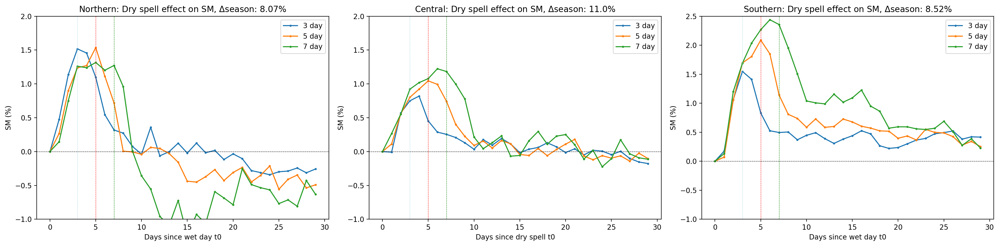

In [77]:
f = plt.figure(figsize=(20,5), dpi=200)

mv=1

ax = f.add_subplot(131)
plt.plot((moving_average(np.nanmean(smerrv3_eq,axis=0)-smclim3eq,mv)-moving_average(np.nanmean(smerrv3_eq,axis=0)-smclim3eq, mv)[0])*100, label='3 day', marker='o', markersize=2)
plt.plot((moving_average(np.nanmean(smerrv5_eq,axis=0)-smclim5eq,mv)-moving_average(np.nanmean(smerrv5_eq,axis=0)-smclim5eq, mv)[0])*100, label='5 day', marker='o', markersize=2)
plt.plot((moving_average(np.nanmean(smerrv7_eq,axis=0)-smclim7eq,mv)-moving_average(np.nanmean(smerrv7_eq,axis=0)-smclim7eq, mv)[0])*100, label='7 day', marker='o', markersize=2)
plt.legend()
plt.title('Northern: Dry spell effect on SM, $\Delta$season: '+str(np.round(smclim_collect['northern'].values*100,2))+"%")
plt.ylabel('SM (%)')
plt.xlabel('Days since wet day t0')
ax.axvline(3, linestyle='dashed', linewidth=0.5, color='lightblue')
ax.axvline(5, linestyle='dashed', linewidth=0.5, color='red')
ax.axvline(7, linestyle='dashed', linewidth=0.5, color='green')
ax.axhline(0, linestyle='dashed', linewidth=0.5, color='k')
ax.set_ylim(-1,2)
#plt.savefig('/home/ck/DIR/cornkle/figs/HUARAZ/paper/sm_northern_testv2.jpg')

ax = f.add_subplot(132)
plt.plot((np.nanmean(smerrv3,axis=0)-np.nanmean(smerrv3,axis=0)[0])*100, label='3 day', marker='o', markersize=2)
plt.plot((np.nanmean(smerrv5,axis=0)-np.nanmean(smerrv5,axis=0)[0])*100, label='5 day', marker='o', markersize=2)
plt.plot((np.nanmean(smerrv7,axis=0)-np.nanmean(smerrv7,axis=0)[0])*100, label='7 day', marker='o', markersize=2)
plt.legend()
plt.title('Central: Dry spell effect on SM, $\Delta$season: '+str(np.round(smclim_collect['central'].values,2)*100)+"%")
plt.ylabel('SM (%)')
plt.xlabel('Days since dry spell t0')
ax.axvline(3, linestyle='dashed', linewidth=0.5, color='lightblue')
ax.axvline(5, linestyle='dashed', linewidth=0.5, color='red')
ax.axvline(7, linestyle='dashed', linewidth=0.5, color='green')
ax.axhline(0, linestyle='dashed', linewidth=0.5, color='k')
ax.set_ylim(-1,2)
#plt.savefig('/home/ck/DIR/cornkle/figs/HUARAZ/paper/sm_central_testv2.jpg')

ax = f.add_subplot(133)
plt.plot((moving_average(np.nanmean(smerrv3_so,axis=0),mv)-moving_average(np.nanmean(smerrv3_so,axis=0), mv)[0])*100, label='3 day', marker='o', markersize=2)
plt.plot((moving_average(np.nanmean(smerrv5_so,axis=0),mv)-moving_average(np.nanmean(smerrv5_so,axis=0), mv)[0])*100, label='5 day', marker='o', markersize=2)
plt.plot((moving_average(np.nanmean(smerrv7_so,axis=0),mv)-moving_average(np.nanmean(smerrv7_so,axis=0), mv)[0])*100, label='7 day', marker='o', markersize=2)
plt.legend()
plt.title('Southern: Dry spell effect on SM, $\Delta$season: '+str(np.round(smclim_collect['southern'].values*100,2))+"%")
plt.ylabel('SM (%)')
plt.xlabel('Days since wet day t0')
ax.axvline(3, linestyle='dashed', linewidth=0.5, color='lightblue')
ax.axvline(5, linestyle='dashed', linewidth=0.5, color='red')
ax.axvline(7, linestyle='dashed', linewidth=0.5, color='green')
ax.axhline(0, linestyle='dashed', linewidth=0.5, color='k')
ax.set_ylim(-1,2.5)

plt.tight_layout()

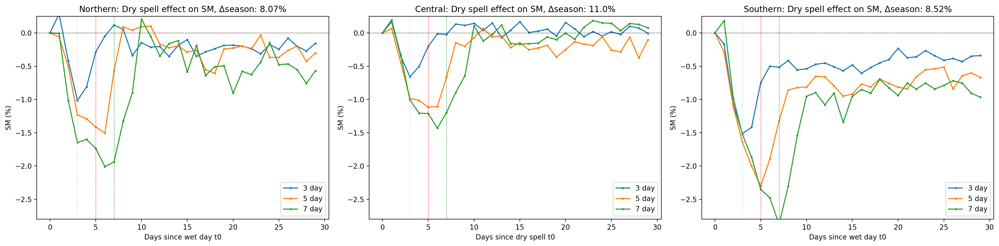

In [62]:
f = plt.figure(figsize=(20,5), dpi=200)

mv=1

ax = f.add_subplot(131)
plt.plot((moving_average(np.nanmean(smerrv3_eqd,axis=0),mv)-moving_average(np.nanmean(smerrv3_eqd,axis=0), mv)[0])*100, label='3 day', marker='o', markersize=2)
plt.plot((moving_average(np.nanmean(smerrv5_eqd,axis=0),mv)-moving_average(np.nanmean(smerrv5_eqd,axis=0), mv)[0])*100, label='5 day', marker='o', markersize=2)
plt.plot((moving_average(np.nanmean(smerrv7_eqd,axis=0),mv)-moving_average(np.nanmean(smerrv7_eqd,axis=0), mv)[0])*100, label='7 day', marker='o', markersize=2)
plt.legend()
plt.title('Northern: Dry spell effect on SM, $\Delta$season: '+str(np.round(smclim_collect['northern'].values*100,2))+"%")
plt.ylabel('SM (%)')
plt.xlabel('Days since wet day t0')
ax.axvline(3, linestyle='dashed', linewidth=0.5, color='lightblue')
ax.axvline(5, linestyle='dashed', linewidth=0.5, color='red')
ax.axvline(7, linestyle='dashed', linewidth=0.5, color='green')
ax.axhline(0, linestyle='dashed', linewidth=0.5, color='k')
ax.set_ylim(-2.8,0.25)
#plt.savefig('/home/ck/DIR/cornkle/figs/HUARAZ/paper/sm_northern_testv2.jpg')

ax = f.add_subplot(132)
plt.plot((np.nanmean(smerrv3_d,axis=0)-np.nanmean(smerrv3_d,axis=0)[0])*100, label='3 day', marker='o', markersize=2)
plt.plot((np.nanmean(smerrv5_d,axis=0)-np.nanmean(smerrv5_d,axis=0)[0])*100, label='5 day', marker='o', markersize=2)
plt.plot((np.nanmean(smerrv7_d,axis=0)-np.nanmean(smerrv7_d,axis=0)[0])*100, label='7 day', marker='o', markersize=2)
plt.legend()
plt.title('Central: Dry spell effect on SM, $\Delta$season: '+str(np.round(smclim_collect['central'].values,2)*100)+"%")
plt.ylabel('SM (%)')
plt.xlabel('Days since dry spell t0')
ax.axvline(3, linestyle='dashed', linewidth=0.5, color='lightblue')
ax.axvline(5, linestyle='dashed', linewidth=0.5, color='red')
ax.axvline(7, linestyle='dashed', linewidth=0.5, color='green')
ax.axhline(0, linestyle='dashed', linewidth=0.5, color='k')
ax.set_ylim(-2.8,0.25)
#plt.savefig('/home/ck/DIR/cornkle/figs/HUARAZ/paper/sm_central_testv2.jpg')

ax = f.add_subplot(133)
plt.plot((moving_average(np.nanmean(smerrv3_sod,axis=0),mv)-moving_average(np.nanmean(smerrv3_sod,axis=0), mv)[0])*100, label='3 day', marker='o', markersize=2)
plt.plot((moving_average(np.nanmean(smerrv5_sod,axis=0),mv)-moving_average(np.nanmean(smerrv5_sod,axis=0), mv)[0])*100, label='5 day', marker='o', markersize=2)
plt.plot((moving_average(np.nanmean(smerrv7_sod,axis=0),mv)-moving_average(np.nanmean(smerrv7_sod,axis=0), mv)[0])*100, label='7 day', marker='o', markersize=2)
plt.legend()
plt.title('Southern: Dry spell effect on SM, $\Delta$season: '+str(np.round(smclim_collect['southern'].values*100,2))+"%")
plt.ylabel('SM (%)')
plt.xlabel('Days since wet day t0')
ax.axvline(3, linestyle='dashed', linewidth=0.5, color='lightblue')
ax.axvline(5, linestyle='dashed', linewidth=0.5, color='red')
ax.axvline(7, linestyle='dashed', linewidth=0.5, color='green')
ax.axhline(0, linestyle='dashed', linewidth=0.5, color='k')
ax.set_ylim(-2.8,0.25)

plt.tight_layout()

In [297]:
ch3, chcnt3, vod3, vodcnt3, vodclim3, voddiff3, vodclimcnt3, voddiffcnt3, errv3, errc3, vodates3 = vod_composite(wet_dat, vod, vod_clim, chdat, 3, topo_on_g, datatag='vod', region='central', syear=2000)
ch5, chcnt5, vod5, vodcnt5, vodclim5, voddiff5, vodclimcnt5, voddiffcnt5, errv5, errc5, vodates5 = vod_composite(wet_dat, vod, vod_clim, chdat, 5, topo_on_g, datatag='vod', region='central', syear=2000)
ch7, chcnt7, vod7, vodcnt7, vodclim7, voddiff7, vodclimcnt7, voddiffcnt7, errv7, errc7, vodates7 = vod_composite(wet_dat, vod, vod_clim, chdat, 7, topo_on_g, datatag='vod', region='central', syear=2000)

Doing -81.0 -12.0
Allnan, continue
Doing -81.0 -11.75
Allnan, continue
Doing -81.0 -11.5
Allnan, continue
Doing -81.0 -11.25
Allnan, continue
Doing -81.0 -11.0
Allnan, continue
Doing -81.0 -10.75
Allnan, continue
Doing -81.0 -10.5
Allnan, continue
Doing -81.0 -10.25
Allnan, continue
Doing -81.0 -10.0
Allnan, continue
Doing -81.0 -9.75
Allnan, continue
Doing -81.0 -9.5
Allnan, continue
Doing -81.0 -9.25
Allnan, continue
Doing -81.0 -9.0
Allnan, continue
Doing -81.0 -8.75
Allnan, continue
Doing -81.0 -8.5
Allnan, continue
Doing -81.0 -8.25
Allnan, continue
Doing -81.0 -8.0
Allnan, continue
Doing -80.75 -12.0
Allnan, continue
Doing -80.75 -11.75
Allnan, continue
Doing -80.75 -11.5
Allnan, continue
Doing -80.75 -11.25
Allnan, continue
Doing -80.75 -11.0
Allnan, continue
Doing -80.75 -10.75
Allnan, continue
Doing -80.75 -10.5
Allnan, continue
Doing -80.75 -10.25
Allnan, continue
Doing -80.75 -10.0
Allnan, continue
Doing -80.75 -9.75
Allnan, continue
Doing -80.75 -9.5
Allnan, continue
Doing 

Doing 172
Doing 173
Doing 174
Doing 175
Doing 176
Doing 177
Doing 178
Doing 179
Doing 180
doy error
Doing 181
Doing 182
Doing 183
Doing 184
Doing 185
Doing 186
Doing 187
Doing 188
Doing 189
Doing 190
Doing -78.25 -12.0
Allnan, continue
Doing -78.25 -11.75
Allnan, continue
Doing -78.25 -11.5
Allnan, continue
Doing -78.25 -11.25
Allnan, continue
Doing -78.25 -11.0
Allnan, continue
Doing -78.25 -10.75
Allnan, continue
Doing -78.25 -10.5
Allnan, continue
Doing -78.25 -10.25
Allnan, continue
Doing -78.25 -10.0
Allnan, continue
Doing -78.25 -9.75
Allnan, continue
Doing -78.25 -9.5
Allnan, continue
Doing -78.25 -9.25
Allnan, continue
Doing -78.25 -9.0
Allnan, continue
Doing -78.25 -8.75
Allnan, continue
Doing -78.25 -8.5
Doing 191
Doing 192
Doing 193
Doing 194
Doing 195
Doing 196
Doing 197
Doing 198
Doing 199
Doing 200
Doing 201
Doing 202
Doing 203
Doing 204
Doing 205
Doing 206
Doing 207
doy error
Doing 208
Doing 209
Doing 210
Doing 211
Doing 212
Doing 213
Doing 214
Doing 215
Doing 216
Doing 

Doing 821
Doing 822
Doing 823
Doing 824
Doing 825
Doing 826
Doing 827
Doing 828
Doing 829
Doing 830
Doing 831
Doing 832
Doing 833
Doing 834
Doing 835
Doing 836
Doing 837
Doing 838
Doing 839
Doing 840
Doing 841
Doing 842
Doing 843
Doing 844
Doing 845
Doing 846
doy error
Doing 847
Doing 848
Doing 849
Doing 850
Doing 851
Doing 852
Doing 853
Doing 854
Doing 855
doy error
Doing 856
Doing 857
Doing 858
Doing 859
Doing 860
Doing 861
Doing 862
Doing 863
Doing 864
Doing 865
Doing 866
Doing 867
Doing 868
Doing 869
Doing 870
Doing 871
Doing 872
Doing 873
Doing 874
Doing 875
Doing 876
Doing 877
Doing 878
Doing 879
doy error
doy error
Doing -78.0 -8.25
Doing 880
Doing 881
Doing 882
Doing 883
Doing 884
Doing 885
Doing 886
Doing 887
Doing 888
Doing 889
Doing 890
Doing 891
Doing 892
Doing 893
doy error
doy error
Doing 894
Doing 895
Doing 896
Doing 897
Doing 898
Doing 899
Doing 900
Doing 901
Doing 902
Doing 903
Doing 904
Doing 905
Doing 906
Doing 907
doy error
Doing 908
Doing 909
Doing 910
Doing 911
Do

Doing 1487
Doing 1488
Doing 1489
Doing 1490
Doing 1491
doy error
doy error
Doing 1492
Doing 1493
Doing 1494
Doing 1495
Doing 1496
Doing 1497
Doing 1498
doy error
doy error
Doing -77.75 -9.0
Doing 1499
Doing 1500
Doing 1501
Doing 1502
Doing 1503
Doing 1504
doy error
Doing 1505
Doing 1506
Doing 1507
Doing 1508
Doing 1509
Doing 1510
Doing 1511
Doing 1512
Doing 1513
Doing 1514
Doing 1515
Doing 1516
doy error
Doing 1517
Doing 1518
Doing 1519
Doing 1520
Doing 1521
Doing 1522
Doing 1523
Doing 1524
Doing 1525
Doing 1526
Doing 1527
Doing 1528
Doing 1529
Doing 1530
Doing 1531
doy error
doy error
Doing 1532
Doing 1533
Doing 1534
Doing 1535
Doing 1536
Doing 1537
Doing 1538
Doing 1539
Doing 1540
Doing 1541
Doing 1542
Doing 1543
Doing 1544
doy error
Doing 1545
Doing 1546
Doing 1547
Doing 1548
Doing 1549
Doing 1550
doy error
Doing 1551
Doing 1552
Doing 1553
Doing 1554
Doing 1555
Doing 1556
Doing 1557
Doing 1558
Doing 1559
Doing 1560
Doing 1561
Doing 1562
Doing 1563
Doing 1564
Doing 1565
doy error
Doi

Doing 2147
Doing 2148
Doing 2149
doy error
Doing 2150
Doing 2151
Doing 2152
Doing 2153
Doing 2154
Doing 2155
Doing 2156
Doing 2157
Doing 2158
Doing 2159
Doing -77.5 -12.0
Allnan, continue
Doing -77.5 -11.75
Allnan, continue
Doing -77.5 -11.5
Allnan, continue
Doing -77.5 -11.25
Allnan, continue
Doing -77.5 -11.0
Allnan, continue
Doing -77.5 -10.75
Allnan, continue
Doing -77.5 -10.5
Allnan, continue
Doing -77.5 -10.25
Doing 2160
Doing 2161
Doing 2162
Doing 2163
doy error
Doing 2164
Doing 2165
Doing 2166
Doing 2167
Doing 2168
Doing 2169
Doing 2170
Doing 2171
Doing 2172
Doing 2173
Doing 2174
Doing 2175
Doing 2176
Doing 2177
doy error
doy error
doy error
Doing 2178
Doing 2179
Doing 2180
Doing 2181
Doing 2182
Doing 2183
doy error
doy error
Doing 2184
Doing 2185
Doing 2186
Doing 2187
Doing 2188
Doing 2189
Doing 2190
Doing 2191
Doing 2192
Doing 2193
Doing 2194
doy error
Doing 2195
Doing 2196
Doing 2197
Doing 2198
Doing 2199
Doing 2200
Doing 2201
Doing 2202
Doing 2203
Doing 2204
Doing 2205
Doin

Doing 2785
Doing 2786
Doing 2787
Doing 2788
Doing 2789
Doing 2790
doy error
Doing 2791
Doing 2792
Doing 2793
Doing 2794
Doing 2795
Doing 2796
Doing 2797
Doing 2798
Doing 2799
Doing 2800
doy error
doy error
Doing 2801
Doing 2802
Doing 2803
Doing 2804
Doing 2805
Doing 2806
Doing 2807
Doing 2808
doy error
Doing 2809
Doing 2810
Doing 2811
Doing 2812
Doing 2813
Doing 2814
Doing 2815
Doing 2816
Doing 2817
Doing 2818
Doing 2819
doy error
Doing 2820
Doing 2821
Doing 2822
Doing 2823
Doing 2824
Doing 2825
Doing 2826
Doing 2827
Doing 2828
Doing 2829
Doing 2830
Doing 2831
Doing 2832
Doing 2833
Doing 2834
Doing 2835
doy error
doy error
Doing 2836
Doing 2837
Doing 2838
Doing 2839
Doing 2840
doy error
doy error
doy error
doy error
Doing 2841
Doing 2842
Doing 2843
Doing 2844
Doing 2845
Doing 2846
Doing 2847
Doing 2848
Doing 2849
Doing 2850
Doing 2851
doy error
doy error
Doing 2852
Doing 2853
Doing 2854
Doing 2855
Doing 2856
Doing 2857
Doing 2858
Doing 2859
Doing 2860
doy error
Doing 2861
Doing 2862
Do

Doing 3450
Doing 3451
doy error
Doing 3452
Doing 3453
Doing 3454
Doing 3455
Doing 3456
Doing 3457
Doing 3458
Doing 3459
Doing 3460
Doing 3461
Doing 3462
Doing 3463
Doing 3464
Doing -77.25 -12.0
Allnan, continue
Doing -77.25 -11.75
Allnan, continue
Doing -77.25 -11.5
Allnan, continue
Doing -77.25 -11.25
Allnan, continue
Doing -77.25 -11.0
Allnan, continue
Doing -77.25 -10.75
Doing 3465
Doing 3466
Doing 3467
Doing 3468
Doing 3469
doy error
Doing 3470
Doing 3471
Doing 3472
Doing 3473
Doing 3474
doy error
Doing 3475
Doing 3476
Doing 3477
Doing 3478
Doing 3479
Doing 3480
Doing 3481
Doing 3482
Doing 3483
Doing 3484
Doing 3485
doy error
Doing 3486
Doing 3487
Doing 3488
Doing 3489
Doing 3490
Doing 3491
doy error
Doing 3492
Doing 3493
Doing 3494
Doing 3495
Doing 3496
Doing 3497
Doing 3498
Doing 3499
Doing 3500
Doing 3501
Doing 3502
Doing 3503
Doing 3504
Doing 3505
Doing 3506
Doing 3507
Doing 3508
Doing 3509
Doing 3510
Doing 3511
Doing 3512
doy error
Doing 3513
Doing 3514
Doing 3515
Doing 3516
D

Doing 4103
Doing 4104
Doing 4105
Doing 4106
Doing 4107
Doing 4108
Doing 4109
Doing 4110
Doing 4111
Doing 4112
Doing 4113
Doing 4114
Doing 4115
Doing 4116
Doing 4117
Doing 4118
Doing 4119
Doing 4120
Doing 4121
Doing 4122
Doing 4123
Doing 4124
Doing 4125
Doing 4126
Doing 4127
doy error
Doing 4128
Doing 4129
Doing 4130
Doing 4131
doy error
doy error
Doing 4132
Doing 4133
Doing 4134
doy error
doy error
doy error
Doing 4135
Doing 4136
Doing 4137
Doing 4138
Doing 4139
Doing 4140
Doing 4141
Doing 4142
Doing 4143
Doing 4144
Doing 4145
Doing 4146
doy error
Doing 4147
Doing 4148
Doing 4149
Doing 4150
Doing 4151
Doing 4152
doy error
Doing 4153
Doing 4154
Doing 4155
Doing 4156
Doing 4157
Doing 4158
doy error
doy error
Doing 4159
Doing 4160
Doing 4161
doy error
Doing 4162
Doing 4163
Doing 4164
Doing 4165
Doing 4166
Doing 4167
Doing 4168
doy error
Doing 4169
Doing 4170
Doing 4171
Doing 4172
Doing 4173
Doing 4174
Doing 4175
Doing 4176
Doing 4177
Doing 4178
Doing 4179
doy error
doy error
doy error
Doi

Doing 4757
Doing 4758
Doing 4759
Doing 4760
doy error
Doing 4761
Doing 4762
Doing 4763
Doing 4764
Doing 4765
Doing 4766
Doing 4767
Doing 4768
Doing 4769
doy error
Doing 4770
Doing 4771
Doing 4772
Doing 4773
Doing 4774
Doing 4775
Doing 4776
Doing 4777
doy error
Doing 4778
Doing 4779
Doing 4780
Doing 4781
Doing 4782
Doing 4783
Doing 4784
Doing 4785
Doing 4786
Doing 4787
Doing 4788
Doing 4789
doy error
Doing 4790
Doing 4791
Doing 4792
Doing 4793
Doing 4794
Doing 4795
Doing 4796
Doing 4797
Doing 4798
Doing 4799
Doing 4800
Doing 4801
Doing 4802
Doing 4803
Doing 4804
Doing 4805
Doing 4806
Doing 4807
Doing 4808
Doing 4809
Doing 4810
Doing 4811
Doing 4812
Doing 4813
Doing 4814
Doing 4815
doy error
doy error
Doing 4816
Doing 4817
Doing 4818
Doing 4819
Doing 4820
Doing 4821
doy error
doy error
doy error
Doing 4822
Doing 4823
Doing 4824
Doing 4825
Doing 4826
doy error
doy error
Doing 4827
Doing 4828
Doing 4829
Doing 4830
Doing 4831
Doing 4832
Doing 4833
Doing 4834
Doing 4835
Doing 4836
doy error


Doing 5396
Doing 5397
Doing 5398
doy error
doy error
Doing 5399
Doing 5400
Doing 5401
Doing 5402
Doing 5403
doy error
Doing 5404
Doing 5405
Doing 5406
Doing 5407
doy error
doy error
Doing 5408
Doing 5409
Doing 5410
Doing 5411
Doing 5412
Doing 5413
Doing 5414
Doing 5415
Doing 5416
doy error
doy error
Doing 5417
Doing 5418
Doing 5419
Doing 5420
Doing 5421
Doing 5422
Doing 5423
Doing 5424
Doing 5425
Doing 5426
Doing 5427
Doing 5428
Doing 5429
Doing 5430
doy error
Doing 5431
Doing 5432
Doing 5433
Doing 5434
Doing 5435
doy error
doy error
Doing 5436
Doing 5437
Doing 5438
Doing 5439
Doing 5440
Doing 5441
doy error
doy error
Doing 5442
Doing 5443
Doing 5444
Doing 5445
Doing 5446
Doing 5447
Doing 5448
Doing 5449
Doing 5450
Doing 5451
Doing 5452
Doing 5453
Doing 5454
Doing 5455
Doing 5456
Doing 5457
Doing 5458
Doing 5459
doy error
doy error
Doing 5460
Doing 5461
Doing 5462
Doing 5463
Doing 5464
Doing 5465
Doing 5466
doy error
doy error
doy error
Doing 5467
Doing 5468
Doing 5469
Doing 5470
Doing

Doing 6059
Doing 6060
Doing 6061
Doing 6062
doy error
Doing 6063
Doing 6064
Doing 6065
Doing 6066
Doing 6067
Doing 6068
Doing 6069
doy error
doy error
Doing 6070
Doing 6071
Doing 6072
Doing 6073
Doing 6074
doy error
Doing 6075
Doing 6076
Doing 6077
Doing 6078
Doing 6079
Doing 6080
Doing 6081
Doing 6082
Doing 6083
Doing 6084
Doing 6085
Doing 6086
Doing 6087
Doing 6088
Doing 6089
Doing 6090
Doing 6091
doy error
Doing 6092
Doing 6093
Doing 6094
Doing 6095
Doing 6096
Doing 6097
Doing 6098
Doing 6099
Doing 6100
Doing 6101
Doing 6102
Doing 6103
doy error
doy error
Doing 6104
Doing 6105
Doing 6106
Doing 6107
Doing 6108
Doing 6109
Doing 6110
Doing 6111
Doing -77.0 -9.25
Doing 6112
Doing 6113
Doing 6114
Doing 6115
Doing 6116
Doing 6117
Doing 6118
Doing 6119
Doing 6120
doy error
Doing 6121
Doing 6122
Doing 6123
Doing 6124
Doing 6125
Doing 6126
Doing 6127
Doing 6128
doy error
Doing 6129
Doing 6130
Doing 6131
Doing 6132
Doing 6133
Doing 6134
Doing 6135
Doing 6136
Doing 6137
Doing 6138
Doing 6139
D

Doing 6725
Doing 6726
Doing 6727
Doing 6728
Doing 6729
Doing 6730
Doing 6731
Doing 6732
Doing 6733
Doing 6734
Doing 6735
Doing 6736
Doing 6737
Doing 6738
doy error
doy error
doy error
Doing 6739
Doing 6740
Doing 6741
Doing 6742
Doing 6743
Doing 6744
Doing 6745
Doing 6746
Doing 6747
Doing 6748
Doing 6749
Doing 6750
doy error
doy error
Doing 6751
Doing 6752
Doing 6753
Doing 6754
Doing 6755
Doing 6756
Doing 6757
Doing 6758
Doing 6759
Doing 6760
doy error
doy error
doy error
Doing 6761
Doing 6762
Doing 6763
Doing 6764
Doing 6765
Doing 6766
Doing 6767
Doing 6768
Doing 6769
Doing 6770
Doing 6771
Doing 6772
Doing 6773
Doing 6774
Doing 6775
Doing 6776
Doing 6777
Doing 6778
Doing 6779
Doing 6780
Doing 6781
Doing 6782
Doing 6783
Doing 6784
doy error
doy error
Doing 6785
Doing 6786
Doing 6787
Doing 6788
Doing 6789
Doing 6790
Doing 6791
Doing 6792
Doing 6793
doy error
doy error
Doing 6794
Doing 6795
Doing 6796
Doing 6797
Doing 6798
doy error
doy error
Doing 6799
Doing 6800
Doing 6801
doy error
doy

Doing 7370
Doing 7371
Doing 7372
Doing 7373
Doing 7374
Doing 7375
Doing 7376
Doing 7377
Doing 7378
Doing 7379
Doing 7380
Doing 7381
Doing 7382
Doing 7383
Doing 7384
Doing 7385
Doing 7386
Doing 7387
Doing 7388
Doing 7389
Doing 7390
Doing 7391
Doing 7392
doy error
doy error
Doing 7393
Doing 7394
Doing 7395
Doing 7396
Doing 7397
doy error
doy error
Doing 7398
Doing 7399
Doing 7400
Doing 7401
Doing 7402
Doing 7403
Doing 7404
Doing 7405
Doing 7406
Doing 7407
Doing 7408
Doing 7409
Doing 7410
Doing 7411
doy error
Doing 7412
Doing 7413
Doing 7414
Doing 7415
Doing 7416
Doing 7417
doy error
Doing 7418
Doing 7419
Doing 7420
Doing 7421
doy error
Doing 7422
Doing 7423
Doing 7424
Doing 7425
Doing 7426
Doing 7427
Doing 7428
doy error
doy error
Doing 7429
Doing 7430
Doing 7431
Doing 7432
Doing 7433
Doing 7434
Doing 7435
Doing 7436
Doing 7437
Doing 7438
Doing 7439
Doing 7440
Doing 7441
Doing 7442
Doing 7443
doy error
Doing 7444
Doing 7445
Doing 7446
Doing 7447
Doing 7448
Doing 7449
Doing 7450
doy error

Doing 8027
Doing 8028
Doing 8029
Doing 8030
Doing 8031
Doing 8032
Doing 8033
Doing 8034
Doing 8035
Doing 8036
doy error
Doing -76.75 -9.75
Doing 8037
Doing 8038
Doing 8039
Doing 8040
Doing 8041
doy error
Doing 8042
Doing 8043
Doing 8044
Doing 8045
Doing 8046
Doing 8047
Doing 8048
Doing 8049
Doing 8050
Doing 8051
Doing 8052
Doing 8053
Doing 8054
Doing 8055
Doing 8056
Doing 8057
Doing 8058
Doing 8059
Doing 8060
Doing 8061
doy error
Doing 8062
Doing 8063
Doing 8064
Doing 8065
Doing 8066
Doing 8067
doy error
Doing 8068
Doing 8069
Doing 8070
Doing 8071
Doing 8072
Doing 8073
Doing 8074
Doing 8075
doy error
doy error
doy error
Doing 8076
Doing 8077
Doing 8078
Doing 8079
Doing 8080
Doing 8081
Doing 8082
Doing 8083
doy error
doy error
doy error
doy error
doy error
Doing 8084
Doing 8085
Doing 8086
Doing 8087
Doing 8088
Doing 8089
Doing 8090
Doing 8091
Doing 8092
Doing 8093
doy error
Doing 8094
Doing 8095
Doing 8096
Doing 8097
Doing 8098
Doing 8099
Doing 8100
Doing 8101
Doing 8102
Doing 8103
Doin

Doing 8665
Doing 8666
Doing 8667
Doing 8668
Doing 8669
Doing 8670
Doing 8671
Doing 8672
Doing 8673
Doing 8674
doy error
Doing 8675
Doing 8676
Doing 8677
Doing 8678
Doing 8679
doy error
doy error
Doing 8680
Doing 8681
Doing 8682
Doing 8683
Doing 8684
Doing 8685
Doing 8686
Doing 8687
Doing 8688
Doing 8689
Doing 8690
doy error
doy error
doy error
Doing -76.75 -8.75
Doing 8691
Doing 8692
Doing 8693
Doing 8694
Doing 8695
Doing 8696
Doing 8697
Doing 8698
Doing 8699
Doing 8700
Doing 8701
Doing 8702
Doing 8703
Doing 8704
Doing 8705
Doing 8706
Doing 8707
Doing 8708
Doing 8709
Doing 8710
Doing 8711
doy error
Doing 8712
Doing 8713
Doing 8714
Doing 8715
Doing 8716
Doing 8717
Doing 8718
Doing 8719
Doing 8720
doy error
doy error
doy error
Doing 8721
Doing 8722
Doing 8723
Doing 8724
Doing 8725
Doing 8726
Doing 8727
Doing 8728
Doing 8729
Doing 8730
Doing 8731
Doing 8732
Doing 8733
Doing 8734
Doing 8735
Doing 8736
Doing 8737
Doing 8738
Doing 8739
doy error
Doing 8740
Doing 8741
Doing 8742
Doing 8743
Do

Doing 9308
Doing 9309
Doing 9310
doy error
doy error
Doing 9311
Doing 9312
Doing 9313
Doing 9314
Doing 9315
Doing 9316
Doing 9317
Doing 9318
Doing 9319
Doing 9320
Doing 9321
Doing 9322
Doing 9323
Doing 9324
Doing -76.5 -11.0
Doing 9325
Doing 9326
Doing 9327
Doing 9328
Doing 9329
Doing 9330
Doing 9331
Doing 9332
Doing 9333
Doing 9334
Doing 9335
Doing 9336
Doing 9337
Doing 9338
Doing 9339
Doing 9340
Doing 9341
Doing 9342
Doing 9343
Doing 9344
Doing 9345
Doing 9346
Doing 9347
Doing 9348
Doing 9349
Doing 9350
doy error
doy error
Doing 9351
Doing 9352
Doing 9353
Doing 9354
doy error
Doing 9355
Doing 9356
Doing 9357
Doing 9358
Doing 9359
Doing 9360
Doing 9361
doy error
doy error
doy error
Doing 9362
Doing 9363
Doing 9364
Doing 9365
Doing 9366
Doing 9367
Doing 9368
Doing 9369
Doing 9370
Doing 9371
Doing 9372
Doing 9373
Doing 9374
Doing 9375
Doing 9376
Doing 9377
doy error
Doing 9378
Doing 9379
Doing 9380
Doing 9381
Doing 9382
Doing 9383
Doing 9384
Doing 9385
Doing 9386
Doing 9387
Doing 9388
D

Doing 9955
Doing 9956
Doing 9957
Doing 9958
Doing 9959
Doing 9960
Doing 9961
Doing 9962
Doing 9963
Doing 9964
doy error
doy error
Doing 9965
Doing 9966
Doing 9967
Doing 9968
Doing 9969
Doing 9970
Doing 9971
Doing 9972
Doing 9973
Doing 9974
doy error
doy error
doy error
Doing 9975
Doing 9976
Doing 9977
Doing 9978
Doing 9979
Doing 9980
doy error
doy error
Doing 9981
Doing 9982
Doing 9983
Doing 9984
Doing 9985
Doing 9986
Doing 9987
Doing 9988
doy error
Doing 9989
Doing 9990
Doing 9991
Doing 9992
Doing 9993
Doing 9994
Doing 9995
Doing 9996
Doing 9997
Doing 9998
Doing 9999
doy error
doy error
Doing 10000
Doing 10001
Doing 10002
Doing 10003
Doing 10004
Doing 10005
Doing 10006
Doing 10007
Doing 10008
Doing 10009
doy error
Doing 10010
Doing 10011
Doing 10012
Doing 10013
Doing 10014
Doing 10015
Doing 10016
doy error
Doing 10017
Doing 10018
Doing 10019
Doing 10020
Doing 10021
Doing 10022
Doing 10023
Doing 10024
Doing 10025
doy error
Doing 10026
Doing 10027
Doing 10028
Doing 10029
Doing 10030
Doi

Doing 10578
Doing 10579
Doing 10580
Doing 10581
doy error
Doing 10582
Doing 10583
Doing 10584
Doing 10585
Doing 10586
Doing 10587
Doing 10588
Doing 10589
doy error
Doing 10590
Doing 10591
Doing 10592
Doing 10593
Doing 10594
Doing 10595
Doing 10596
Doing 10597
Doing 10598
Doing 10599
doy error
doy error
Doing -76.5 -9.0
Doing 10600
Doing 10601
Doing 10602
Doing 10603
Doing 10604
Doing 10605
Doing 10606
Doing 10607
Doing 10608
Doing 10609
Doing 10610
Doing 10611
Doing 10612
Doing 10613
Doing 10614
Doing 10615
Doing 10616
Doing 10617
Doing 10618
Doing 10619
Doing 10620
Doing 10621
Doing 10622
Doing 10623
Doing 10624
Doing 10625
Doing 10626
Doing 10627
doy error
doy error
doy error
doy error
Doing 10628
Doing 10629
Doing 10630
Doing 10631
Doing 10632
Doing 10633
Doing 10634
Doing 10635
Doing 10636
doy error
doy error
Doing 10637
Doing 10638
Doing 10639
Doing 10640
Doing 10641
Doing 10642
Doing 10643
Doing 10644
Doing 10645
Doing 10646
Doing 10647
Doing 10648
Doing 10649
doy error
doy error

Doing 11187
Doing 11188
Doing 11189
doy error
doy error
Doing 11190
Doing 11191
Doing 11192
Doing 11193
Doing 11194
Doing 11195
Doing 11196
Doing 11197
doy error
doy error
Doing 11198
Doing 11199
Doing 11200
Doing 11201
Doing 11202
Doing 11203
Doing 11204
Doing 11205
Doing 11206
Doing 11207
Doing 11208
Doing 11209
Doing 11210
Doing 11211
Doing 11212
Doing 11213
Doing 11214
doy error
Doing 11215
Doing 11216
Doing 11217
Doing 11218
Doing 11219
Doing 11220
Doing 11221
Doing 11222
doy error
Doing 11223
Doing 11224
Doing 11225
Doing 11226
Doing 11227
Doing 11228
doy error
doy error
doy error
doy error
Doing 11229
Doing 11230
Doing 11231
Doing 11232
Doing 11233
Doing 11234
Doing 11235
doy error
Doing 11236
Doing 11237
Doing 11238
Doing 11239
Doing 11240
doy error
doy error
doy error
Doing 11241
Doing 11242
Doing 11243
Doing 11244
Doing 11245
Doing 11246
doy error
doy error
Doing 11247
Doing 11248
Doing 11249
Doing 11250
Doing 11251
Doing 11252
Doing 11253
Doing 11254
doy error
Doing -76.25 -

Doing 11793
Doing 11794
Doing 11795
Doing 11796
Doing 11797
Doing 11798
Doing 11799
Doing 11800
Doing 11801
Doing 11802
Doing 11803
Doing 11804
doy error
Doing 11805
Doing 11806
Doing 11807
Doing 11808
Doing 11809
Doing 11810
Doing 11811
Doing 11812
Doing 11813
Doing 11814
doy error
Doing -76.25 -10.5
Doing 11815
Doing 11816
Doing 11817
Doing 11818
Doing 11819
Doing 11820
Doing 11821
doy error
Doing 11822
Doing 11823
Doing 11824
Doing 11825
Doing 11826
Doing 11827
Doing 11828
Doing 11829
Doing 11830
Doing 11831
Doing 11832
Doing 11833
Doing 11834
doy error
doy error
Doing 11835
Doing 11836
Doing 11837
Doing 11838
Doing 11839
Doing 11840
Doing 11841
Doing 11842
Doing 11843
Doing 11844
Doing 11845
Doing 11846
doy error
doy error
Doing 11847
Doing 11848
Doing 11849
Doing 11850
Doing 11851
doy error
doy error
Doing 11852
Doing 11853
Doing 11854
Doing 11855
doy error
doy error
doy error
doy error
Doing 11856
Doing 11857
Doing 11858
Doing 11859
Doing 11860
Doing 11861
Doing 11862
doy error
D

Doing 12389
Doing 12390
Doing 12391
Doing 12392
Doing 12393
Doing 12394
Doing 12395
Doing 12396
Doing 12397
Doing 12398
Doing 12399
Doing 12400
Doing 12401
doy error
doy error
doy error
Doing 12402
Doing 12403
Doing 12404
Doing 12405
Doing 12406
Doing 12407
Doing 12408
Doing 12409
Doing 12410
Doing 12411
Doing 12412
Doing 12413
Doing 12414
Doing 12415
Doing 12416
Doing 12417
Doing 12418
Doing 12419
Doing 12420
doy error
doy error
Doing 12421
Doing 12422
Doing 12423
Doing 12424
Doing 12425
Doing 12426
Doing 12427
Doing 12428
Doing 12429
Doing 12430
Doing 12431
Doing 12432
Doing 12433
Doing 12434
Doing 12435
Doing 12436
Doing 12437
Doing 12438
Doing 12439
Doing 12440
Doing 12441
Doing 12442
Doing 12443
Doing 12444
Doing 12445
Doing 12446
Doing 12447
Doing 12448
doy error
Doing 12449
Doing 12450
Doing 12451
Doing 12452
Doing 12453
Doing 12454
Doing 12455
Doing 12456
Doing 12457
Doing 12458
Doing 12459
Doing 12460
Doing 12461
Doing 12462
Doing 12463
Doing 12464
Doing -76.25 -9.5
doy error


Doing 12975
Doing 12976
Doing 12977
doy error
Doing 12978
Doing 12979
Doing 12980
Doing 12981
Doing 12982
Doing 12983
Doing 12984
doy error
doy error
Doing 12985
Doing 12986
Doing 12987
Doing 12988
Doing 12989
Doing 12990
Doing 12991
Doing 12992
Doing 12993
doy error
doy error
doy error
Doing 12994
Doing 12995
Doing 12996
Doing 12997
Doing 12998
Doing 12999
doy error
Doing 13000
Doing 13001
Doing 13002
Doing 13003
Doing 13004
Doing 13005
Doing 13006
Doing 13007
Doing 13008
doy error
Doing 13009
Doing 13010
Doing 13011
Doing 13012
Doing 13013
Doing 13014
Doing 13015
Doing 13016
Doing 13017
Doing 13018
Doing 13019
Doing 13020
Doing 13021
doy error
doy error
Doing 13022
Doing 13023
Doing 13024
Doing 13025
Doing 13026
doy error
doy error
Doing 13027
Doing 13028
Doing 13029
Doing 13030
doy error
doy error
Doing 13031
Doing 13032
Doing 13033
Doing 13034
Doing 13035
Doing 13036
Doing 13037
Doing 13038
Doing 13039
Doing 13040
Doing 13041
Doing 13042
Doing 13043
Doing 13044
Doing 13045
Doing 13

Doing 13569
Doing 13570
Doing 13571
Doing 13572
Doing 13573
Doing 13574
Doing 13575
doy error
doy error
doy error
doy error
Doing 13576
Doing 13577
Doing 13578
Doing 13579
Doing 13580
Doing 13581
Doing 13582
Doing 13583
Doing 13584
Doing 13585
doy error
doy error
doy error
Doing 13586
Doing 13587
Doing 13588
Doing 13589
Doing 13590
doy error
doy error
Doing 13591
Doing 13592
Doing 13593
Doing 13594
Doing 13595
Doing 13596
Doing 13597
Doing 13598
Doing 13599
Doing 13600
Doing 13601
Doing 13602
Doing 13603
Doing 13604
Doing 13605
Doing 13606
Doing 13607
Doing 13608
Doing 13609
doy error
Doing 13610
Doing 13611
Doing 13612
Doing 13613
Doing 13614
Doing 13615
Doing 13616
Doing 13617
Doing 13618
Doing 13619
doy error
doy error
Doing 13620
Doing 13621
Doing 13622
Doing 13623
doy error
doy error
Doing 13624
Doing 13625
Doing 13626
Doing 13627
Doing 13628
Doing 13629
Doing 13630
Doing 13631
Doing 13632
Doing 13633
Doing 13634
Doing 13635
Doing 13636
Doing 13637
Doing 13638
Doing 13639
Doing 13

Doing 14147
Doing 14148
Doing 14149
doy error
doy error
Doing -75.75 -11.5
Doing 14150
Doing 14151
Doing 14152
Doing 14153
Doing 14154
Doing 14155
Doing 14156
Doing 14157
Doing 14158
Doing 14159
Doing 14160
doy error
Doing 14161
Doing 14162
Doing 14163
Doing 14164
Doing 14165
Doing 14166
doy error
doy error
doy error
Doing 14167
Doing 14168
doy error
doy error
Doing 14169
Doing 14170
Doing 14171
Doing 14172
Doing 14173
doy error
doy error
doy error
Doing 14174
Doing 14175
doy error
doy error
Doing 14176
Doing 14177
Doing 14178
Doing 14179
Doing 14180
Doing 14181
Doing 14182
Doing 14183
Doing 14184
Doing 14185
Doing 14186
doy error
Doing 14187
Doing 14188
Doing 14189
Doing 14190
Doing 14191
Doing 14192
Doing 14193
Doing 14194
Doing 14195
doy error
doy error
doy error
Doing 14196
Doing 14197
doy error
doy error
Doing 14198
Doing 14199
Doing 14200
Doing 14201
Doing 14202
Doing 14203
doy error
Doing 14204
Doing 14205
Doing 14206
Doing 14207
Doing 14208
doy error
Doing 14209
Doing 14210
Doi

Doing 14689
Doing 14690
doy error
doy error
Doing 14691
Doing 14692
Doing 14693
Doing 14694
Doing 14695
Doing 14696
Doing 14697
Doing 14698
Doing 14699
Doing 14700
Doing 14701
Doing 14702
Doing 14703
Doing 14704
doy error
doy error
doy error
Doing -75.75 -10.25
Doing 14705
Doing 14706
Doing 14707
Doing 14708
Doing 14709
Doing 14710
Doing 14711
Doing 14712
doy error
doy error
Doing 14713
Doing 14714
Doing 14715
Doing 14716
Doing 14717
Doing 14718
Doing 14719
Doing 14720
Doing 14721
Doing 14722
Doing 14723
Doing 14724
Doing 14725
Doing 14726
Doing 14727
Doing 14728
Doing 14729
Doing 14730
Doing 14731
Doing 14732
Doing 14733
Doing 14734
Doing 14735
doy error
doy error
doy error
Doing 14736
Doing 14737
Doing 14738
Doing 14739
Doing 14740
Doing 14741
doy error
doy error
doy error
Doing 14742
Doing 14743
Doing 14744
Doing 14745
Doing 14746
Doing 14747
Doing 14748
Doing 14749
Doing 14750
Doing 14751
Doing 14752
Doing 14753
doy error
doy error
doy error
doy error
Doing 14754
Doing 14755
Doing 

Doing 15268
Doing 15269
Doing 15270
Doing 15271
doy error
doy error
Doing 15272
Doing 15273
Doing 15274
Doing 15275
Doing 15276
Doing 15277
doy error
Doing 15278
Doing 15279
Doing 15280
Doing 15281
Doing 15282
Doing 15283
doy error
doy error
Doing 15284
Doing 15285
Doing 15286
Doing 15287
Doing 15288
Doing 15289
Doing 15290
Doing 15291
Doing 15292
doy error
Doing 15293
Doing 15294
Doing 15295
Doing 15296
Doing 15297
Doing 15298
Doing 15299
Doing 15300
Doing 15301
doy error
doy error
Doing 15302
Doing 15303
Doing 15304
Doing 15305
Doing 15306
Doing 15307
Doing 15308
doy error
doy error
doy error
Doing 15309
Doing 15310
Doing 15311
Doing 15312
Doing 15313
doy error
doy error
Doing 15314
Doing 15315
Doing 15316
Doing 15317
doy error
Doing 15318
Doing 15319
Doing 15320
Doing 15321
Doing 15322
Doing 15323
Doing 15324
Doing 15325
doy error
doy error
Doing 15326
Doing 15327
Doing 15328
Doing 15329
Doing 15330
Doing 15331
Doing 15332
doy error
Doing 15333
Doing 15334
Doing 15335
Doing 15336
Do

Doing 15831
Doing 15832
Doing 15833
Doing 15834
doy error
doy error
doy error
Doing 15835
Doing 15836
Doing 15837
Doing 15838
Doing 15839
Doing 15840
Doing 15841
Doing 15842
Doing 15843
Doing 15844
Doing 15845
Doing 15846
doy error
doy error
doy error
Doing 15847
Doing 15848
Doing 15849
Doing 15850
Doing 15851
Doing 15852
Doing 15853
doy error
Doing 15854
Doing 15855
Doing 15856
Doing 15857
Doing 15858
Doing 15859
Doing 15860
Doing 15861
Doing 15862
Doing 15863
Doing 15864
Doing 15865
Doing 15866
doy error
Doing 15867
Doing 15868
Doing 15869
Doing 15870
Doing 15871
Doing 15872
Doing 15873
doy error
Doing 15874
Doing 15875
Doing 15876
Doing 15877
Doing 15878
Doing 15879
Doing 15880
Doing 15881
Doing 15882
Doing 15883
Doing 15884
Doing 15885
Doing 15886
Doing 15887
Doing 15888
doy error
doy error
Doing 15889
Doing 15890
Doing 15891
Doing 15892
doy error
Doing 15893
Doing 15894
Doing 15895
Doing 15896
Doing 15897
Doing 15898
Doing 15899
Doing 15900
Doing 15901
Doing 15902
doy error
Doing 

Doing 16355
Doing 16356
Doing 16357
doy error
Doing 16358
Doing 16359
Doing 16360
Doing 16361
Doing 16362
Doing 16363
Doing 16364
Doing 16365
Doing 16366
Doing 16367
Doing 16368
Doing 16369
Doing 16370
Doing 16371
Doing 16372
Doing 16373
Doing 16374
Doing 16375
Doing 16376
Doing 16377
Doing 16378
Doing 16379
Doing 16380
Doing 16381
Doing 16382
Doing 16383
Doing 16384
Doing 16385
Doing 16386
Doing 16387
Doing 16388
doy error
Doing 16389
Doing 16390
Doing 16391
Doing 16392
Doing 16393
Doing 16394
Doing 16395
Doing 16396
Doing 16397
doy error
Doing 16398
Doing 16399
Doing 16400
Doing 16401
Doing 16402
Doing 16403
Doing 16404
Doing 16405
Doing 16406
doy error
Doing 16407
Doing 16408
Doing 16409
Doing 16410
Doing 16411
Doing 16412
Doing 16413
doy error
doy error
doy error
Doing 16414
Doing 16415
Doing 16416
Doing 16417
Doing 16418
Doing 16419
Doing 16420
Doing 16421
Doing 16422
Doing 16423
Doing 16424
Doing 16425
Doing 16426
Doing 16427
Doing 16428
Doing 16429
Doing 16430
Doing 16431
Doing 

Doing 16926
doy error
Doing 16927
Doing 16928
Doing 16929
Doing 16930
Doing 16931
Doing 16932
Doing 16933
Doing 16934
Doing 16935
doy error
doy error
doy error
Doing 16936
Doing 16937
Doing 16938
Doing 16939
Doing 16940
Doing 16941
Doing 16942
Doing 16943
Doing 16944
Doing 16945
Doing 16946
doy error
doy error
doy error
Doing 16947
Doing 16948
Doing 16949
Doing 16950
Doing 16951
Doing 16952
Doing 16953
Doing 16954
doy error
Doing 16955
Doing 16956
Doing 16957
Doing 16958
Doing 16959
Doing 16960
doy error
Doing 16961
Doing 16962
Doing 16963
Doing 16964
Doing 16965
Doing 16966
Doing 16967
Doing 16968
Doing 16969
Doing 16970
Doing 16971
Doing 16972
Doing 16973
doy error
Doing 16974
Doing 16975
Doing 16976
Doing 16977
Doing 16978
Doing 16979
Doing 16980
Doing 16981
Doing 16982
Doing 16983
Doing 16984
Doing 16985
Doing 16986
Doing 16987
Doing 16988
Doing 16989
Doing 16990
Doing 16991
Doing 16992
Doing 16993
Doing 16994
Doing 16995
doy error
doy error
doy error
Doing 16996
Doing 16997
Doing 

Doing 17483
Doing 17484
Doing 17485
Doing 17486
Doing 17487
Doing 17488
Doing 17489
Doing 17490
Doing 17491
Doing 17492
Doing 17493
Doing 17494
doy error
Doing 17495
Doing 17496
Doing 17497
Doing 17498
Doing 17499
Doing 17500
Doing 17501
Doing 17502
Doing 17503
doy error
doy error
doy error
doy error
Doing 17504
Doing 17505
Doing 17506
Doing 17507
Doing 17508
Doing 17509
Doing 17510
Doing 17511
Doing 17512
doy error
Doing 17513
Doing 17514
Doing 17515
Doing 17516
Doing 17517
Doing 17518
Doing 17519
Doing 17520
Doing 17521
doy error
doy error
doy error
Doing 17522
Doing 17523
Doing 17524
Doing 17525
Doing 17526
Doing 17527
Doing 17528
Doing 17529
Doing 17530
Doing 17531
Doing 17532
Doing 17533
Doing 17534
doy error
doy error
doy error
doy error
Doing 17535
Doing 17536
Doing 17537
Doing 17538
Doing 17539
Doing 17540
Doing 17541
doy error
doy error
Doing 17542
Doing 17543
Doing 17544
Doing 17545
Doing 17546
Doing 17547
Doing 17548
doy error
Doing 17549
Doing 17550
Doing 17551
Doing 17552


Allnan, continue
Doing -71.75 -11.0
Allnan, continue
Doing -71.75 -10.75
Allnan, continue
Doing -71.75 -10.5
Allnan, continue
Doing -71.75 -10.25
Allnan, continue
Doing -71.75 -10.0
Allnan, continue
Doing -71.75 -9.75
Allnan, continue
Doing -71.75 -9.5
Allnan, continue
Doing -71.75 -9.25
Allnan, continue
Doing -71.75 -9.0
Allnan, continue
Doing -71.75 -8.75
Allnan, continue
Doing -71.75 -8.5
Allnan, continue
Doing -71.75 -8.25
Allnan, continue
Doing -71.75 -8.0
Allnan, continue
Doing -71.5 -12.0
Allnan, continue
Doing -71.5 -11.75
Allnan, continue
Doing -71.5 -11.5
Allnan, continue
Doing -71.5 -11.25
Allnan, continue
Doing -71.5 -11.0
Allnan, continue
Doing -71.5 -10.75
Allnan, continue
Doing -71.5 -10.5
Allnan, continue
Doing -71.5 -10.25
Allnan, continue
Doing -71.5 -10.0
Allnan, continue
Doing -71.5 -9.75
Allnan, continue
Doing -71.5 -9.5
Allnan, continue
Doing -71.5 -9.25
Allnan, continue
Doing -71.5 -9.0
Allnan, continue
Doing -71.5 -8.75
Allnan, continue
Doing -71.5 -8.5
Allnan, 

Allnan, continue
Doing -67.75 -11.75
Allnan, continue
Doing -67.75 -11.5
Allnan, continue
Doing -67.75 -11.25
Allnan, continue
Doing -67.75 -11.0
Allnan, continue
Doing -67.75 -10.75
Allnan, continue
Doing -67.75 -10.5
Allnan, continue
Doing -67.75 -10.25
Allnan, continue
Doing -67.75 -10.0
Allnan, continue
Doing -67.75 -9.75
Allnan, continue
Doing -67.75 -9.5
Allnan, continue
Doing -67.75 -9.25
Allnan, continue
Doing -67.75 -9.0
Allnan, continue
Doing -67.75 -8.75
Allnan, continue
Doing -67.75 -8.5
Allnan, continue
Doing -67.75 -8.25
Allnan, continue
Doing -67.75 -8.0
Allnan, continue
Doing -67.5 -12.0
Allnan, continue
Doing -67.5 -11.75
Allnan, continue
Doing -67.5 -11.5
Allnan, continue
Doing -67.5 -11.25
Allnan, continue
Doing -67.5 -11.0
Allnan, continue
Doing -67.5 -10.75
Allnan, continue
Doing -67.5 -10.5
Allnan, continue
Doing -67.5 -10.25
Allnan, continue
Doing -67.5 -10.0
Allnan, continue
Doing -67.5 -9.75
Allnan, continue
Doing -67.5 -9.5
Allnan, continue
Doing -67.5 -9.25
A

Allnan, continue
Doing -80.25 -10.0
Allnan, continue
Doing -80.25 -9.75
Allnan, continue
Doing -80.25 -9.5
Allnan, continue
Doing -80.25 -9.25
Allnan, continue
Doing -80.25 -9.0
Allnan, continue
Doing -80.25 -8.75
Allnan, continue
Doing -80.25 -8.5
Allnan, continue
Doing -80.25 -8.25
Allnan, continue
Doing -80.25 -8.0
Allnan, continue
Doing -80.0 -12.0
Allnan, continue
Doing -80.0 -11.75
Allnan, continue
Doing -80.0 -11.5
Allnan, continue
Doing -80.0 -11.25
Allnan, continue
Doing -80.0 -11.0
Allnan, continue
Doing -80.0 -10.75
Allnan, continue
Doing -80.0 -10.5
Allnan, continue
Doing -80.0 -10.25
Allnan, continue
Doing -80.0 -10.0
Allnan, continue
Doing -80.0 -9.75
Allnan, continue
Doing -80.0 -9.5
Allnan, continue
Doing -80.0 -9.25
Allnan, continue
Doing -80.0 -9.0
Allnan, continue
Doing -80.0 -8.75
Allnan, continue
Doing -80.0 -8.5
Allnan, continue
Doing -80.0 -8.25
Allnan, continue
Doing -80.0 -8.0
Allnan, continue
Doing -79.75 -12.0
Allnan, continue
Doing -79.75 -11.75
Allnan, cont

Doing 266
Doing 267
Doing 268
Doing 269
Doing 270
Doing 271
Doing 272
Doing 273
Doing 274
doy error
Doing 275
Doing 276
Doing 277
Doing 278
Doing 279
Doing 280
doy error
Doing 281
Doing 282
Doing 283
Doing 284
Doing 285
Doing 286
Doing 287
Doing -78.0 -8.25
doy error
Doing 288
Doing 289
Doing 290
Doing 291
Doing 292
doy error
Doing 293
Doing 294
Doing 295
Doing 296
doy error
Doing 297
Doing 298
Doing 299
Doing 300
Doing 301
Doing 302
doy error
Doing 303
Doing 304
Doing 305
Doing 306
Doing 307
doy error
Doing 308
Doing 309
Doing 310
Doing 311
Doing 312
Doing 313
Doing 314
Doing 315
Doing 316
Doing 317
Doing 318
Doing 319
Doing 320
Doing 321
Doing 322
Doing 323
Doing -78.0 -8.0
Doing 324
Doing 325
Doing 326
Doing 327
Doing 328
Doing 329
Doing 330
Doing 331
Doing 332
Doing 333
Doing 334
Doing 335
Doing 336
doy error
doy error
Doing 337
Doing 338
Doing 339
doy error
Doing 340
Doing 341
Doing 342
doy error
Doing 343
Doing 344
Doing 345
Doing 346
Doing 347
Doing 348
Doing 349
Doing 350
Doing

Doing 931
Doing 932
Doing 933
Doing 934
doy error
Doing -77.5 -9.25
Doing 935
Doing 936
Doing 937
Doing 938
doy error
Doing 939
Doing 940
Doing 941
Doing 942
doy error
Doing 943
Doing 944
Doing 945
doy error
Doing 946
Doing 947
Doing 948
Doing 949
Doing 950
Doing 951
Doing 952
Doing 953
Doing 954
Doing 955
Doing 956
Doing 957
Doing 958
Doing 959
Doing 960
Doing 961
Doing 962
doy error
Doing 963
Doing 964
Doing 965
Doing 966
Doing 967
Doing 968
Doing 969
Doing 970
Doing 971
Doing 972
doy error
Doing 973
Doing 974
Doing 975
Doing 976
Doing 977
Doing 978
Doing 979
Doing 980
Doing 981
Doing 982
Doing 983
Doing 984
Doing 985
Doing 986
Doing 987
Doing 988
Doing 989
Doing 990
Doing 991
Doing 992
Doing 993
Doing 994
Doing 995
Doing 996
Doing 997
Doing 998
Doing 999
Doing 1000
Doing 1001
Doing 1002
Doing 1003
Doing 1004
Doing 1005
doy error
doy error
Doing 1006
Doing 1007
Doing 1008
Doing 1009
Doing 1010
doy error
Doing -77.5 -9.0
Doing 1011
Doing 1012
Doing 1013
Doing 1014
Doing 1015
Doing 101

Doing 1578
Doing 1579
Doing 1580
Doing 1581
Doing 1582
doy error
Doing 1583
Doing 1584
Doing 1585
Doing 1586
Doing 1587
Doing 1588
Doing 1589
Doing 1590
Doing 1591
Doing 1592
Doing 1593
doy error
Doing 1594
Doing 1595
Doing 1596
Doing 1597
Doing 1598
Doing 1599
doy error
Doing 1600
doy error
Doing 1601
Doing 1602
Doing 1603
Doing 1604
doy error
doy error
Doing 1605
Doing 1606
Doing 1607
doy error
Doing 1608
Doing 1609
Doing 1610
Doing 1611
Doing -77.25 -9.0
Doing 1612
Doing 1613
doy error
Doing 1614
Doing 1615
Doing 1616
Doing 1617
Doing 1618
Doing 1619
Doing 1620
Doing 1621
Doing 1622
Doing 1623
Doing 1624
Doing 1625
doy error
doy error
Doing 1626
Doing 1627
Doing 1628
Doing 1629
Doing 1630
Doing 1631
doy error
doy error
doy error
Doing 1632
Doing 1633
doy error
Doing 1634
Doing 1635
Doing 1636
doy error
Doing 1637
Doing 1638
doy error
Doing 1639
Doing 1640
Doing 1641
Doing 1642
Doing 1643
Doing 1644
Doing 1645
doy error
Doing 1646
Doing 1647
Doing 1648
Doing 1649
Doing 1650
doy error

Doing 2210
Doing 2211
Doing 2212
Doing 2213
doy error
Doing 2214
Doing 2215
Doing 2216
Doing 2217
Doing 2218
Doing 2219
Doing 2220
doy error
Doing 2221
Doing 2222
Doing 2223
Doing 2224
Doing 2225
Doing 2226
Doing 2227
Doing 2228
Doing 2229
Doing 2230
Doing 2231
Doing -77.0 -9.25
Doing 2232
Doing 2233
Doing 2234
Doing 2235
doy error
Doing 2236
Doing 2237
Doing 2238
Doing 2239
Doing 2240
doy error
Doing 2241
Doing 2242
doy error
Doing 2243
Doing 2244
Doing 2245
Doing 2246
Doing 2247
Doing 2248
Doing 2249
Doing 2250
Doing 2251
Doing 2252
Doing 2253
Doing 2254
doy error
Doing 2255
Doing 2256
Doing 2257
doy error
Doing 2258
Doing 2259
Doing 2260
Doing 2261
Doing 2262
Doing 2263
Doing 2264
Doing 2265
doy error
Doing 2266
Doing 2267
Doing 2268
Doing 2269
Doing 2270
Doing 2271
Doing 2272
Doing 2273
Doing -77.0 -9.0
Doing 2274
Doing 2275
Doing 2276
doy error
Doing 2277
Doing 2278
Doing 2279
Doing 2280
Doing 2281
doy error
Doing 2282
Doing 2283
Doing 2284
doy error
Doing 2285
Doing 2286
Doing 22

Doing 2847
Doing 2848
Doing 2849
Doing 2850
Doing -76.75 -10.0
Doing 2851
Doing 2852
Doing 2853
Doing 2854
Doing 2855
Doing 2856
doy error
Doing 2857
Doing 2858
Doing 2859
Doing 2860
Doing 2861
Doing 2862
Doing 2863
Doing 2864
doy error
Doing 2865
Doing 2866
doy error
Doing 2867
Doing 2868
Doing 2869
Doing 2870
Doing 2871
doy error
Doing 2872
Doing 2873
Doing 2874
Doing 2875
Doing 2876
Doing 2877
Doing 2878
Doing 2879
Doing 2880
Doing 2881
Doing 2882
Doing 2883
doy error
Doing 2884
Doing 2885
Doing 2886
Doing 2887
Doing 2888
Doing 2889
Doing 2890
Doing 2891
Doing 2892
Doing 2893
doy error
Doing 2894
Doing 2895
doy error
Doing 2896
Doing 2897
Doing 2898
Doing 2899
Doing 2900
Doing 2901
Doing 2902
Doing 2903
Doing 2904
Doing 2905
Doing 2906
Doing 2907
Doing 2908
Doing 2909
Doing 2910
Doing 2911
Doing 2912
Doing 2913
Doing -76.75 -9.75
Doing 2914
Doing 2915
Doing 2916
Doing 2917
Doing 2918
Doing 2919
Doing 2920
Doing 2921
doy error
doy error
Doing 2922
doy error
Doing 2923
Doing 2924
Doin

Doing 3495
Doing 3496
Doing -76.5 -10.5
doy error
Doing 3497
Doing 3498
Doing 3499
Doing 3500
Doing 3501
Doing 3502
Doing 3503
Doing 3504
Doing 3505
Doing 3506
Doing 3507
Doing 3508
Doing 3509
Doing 3510
Doing 3511
Doing 3512
doy error
Doing 3513
Doing 3514
Doing 3515
Doing 3516
Doing 3517
Doing 3518
Doing 3519
Doing 3520
doy error
Doing 3521
Doing 3522
Doing 3523
Doing 3524
Doing 3525
Doing 3526
Doing 3527
Doing 3528
Doing 3529
Doing 3530
Doing 3531
Doing 3532
Doing 3533
Doing 3534
Doing 3535
Doing 3536
Doing 3537
Doing 3538
Doing 3539
Doing 3540
doy error
Doing 3541
Doing 3542
Doing 3543
Doing 3544
Doing 3545
doy error
Doing 3546
Doing 3547
Doing 3548
Doing 3549
Doing 3550
Doing 3551
Doing 3552
Doing 3553
Doing 3554
Doing 3555
doy error
Doing 3556
Doing 3557
Doing 3558
Doing 3559
Doing 3560
Doing 3561
Doing 3562
Doing 3563
Doing 3564
Doing 3565
Doing 3566
Doing 3567
Doing 3568
Doing -76.5 -10.25
doy error
Doing 3569
Doing 3570
Doing 3571
Doing 3572
Doing 3573
Doing 3574
doy error
Doi

Doing 4128
Doing 4129
doy error
Doing 4130
Doing 4131
Doing 4132
Doing 4133
Doing 4134
doy error
Doing 4135
Doing 4136
Doing 4137
Doing 4138
Doing 4139
Doing 4140
Doing 4141
Doing 4142
Doing 4143
Doing 4144
Doing 4145
Doing 4146
Doing 4147
Doing -76.25 -11.25
doy error
Doing 4148
Doing 4149
Doing 4150
Doing 4151
Doing 4152
Doing 4153
Doing 4154
Doing 4155
Doing 4156
Doing 4157
Doing 4158
Doing 4159
Doing 4160
Doing 4161
Doing 4162
Doing 4163
Doing 4164
Doing 4165
Doing 4166
Doing 4167
Doing 4168
doy error
doy error
doy error
Doing 4169
doy error
Doing 4170
Doing 4171
Doing 4172
Doing 4173
Doing 4174
Doing 4175
Doing 4176
Doing 4177
doy error
Doing 4178
Doing 4179
Doing 4180
Doing 4181
Doing 4182
doy error
Doing 4183
doy error
Doing 4184
doy error
doy error
Doing 4185
Doing 4186
Doing 4187
Doing 4188
Doing 4189
Doing 4190
Doing 4191
Doing 4192
doy error
doy error
Doing 4193
doy error
Doing 4194
Doing 4195
Doing 4196
Doing 4197
Doing 4198
Doing 4199
Doing 4200
doy error
Doing 4201
Doing 

Doing 4754
doy error
Doing 4755
Doing 4756
Doing 4757
Doing 4758
Doing 4759
Doing 4760
Doing 4761
Doing -76.0 -11.25
Allnan, continue
Doing -76.0 -11.0
Allnan, continue
Doing -76.0 -10.75
Doing 4762
Doing 4763
doy error
Doing 4764
Doing 4765
doy error
Doing 4766
Doing 4767
Doing 4768
Doing 4769
Doing 4770
Doing 4771
Doing 4772
Doing 4773
Doing 4774
Doing 4775
Doing 4776
Doing 4777
Doing 4778
Doing 4779
Doing 4780
Doing 4781
Doing 4782
Doing 4783
doy error
Doing 4784
Doing 4785
Doing 4786
doy error
doy error
Doing 4787
Doing 4788
doy error
Doing 4789
Doing 4790
Doing 4791
Doing 4792
Doing 4793
Doing 4794
Doing 4795
Doing -76.0 -10.5
Doing 4796
Doing 4797
Doing 4798
Doing 4799
Doing 4800
Doing 4801
Doing 4802
doy error
Doing 4803
Doing 4804
Doing 4805
Doing 4806
Doing 4807
Doing 4808
Doing 4809
doy error
doy error
Doing 4810
Doing 4811
Doing 4812
Doing 4813
doy error
Doing 4814
Doing 4815
Doing 4816
Doing 4817
Doing 4818
Doing 4819
Doing 4820
Doing 4821
Doing 4822
Doing 4823
Doing 4824
D

Doing 5373
doy error
Doing 5374
Doing 5375
Doing 5376
Doing 5377
doy error
Doing 5378
Doing 5379
Doing 5380
Doing 5381
doy error
Doing -75.75 -10.0
Doing 5382
Doing 5383
Doing 5384
Doing 5385
Doing 5386
Doing 5387
Doing 5388
doy error
Doing 5389
Doing 5390
Doing 5391
Doing 5392
Doing 5393
Doing 5394
Doing 5395
Doing 5396
doy error
Doing 5397
Doing 5398
Doing 5399
Doing 5400
Doing 5401
doy error
doy error
Doing 5402
Doing 5403
Doing 5404
Doing 5405
Doing 5406
Doing 5407
Doing 5408
Doing 5409
Doing 5410
Doing 5411
Doing 5412
Doing 5413
doy error
Doing 5414
Doing 5415
Doing 5416
Doing 5417
Doing 5418
Doing 5419
Doing 5420
Doing 5421
Doing 5422
Doing 5423
Doing 5424
Doing 5425
Doing 5426
Doing 5427
Doing 5428
Doing 5429
Doing 5430
Doing 5431
Doing 5432
Doing 5433
doy error
Doing 5434
Doing 5435
Doing 5436
Doing 5437
Doing 5438
Doing 5439
doy error
Doing -75.75 -9.75
Doing 5440
Doing 5441
Doing 5442
doy error
Doing 5443
Doing 5444
Doing 5445
doy error
doy error
Doing 5446
Doing 5447
Doing 5

Doing 5921
Doing 5922
doy error
Doing 5923
Doing 5924
doy error
Doing 5925
Doing 5926
Doing 5927
Doing 5928
doy error
Doing 5929
Doing 5930
Doing 5931
Doing 5932
doy error
Doing 5933
Doing 5934
Doing 5935
Doing 5936
Doing 5937
Doing 5938
Doing 5939
Doing 5940
Doing 5941
Doing 5942
Doing 5943
Doing 5944
Doing 5945
doy error
Doing 5946
Doing 5947
Doing 5948
doy error
Doing 5949
Doing 5950
Doing 5951
Doing 5952
Doing 5953
Doing 5954
doy error
Doing 5955
Doing 5956
Doing -75.0 -11.5
Doing 5957
Doing 5958
Doing 5959
Doing 5960
Doing 5961
Doing 5962
Doing 5963
Doing 5964
Doing 5965
Doing 5966
Doing 5967
Doing 5968
Doing 5969
Doing 5970
Doing 5971
Doing 5972
doy error
Doing 5973
Doing 5974
Doing 5975
Doing 5976
doy error
Doing 5977
Doing 5978
Doing 5979
Doing 5980
doy error
Doing 5981
doy error
doy error
doy error
Doing 5982
Doing 5983
Doing 5984
Doing 5985
Doing 5986
Doing 5987
Doing 5988
Doing 5989
Doing 5990
Doing 5991
doy error
doy error
Doing 5992
Doing 5993
Doing 5994
Doing 5995
Doing 5

Doing 6406
Doing 6407
Doing 6408
Doing 6409
Doing 6410
Doing 6411
Doing 6412
Doing 6413
Doing 6414
Doing 6415
doy error
Doing 6416
Doing 6417
Doing 6418
doy error
doy error
Doing 6419
Doing 6420
Doing 6421
Doing 6422
doy error
doy error
Doing 6423
Doing 6424
Doing 6425
Doing 6426
Doing 6427
doy error
Doing 6428
Doing 6429
Doing 6430
Doing 6431
Doing 6432
Doing 6433
Doing 6434
Doing 6435
doy error
Doing 6436
Doing 6437
Doing 6438
Doing 6439
Doing 6440
Doing 6441
Doing 6442
doy error
Doing 6443
Doing 6444
Doing 6445
doy error
Doing 6446
Doing 6447
Doing 6448
Doing 6449
Doing 6450
Doing 6451
Doing 6452
Doing 6453
Doing 6454
Doing 6455
Doing 6456
Doing 6457
Doing 6458
doy error
Doing 6459
Doing 6460
doy error
Doing 6461
Doing 6462
Doing 6463
Doing 6464
Doing 6465
Doing 6466
doy error
Doing 6467
Doing 6468
doy error
Doing -73.5 -11.75
Allnan, continue
Doing -73.5 -11.5
Allnan, continue
Doing -73.5 -11.25
Allnan, continue
Doing -73.5 -11.0
Allnan, continue
Doing -73.5 -10.75
Allnan, continue

Allnan, continue
Doing -70.25 -11.5
Allnan, continue
Doing -70.25 -11.25
Allnan, continue
Doing -70.25 -11.0
Allnan, continue
Doing -70.25 -10.75
Allnan, continue
Doing -70.25 -10.5
Allnan, continue
Doing -70.25 -10.25
Allnan, continue
Doing -70.25 -10.0
Allnan, continue
Doing -70.25 -9.75
Allnan, continue
Doing -70.25 -9.5
Allnan, continue
Doing -70.25 -9.25
Allnan, continue
Doing -70.25 -9.0
Allnan, continue
Doing -70.25 -8.75
Allnan, continue
Doing -70.25 -8.5
Allnan, continue
Doing -70.25 -8.25
Allnan, continue
Doing -70.25 -8.0
Allnan, continue
Doing -70.0 -12.0
Allnan, continue
Doing -70.0 -11.75
Allnan, continue
Doing -70.0 -11.5
Allnan, continue
Doing -70.0 -11.25
Allnan, continue
Doing -70.0 -11.0
Allnan, continue
Doing -70.0 -10.75
Allnan, continue
Doing -70.0 -10.5
Allnan, continue
Doing -70.0 -10.25
Allnan, continue
Doing -70.0 -10.0
Allnan, continue
Doing -70.0 -9.75
Allnan, continue
Doing -70.0 -9.5
Allnan, continue
Doing -70.0 -9.25
Allnan, continue
Doing -70.0 -9.0
Alln

Allnan, continue
Doing -66.75 -8.5
Allnan, continue
Doing -66.75 -8.25
Allnan, continue
Doing -66.75 -8.0
Allnan, continue
Doing -66.5 -12.0
Allnan, continue
Doing -66.5 -11.75
Allnan, continue
Doing -66.5 -11.5
Allnan, continue
Doing -66.5 -11.25
Allnan, continue
Doing -66.5 -11.0
Allnan, continue
Doing -66.5 -10.75
Allnan, continue
Doing -66.5 -10.5
Allnan, continue
Doing -66.5 -10.25
Allnan, continue
Doing -66.5 -10.0
Allnan, continue
Doing -66.5 -9.75
Allnan, continue
Doing -66.5 -9.5
Allnan, continue
Doing -66.5 -9.25
Allnan, continue
Doing -66.5 -9.0
Allnan, continue
Doing -66.5 -8.75
Allnan, continue
Doing -66.5 -8.5
Allnan, continue
Doing -66.5 -8.25
Allnan, continue
Doing -66.5 -8.0
Allnan, continue
Doing -66.25 -12.0
Allnan, continue
Doing -66.25 -11.75
Allnan, continue
Doing -66.25 -11.5
Allnan, continue
Doing -66.25 -11.25
Allnan, continue
Doing -66.25 -11.0
Allnan, continue
Doing -66.25 -10.75
Allnan, continue
Doing -66.25 -10.5
Allnan, continue
Doing -66.25 -10.25
Allnan,

Allnan, continue
Doing -78.75 -11.25
Allnan, continue
Doing -78.75 -11.0
Allnan, continue
Doing -78.75 -10.75
Allnan, continue
Doing -78.75 -10.5
Allnan, continue
Doing -78.75 -10.25
Allnan, continue
Doing -78.75 -10.0
Allnan, continue
Doing -78.75 -9.75
Allnan, continue
Doing -78.75 -9.5
Allnan, continue
Doing -78.75 -9.25
Allnan, continue
Doing -78.75 -9.0
Allnan, continue
Doing -78.75 -8.75
Allnan, continue
Doing -78.75 -8.5
Allnan, continue
Doing -78.75 -8.25
Allnan, continue
Doing -78.75 -8.0
Allnan, continue
Doing -78.5 -12.0
Allnan, continue
Doing -78.5 -11.75
Allnan, continue
Doing -78.5 -11.5
Allnan, continue
Doing -78.5 -11.25
Allnan, continue
Doing -78.5 -11.0
Allnan, continue
Doing -78.5 -10.75
Allnan, continue
Doing -78.5 -10.5
Allnan, continue
Doing -78.5 -10.25
Allnan, continue
Doing -78.5 -10.0
Allnan, continue
Doing -78.5 -9.75
Allnan, continue
Doing -78.5 -9.5
Allnan, continue
Doing -78.5 -9.25
Allnan, continue
Doing -78.5 -9.0
Allnan, continue
Doing -78.5 -8.75
Allna

Doing 479
Doing 480
Doing 481
Doing 482
Doing 483
Doing 484
doy error
Doing 485
Doing 486
Doing 487
Doing 488
Doing 489
Doing 490
Doing 491
Doing 492
Doing -77.25 -12.0
Allnan, continue
Doing -77.25 -11.75
Allnan, continue
Doing -77.25 -11.5
Allnan, continue
Doing -77.25 -11.25
Allnan, continue
Doing -77.25 -11.0
Allnan, continue
Doing -77.25 -10.75
Doing 493
doy error
Doing 494
Doing 495
Doing 496
Doing 497
Doing 498
Doing 499
Doing 500
Doing 501
Doing 502
Doing 503
Doing 504
Doing 505
Doing 506
Doing -77.25 -10.5
Doing 507
doy error
Doing 508
Doing 509
Doing 510
doy error
Doing 511
doy error
Doing 512
Doing 513
Doing 514
Doing 515
Doing 516
Doing 517
Doing 518
Doing 519
doy error
Doing -77.25 -10.25
Doing 520
Doing 521
Doing 522
Doing 523
Doing 524
Doing 525
Doing 526
Doing 527
Doing 528
doy error
Doing 529
Doing 530
Doing 531
Doing 532
doy error
Doing 533
Doing 534
Doing 535
Doing -77.25 -10.0
Doing 536
Doing 537
Doing 538
Doing 539
Doing 540
Doing 541
doy error
Doing 542
Doing 543


Doing 1114
Doing 1115
Doing 1116
Doing 1117
Doing 1118
Doing 1119
Doing 1120
doy error
Doing 1121
Doing 1122
Doing 1123
doy error
Doing 1124
Doing 1125
Doing 1126
Doing 1127
Doing -76.75 -10.5
Doing 1128
Doing 1129
Doing 1130
Doing 1131
Doing 1132
Doing 1133
Doing 1134
doy error
Doing 1135
Doing 1136
Doing 1137
Doing 1138
Doing 1139
Doing 1140
doy error
Doing 1141
Doing 1142
Doing 1143
Doing 1144
Doing 1145
doy error
Doing 1146
Doing 1147
Doing 1148
Doing 1149
doy error
doy error
Doing 1150
Doing 1151
Doing 1152
Doing 1153
Doing 1154
Doing -76.75 -10.25
Doing 1155
Doing 1156
doy error
Doing 1157
Doing 1158
Doing 1159
Doing 1160
doy error
Doing 1161
doy error
Doing 1162
doy error
Doing 1163
Doing 1164
Doing 1165
Doing 1166
Doing 1167
Doing 1168
Doing 1169
doy error
Doing 1170
Doing 1171
Doing 1172
Doing 1173
doy error
doy error
Doing 1174
Doing 1175
Doing 1176
Doing 1177
Doing 1178
Doing 1179
doy error
Doing 1180
Doing 1181
Doing 1182
Doing 1183
Doing 1184
Doing -76.75 -10.0
Doing 1185


Doing 1683
Doing 1684
Doing 1685
Doing 1686
doy error
Doing -76.25 -11.25
Doing 1687
doy error
Doing 1688
Doing 1689
Doing 1690
Doing 1691
Doing 1692
Doing 1693
Doing 1694
Doing 1695
Doing 1696
Doing 1697
Doing 1698
Doing 1699
Doing 1700
doy error
Doing 1701
doy error
Doing 1702
Doing 1703
Doing 1704
Doing 1705
doy error
Doing 1706
Doing 1707
Doing 1708
Doing 1709
Doing 1710
Doing 1711
Doing 1712
Doing 1713
Doing 1714
Doing 1715
Doing -76.25 -11.0
Doing 1716
Doing 1717
Doing 1718
Doing 1719
Doing 1720
Doing 1721
Doing 1722
doy error
Doing 1723
Doing 1724
Doing 1725
doy error
Doing 1726
Doing 1727
Doing 1728
Doing 1729
Doing 1730
Doing 1731
doy error
Doing 1732
Doing 1733
Doing 1734
Doing 1735
Doing 1736
Doing 1737
Doing 1738
Doing 1739
doy error
Doing 1740
doy error
doy error
Doing 1741
Doing 1742
Doing 1743
Doing 1744
Doing 1745
Doing 1746
Doing 1747
Doing 1748
Doing -76.25 -10.75
Doing 1749
Doing 1750
Doing 1751
Doing 1752
doy error
Doing 1753
doy error
Doing 1754
Doing 1755
Doing 17

Doing 2228
Doing 2229
Doing 2230
Doing 2231
Doing 2232
Doing 2233
Doing 2234
Doing 2235
doy error
doy error
doy error
Doing 2236
doy error
doy error
doy error
doy error
Doing 2237
Doing 2238
Doing 2239
Doing 2240
Doing 2241
Doing 2242
Doing -75.75 -9.75
Doing 2243
Doing 2244
Doing 2245
Doing 2246
Doing 2247
Doing 2248
Doing 2249
Doing 2250
doy error
doy error
Doing 2251
Doing 2252
Doing 2253
Doing 2254
Doing 2255
Doing 2256
Doing 2257
Doing 2258
Doing 2259
Doing 2260
Doing 2261
doy error
Doing 2262
Doing 2263
doy error
Doing 2264
Doing 2265
Doing 2266
Doing 2267
Doing 2268
doy error
Doing 2269
Doing 2270
Doing 2271
Doing 2272
Doing 2273
doy error
Doing -75.75 -9.5
Allnan, continue
Doing -75.75 -9.25
Allnan, continue
Doing -75.75 -9.0
Allnan, continue
Doing -75.75 -8.75
Allnan, continue
Doing -75.75 -8.5
Allnan, continue
Doing -75.75 -8.25
Allnan, continue
Doing -75.75 -8.0
Allnan, continue
Doing -75.5 -12.0
Doing 2274
Doing 2275
Doing 2276
Doing 2277
Doing 2278
Doing 2279
Doing 2280
Do

Allnan, continue
Doing -73.75 -11.75
Allnan, continue
Doing -73.75 -11.5
Allnan, continue
Doing -73.75 -11.25
Allnan, continue
Doing -73.75 -11.0
Allnan, continue
Doing -73.75 -10.75
Allnan, continue
Doing -73.75 -10.5
Allnan, continue
Doing -73.75 -10.25
Allnan, continue
Doing -73.75 -10.0
Allnan, continue
Doing -73.75 -9.75
Allnan, continue
Doing -73.75 -9.5
Allnan, continue
Doing -73.75 -9.25
Allnan, continue
Doing -73.75 -9.0
Allnan, continue
Doing -73.75 -8.75
Allnan, continue
Doing -73.75 -8.5
Allnan, continue
Doing -73.75 -8.25
Allnan, continue
Doing -73.75 -8.0
Allnan, continue
Doing -73.5 -12.0
Doing 2586
Doing 2587
Doing 2588
Doing 2589
Doing 2590
Doing 2591
Doing 2592
Doing 2593
Doing 2594
doy error
Doing 2595
Doing 2596
Doing 2597
Doing 2598
Doing 2599
Doing 2600
Doing 2601
Doing 2602
Doing 2603
Doing 2604
Doing 2605
Doing 2606
doy error
doy error
Doing 2607
Doing 2608
Doing 2609
Doing 2610
doy error
Doing 2611
Doing 2612
Doing 2613
Doing 2614
Doing 2615
Doing 2616
Doing 26

Allnan, continue
Doing -70.0 -10.0
Allnan, continue
Doing -70.0 -9.75
Allnan, continue
Doing -70.0 -9.5
Allnan, continue
Doing -70.0 -9.25
Allnan, continue
Doing -70.0 -9.0
Allnan, continue
Doing -70.0 -8.75
Allnan, continue
Doing -70.0 -8.5
Allnan, continue
Doing -70.0 -8.25
Allnan, continue
Doing -70.0 -8.0
Allnan, continue
Doing -69.75 -12.0
Allnan, continue
Doing -69.75 -11.75
Allnan, continue
Doing -69.75 -11.5
Allnan, continue
Doing -69.75 -11.25
Allnan, continue
Doing -69.75 -11.0
Allnan, continue
Doing -69.75 -10.75
Allnan, continue
Doing -69.75 -10.5
Allnan, continue
Doing -69.75 -10.25
Allnan, continue
Doing -69.75 -10.0
Allnan, continue
Doing -69.75 -9.75
Allnan, continue
Doing -69.75 -9.5
Allnan, continue
Doing -69.75 -9.25
Allnan, continue
Doing -69.75 -9.0
Allnan, continue
Doing -69.75 -8.75
Allnan, continue
Doing -69.75 -8.5
Allnan, continue
Doing -69.75 -8.25
Allnan, continue
Doing -69.75 -8.0
Allnan, continue
Doing -69.5 -12.0
Allnan, continue
Doing -69.5 -11.75
Allnan

Allnan, continue
Doing -66.25 -10.0
Allnan, continue
Doing -66.25 -9.75
Allnan, continue
Doing -66.25 -9.5
Allnan, continue
Doing -66.25 -9.25
Allnan, continue
Doing -66.25 -9.0
Allnan, continue
Doing -66.25 -8.75
Allnan, continue
Doing -66.25 -8.5
Allnan, continue
Doing -66.25 -8.25
Allnan, continue
Doing -66.25 -8.0
Allnan, continue
Doing -66.0 -12.0
Allnan, continue
Doing -66.0 -11.75
Allnan, continue
Doing -66.0 -11.5
Allnan, continue
Doing -66.0 -11.25
Allnan, continue
Doing -66.0 -11.0
Allnan, continue
Doing -66.0 -10.75
Allnan, continue
Doing -66.0 -10.5
Allnan, continue
Doing -66.0 -10.25
Allnan, continue
Doing -66.0 -10.0
Allnan, continue
Doing -66.0 -9.75
Allnan, continue
Doing -66.0 -9.5
Allnan, continue
Doing -66.0 -9.25
Allnan, continue
Doing -66.0 -9.0
Allnan, continue
Doing -66.0 -8.75
Allnan, continue
Doing -66.0 -8.5
Allnan, continue
Doing -66.0 -8.25
Allnan, continue
Doing -66.0 -8.0
Allnan, continue
Doing -65.75 -12.0
Allnan, continue
Doing -65.75 -11.75
Allnan, cont

In [298]:
ch3_d, chcnt3_d, vod3_d, vodcnt3_d, vodclim3_d, voddiff3_d, vodclimcnt3_d, voddiffcnt3_d, errv3_d, errc3_d, vodates3_d = vod_composite(dry_dat, vod, vod_clim, chdat, 3, topo_on_g, datatag='vod', region='central', syear=2000)
ch5_d, chcnt5_d, vod5_d, vodcnt5_d, vodclim5_d, voddiff5_d, vodclimcnt5_d, voddiffcnt5_d, errv5_d, errc5_d, vodates5_d = vod_composite(dry_dat, vod, vod_clim, chdat, 5, topo_on_g, datatag='vod', region='central', syear=2000)
ch7_d, chcnt7_d, vod7_d, vodcnt7_d, vodclim7_d, voddiff7_d, vodclimcnt7_d, voddiffcnt7_d, errv7_d, errc7_d, vodates7_d = vod_composite(dry_dat, vod, vod_clim, chdat, 7, topo_on_g, datatag='vod', region='central', syear=2000)

Doing -81.0 -12.0
Allnan, continue
Doing -81.0 -11.75
Allnan, continue
Doing -81.0 -11.5
Allnan, continue
Doing -81.0 -11.25
Allnan, continue
Doing -81.0 -11.0
Allnan, continue
Doing -81.0 -10.75
Allnan, continue
Doing -81.0 -10.5
Allnan, continue
Doing -81.0 -10.25
Allnan, continue
Doing -81.0 -10.0
Allnan, continue
Doing -81.0 -9.75
Allnan, continue
Doing -81.0 -9.5
Allnan, continue
Doing -81.0 -9.25
Allnan, continue
Doing -81.0 -9.0
Allnan, continue
Doing -81.0 -8.75
Allnan, continue
Doing -81.0 -8.5
Allnan, continue
Doing -81.0 -8.25
Allnan, continue
Doing -81.0 -8.0
Allnan, continue
Doing -80.75 -12.0
Allnan, continue
Doing -80.75 -11.75
Allnan, continue
Doing -80.75 -11.5
Allnan, continue
Doing -80.75 -11.25
Allnan, continue
Doing -80.75 -11.0
Allnan, continue
Doing -80.75 -10.75
Allnan, continue
Doing -80.75 -10.5
Allnan, continue
Doing -80.75 -10.25
Allnan, continue
Doing -80.75 -10.0
Allnan, continue
Doing -80.75 -9.75
Allnan, continue
Doing -80.75 -9.5
Allnan, continue
Doing 

Doing 166
Doing 167
Doing 168
Doing 169
Doing 170
Doing 171
Doing 172
Doing 173
Doing 174
Doing 175
Doing 176
Doing 177
Doing 178
Doing 179
Doing 180
Doing 181
Doing 182
Doing 183
Doing 184
Doing 185
Doing 186
Doing 187
Doing 188
Doing 189
Doing 190
doy error
doy error
Doing 191
Doing 192
Doing 193
Doing 194
Doing 195
Doing 196
doy error
doy error
doy error
Doing 197
Doing 198
Doing 199
Doing 200
Doing 201
Doing 202
Doing 203
Doing 204
Doing 205
Doing 206
Doing 207
Doing 208
doy error
doy error
Doing 209
Doing 210
Doing 211
Doing 212
Doing 213
Doing 214
Doing 215
Doing 216
Doing 217
Doing 218
doy error
Doing 219
Doing 220
Doing 221
Doing 222
Doing 223
Doing 224
Doing 225
Doing 226
Doing 227
Doing 228
Doing 229
Doing 230
Doing 231
Doing 232
doy error
Doing 233
Doing 234
Doing 235
Doing 236
Doing 237
Doing 238
doy error
doy error
Doing 239
Doing 240
doy error
doy error
Doing -78.25 -12.0
Allnan, continue
Doing -78.25 -11.75
Allnan, continue
Doing -78.25 -11.5
Allnan, continue
Doing -78.2

Doing 813
Doing 814
Doing 815
Doing 816
Doing 817
Doing 818
Doing 819
Doing 820
Doing 821
Doing 822
Doing 823
Doing 824
Doing 825
Doing 826
Doing 827
Doing 828
Doing 829
doy error
doy error
Doing 830
Doing 831
Doing 832
Doing 833
Doing 834
Doing 835
doy error
doy error
Doing -78.0 -8.75
Doing 836
Doing 837
Doing 838
Doing 839
Doing 840
Doing 841
Doing 842
Doing 843
Doing 844
Doing 845
Doing 846
Doing 847
Doing 848
Doing 849
Doing 850
Doing 851
Doing 852
Doing 853
Doing 854
Doing 855
Doing 856
Doing 857
Doing 858
Doing 859
Doing 860
Doing 861
Doing 862
doy error
doy error
Doing 863
Doing 864
Doing 865
Doing 866
doy error
Doing 867
Doing 868
Doing 869
Doing 870
Doing 871
Doing 872
Doing 873
Doing 874
doy error
Doing 875
Doing 876
Doing 877
Doing 878
Doing 879
Doing 880
Doing 881
doy error
doy error
Doing 882
Doing 883
Doing 884
Doing 885
Doing 886
doy error
Doing 887
Doing 888
Doing 889
Doing 890
Doing 891
Doing 892
Doing 893
Doing 894
Doing 895
doy error
doy error
Doing 896
Doing 897
Do

Doing 1450
Doing 1451
Doing 1452
Doing 1453
doy error
doy error
doy error
doy error
Doing 1454
Doing 1455
Doing 1456
Doing 1457
Doing 1458
Doing 1459
Doing 1460
doy error
doy error
doy error
Doing 1461
Doing 1462
Doing 1463
Doing 1464
Doing 1465
doy error
doy error
Doing 1466
Doing 1467
Doing 1468
Doing 1469
Doing 1470
Doing 1471
Doing 1472
doy error
doy error
Doing 1473
Doing 1474
Doing 1475
Doing 1476
Doing 1477
Doing 1478
Doing 1479
Doing 1480
Doing 1481
Doing 1482
Doing 1483
Doing 1484
Doing 1485
Doing 1486
Doing 1487
Doing 1488
doy error
Doing 1489
Doing 1490
Doing 1491
Doing 1492
Doing 1493
Doing 1494
doy error
doy error
doy error
Doing 1495
Doing 1496
Doing 1497
Doing 1498
Doing 1499
Doing 1500
Doing 1501
doy error
Doing -77.75 -9.5
Doing 1502
Doing 1503
Doing 1504
Doing 1505
Doing 1506
Doing 1507
Doing 1508
doy error
Doing 1509
Doing 1510
Doing 1511
Doing 1512
Doing 1513
Doing 1514
Doing 1515
Doing 1516
Doing 1517
doy error
Doing 1518
Doing 1519
Doing 1520
Doing 1521
Doing 1522

Doing 2097
Doing 2098
doy error
Doing 2099
Doing 2100
Doing 2101
Doing 2102
Doing 2103
doy error
doy error
Doing 2104
Doing 2105
Doing 2106
Doing 2107
Doing 2108
Doing 2109
doy error
Doing 2110
Doing 2111
Doing 2112
Doing 2113
Doing 2114
Doing 2115
Doing 2116
Doing 2117
Doing 2118
doy error
doy error
Doing 2119
Doing 2120
Doing 2121
Doing 2122
Doing 2123
Doing 2124
Doing 2125
Doing 2126
Doing 2127
Doing 2128
Doing 2129
Doing 2130
Doing 2131
doy error
Doing 2132
Doing 2133
Doing 2134
Doing 2135
Doing 2136
Doing 2137
Doing 2138
Doing 2139
Doing 2140
Doing 2141
Doing 2142
Doing 2143
Doing 2144
Doing 2145
Doing 2146
Doing 2147
doy error
Doing 2148
Doing 2149
Doing 2150
Doing 2151
Doing 2152
Doing 2153
Doing 2154
Doing 2155
Doing 2156
doy error
doy error
Doing 2157
Doing 2158
Doing 2159
Doing 2160
Doing 2161
Doing 2162
Doing 2163
Doing 2164
Doing 2165
doy error
doy error
Doing 2166
Doing 2167
Doing 2168
Doing 2169
Doing 2170
Doing 2171
Doing 2172
Doing 2173
Doing 2174
Doing 2175
Doing 2176


Doing 2735
Doing 2736
Doing 2737
Doing 2738
Doing 2739
doy error
Doing 2740
Doing 2741
Doing 2742
Doing 2743
Doing 2744
Doing 2745
Doing 2746
doy error
Doing 2747
Doing 2748
Doing 2749
Doing 2750
Doing 2751
Doing 2752
Doing 2753
Doing 2754
Doing 2755
Doing 2756
Doing 2757
Doing 2758
Doing 2759
Doing 2760
Doing 2761
Doing 2762
Doing 2763
Doing 2764
Doing 2765
Doing 2766
Doing 2767
Doing 2768
Doing 2769
Doing 2770
Doing 2771
Doing 2772
Doing 2773
Doing 2774
doy error
Doing 2775
Doing 2776
Doing 2777
Doing 2778
Doing 2779
Doing 2780
Doing 2781
Doing 2782
Doing 2783
Doing 2784
Doing 2785
Doing 2786
Doing 2787
Doing 2788
Doing 2789
Doing 2790
Doing 2791
Doing 2792
Doing 2793
Doing 2794
Doing 2795
Doing 2796
Doing 2797
Doing 2798
Doing 2799
Doing 2800
Doing 2801
Doing 2802
Doing 2803
Doing 2804
Doing 2805
Doing 2806
Doing 2807
Doing 2808
Doing 2809
doy error
doy error
Doing 2810
Doing 2811
Doing 2812
Doing 2813
Doing 2814
Doing 2815
Doing 2816
Doing 2817
doy error
Doing -77.5 -9.5
Doing 2818

Doing 3400
Doing 3401
Doing 3402
Doing 3403
Doing 3404
Doing 3405
Doing 3406
Doing 3407
Doing 3408
Doing 3409
Doing 3410
Doing 3411
Doing 3412
Doing 3413
Doing 3414
Doing 3415
Doing 3416
Doing 3417
Doing 3418
doy error
doy error
Doing 3419
Doing 3420
Doing 3421
Doing 3422
Doing 3423
Doing 3424
Doing 3425
Doing 3426
Doing 3427
Doing 3428
Doing 3429
Doing 3430
Doing 3431
Doing 3432
Doing 3433
Doing 3434
doy error
doy error
Doing 3435
Doing 3436
Doing 3437
Doing 3438
Doing 3439
Doing 3440
Doing 3441
Doing 3442
Doing 3443
Doing 3444
doy error
Doing 3445
Doing 3446
Doing 3447
Doing 3448
Doing 3449
Doing 3450
doy error
Doing 3451
Doing 3452
Doing 3453
Doing 3454
Doing 3455
Doing 3456
Doing 3457
doy error
doy error
Doing 3458
Doing 3459
Doing 3460
Doing 3461
Doing 3462
Doing 3463
Doing 3464
Doing 3465
doy error
Doing 3466
Doing 3467
Doing 3468
Doing 3469
Doing 3470
Doing 3471
Doing 3472
Doing 3473
Doing 3474
Doing 3475
Doing 3476
Doing 3477
Doing 3478
Doing 3479
Doing 3480
Doing 3481
Doing 34

Doing 4044
Doing 4045
Doing 4046
doy error
Doing 4047
Doing 4048
Doing 4049
Doing 4050
Doing 4051
Doing 4052
Doing 4053
Doing 4054
Doing 4055
Doing 4056
Doing 4057
Doing 4058
Doing 4059
Doing 4060
Doing 4061
doy error
Doing 4062
Doing 4063
Doing 4064
doy error
Doing 4065
Doing 4066
Doing 4067
Doing 4068
Doing 4069
Doing 4070
Doing 4071
Doing 4072
Doing 4073
Doing 4074
Doing 4075
Doing 4076
Doing 4077
Doing 4078
Doing 4079
doy error
doy error
Doing 4080
Doing 4081
Doing 4082
Doing 4083
Doing 4084
Doing 4085
Doing 4086
Doing 4087
Doing 4088
Doing 4089
Doing 4090
Doing 4091
Doing 4092
doy error
Doing 4093
Doing 4094
Doing 4095
Doing 4096
Doing 4097
doy error
doy error
doy error
Doing 4098
Doing 4099
Doing 4100
Doing 4101
Doing 4102
doy error
doy error
Doing 4103
Doing 4104
Doing 4105
Doing 4106
Doing 4107
Doing 4108
Doing 4109
Doing 4110
Doing 4111
Doing 4112
Doing 4113
Doing 4114
doy error
Doing 4115
Doing 4116
Doing 4117
Doing 4118
Doing 4119
Doing 4120
doy error
Doing 4121
Doing 4122
D

Doing 4713
Doing 4714
Doing 4715
doy error
Doing 4716
Doing 4717
Doing 4718
Doing 4719
doy error
Doing 4720
Doing 4721
Doing 4722
Doing 4723
Doing 4724
Doing 4725
Doing 4726
Doing 4727
Doing 4728
Doing 4729
Doing 4730
Doing 4731
Doing 4732
Doing 4733
Doing 4734
Doing 4735
Doing 4736
Doing 4737
doy error
Doing 4738
Doing 4739
Doing 4740
Doing 4741
Doing 4742
Doing 4743
Doing 4744
Doing 4745
Doing 4746
Doing 4747
doy error
Doing 4748
Doing 4749
Doing 4750
Doing 4751
Doing 4752
Doing 4753
Doing 4754
Doing 4755
Doing 4756
Doing 4757
doy error
doy error
doy error
Doing 4758
Doing 4759
Doing 4760
Doing 4761
Doing 4762
Doing 4763
Doing 4764
Doing 4765
doy error
Doing 4766
Doing 4767
Doing 4768
Doing 4769
Doing 4770
Doing 4771
Doing 4772
Doing 4773
Doing 4774
Doing 4775
Doing 4776
Doing 4777
Doing 4778
Doing 4779
Doing 4780
Doing 4781
Doing 4782
Doing 4783
Doing 4784
doy error
Doing 4785
Doing 4786
Doing 4787
Doing 4788
Doing 4789
Doing 4790
Doing 4791
Doing 4792
doy error
Doing 4793
Doing 479

Doing 5386
Doing 5387
Doing 5388
Doing 5389
Doing 5390
Doing 5391
Doing 5392
doy error
Doing 5393
Doing 5394
Doing 5395
Doing 5396
Doing 5397
Doing 5398
Doing 5399
Doing 5400
Doing 5401
doy error
doy error
Doing 5402
Doing 5403
Doing 5404
doy error
doy error
doy error
Doing 5405
Doing 5406
Doing 5407
Doing 5408
Doing 5409
Doing 5410
Doing 5411
doy error
doy error
doy error
doy error
Doing 5412
Doing 5413
Doing 5414
Doing 5415
Doing 5416
Doing 5417
Doing 5418
Doing 5419
Doing 5420
Doing 5421
Doing 5422
Doing 5423
doy error
Doing 5424
Doing 5425
Doing 5426
Doing 5427
Doing 5428
Doing 5429
Doing 5430
Doing 5431
Doing 5432
Doing 5433
Doing 5434
Doing 5435
Doing 5436
Doing 5437
Doing 5438
Doing 5439
Doing 5440
Doing 5441
doy error
Doing -77.0 -12.0
Allnan, continue
Doing -77.0 -11.75
Allnan, continue
Doing -77.0 -11.5
Allnan, continue
Doing -77.0 -11.25
Doing 5442
Doing 5443
Doing 5444
Doing 5445
Doing 5446
Doing 5447
Doing 5448
Doing 5449
Doing 5450
Doing 5451
Doing 5452
Doing 5453
Doing 5

Doing 6025
Doing 6026
Doing 6027
Doing 6028
doy error
Doing 6029
Doing 6030
Doing 6031
Doing 6032
Doing 6033
Doing 6034
Doing 6035
Doing 6036
Doing 6037
Doing 6038
Doing 6039
Doing 6040
Doing 6041
doy error
Doing 6042
Doing 6043
Doing 6044
Doing 6045
Doing 6046
Doing 6047
Doing 6048
Doing 6049
Doing 6050
Doing 6051
Doing 6052
doy error
Doing 6053
Doing 6054
Doing 6055
Doing 6056
Doing 6057
Doing 6058
Doing 6059
Doing 6060
Doing 6061
Doing 6062
Doing 6063
Doing 6064
doy error
doy error
doy error
Doing 6065
Doing 6066
Doing 6067
Doing 6068
Doing 6069
Doing 6070
doy error
doy error
Doing 6071
Doing 6072
Doing 6073
Doing 6074
Doing 6075
doy error
doy error
Doing 6076
Doing 6077
Doing 6078
Doing 6079
Doing 6080
Doing 6081
Doing 6082
Doing 6083
doy error
doy error
Doing 6084
Doing 6085
doy error
doy error
Doing 6086
Doing 6087
Doing 6088
Doing 6089
Doing 6090
doy error
Doing -77.0 -9.75
Doing 6091
Doing 6092
Doing 6093
Doing 6094
doy error
Doing 6095
Doing 6096
Doing 6097
Doing 6098
Doing 60

Doing 6699
Doing 6700
Doing 6701
Doing 6702
Doing 6703
doy error
doy error
Doing 6704
Doing 6705
Doing 6706
Doing 6707
Doing 6708
Doing 6709
Doing 6710
Doing 6711
Doing 6712
Doing 6713
doy error
doy error
Doing 6714
Doing 6715
Doing 6716
Doing 6717
Doing 6718
Doing 6719
Doing 6720
Doing 6721
Doing 6722
Doing 6723
doy error
Doing 6724
Doing 6725
Doing 6726
Doing 6727
Doing 6728
Doing 6729
Doing 6730
Doing 6731
Doing 6732
Doing 6733
doy error
Doing 6734
Doing 6735
Doing 6736
Doing 6737
Doing 6738
Doing 6739
Doing 6740
Doing 6741
Doing 6742
Doing 6743
Doing 6744
Doing 6745
Doing 6746
Doing 6747
Doing 6748
Doing 6749
Doing 6750
Doing 6751
Doing 6752
Doing 6753
Doing 6754
doy error
Doing 6755
Doing 6756
Doing 6757
Doing 6758
Doing 6759
Doing 6760
Doing 6761
Doing 6762
Doing 6763
Doing 6764
Doing 6765
Doing 6766
Doing 6767
Doing 6768
Doing 6769
Doing 6770
Doing 6771
Doing 6772
Doing 6773
Doing 6774
Doing 6775
Doing 6776
Doing 6777
Doing 6778
doy error
Doing 6779
Doing 6780
Doing 6781
Doing 6

Doing 7364
Doing 7365
doy error
Doing 7366
Doing 7367
Doing 7368
Doing 7369
doy error
Doing 7370
Doing 7371
Doing 7372
doy error
Doing -76.75 -11.5
Doing 7373
Doing 7374
Doing 7375
Doing 7376
Doing 7377
Doing 7378
Doing 7379
Doing 7380
Doing 7381
Doing 7382
Doing 7383
Doing 7384
Doing 7385
Doing 7386
Doing 7387
Doing 7388
Doing 7389
Doing 7390
Doing 7391
doy error
doy error
doy error
Doing 7392
Doing 7393
Doing 7394
Doing 7395
Doing 7396
Doing 7397
Doing 7398
doy error
Doing 7399
Doing 7400
Doing 7401
Doing 7402
Doing 7403
Doing 7404
Doing 7405
Doing 7406
Doing 7407
Doing 7408
Doing 7409
Doing 7410
doy error
Doing 7411
Doing 7412
Doing 7413
doy error
doy error
Doing 7414
Doing 7415
Doing 7416
Doing 7417
Doing 7418
Doing 7419
Doing 7420
Doing 7421
Doing 7422
Doing 7423
Doing 7424
Doing 7425
Doing 7426
doy error
doy error
Doing 7427
Doing 7428
Doing 7429
Doing 7430
Doing 7431
Doing 7432
doy error
Doing 7433
Doing 7434
Doing 7435
Doing 7436
Doing 7437
Doing 7438
Doing 7439
Doing 7440
doy 

Doing 8029
Doing 8030
Doing 8031
Doing 8032
doy error
Doing 8033
Doing 8034
doy error
Doing 8035
Doing 8036
Doing 8037
Doing 8038
Doing -76.75 -10.0
Doing 8039
Doing 8040
Doing 8041
Doing 8042
Doing 8043
Doing 8044
Doing 8045
Doing 8046
Doing 8047
Doing 8048
Doing 8049
Doing 8050
Doing 8051
Doing 8052
Doing 8053
Doing 8054
Doing 8055
Doing 8056
Doing 8057
doy error
Doing 8058
Doing 8059
Doing 8060
Doing 8061
Doing 8062
Doing 8063
Doing 8064
Doing 8065
Doing 8066
Doing 8067
Doing 8068
Doing 8069
doy error
doy error
Doing 8070
Doing 8071
Doing 8072
Doing 8073
Doing 8074
Doing 8075
Doing 8076
Doing 8077
Doing 8078
Doing 8079
Doing 8080
Doing 8081
Doing 8082
Doing 8083
Doing 8084
Doing 8085
Doing 8086
Doing 8087
Doing 8088
doy error
Doing 8089
Doing 8090
Doing 8091
Doing 8092
Doing 8093
Doing 8094
Doing 8095
Doing 8096
doy error
Doing 8097
Doing 8098
Doing 8099
Doing 8100
Doing 8101
Doing 8102
Doing 8103
doy error
Doing 8104
Doing 8105
Doing 8106
Doing 8107
Doing 8108
Doing 8109
Doing 8110

Doing 8697
Doing 8698
Doing 8699
doy error
Doing 8700
Doing 8701
Doing 8702
Doing 8703
Doing 8704
Doing 8705
doy error
Doing 8706
Doing 8707
Doing 8708
Doing 8709
Doing 8710
Doing 8711
Doing 8712
Doing 8713
Doing 8714
Doing 8715
Doing 8716
Doing 8717
Doing 8718
Doing 8719
Doing 8720
Doing 8721
Doing 8722
Doing 8723
Doing 8724
Doing 8725
Doing 8726
Doing 8727
Doing 8728
Doing 8729
Doing 8730
Doing 8731
Doing 8732
Doing 8733
Doing 8734
Doing 8735
Doing 8736
Doing 8737
doy error
doy error
doy error
doy error
Doing 8738
Doing 8739
Doing 8740
Doing 8741
Doing 8742
Doing 8743
Doing 8744
doy error
doy error
Doing 8745
Doing 8746
Doing 8747
Doing 8748
Doing 8749
Doing 8750
Doing 8751
Doing 8752
Doing 8753
Doing 8754
Doing 8755
Doing 8756
Doing 8757
Doing 8758
Doing 8759
Doing 8760
Doing 8761
Doing 8762
doy error
Doing 8763
Doing 8764
Doing 8765
Doing 8766
Doing 8767
Doing 8768
Doing 8769
doy error
Doing 8770
Doing 8771
Doing 8772
Doing 8773
Doing 8774
doy error
Doing -76.75 -8.75
Doing 8775
Do

Doing 9364
Doing 9365
Doing 9366
doy error
Doing 9367
Doing 9368
Doing 9369
Doing 9370
Doing 9371
Doing 9372
doy error
doy error
Doing 9373
Doing 9374
Doing 9375
Doing 9376
Doing 9377
Doing 9378
Doing 9379
Doing 9380
Doing 9381
doy error
Doing 9382
Doing 9383
Doing 9384
Doing 9385
Doing 9386
Doing 9387
Doing 9388
Doing 9389
Doing 9390
Doing 9391
Doing 9392
Doing 9393
Doing 9394
Doing 9395
Doing 9396
Doing 9397
Doing 9398
Doing 9399
Doing 9400
doy error
doy error
Doing 9401
Doing 9402
Doing 9403
Doing 9404
Doing 9405
Doing 9406
Doing 9407
Doing 9408
Doing 9409
Doing 9410
Doing 9411
Doing 9412
Doing 9413
Doing 9414
Doing 9415
Doing 9416
Doing 9417
Doing 9418
Doing 9419
Doing 9420
Doing 9421
Doing 9422
Doing 9423
Doing 9424
Doing 9425
Doing 9426
Doing 9427
Doing 9428
Doing 9429
Doing 9430
Doing 9431
Doing 9432
Doing 9433
Doing 9434
Doing 9435
Doing 9436
doy error
Doing 9437
Doing 9438
Doing 9439
Doing 9440
Doing 9441
Doing 9442
Doing 9443
Doing 9444
Doing 9445
Doing 9446
Doing 9447
Doing 

Doing 10018
Doing 10019
Doing 10020
Doing 10021
Doing 10022
Doing 10023
Doing 10024
Doing 10025
Doing 10026
doy error
Doing 10027
Doing 10028
Doing 10029
Doing 10030
Doing 10031
Doing 10032
Doing 10033
Doing 10034
doy error
Doing 10035
Doing 10036
Doing 10037
Doing 10038
Doing 10039
Doing 10040
Doing 10041
Doing 10042
Doing 10043
Doing 10044
Doing 10045
Doing 10046
Doing 10047
Doing 10048
Doing 10049
Doing 10050
doy error
doy error
doy error
Doing 10051
Doing 10052
Doing 10053
Doing 10054
Doing 10055
Doing 10056
Doing 10057
Doing 10058
Doing 10059
Doing 10060
Doing 10061
Doing 10062
Doing 10063
doy error
Doing 10064
Doing 10065
Doing 10066
Doing 10067
Doing 10068
Doing 10069
Doing 10070
Doing 10071
Doing 10072
Doing 10073
doy error
Doing 10074
Doing 10075
Doing 10076
Doing 10077
Doing 10078
Doing 10079
Doing 10080
Doing 10081
doy error
doy error
Doing 10082
Doing 10083
Doing 10084
Doing 10085
Doing 10086
Doing 10087
Doing 10088
Doing 10089
Doing 10090
Doing 10091
Doing 10092
Doing 1009

Doing 10664
Doing 10665
Doing 10666
Doing 10667
Doing 10668
Doing 10669
doy error
doy error
Doing 10670
Doing 10671
Doing 10672
Doing 10673
Doing 10674
Doing 10675
Doing 10676
Doing 10677
Doing 10678
Doing 10679
Doing 10680
Doing 10681
Doing 10682
doy error
Doing 10683
Doing 10684
Doing 10685
Doing 10686
Doing 10687
Doing 10688
Doing 10689
Doing 10690
doy error
Doing 10691
Doing 10692
Doing 10693
doy error
Doing -76.5 -8.5
Allnan, continue
Doing -76.5 -8.25
Allnan, continue
Doing -76.5 -8.0
Allnan, continue
Doing -76.25 -12.0
Doing 10694
Doing 10695
Doing 10696
Doing 10697
Doing 10698
Doing 10699
doy error
Doing 10700
Doing 10701
Doing 10702
Doing 10703
Doing 10704
Doing 10705
Doing 10706
Doing 10707
doy error
Doing 10708
Doing 10709
Doing 10710
Doing 10711
Doing 10712
doy error
Doing 10713
Doing 10714
Doing 10715
Doing 10716
Doing 10717
Doing 10718
Doing 10719
Doing 10720
Doing 10721
Doing 10722
Doing 10723
Doing 10724
Doing 10725
Doing 10726
Doing 10727
Doing 10728
Doing 10729
Doing 

Doing 11295
Doing 11296
Doing 11297
Doing 11298
Doing 11299
Doing 11300
Doing 11301
doy error
Doing 11302
Doing 11303
Doing 11304
Doing 11305
Doing 11306
Doing 11307
Doing 11308
Doing 11309
Doing 11310
Doing 11311
Doing 11312
Doing 11313
Doing 11314
Doing 11315
doy error
Doing 11316
Doing 11317
Doing 11318
Doing 11319
Doing 11320
Doing 11321
doy error
Doing 11322
Doing 11323
Doing 11324
Doing 11325
Doing 11326
Doing 11327
doy error
Doing 11328
Doing 11329
Doing 11330
doy error
Doing 11331
Doing 11332
Doing 11333
Doing 11334
Doing 11335
Doing 11336
Doing 11337
Doing 11338
Doing 11339
Doing 11340
Doing 11341
doy error
Doing 11342
Doing 11343
Doing 11344
doy error
Doing 11345
Doing 11346
Doing 11347
Doing 11348
Doing 11349
doy error
Doing 11350
Doing 11351
Doing 11352
doy error
Doing 11353
Doing 11354
Doing 11355
Doing 11356
Doing 11357
Doing 11358
Doing 11359
doy error
Doing -76.25 -10.5
Doing 11360
Doing 11361
Doing 11362
Doing 11363
Doing 11364
Doing 11365
Doing 11366
Doing 11367
Doing

Doing 11922
Doing 11923
Doing 11924
Doing 11925
doy error
doy error
Doing -76.25 -9.5
Doing 11926
Doing 11927
Doing 11928
Doing 11929
Doing 11930
doy error
Doing 11931
Doing 11932
Doing 11933
Doing 11934
Doing 11935
Doing 11936
Doing 11937
Doing 11938
Doing 11939
Doing 11940
Doing 11941
Doing 11942
Doing 11943
Doing 11944
Doing 11945
doy error
Doing 11946
Doing 11947
Doing 11948
Doing 11949
Doing 11950
Doing 11951
Doing 11952
Doing 11953
Doing 11954
doy error
Doing 11955
Doing 11956
Doing 11957
Doing 11958
Doing 11959
Doing 11960
Doing 11961
Doing 11962
Doing 11963
Doing 11964
Doing 11965
Doing 11966
Doing 11967
Doing 11968
Doing 11969
Doing 11970
Doing 11971
Doing 11972
Doing 11973
Doing 11974
Doing 11975
Doing 11976
Doing 11977
Doing 11978
Doing 11979
Doing 11980
Doing 11981
Doing 11982
Doing 11983
Doing 11984
Doing 11985
Doing 11986
Doing 11987
Doing 11988
Doing 11989
Doing 11990
Doing 11991
Doing 11992
Doing 11993
doy error
doy error
Doing 11994
Doing 11995
Doing 11996
Doing 11997


Doing 12530
Doing 12531
Doing 12532
Doing 12533
Doing 12534
Doing 12535
Doing 12536
Doing 12537
Doing 12538
Doing 12539
Doing 12540
doy error
doy error
Doing 12541
Doing 12542
Doing 12543
Doing 12544
Doing 12545
Doing 12546
Doing 12547
Doing 12548
Doing 12549
Doing 12550
Doing 12551
Doing 12552
Doing 12553
Doing 12554
Doing 12555
Doing 12556
Doing 12557
Doing 12558
Doing 12559
doy error
Doing 12560
Doing 12561
Doing 12562
Doing 12563
Doing 12564
Doing 12565
Doing 12566
doy error
Doing 12567
Doing 12568
Doing 12569
Doing 12570
Doing 12571
doy error
Doing 12572
Doing 12573
Doing 12574
Doing 12575
Doing 12576
doy error
Doing 12577
Doing 12578
Doing 12579
Doing 12580
Doing 12581
Doing 12582
doy error
Doing 12583
Doing 12584
Doing 12585
Doing 12586
Doing 12587
doy error
Doing 12588
Doing 12589
Doing 12590
Doing 12591
Doing 12592
Doing 12593
Doing 12594
Doing 12595
Doing 12596
Doing 12597
Doing 12598
Doing 12599
Doing 12600
Doing 12601
Doing 12602
Doing 12603
Doing 12604
Doing 12605
Doing 12

Doing 13139
Doing 13140
Doing 13141
Doing 13142
Doing 13143
Doing 13144
doy error
doy error
Doing 13145
Doing 13146
Doing 13147
Doing 13148
Doing 13149
Doing 13150
Doing 13151
Doing 13152
Doing 13153
Doing 13154
Doing 13155
Doing 13156
Doing 13157
Doing 13158
doy error
doy error
Doing 13159
Doing 13160
Doing 13161
Doing 13162
Doing 13163
Doing 13164
Doing 13165
Doing 13166
Doing 13167
Doing 13168
Doing 13169
Doing 13170
Doing 13171
Doing 13172
doy error
Doing 13173
Doing 13174
Doing 13175
Doing 13176
Doing 13177
Doing 13178
Doing 13179
Doing 13180
Doing 13181
Doing 13182
Doing 13183
Doing 13184
Doing 13185
Doing 13186
Doing 13187
Doing 13188
Doing 13189
Doing 13190
Doing 13191
Doing 13192
doy error
Doing 13193
Doing 13194
Doing 13195
doy error
Doing 13196
Doing 13197
Doing 13198
Doing 13199
Doing 13200
Doing 13201
Doing 13202
Doing 13203
Doing 13204
Doing 13205
Doing 13206
Doing 13207
Doing 13208
doy error
Doing 13209
Doing 13210
Doing 13211
Doing 13212
Doing 13213
Doing 13214
Doing 13

Doing 13737
Doing 13738
Doing 13739
Doing 13740
Doing 13741
Doing 13742
Doing 13743
doy error
Doing 13744
Doing 13745
Doing 13746
Doing 13747
Doing 13748
Doing 13749
Doing 13750
Doing 13751
Doing 13752
Doing 13753
Doing 13754
Doing 13755
Doing 13756
Doing 13757
Doing 13758
Doing 13759
Doing 13760
doy error
Doing 13761
Doing 13762
Doing 13763
Doing 13764
Doing 13765
Doing 13766
Doing 13767
Doing 13768
Doing 13769
Doing 13770
Doing 13771
Doing 13772
Doing 13773
Doing 13774
Doing 13775
doy error
Doing 13776
Doing 13777
Doing 13778
Doing 13779
Doing 13780
Doing 13781
doy error
Doing 13782
Doing 13783
Doing 13784
Doing 13785
Doing 13786
Doing 13787
Doing 13788
Doing 13789
Doing 13790
Doing 13791
Doing 13792
Doing 13793
Doing 13794
Doing 13795
Doing 13796
Doing 13797
Doing 13798
Doing 13799
Doing 13800
Doing 13801
Doing 13802
Doing 13803
Doing 13804
Doing 13805
Doing 13806
Doing 13807
Doing 13808
Doing 13809
Doing 13810
Doing 13811
Doing 13812
Doing 13813
Doing 13814
Doing 13815
Doing 13816


Doing 14340
Doing 14341
Doing 14342
Doing 14343
Doing 14344
doy error
Doing 14345
Doing 14346
Doing 14347
Doing 14348
Doing 14349
doy error
doy error
Doing 14350
Doing 14351
Doing 14352
Doing 14353
doy error
Doing 14354
Doing 14355
Doing 14356
Doing 14357
Doing 14358
doy error
Doing 14359
Doing 14360
doy error
Doing 14361
Doing 14362
Doing 14363
Doing 14364
Doing 14365
Doing 14366
Doing 14367
Doing 14368
Doing 14369
Doing 14370
Doing 14371
Doing 14372
Doing 14373
Doing 14374
Doing 14375
Doing 14376
Doing 14377
Doing 14378
Doing 14379
Doing 14380
Doing 14381
Doing 14382
Doing 14383
doy error
Doing 14384
Doing 14385
Doing 14386
Doing 14387
Doing 14388
Doing 14389
Doing 14390
doy error
Doing 14391
doy error
doy error
doy error
doy error
Doing 14392
Doing 14393
Doing 14394
Doing 14395
doy error
doy error
doy error
Doing 14396
Doing 14397
Doing 14398
Doing 14399
Doing 14400
Doing 14401
doy error
Doing 14402
Doing 14403
Doing -75.5 -11.25
Doing 14404
Doing 14405
Doing 14406
Doing 14407
Doing

Doing 14872
doy error
doy error
Doing 14873
Doing 14874
Doing 14875
Doing 14876
doy error
doy error
Doing 14877
Doing 14878
doy error
Doing -75.0 -11.75
Doing 14879
Doing 14880
Doing 14881
Doing 14882
Doing 14883
Doing 14884
Doing 14885
Doing 14886
doy error
doy error
Doing 14887
Doing 14888
Doing 14889
Doing 14890
Doing 14891
Doing 14892
Doing 14893
Doing 14894
Doing 14895
Doing 14896
doy error
doy error
Doing 14897
Doing 14898
Doing 14899
Doing 14900
Doing 14901
Doing 14902
Doing 14903
Doing 14904
Doing 14905
Doing 14906
Doing 14907
Doing 14908
Doing 14909
Doing 14910
Doing 14911
Doing 14912
Doing 14913
Doing 14914
Doing 14915
Doing 14916
Doing 14917
Doing 14918
Doing 14919
doy error
Doing 14920
Doing 14921
Doing 14922
Doing 14923
Doing 14924
Doing 14925
Doing 14926
Doing 14927
doy error
doy error
doy error
Doing 14928
Doing 14929
Doing 14930
Doing 14931
Doing 14932
Doing 14933
Doing 14934
Doing 14935
Doing 14936
doy error
Doing 14937
Doing 14938
Doing 14939
doy error
Doing 14940
Doi

Doing 15444
Doing 15445
Doing 15446
Doing 15447
Doing 15448
Doing 15449
Doing 15450
Doing 15451
Doing 15452
Doing 15453
Doing 15454
Doing 15455
Doing 15456
Doing 15457
Doing 15458
Doing 15459
Doing 15460
Doing 15461
Doing 15462
Doing 15463
Doing 15464
Doing 15465
Doing 15466
Doing 15467
Doing 15468
doy error
Doing 15469
Doing 15470
Doing 15471
Doing 15472
Doing 15473
Doing 15474
Doing 15475
Doing 15476
Doing 15477
Doing 15478
Doing 15479
Doing 15480
Doing 15481
doy error
Doing 15482
Doing 15483
Doing 15484
Doing 15485
Doing 15486
Doing 15487
Doing 15488
Doing 15489
Doing 15490
Doing 15491
Doing 15492
Doing 15493
Doing 15494
Doing 15495
Doing 15496
Doing 15497
Doing 15498
Doing 15499
Doing 15500
Doing 15501
Doing 15502
Doing 15503
Doing 15504
Doing 15505
Doing 15506
Doing 15507
Doing 15508
Doing 15509
Doing 15510
Doing 15511
Doing 15512
Doing 15513
Doing 15514
Doing 15515
Doing 15516
doy error
doy error
doy error
Doing 15517
Doing 15518
Doing 15519
Doing 15520
Doing 15521
doy error
Doin

Allnan, continue
Doing -73.25 -10.75
Allnan, continue
Doing -73.25 -10.5
Allnan, continue
Doing -73.25 -10.25
Allnan, continue
Doing -73.25 -10.0
Allnan, continue
Doing -73.25 -9.75
Allnan, continue
Doing -73.25 -9.5
Allnan, continue
Doing -73.25 -9.25
Allnan, continue
Doing -73.25 -9.0
Allnan, continue
Doing -73.25 -8.75
Allnan, continue
Doing -73.25 -8.5
Allnan, continue
Doing -73.25 -8.25
Allnan, continue
Doing -73.25 -8.0
Allnan, continue
Doing -73.0 -12.0
Allnan, continue
Doing -73.0 -11.75
Allnan, continue
Doing -73.0 -11.5
Allnan, continue
Doing -73.0 -11.25
Allnan, continue
Doing -73.0 -11.0
Allnan, continue
Doing -73.0 -10.75
Allnan, continue
Doing -73.0 -10.5
Allnan, continue
Doing -73.0 -10.25
Allnan, continue
Doing -73.0 -10.0
Allnan, continue
Doing -73.0 -9.75
Allnan, continue
Doing -73.0 -9.5
Allnan, continue
Doing -73.0 -9.25
Allnan, continue
Doing -73.0 -9.0
Allnan, continue
Doing -73.0 -8.75
Allnan, continue
Doing -73.0 -8.5
Allnan, continue
Doing -73.0 -8.25
Allnan, c

Allnan, continue
Doing -69.0 -12.0
Allnan, continue
Doing -69.0 -11.75
Allnan, continue
Doing -69.0 -11.5
Allnan, continue
Doing -69.0 -11.25
Allnan, continue
Doing -69.0 -11.0
Allnan, continue
Doing -69.0 -10.75
Allnan, continue
Doing -69.0 -10.5
Allnan, continue
Doing -69.0 -10.25
Allnan, continue
Doing -69.0 -10.0
Allnan, continue
Doing -69.0 -9.75
Allnan, continue
Doing -69.0 -9.5
Allnan, continue
Doing -69.0 -9.25
Allnan, continue
Doing -69.0 -9.0
Allnan, continue
Doing -69.0 -8.75
Allnan, continue
Doing -69.0 -8.5
Allnan, continue
Doing -69.0 -8.25
Allnan, continue
Doing -69.0 -8.0
Allnan, continue
Doing -68.75 -12.0
Allnan, continue
Doing -68.75 -11.75
Allnan, continue
Doing -68.75 -11.5
Allnan, continue
Doing -68.75 -11.25
Allnan, continue
Doing -68.75 -11.0
Allnan, continue
Doing -68.75 -10.75
Allnan, continue
Doing -68.75 -10.5
Allnan, continue
Doing -68.75 -10.25
Allnan, continue
Doing -68.75 -10.0
Allnan, continue
Doing -68.75 -9.75
Allnan, continue
Doing -68.75 -9.5
Allnan

Allnan, continue
Doing -65.0 -9.75
Allnan, continue
Doing -65.0 -9.5
Allnan, continue
Doing -65.0 -9.25
Allnan, continue
Doing -65.0 -9.0
Allnan, continue
Doing -65.0 -8.75
Allnan, continue
Doing -65.0 -8.5
Allnan, continue
Doing -65.0 -8.25
Allnan, continue
Doing -65.0 -8.0
Allnan, continue
Doing -81.0 -12.0
Allnan, continue
Doing -81.0 -11.75
Allnan, continue
Doing -81.0 -11.5
Allnan, continue
Doing -81.0 -11.25
Allnan, continue
Doing -81.0 -11.0
Allnan, continue
Doing -81.0 -10.75
Allnan, continue
Doing -81.0 -10.5
Allnan, continue
Doing -81.0 -10.25
Allnan, continue
Doing -81.0 -10.0
Allnan, continue
Doing -81.0 -9.75
Allnan, continue
Doing -81.0 -9.5
Allnan, continue
Doing -81.0 -9.25
Allnan, continue
Doing -81.0 -9.0
Allnan, continue
Doing -81.0 -8.75
Allnan, continue
Doing -81.0 -8.5
Allnan, continue
Doing -81.0 -8.25
Allnan, continue
Doing -81.0 -8.0
Allnan, continue
Doing -80.75 -12.0
Allnan, continue
Doing -80.75 -11.75
Allnan, continue
Doing -80.75 -11.5
Allnan, continue
Doi

Doing 126
Doing 127
Doing 128
Doing 129
Doing 130
Doing 131
Doing 132
Doing 133
Doing 134
Doing 135
Doing 136
doy error
Doing -78.25 -12.0
Allnan, continue
Doing -78.25 -11.75
Allnan, continue
Doing -78.25 -11.5
Allnan, continue
Doing -78.25 -11.25
Allnan, continue
Doing -78.25 -11.0
Allnan, continue
Doing -78.25 -10.75
Allnan, continue
Doing -78.25 -10.5
Allnan, continue
Doing -78.25 -10.25
Allnan, continue
Doing -78.25 -10.0
Allnan, continue
Doing -78.25 -9.75
Allnan, continue
Doing -78.25 -9.5
Allnan, continue
Doing -78.25 -9.25
Allnan, continue
Doing -78.25 -9.0
Allnan, continue
Doing -78.25 -8.75
Allnan, continue
Doing -78.25 -8.5
Doing 137
Doing 138
Doing 139
Doing 140
Doing 141
Doing 142
Doing 143
Doing 144
Doing 145
Doing 146
Doing 147
Doing 148
Doing 149
doy error
doy error
Doing 150
Doing 151
Doing 152
Doing 153
Doing 154
doy error
Doing 155
Doing 156
Doing 157
Doing 158
Doing 159
Doing 160
Doing 161
Doing 162
doy error
Doing 163
Doing 164
Doing 165
Doing 166
Doing 167
Doing 

Doing 704
Doing 705
Doing 706
doy error
Doing 707
Doing 708
Doing 709
Doing 710
Doing 711
Doing 712
Doing 713
Doing 714
Doing 715
Doing 716
Doing 717
Doing 718
Doing 719
doy error
Doing 720
Doing 721
doy error
Doing 722
Doing 723
Doing 724
Doing 725
Doing 726
Doing 727
Doing 728
Doing 729
Doing 730
Doing 731
Doing 732
Doing 733
doy error
Doing 734
Doing 735
doy error
Doing 736
Doing 737
Doing 738
doy error
Doing 739
Doing 740
Doing 741
Doing 742
doy error
Doing -77.75 -9.5
Doing 743
doy error
Doing 744
Doing 745
Doing 746
Doing 747
Doing 748
Doing 749
Doing 750
Doing 751
doy error
Doing 752
Doing 753
Doing 754
doy error
Doing 755
Doing 756
Doing 757
Doing 758
Doing 759
Doing 760
Doing 761
Doing 762
Doing 763
doy error
Doing 764
Doing 765
doy error
Doing 766
Doing 767
Doing 768
Doing 769
Doing 770
Doing 771
Doing 772
Doing 773
Doing 774
Doing 775
Doing 776
Doing 777
Doing 778
Doing 779
Doing 780
doy error
Doing 781
Doing 782
Doing 783
doy error
doy error
Doing 784
Doing 785
Doing 786
Do

Doing 1357
Doing 1358
Doing 1359
Doing 1360
Doing 1361
Doing 1362
Doing 1363
Doing 1364
Doing 1365
Doing 1366
Doing 1367
Doing 1368
Doing 1369
Doing 1370
Doing 1371
Doing 1372
Doing 1373
Doing 1374
Doing 1375
Doing 1376
Doing 1377
Doing 1378
Doing 1379
Doing 1380
Doing 1381
Doing 1382
Doing 1383
Doing 1384
Doing 1385
Doing 1386
Doing 1387
Doing 1388
Doing 1389
Doing 1390
Doing 1391
Doing -77.5 -9.0
Doing 1392
Doing 1393
doy error
doy error
Doing 1394
Doing 1395
Doing 1396
Doing 1397
Doing 1398
Doing 1399
Doing 1400
Doing 1401
Doing 1402
Doing 1403
Doing 1404
Doing 1405
Doing 1406
Doing 1407
Doing 1408
Doing 1409
Doing 1410
Doing 1411
Doing 1412
Doing 1413
Doing 1414
Doing 1415
Doing 1416
Doing 1417
Doing 1418
Doing 1419
Doing 1420
doy error
Doing 1421
Doing 1422
Doing 1423
Doing 1424
Doing 1425
Doing 1426
Doing 1427
Doing 1428
Doing 1429
Doing 1430
Doing 1431
Doing 1432
Doing 1433
Doing 1434
Doing 1435
Doing 1436
Doing 1437
Doing 1438
Doing 1439
Doing 1440
Doing 1441
Doing 1442
Doing 1

Doing 2005
Doing 2006
Doing 2007
Doing 2008
doy error
doy error
Doing 2009
Doing 2010
Doing 2011
Doing 2012
Doing 2013
Doing 2014
doy error
Doing 2015
Doing 2016
Doing 2017
Doing 2018
Doing 2019
Doing 2020
Doing 2021
Doing 2022
Doing 2023
Doing 2024
Doing 2025
Doing 2026
Doing 2027
Doing 2028
Doing 2029
Doing 2030
doy error
Doing 2031
Doing 2032
Doing 2033
Doing 2034
Doing 2035
Doing 2036
Doing 2037
Doing 2038
Doing 2039
Doing 2040
Doing 2041
Doing 2042
Doing 2043
Doing 2044
Doing 2045
Doing 2046
Doing 2047
Doing 2048
Doing 2049
Doing 2050
Doing 2051
Doing 2052
Doing 2053
Doing 2054
Doing 2055
Doing 2056
Doing 2057
Doing 2058
Doing 2059
Doing 2060
Doing 2061
Doing 2062
Doing 2063
Doing 2064
Doing -77.25 -9.0
Doing 2065
Doing 2066
Doing 2067
Doing 2068
doy error
Doing 2069
Doing 2070
Doing 2071
Doing 2072
Doing 2073
Doing 2074
Doing 2075
Doing 2076
Doing 2077
Doing 2078
Doing 2079
Doing 2080
Doing 2081
Doing 2082
doy error
Doing 2083
Doing 2084
Doing 2085
Doing 2086
Doing 2087
Doing 208

Doing 2657
Doing 2658
Doing 2659
Doing 2660
doy error
Doing 2661
Doing 2662
Doing 2663
Doing 2664
Doing 2665
Doing -77.0 -10.0
Doing 2666
Doing 2667
doy error
Doing 2668
Doing 2669
Doing 2670
Doing 2671
Doing 2672
Doing 2673
Doing 2674
Doing 2675
Doing 2676
Doing 2677
Doing 2678
Doing 2679
Doing 2680
Doing 2681
Doing 2682
Doing 2683
Doing 2684
doy error
Doing 2685
Doing 2686
Doing 2687
Doing 2688
Doing 2689
Doing 2690
Doing 2691
Doing 2692
Doing 2693
Doing 2694
Doing 2695
Doing 2696
Doing 2697
Doing 2698
Doing 2699
Doing 2700
doy error
Doing 2701
Doing 2702
Doing 2703
Doing 2704
Doing 2705
Doing 2706
Doing 2707
Doing 2708
Doing 2709
Doing -77.0 -9.75
Doing 2710
Doing 2711
Doing 2712
Doing 2713
Doing 2714
Doing 2715
Doing 2716
Doing 2717
Doing 2718
Doing 2719
Doing 2720
Doing 2721
Doing 2722
Doing 2723
Doing 2724
Doing 2725
Doing 2726
Doing 2727
Doing 2728
Doing 2729
Doing 2730
Doing 2731
Doing 2732
Doing 2733
Doing 2734
Doing 2735
Doing 2736
Doing 2737
Doing 2738
Doing 2739
Doing 2740


Doing 3329
doy error
Doing 3330
Doing 3331
Doing 3332
Doing 3333
Doing 3334
Doing 3335
doy error
Doing 3336
Doing 3337
Doing 3338
Doing 3339
Doing 3340
Doing 3341
Doing 3342
Doing 3343
Doing 3344
Doing 3345
Doing 3346
Doing 3347
Doing 3348
Doing 3349
Doing 3350
Doing 3351
Doing 3352
Doing 3353
Doing 3354
Doing 3355
Doing 3356
Doing 3357
Doing 3358
Doing 3359
Doing 3360
Doing 3361
doy error
Doing 3362
Doing 3363
Doing 3364
Doing 3365
Doing 3366
Doing -76.75 -11.0
Doing 3367
doy error
doy error
Doing 3368
Doing 3369
Doing 3370
Doing 3371
Doing 3372
Doing 3373
Doing 3374
Doing 3375
Doing 3376
Doing 3377
Doing 3378
Doing 3379
Doing 3380
doy error
Doing 3381
Doing 3382
Doing 3383
doy error
Doing 3384
Doing 3385
Doing 3386
Doing 3387
doy error
Doing 3388
Doing 3389
Doing 3390
Doing 3391
Doing 3392
Doing 3393
Doing 3394
Doing 3395
Doing 3396
Doing 3397
doy error
doy error
Doing 3398
Doing 3399
Doing 3400
Doing 3401
Doing 3402
Doing 3403
Doing 3404
Doing 3405
Doing 3406
Doing 3407
Doing -76.75

Doing 3983
Doing 3984
Doing 3985
Doing 3986
Doing 3987
Doing 3988
Doing 3989
Doing 3990
Doing 3991
doy error
Doing 3992
Doing 3993
Doing 3994
Doing 3995
Doing 3996
Doing 3997
Doing 3998
Doing 3999
Doing 4000
doy error
Doing 4001
Doing 4002
Doing 4003
Doing 4004
Doing 4005
Doing 4006
Doing 4007
Doing 4008
Doing 4009
Doing 4010
Doing 4011
Doing 4012
Doing 4013
Doing 4014
Doing 4015
doy error
doy error
doy error
Doing 4016
Doing 4017
Doing 4018
Doing 4019
Doing 4020
doy error
Doing 4021
Doing 4022
Doing 4023
Doing 4024
Doing 4025
Doing -76.5 -11.25
Doing 4026
Doing 4027
doy error
Doing 4028
Doing 4029
Doing 4030
Doing 4031
Doing 4032
Doing 4033
Doing 4034
Doing 4035
Doing 4036
Doing 4037
Doing 4038
Doing 4039
Doing 4040
Doing 4041
Doing 4042
Doing 4043
Doing 4044
Doing 4045
Doing 4046
Doing 4047
Doing 4048
Doing 4049
doy error
Doing 4050
Doing 4051
Doing 4052
Doing 4053
Doing 4054
Doing 4055
Doing 4056
Doing 4057
Doing 4058
Doing 4059
Doing 4060
doy error
doy error
Doing 4061
Doing 4062
D

Doing 4665
Doing 4666
Doing 4667
Doing 4668
Doing 4669
Doing 4670
Doing 4671
doy error
doy error
doy error
Doing 4672
Doing 4673
Doing 4674
Doing 4675
Doing -76.25 -11.5
Doing 4676
Doing 4677
Doing 4678
doy error
Doing 4679
Doing 4680
Doing 4681
doy error
Doing 4682
Doing 4683
Doing 4684
Doing 4685
Doing 4686
Doing 4687
Doing 4688
Doing 4689
Doing 4690
Doing 4691
Doing 4692
Doing 4693
Doing 4694
Doing 4695
doy error
Doing 4696
Doing 4697
Doing 4698
Doing 4699
Doing 4700
Doing 4701
Doing 4702
Doing 4703
Doing 4704
Doing 4705
Doing 4706
Doing 4707
Doing 4708
Doing 4709
Doing 4710
Doing 4711
Doing 4712
Doing 4713
Doing 4714
Doing 4715
Doing 4716
Doing 4717
Doing 4718
Doing 4719
Doing 4720
Doing -76.25 -11.25
Doing 4721
Doing 4722
Doing 4723
doy error
Doing 4724
Doing 4725
doy error
Doing 4726
Doing 4727
Doing 4728
Doing 4729
Doing 4730
Doing 4731
Doing 4732
Doing 4733
Doing 4734
doy error
Doing 4735
Doing 4736
Doing 4737
Doing 4738
Doing 4739
Doing 4740
Doing 4741
Doing 4742
Doing 4743
Do

Doing 5321
Doing 5322
Doing 5323
Doing 5324
Doing 5325
Doing 5326
Doing 5327
Doing 5328
Doing 5329
Doing 5330
Doing 5331
Doing 5332
Doing 5333
Doing 5334
doy error
Doing 5335
Doing 5336
Doing 5337
Doing 5338
Doing 5339
Doing 5340
Doing 5341
Doing 5342
Doing 5343
Doing 5344
Doing 5345
Doing 5346
Doing 5347
Doing 5348
Doing 5349
Doing 5350
Doing 5351
Doing 5352
Doing 5353
Doing 5354
Doing 5355
Doing 5356
Doing 5357
Doing 5358
Doing 5359
doy error
Doing 5360
Doing 5361
Doing 5362
Doing 5363
Doing 5364
Doing 5365
Doing 5366
Doing 5367
Doing 5368
Doing 5369
Doing 5370
Doing 5371
doy error
doy error
Doing -76.0 -9.75
Doing 5372
Doing 5373
Doing 5374
Doing 5375
Doing 5376
Doing 5377
Doing 5378
Doing 5379
Doing 5380
Doing 5381
Doing 5382
Doing 5383
Doing 5384
Doing 5385
Doing 5386
Doing 5387
Doing 5388
Doing 5389
Doing 5390
Doing 5391
Doing 5392
Doing 5393
Doing 5394
Doing 5395
Doing 5396
Doing 5397
Doing 5398
Doing 5399
Doing 5400
Doing 5401
Doing 5402
Doing 5403
Doing 5404
Doing 5405
Doing 5

Doing 5958
Doing 5959
Doing -75.5 -11.25
Doing 5960
Doing 5961
Doing 5962
Doing 5963
Doing 5964
Doing 5965
Doing 5966
Doing 5967
Doing 5968
Doing 5969
Doing 5970
Doing 5971
Doing 5972
Doing 5973
Doing 5974
doy error
Doing 5975
Doing 5976
Doing 5977
Doing 5978
Doing 5979
Doing 5980
Doing 5981
Doing 5982
Doing 5983
Doing 5984
Doing 5985
Doing 5986
Doing 5987
Doing 5988
Doing 5989
Doing 5990
Doing 5991
Doing 5992
Doing 5993
Doing 5994
Doing 5995
Doing 5996
Doing 5997
Doing 5998
Doing 5999
Doing 6000
Doing 6001
Doing 6002
Doing 6003
Doing 6004
Doing 6005
Doing 6006
Doing 6007
Doing 6008
Doing 6009
Doing 6010
doy error
Doing 6011
Doing 6012
Doing 6013
Doing 6014
Doing 6015
Doing 6016
Doing 6017
Doing -75.5 -11.0
Allnan, continue
Doing -75.5 -10.75
Doing 6018
Doing 6019
Doing 6020
Doing 6021
Doing 6022
Doing 6023
Doing 6024
Doing 6025
Doing 6026
doy error
Doing 6027
Doing 6028
Doing 6029
doy error
Doing 6030
Doing 6031
Doing 6032
Doing 6033
Doing 6034
Doing 6035
Doing 6036
Doing 6037
Doing 6

Allnan, continue
Doing -74.25 -9.5
Allnan, continue
Doing -74.25 -9.25
Allnan, continue
Doing -74.25 -9.0
Allnan, continue
Doing -74.25 -8.75
Allnan, continue
Doing -74.25 -8.5
Allnan, continue
Doing -74.25 -8.25
Allnan, continue
Doing -74.25 -8.0
Allnan, continue
Doing -74.0 -12.0
Allnan, continue
Doing -74.0 -11.75
Allnan, continue
Doing -74.0 -11.5
Allnan, continue
Doing -74.0 -11.25
Allnan, continue
Doing -74.0 -11.0
Allnan, continue
Doing -74.0 -10.75
Allnan, continue
Doing -74.0 -10.5
Allnan, continue
Doing -74.0 -10.25
Allnan, continue
Doing -74.0 -10.0
Allnan, continue
Doing -74.0 -9.75
Allnan, continue
Doing -74.0 -9.5
Allnan, continue
Doing -74.0 -9.25
Allnan, continue
Doing -74.0 -9.0
Allnan, continue
Doing -74.0 -8.75
Allnan, continue
Doing -74.0 -8.5
Allnan, continue
Doing -74.0 -8.25
Allnan, continue
Doing -74.0 -8.0
Allnan, continue
Doing -73.75 -12.0
Allnan, continue
Doing -73.75 -11.75
Allnan, continue
Doing -73.75 -11.5
Allnan, continue
Doing -73.75 -11.25
Allnan, con

Allnan, continue
Doing -70.75 -8.75
Allnan, continue
Doing -70.75 -8.5
Allnan, continue
Doing -70.75 -8.25
Allnan, continue
Doing -70.75 -8.0
Allnan, continue
Doing -70.5 -12.0
Allnan, continue
Doing -70.5 -11.75
Allnan, continue
Doing -70.5 -11.5
Allnan, continue
Doing -70.5 -11.25
Allnan, continue
Doing -70.5 -11.0
Allnan, continue
Doing -70.5 -10.75
Allnan, continue
Doing -70.5 -10.5
Allnan, continue
Doing -70.5 -10.25
Allnan, continue
Doing -70.5 -10.0
Allnan, continue
Doing -70.5 -9.75
Allnan, continue
Doing -70.5 -9.5
Allnan, continue
Doing -70.5 -9.25
Allnan, continue
Doing -70.5 -9.0
Allnan, continue
Doing -70.5 -8.75
Allnan, continue
Doing -70.5 -8.5
Allnan, continue
Doing -70.5 -8.25
Allnan, continue
Doing -70.5 -8.0
Allnan, continue
Doing -70.25 -12.0
Allnan, continue
Doing -70.25 -11.75
Allnan, continue
Doing -70.25 -11.5
Allnan, continue
Doing -70.25 -11.25
Allnan, continue
Doing -70.25 -11.0
Allnan, continue
Doing -70.25 -10.75
Allnan, continue
Doing -70.25 -10.5
Allnan, 

Allnan, continue
Doing -66.75 -9.0
Allnan, continue
Doing -66.75 -8.75
Allnan, continue
Doing -66.75 -8.5
Allnan, continue
Doing -66.75 -8.25
Allnan, continue
Doing -66.75 -8.0
Allnan, continue
Doing -66.5 -12.0
Allnan, continue
Doing -66.5 -11.75
Allnan, continue
Doing -66.5 -11.5
Allnan, continue
Doing -66.5 -11.25
Allnan, continue
Doing -66.5 -11.0
Allnan, continue
Doing -66.5 -10.75
Allnan, continue
Doing -66.5 -10.5
Allnan, continue
Doing -66.5 -10.25
Allnan, continue
Doing -66.5 -10.0
Allnan, continue
Doing -66.5 -9.75
Allnan, continue
Doing -66.5 -9.5
Allnan, continue
Doing -66.5 -9.25
Allnan, continue
Doing -66.5 -9.0
Allnan, continue
Doing -66.5 -8.75
Allnan, continue
Doing -66.5 -8.5
Allnan, continue
Doing -66.5 -8.25
Allnan, continue
Doing -66.5 -8.0
Allnan, continue
Doing -66.25 -12.0
Allnan, continue
Doing -66.25 -11.75
Allnan, continue
Doing -66.25 -11.5
Allnan, continue
Doing -66.25 -11.25
Allnan, continue
Doing -66.25 -11.0
Allnan, continue
Doing -66.25 -10.75
Allnan, c

Doing -78.75 -12.0
Allnan, continue
Doing -78.75 -11.75
Allnan, continue
Doing -78.75 -11.5
Allnan, continue
Doing -78.75 -11.25
Allnan, continue
Doing -78.75 -11.0
Allnan, continue
Doing -78.75 -10.75
Allnan, continue
Doing -78.75 -10.5
Allnan, continue
Doing -78.75 -10.25
Allnan, continue
Doing -78.75 -10.0
Allnan, continue
Doing -78.75 -9.75
Allnan, continue
Doing -78.75 -9.5
Allnan, continue
Doing -78.75 -9.25
Allnan, continue
Doing -78.75 -9.0
Allnan, continue
Doing -78.75 -8.75
Allnan, continue
Doing -78.75 -8.5
Allnan, continue
Doing -78.75 -8.25
Allnan, continue
Doing -78.75 -8.0
Allnan, continue
Doing -78.5 -12.0
Allnan, continue
Doing -78.5 -11.75
Allnan, continue
Doing -78.5 -11.5
Allnan, continue
Doing -78.5 -11.25
Allnan, continue
Doing -78.5 -11.0
Allnan, continue
Doing -78.5 -10.75
Allnan, continue
Doing -78.5 -10.5
Allnan, continue
Doing -78.5 -10.25
Allnan, continue
Doing -78.5 -10.0
Allnan, continue
Doing -78.5 -9.75
Allnan, continue
Doing -78.5 -9.5
Allnan, continue


Doing 518
Doing 519
Doing 520
Doing 521
Doing 522
Doing 523
Doing 524
Doing 525
Doing 526
Doing 527
Doing 528
Doing 529
Doing 530
Doing 531
Doing 532
Doing 533
Doing 534
doy error
Doing 535
Doing 536
Doing 537
Doing 538
Doing 539
Doing 540
Doing 541
Doing 542
Doing 543
Doing 544
Doing 545
doy error
Doing -77.75 -8.75
Doing 546
Doing 547
Doing 548
doy error
Doing 549
Doing 550
Doing 551
doy error
Doing 552
Doing 553
Doing 554
Doing 555
Doing 556
Doing 557
Doing 558
Doing 559
Doing 560
Doing 561
Doing 562
Doing 563
Doing 564
Doing 565
doy error
Doing 566
Doing 567
doy error
Doing 568
Doing 569
doy error
Doing 570
Doing 571
Doing 572
doy error
Doing 573
Doing 574
Doing 575
Doing 576
Doing 577
Doing 578
Doing 579
Doing 580
Doing 581
Doing 582
doy error
Doing 583
Doing 584
Doing 585
Doing -77.75 -8.5
Doing 586
Doing 587
Doing 588
Doing 589
doy error
Doing 590
Doing 591
Doing 592
doy error
Doing 593
Doing 594
Doing 595
Doing 596
Doing 597
Doing 598
Doing 599
Doing 600
Doing 601
Doing 602
Doi

Doing 1202
Doing 1203
Doing 1204
doy error
Doing 1205
Doing 1206
Doing 1207
Doing -77.25 -9.25
Doing 1208
Doing 1209
Doing 1210
Doing 1211
Doing 1212
Doing 1213
Doing 1214
Doing 1215
Doing 1216
Doing 1217
Doing 1218
Doing 1219
Doing 1220
Doing 1221
Doing 1222
Doing 1223
Doing 1224
Doing 1225
Doing 1226
doy error
Doing 1227
Doing 1228
Doing 1229
Doing 1230
Doing 1231
Doing 1232
Doing 1233
doy error
Doing -77.25 -9.0
Doing 1234
doy error
Doing 1235
Doing 1236
Doing 1237
Doing 1238
Doing 1239
Doing 1240
Doing 1241
Doing 1242
Doing 1243
Doing 1244
Doing 1245
Doing 1246
Doing 1247
Doing 1248
Doing 1249
Doing 1250
Doing 1251
Doing 1252
Doing 1253
Doing 1254
Doing 1255
Doing 1256
Doing 1257
doy error
Doing 1258
Doing 1259
Doing 1260
Doing 1261
Doing 1262
Doing 1263
Doing 1264
Doing 1265
Doing 1266
Doing 1267
Doing -77.25 -8.75
Doing 1268
Doing 1269
Doing 1270
Doing 1271
Doing 1272
Doing 1273
Doing 1274
Doing 1275
Doing 1276
Doing 1277
Doing 1278
Doing 1279
Doing 1280
Doing 1281
Doing 1282
Doi

Doing 1876
Doing 1877
Doing 1878
Doing 1879
Doing 1880
Doing 1881
Doing 1882
doy error
doy error
Doing 1883
Doing -76.75 -11.25
Doing 1884
Doing 1885
doy error
Doing 1886
Doing 1887
doy error
Doing 1888
Doing 1889
Doing 1890
Doing 1891
Doing 1892
Doing 1893
Doing 1894
Doing 1895
Doing 1896
Doing 1897
Doing 1898
Doing 1899
Doing 1900
Doing 1901
Doing 1902
Doing 1903
Doing 1904
Doing 1905
Doing 1906
Doing 1907
doy error
Doing 1908
Doing 1909
Doing 1910
Doing 1911
Doing 1912
Doing 1913
Doing 1914
Doing 1915
Doing -76.75 -11.0
Doing 1916
Doing 1917
Doing 1918
Doing 1919
doy error
Doing 1920
Doing 1921
Doing 1922
Doing 1923
Doing 1924
Doing 1925
Doing 1926
Doing 1927
Doing 1928
Doing 1929
Doing 1930
Doing 1931
Doing 1932
Doing 1933
Doing 1934
Doing 1935
Doing 1936
doy error
Doing 1937
Doing 1938
Doing 1939
Doing 1940
Doing 1941
Doing 1942
Doing 1943
Doing -76.75 -10.75
Doing 1944
Doing 1945
Doing 1946
Doing 1947
Doing 1948
Doing 1949
Doing 1950
Doing 1951
Doing 1952
Doing 1953
Doing 1954
Do

Doing 2540
Doing -76.5 -8.5
Allnan, continue
Doing -76.5 -8.25
Allnan, continue
Doing -76.5 -8.0
Allnan, continue
Doing -76.25 -12.0
Doing 2541
doy error
Doing 2542
doy error
Doing 2543
Doing 2544
Doing 2545
Doing 2546
Doing 2547
Doing 2548
Doing 2549
Doing 2550
Doing 2551
Doing 2552
Doing 2553
Doing 2554
Doing 2555
doy error
Doing 2556
Doing 2557
Doing 2558
Doing 2559
Doing 2560
Doing 2561
Doing 2562
Doing 2563
Doing 2564
Doing 2565
Doing -76.25 -11.75
Doing 2566
Doing 2567
Doing 2568
Doing 2569
Doing 2570
Doing 2571
Doing 2572
Doing 2573
Doing 2574
Doing 2575
Doing 2576
Doing 2577
Doing 2578
doy error
Doing 2579
Doing 2580
Doing 2581
Doing 2582
Doing 2583
Doing 2584
Doing 2585
Doing 2586
Doing 2587
Doing 2588
Doing 2589
Doing 2590
Doing 2591
Doing 2592
Doing 2593
Doing 2594
Doing 2595
Doing 2596
Doing 2597
Doing 2598
Doing 2599
Doing 2600
Doing 2601
Doing 2602
Doing -76.25 -11.5
Doing 2603
Doing 2604
Doing 2605
Doing 2606
Doing 2607
Doing 2608
Doing 2609
Doing 2610
Doing 2611
Doing 2

Doing 3161
Doing 3162
Doing 3163
Doing 3164
Doing 3165
Doing 3166
Doing 3167
Doing 3168
Doing 3169
Doing 3170
Doing 3171
Doing 3172
Doing 3173
Doing 3174
Doing 3175
Doing 3176
Doing 3177
Doing 3178
Doing 3179
Doing 3180
Doing 3181
Doing 3182
Doing 3183
Doing 3184
Doing 3185
Doing 3186
Doing 3187
Doing 3188
Doing 3189
Doing 3190
Doing 3191
Doing 3192
Doing 3193
Doing 3194
Doing 3195
Doing 3196
Doing 3197
Doing 3198
Doing -75.75 -9.75
Doing 3199
Doing 3200
Doing 3201
Doing 3202
Doing 3203
Doing 3204
Doing 3205
Doing 3206
Doing 3207
Doing 3208
Doing 3209
Doing 3210
Doing 3211
Doing 3212
Doing 3213
Doing 3214
Doing 3215
Doing 3216
Doing 3217
Doing 3218
Doing 3219
Doing 3220
Doing 3221
Doing 3222
Doing 3223
doy error
Doing 3224
Doing 3225
Doing 3226
Doing 3227
Doing 3228
Doing 3229
Doing -75.75 -9.5
Allnan, continue
Doing -75.75 -9.25
Allnan, continue
Doing -75.75 -9.0
Allnan, continue
Doing -75.75 -8.75
Allnan, continue
Doing -75.75 -8.5
Allnan, continue
Doing -75.75 -8.25
Allnan, continue

Allnan, continue
Doing -73.0 -10.5
Allnan, continue
Doing -73.0 -10.25
Allnan, continue
Doing -73.0 -10.0
Allnan, continue
Doing -73.0 -9.75
Allnan, continue
Doing -73.0 -9.5
Allnan, continue
Doing -73.0 -9.25
Allnan, continue
Doing -73.0 -9.0
Allnan, continue
Doing -73.0 -8.75
Allnan, continue
Doing -73.0 -8.5
Allnan, continue
Doing -73.0 -8.25
Allnan, continue
Doing -73.0 -8.0
Allnan, continue
Doing -72.75 -12.0
Allnan, continue
Doing -72.75 -11.75
Allnan, continue
Doing -72.75 -11.5
Allnan, continue
Doing -72.75 -11.25
Allnan, continue
Doing -72.75 -11.0
Allnan, continue
Doing -72.75 -10.75
Allnan, continue
Doing -72.75 -10.5
Allnan, continue
Doing -72.75 -10.25
Allnan, continue
Doing -72.75 -10.0
Allnan, continue
Doing -72.75 -9.75
Allnan, continue
Doing -72.75 -9.5
Allnan, continue
Doing -72.75 -9.25
Allnan, continue
Doing -72.75 -9.0
Allnan, continue
Doing -72.75 -8.75
Allnan, continue
Doing -72.75 -8.5
Allnan, continue
Doing -72.75 -8.25
Allnan, continue
Doing -72.75 -8.0
Allnan

Allnan, continue
Doing -69.25 -10.5
Allnan, continue
Doing -69.25 -10.25
Allnan, continue
Doing -69.25 -10.0
Allnan, continue
Doing -69.25 -9.75
Allnan, continue
Doing -69.25 -9.5
Allnan, continue
Doing -69.25 -9.25
Allnan, continue
Doing -69.25 -9.0
Allnan, continue
Doing -69.25 -8.75
Allnan, continue
Doing -69.25 -8.5
Allnan, continue
Doing -69.25 -8.25
Allnan, continue
Doing -69.25 -8.0
Allnan, continue
Doing -69.0 -12.0
Allnan, continue
Doing -69.0 -11.75
Allnan, continue
Doing -69.0 -11.5
Allnan, continue
Doing -69.0 -11.25
Allnan, continue
Doing -69.0 -11.0
Allnan, continue
Doing -69.0 -10.75
Allnan, continue
Doing -69.0 -10.5
Allnan, continue
Doing -69.0 -10.25
Allnan, continue
Doing -69.0 -10.0
Allnan, continue
Doing -69.0 -9.75
Allnan, continue
Doing -69.0 -9.5
Allnan, continue
Doing -69.0 -9.25
Allnan, continue
Doing -69.0 -9.0
Allnan, continue
Doing -69.0 -8.75
Allnan, continue
Doing -69.0 -8.5
Allnan, continue
Doing -69.0 -8.25
Allnan, continue
Doing -69.0 -8.0
Allnan, cont

Allnan, continue
Doing -65.25 -9.5
Allnan, continue
Doing -65.25 -9.25
Allnan, continue
Doing -65.25 -9.0
Allnan, continue
Doing -65.25 -8.75
Allnan, continue
Doing -65.25 -8.5
Allnan, continue
Doing -65.25 -8.25
Allnan, continue
Doing -65.25 -8.0
Allnan, continue
Doing -65.0 -12.0
Allnan, continue
Doing -65.0 -11.75
Allnan, continue
Doing -65.0 -11.5
Allnan, continue
Doing -65.0 -11.25
Allnan, continue
Doing -65.0 -11.0
Allnan, continue
Doing -65.0 -10.75
Allnan, continue
Doing -65.0 -10.5
Allnan, continue
Doing -65.0 -10.25
Allnan, continue
Doing -65.0 -10.0
Allnan, continue
Doing -65.0 -9.75
Allnan, continue
Doing -65.0 -9.5
Allnan, continue
Doing -65.0 -9.25
Allnan, continue
Doing -65.0 -9.0
Allnan, continue
Doing -65.0 -8.75
Allnan, continue
Doing -65.0 -8.5
Allnan, continue
Doing -65.0 -8.25
Allnan, continue
Doing -65.0 -8.0
Allnan, continue


In [299]:
ch3_eq, chcnt3_eq, vod3_eq, vodcnt3_eq, vodclim3_eq, voddiff3_eq, vodclimcnt3_eq, voddiffcnt3_eq, errv3_eq, errc3_eq, vodates3_eq = vod_composite(wet_dat, vod, vod_clim, chdat, 3, topo_on_g, datatag='vod', region='northern', syear=2000)
ch5_eq, chcnt5_eq, vod5_eq, vodcnt5_eq, vodclim5_eq, voddiff5_eq, vodclimcnt5_eq, voddiffcnt5_eq, errv5_eq, errc5_eq, vodates5_eq = vod_composite(wet_dat, vod, vod_clim, chdat, 5, topo_on_g, datatag='vod', region='northern', syear=2000)
ch7_eq, chcnt7_eq, vod7_eq, vodcnt7_eq, vodclim7_eq, voddiff7_eq, vodclimcnt7_eq, voddiffcnt7_eq, errv7_eq, errc7_eq, vodates7_eq = vod_composite(wet_dat, vod, vod_clim, chdat, 7, topo_on_g, datatag='vod', region='northern', syear=2000)

Doing -81.0 -8.0
Allnan, continue
Doing -81.0 -7.75
Allnan, continue
Doing -81.0 -7.5
Allnan, continue
Doing -81.0 -7.25
Allnan, continue
Doing -81.0 -7.0
Allnan, continue
Doing -81.0 -6.75
Allnan, continue
Doing -81.0 -6.5
Allnan, continue
Doing -81.0 -6.25
Allnan, continue
Doing -81.0 -6.0
Allnan, continue
Doing -81.0 -5.75
Allnan, continue
Doing -81.0 -5.5
Allnan, continue
Doing -81.0 -5.25
Allnan, continue
Doing -81.0 -5.0
Allnan, continue
Doing -81.0 -4.75
Allnan, continue
Doing -81.0 -4.5
Allnan, continue
Doing -81.0 -4.25
Allnan, continue
Doing -81.0 -4.0
Allnan, continue
Doing -81.0 -3.75
Allnan, continue
Doing -81.0 -3.5
Allnan, continue
Doing -81.0 -3.25
Allnan, continue
Doing -81.0 -3.0
Allnan, continue
Doing -81.0 -2.75
Allnan, continue
Doing -81.0 -2.5
Allnan, continue
Doing -81.0 -2.25
Allnan, continue
Doing -81.0 -2.0
Allnan, continue
Doing -81.0 -1.75
Allnan, continue
Doing -81.0 -1.5
Allnan, continue
Doing -81.0 -1.25
Allnan, continue
Doing -81.0 -1.0
Allnan, continue


Doing 123
Doing 124
Doing 125
Doing 126
Doing 127
Doing 128
Doing 129
Doing 130
Doing 131
Doing 132
doy error
Doing -79.5 -5.5
Allnan, continue
Doing -79.5 -5.25
doy error
Doing 133
Doing 134
Doing 135
Doing 136
Doing 137
Doing 138
Doing 139
Doing 140
Doing 141
Doing 142
Doing 143
Doing 144
Doing 145
Doing 146
Doing 147
Doing 148
Doing 149
doy error
Doing 150
Doing 151
Doing 152
Doing 153
Doing 154
Doing 155
doy error
Doing 156
Doing 157
Doing 158
Doing 159
Doing 160
Doing 161
doy error
Doing 162
Doing 163
Doing 164
Doing 165
Doing 166
Doing 167
Doing 168
Doing 169
Doing 170
Doing 171
doy error
Doing 172
Doing 173
Doing 174
Doing 175
Doing 176
Doing 177
Doing 178
Doing 179
Doing 180
Doing 181
Doing 182
Doing 183
Doing 184
doy error
Doing 185
Doing 186
Doing 187
Doing 188
Doing 189
Doing 190
Doing 191
Doing 192
Doing 193
Doing 194
Doing 195
Doing 196
Doing 197
Doing 198
Doing 199
Doing 200
Doing 201
doy error
Doing -79.5 -5.0
Doing 202
Doing 203
Doing 204
Doing 205
Doing 206
Doing 207
D

Doing 794
Doing 795
Doing 796
doy error
Doing 797
Doing 798
Doing 799
doy error
Doing 800
Doing 801
Doing 802
Doing 803
Doing 804
Doing 805
Doing 806
Doing 807
Doing 808
Doing 809
Doing 810
Doing 811
Doing 812
doy error
Doing 813
Doing 814
Doing 815
Doing 816
Doing 817
Doing 818
Doing 819
Doing 820
doy error
Doing -79.25 -5.75
Doing 821
Doing 822
Doing 823
Doing 824
Doing 825
Doing 826
Doing 827
Doing 828
Doing 829
Doing 830
doy error
doy error
Doing 831
Doing 832
Doing 833
Doing 834
Doing 835
Doing 836
Doing 837
Doing 838
Doing 839
Doing 840
Doing 841
Doing 842
Doing 843
doy error
Doing 844
Doing 845
Doing 846
Doing 847
Doing 848
Doing 849
Doing 850
doy error
Doing 851
Doing 852
Doing 853
Doing 854
Doing 855
Doing 856
Doing 857
Doing 858
Doing 859
Doing 860
Doing 861
Doing 862
Doing 863
Doing 864
Doing 865
Doing 866
Doing 867
Doing 868
Doing 869
Doing 870
Doing 871
Doing 872
Doing 873
Doing 874
Doing 875
Doing 876
Doing 877
Doing 878
Doing 879
Doing 880
Doing 881
Doing 882
Doing 883
D

Doing 1501
Doing 1502
Doing 1503
Doing 1504
Doing 1505
Doing 1506
Doing 1507
Doing 1508
Doing 1509
doy error
doy error
Doing 1510
Doing 1511
Doing 1512
doy error
Doing 1513
Doing 1514
Doing 1515
Doing 1516
Doing 1517
doy error
Doing 1518
Doing 1519
Doing 1520
Doing 1521
Doing 1522
Doing 1523
Doing 1524
Doing 1525
Doing 1526
Doing 1527
Doing 1528
Doing 1529
doy error
Doing 1530
Doing 1531
Doing 1532
Doing 1533
Doing 1534
Doing 1535
Doing 1536
Doing 1537
Doing -79.25 -3.75
Doing 1538
Doing 1539
Doing 1540
Doing 1541
Doing 1542
Doing 1543
Doing 1544
Doing 1545
Doing 1546
Doing 1547
doy error
Doing 1548
Doing 1549
Doing 1550
Doing 1551
Doing 1552
Doing 1553
Doing 1554
Doing 1555
Doing 1556
Doing 1557
doy error
Doing 1558
Doing 1559
Doing 1560
Doing 1561
doy error
Doing 1562
Doing 1563
Doing 1564
Doing 1565
Doing 1566
Doing 1567
Doing 1568
Doing 1569
Doing 1570
doy error
Doing 1571
Doing 1572
Doing 1573
Doing 1574
Doing 1575
Doing 1576
Doing 1577
Doing 1578
Doing 1579
Doing 1580
Doing 1581


Doing 2139
Doing 2140
Doing 2141
Doing 2142
Doing 2143
Doing 2144
Doing 2145
Doing 2146
Doing 2147
Doing 2148
Doing 2149
Doing 2150
Doing 2151
Doing 2152
doy error
Doing 2153
Doing 2154
Doing 2155
Doing 2156
Doing 2157
Doing 2158
Doing 2159
Doing 2160
Doing 2161
Doing 2162
Doing 2163
Doing 2164
Doing 2165
doy error
Doing -79.0 -6.75
Doing 2166
Doing 2167
Doing 2168
doy error
doy error
doy error
Doing 2169
Doing 2170
Doing 2171
doy error
Doing 2172
Doing 2173
Doing 2174
Doing 2175
doy error
Doing 2176
Doing 2177
Doing 2178
Doing 2179
Doing 2180
Doing 2181
Doing 2182
Doing 2183
Doing 2184
Doing 2185
Doing 2186
Doing 2187
Doing 2188
Doing 2189
Doing 2190
Doing 2191
Doing 2192
Doing 2193
Doing 2194
Doing 2195
Doing 2196
Doing 2197
doy error
doy error
Doing 2198
Doing 2199
Doing 2200
Doing 2201
Doing 2202
Doing 2203
Doing 2204
Doing 2205
Doing 2206
Doing 2207
Doing 2208
Doing 2209
doy error
doy error
Doing 2210
Doing 2211
Doing 2212
Doing 2213
Doing 2214
Doing 2215
Doing 2216
Doing 2217
Doi

Doing 2821
doy error
Doing 2822
doy error
doy error
Doing 2823
Doing 2824
Doing 2825
Doing 2826
Doing 2827
Doing 2828
Doing 2829
Doing 2830
Doing 2831
Doing 2832
Doing 2833
Doing 2834
Doing 2835
doy error
Doing 2836
Doing 2837
Doing 2838
Doing 2839
Doing 2840
Doing 2841
Doing 2842
Doing 2843
Doing -79.0 -3.25
Doing 2844
Doing 2845
Doing 2846
Doing 2847
doy error
Doing 2848
Doing 2849
doy error
Doing 2850
Doing 2851
Doing 2852
Doing 2853
Doing 2854
Doing 2855
doy error
Doing 2856
Doing 2857
Doing 2858
Doing 2859
Doing 2860
Doing 2861
Doing 2862
Doing 2863
Doing 2864
Doing 2865
Doing 2866
Doing 2867
Doing 2868
Doing 2869
Doing 2870
Doing 2871
Doing 2872
Doing 2873
Doing 2874
Doing 2875
Doing 2876
Doing 2877
Doing 2878
doy error
Doing 2879
Doing 2880
Doing 2881
Doing 2882
Doing 2883
doy error
Doing 2884
Doing 2885
Doing 2886
Doing 2887
Doing 2888
Doing 2889
Doing 2890
doy error
Doing 2891
Doing 2892
Doing 2893
Doing 2894
Doing 2895
Doing 2896
doy error
Doing 2897
Doing 2898
Doing 2899
Doi

Doing 3517
Doing 3518
doy error
Doing 3519
Doing 3520
doy error
Doing 3521
Doing 3522
Doing 3523
Doing 3524
Doing 3525
Doing 3526
Doing 3527
Doing 3528
Doing 3529
Doing 3530
Doing 3531
Doing 3532
Doing 3533
Doing 3534
Doing 3535
Doing 3536
Doing 3537
Doing 3538
Doing 3539
Doing 3540
doy error
Doing 3541
Doing 3542
Doing 3543
Doing 3544
Doing 3545
Doing 3546
Doing 3547
Doing 3548
Doing 3549
Doing 3550
Doing 3551
Doing 3552
Doing 3553
Doing 3554
Doing 3555
Doing 3556
Doing 3557
Doing 3558
Doing 3559
Doing 3560
Doing 3561
Doing 3562
Doing 3563
Doing 3564
Doing 3565
Doing 3566
Doing 3567
Doing 3568
Doing 3569
Doing 3570
Doing 3571
Doing 3572
Doing 3573
Doing 3574
Doing 3575
Doing 3576
Doing 3577
Doing 3578
Doing 3579
Doing 3580
Doing 3581
Doing 3582
Doing 3583
Doing 3584
Doing 3585
Doing 3586
Doing 3587
Doing 3588
Doing 3589
doy error
Doing 3590
Doing 3591
Doing 3592
Doing 3593
Doing 3594
Doing 3595
Doing 3596
Doing 3597
Doing 3598
Doing 3599
Doing 3600
Doing 3601
Doing 3602
Doing 3603
Doi

Doing 4194
Doing 4195
Doing 4196
Doing 4197
Doing 4198
Doing 4199
Doing 4200
Doing 4201
Doing 4202
Doing 4203
Doing 4204
Doing 4205
Doing 4206
Doing 4207
Doing 4208
doy error
doy error
Doing 4209
Doing 4210
Doing 4211
Doing 4212
Doing 4213
Doing 4214
Doing 4215
Doing 4216
doy error
Doing 4217
Doing 4218
Doing 4219
Doing 4220
Doing 4221
Doing 4222
doy error
doy error
Doing 4223
Doing 4224
Doing 4225
Doing 4226
doy error
doy error
Doing 4227
Doing 4228
Doing 4229
Doing 4230
Doing 4231
Doing 4232
Doing 4233
Doing 4234
doy error
Doing 4235
Doing 4236
Doing 4237
Doing 4238
Doing 4239
Doing 4240
Doing 4241
Doing 4242
Doing 4243
Doing 4244
Doing 4245
Doing 4246
Doing 4247
Doing 4248
Doing 4249
Doing 4250
Doing 4251
Doing 4252
Doing 4253
Doing 4254
Doing 4255
doy error
Doing 4256
Doing 4257
Doing 4258
Doing 4259
Doing 4260
Doing 4261
Doing 4262
doy error
Doing 4263
Doing 4264
Doing 4265
Doing 4266
Doing 4267
Doing 4268
doy error
Doing 4269
Doing 4270
Doing 4271
Doing 4272
Doing 4273
Doing 4274

Doing 4858
Doing 4859
Doing 4860
Doing 4861
Doing 4862
Doing 4863
Doing 4864
Doing 4865
Doing 4866
Doing 4867
Doing 4868
Doing 4869
Doing 4870
Doing 4871
Doing 4872
Doing 4873
Doing 4874
Doing 4875
Doing 4876
Doing 4877
Doing 4878
Doing 4879
Doing 4880
Doing 4881
Doing 4882
Doing 4883
Doing 4884
Doing 4885
Doing 4886
Doing 4887
Doing 4888
Doing 4889
Doing 4890
doy error
Doing 4891
Doing 4892
Doing 4893
Doing 4894
Doing 4895
Doing 4896
Doing 4897
Doing 4898
Doing 4899
Doing 4900
Doing 4901
Doing 4902
Doing 4903
Doing 4904
Doing 4905
Doing 4906
Doing 4907
Doing 4908
Doing 4909
Doing 4910
Doing 4911
Doing 4912
doy error
Doing 4913
Doing 4914
Doing 4915
Doing 4916
Doing 4917
Doing 4918
Doing 4919
Doing -78.75 -2.75
Doing 4920
Doing 4921
Doing 4922
Doing 4923
Doing 4924
Doing 4925
Doing 4926
Doing 4927
Doing 4928
Doing 4929
Doing 4930
Doing 4931
Doing 4932
Doing 4933
Doing 4934
Doing 4935
Doing 4936
Doing 4937
Doing 4938
Doing 4939
Doing 4940
Doing 4941
Doing 4942
Doing 4943
Doing 4944
doy 

Doing 5576
Doing 5577
Doing 5578
Doing 5579
Doing 5580
doy error
Doing -78.75 -1.0
Doing 5581
Doing 5582
Doing 5583
Doing 5584
Doing 5585
Doing 5586
Doing 5587
Doing 5588
Doing 5589
Doing 5590
Doing 5591
Doing 5592
Doing 5593
Doing 5594
Doing 5595
Doing 5596
Doing 5597
Doing 5598
doy error
Doing 5599
Doing 5600
Doing 5601
Doing 5602
Doing 5603
doy error
Doing 5604
Doing 5605
Doing 5606
Doing 5607
Doing 5608
Doing 5609
Doing 5610
Doing 5611
Doing 5612
Doing 5613
Doing 5614
doy error
Doing 5615
Doing 5616
Doing 5617
Doing 5618
Doing 5619
Doing 5620
Doing 5621
Doing 5622
Doing 5623
Doing 5624
Doing 5625
Doing 5626
Doing 5627
Doing 5628
Doing 5629
Doing 5630
Doing 5631
doy error
Doing 5632
Doing 5633
Doing 5634
Doing 5635
Doing 5636
Doing 5637
Doing 5638
Doing 5639
Doing 5640
Doing 5641
Doing 5642
Doing 5643
Doing 5644
Doing 5645
Doing 5646
Doing 5647
Doing 5648
Doing 5649
Doing 5650
Doing 5651
Doing 5652
Doing 5653
Doing 5654
Doing 5655
Doing 5656
Doing 5657
Doing 5658
Doing 5659
Doing 56

Doing 6277
doy error
Doing 6278
Doing 6279
Doing 6280
Doing 6281
Doing 6282
Doing 6283
Doing 6284
Doing 6285
Doing 6286
doy error
Doing 6287
Doing 6288
Doing 6289
Doing 6290
Doing 6291
Doing 6292
Doing 6293
Doing 6294
Doing 6295
Doing 6296
Doing -78.5 -7.75
Doing 6297
Doing 6298
Doing 6299
Doing 6300
Doing 6301
Doing 6302
doy error
doy error
Doing 6303
Doing 6304
Doing 6305
Doing 6306
Doing 6307
Doing 6308
Doing 6309
Doing 6310
doy error
Doing 6311
Doing 6312
Doing 6313
Doing 6314
Doing 6315
Doing 6316
Doing 6317
Doing 6318
Doing 6319
Doing 6320
Doing 6321
Doing 6322
Doing 6323
doy error
Doing 6324
Doing 6325
Doing 6326
Doing 6327
Doing 6328
Doing 6329
doy error
Doing 6330
Doing 6331
doy error
doy error
Doing 6332
Doing 6333
Doing 6334
Doing 6335
Doing 6336
doy error
Doing 6337
Doing 6338
Doing 6339
Doing 6340
Doing 6341
doy error
doy error
Doing 6342
Doing 6343
Doing 6344
Doing 6345
Doing 6346
Doing 6347
Doing 6348
Doing 6349
Doing 6350
Doing 6351
Doing 6352
Doing 6353
Doing 6354
Doin

Doing 6959
Doing 6960
Doing 6961
Doing 6962
Doing 6963
Doing 6964
Doing 6965
Doing 6966
Doing 6967
Doing 6968
Doing 6969
Doing 6970
Doing 6971
Doing 6972
Doing 6973
Doing 6974
Doing 6975
doy error
Doing 6976
Doing 6977
Doing 6978
Doing 6979
Doing 6980
doy error
Doing 6981
Doing 6982
Doing 6983
Doing 6984
Doing 6985
Doing 6986
doy error
Doing 6987
Doing 6988
Doing 6989
Doing 6990
Doing 6991
doy error
Doing 6992
Doing 6993
Doing 6994
Doing 6995
Doing 6996
Doing 6997
Doing 6998
Doing 6999
Doing 7000
Doing 7001
Doing 7002
Doing 7003
Doing 7004
Doing 7005
Doing 7006
Doing 7007
Doing 7008
doy error
Doing 7009
Doing 7010
Doing 7011
Doing 7012
doy error
Doing 7013
Doing 7014
Doing 7015
Doing 7016
Doing 7017
Doing 7018
Doing 7019
doy error
Doing 7020
Doing 7021
Doing 7022
Doing 7023
Doing 7024
Doing 7025
Doing 7026
Doing 7027
Doing 7028
Doing 7029
Doing 7030
Doing 7031
Doing 7032
Doing 7033
Doing 7034
Doing 7035
Doing 7036
Doing 7037
Doing 7038
Doing 7039
Doing 7040
Doing 7041
doy error
Doing 7

Doing 7627
Doing 7628
Doing 7629
Doing 7630
Doing 7631
Doing 7632
Doing 7633
doy error
doy error
Doing 7634
Doing 7635
Doing 7636
Doing 7637
Doing 7638
Doing 7639
doy error
Doing 7640
Doing 7641
Doing 7642
Doing 7643
Doing 7644
Doing 7645
Doing 7646
doy error
Doing 7647
Doing 7648
Doing 7649
Doing 7650
Doing 7651
Doing 7652
Doing 7653
Doing 7654
Doing 7655
Doing 7656
Doing 7657
Doing 7658
Doing 7659
Doing 7660
Doing 7661
Doing 7662
Doing 7663
Doing 7664
Doing 7665
Doing 7666
Doing 7667
Doing 7668
Doing 7669
Doing 7670
Doing 7671
Doing 7672
Doing 7673
Doing 7674
Doing 7675
Doing 7676
Doing 7677
Doing 7678
Doing 7679
Doing 7680
Doing 7681
Doing 7682
Doing 7683
Doing 7684
doy error
Doing 7685
Doing 7686
Doing 7687
doy error
doy error
Doing 7688
Doing 7689
Doing 7690
Doing 7691
Doing 7692
Doing 7693
Doing 7694
Doing 7695
Doing 7696
Doing 7697
doy error
Doing 7698
Doing 7699
Doing 7700
Doing 7701
Doing 7702
Doing 7703
Doing 7704
Doing 7705
Doing 7706
Doing 7707
Doing 7708
Doing 7709
Doing 7

Doing 8324
Doing 8325
Doing 8326
doy error
Doing 8327
Doing 8328
Doing 8329
Doing 8330
Doing 8331
Doing 8332
Doing 8333
Doing 8334
Doing 8335
Doing 8336
Doing 8337
Doing 8338
Doing 8339
Doing 8340
Doing 8341
doy error
doy error
Doing 8342
Doing 8343
Doing 8344
Doing 8345
Doing 8346
Doing 8347
Doing 8348
Doing 8349
Doing 8350
Doing 8351
Doing 8352
Doing 8353
Doing 8354
Doing 8355
Doing 8356
Doing 8357
Doing 8358
Doing 8359
Doing 8360
Doing 8361
Doing 8362
Doing 8363
Doing 8364
Doing 8365
Doing 8366
Doing 8367
Doing 8368
Doing 8369
Doing 8370
Doing 8371
Doing 8372
Doing 8373
Doing 8374
Doing 8375
doy error
doy error
Doing 8376
Doing 8377
Doing 8378
Doing 8379
Doing 8380
Doing 8381
Doing 8382
Doing 8383
Doing 8384
Doing 8385
Doing 8386
Doing 8387
Doing 8388
Doing 8389
Doing 8390
Doing 8391
Doing 8392
Doing 8393
Doing 8394
doy error
Doing 8395
Doing 8396
Doing 8397
Doing 8398
Doing 8399
Doing 8400
Doing 8401
Doing 8402
Doing 8403
Doing 8404
Doing 8405
doy error
Doing 8406
Doing 8407
Doing 

Doing 8991
Doing 8992
Doing 8993
Doing 8994
Doing 8995
Doing 8996
Doing 8997
Doing 8998
doy error
Doing 8999
Doing 9000
Doing 9001
Doing 9002
Doing 9003
Doing 9004
Doing 9005
Doing 9006
Doing 9007
Doing 9008
Doing 9009
doy error
doy error
doy error
Doing 9010
Doing 9011
Doing 9012
Doing 9013
Doing 9014
Doing 9015
Doing 9016
Doing 9017
Doing 9018
Doing 9019
Doing 9020
Doing 9021
Doing 9022
Doing 9023
Doing 9024
Doing 9025
Doing 9026
Doing 9027
Doing 9028
Doing 9029
Doing 9030
Doing 9031
Doing 9032
doy error
doy error
Doing 9033
Doing 9034
Doing 9035
Doing 9036
Doing 9037
doy error
Doing -78.25 -7.5
Doing 9038
Doing 9039
Doing 9040
Doing 9041
Doing 9042
Doing 9043
Doing 9044
Doing 9045
Doing 9046
Doing 9047
Doing 9048
doy error
Doing 9049
Doing 9050
Doing 9051
Doing 9052
Doing 9053
Doing 9054
Doing 9055
Doing 9056
Doing 9057
Doing 9058
doy error
Doing 9059
Doing 9060
Doing 9061
Doing 9062
Doing 9063
Doing 9064
doy error
Doing 9065
Doing 9066
Doing 9067
Doing 9068
Doing 9069
Doing 9070
Do

Doing 9674
Doing 9675
Doing 9676
Doing 9677
Doing 9678
Doing 9679
doy error
Doing 9680
Doing 9681
Doing 9682
Doing 9683
Doing 9684
Doing 9685
doy error
Doing 9686
Doing 9687
Doing 9688
Doing 9689
Doing 9690
Doing 9691
doy error
doy error
Doing 9692
Doing 9693
Doing 9694
Doing 9695
Doing 9696
Doing 9697
Doing 9698
Doing 9699
Doing 9700
Doing 9701
Doing 9702
Doing 9703
Doing 9704
Doing 9705
Doing 9706
Doing 9707
Doing 9708
doy error
Doing 9709
Doing 9710
Doing 9711
Doing 9712
Doing 9713
Doing 9714
Doing 9715
Doing 9716
Doing 9717
doy error
doy error
Doing 9718
Doing 9719
Doing 9720
Doing 9721
Doing 9722
Doing 9723
Doing 9724
Doing 9725
Doing 9726
Doing 9727
Doing 9728
Doing 9729
doy error
Doing 9730
Doing 9731
Doing 9732
Doing 9733
Doing 9734
Doing 9735
Doing 9736
Doing 9737
Doing 9738
Doing 9739
Doing 9740
doy error
doy error
Doing 9741
Doing 9742
Doing 9743
Doing 9744
Doing 9745
Doing 9746
Doing -78.25 -6.25
Doing 9747
Doing 9748
Doing 9749
Doing 9750
Doing 9751
Doing 9752
doy error
Do

Doing 10295
Doing 10296
Doing 10297
Doing 10298
Doing 10299
Doing 10300
Doing 10301
Doing 10302
Doing 10303
Doing 10304
Doing 10305
Doing 10306
Doing 10307
Doing 10308
Doing 10309
Doing 10310
Doing 10311
Doing 10312
Doing 10313
Doing 10314
Doing 10315
Doing 10316
Doing 10317
Doing 10318
Doing 10319
Doing 10320
Doing 10321
Doing 10322
Doing 10323
Doing 10324
Doing 10325
Doing 10326
Doing 10327
Doing 10328
Doing 10329
Doing 10330
Doing 10331
Doing 10332
Doing 10333
Doing 10334
Doing 10335
Doing 10336
Doing 10337
Doing 10338
Doing 10339
Doing 10340
Doing 10341
Doing 10342
Doing 10343
Doing 10344
Doing 10345
Doing 10346
Doing 10347
Doing 10348
Doing 10349
Doing 10350
Doing 10351
Doing 10352
Doing 10353
Doing 10354
Doing 10355
Doing 10356
Doing 10357
Doing -78.25 -1.75
Doing 10358
Doing 10359
Doing 10360
Doing 10361
Doing 10362
Doing 10363
Doing 10364
Doing 10365
doy error
doy error
Doing 10366
Doing 10367
Doing 10368
Doing 10369
Doing 10370
Doing 10371
Doing 10372
Doing 10373
Doing 10374
D

Doing 10955
Doing 10956
Doing 10957
Doing 10958
Doing 10959
Doing 10960
Doing 10961
Doing 10962
Doing 10963
Doing 10964
Doing 10965
Doing 10966
Doing 10967
Doing 10968
doy error
Doing 10969
Doing 10970
Doing 10971
Doing 10972
Doing 10973
Doing 10974
Doing 10975
Doing 10976
Doing 10977
Doing 10978
Doing 10979
Doing 10980
Doing 10981
Doing 10982
Doing 10983
Doing 10984
Doing 10985
Doing 10986
Doing 10987
doy error
doy error
doy error
Doing 10988
Doing 10989
Doing 10990
Doing 10991
Doing 10992
Doing 10993
Doing 10994
Doing 10995
Doing 10996
Doing 10997
Doing 10998
Doing 10999
Doing 11000
Doing 11001
Doing 11002
Doing 11003
Doing 11004
Doing 11005
Doing 11006
Doing 11007
Doing 11008
Doing 11009
Doing 11010
Doing 11011
Doing 11012
Doing 11013
Doing 11014
doy error
doy error
Doing 11015
Doing 11016
Doing 11017
Doing 11018
Doing 11019
Doing 11020
Doing 11021
Doing 11022
Doing 11023
Doing 11024
Doing 11025
Doing 11026
Doing 11027
Doing 11028
Doing 11029
Doing 11030
Doing 11031
Doing 11032
Doin

Doing 11601
Doing 11602
Doing 11603
Doing 11604
Doing 11605
Doing 11606
doy error
Doing 11607
Doing 11608
Doing 11609
Doing 11610
Doing 11611
Doing 11612
Doing 11613
Doing 11614
Doing 11615
Doing 11616
Doing 11617
Doing 11618
Doing 11619
Doing 11620
Doing 11621
Doing 11622
Doing 11623
Doing 11624
Doing 11625
Doing 11626
Doing 11627
Doing 11628
Doing 11629
Doing 11630
doy error
Doing 11631
Doing 11632
Doing 11633
Doing 11634
Doing 11635
Doing 11636
Doing 11637
Doing 11638
Doing 11639
Doing 11640
Doing 11641
Doing 11642
Doing 11643
Doing 11644
Doing 11645
Doing 11646
Doing 11647
Doing 11648
Doing 11649
Doing 11650
Doing 11651
Doing 11652
Doing 11653
Doing 11654
Doing 11655
Doing 11656
Doing 11657
Doing 11658
Doing 11659
Doing 11660
Doing 11661
Doing 11662
Doing 11663
doy error
doy error
Doing 11664
Doing 11665
Doing 11666
Doing 11667
Doing 11668
Doing 11669
Doing 11670
Doing 11671
Doing 11672
Doing 11673
Doing 11674
Doing 11675
Doing 11676
Doing 11677
Doing 11678
Doing 11679
Doing 11680


Doing 12227
Doing 12228
Doing 12229
Doing 12230
Doing 12231
Doing 12232
Doing 12233
Doing 12234
Doing 12235
doy error
Doing 12236
Doing 12237
Doing 12238
Doing 12239
Doing 12240
Doing 12241
Doing 12242
Doing 12243
Doing 12244
Doing 12245
Doing 12246
Doing 12247
Doing 12248
Doing 12249
doy error
doy error
Doing 12250
Doing 12251
Doing 12252
Doing 12253
Doing 12254
Doing 12255
Doing 12256
doy error
Doing 12257
Doing 12258
Doing 12259
Doing 12260
Doing 12261
Doing 12262
Doing 12263
Doing 12264
Doing 12265
Doing 12266
Doing 12267
doy error
Doing 12268
Doing 12269
Doing 12270
Doing 12271
Doing 12272
Doing 12273
Doing 12274
Doing 12275
doy error
doy error
doy error
doy error
Doing 12276
Doing 12277
Doing 12278
Doing 12279
Doing 12280
Doing 12281
Doing 12282
Doing 12283
Doing 12284
Doing 12285
Doing 12286
doy error
doy error
doy error
Doing 12287
Doing 12288
Doing 12289
Doing 12290
Doing 12291
Doing 12292
Doing 12293
doy error
Doing 12294
Doing 12295
Doing 12296
Doing 12297
Doing 12298
Doing 

Allnan, continue
Doing -78.0 -5.0
Allnan, continue
Doing -78.0 -4.75
Allnan, continue
Doing -78.0 -4.5
Allnan, continue
Doing -78.0 -4.25
Allnan, continue
Doing -78.0 -4.0
Allnan, continue
Doing -78.0 -3.75
Allnan, continue
Doing -78.0 -3.5
Allnan, continue
Doing -78.0 -3.25
Allnan, continue
Doing -78.0 -3.0
Allnan, continue
Doing -78.0 -2.75
Allnan, continue
Doing -78.0 -2.5
Allnan, continue
Doing -78.0 -2.25
Allnan, continue
Doing -78.0 -2.0
Allnan, continue
Doing -78.0 -1.75
Allnan, continue
Doing -78.0 -1.5
Allnan, continue
Doing -78.0 -1.25
Allnan, continue
Doing -78.0 -1.0
Allnan, continue
Doing -78.0 -0.75
Doing 12821
Doing 12822
Doing 12823
Doing 12824
Doing 12825
Doing 12826
Doing 12827
Doing 12828
doy error
Doing 12829
Doing 12830
Doing 12831
Doing 12832
Doing 12833
Doing 12834
Doing 12835
Doing 12836
Doing 12837
Doing 12838
doy error
doy error
Doing 12839
Doing 12840
Doing 12841
Doing 12842
Doing 12843
doy error
Doing 12844
Doing 12845
Doing 12846
Doing 12847
Doing 12848
Doi

Doing 13415
Doing 13416
Doing 13417
Doing 13418
Doing 13419
Doing 13420
Doing 13421
Doing 13422
Doing 13423
doy error
Doing 13424
Doing 13425
Doing 13426
Doing 13427
Doing 13428
Doing 13429
Doing 13430
Doing 13431
Doing 13432
Doing 13433
Doing 13434
Doing 13435
Doing 13436
Doing 13437
Doing 13438
Doing 13439
Doing 13440
Doing 13441
Doing 13442
doy error
Doing 13443
Doing 13444
Doing 13445
Doing 13446
Doing 13447
Doing 13448
Doing 13449
Doing 13450
Doing 13451
Doing 13452
Doing 13453
Doing 13454
Doing 13455
Doing 13456
Doing 13457
doy error
Doing 13458
Doing 13459
Doing 13460
Doing 13461
Doing 13462
Doing 13463
Doing 13464
Doing 13465
Doing 13466
Doing 13467
Doing 13468
doy error
Doing 13469
Doing 13470
Doing 13471
Doing 13472
Doing 13473
Doing 13474
Doing 13475
Doing 13476
Doing 13477
Doing 13478
Doing 13479
Doing 13480
Doing 13481
Doing 13482
Doing 13483
doy error
Doing 13484
Doing 13485
Doing 13486
Doing 13487
Doing 13488
Doing 13489
Doing 13490
Doing 13491
Doing 13492
Doing 13493
Do

Doing 14047
Doing 14048
Doing 14049
doy error
Doing 14050
Doing 14051
Doing 14052
Doing 14053
Doing 14054
doy error
Doing -77.75 -7.0
Doing 14055
Doing 14056
Doing 14057
Doing 14058
Doing 14059
Doing 14060
Doing 14061
Doing 14062
doy error
Doing 14063
Doing 14064
Doing 14065
Doing 14066
Doing 14067
Doing 14068
Doing 14069
Doing 14070
Doing 14071
doy error
Doing 14072
Doing 14073
Doing 14074
Doing 14075
Doing 14076
Doing 14077
Doing 14078
Doing 14079
Doing 14080
Doing 14081
Doing 14082
doy error
doy error
Doing 14083
Doing 14084
Doing 14085
Doing 14086
Doing 14087
Doing 14088
Doing 14089
Doing 14090
Doing 14091
doy error
doy error
Doing 14092
Doing 14093
Doing 14094
Doing 14095
Doing 14096
Doing 14097
Doing 14098
Doing 14099
Doing 14100
Doing 14101
Doing 14102
Doing 14103
Doing 14104
Doing 14105
Doing 14106
doy error
Doing 14107
Doing 14108
Doing 14109
Doing 14110
Doing 14111
Doing 14112
doy error
Doing 14113
Doing 14114
Doing 14115
Doing 14116
Doing 14117
Doing 14118
Doing 14119
Doing 

Doing 14596
Doing 14597
Doing 14598
Doing 14599
Doing 14600
Doing 14601
Doing 14602
Doing 14603
Doing 14604
Doing 14605
doy error
Doing 14606
Doing 14607
Doing 14608
Doing 14609
Doing 14610
Doing 14611
Doing 14612
Doing 14613
Doing 14614
Doing 14615
Doing 14616
Doing 14617
Doing 14618
Doing 14619
Doing 14620
Doing 14621
Doing 14622
Doing 14623
Doing 14624
Doing 14625
Doing 14626
doy error
Doing 14627
Doing 14628
Doing 14629
Doing 14630
Doing 14631
Doing 14632
Doing 14633
Doing 14634
Doing 14635
Doing 14636
Doing 14637
Doing 14638
Doing 14639
Doing 14640
Doing 14641
Doing 14642
Doing 14643
Doing 14644
Doing 14645
Doing 14646
Doing 14647
Doing 14648
Doing 14649
Doing 14650
Doing 14651
Doing 14652
Doing 14653
Doing 14654
Doing 14655
Doing 14656
Doing 14657
Doing 14658
doy error
Doing 14659
Doing 14660
Doing 14661
Doing 14662
Doing 14663
Doing 14664
Doing 14665
Doing 14666
Doing 14667
Doing 14668
Doing 14669
Doing -77.75 -0.25
Allnan, continue
Doing -77.75 0.0
doy error
Doing 14670
Doing 1

Doing 15233
Doing 15234
Doing 15235
Doing 15236
Doing 15237
Doing 15238
Doing 15239
Doing 15240
Doing 15241
Doing 15242
Doing 15243
doy error
doy error
Doing 15244
Doing 15245
Doing 15246
Doing 15247
Doing 15248
Doing 15249
doy error
Doing 15250
Doing 15251
Doing 15252
Doing 15253
Doing 15254
Doing 15255
Doing 15256
Doing 15257
Doing 15258
Doing 15259
Doing 15260
Doing 15261
Doing 15262
Doing 15263
Doing 15264
Doing 15265
doy error
Doing 15266
Doing 15267
Doing 15268
Doing 15269
Doing 15270
Doing 15271
Doing 15272
Doing 15273
Doing 15274
Doing 15275
Doing 15276
Doing 15277
Doing 15278
Doing 15279
Doing 15280
doy error
doy error
Doing 15281
Doing 15282
Doing 15283
Doing 15284
Doing 15285
Doing 15286
Doing 15287
doy error
Doing -77.5 -7.25
Doing 15288
Doing 15289
Doing 15290
Doing 15291
Doing 15292
Doing 15293
Doing 15294
Doing 15295
Doing 15296
Doing 15297
Doing 15298
Doing 15299
Doing 15300
Doing 15301
Doing 15302
Doing 15303
Doing 15304
Doing 15305
Doing 15306
Doing 15307
Doing 15308


Doing 15774
Doing 15775
Doing 15776
Doing 15777
Doing 15778
Doing 15779
Doing 15780
Doing -77.25 -7.75
Doing 15781
Doing 15782
Doing 15783
Doing 15784
Doing 15785
Doing 15786
Doing 15787
Doing 15788
Doing 15789
Doing 15790
Doing 15791
Doing 15792
Doing 15793
Doing 15794
Doing 15795
Doing 15796
Doing 15797
Doing 15798
Doing 15799
Doing 15800
Doing 15801
Doing 15802
Doing 15803
doy error
Doing 15804
Doing 15805
Doing 15806
Doing 15807
Doing 15808
Doing 15809
Doing 15810
doy error
doy error
doy error
Doing 15811
Doing 15812
Doing 15813
Doing 15814
Doing 15815
Doing 15816
Doing 15817
Doing 15818
doy error
doy error
Doing 15819
Doing 15820
Doing 15821
Doing 15822
Doing 15823
Doing 15824
Doing 15825
Doing 15826
doy error
Doing 15827
Doing 15828
Doing 15829
Doing 15830
Doing 15831
Doing 15832
Doing 15833
Doing 15834
doy error
Doing 15835
Doing 15836
Doing 15837
Doing 15838
Doing 15839
Doing 15840
Doing 15841
doy error
Doing 15842
Doing 15843
Doing 15844
Doing 15845
Doing 15846
Doing 15847
Doi

Allnan, continue
Doing -76.25 -6.0
Allnan, continue
Doing -76.25 -5.75
Allnan, continue
Doing -76.25 -5.5
Allnan, continue
Doing -76.25 -5.25
Allnan, continue
Doing -76.25 -5.0
Allnan, continue
Doing -76.25 -4.75
Allnan, continue
Doing -76.25 -4.5
Allnan, continue
Doing -76.25 -4.25
Allnan, continue
Doing -76.25 -4.0
Allnan, continue
Doing -76.25 -3.75
Allnan, continue
Doing -76.25 -3.5
Allnan, continue
Doing -76.25 -3.25
Allnan, continue
Doing -76.25 -3.0
Allnan, continue
Doing -76.25 -2.75
Allnan, continue
Doing -76.25 -2.5
Allnan, continue
Doing -76.25 -2.25
Allnan, continue
Doing -76.25 -2.0
Allnan, continue
Doing -76.25 -1.75
Allnan, continue
Doing -76.25 -1.5
Allnan, continue
Doing -76.25 -1.25
Allnan, continue
Doing -76.25 -1.0
Allnan, continue
Doing -76.25 -0.75
Allnan, continue
Doing -76.25 -0.5
Allnan, continue
Doing -76.25 -0.25
Allnan, continue
Doing -76.25 0.0
Allnan, continue
Doing -76.0 -8.0
Allnan, continue
Doing -76.0 -7.75
Allnan, continue
Doing -76.0 -7.5
Allnan, con

Allnan, continue
Doing -74.25 -0.75
Allnan, continue
Doing -74.25 -0.5
Allnan, continue
Doing -74.25 -0.25
Allnan, continue
Doing -74.25 0.0
Allnan, continue
Doing -74.0 -8.0
Allnan, continue
Doing -74.0 -7.75
Allnan, continue
Doing -74.0 -7.5
Allnan, continue
Doing -74.0 -7.25
Allnan, continue
Doing -74.0 -7.0
Allnan, continue
Doing -74.0 -6.75
Allnan, continue
Doing -74.0 -6.5
Allnan, continue
Doing -74.0 -6.25
Allnan, continue
Doing -74.0 -6.0
Allnan, continue
Doing -74.0 -5.75
Allnan, continue
Doing -74.0 -5.5
Allnan, continue
Doing -74.0 -5.25
Allnan, continue
Doing -74.0 -5.0
Allnan, continue
Doing -74.0 -4.75
Allnan, continue
Doing -74.0 -4.5
Allnan, continue
Doing -74.0 -4.25
Allnan, continue
Doing -74.0 -4.0
Allnan, continue
Doing -74.0 -3.75
Allnan, continue
Doing -74.0 -3.5
Allnan, continue
Doing -74.0 -3.25
Allnan, continue
Doing -74.0 -3.0
Allnan, continue
Doing -74.0 -2.75
Allnan, continue
Doing -74.0 -2.5
Allnan, continue
Doing -74.0 -2.25
Allnan, continue
Doing -74.0 -2

Allnan, continue
Doing -72.0 -4.5
Allnan, continue
Doing -72.0 -4.25
Allnan, continue
Doing -72.0 -4.0
Allnan, continue
Doing -72.0 -3.75
Allnan, continue
Doing -72.0 -3.5
Allnan, continue
Doing -72.0 -3.25
Allnan, continue
Doing -72.0 -3.0
Allnan, continue
Doing -72.0 -2.75
Allnan, continue
Doing -72.0 -2.5
Allnan, continue
Doing -72.0 -2.25
Allnan, continue
Doing -72.0 -2.0
Allnan, continue
Doing -72.0 -1.75
Allnan, continue
Doing -72.0 -1.5
Allnan, continue
Doing -72.0 -1.25
Allnan, continue
Doing -72.0 -1.0
Allnan, continue
Doing -72.0 -0.75
Allnan, continue
Doing -72.0 -0.5
Allnan, continue
Doing -72.0 -0.25
Allnan, continue
Doing -72.0 0.0
Allnan, continue
Doing -71.75 -8.0
Allnan, continue
Doing -71.75 -7.75
Allnan, continue
Doing -71.75 -7.5
Allnan, continue
Doing -71.75 -7.25
Allnan, continue
Doing -71.75 -7.0
Allnan, continue
Doing -71.75 -6.75
Allnan, continue
Doing -71.75 -6.5
Allnan, continue
Doing -71.75 -6.25
Allnan, continue
Doing -71.75 -6.0
Allnan, continue
Doing -71.

Allnan, continue
Doing -70.0 -3.25
Allnan, continue
Doing -70.0 -3.0
Allnan, continue
Doing -70.0 -2.75
Allnan, continue
Doing -70.0 -2.5
Allnan, continue
Doing -70.0 -2.25
Allnan, continue
Doing -70.0 -2.0
Allnan, continue
Doing -70.0 -1.75
Allnan, continue
Doing -70.0 -1.5
Allnan, continue
Doing -70.0 -1.25
Allnan, continue
Doing -70.0 -1.0
Allnan, continue
Doing -70.0 -0.75
Allnan, continue
Doing -70.0 -0.5
Allnan, continue
Doing -70.0 -0.25
Allnan, continue
Doing -70.0 0.0
Allnan, continue
Doing -69.75 -8.0
Allnan, continue
Doing -69.75 -7.75
Allnan, continue
Doing -69.75 -7.5
Allnan, continue
Doing -69.75 -7.25
Allnan, continue
Doing -69.75 -7.0
Allnan, continue
Doing -69.75 -6.75
Allnan, continue
Doing -69.75 -6.5
Allnan, continue
Doing -69.75 -6.25
Allnan, continue
Doing -69.75 -6.0
Allnan, continue
Doing -69.75 -5.75
Allnan, continue
Doing -69.75 -5.5
Allnan, continue
Doing -69.75 -5.25
Allnan, continue
Doing -69.75 -5.0
Allnan, continue
Doing -69.75 -4.75
Allnan, continue
Doin

Allnan, continue
Doing -68.0 -3.25
Allnan, continue
Doing -68.0 -3.0
Allnan, continue
Doing -68.0 -2.75
Allnan, continue
Doing -68.0 -2.5
Allnan, continue
Doing -68.0 -2.25
Allnan, continue
Doing -68.0 -2.0
Allnan, continue
Doing -68.0 -1.75
Allnan, continue
Doing -68.0 -1.5
Allnan, continue
Doing -68.0 -1.25
Allnan, continue
Doing -68.0 -1.0
Allnan, continue
Doing -68.0 -0.75
Allnan, continue
Doing -68.0 -0.5
Allnan, continue
Doing -68.0 -0.25
Allnan, continue
Doing -68.0 0.0
Allnan, continue
Doing -67.75 -8.0
Allnan, continue
Doing -67.75 -7.75
Allnan, continue
Doing -67.75 -7.5
Allnan, continue
Doing -67.75 -7.25
Allnan, continue
Doing -67.75 -7.0
Allnan, continue
Doing -67.75 -6.75
Allnan, continue
Doing -67.75 -6.5
Allnan, continue
Doing -67.75 -6.25
Allnan, continue
Doing -67.75 -6.0
Allnan, continue
Doing -67.75 -5.75
Allnan, continue
Doing -67.75 -5.5
Allnan, continue
Doing -67.75 -5.25
Allnan, continue
Doing -67.75 -5.0
Allnan, continue
Doing -67.75 -4.75
Allnan, continue
Doin

Allnan, continue
Doing -65.75 -7.75
Allnan, continue
Doing -65.75 -7.5
Allnan, continue
Doing -65.75 -7.25
Allnan, continue
Doing -65.75 -7.0
Allnan, continue
Doing -65.75 -6.75
Allnan, continue
Doing -65.75 -6.5
Allnan, continue
Doing -65.75 -6.25
Allnan, continue
Doing -65.75 -6.0
Allnan, continue
Doing -65.75 -5.75
Allnan, continue
Doing -65.75 -5.5
Allnan, continue
Doing -65.75 -5.25
Allnan, continue
Doing -65.75 -5.0
Allnan, continue
Doing -65.75 -4.75
Allnan, continue
Doing -65.75 -4.5
Allnan, continue
Doing -65.75 -4.25
Allnan, continue
Doing -65.75 -4.0
Allnan, continue
Doing -65.75 -3.75
Allnan, continue
Doing -65.75 -3.5
Allnan, continue
Doing -65.75 -3.25
Allnan, continue
Doing -65.75 -3.0
Allnan, continue
Doing -65.75 -2.75
Allnan, continue
Doing -65.75 -2.5
Allnan, continue
Doing -65.75 -2.25
Allnan, continue
Doing -65.75 -2.0
Allnan, continue
Doing -65.75 -1.75
Allnan, continue
Doing -65.75 -1.5
Allnan, continue
Doing -65.75 -1.25
Allnan, continue
Doing -65.75 -1.0
Allnan

Allnan, continue
Doing -80.25 -4.75
Allnan, continue
Doing -80.25 -4.5
Allnan, continue
Doing -80.25 -4.25
Allnan, continue
Doing -80.25 -4.0
Allnan, continue
Doing -80.25 -3.75
Allnan, continue
Doing -80.25 -3.5
Allnan, continue
Doing -80.25 -3.25
Allnan, continue
Doing -80.25 -3.0
Allnan, continue
Doing -80.25 -2.75
Allnan, continue
Doing -80.25 -2.5
Allnan, continue
Doing -80.25 -2.25
Allnan, continue
Doing -80.25 -2.0
Allnan, continue
Doing -80.25 -1.75
Allnan, continue
Doing -80.25 -1.5
Allnan, continue
Doing -80.25 -1.25
Allnan, continue
Doing -80.25 -1.0
Allnan, continue
Doing -80.25 -0.75
Allnan, continue
Doing -80.25 -0.5
Allnan, continue
Doing -80.25 -0.25
Allnan, continue
Doing -80.25 0.0
Allnan, continue
Doing -80.0 -8.0
Allnan, continue
Doing -80.0 -7.75
Allnan, continue
Doing -80.0 -7.5
Allnan, continue
Doing -80.0 -7.25
Allnan, continue
Doing -80.0 -7.0
Allnan, continue
Doing -80.0 -6.75
Allnan, continue
Doing -80.0 -6.5
Allnan, continue
Doing -80.0 -6.25
Allnan, continu

Doing 384
Doing 385
Doing 386
Doing 387
Doing -79.25 -3.5
Doing 388
Doing 389
Doing 390
Doing 391
Doing 392
Doing 393
Doing 394
Doing 395
Doing 396
Doing 397
Doing 398
Doing 399
doy error
Doing 400
Doing 401
doy error
Doing 402
Doing 403
Doing 404
Doing -79.25 -3.25
Doing 405
Doing 406
Doing 407
Doing 408
Doing 409
Doing 410
Doing 411
Doing 412
Doing 413
Doing 414
Doing 415
Doing 416
Doing 417
Doing 418
doy error
Doing 419
Doing 420
Doing 421
Doing 422
Doing 423
Doing 424
Doing 425
Doing 426
Doing 427
Doing 428
Doing 429
Doing -79.25 -3.0
Doing 430
Doing 431
Doing 432
Doing 433
Doing 434
Doing 435
Doing 436
Doing 437
Doing 438
Doing 439
Doing 440
Doing 441
Doing 442
Doing 443
Doing 444
Doing 445
Doing 446
Doing 447
Doing 448
Doing 449
Doing 450
Doing 451
Doing 452
Doing 453
doy error
Doing 454
Doing 455
Doing 456
doy error
Doing -79.25 -2.75
Doing 457
Doing 458
Doing 459
Doing 460
Doing 461
Doing 462
doy error
Doing 463
Doing 464
Doing 465
Doing 466
Doing 467
Doing 468
Doing 469
Doing 

Doing 1035
Doing 1036
Doing 1037
doy error
Doing 1038
Doing 1039
Doing 1040
Doing 1041
Doing 1042
Doing 1043
Doing 1044
Doing 1045
Doing 1046
Doing 1047
Doing 1048
Doing 1049
Doing 1050
doy error
doy error
Doing -78.75 -7.5
Allnan, continue
Doing -78.75 -7.25
Doing 1051
Doing 1052
Doing 1053
Doing 1054
Doing 1055
Doing 1056
Doing 1057
Doing 1058
Doing 1059
Doing 1060
Doing 1061
Doing 1062
doy error
Doing 1063
Doing 1064
Doing 1065
Doing 1066
Doing 1067
Doing 1068
Doing 1069
Doing 1070
Doing 1071
Doing 1072
Doing 1073
Doing 1074
Doing 1075
Doing 1076
Doing 1077
Doing 1078
Doing 1079
doy error
Doing 1080
doy error
Doing -78.75 -7.0
Doing 1081
Doing 1082
Doing 1083
Doing 1084
Doing 1085
Doing 1086
Doing 1087
Doing 1088
Doing 1089
Doing 1090
Doing 1091
Doing 1092
Doing 1093
Doing 1094
Doing 1095
doy error
Doing 1096
Doing 1097
Doing 1098
Doing 1099
Doing 1100
Doing 1101
Doing 1102
Doing 1103
Doing 1104
Doing 1105
Doing 1106
Doing 1107
Doing 1108
Doing 1109
Doing 1110
doy error
Doing 1111
D

Doing 1674
Doing 1675
Doing 1676
Doing 1677
Doing 1678
Doing 1679
Doing 1680
Doing 1681
Doing 1682
Doing 1683
Doing 1684
doy error
Doing 1685
Doing 1686
Doing 1687
Doing 1688
doy error
Doing 1689
doy error
Doing 1690
Doing 1691
doy error
Doing 1692
Doing 1693
Doing 1694
doy error
Doing 1695
Doing 1696
Doing 1697
Doing 1698
Doing 1699
Doing 1700
Doing -78.5 -7.25
Doing 1701
Doing 1702
Doing 1703
Doing 1704
Doing 1705
Doing 1706
Doing 1707
Doing 1708
Doing 1709
Doing 1710
Doing 1711
Doing 1712
doy error
Doing 1713
Doing 1714
Doing 1715
Doing 1716
Doing 1717
doy error
Doing 1718
Doing 1719
Doing 1720
Doing 1721
Doing 1722
Doing 1723
Doing 1724
doy error
Doing 1725
Doing 1726
Doing 1727
Doing 1728
Doing 1729
Doing 1730
doy error
Doing 1731
Doing 1732
Doing 1733
doy error
Doing -78.5 -7.0
Doing 1734
Doing 1735
Doing 1736
Doing 1737
Doing 1738
Doing 1739
Doing 1740
Doing 1741
Doing 1742
doy error
Doing 1743
Doing 1744
Doing 1745
Doing 1746
Doing 1747
Doing 1748
Doing 1749
Doing 1750
Doing 17

Doing 2319
Doing 2320
Doing 2321
Doing 2322
Doing 2323
doy error
doy error
Doing 2324
Doing 2325
doy error
Doing 2326
Doing 2327
Doing 2328
Doing 2329
Doing 2330
Doing 2331
doy error
doy error
Doing 2332
Doing 2333
Doing 2334
Doing 2335
Doing 2336
Doing 2337
Doing 2338
Doing 2339
Doing 2340
doy error
Doing 2341
Doing 2342
Doing 2343
Doing 2344
Doing 2345
doy error
Doing 2346
Doing 2347
Doing 2348
Doing 2349
Doing 2350
Doing 2351
Doing 2352
doy error
Doing 2353
Doing 2354
doy error
Doing 2355
Doing 2356
Doing 2357
Doing 2358
Doing 2359
Doing -78.25 -7.75
Doing 2360
Doing 2361
Doing 2362
Doing 2363
Doing 2364
Doing 2365
Doing 2366
Doing 2367
Doing 2368
Doing 2369
Doing 2370
Doing 2371
doy error
Doing 2372
doy error
Doing 2373
Doing 2374
Doing 2375
doy error
Doing 2376
Doing 2377
doy error
Doing 2378
Doing 2379
doy error
Doing 2380
Doing 2381
Doing 2382
doy error
Doing 2383
doy error
Doing 2384
Doing 2385
Doing 2386
Doing 2387
Doing 2388
Doing 2389
Doing 2390
Doing 2391
doy error
Doing 23

Doing 2946
Doing 2947
Doing 2948
Doing 2949
doy error
Doing 2950
Doing 2951
Doing 2952
doy error
Doing -78.25 -1.0
Doing 2953
Doing 2954
Doing 2955
doy error
Doing 2956
Doing 2957
Doing 2958
Doing 2959
Doing 2960
Doing 2961
Doing 2962
Doing 2963
Doing 2964
Doing 2965
Doing 2966
Doing 2967
Doing 2968
Doing 2969
Doing 2970
Doing 2971
Doing 2972
Doing 2973
Doing 2974
Doing 2975
Doing 2976
Doing 2977
Doing 2978
Doing 2979
Doing 2980
Doing 2981
Doing 2982
Doing 2983
Doing 2984
Doing 2985
Doing 2986
Doing 2987
Doing 2988
Doing 2989
Doing 2990
Doing 2991
Doing 2992
Doing 2993
Doing 2994
Doing 2995
Doing 2996
Doing 2997
Doing 2998
Doing 2999
Doing 3000
Doing 3001
Doing 3002
Doing 3003
Doing 3004
Doing 3005
doy error
Doing -78.25 -0.75
Doing 3006
Doing 3007
Doing 3008
Doing 3009
Doing 3010
Doing 3011
Doing 3012
Doing 3013
Doing 3014
Doing 3015
Doing 3016
Doing 3017
Doing 3018
Doing 3019
Doing 3020
doy error
Doing 3021
Doing 3022
Doing 3023
Doing 3024
Doing 3025
Doing 3026
Doing 3027
Doing 3028


Doing 3555
Doing 3556
Doing 3557
Doing 3558
Doing 3559
Doing 3560
Doing 3561
Doing 3562
Doing 3563
Doing 3564
doy error
Doing 3565
Doing 3566
Doing 3567
Doing 3568
Doing 3569
Doing 3570
Doing 3571
Doing 3572
Doing 3573
Doing 3574
Doing 3575
Doing 3576
doy error
doy error
Doing 3577
Doing 3578
Doing 3579
Doing 3580
Doing 3581
Doing 3582
Doing 3583
Doing 3584
Doing 3585
Doing 3586
Doing 3587
doy error
Doing 3588
Doing 3589
Doing 3590
Doing 3591
Doing 3592
Doing 3593
Doing -78.0 -0.25
Doing 3594
Doing 3595
Doing 3596
Doing 3597
Doing 3598
Doing 3599
Doing 3600
Doing 3601
Doing 3602
Doing 3603
Doing 3604
Doing 3605
Doing 3606
Doing 3607
Doing 3608
Doing 3609
Doing 3610
Doing 3611
Doing 3612
Doing 3613
Doing 3614
Doing 3615
Doing 3616
Doing 3617
Doing 3618
Doing 3619
Doing 3620
Doing 3621
Doing 3622
Doing 3623
Doing 3624
Doing 3625
Doing 3626
Doing 3627
Doing 3628
Doing 3629
Doing 3630
Doing 3631
Doing 3632
Doing 3633
Doing 3634
Doing 3635
Doing 3636
Doing 3637
Doing 3638
Doing -78.0 0.0
Do

Doing 4165
Doing 4166
Doing 4167
Doing 4168
Doing 4169
Doing 4170
Doing 4171
Doing 4172
Doing 4173
Doing 4174
Doing 4175
doy error
Doing 4176
Doing 4177
Doing 4178
Doing 4179
Doing 4180
Doing 4181
Doing -77.5 -7.5
Doing 4182
Doing 4183
Doing 4184
Doing 4185
doy error
Doing 4186
Doing 4187
Doing 4188
doy error
Doing 4189
Doing 4190
Doing 4191
doy error
Doing 4192
Doing 4193
Doing 4194
Doing 4195
Doing 4196
Doing 4197
Doing 4198
Doing 4199
Doing 4200
Doing 4201
Doing 4202
doy error
Doing 4203
Doing 4204
Doing 4205
Doing 4206
Doing 4207
Doing 4208
Doing 4209
Doing 4210
Doing 4211
Doing 4212
Doing 4213
Doing 4214
Doing 4215
Doing 4216
Doing 4217
Doing 4218
Doing 4219
Doing 4220
doy error
Doing -77.5 -7.25
Doing 4221
Doing 4222
Doing 4223
Doing 4224
Doing 4225
doy error
Doing 4226
Doing 4227
doy error
Doing 4228
Doing 4229
Doing 4230
doy error
Doing 4231
Doing 4232
Doing 4233
Doing 4234
Doing 4235
Doing 4236
Doing 4237
Doing 4238
Doing 4239
Doing 4240
Doing 4241
Doing 4242
Doing 4243
Doing 

Allnan, continue
Doing -76.25 -4.5
Allnan, continue
Doing -76.25 -4.25
Allnan, continue
Doing -76.25 -4.0
Allnan, continue
Doing -76.25 -3.75
Allnan, continue
Doing -76.25 -3.5
Allnan, continue
Doing -76.25 -3.25
Allnan, continue
Doing -76.25 -3.0
Allnan, continue
Doing -76.25 -2.75
Allnan, continue
Doing -76.25 -2.5
Allnan, continue
Doing -76.25 -2.25
Allnan, continue
Doing -76.25 -2.0
Allnan, continue
Doing -76.25 -1.75
Allnan, continue
Doing -76.25 -1.5
Allnan, continue
Doing -76.25 -1.25
Allnan, continue
Doing -76.25 -1.0
Allnan, continue
Doing -76.25 -0.75
Allnan, continue
Doing -76.25 -0.5
Allnan, continue
Doing -76.25 -0.25
Allnan, continue
Doing -76.25 0.0
Allnan, continue
Doing -76.0 -8.0
Allnan, continue
Doing -76.0 -7.75
Allnan, continue
Doing -76.0 -7.5
Allnan, continue
Doing -76.0 -7.25
Allnan, continue
Doing -76.0 -7.0
Allnan, continue
Doing -76.0 -6.75
Allnan, continue
Doing -76.0 -6.5
Allnan, continue
Doing -76.0 -6.25
Allnan, continue
Doing -76.0 -6.0
Allnan, continue


Allnan, continue
Doing -74.25 -1.5
Allnan, continue
Doing -74.25 -1.25
Allnan, continue
Doing -74.25 -1.0
Allnan, continue
Doing -74.25 -0.75
Allnan, continue
Doing -74.25 -0.5
Allnan, continue
Doing -74.25 -0.25
Allnan, continue
Doing -74.25 0.0
Allnan, continue
Doing -74.0 -8.0
Allnan, continue
Doing -74.0 -7.75
Allnan, continue
Doing -74.0 -7.5
Allnan, continue
Doing -74.0 -7.25
Allnan, continue
Doing -74.0 -7.0
Allnan, continue
Doing -74.0 -6.75
Allnan, continue
Doing -74.0 -6.5
Allnan, continue
Doing -74.0 -6.25
Allnan, continue
Doing -74.0 -6.0
Allnan, continue
Doing -74.0 -5.75
Allnan, continue
Doing -74.0 -5.5
Allnan, continue
Doing -74.0 -5.25
Allnan, continue
Doing -74.0 -5.0
Allnan, continue
Doing -74.0 -4.75
Allnan, continue
Doing -74.0 -4.5
Allnan, continue
Doing -74.0 -4.25
Allnan, continue
Doing -74.0 -4.0
Allnan, continue
Doing -74.0 -3.75
Allnan, continue
Doing -74.0 -3.5
Allnan, continue
Doing -74.0 -3.25
Allnan, continue
Doing -74.0 -3.0
Allnan, continue
Doing -74.0 

Allnan, continue
Doing -72.0 -5.0
Allnan, continue
Doing -72.0 -4.75
Allnan, continue
Doing -72.0 -4.5
Allnan, continue
Doing -72.0 -4.25
Allnan, continue
Doing -72.0 -4.0
Allnan, continue
Doing -72.0 -3.75
Allnan, continue
Doing -72.0 -3.5
Allnan, continue
Doing -72.0 -3.25
Allnan, continue
Doing -72.0 -3.0
Allnan, continue
Doing -72.0 -2.75
Allnan, continue
Doing -72.0 -2.5
Allnan, continue
Doing -72.0 -2.25
Allnan, continue
Doing -72.0 -2.0
Allnan, continue
Doing -72.0 -1.75
Allnan, continue
Doing -72.0 -1.5
Allnan, continue
Doing -72.0 -1.25
Allnan, continue
Doing -72.0 -1.0
Allnan, continue
Doing -72.0 -0.75
Allnan, continue
Doing -72.0 -0.5
Allnan, continue
Doing -72.0 -0.25
Allnan, continue
Doing -72.0 0.0
Allnan, continue
Doing -71.75 -8.0
Allnan, continue
Doing -71.75 -7.75
Allnan, continue
Doing -71.75 -7.5
Allnan, continue
Doing -71.75 -7.25
Allnan, continue
Doing -71.75 -7.0
Allnan, continue
Doing -71.75 -6.75
Allnan, continue
Doing -71.75 -6.5
Allnan, continue
Doing -71.75

Allnan, continue
Doing -70.0 -0.25
Allnan, continue
Doing -70.0 0.0
Allnan, continue
Doing -69.75 -8.0
Allnan, continue
Doing -69.75 -7.75
Allnan, continue
Doing -69.75 -7.5
Allnan, continue
Doing -69.75 -7.25
Allnan, continue
Doing -69.75 -7.0
Allnan, continue
Doing -69.75 -6.75
Allnan, continue
Doing -69.75 -6.5
Allnan, continue
Doing -69.75 -6.25
Allnan, continue
Doing -69.75 -6.0
Allnan, continue
Doing -69.75 -5.75
Allnan, continue
Doing -69.75 -5.5
Allnan, continue
Doing -69.75 -5.25
Allnan, continue
Doing -69.75 -5.0
Allnan, continue
Doing -69.75 -4.75
Allnan, continue
Doing -69.75 -4.5
Allnan, continue
Doing -69.75 -4.25
Allnan, continue
Doing -69.75 -4.0
Allnan, continue
Doing -69.75 -3.75
Allnan, continue
Doing -69.75 -3.5
Allnan, continue
Doing -69.75 -3.25
Allnan, continue
Doing -69.75 -3.0
Allnan, continue
Doing -69.75 -2.75
Allnan, continue
Doing -69.75 -2.5
Allnan, continue
Doing -69.75 -2.25
Allnan, continue
Doing -69.75 -2.0
Allnan, continue
Doing -69.75 -1.75
Allnan, c

Allnan, continue
Doing -68.0 -6.75
Allnan, continue
Doing -68.0 -6.5
Allnan, continue
Doing -68.0 -6.25
Allnan, continue
Doing -68.0 -6.0
Allnan, continue
Doing -68.0 -5.75
Allnan, continue
Doing -68.0 -5.5
Allnan, continue
Doing -68.0 -5.25
Allnan, continue
Doing -68.0 -5.0
Allnan, continue
Doing -68.0 -4.75
Allnan, continue
Doing -68.0 -4.5
Allnan, continue
Doing -68.0 -4.25
Allnan, continue
Doing -68.0 -4.0
Allnan, continue
Doing -68.0 -3.75
Allnan, continue
Doing -68.0 -3.5
Allnan, continue
Doing -68.0 -3.25
Allnan, continue
Doing -68.0 -3.0
Allnan, continue
Doing -68.0 -2.75
Allnan, continue
Doing -68.0 -2.5
Allnan, continue
Doing -68.0 -2.25
Allnan, continue
Doing -68.0 -2.0
Allnan, continue
Doing -68.0 -1.75
Allnan, continue
Doing -68.0 -1.5
Allnan, continue
Doing -68.0 -1.25
Allnan, continue
Doing -68.0 -1.0
Allnan, continue
Doing -68.0 -0.75
Allnan, continue
Doing -68.0 -0.5
Allnan, continue
Doing -68.0 -0.25
Allnan, continue
Doing -68.0 0.0
Allnan, continue
Doing -67.75 -8.0


Allnan, continue
Doing -66.0 -4.25
Allnan, continue
Doing -66.0 -4.0
Allnan, continue
Doing -66.0 -3.75
Allnan, continue
Doing -66.0 -3.5
Allnan, continue
Doing -66.0 -3.25
Allnan, continue
Doing -66.0 -3.0
Allnan, continue
Doing -66.0 -2.75
Allnan, continue
Doing -66.0 -2.5
Allnan, continue
Doing -66.0 -2.25
Allnan, continue
Doing -66.0 -2.0
Allnan, continue
Doing -66.0 -1.75
Allnan, continue
Doing -66.0 -1.5
Allnan, continue
Doing -66.0 -1.25
Allnan, continue
Doing -66.0 -1.0
Allnan, continue
Doing -66.0 -0.75
Allnan, continue
Doing -66.0 -0.5
Allnan, continue
Doing -66.0 -0.25
Allnan, continue
Doing -66.0 0.0
Allnan, continue
Doing -65.75 -8.0
Allnan, continue
Doing -65.75 -7.75
Allnan, continue
Doing -65.75 -7.5
Allnan, continue
Doing -65.75 -7.25
Allnan, continue
Doing -65.75 -7.0
Allnan, continue
Doing -65.75 -6.75
Allnan, continue
Doing -65.75 -6.5
Allnan, continue
Doing -65.75 -6.25
Allnan, continue
Doing -65.75 -6.0
Allnan, continue
Doing -65.75 -5.75
Allnan, continue
Doing -6

Allnan, continue
Doing -80.25 -6.0
Allnan, continue
Doing -80.25 -5.75
Allnan, continue
Doing -80.25 -5.5
Allnan, continue
Doing -80.25 -5.25
Allnan, continue
Doing -80.25 -5.0
Allnan, continue
Doing -80.25 -4.75
Allnan, continue
Doing -80.25 -4.5
Allnan, continue
Doing -80.25 -4.25
Allnan, continue
Doing -80.25 -4.0
Allnan, continue
Doing -80.25 -3.75
Allnan, continue
Doing -80.25 -3.5
Allnan, continue
Doing -80.25 -3.25
Allnan, continue
Doing -80.25 -3.0
Allnan, continue
Doing -80.25 -2.75
Allnan, continue
Doing -80.25 -2.5
Allnan, continue
Doing -80.25 -2.25
Allnan, continue
Doing -80.25 -2.0
Allnan, continue
Doing -80.25 -1.75
Allnan, continue
Doing -80.25 -1.5
Allnan, continue
Doing -80.25 -1.25
Allnan, continue
Doing -80.25 -1.0
Allnan, continue
Doing -80.25 -0.75
Allnan, continue
Doing -80.25 -0.5
Allnan, continue
Doing -80.25 -0.25
Allnan, continue
Doing -80.25 0.0
Allnan, continue
Doing -80.0 -8.0
Allnan, continue
Doing -80.0 -7.75
Allnan, continue
Doing -80.0 -7.5
Allnan, con

Doing 228
Doing 229
Doing 230
Doing 231
doy error
Doing 232
Doing 233
Doing 234
Doing 235
Doing -79.0 -1.5
Doing 236
Doing 237
Doing 238
Doing 239
Doing 240
doy error
Doing 241
Doing 242
Doing -79.0 -1.25
Doing 243
Doing 244
Doing 245
Doing 246
Doing 247
Doing -79.0 -1.0
Doing 248
Doing 249
Doing 250
Doing 251
Doing 252
Doing 253
Doing 254
Doing 255
doy error
Doing 256
Doing -79.0 -0.75
Doing 257
Doing 258
Doing 259
Doing 260
Doing 261
Doing 262
Doing 263
Doing 264
Doing 265
Doing 266
Doing 267
Doing 268
Doing 269
doy error
Doing -79.0 -0.5
Allnan, continue
Doing -79.0 -0.25
Allnan, continue
Doing -79.0 0.0
Allnan, continue
Doing -78.75 -8.0
Allnan, continue
Doing -78.75 -7.75
Doing 270
Doing 271
Doing 272
Doing 273
Doing 274
Doing 275
Doing 276
Doing 277
Doing 278
Doing 279
Doing 280
Doing -78.75 -7.5
Allnan, continue
Doing -78.75 -7.25
Doing 281
Doing 282
Doing 283
Doing 284
Doing 285
doy error
Doing 286
Doing 287
Doing 288
Doing 289
Doing 290
Doing 291
Doing 292
Doing -78.75 -7.0
Do

Doing 853
Doing 854
Doing 855
doy error
Doing 856
Doing 857
Doing 858
Doing 859
Doing 860
Doing 861
Doing 862
Doing -78.25 -6.75
Doing 863
Doing 864
Doing 865
Doing 866
Doing 867
Doing 868
Doing 869
Doing 870
Doing 871
Doing 872
Doing 873
Doing 874
Doing 875
Doing 876
Doing -78.25 -6.5
Doing 877
Doing 878
Doing 879
Doing 880
Doing 881
Doing 882
Doing 883
Doing 884
Doing 885
Doing 886
Doing 887
Doing 888
Doing 889
Doing -78.25 -6.25
Doing 890
Doing 891
Doing 892
Doing 893
Doing 894
Doing 895
Doing 896
Doing 897
Doing 898
Doing 899
Doing -78.25 -6.0
Allnan, continue
Doing -78.25 -5.75
Allnan, continue
Doing -78.25 -5.5
Doing 900
Doing 901
Doing 902
Doing 903
Doing 904
Doing 905
Doing 906
Doing 907
Doing 908
Doing 909
Doing 910
Doing 911
Doing 912
Doing 913
Doing 914
Doing 915
Doing 916
Doing -78.25 -5.25
Allnan, continue
Doing -78.25 -5.0
Allnan, continue
Doing -78.25 -4.75
Allnan, continue
Doing -78.25 -4.5
Allnan, continue
Doing -78.25 -4.25
Allnan, continue
Doing -78.25 -4.0
Allnan, c

Doing 1430
Doing 1431
Doing 1432
Doing 1433
Doing 1434
Doing -77.75 -6.75
Doing 1435
Doing 1436
Doing 1437
Doing 1438
Doing 1439
Doing 1440
Doing 1441
Doing 1442
Doing 1443
Doing 1444
Doing 1445
Doing 1446
Doing 1447
Doing 1448
Doing 1449
doy error
Doing 1450
Doing 1451
Doing 1452
Doing 1453
Doing 1454
Doing 1455
doy error
Doing 1456
Doing 1457
Doing 1458
Doing -77.75 -6.5
Doing 1459
Doing 1460
Doing 1461
Doing 1462
Doing 1463
Doing 1464
Doing 1465
Doing 1466
Doing 1467
Doing 1468
Doing 1469
Doing 1470
Doing 1471
doy error
Doing 1472
Doing 1473
Doing 1474
Doing 1475
Doing 1476
Doing 1477
doy error
Doing 1478
Doing 1479
Doing 1480
Doing -77.75 -6.25
Allnan, continue
Doing -77.75 -6.0
Allnan, continue
Doing -77.75 -5.75
Allnan, continue
Doing -77.75 -5.5
Allnan, continue
Doing -77.75 -5.25
Allnan, continue
Doing -77.75 -5.0
Allnan, continue
Doing -77.75 -4.75
Allnan, continue
Doing -77.75 -4.5
Allnan, continue
Doing -77.75 -4.25
Allnan, continue
Doing -77.75 -4.0
Allnan, continue
Doing -

Allnan, continue
Doing -76.25 -5.5
Allnan, continue
Doing -76.25 -5.25
Allnan, continue
Doing -76.25 -5.0
Allnan, continue
Doing -76.25 -4.75
Allnan, continue
Doing -76.25 -4.5
Allnan, continue
Doing -76.25 -4.25
Allnan, continue
Doing -76.25 -4.0
Allnan, continue
Doing -76.25 -3.75
Allnan, continue
Doing -76.25 -3.5
Allnan, continue
Doing -76.25 -3.25
Allnan, continue
Doing -76.25 -3.0
Allnan, continue
Doing -76.25 -2.75
Allnan, continue
Doing -76.25 -2.5
Allnan, continue
Doing -76.25 -2.25
Allnan, continue
Doing -76.25 -2.0
Allnan, continue
Doing -76.25 -1.75
Allnan, continue
Doing -76.25 -1.5
Allnan, continue
Doing -76.25 -1.25
Allnan, continue
Doing -76.25 -1.0
Allnan, continue
Doing -76.25 -0.75
Allnan, continue
Doing -76.25 -0.5
Allnan, continue
Doing -76.25 -0.25
Allnan, continue
Doing -76.25 0.0
Allnan, continue
Doing -76.0 -8.0
Allnan, continue
Doing -76.0 -7.75
Allnan, continue
Doing -76.0 -7.5
Allnan, continue
Doing -76.0 -7.25
Allnan, continue
Doing -76.0 -7.0
Allnan, conti

Allnan, continue
Doing -74.25 -0.25
Allnan, continue
Doing -74.25 0.0
Allnan, continue
Doing -74.0 -8.0
Allnan, continue
Doing -74.0 -7.75
Allnan, continue
Doing -74.0 -7.5
Allnan, continue
Doing -74.0 -7.25
Allnan, continue
Doing -74.0 -7.0
Allnan, continue
Doing -74.0 -6.75
Allnan, continue
Doing -74.0 -6.5
Allnan, continue
Doing -74.0 -6.25
Allnan, continue
Doing -74.0 -6.0
Allnan, continue
Doing -74.0 -5.75
Allnan, continue
Doing -74.0 -5.5
Allnan, continue
Doing -74.0 -5.25
Allnan, continue
Doing -74.0 -5.0
Allnan, continue
Doing -74.0 -4.75
Allnan, continue
Doing -74.0 -4.5
Allnan, continue
Doing -74.0 -4.25
Allnan, continue
Doing -74.0 -4.0
Allnan, continue
Doing -74.0 -3.75
Allnan, continue
Doing -74.0 -3.5
Allnan, continue
Doing -74.0 -3.25
Allnan, continue
Doing -74.0 -3.0
Allnan, continue
Doing -74.0 -2.75
Allnan, continue
Doing -74.0 -2.5
Allnan, continue
Doing -74.0 -2.25
Allnan, continue
Doing -74.0 -2.0
Allnan, continue
Doing -74.0 -1.75
Allnan, continue
Doing -74.0 -1.5

Allnan, continue
Doing -72.0 -3.75
Allnan, continue
Doing -72.0 -3.5
Allnan, continue
Doing -72.0 -3.25
Allnan, continue
Doing -72.0 -3.0
Allnan, continue
Doing -72.0 -2.75
Allnan, continue
Doing -72.0 -2.5
Allnan, continue
Doing -72.0 -2.25
Allnan, continue
Doing -72.0 -2.0
Allnan, continue
Doing -72.0 -1.75
Allnan, continue
Doing -72.0 -1.5
Allnan, continue
Doing -72.0 -1.25
Allnan, continue
Doing -72.0 -1.0
Allnan, continue
Doing -72.0 -0.75
Allnan, continue
Doing -72.0 -0.5
Allnan, continue
Doing -72.0 -0.25
Allnan, continue
Doing -72.0 0.0
Allnan, continue
Doing -71.75 -8.0
Allnan, continue
Doing -71.75 -7.75
Allnan, continue
Doing -71.75 -7.5
Allnan, continue
Doing -71.75 -7.25
Allnan, continue
Doing -71.75 -7.0
Allnan, continue
Doing -71.75 -6.75
Allnan, continue
Doing -71.75 -6.5
Allnan, continue
Doing -71.75 -6.25
Allnan, continue
Doing -71.75 -6.0
Allnan, continue
Doing -71.75 -5.75
Allnan, continue
Doing -71.75 -5.5
Allnan, continue
Doing -71.75 -5.25
Allnan, continue
Doing 

Allnan, continue
Doing -69.75 -6.0
Allnan, continue
Doing -69.75 -5.75
Allnan, continue
Doing -69.75 -5.5
Allnan, continue
Doing -69.75 -5.25
Allnan, continue
Doing -69.75 -5.0
Allnan, continue
Doing -69.75 -4.75
Allnan, continue
Doing -69.75 -4.5
Allnan, continue
Doing -69.75 -4.25
Allnan, continue
Doing -69.75 -4.0
Allnan, continue
Doing -69.75 -3.75
Allnan, continue
Doing -69.75 -3.5
Allnan, continue
Doing -69.75 -3.25
Allnan, continue
Doing -69.75 -3.0
Allnan, continue
Doing -69.75 -2.75
Allnan, continue
Doing -69.75 -2.5
Allnan, continue
Doing -69.75 -2.25
Allnan, continue
Doing -69.75 -2.0
Allnan, continue
Doing -69.75 -1.75
Allnan, continue
Doing -69.75 -1.5
Allnan, continue
Doing -69.75 -1.25
Allnan, continue
Doing -69.75 -1.0
Allnan, continue
Doing -69.75 -0.75
Allnan, continue
Doing -69.75 -0.5
Allnan, continue
Doing -69.75 -0.25
Allnan, continue
Doing -69.75 0.0
Allnan, continue
Doing -69.5 -8.0
Allnan, continue
Doing -69.5 -7.75
Allnan, continue
Doing -69.5 -7.5
Allnan, con

Allnan, continue
Doing -68.0 -2.75
Allnan, continue
Doing -68.0 -2.5
Allnan, continue
Doing -68.0 -2.25
Allnan, continue
Doing -68.0 -2.0
Allnan, continue
Doing -68.0 -1.75
Allnan, continue
Doing -68.0 -1.5
Allnan, continue
Doing -68.0 -1.25
Allnan, continue
Doing -68.0 -1.0
Allnan, continue
Doing -68.0 -0.75
Allnan, continue
Doing -68.0 -0.5
Allnan, continue
Doing -68.0 -0.25
Allnan, continue
Doing -68.0 0.0
Allnan, continue
Doing -67.75 -8.0
Allnan, continue
Doing -67.75 -7.75
Allnan, continue
Doing -67.75 -7.5
Allnan, continue
Doing -67.75 -7.25
Allnan, continue
Doing -67.75 -7.0
Allnan, continue
Doing -67.75 -6.75
Allnan, continue
Doing -67.75 -6.5
Allnan, continue
Doing -67.75 -6.25
Allnan, continue
Doing -67.75 -6.0
Allnan, continue
Doing -67.75 -5.75
Allnan, continue
Doing -67.75 -5.5
Allnan, continue
Doing -67.75 -5.25
Allnan, continue
Doing -67.75 -5.0
Allnan, continue
Doing -67.75 -4.75
Allnan, continue
Doing -67.75 -4.5
Allnan, continue
Doing -67.75 -4.25
Allnan, continue
Do

Allnan, continue
Doing -66.25 -1.25
Allnan, continue
Doing -66.25 -1.0
Allnan, continue
Doing -66.25 -0.75
Allnan, continue
Doing -66.25 -0.5
Allnan, continue
Doing -66.25 -0.25
Allnan, continue
Doing -66.25 0.0
Allnan, continue
Doing -66.0 -8.0
Allnan, continue
Doing -66.0 -7.75
Allnan, continue
Doing -66.0 -7.5
Allnan, continue
Doing -66.0 -7.25
Allnan, continue
Doing -66.0 -7.0
Allnan, continue
Doing -66.0 -6.75
Allnan, continue
Doing -66.0 -6.5
Allnan, continue
Doing -66.0 -6.25
Allnan, continue
Doing -66.0 -6.0
Allnan, continue
Doing -66.0 -5.75
Allnan, continue
Doing -66.0 -5.5
Allnan, continue
Doing -66.0 -5.25
Allnan, continue
Doing -66.0 -5.0
Allnan, continue
Doing -66.0 -4.75
Allnan, continue
Doing -66.0 -4.5
Allnan, continue
Doing -66.0 -4.25
Allnan, continue
Doing -66.0 -4.0
Allnan, continue
Doing -66.0 -3.75
Allnan, continue
Doing -66.0 -3.5
Allnan, continue
Doing -66.0 -3.25
Allnan, continue
Doing -66.0 -3.0
Allnan, continue
Doing -66.0 -2.75
Allnan, continue
Doing -66.0 

In [300]:
ch3_eqd, chcnt3_eqd, vod3_eqd, vodcnt3_eqd, vodclim3_eqd, voddiff3_eqd, vodclimcnt3_eqd, voddiffcnt3_eqd, errv3_eqd, errc3_eqd, vodates3_eqd = vod_composite(dry_dat, vod, vod_clim, chdat, 3, topo_on_g, datatag='vod', region='northern', syear=2000)
ch5_eqd, chcnt5_eqd, vod5_eqd, vodcnt5_eqd, vodclim5_eqd, voddiff5_eqd, vodclimcnt5_eqd, voddiffcnt5_eqd, errv5_eqd, errc5_eqd, vodates5_eqd = vod_composite(dry_dat, vod, vod_clim, chdat, 5, topo_on_g, datatag='vod', region='northern', syear=2000)
ch7_eqd, chcnt7_eqd, vod7_eqd, vodcnt7_eqd, vodclim7_eqd, voddiff7_eqd, vodclimcnt7_eqd, voddiffcnt7_eqd, errv7_eqd, errc7_eqd, vodates7_eqd = vod_composite(dry_dat, vod, vod_clim, chdat, 7, topo_on_g, datatag='vod', region='northern', syear=2000)

Doing -81.0 -8.0
Allnan, continue
Doing -81.0 -7.75
Allnan, continue
Doing -81.0 -7.5
Allnan, continue
Doing -81.0 -7.25
Allnan, continue
Doing -81.0 -7.0
Allnan, continue
Doing -81.0 -6.75
Allnan, continue
Doing -81.0 -6.5
Allnan, continue
Doing -81.0 -6.25
Allnan, continue
Doing -81.0 -6.0
Allnan, continue
Doing -81.0 -5.75
Allnan, continue
Doing -81.0 -5.5
Allnan, continue
Doing -81.0 -5.25
Allnan, continue
Doing -81.0 -5.0
Allnan, continue
Doing -81.0 -4.75
Allnan, continue
Doing -81.0 -4.5
Allnan, continue
Doing -81.0 -4.25
Allnan, continue
Doing -81.0 -4.0
Allnan, continue
Doing -81.0 -3.75
Allnan, continue
Doing -81.0 -3.5
Allnan, continue
Doing -81.0 -3.25
Allnan, continue
Doing -81.0 -3.0
Allnan, continue
Doing -81.0 -2.75
Allnan, continue
Doing -81.0 -2.5
Allnan, continue
Doing -81.0 -2.25
Allnan, continue
Doing -81.0 -2.0
Allnan, continue
Doing -81.0 -1.75
Allnan, continue
Doing -81.0 -1.5
Allnan, continue
Doing -81.0 -1.25
Allnan, continue
Doing -81.0 -1.0
Allnan, continue


Doing 135
Doing 136
Doing 137
Doing 138
Doing 139
Doing 140
Doing 141
Doing 142
Doing 143
Doing 144
Doing 145
Doing 146
Doing 147
doy error
Doing 148
Doing 149
Doing 150
Doing 151
doy error
Doing 152
Doing 153
Doing 154
Doing 155
Doing 156
Doing 157
doy error
doy error
Doing 158
Doing 159
Doing 160
Doing 161
Doing 162
Doing 163
Doing 164
Doing 165
Doing 166
Doing 167
Doing 168
Doing 169
Doing 170
Doing 171
Doing 172
Doing 173
Doing 174
Doing 175
Doing 176
Doing 177
Doing 178
Doing 179
Doing 180
Doing 181
Doing 182
doy error
Doing 183
Doing 184
Doing 185
Doing 186
Doing 187
doy error
doy error
doy error
Doing 188
Doing 189
Doing 190
Doing 191
Doing 192
Doing 193
doy error
Doing 194
Doing 195
Doing 196
Doing 197
Doing 198
Doing 199
doy error
Doing 200
Doing 201
Doing 202
Doing 203
Doing 204
Doing 205
Doing 206
Doing 207
Doing 208
Doing 209
Doing 210
Doing 211
Doing 212
Doing 213
Doing 214
Doing 215
Doing 216
Doing 217
Doing 218
Doing 219
doy error
Doing 220
Doing 221
Doing 222
Doing 223


Doing 877
Doing 878
Doing 879
Doing 880
Doing 881
Doing 882
Doing 883
doy error
Doing 884
Doing 885
Doing 886
Doing 887
Doing 888
Doing 889
doy error
Doing 890
Doing 891
Doing 892
Doing 893
Doing 894
Doing 895
Doing 896
Doing 897
Doing 898
Doing 899
Doing 900
Doing 901
Doing 902
Doing 903
Doing 904
Doing 905
Doing 906
Doing 907
Doing 908
Doing 909
Doing 910
Doing 911
Doing 912
Doing 913
Doing 914
Doing 915
Doing 916
doy error
doy error
Doing 917
Doing 918
Doing 919
Doing 920
Doing 921
Doing 922
Doing 923
doy error
doy error
doy error
Doing 924
Doing 925
Doing 926
doy error
Doing 927
Doing 928
Doing 929
Doing 930
Doing 931
doy error
doy error
Doing 932
Doing 933
Doing 934
Doing 935
Doing 936
Doing 937
Doing 938
Doing 939
Doing 940
Doing 941
Doing 942
Doing 943
Doing 944
Doing 945
Doing 946
Doing 947
Doing 948
Doing 949
Doing 950
Doing 951
Doing 952
Doing 953
Doing 954
doy error
doy error
Doing -79.5 -3.0
Doing 955
Doing 956
Doing 957
Doing 958
Doing 959
Doing 960
Doing 961
Doing 962
Doi

Doing 1507
Doing 1508
Doing 1509
Doing 1510
Doing 1511
Doing 1512
Doing 1513
Doing 1514
Doing 1515
Doing 1516
Doing 1517
Doing 1518
Doing 1519
doy error
doy error
Doing 1520
Doing 1521
Doing 1522
Doing 1523
Doing 1524
Doing 1525
doy error
Doing 1526
Doing 1527
Doing 1528
Doing 1529
Doing 1530
Doing 1531
Doing 1532
Doing 1533
Doing 1534
Doing 1535
Doing 1536
Doing 1537
Doing 1538
doy error
doy error
doy error
Doing 1539
Doing 1540
Doing 1541
Doing 1542
doy error
Doing 1543
Doing 1544
Doing 1545
Doing 1546
Doing 1547
doy error
doy error
Doing 1548
Doing 1549
Doing 1550
Doing 1551
Doing 1552
Doing 1553
Doing 1554
Doing 1555
Doing 1556
Doing 1557
Doing 1558
Doing 1559
Doing 1560
doy error
Doing 1561
Doing 1562
Doing 1563
Doing 1564
Doing 1565
Doing 1566
Doing 1567
Doing 1568
Doing 1569
Doing 1570
Doing 1571
Doing 1572
Doing 1573
Doing 1574
Doing 1575
Doing 1576
Doing 1577
Doing 1578
Doing 1579
Doing 1580
Doing 1581
Doing 1582
Doing 1583
Doing 1584
Doing 1585
doy error
Doing 1586
Doing 1587

Doing 2185
Doing 2186
Doing 2187
Doing 2188
Doing 2189
Doing 2190
Doing 2191
Doing 2192
doy error
Doing -79.25 -4.25
Doing 2193
Doing 2194
Doing 2195
Doing 2196
Doing 2197
Doing 2198
doy error
doy error
Doing 2199
Doing 2200
Doing 2201
Doing 2202
Doing 2203
Doing 2204
Doing 2205
Doing 2206
Doing 2207
Doing 2208
Doing 2209
Doing 2210
Doing 2211
Doing 2212
Doing 2213
Doing 2214
Doing 2215
Doing 2216
Doing 2217
Doing 2218
Doing 2219
doy error
doy error
Doing 2220
Doing 2221
Doing 2222
Doing 2223
Doing 2224
Doing 2225
Doing 2226
Doing 2227
Doing 2228
Doing 2229
Doing 2230
Doing 2231
Doing 2232
doy error
Doing 2233
Doing 2234
Doing 2235
Doing 2236
Doing 2237
Doing 2238
Doing 2239
Doing 2240
Doing 2241
Doing 2242
Doing 2243
Doing 2244
Doing 2245
Doing 2246
Doing 2247
Doing 2248
doy error
Doing 2249
Doing 2250
Doing 2251
Doing 2252
Doing 2253
Doing 2254
Doing 2255
Doing 2256
doy error
Doing 2257
Doing 2258
Doing 2259
Doing 2260
Doing 2261
Doing 2262
doy error
Doing 2263
Doing 2264
Doing 2265


Doing 2862
Doing 2863
Doing 2864
Doing 2865
Doing 2866
Doing 2867
Doing 2868
Doing 2869
Doing 2870
Doing 2871
Doing 2872
Doing 2873
Doing 2874
Doing 2875
Doing 2876
doy error
Doing 2877
Doing 2878
Doing 2879
Doing 2880
Doing 2881
doy error
Doing 2882
Doing 2883
Doing 2884
Doing 2885
Doing 2886
Doing 2887
Doing 2888
Doing 2889
Doing 2890
Doing 2891
Doing 2892
doy error
Doing 2893
Doing 2894
Doing 2895
Doing 2896
Doing 2897
Doing 2898
Doing 2899
Doing 2900
doy error
Doing 2901
Doing 2902
Doing 2903
Doing 2904
Doing 2905
Doing 2906
Doing 2907
Doing 2908
Doing 2909
Doing 2910
Doing 2911
doy error
Doing 2912
Doing 2913
Doing 2914
Doing 2915
Doing 2916
Doing 2917
Doing 2918
Doing 2919
Doing 2920
Doing 2921
Doing 2922
Doing 2923
doy error
Doing 2924
Doing 2925
Doing 2926
Doing 2927
Doing 2928
doy error
Doing 2929
Doing 2930
Doing 2931
Doing 2932
Doing 2933
doy error
doy error
Doing 2934
Doing 2935
Doing 2936
Doing 2937
Doing 2938
Doing 2939
Doing 2940
Doing 2941
doy error
Doing 2942
Doing 294

Doing 3511
Doing 3512
Doing 3513
Doing 3514
Doing 3515
Doing 3516
Doing 3517
doy error
Doing 3518
Doing 3519
Doing 3520
Doing 3521
Doing 3522
Doing 3523
Doing 3524
doy error
Doing 3525
Doing 3526
Doing 3527
Doing 3528
Doing 3529
Doing 3530
Doing 3531
Doing 3532
Doing 3533
Doing 3534
doy error
Doing 3535
Doing 3536
Doing 3537
Doing 3538
Doing 3539
Doing 3540
Doing 3541
doy error
doy error
doy error
Doing 3542
Doing 3543
Doing 3544
Doing 3545
Doing 3546
Doing 3547
Doing 3548
Doing 3549
Doing 3550
Doing 3551
Doing 3552
Doing 3553
Doing 3554
Doing 3555
Doing 3556
doy error
doy error
doy error
Doing 3557
Doing 3558
Doing 3559
Doing 3560
Doing 3561
doy error
Doing 3562
Doing 3563
Doing 3564
Doing 3565
Doing 3566
Doing 3567
Doing 3568
Doing 3569
Doing 3570
Doing 3571
Doing 3572
doy error
Doing 3573
Doing 3574
Doing 3575
Doing 3576
Doing 3577
Doing 3578
Doing 3579
Doing 3580
doy error
Doing 3581
Doing 3582
Doing 3583
Doing 3584
doy error
Doing 3585
Doing 3586
Doing 3587
Doing 3588
Doing 3589
D

Doing 4160
Doing 4161
Doing 4162
Doing 4163
Doing 4164
Doing 4165
Doing 4166
Doing 4167
Doing 4168
Doing 4169
Doing 4170
Doing 4171
Doing 4172
Doing 4173
Doing 4174
Doing 4175
Doing 4176
Doing 4177
Doing 4178
Doing 4179
doy error
Doing 4180
Doing 4181
Doing 4182
Doing 4183
Doing 4184
Doing 4185
Doing 4186
Doing 4187
Doing 4188
doy error
Doing 4189
Doing 4190
Doing 4191
Doing 4192
Doing 4193
Doing 4194
doy error
Doing 4195
Doing 4196
Doing 4197
Doing 4198
Doing 4199
Doing 4200
Doing 4201
Doing 4202
Doing 4203
Doing 4204
doy error
Doing 4205
Doing 4206
Doing 4207
Doing 4208
Doing 4209
Doing 4210
Doing 4211
Doing 4212
Doing 4213
doy error
Doing 4214
Doing 4215
Doing 4216
Doing 4217
Doing 4218
Doing 4219
Doing 4220
Doing 4221
Doing 4222
doy error
Doing 4223
Doing 4224
Doing 4225
Doing 4226
Doing 4227
doy error
doy error
Doing 4228
Doing 4229
Doing 4230
Doing 4231
Doing 4232
Doing 4233
Doing 4234
Doing 4235
Doing 4236
Doing 4237
doy error
Doing 4238
Doing 4239
Doing 4240
Doing 4241
Doing 42

Doing 4865
Doing 4866
Doing 4867
doy error
Doing 4868
Doing 4869
Doing 4870
Doing 4871
Doing 4872
Doing 4873
Doing 4874
Doing 4875
Doing 4876
Doing 4877
Doing 4878
Doing 4879
Doing 4880
Doing 4881
Doing 4882
Doing 4883
Doing 4884
doy error
Doing 4885
Doing 4886
Doing 4887
Doing 4888
Doing 4889
Doing 4890
Doing 4891
Doing 4892
Doing 4893
Doing 4894
Doing 4895
Doing 4896
Doing 4897
Doing 4898
Doing 4899
Doing 4900
Doing 4901
Doing 4902
Doing 4903
Doing 4904
Doing 4905
Doing 4906
doy error
Doing -79.0 -2.75
Doing 4907
Doing 4908
Doing 4909
Doing 4910
Doing 4911
Doing 4912
Doing 4913
Doing 4914
Doing 4915
Doing 4916
doy error
doy error
Doing 4917
Doing 4918
Doing 4919
Doing 4920
Doing 4921
Doing 4922
Doing 4923
Doing 4924
Doing 4925
doy error
Doing 4926
Doing 4927
Doing 4928
Doing 4929
Doing 4930
Doing 4931
Doing 4932
Doing 4933
Doing 4934
Doing 4935
Doing 4936
Doing 4937
Doing 4938
Doing 4939
Doing 4940
Doing 4941
Doing 4942
Doing 4943
Doing 4944
Doing 4945
Doing 4946
Doing 4947
doy error

Doing 5547
doy error
doy error
Doing 5548
Doing 5549
Doing 5550
Doing 5551
Doing 5552
Doing 5553
Doing 5554
Doing 5555
Doing 5556
Doing 5557
Doing 5558
Doing 5559
Doing 5560
Doing 5561
Doing 5562
Doing 5563
Doing 5564
Doing 5565
Doing 5566
Doing 5567
Doing 5568
Doing 5569
Doing 5570
Doing 5571
Doing -79.0 -1.5
Doing 5572
Doing 5573
Doing 5574
Doing 5575
Doing 5576
doy error
Doing 5577
Doing 5578
Doing 5579
Doing 5580
Doing 5581
Doing 5582
Doing 5583
Doing 5584
doy error
doy error
Doing 5585
Doing 5586
Doing 5587
Doing 5588
Doing 5589
Doing 5590
Doing 5591
Doing 5592
doy error
doy error
Doing 5593
Doing 5594
Doing 5595
Doing 5596
Doing 5597
Doing 5598
Doing 5599
Doing 5600
doy error
Doing 5601
Doing 5602
Doing 5603
Doing 5604
Doing 5605
Doing 5606
Doing 5607
Doing 5608
Doing 5609
Doing 5610
Doing 5611
Doing 5612
Doing 5613
Doing 5614
Doing 5615
Doing 5616
Doing 5617
Doing 5618
Doing 5619
doy error
Doing 5620
Doing 5621
Doing 5622
Doing 5623
Doing 5624
Doing 5625
Doing 5626
Doing 5627
Do

Doing 6212
Doing 6213
Doing 6214
Doing 6215
Doing 6216
Doing 6217
Doing 6218
Doing 6219
Doing 6220
Doing 6221
Doing 6222
Doing 6223
Doing 6224
Doing 6225
Doing 6226
Doing 6227
Doing 6228
doy error
Doing 6229
Doing 6230
Doing 6231
Doing 6232
doy error
Doing 6233
Doing 6234
Doing 6235
Doing 6236
doy error
Doing 6237
Doing 6238
Doing 6239
Doing 6240
Doing 6241
Doing 6242
Doing 6243
Doing 6244
Doing 6245
Doing 6246
Doing 6247
Doing 6248
Doing 6249
doy error
doy error
doy error
Doing 6250
Doing 6251
Doing 6252
Doing 6253
Doing 6254
Doing 6255
Doing 6256
Doing 6257
Doing 6258
Doing 6259
Doing 6260
Doing 6261
doy error
Doing 6262
Doing 6263
Doing 6264
Doing 6265
Doing 6266
Doing 6267
Doing 6268
Doing 6269
Doing 6270
Doing 6271
doy error
Doing 6272
Doing 6273
Doing 6274
Doing 6275
doy error
doy error
doy error
Doing 6276
Doing 6277
Doing 6278
Doing 6279
Doing 6280
Doing 6281
doy error
Doing -78.75 -7.5
Allnan, continue
Doing -78.75 -7.25
Doing 6282
Doing 6283
Doing 6284
Doing 6285
Doing 6286
D

Doing 6868
Doing 6869
doy error
Doing 6870
Doing 6871
Doing 6872
Doing 6873
Doing 6874
Doing 6875
Doing 6876
Doing 6877
Doing 6878
Doing 6879
Doing 6880
Doing 6881
Doing 6882
Doing 6883
Doing 6884
Doing 6885
Doing 6886
Doing 6887
Doing 6888
doy error
Doing 6889
Doing 6890
Doing 6891
Doing 6892
Doing 6893
Doing 6894
Doing 6895
Doing 6896
doy error
doy error
Doing 6897
Doing 6898
Doing 6899
Doing 6900
Doing 6901
Doing 6902
Doing 6903
Doing 6904
Doing 6905
doy error
Doing 6906
Doing 6907
Doing 6908
Doing 6909
Doing 6910
Doing 6911
Doing 6912
Doing 6913
doy error
Doing 6914
Doing 6915
Doing 6916
Doing 6917
Doing 6918
Doing 6919
Doing 6920
Doing 6921
Doing 6922
Doing 6923
Doing 6924
Doing 6925
Doing 6926
Doing 6927
Doing 6928
doy error
doy error
Doing -78.75 -6.25
Doing 6929
Doing 6930
Doing 6931
Doing 6932
Doing 6933
Doing 6934
Doing 6935
Doing 6936
doy error
Doing 6937
Doing 6938
Doing 6939
Doing 6940
Doing 6941
Doing 6942
Doing 6943
Doing 6944
doy error
Doing 6945
Doing 6946
Doing 6947
D

Doing 7547
Doing 7548
Doing -78.75 -2.75
Doing 7549
Doing 7550
Doing 7551
Doing 7552
Doing 7553
Doing 7554
Doing 7555
Doing 7556
Doing 7557
Doing 7558
Doing 7559
Doing 7560
Doing 7561
Doing 7562
Doing 7563
Doing 7564
Doing 7565
Doing 7566
Doing 7567
doy error
Doing 7568
Doing 7569
Doing 7570
Doing 7571
Doing 7572
Doing 7573
Doing 7574
doy error
Doing 7575
Doing 7576
Doing 7577
Doing 7578
Doing 7579
Doing 7580
Doing 7581
Doing 7582
Doing 7583
Doing 7584
Doing 7585
doy error
Doing 7586
Doing 7587
Doing 7588
Doing 7589
Doing 7590
Doing 7591
Doing 7592
Doing 7593
Doing 7594
Doing 7595
Doing 7596
Doing 7597
Doing 7598
Doing 7599
Doing 7600
Doing 7601
Doing 7602
doy error
Doing 7603
Doing 7604
Doing 7605
Doing 7606
Doing 7607
Doing 7608
Doing 7609
Doing 7610
Doing 7611
doy error
doy error
Doing 7612
Doing 7613
Doing 7614
Doing 7615
Doing 7616
Doing 7617
Doing 7618
Doing 7619
Doing 7620
Doing 7621
Doing 7622
Doing 7623
doy error
Doing 7624
Doing 7625
Doing 7626
Doing 7627
Doing 7628
Doing 762

Doing 8263
Doing 8264
Doing 8265
Doing 8266
Doing 8267
Doing 8268
Doing 8269
Doing 8270
Doing 8271
Doing 8272
Doing 8273
Doing 8274
Doing 8275
Doing 8276
Doing 8277
Doing 8278
Doing 8279
Doing 8280
Doing 8281
Doing 8282
doy error
Doing 8283
Doing 8284
Doing 8285
Doing 8286
doy error
Doing 8287
Doing 8288
Doing 8289
Doing 8290
Doing 8291
doy error
Doing 8292
Doing 8293
Doing 8294
Doing 8295
Doing 8296
Doing 8297
Doing 8298
Doing 8299
Doing 8300
Doing 8301
Doing 8302
Doing 8303
Doing 8304
Doing 8305
Doing 8306
Doing 8307
Doing 8308
Doing 8309
Doing 8310
Doing 8311
Doing 8312
Doing 8313
Doing 8314
Doing 8315
Doing 8316
Doing 8317
Doing 8318
Doing 8319
Doing 8320
doy error
Doing 8321
Doing 8322
Doing 8323
Doing 8324
doy error
doy error
Doing 8325
Doing 8326
Doing 8327
Doing 8328
Doing 8329
Doing 8330
Doing 8331
Doing 8332
Doing 8333
Doing 8334
Doing 8335
Doing 8336
doy error
Doing 8337
Doing 8338
Doing 8339
Doing 8340
Doing 8341
Doing 8342
Doing 8343
doy error
Doing 8344
Doing 8345
Doing 8

Doing 8965
Doing 8966
Doing 8967
Doing 8968
doy error
Doing 8969
Doing 8970
Doing 8971
Doing 8972
Doing 8973
Doing 8974
Doing 8975
Doing 8976
Doing 8977
doy error
doy error
Doing 8978
Doing 8979
Doing 8980
Doing 8981
Doing 8982
Doing 8983
Doing 8984
Doing 8985
Doing 8986
Doing 8987
Doing 8988
Doing 8989
Doing 8990
Doing 8991
Doing 8992
Doing 8993
Doing 8994
Doing 8995
Doing 8996
Doing 8997
doy error
Doing 8998
Doing 8999
Doing 9000
Doing 9001
Doing 9002
Doing 9003
Doing 9004
doy error
doy error
Doing 9005
Doing 9006
Doing 9007
Doing 9008
Doing 9009
Doing 9010
Doing 9011
Doing 9012
Doing 9013
Doing 9014
Doing 9015
Doing 9016
doy error
doy error
Doing 9017
Doing 9018
Doing 9019
Doing 9020
Doing 9021
Doing 9022
Doing 9023
doy error
Doing 9024
Doing 9025
Doing 9026
Doing 9027
Doing 9028
Doing 9029
Doing 9030
Doing 9031
Doing 9032
Doing 9033
Doing 9034
Doing 9035
Doing 9036
Doing 9037
Doing 9038
Doing 9039
Doing 9040
Doing 9041
Doing 9042
Doing 9043
Doing 9044
Doing 9045
Doing 9046
Doing 90

Doing 9650
Doing 9651
Doing 9652
Doing 9653
Doing 9654
Doing 9655
Doing 9656
Doing 9657
Doing 9658
Doing 9659
doy error
doy error
doy error
Doing 9660
Doing 9661
Doing 9662
Doing 9663
Doing 9664
Doing 9665
Doing 9666
Doing 9667
doy error
Doing 9668
Doing 9669
Doing 9670
Doing 9671
Doing 9672
Doing 9673
Doing 9674
Doing 9675
Doing 9676
Doing 9677
Doing 9678
Doing 9679
doy error
Doing 9680
Doing 9681
Doing 9682
Doing 9683
Doing 9684
Doing 9685
Doing 9686
Doing 9687
Doing 9688
Doing 9689
doy error
doy error
doy error
doy error
Doing 9690
Doing 9691
Doing 9692
Doing 9693
Doing 9694
Doing 9695
Doing 9696
Doing 9697
Doing 9698
doy error
Doing -78.5 -7.5
Doing 9699
Doing 9700
Doing 9701
Doing 9702
Doing 9703
Doing 9704
Doing 9705
Doing 9706
Doing 9707
Doing 9708
Doing 9709
Doing 9710
Doing 9711
Doing 9712
Doing 9713
Doing 9714
Doing 9715
Doing 9716
Doing 9717
Doing 9718
Doing 9719
Doing 9720
Doing 9721
doy error
doy error
Doing 9722
Doing 9723
Doing 9724
Doing 9725
Doing 9726
Doing 9727
Doing

Doing 10295
Doing 10296
Doing 10297
Doing 10298
Doing 10299
Doing 10300
Doing 10301
Doing 10302
Doing 10303
Doing 10304
Doing 10305
doy error
Doing 10306
Doing 10307
Doing 10308
Doing 10309
Doing 10310
Doing 10311
Doing 10312
Doing 10313
Doing 10314
Doing 10315
Doing 10316
Doing 10317
Doing 10318
Doing 10319
Doing 10320
Doing 10321
Doing -78.5 -6.5
Doing 10322
Doing 10323
Doing 10324
Doing 10325
Doing 10326
Doing 10327
Doing 10328
Doing 10329
Doing 10330
Doing 10331
Doing 10332
Doing 10333
Doing 10334
doy error
doy error
Doing 10335
Doing 10336
Doing 10337
Doing 10338
Doing 10339
Doing 10340
Doing 10341
Doing 10342
Doing 10343
Doing 10344
Doing 10345
Doing 10346
Doing 10347
Doing 10348
doy error
doy error
doy error
Doing 10349
Doing 10350
Doing 10351
Doing 10352
Doing 10353
Doing 10354
Doing 10355
Doing 10356
Doing 10357
Doing 10358
Doing 10359
Doing 10360
Doing 10361
Doing 10362
Doing 10363
Doing 10364
Doing 10365
Doing 10366
Doing 10367
Doing 10368
Doing 10369
Doing 10370
doy error
D

Doing 10916
Doing 10917
Doing 10918
Doing 10919
Doing 10920
Doing 10921
Doing 10922
Doing 10923
Doing 10924
Doing 10925
Doing 10926
Doing 10927
Doing 10928
Doing 10929
Doing 10930
Doing 10931
Doing 10932
Doing 10933
Doing 10934
Doing 10935
Doing 10936
Doing 10937
Doing 10938
Doing 10939
Doing -78.5 -2.25
Doing 10940
Doing 10941
Doing 10942
Doing 10943
Doing 10944
Doing 10945
Doing 10946
Doing 10947
Doing 10948
Doing 10949
Doing 10950
Doing 10951
Doing 10952
Doing 10953
Doing 10954
Doing 10955
Doing 10956
Doing 10957
Doing 10958
Doing 10959
Doing 10960
Doing 10961
Doing 10962
Doing 10963
Doing 10964
Doing 10965
Doing 10966
Doing 10967
Doing 10968
Doing 10969
doy error
doy error
Doing 10970
Doing 10971
Doing 10972
Doing 10973
Doing 10974
Doing 10975
Doing 10976
Doing 10977
Doing 10978
Doing 10979
Doing 10980
Doing 10981
Doing 10982
Doing 10983
Doing 10984
Doing 10985
Doing 10986
Doing 10987
Doing 10988
Doing 10989
Doing 10990
Doing 10991
Doing 10992
Doing 10993
Doing 10994
Doing 10995
Do

Doing 11571
Doing 11572
Doing 11573
Doing 11574
Doing -78.5 -1.5
Doing 11575
Doing 11576
Doing 11577
Doing 11578
Doing 11579
Doing 11580
Doing 11581
Doing 11582
Doing 11583
Doing 11584
Doing 11585
Doing 11586
Doing 11587
Doing 11588
Doing 11589
Doing 11590
Doing 11591
Doing 11592
Doing 11593
Doing 11594
Doing 11595
Doing 11596
Doing 11597
Doing 11598
Doing 11599
Doing 11600
Doing 11601
Doing 11602
Doing 11603
Doing 11604
Doing 11605
Doing 11606
Doing 11607
Doing 11608
Doing 11609
Doing 11610
Doing 11611
Doing 11612
Doing 11613
Doing 11614
Doing 11615
Doing 11616
Doing 11617
Doing 11618
doy error
Doing 11619
Doing 11620
Doing 11621
Doing 11622
Doing 11623
Doing 11624
Doing 11625
Doing 11626
Doing 11627
Doing 11628
Doing 11629
Doing 11630
Doing 11631
Doing 11632
Doing 11633
Doing 11634
Doing 11635
Doing 11636
Doing 11637
Doing 11638
Doing 11639
Doing 11640
Doing 11641
Doing 11642
Doing 11643
Doing 11644
Doing 11645
Doing 11646
Doing 11647
Doing 11648
Doing 11649
Doing 11650
Doing 11651
D

Doing 12245
Doing 12246
Doing 12247
Doing 12248
Doing 12249
Doing 12250
Doing 12251
Doing 12252
Doing 12253
Doing 12254
Doing 12255
doy error
Doing 12256
Doing 12257
Doing 12258
Doing 12259
Doing 12260
Doing 12261
Doing 12262
Doing 12263
Doing 12264
Doing 12265
Doing 12266
doy error
Doing 12267
Doing 12268
Doing 12269
Doing 12270
Doing 12271
Doing 12272
Doing 12273
Doing 12274
Doing 12275
doy error
Doing 12276
Doing 12277
Doing 12278
Doing 12279
Doing 12280
Doing 12281
Doing 12282
Doing 12283
doy error
Doing 12284
Doing 12285
Doing 12286
Doing 12287
Doing 12288
Doing 12289
Doing 12290
Doing 12291
Doing 12292
doy error
Doing 12293
Doing 12294
Doing 12295
Doing 12296
Doing 12297
Doing 12298
Doing 12299
Doing 12300
Doing 12301
Doing 12302
Doing 12303
Doing 12304
Doing 12305
Doing 12306
doy error
Doing 12307
Doing 12308
Doing 12309
Doing 12310
Doing 12311
Doing 12312
Doing 12313
Doing 12314
Doing 12315
Doing 12316
Doing 12317
Doing 12318
Doing 12319
Doing 12320
Doing 12321
Doing 12322
Doin

Doing 12901
Doing 12902
Doing 12903
Doing 12904
Doing 12905
Doing 12906
Doing 12907
Doing 12908
Doing 12909
Doing 12910
Doing 12911
Doing 12912
Doing 12913
Doing 12914
Doing 12915
Doing 12916
Doing 12917
Doing 12918
Doing 12919
Doing 12920
Doing 12921
Doing 12922
Doing 12923
Doing 12924
Doing 12925
Doing 12926
Doing 12927
Doing 12928
Doing 12929
doy error
doy error
Doing 12930
Doing 12931
Doing 12932
Doing 12933
Doing 12934
Doing 12935
Doing 12936
Doing 12937
Doing 12938
Doing 12939
Doing 12940
Doing 12941
Doing 12942
Doing 12943
Doing 12944
Doing 12945
Doing 12946
Doing 12947
Doing 12948
Doing 12949
Doing 12950
Doing 12951
Doing 12952
Doing 12953
Doing 12954
Doing 12955
Doing 12956
Doing 12957
Doing 12958
Doing 12959
Doing 12960
Doing 12961
Doing 12962
Doing -78.25 -8.0
Doing 12963
Doing 12964
Doing 12965
Doing 12966
Doing 12967
Doing 12968
Doing 12969
Doing 12970
Doing 12971
Doing 12972
Doing 12973
doy error
Doing 12974
Doing 12975
Doing 12976
Doing 12977
Doing 12978
doy error
doy er

Doing 13545
Doing 13546
Doing 13547
Doing 13548
Doing 13549
Doing 13550
Doing 13551
Doing 13552
Doing 13553
Doing 13554
Doing 13555
Doing 13556
Doing 13557
doy error
Doing 13558
Doing 13559
Doing 13560
Doing 13561
Doing 13562
Doing 13563
Doing 13564
doy error
doy error
Doing 13565
Doing 13566
Doing 13567
Doing 13568
Doing 13569
Doing 13570
Doing 13571
Doing 13572
Doing 13573
doy error
doy error
Doing 13574
Doing 13575
Doing 13576
Doing 13577
Doing 13578
Doing 13579
Doing 13580
Doing 13581
Doing 13582
Doing 13583
Doing 13584
doy error
doy error
Doing 13585
Doing 13586
doy error
doy error
doy error
doy error
doy error
Doing 13587
Doing 13588
Doing 13589
Doing 13590
Doing 13591
Doing 13592
Doing 13593
Doing 13594
Doing 13595
Doing 13596
Doing 13597
Doing 13598
Doing 13599
Doing 13600
Doing 13601
Doing 13602
Doing 13603
Doing 13604
Doing 13605
Doing 13606
Doing 13607
Doing 13608
doy error
Doing 13609
Doing 13610
Doing 13611
Doing 13612
Doing 13613
Doing 13614
Doing 13615
Doing 13616
Doing 

Doing 14156
doy error
doy error
doy error
Doing 14157
Doing 14158
Doing 14159
Doing 14160
Doing 14161
Doing 14162
Doing 14163
Doing 14164
Doing 14165
Doing 14166
Doing 14167
Doing 14168
Doing 14169
Doing 14170
Doing 14171
Doing 14172
Doing 14173
Doing 14174
Doing 14175
Doing 14176
Doing 14177
Doing 14178
Doing 14179
doy error
Doing 14180
Doing 14181
Doing 14182
Doing 14183
Doing 14184
Doing 14185
Doing 14186
Doing 14187
Doing 14188
Doing 14189
Doing 14190
Doing 14191
Doing 14192
Doing 14193
Doing 14194
Doing 14195
Doing 14196
Doing 14197
Doing 14198
Doing 14199
doy error
doy error
Doing 14200
Doing 14201
Doing 14202
Doing 14203
Doing 14204
Doing 14205
Doing 14206
Doing 14207
doy error
Doing 14208
Doing 14209
Doing 14210
Doing 14211
Doing 14212
Doing 14213
Doing 14214
Doing 14215
Doing 14216
Doing 14217
Doing 14218
Doing 14219
Doing 14220
Doing 14221
Doing 14222
Doing 14223
Doing 14224
Doing 14225
Doing 14226
Doing 14227
doy error
Doing -78.25 -6.0
Allnan, continue
Doing -78.25 -5.75
Al

Doing 14769
Doing 14770
Doing 14771
Doing 14772
Doing 14773
Doing 14774
Doing 14775
Doing 14776
Doing 14777
Doing 14778
Doing 14779
Doing 14780
Doing 14781
Doing 14782
Doing 14783
Doing 14784
Doing 14785
Doing 14786
Doing 14787
Doing 14788
Doing 14789
Doing 14790
Doing 14791
Doing 14792
Doing 14793
Doing 14794
Doing 14795
Doing 14796
Doing 14797
Doing 14798
Doing 14799
Doing 14800
Doing 14801
Doing 14802
Doing 14803
Doing 14804
Doing 14805
Doing 14806
Doing 14807
Doing 14808
Doing 14809
Doing 14810
Doing 14811
Doing 14812
Doing 14813
Doing 14814
Doing 14815
Doing 14816
doy error
doy error
Doing 14817
Doing 14818
Doing 14819
Doing 14820
Doing 14821
Doing 14822
Doing 14823
Doing 14824
Doing 14825
Doing 14826
Doing 14827
Doing 14828
Doing 14829
Doing 14830
Doing 14831
Doing 14832
Doing 14833
Doing 14834
Doing 14835
doy error
Doing 14836
Doing 14837
Doing 14838
Doing 14839
Doing 14840
Doing 14841
Doing 14842
doy error
Doing 14843
Doing 14844
Doing 14845
Doing 14846
Doing 14847
Doing 14848


Doing 15422
Doing 15423
Doing 15424
Doing 15425
Doing 15426
Doing 15427
Doing 15428
Doing 15429
doy error
Doing 15430
Doing 15431
Doing 15432
Doing 15433
Doing 15434
Doing 15435
Doing 15436
Doing 15437
Doing 15438
Doing 15439
Doing 15440
Doing 15441
Doing 15442
Doing 15443
Doing 15444
Doing 15445
Doing 15446
Doing 15447
Doing 15448
Doing 15449
Doing 15450
Doing 15451
Doing 15452
Doing 15453
Doing 15454
Doing 15455
Doing 15456
Doing 15457
Doing 15458
doy error
Doing 15459
Doing 15460
Doing 15461
Doing 15462
Doing 15463
Doing 15464
Doing 15465
Doing 15466
Doing 15467
Doing 15468
Doing 15469
Doing 15470
Doing 15471
Doing 15472
Doing 15473
Doing 15474
Doing 15475
Doing 15476
Doing 15477
Doing 15478
Doing 15479
Doing 15480
Doing 15481
Doing 15482
doy error
Doing 15483
Doing 15484
Doing 15485
Doing 15486
Doing 15487
Doing 15488
Doing 15489
Doing 15490
Doing 15491
Doing 15492
Doing 15493
Doing 15494
Doing 15495
Doing 15496
Doing 15497
Doing 15498
Doing 15499
Doing 15500
Doing 15501
Doing 1550

Doing 16064
Doing 16065
Doing 16066
Doing 16067
Doing 16068
Doing 16069
Doing 16070
Doing 16071
doy error
Doing 16072
Doing 16073
Doing 16074
Doing 16075
Doing 16076
Doing 16077
Doing 16078
Doing 16079
Doing 16080
Doing 16081
Doing 16082
Doing 16083
Doing 16084
Doing 16085
Doing 16086
Doing 16087
doy error
Doing 16088
Doing 16089
Doing 16090
Doing 16091
Doing 16092
Doing 16093
Doing 16094
Doing 16095
Doing 16096
doy error
Doing 16097
Doing 16098
Doing 16099
Doing 16100
Doing 16101
Doing 16102
Doing 16103
Doing 16104
doy error
doy error
Doing 16105
Doing 16106
Doing 16107
Doing 16108
Doing 16109
Doing 16110
Doing 16111
Doing 16112
Doing 16113
Doing 16114
Doing 16115
doy error
doy error
doy error
Doing 16116
Doing 16117
Doing 16118
Doing 16119
Doing 16120
Doing 16121
Doing 16122
Doing 16123
Doing 16124
Doing 16125
Doing 16126
Doing 16127
Doing 16128
Doing 16129
Doing 16130
Doing 16131
Doing 16132
Doing 16133
Doing 16134
Doing 16135
Doing 16136
Doing 16137
Doing 16138
Doing 16139
Doing 16

Doing 16703
Doing 16704
Doing 16705
Doing 16706
Doing 16707
Doing 16708
Doing 16709
Doing 16710
Doing 16711
Doing 16712
Doing 16713
Doing 16714
Doing 16715
Doing 16716
Doing 16717
Doing 16718
Doing 16719
doy error
Doing 16720
Doing 16721
Doing 16722
Doing 16723
Doing 16724
Doing 16725
Doing 16726
Doing 16727
Doing 16728
Doing 16729
Doing 16730
doy error
Doing 16731
Doing 16732
Doing 16733
Doing 16734
Doing 16735
Doing 16736
Doing 16737
doy error
Doing -78.0 -7.75
Doing 16738
Doing 16739
Doing 16740
Doing 16741
Doing 16742
Doing 16743
Doing 16744
Doing 16745
Doing 16746
Doing 16747
Doing 16748
Doing 16749
Doing 16750
Doing 16751
Doing 16752
Doing 16753
Doing 16754
Doing 16755
Doing 16756
Doing 16757
Doing 16758
Doing 16759
Doing 16760
Doing 16761
Doing 16762
Doing 16763
Doing 16764
Doing 16765
Doing 16766
Doing 16767
Doing 16768
Doing 16769
Doing 16770
doy error
doy error
Doing 16771
Doing 16772
Doing 16773
Doing 16774
Doing 16775
Doing 16776
doy error
doy error
doy error
Doing 16777
Do

Doing 17330
Doing 17331
Doing 17332
doy error
doy error
Doing 17333
Doing 17334
Doing 17335
Doing 17336
Doing 17337
Doing 17338
Doing 17339
doy error
doy error
Doing 17340
Doing 17341
Doing 17342
Doing 17343
Doing 17344
Doing 17345
doy error
Doing 17346
Doing 17347
Doing 17348
Doing 17349
Doing 17350
Doing 17351
Doing 17352
Doing 17353
doy error
doy error
Doing -78.0 -6.75
Doing 17354
Doing 17355
Doing 17356
Doing 17357
Doing 17358
Doing 17359
Doing 17360
doy error
Doing 17361
Doing 17362
Doing 17363
Doing 17364
Doing 17365
Doing 17366
Doing 17367
doy error
Doing 17368
Doing 17369
Doing 17370
Doing 17371
Doing 17372
Doing 17373
Doing 17374
Doing 17375
Doing 17376
Doing 17377
Doing 17378
Doing 17379
doy error
Doing 17380
Doing 17381
Doing 17382
Doing 17383
Doing 17384
Doing 17385
Doing 17386
Doing 17387
Doing 17388
Doing 17389
Doing 17390
Doing 17391
Doing 17392
doy error
Doing 17393
Doing 17394
Doing 17395
Doing 17396
doy error
doy error
Doing 17397
Doing 17398
Doing 17399
Doing 17400


Doing 17891
Doing 17892
Doing 17893
Doing 17894
Doing 17895
Doing 17896
Doing 17897
doy error
Doing 17898
Doing 17899
Doing 17900
Doing 17901
Doing 17902
Doing 17903
Doing 17904
Doing 17905
Doing 17906
Doing 17907
Doing 17908
Doing 17909
Doing 17910
doy error
doy error
Doing 17911
Doing 17912
Doing 17913
Doing 17914
Doing 17915
Doing 17916
Doing 17917
Doing 17918
Doing 17919
Doing 17920
Doing 17921
Doing 17922
Doing 17923
Doing 17924
doy error
Doing 17925
Doing 17926
Doing 17927
Doing 17928
Doing 17929
Doing 17930
Doing 17931
Doing 17932
Doing 17933
Doing 17934
Doing 17935
Doing 17936
Doing 17937
Doing 17938
Doing 17939
Doing 17940
Doing 17941
Doing 17942
doy error
doy error
Doing 17943
Doing 17944
Doing 17945
Doing 17946
Doing 17947
Doing 17948
Doing 17949
Doing 17950
Doing 17951
Doing 17952
Doing 17953
Doing 17954
doy error
Doing 17955
Doing 17956
Doing 17957
Doing 17958
Doing 17959
Doing 17960
Doing 17961
Doing 17962
Doing 17963
doy error
Doing 17964
Doing 17965
Doing 17966
Doing 17

Doing 18545
Doing 18546
Doing 18547
Doing 18548
Doing 18549
Doing 18550
Doing 18551
Doing 18552
Doing 18553
Doing 18554
Doing 18555
Doing 18556
Doing 18557
Doing 18558
Doing 18559
Doing 18560
Doing 18561
Doing 18562
Doing 18563
Doing 18564
Doing 18565
Doing 18566
Doing 18567
Doing 18568
Doing 18569
Doing 18570
Doing 18571
Doing 18572
Doing 18573
doy error
Doing 18574
Doing 18575
Doing 18576
Doing 18577
Doing 18578
Doing 18579
Doing 18580
Doing 18581
Doing 18582
doy error
Doing 18583
Doing 18584
Doing 18585
Doing 18586
Doing 18587
Doing 18588
Doing 18589
Doing 18590
Doing 18591
Doing 18592
Doing 18593
Doing 18594
Doing 18595
Doing 18596
Doing 18597
Doing 18598
Doing 18599
Doing 18600
doy error
doy error
doy error
Doing 18601
Doing 18602
Doing 18603
Doing 18604
Doing 18605
Doing 18606
Doing 18607
Doing 18608
Doing 18609
Doing 18610
Doing 18611
doy error
Doing 18612
Doing 18613
Doing 18614
Doing 18615
Doing 18616
Doing 18617
Doing 18618
Doing 18619
Doing 18620
Doing 18621
doy error
Doing 

Doing 19164
Doing 19165
Doing 19166
Doing 19167
Doing 19168
Doing 19169
Doing 19170
Doing 19171
Doing 19172
Doing 19173
Doing 19174
Doing 19175
Doing 19176
Doing 19177
Doing 19178
Doing 19179
Doing 19180
Doing 19181
Doing 19182
Doing 19183
Doing 19184
Doing 19185
Doing 19186
Doing 19187
Doing 19188
Doing 19189
doy error
Doing 19190
Doing 19191
Doing 19192
Doing 19193
Doing 19194
Doing 19195
Doing 19196
Doing 19197
Doing 19198
doy error
doy error
doy error
Doing 19199
Doing 19200
Doing 19201
Doing 19202
Doing 19203
Doing 19204
Doing 19205
doy error
doy error
Doing -77.75 -7.25
Doing 19206
Doing 19207
Doing 19208
Doing 19209
Doing 19210
Doing 19211
Doing 19212
Doing 19213
Doing 19214
Doing 19215
Doing 19216
Doing 19217
Doing 19218
Doing 19219
Doing 19220
Doing 19221
Doing 19222
Doing 19223
Doing 19224
Doing 19225
Doing 19226
Doing 19227
Doing 19228
Doing 19229
Doing 19230
Doing 19231
Doing 19232
Doing 19233
Doing 19234
Doing 19235
Doing 19236
doy error
doy error
Doing 19237
Doing 19238
D

Doing 19778
Doing 19779
Doing 19780
Doing 19781
Doing 19782
Doing 19783
Doing 19784
Doing 19785
Doing 19786
Doing 19787
Doing 19788
doy error
doy error
doy error
doy error
Doing 19789
Doing 19790
Doing 19791
Doing 19792
Doing 19793
Doing 19794
Doing 19795
Doing 19796
Doing 19797
Doing 19798
Doing 19799
Doing 19800
Doing 19801
doy error
doy error
doy error
Doing 19802
Doing 19803
Doing 19804
Doing 19805
Doing 19806
Doing 19807
Doing 19808
Doing 19809
Doing 19810
doy error
doy error
Doing 19811
Doing 19812
Doing 19813
Doing 19814
Doing 19815
Doing 19816
Doing 19817
Doing 19818
Doing 19819
doy error
doy error
doy error
Doing 19820
Doing 19821
Doing 19822
Doing 19823
Doing 19824
Doing 19825
Doing 19826
Doing 19827
Doing 19828
Doing 19829
Doing 19830
Doing 19831
Doing 19832
Doing 19833
Doing 19834
Doing 19835
Doing 19836
Doing 19837
Doing 19838
Doing 19839
Doing 19840
Doing 19841
Doing 19842
doy error
doy error
Doing 19843
Doing 19844
Doing 19845
Doing 19846
Doing 19847
Doing 19848
Doing 19

Doing 20355
Doing 20356
Doing 20357
Doing 20358
Doing 20359
Doing 20360
Doing 20361
doy error
doy error
Doing 20362
Doing 20363
Doing 20364
Doing 20365
Doing 20366
Doing 20367
Doing 20368
Doing 20369
Doing 20370
Doing 20371
doy error
Doing 20372
Doing 20373
Doing 20374
Doing 20375
Doing 20376
Doing 20377
Doing 20378
Doing 20379
doy error
Doing 20380
Doing 20381
Doing 20382
Doing 20383
Doing 20384
Doing 20385
Doing 20386
Doing 20387
Doing 20388
Doing 20389
Doing 20390
Doing 20391
Doing 20392
Doing 20393
Doing 20394
Doing 20395
Doing 20396
doy error
Doing 20397
Doing 20398
Doing 20399
Doing 20400
Doing 20401
Doing 20402
Doing 20403
doy error
doy error
Doing 20404
Doing 20405
Doing 20406
Doing 20407
Doing 20408
Doing 20409
Doing 20410
Doing 20411
Doing 20412
Doing 20413
Doing 20414
doy error
doy error
Doing 20415
Doing 20416
Doing 20417
Doing 20418
Doing 20419
Doing 20420
Doing 20421
doy error
doy error
Doing 20422
Doing 20423
Doing 20424
Doing 20425
Doing 20426
Doing 20427
Doing 20428
Do

Doing 20963
Doing 20964
Doing 20965
Doing 20966
Doing 20967
Doing 20968
Doing 20969
doy error
Doing 20970
Doing 20971
Doing 20972
Doing 20973
Doing 20974
Doing 20975
Doing 20976
Doing 20977
Doing 20978
Doing 20979
Doing 20980
Doing 20981
doy error
Doing 20982
Doing 20983
Doing 20984
Doing 20985
Doing 20986
Doing 20987
Doing 20988
Doing 20989
Doing 20990
Doing 20991
Doing 20992
Doing 20993
doy error
Doing 20994
Doing 20995
Doing 20996
Doing 20997
Doing 20998
Doing 20999
Doing 21000
Doing 21001
doy error
Doing 21002
Doing 21003
Doing 21004
Doing 21005
Doing 21006
Doing 21007
Doing 21008
doy error
Doing 21009
Doing 21010
Doing 21011
Doing 21012
Doing 21013
Doing 21014
Doing 21015
Doing 21016
Doing 21017
Doing 21018
Doing 21019
Doing 21020
Doing 21021
Doing 21022
Doing 21023
Doing 21024
Doing 21025
Doing 21026
Doing 21027
Doing 21028
Doing 21029
Doing 21030
Doing 21031
Doing 21032
Doing 21033
Doing 21034
doy error
Doing 21035
Doing 21036
Doing 21037
Doing 21038
Doing 21039
Doing 21040
Doin

Doing 21452
Doing 21453
Doing 21454
Doing 21455
Doing 21456
Doing 21457
Doing 21458
Doing 21459
Doing 21460
Doing 21461
Doing 21462
Doing 21463
Doing 21464
Doing 21465
doy error
Doing 21466
Doing 21467
Doing 21468
Doing 21469
Doing 21470
Doing 21471
Doing 21472
Doing 21473
Doing 21474
Doing 21475
doy error
doy error
Doing 21476
Doing 21477
Doing 21478
Doing 21479
Doing 21480
doy error
doy error
doy error
Doing 21481
Doing 21482
Doing 21483
Doing 21484
Doing 21485
Doing 21486
Doing 21487
Doing 21488
doy error
Doing 21489
Doing 21490
Doing 21491
Doing 21492
Doing 21493
Doing 21494
doy error
Doing 21495
Doing 21496
Doing 21497
Doing 21498
Doing 21499
Doing 21500
Doing 21501
doy error
Doing 21502
Doing 21503
Doing 21504
Doing 21505
Doing 21506
Doing 21507
Doing 21508
Doing 21509
Doing 21510
doy error
Doing 21511
Doing 21512
Doing 21513
Doing 21514
Doing 21515
Doing 21516
Doing 21517
Doing 21518
Doing 21519
Doing 21520
Doing 21521
Doing 21522
Doing 21523
Doing 21524
Doing 21525
Doing 21526


Allnan, continue
Doing -75.75 -2.25
Allnan, continue
Doing -75.75 -2.0
Allnan, continue
Doing -75.75 -1.75
Allnan, continue
Doing -75.75 -1.5
Allnan, continue
Doing -75.75 -1.25
Allnan, continue
Doing -75.75 -1.0
Allnan, continue
Doing -75.75 -0.75
Allnan, continue
Doing -75.75 -0.5
Allnan, continue
Doing -75.75 -0.25
Allnan, continue
Doing -75.75 0.0
Allnan, continue
Doing -75.5 -8.0
Allnan, continue
Doing -75.5 -7.75
Allnan, continue
Doing -75.5 -7.5
Allnan, continue
Doing -75.5 -7.25
Allnan, continue
Doing -75.5 -7.0
Allnan, continue
Doing -75.5 -6.75
Allnan, continue
Doing -75.5 -6.5
Allnan, continue
Doing -75.5 -6.25
Allnan, continue
Doing -75.5 -6.0
Allnan, continue
Doing -75.5 -5.75
Allnan, continue
Doing -75.5 -5.5
Allnan, continue
Doing -75.5 -5.25
Allnan, continue
Doing -75.5 -5.0
Allnan, continue
Doing -75.5 -4.75
Allnan, continue
Doing -75.5 -4.5
Allnan, continue
Doing -75.5 -4.25
Allnan, continue
Doing -75.5 -4.0
Allnan, continue
Doing -75.5 -3.75
Allnan, continue
Doing -7

Allnan, continue
Doing -73.5 -3.25
Allnan, continue
Doing -73.5 -3.0
Allnan, continue
Doing -73.5 -2.75
Allnan, continue
Doing -73.5 -2.5
Allnan, continue
Doing -73.5 -2.25
Allnan, continue
Doing -73.5 -2.0
Allnan, continue
Doing -73.5 -1.75
Allnan, continue
Doing -73.5 -1.5
Allnan, continue
Doing -73.5 -1.25
Allnan, continue
Doing -73.5 -1.0
Allnan, continue
Doing -73.5 -0.75
Allnan, continue
Doing -73.5 -0.5
Allnan, continue
Doing -73.5 -0.25
Allnan, continue
Doing -73.5 0.0
Allnan, continue
Doing -73.25 -8.0
Allnan, continue
Doing -73.25 -7.75
Allnan, continue
Doing -73.25 -7.5
Allnan, continue
Doing -73.25 -7.25
Allnan, continue
Doing -73.25 -7.0
Allnan, continue
Doing -73.25 -6.75
Allnan, continue
Doing -73.25 -6.5
Allnan, continue
Doing -73.25 -6.25
Allnan, continue
Doing -73.25 -6.0
Allnan, continue
Doing -73.25 -5.75
Allnan, continue
Doing -73.25 -5.5
Allnan, continue
Doing -73.25 -5.25
Allnan, continue
Doing -73.25 -5.0
Allnan, continue
Doing -73.25 -4.75
Allnan, continue
Doin

Allnan, continue
Doing -71.75 -0.5
Allnan, continue
Doing -71.75 -0.25
Allnan, continue
Doing -71.75 0.0
Allnan, continue
Doing -71.5 -8.0
Allnan, continue
Doing -71.5 -7.75
Allnan, continue
Doing -71.5 -7.5
Allnan, continue
Doing -71.5 -7.25
Allnan, continue
Doing -71.5 -7.0
Allnan, continue
Doing -71.5 -6.75
Allnan, continue
Doing -71.5 -6.5
Allnan, continue
Doing -71.5 -6.25
Allnan, continue
Doing -71.5 -6.0
Allnan, continue
Doing -71.5 -5.75
Allnan, continue
Doing -71.5 -5.5
Allnan, continue
Doing -71.5 -5.25
Allnan, continue
Doing -71.5 -5.0
Allnan, continue
Doing -71.5 -4.75
Allnan, continue
Doing -71.5 -4.5
Allnan, continue
Doing -71.5 -4.25
Allnan, continue
Doing -71.5 -4.0
Allnan, continue
Doing -71.5 -3.75
Allnan, continue
Doing -71.5 -3.5
Allnan, continue
Doing -71.5 -3.25
Allnan, continue
Doing -71.5 -3.0
Allnan, continue
Doing -71.5 -2.75
Allnan, continue
Doing -71.5 -2.5
Allnan, continue
Doing -71.5 -2.25
Allnan, continue
Doing -71.5 -2.0
Allnan, continue
Doing -71.5 -1.7

Allnan, continue
Doing -69.75 -6.75
Allnan, continue
Doing -69.75 -6.5
Allnan, continue
Doing -69.75 -6.25
Allnan, continue
Doing -69.75 -6.0
Allnan, continue
Doing -69.75 -5.75
Allnan, continue
Doing -69.75 -5.5
Allnan, continue
Doing -69.75 -5.25
Allnan, continue
Doing -69.75 -5.0
Allnan, continue
Doing -69.75 -4.75
Allnan, continue
Doing -69.75 -4.5
Allnan, continue
Doing -69.75 -4.25
Allnan, continue
Doing -69.75 -4.0
Allnan, continue
Doing -69.75 -3.75
Allnan, continue
Doing -69.75 -3.5
Allnan, continue
Doing -69.75 -3.25
Allnan, continue
Doing -69.75 -3.0
Allnan, continue
Doing -69.75 -2.75
Allnan, continue
Doing -69.75 -2.5
Allnan, continue
Doing -69.75 -2.25
Allnan, continue
Doing -69.75 -2.0
Allnan, continue
Doing -69.75 -1.75
Allnan, continue
Doing -69.75 -1.5
Allnan, continue
Doing -69.75 -1.25
Allnan, continue
Doing -69.75 -1.0
Allnan, continue
Doing -69.75 -0.75
Allnan, continue
Doing -69.75 -0.5
Allnan, continue
Doing -69.75 -0.25
Allnan, continue
Doing -69.75 0.0
Allnan,

Allnan, continue
Doing -68.0 -4.75
Allnan, continue
Doing -68.0 -4.5
Allnan, continue
Doing -68.0 -4.25
Allnan, continue
Doing -68.0 -4.0
Allnan, continue
Doing -68.0 -3.75
Allnan, continue
Doing -68.0 -3.5
Allnan, continue
Doing -68.0 -3.25
Allnan, continue
Doing -68.0 -3.0
Allnan, continue
Doing -68.0 -2.75
Allnan, continue
Doing -68.0 -2.5
Allnan, continue
Doing -68.0 -2.25
Allnan, continue
Doing -68.0 -2.0
Allnan, continue
Doing -68.0 -1.75
Allnan, continue
Doing -68.0 -1.5
Allnan, continue
Doing -68.0 -1.25
Allnan, continue
Doing -68.0 -1.0
Allnan, continue
Doing -68.0 -0.75
Allnan, continue
Doing -68.0 -0.5
Allnan, continue
Doing -68.0 -0.25
Allnan, continue
Doing -68.0 0.0
Allnan, continue
Doing -67.75 -8.0
Allnan, continue
Doing -67.75 -7.75
Allnan, continue
Doing -67.75 -7.5
Allnan, continue
Doing -67.75 -7.25
Allnan, continue
Doing -67.75 -7.0
Allnan, continue
Doing -67.75 -6.75
Allnan, continue
Doing -67.75 -6.5
Allnan, continue
Doing -67.75 -6.25
Allnan, continue
Doing -67.

Allnan, continue
Doing -66.25 -2.75
Allnan, continue
Doing -66.25 -2.5
Allnan, continue
Doing -66.25 -2.25
Allnan, continue
Doing -66.25 -2.0
Allnan, continue
Doing -66.25 -1.75
Allnan, continue
Doing -66.25 -1.5
Allnan, continue
Doing -66.25 -1.25
Allnan, continue
Doing -66.25 -1.0
Allnan, continue
Doing -66.25 -0.75
Allnan, continue
Doing -66.25 -0.5
Allnan, continue
Doing -66.25 -0.25
Allnan, continue
Doing -66.25 0.0
Allnan, continue
Doing -66.0 -8.0
Allnan, continue
Doing -66.0 -7.75
Allnan, continue
Doing -66.0 -7.5
Allnan, continue
Doing -66.0 -7.25
Allnan, continue
Doing -66.0 -7.0
Allnan, continue
Doing -66.0 -6.75
Allnan, continue
Doing -66.0 -6.5
Allnan, continue
Doing -66.0 -6.25
Allnan, continue
Doing -66.0 -6.0
Allnan, continue
Doing -66.0 -5.75
Allnan, continue
Doing -66.0 -5.5
Allnan, continue
Doing -66.0 -5.25
Allnan, continue
Doing -66.0 -5.0
Allnan, continue
Doing -66.0 -4.75
Allnan, continue
Doing -66.0 -4.5
Allnan, continue
Doing -66.0 -4.25
Allnan, continue
Doing 

Allnan, continue
Doing -80.25 -4.75
Allnan, continue
Doing -80.25 -4.5
Allnan, continue
Doing -80.25 -4.25
Allnan, continue
Doing -80.25 -4.0
Allnan, continue
Doing -80.25 -3.75
Allnan, continue
Doing -80.25 -3.5
Allnan, continue
Doing -80.25 -3.25
Allnan, continue
Doing -80.25 -3.0
Allnan, continue
Doing -80.25 -2.75
Allnan, continue
Doing -80.25 -2.5
Allnan, continue
Doing -80.25 -2.25
Allnan, continue
Doing -80.25 -2.0
Allnan, continue
Doing -80.25 -1.75
Allnan, continue
Doing -80.25 -1.5
Allnan, continue
Doing -80.25 -1.25
Allnan, continue
Doing -80.25 -1.0
Allnan, continue
Doing -80.25 -0.75
Allnan, continue
Doing -80.25 -0.5
Allnan, continue
Doing -80.25 -0.25
Allnan, continue
Doing -80.25 0.0
Allnan, continue
Doing -80.0 -8.0
Allnan, continue
Doing -80.0 -7.75
Allnan, continue
Doing -80.0 -7.5
Allnan, continue
Doing -80.0 -7.25
Allnan, continue
Doing -80.0 -7.0
Allnan, continue
Doing -80.0 -6.75
Allnan, continue
Doing -80.0 -6.5
Allnan, continue
Doing -80.0 -6.25
Allnan, continu

Doing 424
Doing 425
doy error
Doing 426
Doing 427
Doing 428
Doing 429
Doing 430
Doing 431
Doing 432
Doing 433
doy error
Doing 434
Doing 435
Doing 436
Doing 437
Doing 438
Doing 439
Doing 440
Doing 441
Doing 442
Doing 443
Doing 444
Doing 445
Doing 446
Doing 447
doy error
Doing 448
Doing 449
Doing 450
Doing 451
Doing 452
Doing 453
Doing 454
Doing 455
Doing 456
Doing 457
Doing 458
doy error
Doing 459
Doing 460
Doing 461
Doing 462
Doing 463
Doing 464
doy error
Doing 465
Doing 466
Doing 467
Doing 468
Doing 469
Doing 470
Doing 471
doy error
Doing -79.5 -3.25
Doing 472
Doing 473
Doing 474
Doing 475
Doing 476
Doing 477
Doing 478
Doing 479
Doing 480
Doing 481
Doing 482
doy error
Doing 483
Doing 484
Doing 485
doy error
Doing 486
Doing 487
Doing 488
Doing 489
doy error
Doing 490
Doing 491
Doing 492
Doing 493
Doing 494
Doing 495
Doing 496
Doing 497
Doing 498
Doing 499
Doing 500
Doing 501
Doing 502
Doing 503
Doing 504
Doing 505
Doing 506
Doing 507
Doing 508
Doing 509
Doing 510
Doing 511
Doing 512
Do

Doing 1087
Doing 1088
Doing 1089
Doing 1090
Doing 1091
Doing 1092
Doing 1093
doy error
Doing 1094
Doing 1095
Doing 1096
Doing 1097
doy error
Doing 1098
Doing 1099
Doing 1100
Doing 1101
Doing 1102
Doing 1103
Doing 1104
doy error
Doing 1105
Doing 1106
Doing 1107
Doing 1108
Doing 1109
Doing 1110
Doing 1111
Doing 1112
Doing 1113
Doing 1114
Doing 1115
Doing 1116
Doing 1117
Doing 1118
Doing 1119
Doing 1120
Doing 1121
Doing 1122
Doing 1123
Doing 1124
Doing 1125
Doing 1126
Doing 1127
Doing 1128
Doing 1129
Doing 1130
Doing 1131
Doing 1132
Doing 1133
Doing 1134
Doing 1135
Doing 1136
Doing 1137
Doing 1138
Doing 1139
Doing 1140
Doing 1141
Doing 1142
Doing 1143
Doing 1144
Doing 1145
Doing 1146
Doing 1147
doy error
Doing 1148
Doing 1149
Doing 1150
Doing 1151
Doing 1152
Doing 1153
doy error
Doing 1154
Doing 1155
Doing 1156
Doing 1157
Doing 1158
Doing 1159
Doing 1160
Doing 1161
Doing 1162
Doing 1163
Doing 1164
doy error
Doing -79.25 -5.0
Allnan, continue
Doing -79.25 -4.75
Doing 1165
Doing 1166
Doing 

Doing 1746
Doing 1747
Doing 1748
Doing 1749
Doing 1750
Doing 1751
Doing 1752
Doing 1753
Doing 1754
Doing 1755
Doing 1756
Doing 1757
Doing 1758
Doing 1759
Doing 1760
Doing 1761
Doing 1762
Doing 1763
Doing 1764
Doing 1765
Doing 1766
Doing 1767
Doing 1768
Doing 1769
Doing 1770
Doing 1771
Doing 1772
Doing 1773
Doing 1774
Doing 1775
Doing 1776
Doing 1777
Doing 1778
Doing 1779
Doing 1780
Doing 1781
Doing 1782
Doing 1783
Doing 1784
Doing 1785
Doing 1786
Doing 1787
doy error
Doing 1788
Doing 1789
Doing 1790
Doing 1791
Doing 1792
Doing 1793
Doing 1794
Doing 1795
Doing 1796
Doing 1797
Doing 1798
Doing 1799
doy error
Doing -79.25 -3.0
Doing 1800
Doing 1801
Doing 1802
doy error
Doing 1803
Doing 1804
Doing 1805
Doing 1806
Doing 1807
Doing 1808
Doing 1809
doy error
Doing 1810
Doing 1811
Doing 1812
Doing 1813
Doing 1814
Doing 1815
Doing 1816
Doing 1817
Doing 1818
Doing 1819
Doing 1820
Doing 1821
doy error
Doing 1822
Doing 1823
Doing 1824
doy error
Doing 1825
Doing 1826
Doing 1827
Doing 1828
Doing 182

Doing 2366
Doing 2367
Doing 2368
Doing 2369
Doing 2370
Doing 2371
Doing 2372
Doing 2373
Doing 2374
Doing 2375
Doing 2376
Doing 2377
Doing 2378
Doing 2379
Doing 2380
Doing 2381
Doing 2382
Doing 2383
Doing 2384
Doing 2385
Doing 2386
Doing 2387
Doing 2388
Doing 2389
Doing 2390
Doing 2391
Doing 2392
Doing 2393
Doing 2394
Doing 2395
Doing 2396
doy error
Doing 2397
Doing 2398
Doing 2399
Doing 2400
Doing 2401
Doing 2402
Doing 2403
doy error
doy error
Doing 2404
Doing 2405
Doing 2406
Doing 2407
Doing 2408
Doing 2409
Doing 2410
Doing 2411
Doing 2412
Doing 2413
Doing 2414
Doing 2415
Doing 2416
Doing 2417
Doing -79.0 -5.5
Allnan, continue
Doing -79.0 -5.25
Allnan, continue
Doing -79.0 -5.0
Allnan, continue
Doing -79.0 -4.75
Allnan, continue
Doing -79.0 -4.5
Allnan, continue
Doing -79.0 -4.25
Doing 2418
Doing 2419
Doing 2420
Doing 2421
Doing 2422
Doing 2423
Doing 2424
doy error
Doing 2425
Doing 2426
Doing 2427
Doing 2428
Doing 2429
Doing 2430
Doing 2431
Doing 2432
Doing 2433
Doing 2434
Doing 2435


Doing 3039
Doing 3040
Doing 3041
Doing 3042
Doing 3043
Doing 3044
Doing 3045
Doing 3046
Doing 3047
Doing 3048
Doing 3049
doy error
Doing 3050
Doing 3051
Doing 3052
Doing 3053
Doing 3054
Doing 3055
Doing 3056
Doing 3057
Doing 3058
Doing 3059
Doing 3060
doy error
Doing 3061
Doing 3062
Doing 3063
Doing 3064
Doing 3065
Doing 3066
Doing 3067
doy error
Doing 3068
Doing 3069
Doing 3070
Doing 3071
Doing 3072
Doing 3073
Doing 3074
Doing 3075
Doing 3076
Doing 3077
Doing 3078
Doing 3079
Doing 3080
Doing 3081
Doing 3082
Doing 3083
Doing 3084
Doing 3085
Doing -79.0 -2.25
Doing 3086
Doing 3087
Doing 3088
Doing 3089
Doing 3090
Doing 3091
Doing 3092
Doing 3093
Doing 3094
Doing 3095
Doing 3096
Doing 3097
Doing 3098
Doing 3099
Doing 3100
Doing 3101
Doing 3102
Doing 3103
Doing 3104
Doing 3105
Doing 3106
Doing 3107
Doing 3108
Doing 3109
Doing 3110
Doing 3111
Doing 3112
doy error
Doing 3113
Doing 3114
Doing 3115
Doing 3116
Doing 3117
Doing 3118
Doing 3119
Doing 3120
Doing 3121
Doing 3122
Doing 3123
Doing 3

Doing 3710
Doing 3711
doy error
doy error
Doing 3712
Doing 3713
Doing 3714
Doing 3715
Doing 3716
Doing 3717
Doing 3718
Doing 3719
Doing 3720
Doing 3721
doy error
doy error
Doing 3722
Doing 3723
Doing 3724
doy error
Doing 3725
Doing 3726
doy error
Doing 3727
Doing 3728
Doing 3729
Doing 3730
Doing 3731
Doing 3732
Doing 3733
doy error
doy error
Doing 3734
Doing 3735
Doing 3736
Doing 3737
Doing 3738
Doing 3739
Doing 3740
Doing 3741
Doing 3742
Doing 3743
Doing 3744
doy error
Doing 3745
Doing 3746
Doing 3747
Doing 3748
Doing 3749
doy error
Doing 3750
Doing 3751
Doing 3752
Doing 3753
doy error
Doing 3754
Doing 3755
Doing 3756
Doing 3757
Doing 3758
Doing 3759
Doing 3760
doy error
Doing 3761
Doing 3762
Doing 3763
Doing 3764
doy error
Doing 3765
doy error
doy error
Doing 3766
Doing 3767
Doing 3768
Doing -78.75 -7.0
Doing 3769
Doing 3770
Doing 3771
Doing 3772
Doing 3773
Doing 3774
doy error
Doing 3775
Doing 3776
Doing 3777
Doing 3778
Doing 3779
Doing 3780
Doing 3781
doy error
doy error
Doing 3782

Doing 4358
Doing 4359
Doing 4360
Doing 4361
Doing 4362
Doing 4363
Doing 4364
Doing 4365
Doing 4366
Doing 4367
Doing 4368
doy error
Doing 4369
Doing 4370
Doing 4371
Doing 4372
Doing 4373
Doing 4374
Doing 4375
Doing 4376
Doing 4377
Doing 4378
Doing 4379
doy error
Doing 4380
Doing 4381
Doing 4382
Doing 4383
Doing 4384
doy error
Doing 4385
Doing 4386
Doing 4387
doy error
Doing 4388
Doing 4389
Doing 4390
Doing 4391
Doing 4392
Doing 4393
doy error
Doing 4394
Doing 4395
Doing 4396
doy error
Doing 4397
Doing 4398
Doing 4399
Doing 4400
Doing 4401
Doing 4402
Doing 4403
doy error
Doing 4404
Doing 4405
Doing 4406
Doing 4407
Doing 4408
Doing 4409
Doing 4410
Doing 4411
Doing 4412
Doing 4413
Doing 4414
Doing 4415
Doing 4416
doy error
doy error
Doing 4417
Doing 4418
Doing 4419
Doing 4420
Doing 4421
Doing 4422
Doing 4423
Doing 4424
Doing 4425
Doing 4426
Doing 4427
Doing 4428
Doing 4429
Doing 4430
Doing 4431
Doing 4432
Doing 4433
doy error
Doing 4434
Doing 4435
Doing 4436
Doing 4437
Doing 4438
Doing 443

Doing 5042
Doing 5043
Doing 5044
Doing 5045
Doing 5046
Doing 5047
Doing 5048
Doing 5049
Doing 5050
Doing 5051
Doing 5052
Doing 5053
Doing 5054
Doing 5055
Doing 5056
Doing 5057
doy error
doy error
Doing -78.75 -0.75
Doing 5058
Doing 5059
Doing 5060
Doing 5061
Doing 5062
Doing 5063
doy error
Doing 5064
Doing 5065
Doing 5066
Doing 5067
Doing 5068
Doing 5069
Doing 5070
Doing 5071
Doing 5072
Doing 5073
Doing 5074
Doing 5075
Doing 5076
Doing 5077
Doing 5078
Doing 5079
Doing 5080
Doing 5081
Doing 5082
Doing 5083
Doing 5084
Doing 5085
Doing 5086
Doing 5087
Doing 5088
Doing 5089
Doing 5090
Doing 5091
Doing 5092
Doing 5093
Doing 5094
Doing 5095
Doing 5096
Doing 5097
Doing 5098
doy error
Doing 5099
Doing 5100
Doing 5101
Doing 5102
doy error
Doing 5103
Doing 5104
Doing 5105
Doing 5106
Doing 5107
Doing 5108
Doing 5109
Doing 5110
Doing 5111
Doing 5112
Doing 5113
Doing 5114
Doing 5115
Doing 5116
Doing 5117
doy error
Doing 5118
Doing 5119
Doing 5120
Doing 5121
doy error
Doing 5122
Doing 5123
Doing 512

Doing 5681
Doing 5682
Doing 5683
Doing 5684
Doing 5685
Doing 5686
Doing 5687
Doing 5688
Doing 5689
Doing 5690
doy error
Doing 5691
Doing 5692
Doing 5693
Doing 5694
Doing 5695
Doing 5696
Doing 5697
Doing 5698
Doing 5699
Doing 5700
Doing 5701
Doing 5702
Doing 5703
Doing 5704
Doing 5705
Doing 5706
Doing 5707
Doing 5708
doy error
doy error
doy error
Doing 5709
Doing 5710
Doing 5711
doy error
Doing 5712
Doing 5713
Doing 5714
Doing 5715
Doing 5716
Doing 5717
doy error
doy error
Doing 5718
Doing 5719
Doing 5720
Doing 5721
Doing 5722
Doing 5723
Doing 5724
Doing 5725
Doing 5726
Doing 5727
Doing 5728
Doing 5729
Doing 5730
Doing 5731
Doing 5732
Doing 5733
Doing 5734
doy error
Doing 5735
Doing 5736
Doing 5737
Doing 5738
Doing 5739
Doing 5740
Doing 5741
Doing 5742
Doing 5743
Doing 5744
Doing 5745
Doing 5746
Doing 5747
Doing 5748
Doing 5749
Doing 5750
Doing 5751
Doing 5752
Doing 5753
doy error
doy error
Doing 5754
Doing 5755
Doing 5756
Doing 5757
Doing 5758
Doing 5759
Doing 5760
Doing 5761
Doing 576

Doing 6307
Doing 6308
Doing 6309
Doing 6310
Doing 6311
Doing 6312
doy error
Doing -78.5 -1.5
Doing 6313
Doing 6314
doy error
Doing 6315
Doing 6316
Doing 6317
doy error
doy error
Doing 6318
Doing 6319
Doing 6320
Doing 6321
Doing 6322
Doing 6323
Doing 6324
Doing 6325
Doing 6326
Doing 6327
Doing 6328
Doing 6329
Doing 6330
Doing 6331
Doing 6332
Doing 6333
Doing 6334
Doing 6335
Doing 6336
Doing 6337
Doing 6338
Doing 6339
Doing 6340
Doing 6341
Doing 6342
Doing 6343
Doing 6344
Doing 6345
doy error
Doing 6346
Doing 6347
Doing 6348
Doing 6349
Doing 6350
Doing 6351
Doing 6352
Doing 6353
Doing 6354
Doing 6355
Doing 6356
doy error
Doing 6357
Doing 6358
Doing 6359
Doing 6360
Doing 6361
Doing 6362
Doing 6363
Doing 6364
doy error
Doing 6365
Doing 6366
Doing 6367
Doing 6368
Doing 6369
Doing 6370
Doing 6371
Doing 6372
doy error
Doing 6373
Doing 6374
Doing 6375
Doing 6376
Doing 6377
Doing 6378
Doing 6379
Doing 6380
Doing 6381
Doing 6382
Doing 6383
Doing 6384
Doing 6385
Doing 6386
Doing 6387
Doing 6388
D

Doing 6985
Doing 6986
doy error
Doing 6987
Doing 6988
Doing 6989
Doing 6990
Doing 6991
Doing 6992
doy error
Doing 6993
Doing 6994
Doing 6995
Doing 6996
Doing 6997
Doing 6998
Doing 6999
Doing 7000
Doing 7001
Doing 7002
Doing 7003
doy error
Doing -78.25 -8.0
Doing 7004
Doing 7005
Doing 7006
Doing 7007
doy error
Doing 7008
Doing 7009
Doing 7010
Doing 7011
Doing 7012
Doing 7013
Doing 7014
Doing 7015
Doing 7016
doy error
doy error
Doing 7017
doy error
Doing 7018
Doing 7019
Doing 7020
doy error
Doing 7021
Doing 7022
Doing 7023
Doing 7024
Doing 7025
Doing 7026
doy error
Doing 7027
Doing 7028
Doing 7029
Doing 7030
doy error
Doing 7031
Doing 7032
Doing 7033
doy error
Doing 7034
doy error
Doing 7035
Doing 7036
Doing 7037
Doing 7038
Doing 7039
Doing 7040
Doing 7041
doy error
Doing 7042
Doing 7043
Doing 7044
Doing 7045
Doing 7046
Doing 7047
Doing 7048
Doing 7049
Doing 7050
Doing 7051
Doing 7052
Doing 7053
Doing 7054
Doing 7055
Doing 7056
Doing 7057
doy error
doy error
Doing 7058
Doing 7059
doy err

Doing 7617
Doing 7618
Doing 7619
Doing 7620
Doing 7621
doy error
Doing 7622
Doing 7623
Doing 7624
Doing 7625
Doing 7626
Doing 7627
Doing 7628
Doing 7629
Doing 7630
doy error
Doing 7631
Doing 7632
Doing 7633
Doing 7634
Doing 7635
Doing 7636
Doing 7637
Doing 7638
Doing 7639
Doing 7640
Doing 7641
Doing 7642
Doing 7643
Doing 7644
Doing 7645
Doing 7646
Doing 7647
Doing 7648
Doing 7649
Doing 7650
Doing 7651
Doing 7652
Doing 7653
Doing 7654
doy error
doy error
Doing 7655
Doing 7656
Doing 7657
Doing 7658
Doing 7659
doy error
Doing 7660
Doing 7661
Doing 7662
Doing 7663
Doing 7664
doy error
Doing 7665
Doing 7666
Doing 7667
Doing 7668
Doing 7669
Doing 7670
Doing 7671
Doing 7672
Doing 7673
Doing 7674
doy error
Doing 7675
Doing 7676
Doing 7677
Doing 7678
Doing 7679
Doing 7680
Doing 7681
Doing 7682
Doing 7683
Doing 7684
Doing 7685
Doing 7686
Doing 7687
Doing 7688
Doing 7689
doy error
Doing 7690
Doing 7691
Doing 7692
Doing 7693
Doing 7694
Doing 7695
Doing 7696
Doing 7697
Doing 7698
Doing 7699
Doing 7

Doing 8270
Doing 8271
Doing 8272
Doing 8273
Doing 8274
Doing 8275
doy error
Doing 8276
Doing 8277
Doing 8278
Doing 8279
Doing 8280
doy error
Doing 8281
Doing 8282
Doing 8283
Doing 8284
Doing 8285
Doing 8286
Doing 8287
Doing 8288
doy error
Doing 8289
Doing 8290
Doing 8291
Doing 8292
Doing 8293
Doing 8294
Doing 8295
Doing 8296
Doing 8297
Doing 8298
Doing 8299
Doing 8300
Doing 8301
Doing 8302
Doing 8303
doy error
Doing 8304
Doing 8305
Doing 8306
doy error
Doing 8307
Doing 8308
Doing 8309
Doing 8310
Doing 8311
Doing 8312
Doing 8313
Doing 8314
Doing 8315
Doing 8316
Doing 8317
Doing 8318
Doing 8319
Doing 8320
Doing 8321
Doing 8322
Doing 8323
Doing 8324
Doing 8325
doy error
Doing 8326
Doing 8327
Doing 8328
Doing 8329
Doing 8330
Doing 8331
Doing 8332
Doing 8333
Doing 8334
Doing 8335
Doing 8336
doy error
Doing -78.25 -0.5
Doing 8337
Doing 8338
Doing 8339
Doing 8340
Doing 8341
Doing 8342
doy error
Doing 8343
Doing 8344
Doing 8345
doy error
Doing 8346
Doing 8347
Doing 8348
Doing 8349
doy error
Do

Doing 8918
Doing 8919
Doing 8920
Doing 8921
Doing 8922
Doing 8923
Doing 8924
Doing 8925
Doing 8926
Doing 8927
doy error
Doing 8928
Doing 8929
Doing 8930
doy error
Doing 8931
Doing 8932
Doing 8933
Doing 8934
Doing 8935
Doing 8936
Doing 8937
doy error
Doing 8938
Doing 8939
Doing 8940
Doing 8941
doy error
Doing 8942
Doing 8943
doy error
Doing 8944
Doing 8945
Doing 8946
doy error
Doing 8947
Doing 8948
Doing 8949
Doing 8950
Doing 8951
Doing 8952
Doing 8953
Doing 8954
Doing 8955
Doing 8956
Doing 8957
Doing 8958
Doing 8959
Doing 8960
Doing 8961
Doing 8962
Doing 8963
Doing 8964
Doing 8965
Doing 8966
Doing 8967
Doing 8968
Doing 8969
Doing 8970
Doing 8971
Doing 8972
Doing 8973
Doing 8974
Doing 8975
doy error
Doing 8976
Doing 8977
Doing 8978
Doing 8979
Doing 8980
Doing 8981
doy error
doy error
Doing 8982
Doing 8983
Doing 8984
Doing 8985
doy error
Doing 8986
Doing 8987
Doing 8988
Doing 8989
Doing 8990
doy error
doy error
Doing -78.0 -6.75
Doing 8991
Doing 8992
Doing 8993
Doing 8994
Doing 8995
Doin

Doing 9548
Doing 9549
Doing 9550
Doing 9551
Doing 9552
Doing 9553
Doing 9554
Doing 9555
Doing 9556
Doing 9557
Doing 9558
Doing 9559
doy error
Doing -78.0 0.0
Doing 9560
Doing 9561
Doing 9562
Doing 9563
Doing 9564
Doing 9565
Doing 9566
Doing 9567
Doing 9568
Doing 9569
Doing 9570
doy error
doy error
Doing 9571
Doing 9572
Doing 9573
Doing 9574
Doing 9575
Doing 9576
Doing 9577
Doing 9578
Doing 9579
Doing 9580
Doing 9581
Doing 9582
Doing 9583
Doing 9584
Doing 9585
Doing 9586
Doing 9587
Doing 9588
Doing 9589
Doing 9590
Doing 9591
doy error
Doing 9592
Doing 9593
Doing 9594
Doing 9595
Doing 9596
Doing 9597
Doing 9598
Doing 9599
Doing 9600
Doing 9601
Doing 9602
Doing 9603
Doing 9604
Doing 9605
Doing 9606
Doing 9607
Doing 9608
Doing 9609
Doing 9610
Doing 9611
Doing 9612
doy error
Doing 9613
Doing 9614
Doing 9615
Doing 9616
Doing 9617
Doing 9618
Doing 9619
doy error
Doing 9620
Doing 9621
Doing 9622
Doing 9623
Doing 9624
Doing 9625
Doing 9626
Doing 9627
Doing 9628
Doing 9629
doy error
Doing 9630
D

Doing 10196
Doing 10197
Doing 10198
Doing 10199
Doing 10200
Doing 10201
doy error
Doing 10202
Doing 10203
Doing 10204
doy error
Doing 10205
Doing 10206
Doing 10207
Doing 10208
Doing 10209
Doing 10210
Doing 10211
Doing 10212
Doing 10213
Doing 10214
Doing 10215
Doing 10216
Doing 10217
Doing 10218
Doing 10219
Doing 10220
Doing 10221
Doing 10222
Doing 10223
Doing 10224
Doing 10225
Doing 10226
doy error
Doing 10227
Doing 10228
Doing 10229
Doing 10230
Doing 10231
Doing 10232
Doing 10233
Doing 10234
Doing 10235
Doing 10236
Doing 10237
Doing 10238
Doing 10239
doy error
Doing 10240
Doing 10241
Doing 10242
Doing 10243
Doing 10244
Doing 10245
Doing 10246
doy error
Doing 10247
Doing 10248
Doing 10249
Doing 10250
Doing 10251
Doing 10252
Doing 10253
Doing 10254
Doing 10255
Doing 10256
Doing 10257
Doing 10258
Doing 10259
Doing 10260
Doing 10261
Doing 10262
Doing 10263
Doing 10264
Doing 10265
Doing 10266
doy error
doy error
Doing -77.75 -0.25
Allnan, continue
Doing -77.75 0.0
Doing 10267
Doing 10268
D

Doing 10750
Doing 10751
Doing 10752
Doing 10753
doy error
Doing 10754
Doing 10755
Doing 10756
Doing 10757
Doing 10758
Doing 10759
Doing 10760
doy error
doy error
Doing 10761
Doing 10762
Doing 10763
doy error
Doing -77.25 -7.75
Doing 10764
Doing 10765
Doing 10766
Doing 10767
Doing 10768
Doing 10769
Doing 10770
Doing 10771
Doing 10772
Doing 10773
Doing 10774
Doing 10775
Doing 10776
Doing 10777
Doing 10778
Doing 10779
doy error
doy error
Doing 10780
Doing 10781
Doing 10782
Doing 10783
Doing 10784
Doing 10785
Doing 10786
Doing 10787
Doing 10788
Doing 10789
Doing 10790
Doing 10791
Doing 10792
Doing 10793
Doing 10794
Doing 10795
Doing 10796
doy error
Doing 10797
doy error
Doing 10798
Doing 10799
Doing 10800
Doing 10801
Doing 10802
Doing 10803
doy error
Doing 10804
Doing 10805
Doing 10806
Doing 10807
Doing 10808
doy error
Doing 10809
Doing 10810
Doing 10811
Doing 10812
Doing 10813
Doing 10814
Doing 10815
Doing 10816
Doing 10817
doy error
doy error
doy error
doy error
Doing 10818
Doing 10819
D

Allnan, continue
Doing -75.75 0.0
Allnan, continue
Doing -75.5 -8.0
Allnan, continue
Doing -75.5 -7.75
Allnan, continue
Doing -75.5 -7.5
Allnan, continue
Doing -75.5 -7.25
Allnan, continue
Doing -75.5 -7.0
Allnan, continue
Doing -75.5 -6.75
Allnan, continue
Doing -75.5 -6.5
Allnan, continue
Doing -75.5 -6.25
Allnan, continue
Doing -75.5 -6.0
Allnan, continue
Doing -75.5 -5.75
Allnan, continue
Doing -75.5 -5.5
Allnan, continue
Doing -75.5 -5.25
Allnan, continue
Doing -75.5 -5.0
Allnan, continue
Doing -75.5 -4.75
Allnan, continue
Doing -75.5 -4.5
Allnan, continue
Doing -75.5 -4.25
Allnan, continue
Doing -75.5 -4.0
Allnan, continue
Doing -75.5 -3.75
Allnan, continue
Doing -75.5 -3.5
Allnan, continue
Doing -75.5 -3.25
Allnan, continue
Doing -75.5 -3.0
Allnan, continue
Doing -75.5 -2.75
Allnan, continue
Doing -75.5 -2.5
Allnan, continue
Doing -75.5 -2.25
Allnan, continue
Doing -75.5 -2.0
Allnan, continue
Doing -75.5 -1.75
Allnan, continue
Doing -75.5 -1.5
Allnan, continue
Doing -75.5 -1.25


Allnan, continue
Doing -73.5 -3.0
Allnan, continue
Doing -73.5 -2.75
Allnan, continue
Doing -73.5 -2.5
Allnan, continue
Doing -73.5 -2.25
Allnan, continue
Doing -73.5 -2.0
Allnan, continue
Doing -73.5 -1.75
Allnan, continue
Doing -73.5 -1.5
Allnan, continue
Doing -73.5 -1.25
Allnan, continue
Doing -73.5 -1.0
Allnan, continue
Doing -73.5 -0.75
Allnan, continue
Doing -73.5 -0.5
Allnan, continue
Doing -73.5 -0.25
Allnan, continue
Doing -73.5 0.0
Allnan, continue
Doing -73.25 -8.0
Allnan, continue
Doing -73.25 -7.75
Allnan, continue
Doing -73.25 -7.5
Allnan, continue
Doing -73.25 -7.25
Allnan, continue
Doing -73.25 -7.0
Allnan, continue
Doing -73.25 -6.75
Allnan, continue
Doing -73.25 -6.5
Allnan, continue
Doing -73.25 -6.25
Allnan, continue
Doing -73.25 -6.0
Allnan, continue
Doing -73.25 -5.75
Allnan, continue
Doing -73.25 -5.5
Allnan, continue
Doing -73.25 -5.25
Allnan, continue
Doing -73.25 -5.0
Allnan, continue
Doing -73.25 -4.75
Allnan, continue
Doing -73.25 -4.5
Allnan, continue
Doin

Allnan, continue
Doing -71.25 -5.0
Allnan, continue
Doing -71.25 -4.75
Allnan, continue
Doing -71.25 -4.5
Allnan, continue
Doing -71.25 -4.25
Allnan, continue
Doing -71.25 -4.0
Allnan, continue
Doing -71.25 -3.75
Allnan, continue
Doing -71.25 -3.5
Allnan, continue
Doing -71.25 -3.25
Allnan, continue
Doing -71.25 -3.0
Allnan, continue
Doing -71.25 -2.75
Allnan, continue
Doing -71.25 -2.5
Allnan, continue
Doing -71.25 -2.25
Allnan, continue
Doing -71.25 -2.0
Allnan, continue
Doing -71.25 -1.75
Allnan, continue
Doing -71.25 -1.5
Allnan, continue
Doing -71.25 -1.25
Allnan, continue
Doing -71.25 -1.0
Allnan, continue
Doing -71.25 -0.75
Allnan, continue
Doing -71.25 -0.5
Allnan, continue
Doing -71.25 -0.25
Allnan, continue
Doing -71.25 0.0
Allnan, continue
Doing -71.0 -8.0
Allnan, continue
Doing -71.0 -7.75
Allnan, continue
Doing -71.0 -7.5
Allnan, continue
Doing -71.0 -7.25
Allnan, continue
Doing -71.0 -7.0
Allnan, continue
Doing -71.0 -6.75
Allnan, continue
Doing -71.0 -6.5
Allnan, continu

Allnan, continue
Doing -69.0 -7.0
Allnan, continue
Doing -69.0 -6.75
Allnan, continue
Doing -69.0 -6.5
Allnan, continue
Doing -69.0 -6.25
Allnan, continue
Doing -69.0 -6.0
Allnan, continue
Doing -69.0 -5.75
Allnan, continue
Doing -69.0 -5.5
Allnan, continue
Doing -69.0 -5.25
Allnan, continue
Doing -69.0 -5.0
Allnan, continue
Doing -69.0 -4.75
Allnan, continue
Doing -69.0 -4.5
Allnan, continue
Doing -69.0 -4.25
Allnan, continue
Doing -69.0 -4.0
Allnan, continue
Doing -69.0 -3.75
Allnan, continue
Doing -69.0 -3.5
Allnan, continue
Doing -69.0 -3.25
Allnan, continue
Doing -69.0 -3.0
Allnan, continue
Doing -69.0 -2.75
Allnan, continue
Doing -69.0 -2.5
Allnan, continue
Doing -69.0 -2.25
Allnan, continue
Doing -69.0 -2.0
Allnan, continue
Doing -69.0 -1.75
Allnan, continue
Doing -69.0 -1.5
Allnan, continue
Doing -69.0 -1.25
Allnan, continue
Doing -69.0 -1.0
Allnan, continue
Doing -69.0 -0.75
Allnan, continue
Doing -69.0 -0.5
Allnan, continue
Doing -69.0 -0.25
Allnan, continue
Doing -69.0 0.0
A

Allnan, continue
Doing -67.0 -0.25
Allnan, continue
Doing -67.0 0.0
Allnan, continue
Doing -66.75 -8.0
Allnan, continue
Doing -66.75 -7.75
Allnan, continue
Doing -66.75 -7.5
Allnan, continue
Doing -66.75 -7.25
Allnan, continue
Doing -66.75 -7.0
Allnan, continue
Doing -66.75 -6.75
Allnan, continue
Doing -66.75 -6.5
Allnan, continue
Doing -66.75 -6.25
Allnan, continue
Doing -66.75 -6.0
Allnan, continue
Doing -66.75 -5.75
Allnan, continue
Doing -66.75 -5.5
Allnan, continue
Doing -66.75 -5.25
Allnan, continue
Doing -66.75 -5.0
Allnan, continue
Doing -66.75 -4.75
Allnan, continue
Doing -66.75 -4.5
Allnan, continue
Doing -66.75 -4.25
Allnan, continue
Doing -66.75 -4.0
Allnan, continue
Doing -66.75 -3.75
Allnan, continue
Doing -66.75 -3.5
Allnan, continue
Doing -66.75 -3.25
Allnan, continue
Doing -66.75 -3.0
Allnan, continue
Doing -66.75 -2.75
Allnan, continue
Doing -66.75 -2.5
Allnan, continue
Doing -66.75 -2.25
Allnan, continue
Doing -66.75 -2.0
Allnan, continue
Doing -66.75 -1.75
Allnan, c

Allnan, continue
Doing -65.0 -5.5
Allnan, continue
Doing -65.0 -5.25
Allnan, continue
Doing -65.0 -5.0
Allnan, continue
Doing -65.0 -4.75
Allnan, continue
Doing -65.0 -4.5
Allnan, continue
Doing -65.0 -4.25
Allnan, continue
Doing -65.0 -4.0
Allnan, continue
Doing -65.0 -3.75
Allnan, continue
Doing -65.0 -3.5
Allnan, continue
Doing -65.0 -3.25
Allnan, continue
Doing -65.0 -3.0
Allnan, continue
Doing -65.0 -2.75
Allnan, continue
Doing -65.0 -2.5
Allnan, continue
Doing -65.0 -2.25
Allnan, continue
Doing -65.0 -2.0
Allnan, continue
Doing -65.0 -1.75
Allnan, continue
Doing -65.0 -1.5
Allnan, continue
Doing -65.0 -1.25
Allnan, continue
Doing -65.0 -1.0
Allnan, continue
Doing -65.0 -0.75
Allnan, continue
Doing -65.0 -0.5
Allnan, continue
Doing -65.0 -0.25
Allnan, continue
Doing -65.0 0.0
Allnan, continue
Doing -81.0 -8.0
Allnan, continue
Doing -81.0 -7.75
Allnan, continue
Doing -81.0 -7.5
Allnan, continue
Doing -81.0 -7.25
Allnan, continue
Doing -81.0 -7.0
Allnan, continue
Doing -81.0 -6.75
A

doy error
Doing 67
Doing 68
Doing 69
Doing 70
Doing 71
Doing 72
Doing 73
Doing 74
Doing 75
Doing 76
Doing 77
Doing 78
Doing 79
doy error
Doing 80
Doing 81
Doing 82
doy error
Doing 83
Doing 84
Doing 85
Doing 86
Doing 87
Doing 88
Doing 89
Doing 90
Doing 91
Doing 92
Doing 93
Doing 94
Doing 95
doy error
doy error
Doing -79.5 -5.5
Allnan, continue
Doing -79.5 -5.25
Doing 96
Doing 97
doy error
Doing 98
doy error
Doing 99
Doing 100
Doing 101
Doing 102
Doing 103
doy error
doy error
Doing 104
Doing 105
Doing 106
doy error
Doing 107
Doing 108
doy error
Doing 109
Doing 110
Doing 111
Doing 112
Doing 113
doy error
Doing 114
Doing 115
Doing 116
Doing 117
Doing 118
Doing 119
Doing 120
Doing 121
Doing 122
doy error
Doing 123
Doing 124
Doing 125
Doing 126
Doing 127
Doing 128
Doing 129
Doing 130
Doing 131
Doing 132
Doing 133
Doing 134
Doing 135
Doing 136
Doing 137
Doing 138
Doing 139
Doing 140
Doing 141
doy error
Doing -79.5 -5.0
Doing 142
Doing 143
doy error
Doing 144
Doing 145
Doing 146
Doing 147
Doin

Doing 721
Doing 722
Doing 723
Doing 724
Doing 725
doy error
Doing 726
Doing 727
doy error
doy error
Doing 728
Doing 729
Doing 730
Doing 731
Doing 732
Doing 733
Doing 734
Doing 735
Doing 736
Doing 737
Doing 738
Doing 739
Doing 740
Doing 741
Doing 742
Doing 743
Doing 744
Doing 745
Doing 746
Doing 747
Doing 748
Doing 749
doy error
Doing 750
Doing 751
Doing 752
Doing 753
Doing 754
Doing 755
doy error
Doing 756
Doing 757
Doing 758
Doing 759
Doing 760
Doing 761
Doing 762
Doing 763
Doing 764
Doing 765
Doing 766
Doing 767
Doing 768
doy error
Doing -79.25 -4.5
Doing 769
doy error
Doing 770
Doing 771
Doing 772
Doing 773
Doing 774
Doing 775
Doing 776
Doing 777
Doing 778
Doing 779
Doing 780
Doing 781
Doing 782
Doing 783
doy error
Doing 784
Doing 785
Doing 786
doy error
doy error
Doing 787
Doing 788
Doing 789
Doing 790
Doing 791
Doing 792
Doing 793
Doing 794
Doing 795
Doing 796
Doing 797
Doing 798
Doing 799
Doing 800
Doing 801
Doing 802
Doing 803
Doing 804
Doing 805
Doing 806
doy error
Doing 807
Do

Doing 1387
Doing 1388
Doing 1389
Doing 1390
Doing 1391
Doing 1392
Doing 1393
Doing 1394
Doing 1395
Doing 1396
Doing 1397
Doing 1398
Doing 1399
doy error
Doing 1400
Doing 1401
Doing -79.0 -6.5
Doing 1402
Doing 1403
Doing 1404
Doing 1405
Doing 1406
Doing 1407
doy error
Doing 1408
Doing 1409
Doing 1410
Doing 1411
Doing 1412
Doing 1413
Doing 1414
Doing 1415
doy error
Doing 1416
Doing 1417
Doing 1418
Doing 1419
Doing 1420
Doing 1421
Doing 1422
Doing 1423
Doing 1424
Doing 1425
Doing 1426
Doing 1427
Doing 1428
doy error
doy error
Doing 1429
Doing 1430
Doing 1431
Doing 1432
Doing 1433
Doing 1434
Doing 1435
Doing 1436
Doing 1437
Doing 1438
Doing 1439
Doing 1440
Doing 1441
Doing 1442
Doing 1443
Doing 1444
doy error
Doing 1445
Doing 1446
doy error
Doing 1447
Doing 1448
Doing 1449
Doing 1450
Doing 1451
Doing 1452
Doing 1453
Doing 1454
Doing 1455
Doing 1456
Doing 1457
Doing 1458
Doing 1459
Doing 1460
Doing 1461
Doing 1462
Doing 1463
Doing 1464
Doing 1465
Doing 1466
Doing 1467
Doing 1468
Doing 1469


Doing 2027
doy error
Doing 2028
Doing 2029
Doing 2030
Doing 2031
Doing 2032
Doing 2033
Doing 2034
Doing 2035
Doing 2036
Doing 2037
Doing 2038
Doing 2039
Doing 2040
Doing 2041
Doing 2042
Doing 2043
doy error
Doing 2044
Doing 2045
Doing 2046
Doing 2047
Doing 2048
Doing 2049
doy error
Doing 2050
Doing 2051
Doing 2052
Doing 2053
Doing 2054
Doing 2055
Doing 2056
Doing -79.0 -1.5
Doing 2057
Doing 2058
Doing 2059
Doing 2060
Doing 2061
Doing 2062
Doing 2063
Doing 2064
Doing 2065
Doing 2066
Doing 2067
Doing 2068
Doing 2069
Doing 2070
Doing 2071
doy error
Doing 2072
Doing 2073
Doing 2074
Doing 2075
Doing 2076
Doing 2077
Doing 2078
Doing 2079
Doing 2080
Doing 2081
Doing 2082
Doing 2083
Doing 2084
Doing 2085
doy error
Doing 2086
Doing 2087
Doing 2088
Doing 2089
Doing 2090
Doing 2091
Doing 2092
doy error
Doing 2093
Doing 2094
Doing 2095
Doing 2096
Doing 2097
Doing 2098
Doing 2099
Doing 2100
Doing 2101
Doing 2102
Doing 2103
doy error
doy error
Doing 2104
Doing 2105
Doing 2106
Doing 2107
Doing 2108
D

Doing 2630
Doing 2631
Doing 2632
Doing 2633
Doing 2634
Doing 2635
doy error
Doing 2636
Doing 2637
Doing 2638
Doing 2639
Doing 2640
Doing 2641
Doing 2642
Doing 2643
Doing 2644
Doing 2645
Doing 2646
Doing 2647
Doing 2648
Doing 2649
Doing 2650
Doing 2651
Doing 2652
doy error
Doing 2653
Doing 2654
Doing 2655
Doing 2656
Doing 2657
doy error
Doing 2658
Doing 2659
Doing 2660
Doing 2661
Doing 2662
Doing 2663
Doing 2664
Doing 2665
Doing 2666
Doing 2667
Doing 2668
Doing 2669
Doing 2670
Doing 2671
Doing 2672
Doing 2673
Doing 2674
Doing 2675
Doing 2676
Doing 2677
Doing 2678
Doing 2679
Doing -78.75 -2.75
Doing 2680
Doing 2681
Doing 2682
Doing 2683
Doing 2684
Doing 2685
Doing 2686
Doing 2687
Doing 2688
Doing 2689
Doing 2690
Doing 2691
Doing 2692
doy error
Doing 2693
Doing 2694
Doing 2695
Doing 2696
Doing 2697
Doing 2698
Doing 2699
Doing 2700
doy error
Doing 2701
Doing 2702
Doing 2703
Doing 2704
Doing 2705
doy error
doy error
Doing 2706
Doing 2707
Doing 2708
Doing 2709
Doing 2710
Doing 2711
Doing 271

Doing 3301
Doing 3302
Doing 3303
doy error
doy error
Doing 3304
Doing 3305
Doing 3306
Doing 3307
doy error
Doing -78.75 0.0
Allnan, continue
Doing -78.5 -8.0
Doing 3308
Doing 3309
Doing 3310
Doing 3311
doy error
Doing 3312
Doing 3313
Doing 3314
doy error
Doing 3315
Doing 3316
Doing 3317
Doing 3318
Doing 3319
Doing 3320
Doing 3321
Doing 3322
Doing 3323
Doing 3324
Doing 3325
Doing 3326
doy error
Doing 3327
Doing 3328
Doing 3329
Doing 3330
Doing 3331
doy error
doy error
Doing 3332
Doing 3333
Doing 3334
Doing 3335
Doing 3336
Doing 3337
Doing 3338
Doing 3339
Doing 3340
Doing 3341
Doing 3342
Doing 3343
Doing 3344
Doing 3345
Doing 3346
Doing 3347
Doing 3348
Doing 3349
Doing 3350
Doing 3351
Doing 3352
Doing 3353
Doing -78.5 -7.75
Doing 3354
Doing 3355
Doing 3356
Doing 3357
Doing 3358
doy error
doy error
Doing 3359
Doing 3360
Doing 3361
Doing 3362
doy error
Doing 3363
Doing 3364
Doing 3365
Doing 3366
Doing 3367
doy error
Doing 3368
Doing 3369
Doing 3370
doy error
Doing 3371
Doing 3372
Doing 337

Doing 3921
Doing 3922
Doing 3923
Doing 3924
Doing 3925
Doing 3926
Doing 3927
Doing 3928
Doing 3929
Doing 3930
Doing 3931
Doing 3932
Doing 3933
Doing 3934
Doing 3935
Doing 3936
Doing 3937
doy error
Doing 3938
Doing 3939
Doing 3940
Doing 3941
Doing 3942
Doing 3943
Doing 3944
Doing 3945
Doing 3946
Doing -78.5 -1.5
Doing 3947
Doing 3948
Doing 3949
Doing 3950
Doing 3951
Doing 3952
Doing 3953
Doing 3954
Doing 3955
Doing 3956
Doing 3957
Doing 3958
Doing 3959
Doing 3960
doy error
Doing 3961
Doing 3962
Doing 3963
Doing 3964
Doing 3965
Doing 3966
Doing 3967
Doing 3968
doy error
Doing 3969
Doing 3970
Doing 3971
Doing 3972
doy error
doy error
Doing 3973
Doing 3974
Doing 3975
Doing 3976
Doing 3977
Doing 3978
Doing 3979
Doing 3980
Doing 3981
Doing 3982
Doing 3983
Doing 3984
Doing 3985
Doing 3986
Doing 3987
doy error
Doing 3988
Doing 3989
Doing 3990
Doing 3991
doy error
Doing 3992
Doing 3993
Doing 3994
Doing 3995
Doing 3996
Doing 3997
Doing 3998
Doing 3999
Doing 4000
Doing 4001
Doing 4002
doy error
D

Doing 4586
Doing 4587
Doing 4588
Doing 4589
Doing 4590
doy error
Doing 4591
Doing 4592
Doing 4593
doy error
Doing 4594
Doing 4595
doy error
Doing -78.25 -6.5
Doing 4596
Doing 4597
doy error
doy error
Doing 4598
Doing 4599
Doing 4600
doy error
doy error
Doing 4601
Doing 4602
Doing 4603
Doing 4604
Doing 4605
Doing 4606
Doing 4607
doy error
Doing 4608
Doing 4609
Doing 4610
Doing 4611
Doing 4612
Doing 4613
Doing 4614
Doing 4615
Doing 4616
Doing 4617
Doing 4618
Doing 4619
Doing 4620
Doing 4621
Doing 4622
Doing 4623
doy error
Doing 4624
Doing 4625
Doing 4626
doy error
Doing 4627
Doing 4628
Doing 4629
Doing 4630
Doing 4631
Doing 4632
Doing 4633
Doing 4634
Doing 4635
Doing 4636
Doing 4637
Doing 4638
Doing 4639
Doing 4640
Doing 4641
Doing 4642
Doing 4643
doy error
Doing 4644
Doing 4645
Doing 4646
doy error
Doing -78.25 -6.25
Doing 4647
Doing 4648
Doing 4649
Doing 4650
Doing 4651
doy error
Doing 4652
Doing 4653
Doing 4654
doy error
Doing 4655
Doing 4656
Doing 4657
Doing 4658
doy error
doy error


Doing 5227
Doing 5228
Doing 5229
Doing 5230
Doing 5231
Doing 5232
Doing 5233
Doing 5234
doy error
Doing 5235
Doing 5236
Doing 5237
Doing 5238
Doing 5239
Doing 5240
Doing 5241
doy error
Doing 5242
Doing 5243
Doing 5244
Doing 5245
Doing 5246
doy error
Doing 5247
Doing 5248
Doing 5249
Doing 5250
Doing 5251
Doing 5252
Doing 5253
Doing 5254
Doing 5255
Doing 5256
Doing 5257
Doing 5258
Doing 5259
Doing 5260
Doing 5261
Doing 5262
Doing 5263
Doing 5264
Doing 5265
doy error
Doing 5266
Doing 5267
Doing 5268
Doing 5269
Doing 5270
Doing 5271
Doing 5272
Doing 5273
Doing 5274
doy error
Doing 5275
Doing 5276
Doing 5277
doy error
Doing -78.0 -8.0
Doing 5278
doy error
Doing 5279
Doing 5280
Doing 5281
Doing 5282
doy error
Doing 5283
Doing 5284
Doing 5285
Doing 5286
Doing 5287
Doing 5288
Doing 5289
Doing 5290
Doing 5291
Doing 5292
Doing 5293
Doing 5294
Doing 5295
Doing 5296
Doing 5297
Doing 5298
Doing 5299
Doing 5300
Doing 5301
Doing 5302
Doing 5303
Doing 5304
Doing 5305
Doing 5306
doy error
doy error
Doi

Doing 5856
Doing 5857
Doing 5858
Doing 5859
Doing 5860
Doing 5861
Doing 5862
Doing 5863
Doing 5864
Doing 5865
Doing 5866
Doing 5867
Doing 5868
Doing 5869
Doing 5870
Doing 5871
Doing 5872
Doing 5873
Doing 5874
Doing 5875
Doing 5876
Doing 5877
Doing 5878
Doing 5879
Doing 5880
Doing 5881
Doing 5882
Doing 5883
Doing 5884
Doing -77.75 -7.75
Doing 5885
doy error
Doing 5886
Doing 5887
doy error
Doing 5888
Doing 5889
Doing 5890
Doing 5891
Doing 5892
Doing 5893
Doing 5894
Doing 5895
Doing 5896
Doing 5897
Doing 5898
Doing 5899
Doing 5900
Doing 5901
doy error
Doing 5902
Doing 5903
Doing 5904
Doing 5905
Doing 5906
Doing 5907
Doing 5908
Doing 5909
Doing 5910
Doing 5911
Doing 5912
Doing 5913
Doing 5914
Doing 5915
Doing -77.75 -7.5
Doing 5916
Doing 5917
Doing 5918
Doing 5919
Doing 5920
Doing 5921
Doing 5922
Doing 5923
Doing 5924
Doing 5925
Doing 5926
Doing 5927
Doing 5928
Doing 5929
doy error
Doing 5930
Doing 5931
Doing 5932
Doing 5933
Doing 5934
Doing 5935
Doing 5936
doy error
Doing 5937
Doing 5938


Allnan, continue
Doing -77.5 -5.5
Allnan, continue
Doing -77.5 -5.25
Allnan, continue
Doing -77.5 -5.0
Allnan, continue
Doing -77.5 -4.75
Allnan, continue
Doing -77.5 -4.5
Allnan, continue
Doing -77.5 -4.25
Allnan, continue
Doing -77.5 -4.0
Allnan, continue
Doing -77.5 -3.75
Allnan, continue
Doing -77.5 -3.5
Allnan, continue
Doing -77.5 -3.25
Allnan, continue
Doing -77.5 -3.0
Allnan, continue
Doing -77.5 -2.75
Allnan, continue
Doing -77.5 -2.5
Allnan, continue
Doing -77.5 -2.25
Allnan, continue
Doing -77.5 -2.0
Allnan, continue
Doing -77.5 -1.75
Allnan, continue
Doing -77.5 -1.5
Allnan, continue
Doing -77.5 -1.25
Allnan, continue
Doing -77.5 -1.0
Allnan, continue
Doing -77.5 -0.75
Allnan, continue
Doing -77.5 -0.5
Allnan, continue
Doing -77.5 -0.25
Allnan, continue
Doing -77.5 0.0
Allnan, continue
Doing -77.25 -8.0
Doing 6439
Doing 6440
Doing 6441
Doing 6442
Doing 6443
Doing 6444
doy error
Doing 6445
Doing 6446
Doing 6447
Doing 6448
Doing 6449
Doing 6450
Doing 6451
Doing 6452
Doing 645

Allnan, continue
Doing -75.75 -4.0
Allnan, continue
Doing -75.75 -3.75
Allnan, continue
Doing -75.75 -3.5
Allnan, continue
Doing -75.75 -3.25
Allnan, continue
Doing -75.75 -3.0
Allnan, continue
Doing -75.75 -2.75
Allnan, continue
Doing -75.75 -2.5
Allnan, continue
Doing -75.75 -2.25
Allnan, continue
Doing -75.75 -2.0
Allnan, continue
Doing -75.75 -1.75
Allnan, continue
Doing -75.75 -1.5
Allnan, continue
Doing -75.75 -1.25
Allnan, continue
Doing -75.75 -1.0
Allnan, continue
Doing -75.75 -0.75
Allnan, continue
Doing -75.75 -0.5
Allnan, continue
Doing -75.75 -0.25
Allnan, continue
Doing -75.75 0.0
Allnan, continue
Doing -75.5 -8.0
Allnan, continue
Doing -75.5 -7.75
Allnan, continue
Doing -75.5 -7.5
Allnan, continue
Doing -75.5 -7.25
Allnan, continue
Doing -75.5 -7.0
Allnan, continue
Doing -75.5 -6.75
Allnan, continue
Doing -75.5 -6.5
Allnan, continue
Doing -75.5 -6.25
Allnan, continue
Doing -75.5 -6.0
Allnan, continue
Doing -75.5 -5.75
Allnan, continue
Doing -75.5 -5.5
Allnan, continue
Do

Allnan, continue
Doing -73.75 -1.5
Allnan, continue
Doing -73.75 -1.25
Allnan, continue
Doing -73.75 -1.0
Allnan, continue
Doing -73.75 -0.75
Allnan, continue
Doing -73.75 -0.5
Allnan, continue
Doing -73.75 -0.25
Allnan, continue
Doing -73.75 0.0
Allnan, continue
Doing -73.5 -8.0
Allnan, continue
Doing -73.5 -7.75
Allnan, continue
Doing -73.5 -7.5
Allnan, continue
Doing -73.5 -7.25
Allnan, continue
Doing -73.5 -7.0
Allnan, continue
Doing -73.5 -6.75
Allnan, continue
Doing -73.5 -6.5
Allnan, continue
Doing -73.5 -6.25
Allnan, continue
Doing -73.5 -6.0
Allnan, continue
Doing -73.5 -5.75
Allnan, continue
Doing -73.5 -5.5
Allnan, continue
Doing -73.5 -5.25
Allnan, continue
Doing -73.5 -5.0
Allnan, continue
Doing -73.5 -4.75
Allnan, continue
Doing -73.5 -4.5
Allnan, continue
Doing -73.5 -4.25
Allnan, continue
Doing -73.5 -4.0
Allnan, continue
Doing -73.5 -3.75
Allnan, continue
Doing -73.5 -3.5
Allnan, continue
Doing -73.5 -3.25
Allnan, continue
Doing -73.5 -3.0
Allnan, continue
Doing -73.5 

Allnan, continue
Doing -71.5 -6.75
Allnan, continue
Doing -71.5 -6.5
Allnan, continue
Doing -71.5 -6.25
Allnan, continue
Doing -71.5 -6.0
Allnan, continue
Doing -71.5 -5.75
Allnan, continue
Doing -71.5 -5.5
Allnan, continue
Doing -71.5 -5.25
Allnan, continue
Doing -71.5 -5.0
Allnan, continue
Doing -71.5 -4.75
Allnan, continue
Doing -71.5 -4.5
Allnan, continue
Doing -71.5 -4.25
Allnan, continue
Doing -71.5 -4.0
Allnan, continue
Doing -71.5 -3.75
Allnan, continue
Doing -71.5 -3.5
Allnan, continue
Doing -71.5 -3.25
Allnan, continue
Doing -71.5 -3.0
Allnan, continue
Doing -71.5 -2.75
Allnan, continue
Doing -71.5 -2.5
Allnan, continue
Doing -71.5 -2.25
Allnan, continue
Doing -71.5 -2.0
Allnan, continue
Doing -71.5 -1.75
Allnan, continue
Doing -71.5 -1.5
Allnan, continue
Doing -71.5 -1.25
Allnan, continue
Doing -71.5 -1.0
Allnan, continue
Doing -71.5 -0.75
Allnan, continue
Doing -71.5 -0.5
Allnan, continue
Doing -71.5 -0.25
Allnan, continue
Doing -71.5 0.0
Allnan, continue
Doing -71.25 -8.0


Allnan, continue
Doing -69.5 -4.0
Allnan, continue
Doing -69.5 -3.75
Allnan, continue
Doing -69.5 -3.5
Allnan, continue
Doing -69.5 -3.25
Allnan, continue
Doing -69.5 -3.0
Allnan, continue
Doing -69.5 -2.75
Allnan, continue
Doing -69.5 -2.5
Allnan, continue
Doing -69.5 -2.25
Allnan, continue
Doing -69.5 -2.0
Allnan, continue
Doing -69.5 -1.75
Allnan, continue
Doing -69.5 -1.5
Allnan, continue
Doing -69.5 -1.25
Allnan, continue
Doing -69.5 -1.0
Allnan, continue
Doing -69.5 -0.75
Allnan, continue
Doing -69.5 -0.5
Allnan, continue
Doing -69.5 -0.25
Allnan, continue
Doing -69.5 0.0
Allnan, continue
Doing -69.25 -8.0
Allnan, continue
Doing -69.25 -7.75
Allnan, continue
Doing -69.25 -7.5
Allnan, continue
Doing -69.25 -7.25
Allnan, continue
Doing -69.25 -7.0
Allnan, continue
Doing -69.25 -6.75
Allnan, continue
Doing -69.25 -6.5
Allnan, continue
Doing -69.25 -6.25
Allnan, continue
Doing -69.25 -6.0
Allnan, continue
Doing -69.25 -5.75
Allnan, continue
Doing -69.25 -5.5
Allnan, continue
Doing -6

Allnan, continue
Doing -67.5 -0.75
Allnan, continue
Doing -67.5 -0.5
Allnan, continue
Doing -67.5 -0.25
Allnan, continue
Doing -67.5 0.0
Allnan, continue
Doing -67.25 -8.0
Allnan, continue
Doing -67.25 -7.75
Allnan, continue
Doing -67.25 -7.5
Allnan, continue
Doing -67.25 -7.25
Allnan, continue
Doing -67.25 -7.0
Allnan, continue
Doing -67.25 -6.75
Allnan, continue
Doing -67.25 -6.5
Allnan, continue
Doing -67.25 -6.25
Allnan, continue
Doing -67.25 -6.0
Allnan, continue
Doing -67.25 -5.75
Allnan, continue
Doing -67.25 -5.5
Allnan, continue
Doing -67.25 -5.25
Allnan, continue
Doing -67.25 -5.0
Allnan, continue
Doing -67.25 -4.75
Allnan, continue
Doing -67.25 -4.5
Allnan, continue
Doing -67.25 -4.25
Allnan, continue
Doing -67.25 -4.0
Allnan, continue
Doing -67.25 -3.75
Allnan, continue
Doing -67.25 -3.5
Allnan, continue
Doing -67.25 -3.25
Allnan, continue
Doing -67.25 -3.0
Allnan, continue
Doing -67.25 -2.75
Allnan, continue
Doing -67.25 -2.5
Allnan, continue
Doing -67.25 -2.25
Allnan, con

Allnan, continue
Doing -65.25 -6.0
Allnan, continue
Doing -65.25 -5.75
Allnan, continue
Doing -65.25 -5.5
Allnan, continue
Doing -65.25 -5.25
Allnan, continue
Doing -65.25 -5.0
Allnan, continue
Doing -65.25 -4.75
Allnan, continue
Doing -65.25 -4.5
Allnan, continue
Doing -65.25 -4.25
Allnan, continue
Doing -65.25 -4.0
Allnan, continue
Doing -65.25 -3.75
Allnan, continue
Doing -65.25 -3.5
Allnan, continue
Doing -65.25 -3.25
Allnan, continue
Doing -65.25 -3.0
Allnan, continue
Doing -65.25 -2.75
Allnan, continue
Doing -65.25 -2.5
Allnan, continue
Doing -65.25 -2.25
Allnan, continue
Doing -65.25 -2.0
Allnan, continue
Doing -65.25 -1.75
Allnan, continue
Doing -65.25 -1.5
Allnan, continue
Doing -65.25 -1.25
Allnan, continue
Doing -65.25 -1.0
Allnan, continue
Doing -65.25 -0.75
Allnan, continue
Doing -65.25 -0.5
Allnan, continue
Doing -65.25 -0.25
Allnan, continue
Doing -65.25 0.0
Allnan, continue
Doing -65.0 -8.0
Allnan, continue
Doing -65.0 -7.75
Allnan, continue
Doing -65.0 -7.5
Allnan, con

In [301]:
ch3_so, chcnt3_so, vod3_so, vodcnt3_so, vodclim3_so, voddiff3_so, vodclimcnt3_so, voddiffcnt3_so, errv3_so, errc3_so, vodates3_so = vod_composite(wet_dat, vod, vod_clim, chdat, 3, topo_on_g, datatag='vod', region='southern', syear=2000)
ch5_so, chcnt5_so, vod5_so, vodcnt5_so, vodclim5_so, voddiff5_so, vodclimcnt5_so, voddiffcnt5_so, errv5_so, errc5_so, vodates5_so = vod_composite(wet_dat, vod, vod_clim, chdat, 5, topo_on_g, datatag='vod', region='southern', syear=2000)
ch7_so, chcnt7_so, vod7_so, vodcnt7_so, vodclim7_so, voddiff7_so, vodclimcnt7_so, voddiffcnt7_so, errv7_so, errc7_so, vodates7_so = vod_composite(wet_dat, vod, vod_clim, chdat, 7, topo_on_g, datatag='vod', region='southern', syear=2000)

Doing -81.0 -18.0
Allnan, continue
Doing -81.0 -17.75
Allnan, continue
Doing -81.0 -17.5
Allnan, continue
Doing -81.0 -17.25
Allnan, continue
Doing -81.0 -17.0
Allnan, continue
Doing -81.0 -16.75
Allnan, continue
Doing -81.0 -16.5
Allnan, continue
Doing -81.0 -16.25
Allnan, continue
Doing -81.0 -16.0
Allnan, continue
Doing -81.0 -15.75
Allnan, continue
Doing -81.0 -15.5
Allnan, continue
Doing -81.0 -15.25
Allnan, continue
Doing -81.0 -15.0
Allnan, continue
Doing -80.75 -18.0
Allnan, continue
Doing -80.75 -17.75
Allnan, continue
Doing -80.75 -17.5
Allnan, continue
Doing -80.75 -17.25
Allnan, continue
Doing -80.75 -17.0
Allnan, continue
Doing -80.75 -16.75
Allnan, continue
Doing -80.75 -16.5
Allnan, continue
Doing -80.75 -16.25
Allnan, continue
Doing -80.75 -16.0
Allnan, continue
Doing -80.75 -15.75
Allnan, continue
Doing -80.75 -15.5
Allnan, continue
Doing -80.75 -15.25
Allnan, continue
Doing -80.75 -15.0
Allnan, continue
Doing -80.5 -18.0
Allnan, continue
Doing -80.5 -17.75
Allnan, con

Allnan, continue
Doing -75.75 -16.75
Allnan, continue
Doing -75.75 -16.5
Allnan, continue
Doing -75.75 -16.25
Allnan, continue
Doing -75.75 -16.0
Allnan, continue
Doing -75.75 -15.75
Allnan, continue
Doing -75.75 -15.5
Allnan, continue
Doing -75.75 -15.25
Allnan, continue
Doing -75.75 -15.0
Allnan, continue
Doing -75.5 -18.0
Allnan, continue
Doing -75.5 -17.75
Allnan, continue
Doing -75.5 -17.5
Allnan, continue
Doing -75.5 -17.25
Allnan, continue
Doing -75.5 -17.0
Allnan, continue
Doing -75.5 -16.75
Allnan, continue
Doing -75.5 -16.5
Allnan, continue
Doing -75.5 -16.25
Allnan, continue
Doing -75.5 -16.0
Allnan, continue
Doing -75.5 -15.75
Allnan, continue
Doing -75.5 -15.5
Allnan, continue
Doing -75.5 -15.25
Allnan, continue
Doing -75.5 -15.0
Allnan, continue
Doing -75.25 -18.0
Allnan, continue
Doing -75.25 -17.75
Allnan, continue
Doing -75.25 -17.5
Allnan, continue
Doing -75.25 -17.25
Allnan, continue
Doing -75.25 -17.0
Allnan, continue
Doing -75.25 -16.75
Allnan, continue
Doing -75.2

Allnan, continue
Doing -73.75 -17.25
Allnan, continue
Doing -73.75 -17.0
Allnan, continue
Doing -73.75 -16.75
Allnan, continue
Doing -73.75 -16.5
Allnan, continue
Doing -73.75 -16.25
Allnan, continue
Doing -73.75 -16.0
Allnan, continue
Doing -73.75 -15.75
Doing 407
Doing 408
Doing 409
Doing 410
Doing 411
Doing 412
Doing 413
Doing 414
Doing 415
Doing 416
doy error
Doing 417
Doing 418
Doing 419
Doing 420
Doing 421
Doing 422
Doing 423
Doing 424
Doing 425
Doing 426
Doing 427
Doing 428
doy error
Doing 429
Doing 430
Doing 431
doy error
Doing 432
Doing 433
Doing 434
Doing 435
Doing 436
Doing 437
Doing 438
Doing 439
Doing 440
Doing 441
Doing 442
Doing 443
doy error
Doing 444
Doing 445
Doing 446
Doing 447
Doing 448
Doing 449
Doing 450
Doing 451
doy error
Doing 452
Doing 453
Doing -73.75 -15.5
Doing 454
Doing 455
Doing 456
Doing 457
Doing 458
doy error
Doing 459
Doing 460
Doing 461
Doing 462
doy error
doy error
Doing 463
Doing 464
Doing 465
Doing 466
doy error
Doing 467
Doing 468
Doing 469
doy e

Doing 1028
doy error
Doing 1029
doy error
doy error
Doing 1030
Doing 1031
doy error
doy error
doy error
Doing 1032
Doing 1033
Doing 1034
Doing 1035
Doing 1036
Doing 1037
Doing 1038
Doing 1039
Doing 1040
Doing 1041
Doing 1042
doy error
doy error
Doing 1043
Doing 1044
Doing 1045
doy error
doy error
doy error
Doing 1046
Doing 1047
Doing 1048
Doing 1049
Doing 1050
Doing 1051
Doing 1052
Doing 1053
Doing 1054
doy error
doy error
doy error
Doing 1055
Doing 1056
Doing 1057
Doing 1058
doy error
Doing 1059
Doing 1060
Doing 1061
Doing 1062
Doing 1063
doy error
doy error
Doing 1064
Doing 1065
Doing 1066
Doing 1067
Doing 1068
Doing 1069
doy error
Doing -73.25 -15.0
Doing 1070
Doing 1071
doy error
Doing 1072
Doing 1073
Doing 1074
Doing 1075
Doing 1076
Doing 1077
Doing 1078
Doing 1079
Doing 1080
doy error
Doing 1081
Doing 1082
Doing 1083
Doing 1084
Doing 1085
Doing 1086
Doing 1087
Doing 1088
doy error
Doing 1089
Doing 1090
Doing 1091
doy error
Doing 1092
Doing 1093
Doing 1094
Doing 1095
Doing 1096
Do

Doing 1609
Doing 1610
doy error
Doing 1611
Doing 1612
Doing 1613
doy error
doy error
doy error
doy error
Doing 1614
Doing 1615
Doing 1616
Doing 1617
Doing 1618
doy error
Doing 1619
Doing 1620
doy error
Doing 1621
Doing 1622
Doing 1623
Doing 1624
Doing 1625
Doing 1626
Doing 1627
Doing 1628
Doing 1629
Doing 1630
Doing 1631
doy error
doy error
Doing 1632
Doing 1633
Doing 1634
Doing 1635
Doing 1636
doy error
Doing 1637
Doing 1638
doy error
Doing 1639
Doing 1640
Doing 1641
Doing 1642
Doing 1643
Doing 1644
doy error
Doing 1645
Doing 1646
Doing 1647
Doing 1648
Doing 1649
Doing 1650
Doing 1651
doy error
Doing -72.75 -15.0
doy error
Doing 1652
Doing 1653
Doing 1654
Doing 1655
Doing 1656
Doing 1657
Doing 1658
Doing 1659
doy error
Doing 1660
Doing 1661
Doing 1662
Doing 1663
Doing 1664
Doing 1665
Doing 1666
Doing 1667
Doing 1668
Doing 1669
doy error
doy error
Doing 1670
Doing 1671
Doing 1672
doy error
doy error
Doing 1673
Doing 1674
Doing 1675
Doing 1676
Doing 1677
Doing 1678
doy error
doy error
D

Doing 2160
Doing 2161
Doing 2162
Doing 2163
doy error
doy error
Doing -72.25 -15.25
Doing 2164
Doing 2165
Doing 2166
Doing 2167
Doing 2168
Doing 2169
Doing 2170
Doing 2171
Doing 2172
Doing 2173
doy error
Doing 2174
Doing 2175
Doing 2176
Doing 2177
Doing 2178
Doing 2179
doy error
Doing 2180
Doing 2181
Doing 2182
Doing 2183
doy error
Doing 2184
Doing 2185
Doing 2186
doy error
Doing 2187
Doing 2188
Doing 2189
Doing 2190
doy error
Doing 2191
Doing 2192
doy error
doy error
doy error
Doing 2193
Doing 2194
Doing 2195
Doing 2196
Doing 2197
Doing 2198
Doing 2199
Doing 2200
Doing 2201
Doing 2202
Doing 2203
Doing 2204
Doing 2205
Doing 2206
Doing 2207
doy error
Doing 2208
Doing 2209
Doing 2210
Doing 2211
Doing 2212
Doing 2213
Doing 2214
Doing 2215
Doing 2216
Doing 2217
Doing 2218
Doing 2219
Doing 2220
doy error
Doing 2221
Doing 2222
Doing 2223
Doing 2224
Doing 2225
Doing 2226
Doing 2227
Doing 2228
Doing -72.25 -15.0
Doing 2229
Doing 2230
Doing 2231
Doing 2232
Doing 2233
Doing 2234
doy error
Doing 

Doing 2720
Doing 2721
Doing 2722
Doing 2723
doy error
Doing 2724
Doing 2725
Doing 2726
Doing 2727
Doing 2728
Doing 2729
Doing 2730
Doing 2731
doy error
Doing 2732
Doing 2733
Doing 2734
Doing 2735
Doing 2736
Doing 2737
doy error
doy error
Doing 2738
Doing 2739
Doing 2740
Doing 2741
Doing 2742
doy error
doy error
Doing -71.75 -15.5
Doing 2743
Doing 2744
Doing 2745
Doing 2746
doy error
Doing 2747
Doing 2748
Doing 2749
doy error
Doing 2750
Doing 2751
Doing 2752
Doing 2753
Doing 2754
Doing 2755
doy error
Doing 2756
doy error
Doing 2757
Doing 2758
Doing 2759
doy error
Doing 2760
Doing 2761
Doing 2762
Doing 2763
Doing 2764
doy error
Doing 2765
Doing 2766
Doing 2767
Doing 2768
Doing 2769
doy error
doy error
doy error
Doing 2770
Doing 2771
doy error
doy error
Doing 2772
Doing 2773
Doing 2774
Doing 2775
Doing 2776
Doing 2777
doy error
Doing 2778
doy error
Doing 2779
Doing 2780
Doing 2781
Doing 2782
Doing 2783
Doing 2784
doy error
Doing 2785
Doing 2786
Doing 2787
Doing 2788
doy error
doy error
Do

Doing 3306
Doing 3307
doy error
doy error
Doing 3308
Doing 3309
doy error
Doing 3310
Doing 3311
Doing 3312
Doing 3313
Doing 3314
Doing 3315
Doing 3316
doy error
Doing 3317
Doing 3318
Doing 3319
Doing 3320
doy error
Doing 3321
Doing 3322
Doing 3323
Doing 3324
Doing 3325
doy error
Doing 3326
Doing 3327
Doing 3328
Doing 3329
Doing 3330
Doing 3331
Doing 3332
Doing 3333
Doing 3334
Doing 3335
Doing 3336
Doing 3337
Doing 3338
Doing 3339
Doing 3340
doy error
Doing 3341
Doing 3342
Doing 3343
Doing 3344
doy error
Doing 3345
doy error
Doing -71.5 -15.0
Doing 3346
Doing 3347
doy error
Doing 3348
Doing 3349
Doing 3350
doy error
Doing 3351
doy error
Doing 3352
Doing 3353
Doing 3354
Doing 3355
Doing 3356
Doing 3357
Doing 3358
Doing 3359
Doing 3360
Doing 3361
Doing 3362
Doing 3363
doy error
doy error
Doing 3364
Doing 3365
Doing 3366
Doing 3367
Doing 3368
Doing 3369
doy error
Doing 3370
Doing 3371
Doing 3372
Doing 3373
doy error
Doing 3374
Doing 3375
Doing 3376
Doing 3377
Doing 3378
Doing 3379
Doing 33

Doing 3910
Doing 3911
doy error
Doing 3912
Doing 3913
Doing 3914
Doing 3915
Doing 3916
Doing 3917
Doing 3918
Doing 3919
doy error
doy error
doy error
doy error
doy error
Doing 3920
Doing 3921
doy error
doy error
Doing 3922
Doing 3923
doy error
Doing 3924
Doing 3925
Doing 3926
Doing 3927
doy error
Doing 3928
Doing 3929
Doing 3930
Doing 3931
doy error
doy error
Doing 3932
Doing 3933
Doing 3934
Doing 3935
doy error
Doing 3936
Doing 3937
Doing 3938
Doing 3939
Doing -71.0 -16.5
Doing 3940
Doing 3941
doy error
Doing 3942
Doing 3943
doy error
Doing 3944
Doing 3945
Doing 3946
Doing 3947
Doing 3948
Doing 3949
Doing 3950
Doing 3951
doy error
Doing 3952
Doing 3953
Doing 3954
Doing 3955
Doing 3956
Doing 3957
Doing 3958
Doing 3959
Doing 3960
Doing 3961
Doing 3962
Doing 3963
doy error
Doing 3964
doy error
doy error
Doing 3965
Doing 3966
Doing 3967
Doing 3968
Doing 3969
Doing 3970
Doing 3971
Doing 3972
Doing 3973
Doing 3974
Doing 3975
Doing 3976
Doing 3977
doy error
Doing 3978
Doing 3979
Doing 3980
d

Doing 4523
Doing 4524
Doing 4525
Doing 4526
Doing 4527
Doing 4528
Doing 4529
Doing 4530
Doing 4531
Doing 4532
doy error
Doing 4533
Doing 4534
Doing 4535
Doing 4536
Doing 4537
Doing 4538
doy error
Doing 4539
Doing 4540
Doing 4541
Doing 4542
doy error
doy error
Doing 4543
Doing 4544
Doing 4545
doy error
doy error
Doing 4546
Doing 4547
Doing 4548
Doing 4549
Doing 4550
Doing 4551
doy error
Doing 4552
Doing 4553
Doing 4554
Doing 4555
Doing 4556
Doing 4557
Doing 4558
Doing 4559
doy error
Doing 4560
Doing 4561
Doing 4562
Doing 4563
doy error
Doing 4564
Doing 4565
Doing 4566
Doing 4567
Doing 4568
doy error
Doing 4569
Doing 4570
Doing 4571
Doing 4572
Doing 4573
Doing 4574
Doing 4575
Doing 4576
Doing 4577
Doing 4578
Doing -70.75 -16.25
Doing 4579
Doing 4580
Doing 4581
Doing 4582
Doing 4583
doy error
doy error
Doing 4584
Doing 4585
doy error
Doing 4586
Doing 4587
Doing 4588
Doing 4589
Doing 4590
Doing 4591
Doing 4592
Doing 4593
doy error
doy error
Doing 4594
Doing 4595
Doing 4596
Doing 4597
Doing

Doing 5162
doy error
Doing 5163
Doing 5164
Doing 5165
Doing 5166
Doing 5167
doy error
Doing 5168
Doing 5169
Doing 5170
doy error
Doing 5171
Doing 5172
Doing 5173
doy error
Doing 5174
Doing 5175
Doing 5176
Doing 5177
Doing 5178
Doing 5179
Doing 5180
Doing 5181
Doing 5182
Doing 5183
Doing 5184
Doing 5185
Doing 5186
doy error
doy error
doy error
Doing 5187
Doing 5188
Doing 5189
Doing 5190
Doing 5191
Doing 5192
Doing 5193
Doing 5194
doy error
doy error
Doing 5195
Doing 5196
Doing 5197
Doing 5198
Doing 5199
Doing 5200
Doing -70.5 -16.5
Doing 5201
Doing 5202
Doing 5203
doy error
doy error
Doing 5204
Doing 5205
Doing 5206
Doing 5207
doy error
Doing 5208
Doing 5209
Doing 5210
Doing 5211
Doing 5212
Doing 5213
doy error
Doing 5214
Doing 5215
Doing 5216
Doing 5217
Doing 5218
Doing 5219
Doing 5220
Doing 5221
doy error
Doing 5222
Doing 5223
Doing 5224
Doing 5225
Doing 5226
Doing 5227
doy error
doy error
doy error
Doing 5228
Doing 5229
doy error
doy error
Doing 5230
Doing 5231
Doing 5232
Doing 5233


Doing 5794
Doing 5795
Doing 5796
doy error
Doing 5797
Doing 5798
Doing 5799
doy error
Doing 5800
doy error
doy error
Doing 5801
Doing 5802
Doing 5803
Doing 5804
Doing 5805
Doing 5806
Doing 5807
Doing 5808
Doing 5809
Doing 5810
Doing 5811
Doing 5812
Doing 5813
Doing 5814
Doing 5815
Doing 5816
Doing 5817
doy error
doy error
doy error
Doing 5818
Doing 5819
Doing 5820
Doing 5821
Doing 5822
Doing 5823
Doing 5824
Doing 5825
doy error
doy error
Doing 5826
Doing 5827
Doing 5828
Doing 5829
Doing -70.25 -16.75
Doing 5830
Doing 5831
Doing 5832
Doing 5833
Doing 5834
Doing 5835
Doing 5836
doy error
Doing 5837
Doing 5838
Doing 5839
doy error
Doing 5840
Doing 5841
Doing 5842
Doing 5843
Doing 5844
Doing 5845
Doing 5846
Doing 5847
Doing 5848
Doing 5849
doy error
Doing 5850
doy error
Doing 5851
Doing 5852
doy error
Doing 5853
Doing 5854
Doing 5855
Doing 5856
Doing 5857
doy error
Doing 5858
Doing 5859
Doing 5860
Doing 5861
Doing 5862
Doing 5863
Doing 5864
Doing 5865
Doing 5866
Doing 5867
Doing 5868
Doing

Doing 6415
doy error
Doing -70.0 -17.0
Doing 6416
Doing 6417
Doing 6418
doy error
Doing 6419
Doing 6420
Doing 6421
Doing 6422
Doing 6423
doy error
doy error
Doing 6424
Doing 6425
Doing 6426
Doing 6427
Doing 6428
doy error
Doing 6429
Doing 6430
Doing 6431
Doing 6432
Doing 6433
Doing 6434
Doing 6435
Doing 6436
doy error
Doing 6437
doy error
Doing 6438
Doing 6439
doy error
Doing 6440
Doing 6441
Doing 6442
Doing 6443
doy error
Doing 6444
Doing 6445
Doing 6446
doy error
Doing 6447
Doing 6448
Doing 6449
Doing 6450
Doing 6451
Doing 6452
doy error
Doing 6453
Doing 6454
doy error
Doing 6455
Doing 6456
Doing 6457
Doing 6458
Doing -70.0 -16.75
Doing 6459
Doing 6460
Doing 6461
Doing 6462
doy error
Doing 6463
Doing 6464
doy error
doy error
Doing 6465
Doing 6466
doy error
Doing 6467
Doing 6468
Doing 6469
Doing 6470
Doing 6471
doy error
Doing 6472
Doing 6473
doy error
doy error
Doing 6474
Doing 6475
Doing 6476
doy error
Doing 6477
Doing 6478
Doing 6479
Doing 6480
Doing 6481
Doing 6482
Doing 6483
Doin

Doing 7019
Doing 7020
doy error
Doing 7021
Doing 7022
doy error
Doing 7023
Doing 7024
Doing 7025
Doing 7026
Doing 7027
Doing 7028
Doing 7029
Doing 7030
Doing 7031
Doing 7032
Doing 7033
Doing 7034
Doing 7035
Doing 7036
Doing 7037
Doing 7038
doy error
Doing 7039
Doing 7040
Doing 7041
Doing 7042
Doing 7043
Doing 7044
Doing 7045
Doing 7046
Doing 7047
Doing 7048
doy error
Doing 7049
Doing 7050
Doing 7051
doy error
doy error
Doing 7052
Doing 7053
Doing 7054
Doing 7055
Doing 7056
Doing 7057
Doing 7058
Doing 7059
Doing 7060
Doing 7061
Doing 7062
doy error
doy error
Doing 7063
Doing 7064
Doing 7065
Doing 7066
Doing 7067
Doing 7068
Doing 7069
Doing 7070
Doing 7071
Doing 7072
Doing 7073
Doing 7074
Doing 7075
doy error
Doing 7076
Doing 7077
Doing 7078
Doing 7079
Doing 7080
Doing 7081
doy error
Doing 7082
Doing 7083
Doing -69.75 -16.75
Doing 7084
Doing 7085
Doing 7086
Doing 7087
doy error
Doing 7088
Doing 7089
Doing 7090
Doing 7091
doy error
Doing 7092
Doing 7093
doy error
Doing 7094
Doing 7095
Doi

Doing 7619
Doing 7620
Doing 7621
doy error
Doing 7622
Doing 7623
Doing 7624
Doing 7625
Doing 7626
Doing 7627
Doing 7628
Doing 7629
Doing 7630
Doing 7631
Doing 7632
Doing 7633
Doing 7634
doy error
Doing 7635
Doing 7636
Doing 7637
Doing 7638
Doing 7639
Doing 7640
Doing 7641
Doing 7642
Doing 7643
Doing 7644
Doing 7645
doy error
doy error
Doing 7646
Doing 7647
Doing 7648
Doing 7649
Doing 7650
Doing 7651
Doing 7652
Doing 7653
Doing 7654
Doing 7655
Doing 7656
doy error
doy error
Doing 7657
Doing 7658
Doing 7659
Doing 7660
doy error
Doing 7661
Doing 7662
Doing 7663
Doing 7664
Doing 7665
Doing 7666
Doing 7667
Doing 7668
Doing 7669
Doing 7670
Doing 7671
Doing 7672
Doing 7673
Doing 7674
Doing 7675
Doing 7676
Doing 7677
Doing 7678
Doing 7679
Doing 7680
Doing 7681
doy error
doy error
doy error
Doing 7682
Doing 7683
Doing 7684
Doing 7685
Doing 7686
Doing 7687
Doing 7688
doy error
Doing 7689
Doing 7690
Doing 7691
Doing 7692
Doing -69.5 -16.5
Doing 7693
Doing 7694
Doing 7695
Doing 7696
Doing 7697
Doi

Doing 8231
doy error
Doing 8232
Doing 8233
Doing 8234
doy error
doy error
Doing 8235
Doing 8236
Doing 8237
Doing 8238
Doing 8239
Doing 8240
Doing 8241
doy error
Doing 8242
Doing 8243
Doing 8244
Doing 8245
Doing 8246
Doing 8247
Doing 8248
Doing 8249
Doing 8250
Doing 8251
Doing 8252
Doing 8253
Doing 8254
Doing 8255
Doing 8256
Doing 8257
doy error
Doing 8258
Doing 8259
Doing 8260
Doing 8261
Doing 8262
Doing 8263
Doing 8264
Doing 8265
Doing 8266
Doing 8267
Doing 8268
doy error
Doing 8269
Doing 8270
Doing 8271
Doing 8272
doy error
Doing 8273
Doing 8274
Doing 8275
doy error
Doing 8276
Doing 8277
Doing 8278
Doing 8279
Doing 8280
Doing 8281
Doing 8282
Doing 8283
Doing 8284
Doing 8285
Doing 8286
Doing 8287
Doing 8288
Doing 8289
Doing 8290
Doing 8291
doy error
Doing 8292
Doing 8293
Doing 8294
Doing 8295
Doing 8296
Doing 8297
Doing 8298
Doing 8299
Doing 8300
Doing 8301
Doing 8302
Doing 8303
Doing 8304
doy error
doy error
doy error
Doing 8305
Doing 8306
Doing 8307
Doing 8308
Doing 8309
Doing 8310


Doing 8848
Doing 8849
doy error
Doing 8850
Doing 8851
Doing 8852
doy error
Doing 8853
Doing 8854
Doing 8855
Doing 8856
Doing 8857
Doing 8858
Doing 8859
doy error
doy error
Doing 8860
Doing 8861
Doing 8862
Doing 8863
doy error
doy error
doy error
Doing 8864
Doing 8865
Doing 8866
Doing 8867
Doing 8868
Doing 8869
Doing 8870
Doing 8871
Doing 8872
Doing 8873
Doing 8874
Doing 8875
doy error
Doing 8876
Doing 8877
Doing 8878
Doing 8879
Doing 8880
Doing 8881
Doing 8882
doy error
doy error
Doing 8883
Doing 8884
Doing 8885
Doing 8886
Doing 8887
Doing 8888
Doing 8889
Doing 8890
Doing 8891
Doing 8892
Doing 8893
Doing 8894
Doing 8895
doy error
Doing 8896
Doing 8897
Doing 8898
Doing 8899
Doing 8900
doy error
Doing 8901
Doing 8902
Doing 8903
Doing 8904
Doing 8905
doy error
Doing 8906
Doing 8907
Doing 8908
Doing 8909
doy error
Doing 8910
Doing 8911
Doing 8912
Doing 8913
Doing 8914
Doing 8915
doy error
Doing 8916
Doing 8917
Doing 8918
Doing 8919
Doing 8920
Doing 8921
doy error
Doing -69.0 -16.75
Doing 8

Doing 9461
Doing 9462
Doing 9463
Doing 9464
Doing 9465
doy error
Doing 9466
Doing 9467
Doing 9468
Doing 9469
Doing 9470
Doing 9471
Doing 9472
Doing 9473
Doing 9474
Doing 9475
Doing 9476
doy error
doy error
doy error
Doing 9477
Doing 9478
Doing 9479
Doing 9480
Doing 9481
Doing 9482
Doing 9483
Doing 9484
Doing 9485
doy error
Doing -69.0 -15.0
Doing 9486
Doing 9487
Doing 9488
Doing 9489
Doing 9490
doy error
Doing 9491
Doing 9492
Doing 9493
doy error
Doing 9494
Doing 9495
Doing 9496
Doing 9497
Doing 9498
Doing 9499
Doing 9500
doy error
doy error
doy error
Doing 9501
Doing 9502
doy error
Doing 9503
Doing 9504
Doing 9505
Doing 9506
Doing 9507
Doing 9508
Doing 9509
doy error
doy error
Doing 9510
Doing 9511
Doing 9512
doy error
doy error
Doing 9513
Doing 9514
Doing 9515
Doing 9516
Doing 9517
Doing 9518
Doing 9519
Doing 9520
Doing 9521
doy error
Doing 9522
Doing 9523
Doing 9524
doy error
doy error
doy error
Doing 9525
Doing 9526
Doing 9527
Doing 9528
Doing 9529
Doing 9530
Doing 9531
Doing 9532


Doing 10082
Doing 10083
doy error
Doing 10084
Doing 10085
Doing 10086
Doing 10087
Doing 10088
doy error
Doing 10089
Doing 10090
Doing 10091
Doing 10092
Doing 10093
doy error
Doing 10094
Doing 10095
Doing 10096
Doing 10097
Doing 10098
Doing 10099
Doing 10100
Doing -68.75 -16.0
Doing 10101
Doing 10102
doy error
Doing 10103
Doing 10104
doy error
doy error
Doing 10105
Doing 10106
Doing 10107
doy error
Doing 10108
Doing 10109
Doing 10110
doy error
Doing 10111
Doing 10112
Doing 10113
Doing 10114
Doing 10115
Doing 10116
Doing 10117
Doing 10118
Doing 10119
doy error
doy error
Doing 10120
Doing 10121
Doing 10122
Doing 10123
doy error
Doing 10124
doy error
Doing 10125
Doing 10126
doy error
doy error
doy error
Doing 10127
Doing 10128
Doing 10129
doy error
Doing 10130
Doing 10131
Doing 10132
Doing 10133
Doing 10134
Doing 10135
doy error
Doing 10136
Doing 10137
Doing 10138
doy error
Doing 10139
Doing 10140
Doing 10141
doy error
Doing 10142
Doing 10143
Doing 10144
doy error
doy error
doy error
doy e

Doing 10653
doy error
Doing -68.5 -17.5
Doing 10654
Doing 10655
Doing 10656
Doing 10657
doy error
Doing 10658
Doing 10659
doy error
doy error
Doing 10660
Doing 10661
Doing 10662
Doing 10663
Doing 10664
Doing 10665
Doing 10666
doy error
Doing 10667
doy error
Doing 10668
Doing 10669
Doing 10670
Doing 10671
Doing 10672
Doing 10673
Doing 10674
Doing 10675
doy error
doy error
Doing 10676
Doing 10677
Doing 10678
Doing 10679
Doing 10680
Doing 10681
doy error
Doing 10682
Doing 10683
Doing 10684
Doing 10685
Doing 10686
Doing 10687
Doing 10688
Doing 10689
Doing 10690
doy error
Doing 10691
Doing 10692
Doing 10693
Doing 10694
Doing 10695
doy error
Doing 10696
Doing 10697
Doing 10698
Doing 10699
doy error
doy error
Doing 10700
Doing 10701
Doing 10702
Doing 10703
Doing 10704
Doing 10705
Doing 10706
Doing 10707
Doing 10708
Doing 10709
Doing 10710
Doing 10711
doy error
Doing -68.5 -17.25
Doing 10712
Doing 10713
Doing 10714
Doing 10715
doy error
doy error
doy error
Doing 10716
Doing 10717
Doing 10718
D

Doing 11210
Doing 11211
Doing 11212
Doing 11213
Doing 11214
Doing 11215
Doing 11216
Doing 11217
Doing 11218
Doing 11219
Doing 11220
Doing 11221
Doing 11222
Doing 11223
doy error
Doing 11224
Doing 11225
Doing 11226
doy error
Doing 11227
Doing 11228
Doing 11229
Doing 11230
Doing 11231
Doing 11232
doy error
doy error
Doing 11233
Doing 11234
Doing 11235
Doing 11236
Doing 11237
Doing 11238
Doing 11239
Doing 11240
Doing 11241
Doing 11242
doy error
doy error
doy error
Doing 11243
Doing 11244
Doing 11245
Doing 11246
Doing 11247
Doing 11248
Doing 11249
Doing 11250
Doing 11251
doy error
doy error
doy error
Doing 11252
Doing 11253
Doing 11254
Doing 11255
Doing 11256
Doing 11257
Doing 11258
Doing 11259
Doing 11260
Doing 11261
Doing 11262
Doing 11263
doy error
doy error
doy error
Doing 11264
Doing 11265
Doing 11266
Doing 11267
Doing 11268
Doing 11269
Doing 11270
doy error
Doing 11271
Doing 11272
Doing 11273
doy error
Doing 11274
Doing 11275
Doing 11276
Doing 11277
Doing 11278
Doing 11279
Doing 1128

Doing 11747
Doing 11748
Doing 11749
Doing 11750
Doing 11751
Doing 11752
Doing 11753
Doing 11754
doy error
Doing -68.25 -15.75
Doing 11755
Doing 11756
Doing 11757
Doing 11758
Doing 11759
Doing 11760
Doing 11761
doy error
Doing 11762
Doing 11763
Doing 11764
Doing 11765
Doing 11766
Doing 11767
Doing 11768
Doing 11769
Doing 11770
Doing 11771
Doing 11772
doy error
doy error
doy error
Doing 11773
Doing 11774
Doing 11775
Doing 11776
doy error
doy error
doy error
Doing 11777
Doing 11778
Doing 11779
Doing 11780
Doing 11781
Doing 11782
Doing 11783
Doing 11784
Doing 11785
Doing 11786
Doing 11787
Doing 11788
doy error
doy error
Doing 11789
Doing 11790
Doing 11791
Doing 11792
Doing 11793
Doing 11794
doy error
Doing 11795
Doing 11796
Doing 11797
Doing 11798
doy error
doy error
doy error
Doing 11799
Doing 11800
Doing 11801
Doing 11802
Doing 11803
Doing 11804
Doing 11805
Doing 11806
doy error
doy error
Doing 11807
Doing 11808
Doing 11809
doy error
Doing 11810
Doing 11811
Doing 11812
Doing 11813
Doing 

Doing 12265
doy error
Doing 12266
Doing 12267
doy error
Doing 12268
Doing 12269
doy error
Doing 12270
Doing 12271
Doing 12272
Doing 12273
Doing 12274
Doing 12275
Doing 12276
Doing 12277
doy error
Doing 12278
Doing 12279
Doing 12280
Doing 12281
Doing 12282
Doing 12283
Doing 12284
Doing 12285
doy error
Doing 12286
doy error
Doing 12287
Doing 12288
doy error
Doing 12289
Doing 12290
Doing 12291
Doing 12292
Doing 12293
Doing 12294
Doing 12295
doy error
Doing 12296
Doing 12297
Doing 12298
Doing 12299
Doing 12300
Doing 12301
Doing 12302
Doing 12303
Doing 12304
doy error
Doing 12305
Doing 12306
Doing 12307
Doing 12308
Doing 12309
doy error
Doing 12310
Doing 12311
Doing 12312
doy error
Doing 12313
Doing 12314
Doing 12315
Doing 12316
doy error
Doing 12317
Doing 12318
Doing 12319
doy error
doy error
Doing -67.75 -17.75
Doing 12320
Doing 12321
doy error
doy error
doy error
Doing 12322
Doing 12323
Doing 12324
doy error
Doing 12325
Doing 12326
Doing 12327
Doing 12328
Doing 12329
Doing 12330
Doing 12

Doing 12805
Doing 12806
doy error
Doing 12807
Doing 12808
Doing 12809
Doing 12810
Doing 12811
doy error
doy error
Doing 12812
Doing 12813
Doing 12814
doy error
Doing 12815
doy error
Doing 12816
Doing 12817
Doing 12818
Doing -67.5 -17.75
Doing 12819
Doing 12820
Doing 12821
doy error
Doing 12822
Doing 12823
doy error
doy error
Doing 12824
Doing 12825
Doing 12826
Doing 12827
Doing 12828
doy error
doy error
doy error
Doing 12829
Doing 12830
doy error
Doing 12831
Doing 12832
Doing 12833
doy error
Doing 12834
Doing 12835
Doing 12836
Doing 12837
Doing 12838
Doing 12839
Doing 12840
Doing 12841
Doing 12842
Doing 12843
doy error
Doing 12844
Doing 12845
Doing 12846
Doing 12847
Doing 12848
Doing 12849
Doing 12850
Doing 12851
Doing 12852
doy error
Doing 12853
Doing 12854
Doing 12855
doy error
doy error
Doing 12856
doy error
Doing 12857
Doing 12858
Doing 12859
Doing 12860
doy error
Doing 12861
Doing 12862
Doing 12863
Doing 12864
Doing 12865
Doing 12866
Doing 12867
Doing 12868
Doing 12869
doy error
d

Doing 13362
Doing 13363
Doing 13364
Doing 13365
doy error
Doing -67.25 -17.75
Doing 13366
doy error
Doing 13367
Doing 13368
Doing 13369
doy error
Doing 13370
Doing 13371
Doing 13372
Doing 13373
Doing 13374
Doing 13375
doy error
Doing 13376
doy error
doy error
Doing 13377
Doing 13378
Doing 13379
Doing 13380
Doing 13381
Doing 13382
Doing 13383
Doing 13384
Doing 13385
Doing 13386
Doing 13387
doy error
Doing 13388
Doing 13389
Doing 13390
Doing 13391
Doing 13392
Doing 13393
Doing 13394
Doing 13395
doy error
Doing 13396
Doing 13397
Doing 13398
Doing 13399
Doing 13400
Doing 13401
Doing 13402
doy error
Doing 13403
Doing 13404
Doing 13405
doy error
Doing 13406
Doing 13407
Doing 13408
Doing 13409
doy error
doy error
Doing 13410
Doing 13411
Doing 13412
Doing 13413
Doing 13414
Doing 13415
Doing 13416
Doing 13417
doy error
doy error
Doing 13418
Doing 13419
Doing 13420
doy error
doy error
Doing 13421
Doing 13422
Doing 13423
Doing 13424
Doing 13425
doy error
Doing 13426
Doing 13427
doy error
Doing 13

Doing 13914
doy error
Doing 13915
Doing 13916
Doing 13917
Doing 13918
Doing 13919
doy error
doy error
Doing 13920
Doing 13921
Doing 13922
Doing 13923
Doing 13924
Doing 13925
Doing 13926
Doing 13927
Doing 13928
Doing 13929
Doing 13930
Doing 13931
Doing 13932
Doing 13933
Doing 13934
doy error
Doing 13935
Doing 13936
Doing 13937
Doing 13938
Doing 13939
Doing 13940
Doing 13941
doy error
Doing 13942
Doing 13943
doy error
doy error
Doing 13944
doy error
doy error
Doing 13945
Doing 13946
doy error
Doing 13947
doy error
doy error
doy error
Doing 13948
Doing 13949
doy error
Doing 13950
Doing 13951
Doing 13952
doy error
Doing 13953
Doing 13954
Doing 13955
Doing 13956
doy error
Doing 13957
Doing 13958
Doing 13959
Doing 13960
Doing 13961
Doing -67.0 -17.5
Doing 13962
Doing 13963
Doing 13964
doy error
Doing 13965
Doing 13966
doy error
Doing 13967
Doing 13968
Doing 13969
Doing 13970
Doing 13971
Doing 13972
doy error
Doing 13973
Doing 13974
Doing 13975
Doing 13976
doy error
Doing 13977
Doing 13978
Do

Doing 14450
Doing 14451
Doing 14452
doy error
Doing 14453
Doing 14454
Doing 14455
Doing 14456
Doing 14457
doy error
doy error
doy error
Doing 14458
Doing 14459
doy error
Doing 14460
Doing 14461
doy error
Doing 14462
doy error
doy error
doy error
Doing 14463
Doing 14464
doy error
doy error
Doing 14465
Doing 14466
Doing 14467
Doing 14468
Doing 14469
Doing 14470
doy error
doy error
Doing 14471
Doing 14472
Doing 14473
Doing 14474
Doing -66.75 -17.75
Doing 14475
Doing 14476
Doing 14477
doy error
Doing 14478
Doing 14479
Doing 14480
Doing 14481
Doing 14482
doy error
doy error
Doing 14483
Doing 14484
Doing 14485
Doing 14486
Doing 14487
Doing 14488
Doing 14489
Doing 14490
Doing 14491
Doing 14492
Doing 14493
Doing 14494
Doing 14495
Doing 14496
doy error
doy error
Doing 14497
Doing 14498
Doing 14499
Doing 14500
Doing 14501
Doing 14502
Doing 14503
Doing 14504
doy error
Doing 14505
Doing 14506
Doing 14507
Doing 14508
Doing 14509
Doing 14510
Doing 14511
Doing 14512
Doing 14513
Doing 14514
Doing 1451

Doing 15038
Doing 15039
doy error
doy error
Doing 15040
Doing 15041
Doing 15042
Doing 15043
Doing 15044
Doing 15045
Doing 15046
doy error
doy error
Doing 15047
Doing 15048
Doing 15049
Doing 15050
Doing 15051
Doing 15052
Doing 15053
Doing 15054
Doing 15055
Doing 15056
Doing 15057
Doing 15058
Doing 15059
Doing 15060
Doing 15061
Doing 15062
Doing 15063
Doing 15064
Doing 15065
Doing 15066
Doing 15067
Doing 15068
Doing 15069
doy error
doy error
Doing 15070
Doing 15071
Doing 15072
doy error
doy error
doy error
Doing 15073
Doing 15074
Doing 15075
Doing 15076
Doing 15077
doy error
doy error
doy error
Doing 15078
Doing 15079
Doing 15080
Doing 15081
Doing 15082
doy error
doy error
doy error
doy error
Doing 15083
Doing 15084
doy error
Doing 15085
Doing 15086
Doing 15087
Doing 15088
Doing 15089
Doing 15090
Doing 15091
Doing 15092
doy error
Doing 15093
Doing 15094
Doing 15095
Doing 15096
Doing 15097
Doing 15098
Doing 15099
Doing 15100
Doing 15101
Doing 15102
Doing 15103
doy error
doy error
Doing 15

Doing 15605
Doing 15606
Doing 15607
Doing 15608
Doing 15609
Doing 15610
Doing 15611
Doing 15612
Doing 15613
Doing 15614
Doing 15615
Doing 15616
Doing 15617
Doing 15618
doy error
Doing 15619
Doing 15620
Doing 15621
Doing 15622
Doing 15623
Doing 15624
Doing 15625
doy error
Doing 15626
Doing 15627
Doing 15628
Doing 15629
doy error
doy error
Doing 15630
Doing 15631
Doing 15632
Doing 15633
Doing 15634
Doing 15635
Doing 15636
Doing 15637
doy error
doy error
Doing 15638
Doing 15639
Doing 15640
Doing 15641
Doing 15642
Doing 15643
Doing 15644
Doing 15645
Doing 15646
Doing 15647
Doing 15648
doy error
doy error
doy error
Doing 15649
Doing 15650
Doing 15651
Doing 15652
Doing 15653
doy error
doy error
Doing 15654
Doing 15655
Doing 15656
Doing 15657
Doing 15658
doy error
Doing 15659
Doing 15660
Doing 15661
Doing 15662
Doing 15663
Doing 15664
Doing 15665
Doing 15666
doy error
Doing 15667
Doing 15668
Doing 15669
Doing 15670
Doing 15671
Doing 15672
doy error
doy error
doy error
doy error
Doing 15673
Do

Doing 16167
Doing 16168
Doing 16169
Doing 16170
Doing 16171
Doing 16172
Doing 16173
Doing 16174
Doing 16175
Doing 16176
Doing 16177
Doing -66.25 -17.25
Doing 16178
Doing 16179
Doing 16180
Doing 16181
doy error
Doing 16182
Doing 16183
Doing 16184
Doing 16185
doy error
doy error
Doing 16186
Doing 16187
Doing 16188
Doing 16189
Doing 16190
Doing 16191
Doing 16192
Doing 16193
Doing 16194
doy error
Doing 16195
Doing 16196
Doing 16197
Doing 16198
Doing 16199
Doing 16200
Doing 16201
doy error
Doing 16202
Doing 16203
Doing 16204
Doing 16205
Doing 16206
Doing 16207
Doing 16208
Doing 16209
Doing 16210
doy error
doy error
doy error
doy error
Doing 16211
Doing 16212
Doing 16213
Doing 16214
doy error
doy error
Doing 16215
Doing 16216
Doing 16217
Doing 16218
Doing 16219
Doing 16220
Doing 16221
Doing 16222
doy error
doy error
doy error
Doing 16223
Doing 16224
Doing 16225
Doing 16226
Doing 16227
Doing 16228
Doing 16229
Doing 16230
Doing 16231
Doing 16232
Doing 16233
Doing 16234
Doing 16235
doy error
Do

Doing 16727
Doing 16728
Doing 16729
Doing 16730
Doing 16731
Doing -66.0 -17.25
Doing 16732
Doing 16733
Doing 16734
Doing 16735
Doing 16736
Doing 16737
doy error
doy error
Doing 16738
Doing 16739
doy error
Doing 16740
Doing 16741
Doing 16742
Doing 16743
Doing 16744
Doing 16745
Doing 16746
Doing 16747
Doing 16748
doy error
Doing 16749
Doing 16750
Doing 16751
Doing 16752
Doing 16753
doy error
Doing 16754
Doing 16755
Doing 16756
Doing 16757
Doing 16758
doy error
doy error
doy error
doy error
Doing 16759
Doing 16760
Doing 16761
Doing 16762
Doing 16763
Doing 16764
Doing 16765
Doing 16766
Doing 16767
doy error
Doing 16768
Doing 16769
Doing 16770
Doing 16771
Doing 16772
Doing 16773
Doing 16774
Doing 16775
Doing 16776
doy error
doy error
Doing 16777
Doing 16778
Doing 16779
Doing 16780
Doing 16781
Doing 16782
Doing 16783
doy error
doy error
Doing 16784
Doing 16785
Doing 16786
Doing 16787
Doing 16788
doy error
doy error
Doing 16789
Doing 16790
Doing 16791
doy error
doy error
Doing 16792
Doing 167

Doing 17259
Doing 17260
Doing 17261
Doing 17262
Doing 17263
Doing 17264
Doing 17265
Doing 17266
doy error
Doing 17267
Doing 17268
Doing 17269
Doing 17270
Doing 17271
Doing 17272
Doing 17273
Doing 17274
Doing 17275
Doing 17276
Doing 17277
Doing 17278
Doing 17279
Doing 17280
Doing 17281
Doing 17282
Doing 17283
doy error
Doing 17284
Doing 17285
Doing 17286
doy error
Doing 17287
Doing 17288
Doing 17289
Doing 17290
Doing 17291
Doing 17292
Doing 17293
Doing 17294
Doing 17295
Doing 17296
doy error
doy error
doy error
Doing 17297
Doing 17298
Doing 17299
Doing 17300
Doing 17301
Doing 17302
Doing 17303
Doing 17304
Doing 17305
Doing 17306
Doing -65.5 -17.25
Doing 17307
Doing 17308
Doing 17309
Doing 17310
Doing 17311
Doing 17312
Doing 17313
Doing 17314
Doing 17315
doy error
doy error
doy error
Doing 17316
Doing 17317
Doing 17318
Doing 17319
Doing 17320
Doing 17321
Doing 17322
Doing 17323
Doing 17324
Doing 17325
doy error
doy error
doy error
Doing 17326
Doing 17327
Doing 17328
Doing 17329
Doing 173

Doing 17780
Doing 17781
Doing 17782
Doing 17783
Doing 17784
Doing 17785
Doing 17786
Doing 17787
Doing 17788
Doing 17789
Doing 17790
Doing 17791
Doing 17792
doy error
doy error
doy error
Doing 17793
Doing 17794
Doing 17795
Doing 17796
Doing 17797
Doing 17798
Doing -65.0 -17.25
Allnan, continue
Doing -65.0 -17.0
Allnan, continue
Doing -65.0 -16.75
Allnan, continue
Doing -65.0 -16.5
Allnan, continue
Doing -65.0 -16.25
Allnan, continue
Doing -65.0 -16.0
Allnan, continue
Doing -65.0 -15.75
Allnan, continue
Doing -65.0 -15.5
Allnan, continue
Doing -65.0 -15.25
Allnan, continue
Doing -65.0 -15.0
Allnan, continue
Doing -81.0 -18.0
Allnan, continue
Doing -81.0 -17.75
Allnan, continue
Doing -81.0 -17.5
Allnan, continue
Doing -81.0 -17.25
Allnan, continue
Doing -81.0 -17.0
Allnan, continue
Doing -81.0 -16.75
Allnan, continue
Doing -81.0 -16.5
Allnan, continue
Doing -81.0 -16.25
Allnan, continue
Doing -81.0 -16.0
Allnan, continue
Doing -81.0 -15.75
Allnan, continue
Doing -81.0 -15.5
Allnan, contin

Allnan, continue
Doing -76.5 -15.5
Allnan, continue
Doing -76.5 -15.25
Allnan, continue
Doing -76.5 -15.0
Allnan, continue
Doing -76.25 -18.0
Allnan, continue
Doing -76.25 -17.75
Allnan, continue
Doing -76.25 -17.5
Allnan, continue
Doing -76.25 -17.25
Allnan, continue
Doing -76.25 -17.0
Allnan, continue
Doing -76.25 -16.75
Allnan, continue
Doing -76.25 -16.5
Allnan, continue
Doing -76.25 -16.25
Allnan, continue
Doing -76.25 -16.0
Allnan, continue
Doing -76.25 -15.75
Allnan, continue
Doing -76.25 -15.5
Allnan, continue
Doing -76.25 -15.25
Allnan, continue
Doing -76.25 -15.0
Allnan, continue
Doing -76.0 -18.0
Allnan, continue
Doing -76.0 -17.75
Allnan, continue
Doing -76.0 -17.5
Allnan, continue
Doing -76.0 -17.25
Allnan, continue
Doing -76.0 -17.0
Allnan, continue
Doing -76.0 -16.75
Allnan, continue
Doing -76.0 -16.5
Allnan, continue
Doing -76.0 -16.25
Allnan, continue
Doing -76.0 -16.0
Allnan, continue
Doing -76.0 -15.75
Allnan, continue
Doing -76.0 -15.5
Allnan, continue
Doing -76.0 -

Doing 278
Doing 279
doy error
doy error
doy error
Doing 280
doy error
Doing 281
Doing 282
Doing 283
Doing 284
Doing 285
Doing 286
doy error
Doing 287
Doing 288
Doing 289
Doing -73.5 -18.0
Allnan, continue
Doing -73.5 -17.75
Allnan, continue
Doing -73.5 -17.5
Allnan, continue
Doing -73.5 -17.25
Allnan, continue
Doing -73.5 -17.0
Allnan, continue
Doing -73.5 -16.75
Allnan, continue
Doing -73.5 -16.5
Allnan, continue
Doing -73.5 -16.25
Allnan, continue
Doing -73.5 -16.0
Allnan, continue
Doing -73.5 -15.75
doy error
Doing 290
Doing 291
Doing 292
Doing 293
Doing 294
Doing 295
Doing 296
Doing 297
Doing 298
Doing 299
Doing 300
Doing 301
Doing 302
doy error
Doing 303
Doing 304
Doing -73.5 -15.5
Doing 305
Doing 306
Doing 307
Doing 308
Doing 309
doy error
Doing 310
Doing 311
Doing 312
Doing 313
Doing 314
doy error
Doing 315
Doing 316
Doing 317
Doing 318
Doing 319
Doing 320
Doing 321
Doing 322
Doing 323
Doing 324
Doing 325
Doing 326
doy error
doy error
Doing 327
Doing 328
Doing 329
Doing 330
Doin

Doing 822
Doing 823
Doing 824
Doing 825
Doing 826
doy error
Doing 827
Doing 828
Doing 829
Doing 830
Doing 831
Doing 832
Doing 833
Doing 834
Doing 835
doy error
Doing 836
Doing 837
Doing 838
Doing 839
doy error
Doing 840
Doing 841
Doing 842
doy error
Doing 843
Doing 844
Doing -72.5 -15.5
Doing 845
Doing 846
Doing 847
Doing 848
Doing 849
doy error
Doing 850
Doing 851
Doing 852
Doing 853
Doing 854
Doing 855
doy error
Doing 856
Doing 857
Doing 858
doy error
doy error
Doing 859
Doing 860
Doing 861
Doing 862
doy error
Doing 863
Doing 864
Doing 865
Doing 866
Doing 867
Doing 868
Doing 869
Doing 870
Doing 871
Doing 872
Doing 873
doy error
Doing 874
Doing 875
Doing 876
doy error
Doing 877
Doing 878
Doing 879
Doing 880
Doing 881
Doing 882
doy error
Doing 883
Doing 884
Doing 885
doy error
Doing -72.5 -15.25
Doing 886
Doing 887
Doing 888
Doing 889
Doing 890
Doing 891
Doing 892
doy error
Doing 893
Doing 894
Doing 895
Doing 896
Doing 897
Doing 898
doy error
Doing 899
doy error
Doing 900
doy error
Doi

Doing 1390
Doing 1391
Doing 1392
Doing 1393
doy error
Doing 1394
Doing 1395
Doing 1396
Doing 1397
Doing -71.75 -15.5
Doing 1398
Doing 1399
Doing 1400
Doing 1401
Doing 1402
Doing 1403
Doing 1404
Doing 1405
Doing 1406
Doing 1407
Doing 1408
Doing 1409
Doing 1410
Doing 1411
Doing 1412
Doing 1413
Doing 1414
Doing 1415
Doing 1416
Doing 1417
Doing 1418
Doing 1419
Doing 1420
Doing 1421
doy error
Doing 1422
Doing 1423
Doing 1424
Doing 1425
doy error
Doing 1426
Doing 1427
Doing 1428
Doing 1429
doy error
Doing 1430
Doing 1431
Doing 1432
Doing 1433
Doing 1434
Doing 1435
Doing 1436
doy error
doy error
Doing 1437
Doing 1438
Doing 1439
Doing -71.75 -15.25
Doing 1440
Doing 1441
Doing 1442
Doing 1443
Doing 1444
Doing 1445
Doing 1446
Doing 1447
Doing 1448
Doing 1449
Doing 1450
Doing 1451
Doing 1452
Doing 1453
Doing 1454
doy error
Doing 1455
Doing 1456
Doing 1457
doy error
doy error
Doing 1458
doy error
Doing 1459
doy error
Doing 1460
Doing 1461
Doing 1462
Doing 1463
Doing 1464
Doing 1465
Doing 1466
Doin

Doing 1958
Doing 1959
Doing 1960
Doing 1961
Doing 1962
doy error
Doing 1963
Doing 1964
Doing 1965
Doing 1966
Doing 1967
Doing 1968
Doing 1969
Doing 1970
Doing 1971
Doing 1972
Doing 1973
Doing 1974
Doing 1975
Doing 1976
Doing 1977
doy error
Doing 1978
doy error
Doing -71.0 -18.0
Allnan, continue
Doing -71.0 -17.75
Allnan, continue
Doing -71.0 -17.5
Allnan, continue
Doing -71.0 -17.25
Allnan, continue
Doing -71.0 -17.0
doy error
Doing 1979
Doing 1980
doy error
Doing 1981
Doing 1982
Doing 1983
Doing 1984
Doing 1985
Doing 1986
Doing 1987
Doing 1988
Doing 1989
Doing 1990
doy error
Doing 1991
Doing 1992
Doing 1993
Doing 1994
Doing 1995
Doing 1996
Doing 1997
doy error
doy error
Doing 1998
Doing 1999
doy error
Doing -71.0 -16.75
Doing 2000
Doing 2001
doy error
Doing 2002
doy error
doy error
Doing 2003
doy error
Doing 2004
Doing 2005
Doing 2006
doy error
Doing 2007
Doing 2008
Doing 2009
Doing 2010
doy error
Doing 2011
Doing -71.0 -16.5
Doing 2012
Doing 2013
Doing 2014
Doing 2015
doy error
Doing

Doing 2561
Doing 2562
Doing 2563
Doing 2564
doy error
Doing 2565
Doing 2566
doy error
Doing 2567
doy error
Doing 2568
Doing 2569
Doing 2570
Doing 2571
Doing 2572
Doing 2573
doy error
Doing 2574
Doing 2575
doy error
Doing -70.75 -15.0
Doing 2576
Doing 2577
Doing 2578
Doing 2579
doy error
Doing 2580
Doing 2581
Doing 2582
Doing 2583
Doing 2584
Doing 2585
Doing 2586
Doing 2587
Doing 2588
Doing 2589
Doing 2590
Doing 2591
Doing 2592
Doing 2593
Doing 2594
Doing 2595
Doing 2596
Doing 2597
Doing 2598
Doing 2599
Doing 2600
doy error
Doing 2601
doy error
Doing 2602
Doing 2603
doy error
Doing 2604
Doing 2605
doy error
Doing 2606
Doing 2607
Doing 2608
Doing 2609
Doing 2610
Doing 2611
Doing 2612
Doing 2613
Doing 2614
Doing 2615
doy error
Doing 2616
Doing 2617
Doing 2618
Doing 2619
doy error
Doing 2620
doy error
Doing 2621
Doing 2622
Doing 2623
doy error
Doing 2624
Doing -70.5 -18.0
Allnan, continue
Doing -70.5 -17.75
Allnan, continue
Doing -70.5 -17.5
Allnan, continue
Doing -70.5 -17.25
Doing 2625
D

Doing 3142
Doing 3143
Doing 3144
Doing 3145
doy error
Doing 3146
Doing 3147
Doing -70.25 -15.75
Allnan, continue
Doing -70.25 -15.5
Doing 3148
Doing 3149
Doing 3150
Doing 3151
Doing 3152
Doing 3153
doy error
Doing 3154
Doing 3155
Doing 3156
Doing 3157
Doing 3158
Doing 3159
doy error
Doing 3160
Doing 3161
doy error
Doing 3162
Doing 3163
doy error
Doing 3164
Doing 3165
Doing 3166
doy error
Doing 3167
Doing 3168
Doing 3169
Doing 3170
Doing 3171
doy error
Doing 3172
Doing 3173
Doing 3174
doy error
Doing 3175
Doing 3176
Doing 3177
Doing 3178
Doing 3179
Doing 3180
Doing 3181
doy error
Doing 3182
Doing 3183
Doing -70.25 -15.25
Allnan, continue
Doing -70.25 -15.0
Doing 3184
Doing 3185
Doing 3186
Doing 3187
Doing 3188
Doing 3189
Doing 3190
Doing 3191
Doing 3192
Doing 3193
Doing 3194
Doing 3195
Doing 3196
Doing 3197
Doing 3198
Doing 3199
Doing 3200
Doing 3201
Doing 3202
Doing 3203
Doing 3204
Doing 3205
Doing 3206
Doing 3207
Doing 3208
Doing 3209
doy error
doy error
Doing 3210
Doing 3211
Doing 32

Doing 3730
Doing 3731
doy error
Doing 3732
Doing 3733
Doing 3734
Doing 3735
Doing 3736
Doing 3737
Doing 3738
Doing 3739
Doing 3740
doy error
Doing 3741
Doing 3742
doy error
Doing 3743
Doing 3744
Doing 3745
doy error
doy error
Doing 3746
Doing 3747
Doing 3748
Doing 3749
Doing 3750
Doing 3751
Doing 3752
Doing 3753
Doing 3754
Doing 3755
doy error
Doing 3756
Doing 3757
Doing 3758
Doing 3759
Doing 3760
doy error
Doing 3761
Doing 3762
Doing 3763
doy error
Doing 3764
Doing -69.75 -16.25
Doing 3765
doy error
doy error
Doing 3766
Doing 3767
Doing 3768
doy error
doy error
Doing 3769
doy error
Doing 3770
Doing 3771
Doing 3772
doy error
Doing 3773
Doing 3774
Doing 3775
Doing 3776
Doing 3777
Doing 3778
Doing 3779
Doing 3780
Doing 3781
Doing 3782
Doing 3783
Doing 3784
Doing 3785
Doing 3786
doy error
Doing 3787
Doing 3788
Doing 3789
Doing 3790
Doing 3791
doy error
Doing 3792
Doing 3793
Doing 3794
Doing 3795
Doing 3796
doy error
Doing 3797
Doing -69.75 -16.0
Doing 3798
Doing 3799
Doing 3800
doy error


Doing 4261
doy error
doy error
Doing 4262
Doing 4263
Doing 4264
Doing 4265
Doing 4266
Doing 4267
Doing 4268
Doing 4269
doy error
doy error
doy error
Doing 4270
Doing 4271
Doing 4272
doy error
Doing 4273
doy error
Doing 4274
Doing 4275
Doing 4276
Doing 4277
Doing 4278
Doing 4279
doy error
doy error
Doing -69.25 -16.25
Doing 4280
Doing 4281
Doing 4282
Doing 4283
Doing 4284
doy error
doy error
doy error
Doing 4285
Doing 4286
doy error
doy error
Doing 4287
doy error
Doing 4288
Doing 4289
doy error
doy error
Doing 4290
Doing 4291
Doing 4292
Doing 4293
doy error
doy error
Doing 4294
Doing 4295
Doing 4296
Doing 4297
Doing 4298
Doing 4299
doy error
Doing 4300
Doing -69.25 -16.0
Doing 4301
Doing 4302
Doing 4303
Doing 4304
Doing 4305
doy error
doy error
Doing 4306
Doing 4307
Doing 4308
Doing 4309
doy error
Doing 4310
Doing 4311
Doing 4312
doy error
doy error
doy error
Doing 4313
doy error
Doing 4314
doy error
doy error
Doing 4315
doy error
Doing 4316
Doing 4317
Doing 4318
doy error
Doing 4319
Do

Doing 4794
Doing 4795
Doing 4796
doy error
Doing 4797
doy error
doy error
Doing -68.75 -17.25
Doing 4798
Doing 4799
doy error
Doing 4800
doy error
doy error
Doing 4801
Doing 4802
doy error
Doing 4803
Doing 4804
Doing 4805
Doing 4806
Doing 4807
doy error
Doing 4808
Doing 4809
Doing 4810
doy error
Doing 4811
Doing 4812
Doing 4813
Doing 4814
Doing 4815
doy error
doy error
Doing 4816
Doing 4817
Doing 4818
Doing 4819
doy error
Doing 4820
Doing 4821
Doing 4822
doy error
Doing 4823
Doing 4824
Doing 4825
Doing 4826
Doing 4827
doy error
Doing 4828
Doing -68.75 -17.0
Doing 4829
Doing 4830
Doing 4831
doy error
Doing 4832
Doing 4833
Doing 4834
Doing 4835
doy error
doy error
Doing 4836
Doing 4837
Doing 4838
Doing 4839
Doing 4840
doy error
Doing 4841
Doing 4842
Doing 4843
Doing 4844
doy error
Doing 4845
doy error
Doing 4846
Doing 4847
Doing 4848
Doing 4849
Doing 4850
Doing 4851
Doing 4852
Doing 4853
Doing 4854
Doing 4855
Doing 4856
Doing 4857
Doing 4858
doy error
Doing 4859
Doing -68.75 -16.75
Doing

Doing 5348
Doing 5349
doy error
Doing 5350
doy error
doy error
doy error
doy error
doy error
doy error
Doing 5351
doy error
Doing 5352
Doing 5353
Doing 5354
Doing 5355
Doing 5356
Doing 5357
Doing 5358
doy error
doy error
Doing 5359
Doing 5360
doy error
Doing -68.5 -15.75
Doing 5361
Doing 5362
Doing 5363
Doing 5364
Doing 5365
Doing 5366
Doing 5367
Doing 5368
Doing 5369
Doing 5370
Doing 5371
Doing 5372
Doing 5373
Doing 5374
Doing 5375
Doing 5376
Doing 5377
Doing 5378
doy error
Doing 5379
Doing 5380
doy error
doy error
Doing 5381
Doing 5382
Doing 5383
doy error
Doing 5384
Doing 5385
Doing 5386
doy error
Doing 5387
doy error
Doing 5388
Doing 5389
Doing 5390
Doing 5391
Doing 5392
Doing 5393
Doing 5394
doy error
doy error
Doing 5395
Doing 5396
Doing 5397
Doing 5398
Doing 5399
Doing 5400
Doing 5401
Doing 5402
Doing 5403
Doing 5404
doy error
Doing 5405
Doing 5406
Doing 5407
Doing 5408
Doing 5409
Doing 5410
Doing 5411
Doing 5412
Doing 5413
Doing 5414
doy error
Doing 5415
Doing 5416
Doing 5417
D

Doing 5894
Doing 5895
Doing 5896
doy error
Doing 5897
Doing 5898
Doing 5899
doy error
doy error
Doing 5900
Doing 5901
Doing 5902
Doing 5903
doy error
Doing 5904
Doing 5905
Doing 5906
doy error
doy error
Doing 5907
Doing 5908
doy error
Doing 5909
Doing 5910
doy error
Doing 5911
Doing 5912
doy error
doy error
Doing -68.0 -15.75
Allnan, continue
Doing -68.0 -15.5
Allnan, continue
Doing -68.0 -15.25
Allnan, continue
Doing -68.0 -15.0
Allnan, continue
Doing -67.75 -18.0
Doing 5913
doy error
Doing 5914
Doing 5915
Doing 5916
Doing 5917
Doing 5918
doy error
Doing 5919
Doing 5920
Doing 5921
Doing 5922
Doing 5923
Doing 5924
Doing 5925
Doing 5926
doy error
Doing 5927
Doing 5928
Doing 5929
Doing 5930
doy error
Doing 5931
doy error
doy error
Doing 5932
Doing 5933
Doing 5934
doy error
Doing 5935
Doing 5936
Doing 5937
doy error
Doing 5938
Doing 5939
doy error
Doing 5940
Doing 5941
Doing 5942
Doing 5943
Doing -67.75 -17.75
Doing 5944
Doing 5945
Doing 5946
doy error
Doing 5947
Doing 5948
Doing 5949
Doi

Doing 6377
doy error
Doing 6378
Doing 6379
Doing 6380
doy error
Doing 6381
Doing 6382
Doing 6383
Doing 6384
Doing 6385
Doing 6386
Doing 6387
Doing 6388
Doing 6389
Doing 6390
Doing 6391
Doing 6392
Doing 6393
Doing 6394
doy error
doy error
Doing 6395
doy error
doy error
Doing 6396
doy error
doy error
doy error
Doing 6397
Doing 6398
Doing 6399
Doing 6400
doy error
Doing 6401
Doing -67.25 -17.0
Doing 6402
Doing 6403
Doing 6404
Doing 6405
Doing 6406
doy error
Doing 6407
Doing 6408
doy error
Doing 6409
Doing 6410
Doing 6411
doy error
Doing 6412
Doing 6413
doy error
doy error
Doing 6414
doy error
Doing 6415
Doing 6416
Doing 6417
Doing 6418
doy error
Doing 6419
Doing 6420
Doing 6421
doy error
Doing 6422
doy error
Doing 6423
Doing 6424
Doing 6425
Doing 6426
Doing 6427
doy error
doy error
Doing 6428
Doing 6429
Doing 6430
doy error
Doing 6431
Doing 6432
Doing 6433
Doing 6434
Doing 6435
Doing 6436
Doing 6437
Doing 6438
doy error
doy error
Doing 6439
Doing 6440
Doing 6441
doy error
doy error
Doing 

Doing 6870
Doing 6871
Doing 6872
doy error
doy error
doy error
Doing 6873
Doing 6874
Doing 6875
doy error
doy error
doy error
Doing 6876
Doing 6877
Doing 6878
Doing 6879
Doing 6880
Doing 6881
Doing 6882
Doing 6883
Doing 6884
Doing 6885
doy error
doy error
doy error
doy error
Doing -66.75 -16.25
Allnan, continue
Doing -66.75 -16.0
Allnan, continue
Doing -66.75 -15.75
Allnan, continue
Doing -66.75 -15.5
Allnan, continue
Doing -66.75 -15.25
Allnan, continue
Doing -66.75 -15.0
Allnan, continue
Doing -66.5 -18.0
Doing 6886
Doing 6887
doy error
Doing 6888
Doing 6889
Doing 6890
Doing 6891
Doing 6892
Doing 6893
Doing 6894
Doing 6895
Doing 6896
Doing 6897
Doing 6898
Doing 6899
Doing 6900
Doing 6901
Doing 6902
Doing 6903
Doing 6904
Doing 6905
Doing 6906
Doing 6907
Doing 6908
Doing 6909
Doing 6910
Doing 6911
Doing 6912
doy error
Doing 6913
Doing 6914
Doing 6915
Doing 6916
doy error
doy error
Doing 6917
Doing 6918
Doing 6919
Doing 6920
Doing 6921
Doing 6922
Doing 6923
Doing 6924
doy error
doy erro

Doing 7377
Doing -66.0 -17.5
Doing 7378
Doing 7379
Doing 7380
doy error
Doing 7381
Doing 7382
doy error
doy error
Doing 7383
Doing 7384
Doing 7385
Doing 7386
doy error
Doing 7387
Doing 7388
Doing 7389
Doing 7390
Doing 7391
Doing 7392
Doing 7393
Doing 7394
Doing 7395
Doing 7396
doy error
Doing 7397
Doing 7398
Doing 7399
doy error
doy error
Doing 7400
Doing 7401
Doing 7402
doy error
doy error
Doing 7403
Doing 7404
Doing 7405
Doing 7406
Doing 7407
Doing -66.0 -17.25
Doing 7408
Doing 7409
Doing 7410
Doing 7411
Doing 7412
Doing 7413
Doing 7414
Doing 7415
Doing 7416
Doing 7417
Doing 7418
Doing 7419
doy error
Doing 7420
doy error
Doing 7421
doy error
Doing 7422
Doing 7423
Doing 7424
doy error
Doing 7425
Doing 7426
Doing 7427
doy error
Doing 7428
Doing 7429
doy error
Doing 7430
Doing 7431
Doing 7432
doy error
Doing 7433
Doing 7434
doy error
Doing 7435
Doing 7436
doy error
Doing 7437
Doing 7438
doy error
Doing 7439
Doing 7440
Doing 7441
doy error
doy error
Doing 7442
Doing 7443
Doing 7444
doy e

Allnan, continue
Doing -80.0 -17.5
Allnan, continue
Doing -80.0 -17.25
Allnan, continue
Doing -80.0 -17.0
Allnan, continue
Doing -80.0 -16.75
Allnan, continue
Doing -80.0 -16.5
Allnan, continue
Doing -80.0 -16.25
Allnan, continue
Doing -80.0 -16.0
Allnan, continue
Doing -80.0 -15.75
Allnan, continue
Doing -80.0 -15.5
Allnan, continue
Doing -80.0 -15.25
Allnan, continue
Doing -80.0 -15.0
Allnan, continue
Doing -79.75 -18.0
Allnan, continue
Doing -79.75 -17.75
Allnan, continue
Doing -79.75 -17.5
Allnan, continue
Doing -79.75 -17.25
Allnan, continue
Doing -79.75 -17.0
Allnan, continue
Doing -79.75 -16.75
Allnan, continue
Doing -79.75 -16.5
Allnan, continue
Doing -79.75 -16.25
Allnan, continue
Doing -79.75 -16.0
Allnan, continue
Doing -79.75 -15.75
Allnan, continue
Doing -79.75 -15.5
Allnan, continue
Doing -79.75 -15.25
Allnan, continue
Doing -79.75 -15.0
Allnan, continue
Doing -79.5 -18.0
Allnan, continue
Doing -79.5 -17.75
Allnan, continue
Doing -79.5 -17.5
Allnan, continue
Doing -79.5 -

Allnan, continue
Doing -74.75 -16.75
Allnan, continue
Doing -74.75 -16.5
Allnan, continue
Doing -74.75 -16.25
Allnan, continue
Doing -74.75 -16.0
Allnan, continue
Doing -74.75 -15.75
Allnan, continue
Doing -74.75 -15.5
Allnan, continue
Doing -74.75 -15.25
Allnan, continue
Doing -74.75 -15.0
Allnan, continue
Doing -74.5 -18.0
Allnan, continue
Doing -74.5 -17.75
Allnan, continue
Doing -74.5 -17.5
Allnan, continue
Doing -74.5 -17.25
Allnan, continue
Doing -74.5 -17.0
Allnan, continue
Doing -74.5 -16.75
Allnan, continue
Doing -74.5 -16.5
Allnan, continue
Doing -74.5 -16.25
Allnan, continue
Doing -74.5 -16.0
Allnan, continue
Doing -74.5 -15.75
Allnan, continue
Doing -74.5 -15.5
Allnan, continue
Doing -74.5 -15.25
Allnan, continue
Doing -74.5 -15.0
Doing 0
Doing 1
Doing 2
Doing 3
Doing 4
Doing 5
Doing 6
doy error
Doing 7
Doing 8
Doing 9
Doing 10
Doing 11
Doing -74.25 -18.0
Allnan, continue
Doing -74.25 -17.75
Allnan, continue
Doing -74.25 -17.5
Allnan, continue
Doing -74.25 -17.25
Allnan, co

Doing 438
Doing 439
doy error
Doing 440
Doing 441
Doing 442
doy error
Doing 443
Doing 444
Doing 445
Doing 446
Doing 447
Doing 448
Doing 449
Doing 450
Doing 451
Doing 452
doy error
Doing 453
Doing 454
Doing 455
Doing 456
Doing 457
Doing 458
Doing 459
Doing 460
doy error
Doing 461
Doing 462
Doing 463
Doing -72.75 -15.25
Doing 464
Doing 465
Doing 466
Doing 467
Doing 468
Doing 469
Doing 470
Doing 471
Doing 472
Doing 473
Doing 474
Doing 475
Doing 476
doy error
Doing 477
doy error
Doing 478
Doing 479
Doing 480
Doing 481
Doing 482
Doing 483
Doing 484
Doing 485
Doing 486
Doing -72.75 -15.0
Doing 487
Doing 488
Doing 489
Doing 490
Doing 491
Doing 492
Doing 493
Doing 494
Doing 495
Doing 496
Doing 497
doy error
Doing 498
Doing 499
Doing 500
Doing 501
Doing 502
Doing 503
Doing 504
Doing 505
doy error
Doing 506
doy error
Doing 507
Doing 508
Doing 509
Doing 510
Doing -72.5 -18.0
Allnan, continue
Doing -72.5 -17.75
Allnan, continue
Doing -72.5 -17.5
Allnan, continue
Doing -72.5 -17.25
Allnan, continue

Doing 976
Doing 977
Doing 978
Doing 979
Doing 980
doy error
doy error
Doing 981
Doing 982
doy error
Doing -71.5 -15.75
doy error
Doing 983
doy error
doy error
Doing 984
doy error
Doing 985
Doing 986
Doing 987
Doing 988
Doing 989
Doing 990
Doing 991
Doing 992
doy error
Doing 993
Doing 994
doy error
doy error
Doing 995
Doing 996
Doing 997
doy error
Doing 998
Doing 999
Doing -71.5 -15.5
Doing 1000
Doing 1001
Doing 1002
doy error
Doing 1003
Doing 1004
Doing 1005
Doing 1006
Doing 1007
Doing 1008
Doing 1009
Doing 1010
Doing 1011
Doing 1012
Doing 1013
Doing 1014
Doing 1015
Doing 1016
doy error
Doing 1017
Doing 1018
doy error
Doing 1019
Doing 1020
Doing 1021
doy error
Doing 1022
Doing 1023
Doing 1024
doy error
Doing -71.5 -15.25
Doing 1025
Doing 1026
Doing 1027
Doing 1028
doy error
doy error
Doing 1029
Doing 1030
Doing 1031
Doing 1032
Doing 1033
Doing 1034
Doing 1035
doy error
doy error
doy error
Doing 1036
doy error
Doing 1037
Doing 1038
Doing 1039
doy error
Doing 1040
Doing 1041
Doing 1042
D

Doing 1505
Doing 1506
Doing 1507
Doing 1508
Doing 1509
Doing 1510
doy error
Doing 1511
Doing 1512
Doing 1513
Doing 1514
Doing 1515
Doing 1516
Doing 1517
Doing 1518
Doing 1519
Doing 1520
Doing 1521
Doing 1522
doy error
Doing 1523
doy error
Doing 1524
Doing 1525
Doing 1526
Doing 1527
Doing -70.75 -15.25
Doing 1528
Doing 1529
Doing 1530
Doing 1531
doy error
Doing 1532
Doing 1533
doy error
Doing 1534
Doing 1535
doy error
doy error
Doing 1536
Doing 1537
Doing 1538
Doing 1539
Doing 1540
Doing 1541
Doing 1542
Doing 1543
Doing 1544
doy error
doy error
doy error
Doing 1545
Doing 1546
Doing -70.75 -15.0
Doing 1547
Doing 1548
Doing 1549
Doing 1550
Doing 1551
doy error
Doing 1552
Doing 1553
Doing 1554
Doing 1555
doy error
doy error
Doing 1556
Doing 1557
doy error
Doing 1558
doy error
Doing 1559
Doing 1560
Doing 1561
Doing 1562
Doing 1563
Doing 1564
Doing 1565
Doing 1566
doy error
Doing 1567
Doing 1568
Doing 1569
Doing 1570
Doing 1571
Doing 1572
doy error
Doing 1573
Doing 1574
Doing 1575
Doing 1576

Doing 2050
Doing 2051
Doing 2052
doy error
doy error
Doing 2053
Doing 2054
Doing 2055
Doing 2056
Doing 2057
Doing 2058
Doing 2059
doy error
Doing -70.0 -16.0
Doing 2060
doy error
doy error
Doing 2061
Doing 2062
Doing 2063
doy error
doy error
doy error
Doing 2064
Doing 2065
Doing 2066
Doing 2067
Doing 2068
doy error
Doing -70.0 -15.75
Allnan, continue
Doing -70.0 -15.5
Allnan, continue
Doing -70.0 -15.25
Allnan, continue
Doing -70.0 -15.0
Doing 2069
Doing 2070
Doing 2071
Doing 2072
doy error
Doing 2073
Doing 2074
Doing 2075
Doing 2076
Doing 2077
Doing 2078
Doing 2079
doy error
Doing 2080
Doing 2081
Doing 2082
Doing 2083
Doing 2084
Doing 2085
doy error
doy error
Doing 2086
Doing 2087
Doing 2088
Doing 2089
Doing 2090
doy error
Doing 2091
Doing 2092
Doing 2093
doy error
Doing 2094
Doing 2095
Doing 2096
Doing 2097
Doing 2098
doy error
Doing 2099
Doing -69.75 -18.0
doy error
Doing 2100
Doing 2101
Doing 2102
Doing 2103
Doing 2104
Doing 2105
Doing 2106
Doing 2107
Doing 2108
Doing 2109
Doing 21

Doing 2533
doy error
Doing 2534
doy error
doy error
Doing 2535
Doing 2536
doy error
doy error
Doing 2537
doy error
Doing 2538
Doing 2539
Doing 2540
Doing 2541
Doing -69.25 -15.75
Doing 2542
Doing 2543
doy error
Doing 2544
doy error
doy error
Doing 2545
Doing 2546
doy error
doy error
Doing 2547
Doing 2548
doy error
Doing 2549
Doing -69.25 -15.5
Allnan, continue
Doing -69.25 -15.25
Allnan, continue
Doing -69.25 -15.0
Allnan, continue
Doing -69.0 -18.0
Doing 2550
Doing 2551
doy error
Doing 2552
Doing 2553
Doing 2554
Doing 2555
Doing 2556
Doing 2557
Doing 2558
Doing 2559
Doing 2560
Doing 2561
doy error
Doing 2562
Doing 2563
Doing 2564
doy error
Doing 2565
doy error
Doing 2566
Doing 2567
Doing 2568
Doing 2569
Doing 2570
Doing 2571
doy error
Doing 2572
doy error
Doing -69.0 -17.75
Doing 2573
Doing 2574
doy error
Doing 2575
Doing 2576
Doing 2577
doy error
Doing 2578
Doing 2579
Doing 2580
doy error
Doing 2581
Doing 2582
doy error
Doing 2583
doy error
doy error
Doing 2584
doy error
Doing 2585
d

Doing 3041
doy error
Doing 3042
Doing 3043
doy error
doy error
doy error
Doing 3044
doy error
Doing 3045
Doing -68.5 -16.75
Doing 3046
doy error
doy error
Doing 3047
Doing 3048
doy error
doy error
Doing 3049
doy error
Doing 3050
Doing 3051
Doing 3052
Doing 3053
doy error
Doing 3054
Doing 3055
Doing 3056
Doing 3057
Doing 3058
doy error
Doing 3059
Doing 3060
Doing -68.5 -16.5
Doing 3061
Doing 3062
Doing 3063
Doing 3064
Doing 3065
Doing 3066
Doing 3067
Doing 3068
Doing 3069
doy error
Doing 3070
Doing 3071
Doing 3072
doy error
Doing 3073
Doing 3074
doy error
Doing 3075
Doing 3076
doy error
Doing -68.5 -16.25
Doing 3077
Doing 3078
Doing 3079
Doing 3080
Doing 3081
Doing 3082
Doing 3083
Doing 3084
Doing 3085
Doing 3086
doy error
doy error
Doing -68.5 -16.0
Doing 3087
doy error
Doing 3088
Doing 3089
doy error
Doing 3090
Doing 3091
doy error
Doing 3092
doy error
Doing 3093
Doing 3094
Doing 3095
Doing 3096
Doing 3097
Doing 3098
doy error
doy error
Doing 3099
Doing 3100
Doing 3101
Doing -68.5 -15

Doing 3489
Doing 3490
Doing 3491
Doing 3492
doy error
Doing 3493
doy error
Doing 3494
doy error
Doing 3495
Doing 3496
Doing -67.5 -16.5
Doing 3497
Doing 3498
Doing 3499
Doing 3500
Doing 3501
Doing 3502
Doing 3503
doy error
Doing 3504
Doing 3505
doy error
doy error
doy error
Doing 3506
doy error
Doing 3507
Doing 3508
Doing 3509
Doing -67.5 -16.25
Allnan, continue
Doing -67.5 -16.0
Allnan, continue
Doing -67.5 -15.75
Allnan, continue
Doing -67.5 -15.5
Allnan, continue
Doing -67.5 -15.25
Allnan, continue
Doing -67.5 -15.0
Allnan, continue
Doing -67.25 -18.0
Doing 3510
doy error
Doing 3511
Doing 3512
Doing 3513
Doing 3514
Doing 3515
Doing 3516
Doing 3517
doy error
Doing 3518
Doing 3519
Doing 3520
Doing 3521
Doing 3522
Doing 3523
Doing 3524
Doing 3525
Doing 3526
Doing 3527
Doing -67.25 -17.75
Doing 3528
Doing 3529
doy error
Doing 3530
Doing 3531
Doing 3532
Doing 3533
Doing 3534
Doing 3535
doy error
Doing 3536
doy error
Doing 3537
Doing 3538
Doing 3539
Doing 3540
doy error
Doing -67.25 -17.5

Doing 3940
Doing 3941
Doing 3942
Doing 3943
Doing 3944
doy error
Doing 3945
Doing 3946
Doing 3947
Doing 3948
Doing 3949
Doing 3950
Doing 3951
doy error
Doing -66.25 -16.75
Doing 3952
Doing 3953
doy error
Doing 3954
Doing 3955
Doing 3956
Doing 3957
Doing 3958
doy error
Doing 3959
Doing 3960
doy error
doy error
Doing 3961
Doing 3962
Doing 3963
doy error
Doing 3964
Doing 3965
Doing 3966
Doing 3967
doy error
Doing 3968
Doing 3969
Doing 3970
Doing 3971
Doing 3972
doy error
Doing 3973
Doing 3974
Doing 3975
Doing -66.25 -16.5
Allnan, continue
Doing -66.25 -16.25
Allnan, continue
Doing -66.25 -16.0
Allnan, continue
Doing -66.25 -15.75
Allnan, continue
Doing -66.25 -15.5
Allnan, continue
Doing -66.25 -15.25
Allnan, continue
Doing -66.25 -15.0
Allnan, continue
Doing -66.0 -18.0
Allnan, continue
Doing -66.0 -17.75
Doing 3976
Doing 3977
Doing 3978
Doing 3979
Doing 3980
Doing 3981
doy error
doy error
Doing 3982
Doing 3983
Doing 3984
Doing 3985
Doing 3986
doy error
Doing 3987
Doing 3988
Doing 3989
D

In [302]:
ch3_sod, chcnt3_sod, vod3_sod, vodcnt3_sod, vodclim3_sod, voddiff3_sod, vodclimcnt3_sod, voddiffcnt3_sod, errv3_sod, errc3_sod, vodates3_sod = vod_composite(dry_dat, vod, vod_clim, chdat, 3, topo_on_g, datatag='vod', region='southern', syear=2000)
ch5_sod, chcnt5_sod, vod5_sod, vodcnt5_sod, vodclim5_sod, voddiff5_sod, vodclimcnt5_sod, voddiffcnt5_sod, errv5_sod, errc5_sod, vodates5_sod = vod_composite(dry_dat, vod, vod_clim, chdat, 5, topo_on_g, datatag='vod', region='southern', syear=2000)
ch7_sod, chcnt7_sod, vod7_sod, vodcnt7_sod, vodclim7_sod, voddiff7_sod, vodclimcnt7_sod, voddiffcnt7_sod, errv7_sod, errc7_sod, vodates7_sod = vod_composite(dry_dat, vod, vod_clim, chdat, 7, topo_on_g, datatag='vod', region='southern', syear=2000)

Doing -81.0 -18.0
Allnan, continue
Doing -81.0 -17.75
Allnan, continue
Doing -81.0 -17.5
Allnan, continue
Doing -81.0 -17.25
Allnan, continue
Doing -81.0 -17.0
Allnan, continue
Doing -81.0 -16.75
Allnan, continue
Doing -81.0 -16.5
Allnan, continue
Doing -81.0 -16.25
Allnan, continue
Doing -81.0 -16.0
Allnan, continue
Doing -81.0 -15.75
Allnan, continue
Doing -81.0 -15.5
Allnan, continue
Doing -81.0 -15.25
Allnan, continue
Doing -81.0 -15.0
Allnan, continue
Doing -80.75 -18.0
Allnan, continue
Doing -80.75 -17.75
Allnan, continue
Doing -80.75 -17.5
Allnan, continue
Doing -80.75 -17.25
Allnan, continue
Doing -80.75 -17.0
Allnan, continue
Doing -80.75 -16.75
Allnan, continue
Doing -80.75 -16.5
Allnan, continue
Doing -80.75 -16.25
Allnan, continue
Doing -80.75 -16.0
Allnan, continue
Doing -80.75 -15.75
Allnan, continue
Doing -80.75 -15.5
Allnan, continue
Doing -80.75 -15.25
Allnan, continue
Doing -80.75 -15.0
Allnan, continue
Doing -80.5 -18.0
Allnan, continue
Doing -80.5 -17.75
Allnan, con

Allnan, continue
Doing -76.75 -15.75
Allnan, continue
Doing -76.75 -15.5
Allnan, continue
Doing -76.75 -15.25
Allnan, continue
Doing -76.75 -15.0
Allnan, continue
Doing -76.5 -18.0
Allnan, continue
Doing -76.5 -17.75
Allnan, continue
Doing -76.5 -17.5
Allnan, continue
Doing -76.5 -17.25
Allnan, continue
Doing -76.5 -17.0
Allnan, continue
Doing -76.5 -16.75
Allnan, continue
Doing -76.5 -16.5
Allnan, continue
Doing -76.5 -16.25
Allnan, continue
Doing -76.5 -16.0
Allnan, continue
Doing -76.5 -15.75
Allnan, continue
Doing -76.5 -15.5
Allnan, continue
Doing -76.5 -15.25
Allnan, continue
Doing -76.5 -15.0
Allnan, continue
Doing -76.25 -18.0
Allnan, continue
Doing -76.25 -17.75
Allnan, continue
Doing -76.25 -17.5
Allnan, continue
Doing -76.25 -17.25
Allnan, continue
Doing -76.25 -17.0
Allnan, continue
Doing -76.25 -16.75
Allnan, continue
Doing -76.25 -16.5
Allnan, continue
Doing -76.25 -16.25
Allnan, continue
Doing -76.25 -16.0
Allnan, continue
Doing -76.25 -15.75
Allnan, continue
Doing -76.2

Doing 272
Doing 273
Doing 274
Doing 275
doy error
Doing 276
Doing 277
Doing 278
Doing 279
doy error
Doing 280
Doing 281
Doing 282
Doing 283
Doing 284
doy error
doy error
Doing 285
Doing 286
Doing 287
doy error
Doing 288
Doing 289
Doing 290
Doing 291
Doing 292
Doing 293
Doing 294
Doing 295
doy error
Doing 296
Doing 297
Doing 298
Doing 299
Doing 300
Doing 301
Doing 302
Doing 303
Doing 304
Doing 305
Doing 306
Doing 307
Doing 308
Doing 309
Doing 310
Doing 311
Doing 312
Doing 313
doy error
Doing 314
Doing 315
Doing 316
Doing 317
Doing 318
Doing 319
Doing 320
Doing -74.0 -15.25
Doing 321
Doing 322
Doing 323
Doing 324
Doing 325
Doing 326
doy error
Doing 327
Doing 328
Doing 329
Doing 330
Doing 331
Doing 332
Doing 333
Doing 334
Doing 335
Doing 336
Doing 337
Doing 338
Doing 339
Doing 340
Doing 341
Doing 342
doy error
Doing 343
Doing 344
doy error
Doing 345
Doing 346
Doing 347
Doing 348
Doing 349
Doing 350
Doing 351
Doing 352
Doing 353
Doing 354
Doing 355
Doing 356
Doing 357
doy error
doy error
D

Doing 897
Doing 898
Doing 899
Doing 900
Doing 901
Doing 902
Doing 903
Doing 904
doy error
doy error
Doing 905
Doing 906
Doing 907
Doing 908
doy error
Doing -73.5 -15.0
Doing 909
Doing 910
Doing 911
Doing 912
doy error
doy error
Doing 913
Doing 914
Doing 915
Doing 916
Doing 917
Doing 918
Doing 919
Doing 920
Doing 921
doy error
Doing 922
Doing 923
Doing 924
Doing 925
Doing 926
doy error
Doing 927
Doing 928
Doing 929
Doing 930
Doing 931
doy error
Doing 932
Doing 933
Doing 934
Doing 935
Doing 936
Doing 937
doy error
Doing 938
Doing 939
doy error
Doing 940
Doing 941
Doing 942
Doing 943
Doing 944
Doing 945
Doing 946
Doing 947
doy error
Doing 948
Doing 949
Doing 950
Doing 951
Doing 952
Doing 953
Doing 954
Doing 955
Doing 956
Doing 957
Doing 958
doy error
Doing 959
Doing 960
Doing 961
Doing 962
doy error
Doing 963
Doing 964
Doing 965
Doing 966
Doing 967
Doing 968
Doing 969
Doing 970
Doing 971
Doing 972
Doing 973
Doing 974
doy error
doy error
Doing 975
Doing 976
Doing 977
Doing 978
Doing -73.25

Doing 1478
Doing 1479
Doing 1480
Doing 1481
doy error
Doing 1482
Doing 1483
Doing 1484
doy error
Doing 1485
Doing 1486
Doing 1487
doy error
Doing 1488
Doing 1489
doy error
Doing -72.75 -18.0
Allnan, continue
Doing -72.75 -17.75
Allnan, continue
Doing -72.75 -17.5
Allnan, continue
Doing -72.75 -17.25
Allnan, continue
Doing -72.75 -17.0
Allnan, continue
Doing -72.75 -16.75
Allnan, continue
Doing -72.75 -16.5
Allnan, continue
Doing -72.75 -16.25
Allnan, continue
Doing -72.75 -16.0
Doing 1490
Doing 1491
Doing 1492
doy error
Doing 1493
Doing 1494
Doing 1495
Doing 1496
Doing 1497
Doing 1498
Doing 1499
Doing 1500
doy error
Doing 1501
Doing 1502
Doing 1503
doy error
Doing 1504
Doing 1505
Doing 1506
Doing 1507
Doing 1508
doy error
Doing 1509
Doing 1510
doy error
Doing 1511
Doing 1512
doy error
Doing 1513
Doing 1514
Doing 1515
Doing 1516
Doing 1517
Doing 1518
Doing 1519
Doing 1520
doy error
doy error
Doing 1521
Doing 1522
Doing 1523
Doing 1524
doy error
doy error
doy error
Doing 1525
Doing 1526


Doing 2055
Doing 2056
Doing 2057
Doing 2058
Doing 2059
doy error
doy error
Doing 2060
Doing 2061
Doing 2062
Doing 2063
Doing 2064
Doing 2065
Doing 2066
Doing 2067
Doing 2068
Doing 2069
Doing 2070
Doing 2071
Doing 2072
doy error
Doing 2073
Doing 2074
Doing 2075
Doing 2076
Doing 2077
Doing 2078
doy error
Doing 2079
Doing 2080
Doing 2081
Doing 2082
Doing 2083
Doing 2084
Doing 2085
Doing 2086
Doing 2087
Doing 2088
Doing 2089
Doing 2090
Doing 2091
Doing 2092
Doing 2093
Doing 2094
Doing -72.5 -15.0
Doing 2095
Doing 2096
Doing 2097
doy error
Doing 2098
Doing 2099
Doing 2100
Doing 2101
Doing 2102
Doing 2103
Doing 2104
Doing 2105
doy error
doy error
Doing 2106
Doing 2107
Doing 2108
Doing 2109
Doing 2110
Doing 2111
Doing 2112
Doing 2113
Doing 2114
Doing 2115
doy error
Doing 2116
Doing 2117
Doing 2118
Doing 2119
Doing 2120
Doing 2121
Doing 2122
Doing 2123
Doing 2124
Doing 2125
Doing 2126
Doing 2127
Doing 2128
Doing 2129
Doing 2130
Doing 2131
Doing 2132
Doing 2133
doy error
doy error
Doing 2134
Do

Doing 2638
Doing 2639
Doing 2640
doy error
Doing 2641
doy error
doy error
Doing 2642
Doing 2643
Doing 2644
Doing 2645
doy error
Doing 2646
Doing 2647
Doing 2648
Doing 2649
Doing 2650
doy error
Doing 2651
doy error
doy error
Doing 2652
Doing 2653
Doing 2654
Doing 2655
Doing 2656
Doing 2657
Doing 2658
Doing 2659
doy error
doy error
Doing 2660
Doing 2661
Doing 2662
Doing 2663
Doing 2664
Doing 2665
Doing 2666
Doing 2667
Doing 2668
Doing 2669
Doing 2670
Doing 2671
doy error
Doing 2672
Doing 2673
Doing 2674
doy error
doy error
doy error
Doing 2675
Doing 2676
Doing 2677
Doing 2678
Doing 2679
Doing 2680
Doing 2681
Doing 2682
Doing 2683
Doing 2684
Doing 2685
Doing 2686
Doing 2687
Doing 2688
Doing 2689
Doing 2690
doy error
doy error
Doing 2691
Doing 2692
Doing 2693
Doing 2694
doy error
Doing -72.0 -15.25
Doing 2695
Doing 2696
doy error
Doing 2697
Doing 2698
Doing 2699
doy error
Doing 2700
Doing 2701
Doing 2702
Doing 2703
Doing 2704
Doing 2705
Doing 2706
Doing 2707
doy error
Doing 2708
Doing 2709

Doing 3277
Doing 3278
Doing 3279
Doing 3280
doy error
Doing 3281
Doing 3282
doy error
Doing 3283
Doing 3284
Doing 3285
Doing 3286
Doing 3287
doy error
doy error
Doing 3288
Doing 3289
doy error
Doing 3290
Doing 3291
doy error
Doing 3292
Doing 3293
doy error
Doing 3294
Doing 3295
Doing 3296
Doing 3297
Doing 3298
Doing 3299
doy error
doy error
Doing 3300
doy error
doy error
Doing 3301
Doing 3302
Doing 3303
doy error
Doing 3304
Doing 3305
Doing 3306
doy error
Doing 3307
Doing -71.5 -16.5
doy error
Doing 3308
Doing 3309
Doing 3310
Doing 3311
Doing 3312
Doing 3313
Doing 3314
Doing 3315
Doing 3316
Doing 3317
Doing 3318
Doing 3319
doy error
Doing 3320
Doing 3321
Doing 3322
doy error
Doing 3323
Doing 3324
Doing 3325
Doing 3326
Doing 3327
Doing 3328
Doing 3329
Doing 3330
Doing 3331
doy error
Doing 3332
doy error
doy error
Doing 3333
Doing 3334
Doing 3335
doy error
Doing 3336
Doing 3337
Doing 3338
Doing 3339
Doing 3340
Doing 3341
doy error
Doing 3342
Doing -71.5 -16.25
Doing 3343
Doing 3344
doy e

Doing 3884
Doing 3885
doy error
Doing 3886
Doing 3887
Doing 3888
Doing 3889
Doing 3890
Doing 3891
doy error
Doing -71.25 -16.0
Doing 3892
Doing 3893
doy error
Doing 3894
Doing 3895
Doing 3896
Doing 3897
doy error
Doing 3898
Doing 3899
doy error
doy error
doy error
Doing 3900
Doing 3901
Doing 3902
Doing 3903
doy error
Doing 3904
Doing 3905
Doing 3906
doy error
doy error
Doing 3907
Doing 3908
Doing 3909
Doing 3910
Doing 3911
Doing 3912
Doing 3913
Doing 3914
Doing 3915
doy error
doy error
Doing 3916
Doing 3917
doy error
Doing 3918
Doing 3919
Doing 3920
Doing 3921
Doing 3922
doy error
doy error
doy error
Doing 3923
Doing 3924
Doing 3925
Doing 3926
Doing 3927
Doing 3928
doy error
doy error
Doing 3929
Doing 3930
Doing 3931
Doing 3932
Doing 3933
Doing 3934
doy error
doy error
Doing 3935
Doing 3936
Doing 3937
Doing -71.25 -15.75
Doing 3938
Doing 3939
Doing 3940
doy error
Doing 3941
doy error
Doing 3942
Doing 3943
Doing 3944
Doing 3945
Doing 3946
Doing 3947
doy error
Doing 3948
Doing 3949
Doing

Doing 4495
Doing 4496
doy error
Doing 4497
Doing 4498
Doing 4499
Doing 4500
doy error
Doing 4501
Doing 4502
Doing 4503
Doing 4504
doy error
Doing 4505
Doing 4506
Doing 4507
Doing 4508
Doing 4509
doy error
Doing 4510
Doing 4511
Doing 4512
Doing 4513
doy error
Doing 4514
Doing 4515
Doing 4516
Doing 4517
Doing 4518
Doing 4519
Doing 4520
doy error
Doing 4521
Doing 4522
Doing 4523
Doing 4524
Doing 4525
Doing 4526
doy error
doy error
Doing 4527
Doing 4528
Doing 4529
Doing 4530
Doing 4531
Doing 4532
Doing 4533
Doing 4534
doy error
Doing 4535
Doing 4536
Doing 4537
Doing 4538
Doing 4539
Doing 4540
Doing 4541
Doing 4542
Doing 4543
Doing 4544
Doing 4545
Doing 4546
Doing 4547
doy error
doy error
Doing 4548
Doing 4549
Doing 4550
Doing 4551
Doing 4552
Doing 4553
Doing 4554
Doing -71.0 -15.75
Doing 4555
Doing 4556
doy error
Doing 4557
doy error
doy error
Doing 4558
Doing 4559
Doing 4560
Doing 4561
Doing 4562
Doing 4563
Doing 4564
Doing 4565
doy error
Doing 4566
Doing 4567
Doing 4568
Doing 4569
doy er

Doing 5141
doy error
doy error
Doing 5142
Doing 5143
Doing 5144
Doing 5145
Doing 5146
Doing 5147
Doing 5148
Doing 5149
Doing 5150
doy error
doy error
Doing 5151
Doing 5152
Doing 5153
doy error
Doing 5154
Doing 5155
Doing 5156
Doing 5157
Doing 5158
Doing 5159
doy error
Doing 5160
Doing 5161
Doing 5162
Doing 5163
Doing 5164
Doing 5165
Doing 5166
Doing 5167
Doing 5168
Doing 5169
Doing 5170
Doing 5171
Doing 5172
doy error
Doing 5173
Doing 5174
Doing 5175
Doing 5176
Doing 5177
Doing 5178
Doing 5179
doy error
Doing 5180
Doing 5181
Doing 5182
doy error
Doing 5183
Doing 5184
Doing 5185
Doing 5186
Doing 5187
doy error
Doing 5188
Doing 5189
Doing 5190
Doing 5191
Doing 5192
Doing 5193
Doing 5194
Doing 5195
Doing 5196
doy error
Doing 5197
Doing 5198
Doing 5199
Doing 5200
Doing 5201
Doing 5202
Doing 5203
Doing 5204
Doing 5205
Doing 5206
Doing 5207
Doing 5208
Doing 5209
doy error
Doing 5210
Doing 5211
Doing 5212
Doing 5213
Doing 5214
Doing 5215
doy error
Doing 5216
Doing 5217
Doing 5218
Doing 5219
D

Doing 5777
Doing 5778
Doing 5779
doy error
Doing 5780
Doing 5781
Doing 5782
Doing 5783
Doing 5784
Doing 5785
Doing 5786
doy error
Doing 5787
Doing 5788
Doing -70.5 -16.25
Doing 5789
Doing 5790
Doing 5791
doy error
doy error
Doing 5792
Doing 5793
Doing 5794
Doing 5795
Doing 5796
Doing 5797
Doing 5798
Doing 5799
Doing 5800
Doing 5801
Doing 5802
Doing 5803
doy error
Doing 5804
Doing 5805
Doing 5806
doy error
Doing 5807
Doing 5808
Doing 5809
doy error
Doing 5810
Doing 5811
Doing 5812
Doing 5813
Doing 5814
Doing 5815
Doing 5816
Doing 5817
Doing 5818
Doing 5819
Doing 5820
Doing 5821
Doing 5822
Doing 5823
Doing 5824
Doing 5825
Doing 5826
Doing 5827
Doing 5828
Doing 5829
Doing 5830
Doing 5831
Doing 5832
Doing 5833
Doing 5834
Doing 5835
Doing 5836
Doing 5837
Doing 5838
doy error
Doing 5839
Doing 5840
Doing 5841
Doing 5842
Doing 5843
Doing 5844
Doing 5845
doy error
Doing 5846
Doing 5847
Doing 5848
Doing 5849
Doing 5850
Doing 5851
Doing 5852
Doing 5853
Doing 5854
Doing 5855
Doing 5856
Doing 5857


Doing 6415
doy error
Doing 6416
Doing 6417
Doing 6418
Doing 6419
doy error
Doing 6420
Doing 6421
Doing 6422
Doing 6423
Doing 6424
Doing 6425
doy error
Doing 6426
Doing 6427
Doing 6428
doy error
Doing 6429
Doing 6430
Doing 6431
Doing 6432
Doing 6433
doy error
Doing 6434
Doing 6435
Doing 6436
Doing 6437
Doing 6438
Doing 6439
Doing 6440
Doing 6441
Doing 6442
Doing 6443
Doing 6444
Doing -70.25 -16.5
Doing 6445
Doing 6446
Doing 6447
Doing 6448
Doing 6449
doy error
doy error
Doing 6450
Doing 6451
Doing 6452
Doing 6453
doy error
Doing 6454
Doing 6455
Doing 6456
Doing 6457
Doing 6458
Doing 6459
Doing 6460
doy error
Doing 6461
Doing 6462
Doing 6463
Doing 6464
doy error
Doing 6465
Doing 6466
Doing 6467
Doing 6468
Doing 6469
Doing 6470
doy error
Doing 6471
Doing 6472
Doing 6473
Doing 6474
doy error
Doing 6475
Doing 6476
Doing 6477
Doing 6478
doy error
Doing 6479
Doing 6480
Doing 6481
Doing 6482
Doing 6483
Doing 6484
Doing 6485
doy error
Doing 6486
Doing 6487
Doing 6488
Doing 6489
Doing 6490
Doing

Doing 7044
Doing 7045
Doing 7046
doy error
Doing 7047
Doing 7048
Doing 7049
doy error
Doing 7050
Doing 7051
Doing 7052
Doing 7053
Doing 7054
Doing 7055
Doing 7056
Doing 7057
doy error
Doing 7058
Doing 7059
Doing 7060
Doing 7061
Doing 7062
Doing 7063
Doing 7064
Doing 7065
Doing 7066
Doing 7067
Doing 7068
Doing 7069
Doing 7070
Doing 7071
Doing 7072
Doing 7073
Doing 7074
Doing 7075
Doing 7076
Doing 7077
Doing 7078
Doing 7079
Doing 7080
Doing 7081
Doing 7082
Doing 7083
Doing 7084
Doing 7085
Doing 7086
Doing 7087
Doing 7088
Doing 7089
Doing 7090
Doing 7091
Doing 7092
Doing 7093
Doing 7094
Doing 7095
doy error
Doing 7096
Doing 7097
Doing 7098
Doing 7099
Doing 7100
Doing 7101
Doing 7102
Doing 7103
Doing 7104
Doing 7105
Doing 7106
doy error
Doing 7107
Doing 7108
Doing 7109
Doing 7110
Doing 7111
Doing 7112
Doing 7113
Doing 7114
doy error
Doing -70.0 -16.5
Doing 7115
Doing 7116
doy error
Doing 7117
Doing 7118
doy error
doy error
Doing 7119
Doing 7120
Doing 7121
Doing 7122
Doing 7123
Doing 7124
d

Doing 7665
Doing 7666
doy error
Doing 7667
Doing 7668
Doing 7669
Doing 7670
Doing 7671
Doing 7672
Doing 7673
Doing 7674
Doing 7675
Doing 7676
doy error
Doing 7677
Doing 7678
Doing 7679
Doing 7680
Doing 7681
Doing 7682
Doing 7683
doy error
Doing 7684
Doing 7685
Doing 7686
Doing 7687
Doing 7688
Doing 7689
doy error
Doing 7690
Doing 7691
Doing 7692
Doing 7693
Doing 7694
Doing 7695
Doing 7696
doy error
Doing 7697
Doing 7698
Doing 7699
Doing 7700
Doing 7701
Doing 7702
Doing 7703
doy error
Doing 7704
Doing 7705
Doing 7706
Doing 7707
Doing 7708
doy error
Doing 7709
Doing 7710
Doing 7711
Doing 7712
doy error
Doing -69.75 -16.75
Doing 7713
Doing 7714
Doing 7715
Doing 7716
doy error
Doing 7717
doy error
doy error
doy error
Doing 7718
Doing 7719
Doing 7720
Doing 7721
Doing 7722
Doing 7723
Doing 7724
Doing 7725
Doing 7726
Doing 7727
doy error
Doing 7728
Doing 7729
Doing 7730
doy error
doy error
Doing 7731
Doing 7732
Doing 7733
Doing 7734
Doing 7735
Doing 7736
Doing 7737
Doing 7738
Doing 7739
Doing

Doing 8273
Doing 8274
Doing 8275
Doing 8276
Doing 8277
doy error
Doing 8278
Doing 8279
Doing 8280
Doing 8281
Doing 8282
Doing 8283
Doing 8284
Doing 8285
Doing 8286
Doing 8287
Doing 8288
Doing 8289
Doing 8290
doy error
doy error
Doing 8291
Doing 8292
Doing 8293
Doing 8294
Doing 8295
doy error
Doing 8296
Doing 8297
Doing 8298
Doing 8299
Doing -69.5 -16.75
Doing 8300
Doing 8301
Doing 8302
Doing 8303
doy error
Doing 8304
doy error
doy error
Doing 8305
Doing 8306
Doing 8307
Doing 8308
Doing 8309
Doing 8310
Doing 8311
doy error
doy error
Doing 8312
Doing 8313
Doing 8314
Doing 8315
doy error
Doing 8316
Doing 8317
Doing 8318
Doing 8319
Doing 8320
Doing 8321
Doing 8322
Doing 8323
Doing 8324
Doing 8325
Doing 8326
Doing 8327
Doing 8328
Doing 8329
Doing 8330
Doing 8331
Doing 8332
Doing 8333
Doing 8334
Doing 8335
Doing 8336
Doing 8337
Doing 8338
Doing 8339
Doing 8340
Doing 8341
Doing 8342
doy error
Doing 8343
Doing 8344
Doing 8345
Doing 8346
Doing 8347
doy error
Doing 8348
Doing 8349
Doing 8350
Doi

Doing 8895
Doing 8896
Doing 8897
Doing 8898
doy error
Doing -69.25 -16.75
Doing 8899
Doing 8900
Doing 8901
doy error
Doing 8902
doy error
Doing 8903
Doing 8904
Doing 8905
Doing 8906
Doing 8907
Doing 8908
doy error
doy error
doy error
Doing 8909
Doing 8910
Doing 8911
Doing 8912
Doing 8913
doy error
Doing 8914
Doing 8915
Doing 8916
Doing 8917
Doing 8918
Doing 8919
Doing 8920
Doing 8921
Doing 8922
Doing 8923
Doing 8924
doy error
Doing 8925
Doing 8926
Doing 8927
Doing 8928
Doing 8929
Doing 8930
Doing 8931
Doing 8932
Doing 8933
doy error
Doing 8934
Doing 8935
Doing 8936
Doing 8937
Doing 8938
doy error
Doing 8939
Doing 8940
Doing 8941
Doing 8942
Doing 8943
Doing 8944
Doing 8945
Doing 8946
Doing 8947
Doing 8948
Doing 8949
Doing 8950
doy error
Doing 8951
Doing 8952
Doing 8953
Doing 8954
Doing 8955
Doing 8956
doy error
Doing 8957
Doing 8958
Doing 8959
Doing 8960
doy error
Doing 8961
Doing 8962
Doing 8963
Doing 8964
Doing 8965
doy error
Doing 8966
Doing 8967
Doing 8968
Doing 8969
Doing 8970
Doin

Doing 9514
Doing 9515
Doing 9516
Doing 9517
Doing 9518
Doing 9519
Doing 9520
Doing 9521
Doing 9522
Doing 9523
Doing 9524
Doing 9525
Doing 9526
Doing 9527
doy error
doy error
Doing 9528
Doing 9529
Doing 9530
Doing 9531
Doing 9532
Doing 9533
Doing 9534
Doing 9535
Doing 9536
Doing 9537
Doing 9538
Doing 9539
Doing 9540
Doing 9541
Doing 9542
Doing 9543
Doing 9544
Doing 9545
Doing 9546
doy error
Doing 9547
Doing 9548
Doing 9549
Doing 9550
Doing 9551
Doing 9552
Doing 9553
Doing 9554
Doing 9555
Doing 9556
Doing 9557
Doing 9558
Doing 9559
doy error
Doing 9560
Doing 9561
Doing 9562
Doing 9563
Doing 9564
Doing 9565
Doing 9566
Doing 9567
Doing 9568
Doing 9569
Doing 9570
Doing 9571
Doing 9572
Doing 9573
Doing -69.0 -16.75
Doing 9574
Doing 9575
Doing 9576
doy error
Doing 9577
Doing 9578
Doing 9579
doy error
doy error
doy error
Doing 9580
Doing 9581
Doing 9582
Doing 9583
doy error
doy error
Doing 9584
Doing 9585
Doing 9586
Doing 9587
Doing 9588
Doing 9589
Doing 9590
Doing 9591
Doing 9592
Doing 9593
D

Doing 10133
Doing 10134
Doing 10135
Doing 10136
Doing 10137
Doing 10138
Doing 10139
Doing 10140
Doing 10141
Doing 10142
Doing 10143
doy error
Doing 10144
Doing 10145
Doing 10146
doy error
Doing -68.75 -17.75
Doing 10147
Doing 10148
Doing 10149
doy error
doy error
Doing 10150
Doing 10151
Doing 10152
Doing 10153
Doing 10154
Doing 10155
doy error
doy error
doy error
Doing 10156
Doing 10157
Doing 10158
doy error
Doing 10159
Doing 10160
Doing 10161
doy error
Doing 10162
Doing 10163
Doing 10164
Doing 10165
Doing 10166
Doing 10167
doy error
Doing 10168
Doing 10169
Doing 10170
Doing 10171
Doing 10172
Doing 10173
Doing 10174
doy error
doy error
Doing 10175
Doing 10176
Doing 10177
Doing 10178
Doing 10179
Doing 10180
Doing 10181
Doing 10182
doy error
Doing 10183
Doing 10184
Doing 10185
Doing 10186
Doing 10187
Doing 10188
Doing 10189
Doing 10190
Doing 10191
Doing 10192
Doing 10193
Doing 10194
Doing 10195
doy error
Doing 10196
Doing 10197
Doing 10198
Doing 10199
doy error
Doing 10200
Doing 10201
Do

Doing 10723
doy error
Doing 10724
Doing 10725
Doing 10726
Doing 10727
Doing 10728
Doing 10729
Doing 10730
Doing 10731
Doing 10732
Doing 10733
doy error
Doing 10734
Doing 10735
Doing 10736
Doing 10737
doy error
Doing 10738
Doing 10739
Doing 10740
Doing 10741
Doing 10742
Doing 10743
Doing 10744
Doing 10745
Doing 10746
Doing 10747
Doing 10748
Doing 10749
Doing 10750
Doing 10751
Doing 10752
Doing 10753
Doing 10754
Doing 10755
Doing 10756
Doing 10757
doy error
doy error
Doing 10758
Doing 10759
Doing 10760
Doing 10761
Doing 10762
Doing 10763
Doing 10764
doy error
Doing 10765
Doing 10766
Doing 10767
Doing 10768
Doing 10769
doy error
Doing 10770
Doing 10771
Doing 10772
Doing 10773
Doing 10774
Doing 10775
doy error
Doing 10776
Doing 10777
Doing 10778
Doing 10779
Doing 10780
Doing 10781
Doing 10782
Doing 10783
Doing 10784
Doing 10785
Doing 10786
Doing -68.75 -15.5
doy error
Doing 10787
Doing 10788
Doing 10789
Doing 10790
Doing 10791
Doing 10792
Doing 10793
doy error
doy error
Doing 10794
Doing 1

Doing 11325
Doing 11326
Doing -68.5 -16.75
Doing 11327
Doing 11328
Doing 11329
doy error
Doing 11330
Doing 11331
Doing 11332
doy error
Doing 11333
Doing 11334
Doing 11335
Doing 11336
Doing 11337
Doing 11338
doy error
doy error
Doing 11339
Doing 11340
Doing 11341
Doing 11342
Doing 11343
Doing 11344
Doing 11345
Doing 11346
Doing 11347
doy error
Doing 11348
Doing 11349
Doing 11350
Doing 11351
Doing 11352
Doing 11353
Doing 11354
Doing 11355
Doing 11356
Doing 11357
Doing 11358
Doing 11359
Doing 11360
Doing 11361
Doing 11362
Doing 11363
Doing 11364
Doing 11365
Doing 11366
doy error
doy error
Doing 11367
Doing 11368
Doing 11369
Doing 11370
Doing 11371
Doing 11372
Doing 11373
Doing 11374
Doing 11375
Doing 11376
doy error
Doing 11377
Doing 11378
Doing 11379
Doing 11380
Doing 11381
Doing 11382
Doing 11383
Doing 11384
Doing 11385
Doing 11386
Doing 11387
Doing 11388
Doing 11389
doy error
Doing 11390
doy error
Doing 11391
Doing 11392
Doing 11393
Doing 11394
Doing 11395
Doing 11396
doy error
Doing -

Doing 11918
Doing 11919
Doing 11920
Doing 11921
Doing 11922
Doing 11923
Doing 11924
Doing 11925
Doing 11926
Doing 11927
Doing 11928
doy error
Doing -68.25 -17.5
Doing 11929
Doing 11930
Doing 11931
doy error
doy error
Doing 11932
Doing 11933
Doing 11934
doy error
doy error
doy error
Doing 11935
Doing 11936
doy error
Doing 11937
Doing 11938
Doing 11939
Doing 11940
Doing 11941
doy error
doy error
Doing 11942
Doing 11943
Doing 11944
Doing 11945
Doing 11946
Doing 11947
Doing 11948
doy error
Doing 11949
Doing 11950
Doing 11951
Doing 11952
Doing 11953
Doing 11954
doy error
doy error
Doing 11955
Doing 11956
Doing 11957
Doing 11958
Doing 11959
Doing 11960
Doing 11961
Doing 11962
doy error
Doing 11963
Doing 11964
Doing 11965
Doing 11966
Doing 11967
Doing 11968
doy error
Doing 11969
Doing 11970
Doing 11971
Doing 11972
Doing 11973
Doing 11974
Doing 11975
Doing 11976
Doing 11977
doy error
Doing 11978
Doing 11979
Doing 11980
doy error
doy error
Doing 11981
Doing 11982
Doing 11983
Doing 11984
Doing 1

Doing 12479
Doing 12480
Doing 12481
Doing 12482
Doing 12483
Doing 12484
doy error
doy error
doy error
Doing 12485
Doing 12486
Doing 12487
Doing 12488
Doing 12489
doy error
doy error
Doing 12490
Doing 12491
Doing 12492
Doing 12493
doy error
doy error
Doing 12494
Doing 12495
Doing 12496
Doing 12497
Doing 12498
Doing 12499
doy error
Doing 12500
Doing 12501
Doing 12502
doy error
Doing 12503
Doing 12504
Doing 12505
doy error
Doing 12506
Doing 12507
Doing 12508
Doing 12509
Doing 12510
Doing 12511
doy error
Doing 12512
Doing 12513
Doing 12514
Doing 12515
doy error
Doing 12516
Doing 12517
Doing 12518
Doing 12519
doy error
Doing 12520
Doing 12521
Doing 12522
doy error
Doing 12523
Doing 12524
Doing 12525
Doing 12526
Doing 12527
Doing 12528
Doing 12529
Doing 12530
Doing 12531
Doing 12532
Doing 12533
Doing 12534
Doing 12535
Doing 12536
Doing 12537
Doing 12538
Doing 12539
doy error
Doing 12540
Doing 12541
Doing 12542
Doing 12543
Doing 12544
Doing 12545
Doing 12546
Doing 12547
Doing 12548
Doing 1254

Doing 13036
Doing 13037
Doing 13038
Doing 13039
doy error
Doing 13040
Doing 13041
doy error
Doing 13042
Doing 13043
Doing 13044
Doing 13045
Doing 13046
Doing 13047
Doing 13048
Doing 13049
doy error
doy error
Doing 13050
Doing 13051
Doing 13052
Doing 13053
Doing 13054
doy error
Doing 13055
Doing 13056
Doing 13057
Doing 13058
Doing 13059
Doing 13060
Doing 13061
Doing 13062
Doing 13063
Doing 13064
Doing 13065
Doing 13066
doy error
Doing 13067
doy error
Doing 13068
Doing 13069
Doing 13070
doy error
doy error
Doing 13071
Doing 13072
Doing 13073
Doing 13074
Doing -67.75 -17.0
Doing 13075
Doing 13076
Doing 13077
doy error
Doing 13078
doy error
Doing 13079
Doing 13080
Doing 13081
Doing 13082
doy error
doy error
Doing 13083
Doing 13084
Doing 13085
Doing 13086
Doing 13087
doy error
doy error
doy error
Doing 13088
Doing 13089
Doing 13090
doy error
Doing 13091
Doing 13092
Doing 13093
Doing 13094
doy error
doy error
Doing 13095
doy error
doy error
doy error
Doing 13096
Doing 13097
Doing 13098
Doing

Doing 13589
doy error
Doing 13590
Doing 13591
Doing 13592
Doing 13593
doy error
Doing 13594
Doing 13595
Doing 13596
Doing 13597
Doing 13598
Doing 13599
Doing 13600
doy error
Doing 13601
Doing 13602
Doing 13603
Doing 13604
Doing 13605
Doing 13606
doy error
Doing 13607
Doing 13608
Doing 13609
doy error
doy error
doy error
Doing 13610
Doing 13611
Doing 13612
Doing 13613
Doing 13614
Doing 13615
Doing 13616
Doing 13617
Doing 13618
Doing 13619
Doing 13620
Doing 13621
Doing 13622
Doing 13623
Doing -67.5 -17.0
Doing 13624
Doing 13625
Doing 13626
Doing 13627
doy error
Doing 13628
Doing 13629
Doing 13630
Doing 13631
Doing 13632
Doing 13633
Doing 13634
Doing 13635
Doing 13636
doy error
doy error
doy error
doy error
Doing 13637
Doing 13638
doy error
Doing 13639
Doing 13640
Doing 13641
Doing 13642
Doing 13643
doy error
Doing 13644
Doing 13645
doy error
doy error
doy error
Doing 13646
Doing 13647
Doing 13648
doy error
doy error
doy error
Doing 13649
Doing 13650
Doing 13651
Doing 13652
Doing 13653
Do

Doing 14133
Doing 14134
doy error
Doing 14135
Doing 14136
Doing 14137
Doing 14138
doy error
Doing 14139
Doing 14140
Doing 14141
Doing 14142
doy error
Doing 14143
Doing 14144
Doing 14145
Doing 14146
Doing 14147
Doing 14148
doy error
Doing 14149
Doing 14150
Doing 14151
Doing 14152
Doing 14153
Doing 14154
Doing 14155
doy error
Doing 14156
Doing 14157
Doing 14158
Doing 14159
Doing 14160
Doing 14161
doy error
doy error
Doing 14162
Doing 14163
Doing 14164
Doing 14165
Doing 14166
Doing 14167
doy error
doy error
Doing 14168
Doing 14169
Doing 14170
Doing 14171
Doing 14172
Doing 14173
Doing 14174
Doing -67.25 -17.0
Doing 14175
Doing 14176
Doing 14177
Doing 14178
Doing 14179
Doing 14180
Doing 14181
Doing 14182
Doing 14183
Doing 14184
Doing 14185
Doing 14186
Doing 14187
Doing 14188
Doing 14189
doy error
doy error
Doing 14190
Doing 14191
doy error
doy error
Doing 14192
Doing 14193
Doing 14194
Doing 14195
Doing 14196
Doing 14197
Doing 14198
Doing 14199
Doing 14200
Doing 14201
Doing 14202
doy error
D

Doing 14703
Doing 14704
Doing 14705
Doing 14706
Doing 14707
doy error
doy error
Doing 14708
Doing 14709
Doing 14710
Doing 14711
Doing 14712
Doing 14713
Doing 14714
Doing 14715
Doing 14716
Doing -67.0 -17.0
Doing 14717
Doing 14718
Doing 14719
Doing 14720
Doing 14721
Doing 14722
Doing 14723
Doing 14724
doy error
doy error
Doing 14725
Doing 14726
Doing 14727
Doing 14728
doy error
doy error
Doing 14729
Doing 14730
Doing 14731
Doing 14732
Doing 14733
Doing 14734
Doing 14735
Doing 14736
Doing 14737
Doing 14738
Doing 14739
Doing 14740
doy error
doy error
Doing 14741
Doing 14742
Doing 14743
doy error
doy error
Doing 14744
Doing 14745
Doing 14746
Doing 14747
Doing 14748
Doing 14749
Doing 14750
Doing 14751
Doing 14752
Doing 14753
Doing 14754
doy error
doy error
Doing 14755
Doing 14756
Doing 14757
Doing 14758
Doing 14759
doy error
Doing 14760
Doing 14761
doy error
Doing 14762
Doing 14763
Doing 14764
Doing 14765
Doing 14766
doy error
doy error
Doing 14767
Doing 14768
Doing 14769
Doing 14770
Doing 

Doing 15280
Doing 15281
Doing 15282
Doing 15283
doy error
Doing 15284
Doing 15285
Doing 15286
Doing 15287
Doing 15288
Doing 15289
Doing 15290
Doing 15291
Doing 15292
Doing 15293
Doing 15294
doy error
doy error
Doing 15295
Doing 15296
Doing 15297
Doing 15298
Doing 15299
Doing 15300
doy error
Doing 15301
Doing 15302
Doing 15303
Doing 15304
doy error
doy error
doy error
Doing 15305
Doing 15306
Doing 15307
Doing 15308
doy error
doy error
Doing 15309
doy error
Doing 15310
Doing 15311
Doing 15312
Doing 15313
Doing 15314
Doing 15315
doy error
Doing 15316
Doing 15317
Doing 15318
Doing 15319
doy error
doy error
Doing 15320
Doing 15321
Doing 15322
Doing 15323
doy error
Doing 15324
Doing 15325
Doing 15326
Doing 15327
Doing 15328
doy error
doy error
Doing 15329
Doing 15330
Doing 15331
Doing 15332
Doing 15333
doy error
doy error
Doing 15334
Doing 15335
Doing 15336
Doing 15337
Doing 15338
Doing 15339
Doing 15340
Doing 15341
Doing 15342
Doing 15343
doy error
doy error
Doing 15344
Doing 15345
Doing 15

Doing 15857
doy error
Doing 15858
Doing 15859
Doing 15860
Doing 15861
Doing 15862
Doing 15863
doy error
Doing 15864
Doing 15865
Doing 15866
Doing 15867
Doing 15868
Doing 15869
Doing 15870
Doing 15871
doy error
Doing 15872
Doing 15873
Doing 15874
Doing 15875
Doing 15876
Doing 15877
Doing 15878
Doing 15879
Doing 15880
doy error
Doing 15881
Doing 15882
Doing 15883
Doing 15884
Doing 15885
Doing 15886
Doing 15887
Doing 15888
Doing 15889
Doing 15890
Doing 15891
Doing 15892
doy error
Doing 15893
Doing 15894
Doing 15895
Doing 15896
Doing 15897
doy error
Doing 15898
Doing 15899
Doing 15900
Doing 15901
Doing 15902
Doing 15903
doy error
Doing 15904
Doing 15905
Doing 15906
Doing 15907
Doing 15908
Doing 15909
Doing 15910
Doing 15911
Doing 15912
Doing 15913
Doing 15914
Doing 15915
Doing 15916
Doing 15917
Doing 15918
Doing 15919
doy error
Doing -66.5 -17.5
Doing 15920
Doing 15921
Doing 15922
Doing 15923
Doing 15924
Doing 15925
Doing 15926
Doing 15927
Doing 15928
Doing 15929
Doing 15930
Doing 15931
Do

Doing 16457
Doing 16458
Doing 16459
Doing 16460
Doing 16461
Doing 16462
Doing 16463
Doing 16464
Doing 16465
Doing 16466
Doing 16467
Doing 16468
Doing 16469
Doing 16470
Doing 16471
Doing 16472
Doing 16473
doy error
Doing 16474
Doing 16475
Doing 16476
Doing 16477
Doing 16478
Doing 16479
Doing 16480
Doing 16481
Doing 16482
Doing 16483
Doing 16484
Doing 16485
doy error
Doing 16486
Doing 16487
Doing 16488
Doing 16489
Doing 16490
Doing 16491
Doing 16492
Doing 16493
Doing 16494
Doing 16495
Doing 16496
Doing 16497
doy error
doy error
Doing 16498
Doing 16499
Doing 16500
Doing 16501
doy error
doy error
doy error
Doing 16502
Doing 16503
Doing 16504
Doing 16505
Doing 16506
doy error
Doing -66.5 -16.25
Allnan, continue
Doing -66.5 -16.0
Allnan, continue
Doing -66.5 -15.75
Allnan, continue
Doing -66.5 -15.5
Allnan, continue
Doing -66.5 -15.25
Allnan, continue
Doing -66.5 -15.0
Allnan, continue
Doing -66.25 -18.0
Allnan, continue
Doing -66.25 -17.75
Doing 16507
Doing 16508
Doing 16509
Doing 16510
Doi

Doing 17052
Doing 17053
Doing 17054
doy error
doy error
doy error
Doing 17055
Doing 17056
Doing 17057
Doing 17058
Doing 17059
Doing 17060
Doing 17061
Doing 17062
Doing 17063
doy error
Doing 17064
Doing 17065
Doing 17066
Doing 17067
Doing 17068
Doing 17069
Doing 17070
doy error
Doing 17071
Doing 17072
doy error
doy error
Doing 17073
Doing 17074
Doing 17075
Doing 17076
Doing 17077
Doing 17078
Doing 17079
Doing 17080
Doing 17081
Doing 17082
Doing 17083
Doing 17084
doy error
Doing 17085
Doing 17086
doy error
Doing 17087
Doing 17088
Doing 17089
Doing 17090
doy error
Doing 17091
Doing 17092
doy error
Doing 17093
Doing 17094
Doing 17095
Doing 17096
Doing 17097
Doing 17098
Doing 17099
Doing 17100
Doing 17101
Doing 17102
Doing 17103
Doing 17104
Doing 17105
Doing 17106
Doing 17107
Doing 17108
Doing 17109
doy error
doy error
Doing 17110
Doing 17111
Doing 17112
Doing 17113
Doing 17114
Doing 17115
Doing 17116
Doing 17117
Doing 17118
Doing 17119
Doing 17120
Doing 17121
Doing -66.0 -17.5
doy error
Do

Doing 17627
Doing 17628
Doing 17629
Doing 17630
Doing 17631
Doing 17632
Doing 17633
Doing 17634
Doing 17635
Doing 17636
Doing 17637
Doing 17638
Doing 17639
Doing 17640
Doing 17641
Doing 17642
Doing 17643
Doing 17644
Doing 17645
Doing 17646
Doing 17647
doy error
doy error
Doing 17648
Doing 17649
Doing 17650
Doing 17651
Doing 17652
Doing 17653
Doing 17654
Doing 17655
Doing 17656
Doing 17657
Doing 17658
Doing 17659
Doing 17660
Doing 17661
Doing -65.75 -17.0
Allnan, continue
Doing -65.75 -16.75
Allnan, continue
Doing -65.75 -16.5
Allnan, continue
Doing -65.75 -16.25
Allnan, continue
Doing -65.75 -16.0
Allnan, continue
Doing -65.75 -15.75
Allnan, continue
Doing -65.75 -15.5
Allnan, continue
Doing -65.75 -15.25
Allnan, continue
Doing -65.75 -15.0
Allnan, continue
Doing -65.5 -18.0
Allnan, continue
Doing -65.5 -17.75
Allnan, continue
Doing -65.5 -17.5
Doing 17662
Doing 17663
Doing 17664
doy error
doy error
Doing 17665
Doing 17666
Doing 17667
Doing 17668
Doing 17669
Doing 17670
Doing 17671
Doi

Doing 18132
Doing 18133
Doing 18134
Doing 18135
doy error
Doing 18136
Doing 18137
Doing 18138
doy error
Doing 18139
Doing 18140
Doing 18141
Doing 18142
Doing 18143
Doing 18144
Doing 18145
doy error
Doing 18146
Doing 18147
Doing 18148
Doing 18149
Doing 18150
Doing 18151
doy error
Doing 18152
Doing 18153
Doing 18154
Doing 18155
doy error
doy error
doy error
Doing 18156
Doing 18157
Doing 18158
doy error
Doing 18159
Doing 18160
Doing 18161
Doing 18162
doy error
Doing 18163
Doing 18164
Doing 18165
Doing 18166
doy error
doy error
Doing 18167
Doing 18168
Doing 18169
Doing 18170
Doing 18171
Doing 18172
Doing 18173
Doing 18174
Doing 18175
doy error
Doing 18176
Doing 18177
Doing 18178
Doing 18179
doy error
Doing 18180
Doing 18181
Doing 18182
Doing -65.0 -17.25
Allnan, continue
Doing -65.0 -17.0
Allnan, continue
Doing -65.0 -16.75
Allnan, continue
Doing -65.0 -16.5
Allnan, continue
Doing -65.0 -16.25
Allnan, continue
Doing -65.0 -16.0
Allnan, continue
Doing -65.0 -15.75
Allnan, continue
Doing -65

Allnan, continue
Doing -76.5 -15.25
Allnan, continue
Doing -76.5 -15.0
Allnan, continue
Doing -76.25 -18.0
Allnan, continue
Doing -76.25 -17.75
Allnan, continue
Doing -76.25 -17.5
Allnan, continue
Doing -76.25 -17.25
Allnan, continue
Doing -76.25 -17.0
Allnan, continue
Doing -76.25 -16.75
Allnan, continue
Doing -76.25 -16.5
Allnan, continue
Doing -76.25 -16.25
Allnan, continue
Doing -76.25 -16.0
Allnan, continue
Doing -76.25 -15.75
Allnan, continue
Doing -76.25 -15.5
Allnan, continue
Doing -76.25 -15.25
Allnan, continue
Doing -76.25 -15.0
Allnan, continue
Doing -76.0 -18.0
Allnan, continue
Doing -76.0 -17.75
Allnan, continue
Doing -76.0 -17.5
Allnan, continue
Doing -76.0 -17.25
Allnan, continue
Doing -76.0 -17.0
Allnan, continue
Doing -76.0 -16.75
Allnan, continue
Doing -76.0 -16.5
Allnan, continue
Doing -76.0 -16.25
Allnan, continue
Doing -76.0 -16.0
Allnan, continue
Doing -76.0 -15.75
Allnan, continue
Doing -76.0 -15.5
Allnan, continue
Doing -76.0 -15.25
Allnan, continue
Doing -76.0 

Doing 262
Doing 263
Doing 264
Doing 265
Doing 266
doy error
Doing 267
Doing 268
Doing 269
doy error
Doing 270
Doing 271
Doing 272
Doing 273
Doing 274
Doing 275
Doing 276
Doing 277
Doing 278
Doing 279
Doing 280
Doing 281
Doing 282
Doing 283
doy error
Doing 284
doy error
Doing 285
Doing 286
Doing 287
Doing 288
Doing 289
Doing 290
Doing 291
Doing 292
Doing 293
Doing 294
Doing 295
Doing 296
Doing -73.75 -15.25
Doing 297
Doing 298
Doing 299
doy error
Doing 300
Doing 301
Doing 302
Doing 303
Doing 304
doy error
Doing 305
Doing 306
Doing 307
Doing 308
Doing 309
Doing 310
Doing 311
Doing 312
doy error
Doing 313
Doing 314
Doing 315
doy error
Doing 316
Doing 317
Doing 318
doy error
Doing 319
Doing 320
Doing 321
Doing 322
Doing 323
doy error
doy error
Doing 324
doy error
Doing 325
Doing 326
Doing 327
Doing 328
doy error
Doing 329
doy error
Doing 330
Doing -73.75 -15.0
Doing 331
doy error
Doing 332
Doing 333
Doing 334
Doing 335
Doing 336
doy error
doy error
Doing 337
Doing 338
Doing 339
doy error
D

Doing 809
Doing 810
Doing 811
Doing 812
Doing 813
Doing 814
Doing 815
Doing 816
Doing 817
Doing 818
doy error
Doing 819
Doing -72.75 -15.75
Doing 820
Doing 821
Doing 822
Doing 823
Doing 824
doy error
Doing 825
Doing 826
Doing 827
doy error
Doing 828
Doing 829
Doing 830
Doing 831
Doing 832
Doing 833
Doing 834
Doing 835
Doing 836
Doing 837
Doing 838
Doing 839
Doing 840
Doing 841
Doing 842
doy error
Doing 843
doy error
Doing 844
Doing 845
Doing 846
Doing 847
Doing 848
Doing 849
Doing 850
Doing 851
Doing 852
Doing 853
Doing 854
Doing 855
Doing 856
Doing 857
doy error
doy error
Doing 858
Doing 859
Doing 860
Doing 861
doy error
Doing -72.75 -15.5
Doing 862
Doing 863
Doing 864
doy error
doy error
Doing 865
Doing 866
Doing 867
Doing 868
Doing 869
Doing 870
Doing 871
Doing 872
Doing 873
Doing 874
Doing 875
Doing 876
doy error
Doing 877
Doing 878
Doing 879
doy error
Doing 880
Doing 881
doy error
Doing 882
Doing 883
doy error
Doing 884
Doing 885
doy error
Doing 886
Doing 887
Doing 888
Doing 889
D

Doing 1371
Doing 1372
Doing 1373
Doing 1374
Doing 1375
doy error
doy error
Doing 1376
Doing 1377
Doing 1378
Doing 1379
Doing 1380
Doing 1381
Doing 1382
Doing 1383
Doing 1384
doy error
Doing 1385
Doing 1386
Doing 1387
Doing 1388
Doing 1389
doy error
Doing -72.0 -15.25
Doing 1390
Doing 1391
Doing 1392
Doing 1393
doy error
Doing 1394
Doing 1395
Doing 1396
Doing 1397
Doing 1398
doy error
Doing 1399
Doing 1400
Doing 1401
Doing 1402
doy error
Doing 1403
Doing 1404
Doing 1405
Doing 1406
Doing 1407
Doing 1408
Doing 1409
Doing 1410
Doing 1411
Doing 1412
Doing 1413
Doing 1414
Doing 1415
Doing 1416
Doing 1417
Doing 1418
Doing 1419
Doing 1420
Doing 1421
Doing 1422
doy error
doy error
Doing -72.0 -15.0
Doing 1423
Doing 1424
Doing 1425
Doing 1426
Doing 1427
Doing 1428
Doing 1429
Doing 1430
Doing 1431
Doing 1432
Doing 1433
Doing 1434
doy error
Doing 1435
Doing 1436
Doing 1437
Doing 1438
Doing 1439
Doing 1440
Doing 1441
Doing 1442
Doing 1443
Doing 1444
Doing 1445
Doing 1446
Doing 1447
Doing 1448
Doing

Doing 1918
Doing -71.25 -16.0
doy error
Doing 1919
Doing 1920
Doing 1921
Doing 1922
Doing 1923
doy error
doy error
Doing 1924
Doing 1925
Doing 1926
Doing 1927
Doing 1928
Doing 1929
Doing 1930
doy error
doy error
Doing 1931
Doing 1932
Doing 1933
Doing 1934
Doing 1935
Doing 1936
Doing 1937
Doing 1938
doy error
Doing 1939
Doing 1940
Doing -71.25 -15.75
Doing 1941
Doing 1942
Doing 1943
Doing 1944
Doing 1945
Doing 1946
Doing 1947
Doing 1948
doy error
Doing 1949
Doing 1950
Doing 1951
Doing 1952
Doing 1953
Doing 1954
doy error
Doing 1955
Doing 1956
doy error
Doing 1957
Doing 1958
Doing 1959
Doing 1960
Doing 1961
Doing 1962
doy error
Doing 1963
Doing 1964
Doing 1965
doy error
Doing 1966
Doing 1967
Doing 1968
Doing 1969
Doing 1970
Doing 1971
Doing 1972
Doing 1973
doy error
Doing -71.25 -15.5
Doing 1974
Doing 1975
Doing 1976
Doing 1977
Doing 1978
doy error
Doing 1979
Doing 1980
Doing 1981
Doing 1982
Doing 1983
Doing 1984
Doing 1985
Doing 1986
Doing 1987
Doing 1988
Doing 1989
Doing 1990
Doing 199

Doing 2532
Doing 2533
Doing 2534
Doing 2535
Doing 2536
Doing 2537
Doing 2538
Doing 2539
Doing 2540
doy error
doy error
Doing 2541
Doing 2542
Doing 2543
doy error
Doing 2544
doy error
Doing 2545
Doing 2546
Doing 2547
Doing 2548
doy error
Doing -70.75 -15.75
Doing 2549
Doing 2550
Doing 2551
Doing 2552
Doing 2553
Doing 2554
Doing 2555
doy error
Doing 2556
Doing 2557
Doing 2558
Doing 2559
Doing 2560
Doing 2561
Doing 2562
Doing 2563
Doing 2564
Doing 2565
Doing 2566
Doing 2567
doy error
Doing 2568
Doing 2569
Doing 2570
Doing 2571
Doing 2572
Doing 2573
Doing 2574
Doing 2575
doy error
Doing 2576
Doing 2577
Doing 2578
Doing 2579
Doing 2580
Doing 2581
Doing 2582
Doing 2583
Doing 2584
Doing 2585
Doing 2586
Doing 2587
Doing 2588
Doing 2589
Doing 2590
Doing 2591
doy error
Doing 2592
Doing 2593
Doing 2594
doy error
doy error
Doing 2595
Doing 2596
doy error
Doing 2597
Doing 2598
doy error
Doing -70.75 -15.5
Doing 2599
Doing 2600
Doing 2601
Doing 2602
Doing 2603
Doing 2604
Doing 2605
Doing 2606
Doing 

Doing 3175
Doing 3176
Doing 3177
doy error
Doing 3178
Doing 3179
Doing 3180
Doing 3181
Doing 3182
Doing 3183
doy error
Doing 3184
Doing 3185
Doing 3186
Doing 3187
Doing 3188
Doing 3189
Doing 3190
Doing 3191
Doing 3192
Doing 3193
Doing 3194
Doing 3195
doy error
Doing 3196
Doing 3197
Doing 3198
Doing -70.25 -16.75
doy error
Doing 3199
Doing 3200
Doing 3201
Doing 3202
Doing 3203
Doing 3204
Doing 3205
Doing 3206
doy error
Doing 3207
Doing 3208
Doing 3209
Doing 3210
Doing 3211
Doing 3212
doy error
Doing 3213
Doing 3214
Doing 3215
Doing 3216
Doing 3217
Doing 3218
doy error
Doing 3219
Doing 3220
Doing 3221
Doing 3222
Doing 3223
Doing 3224
Doing 3225
doy error
Doing 3226
Doing 3227
Doing 3228
Doing 3229
Doing 3230
Doing 3231
Doing 3232
Doing 3233
doy error
Doing 3234
doy error
Doing 3235
Doing 3236
Doing 3237
doy error
Doing -70.25 -16.5
Doing 3238
doy error
Doing 3239
Doing 3240
Doing 3241
Doing 3242
Doing 3243
Doing 3244
Doing 3245
Doing 3246
Doing 3247
Doing 3248
Doing 3249
Doing 3250
Doing

Doing 3808
Doing 3809
Doing 3810
Doing 3811
Doing 3812
doy error
Doing 3813
Doing 3814
Doing 3815
doy error
Doing 3816
Doing 3817
doy error
Doing 3818
Doing 3819
doy error
Doing 3820
Doing 3821
Doing 3822
Doing 3823
doy error
doy error
Doing 3824
Doing 3825
Doing 3826
Doing 3827
Doing 3828
Doing 3829
Doing 3830
Doing 3831
doy error
Doing 3832
Doing 3833
Doing 3834
Doing 3835
doy error
doy error
Doing 3836
doy error
Doing 3837
Doing 3838
Doing -69.75 -17.25
Doing 3839
doy error
doy error
Doing 3840
Doing 3841
Doing 3842
Doing 3843
Doing 3844
Doing 3845
Doing 3846
Doing 3847
Doing 3848
Doing 3849
Doing 3850
Doing 3851
Doing 3852
Doing 3853
doy error
doy error
Doing 3854
Doing 3855
Doing 3856
Doing 3857
doy error
Doing 3858
Doing 3859
Doing 3860
Doing 3861
doy error
doy error
Doing 3862
Doing 3863
Doing 3864
Doing 3865
Doing 3866
Doing 3867
Doing 3868
doy error
Doing 3869
Doing 3870
doy error
Doing 3871
Doing 3872
Doing 3873
Doing -69.75 -17.0
Doing 3874
Doing 3875
doy error
Doing 3876
Do

Doing 4408
Doing 4409
doy error
Doing 4410
Doing 4411
Doing 4412
Doing 4413
doy error
Doing 4414
Doing 4415
doy error
Doing 4416
Doing 4417
Doing 4418
Doing 4419
Doing 4420
doy error
Doing 4421
Doing 4422
Doing 4423
doy error
doy error
Doing 4424
Doing 4425
doy error
doy error
Doing 4426
Doing 4427
Doing 4428
Doing 4429
doy error
Doing -69.25 -17.25
Doing 4430
Doing 4431
Doing 4432
Doing 4433
Doing 4434
Doing 4435
Doing 4436
Doing 4437
Doing 4438
Doing 4439
Doing 4440
doy error
Doing 4441
Doing 4442
Doing 4443
Doing 4444
Doing 4445
Doing 4446
doy error
Doing 4447
Doing 4448
Doing 4449
Doing 4450
Doing 4451
Doing 4452
Doing 4453
doy error
doy error
Doing 4454
Doing 4455
Doing -69.25 -17.0
Doing 4456
Doing 4457
Doing 4458
Doing 4459
Doing 4460
Doing 4461
Doing 4462
Doing 4463
Doing 4464
Doing 4465
Doing 4466
Doing 4467
Doing 4468
doy error
Doing 4469
Doing 4470
Doing 4471
doy error
doy error
Doing 4472
Doing 4473
Doing 4474
Doing 4475
Doing 4476
Doing 4477
Doing 4478
doy error
Doing 4479

Doing 4996
Doing 4997
Doing 4998
Doing 4999
doy error
doy error
Doing 5000
doy error
Doing 5001
Doing -68.75 -17.75
Doing 5002
doy error
Doing 5003
doy error
Doing 5004
Doing 5005
Doing 5006
Doing 5007
Doing 5008
Doing 5009
Doing 5010
Doing 5011
Doing 5012
Doing 5013
doy error
Doing 5014
Doing 5015
Doing 5016
Doing 5017
Doing 5018
doy error
Doing 5019
Doing 5020
Doing 5021
Doing 5022
Doing 5023
Doing 5024
Doing 5025
Doing 5026
doy error
Doing 5027
Doing 5028
Doing 5029
Doing 5030
doy error
Doing 5031
Doing 5032
Doing 5033
Doing 5034
Doing 5035
Doing 5036
Doing 5037
doy error
Doing 5038
Doing 5039
doy error
doy error
Doing 5040
doy error
Doing 5041
Doing 5042
Doing 5043
Doing 5044
Doing 5045
doy error
Doing -68.75 -17.5
Doing 5046
Doing 5047
doy error
Doing 5048
Doing 5049
doy error
Doing 5050
doy error
Doing 5051
Doing 5052
Doing 5053
Doing 5054
Doing 5055
doy error
Doing 5056
Doing 5057
doy error
Doing 5058
Doing 5059
Doing 5060
Doing 5061
Doing 5062
doy error
Doing 5063
Doing 5064
Do

Doing 5601
Doing 5602
Doing 5603
Doing 5604
Doing 5605
Doing 5606
Doing 5607
Doing 5608
Doing 5609
Doing 5610
Doing 5611
Doing 5612
Doing 5613
Doing 5614
Doing 5615
doy error
Doing 5616
Doing 5617
Doing 5618
Doing 5619
Doing 5620
Doing 5621
Doing 5622
Doing 5623
Doing 5624
Doing 5625
Doing 5626
Doing 5627
Doing 5628
Doing -68.5 -15.5
Doing 5629
Doing 5630
Doing 5631
Doing 5632
Doing 5633
doy error
Doing 5634
Doing 5635
Doing 5636
Doing 5637
Doing 5638
Doing 5639
Doing 5640
Doing 5641
Doing 5642
Doing 5643
Doing 5644
Doing 5645
Doing 5646
Doing 5647
Doing 5648
doy error
Doing 5649
Doing 5650
Doing 5651
Doing 5652
Doing 5653
Doing 5654
Doing 5655
Doing -68.5 -15.25
Allnan, continue
Doing -68.5 -15.0
Allnan, continue
Doing -68.25 -18.0
Doing 5656
Doing 5657
doy error
Doing 5658
Doing 5659
Doing 5660
Doing 5661
Doing 5662
Doing 5663
Doing 5664
Doing 5665
Doing 5666
doy error
Doing 5667
Doing 5668
doy error
Doing 5669
Doing 5670
Doing 5671
Doing 5672
Doing 5673
doy error
Doing 5674
Doing 56

Doing 6163
Doing 6164
Doing 6165
Doing 6166
Doing 6167
Doing 6168
Doing 6169
Doing 6170
Doing 6171
Doing 6172
Doing 6173
Doing 6174
Doing 6175
doy error
Doing 6176
Doing 6177
Doing 6178
Doing 6179
Doing 6180
Doing 6181
Doing 6182
Doing 6183
Doing 6184
Doing 6185
Doing 6186
Doing 6187
Doing 6188
Doing 6189
Doing 6190
Doing 6191
Doing 6192
Doing 6193
doy error
Doing 6194
Doing 6195
Doing -67.75 -16.25
Allnan, continue
Doing -67.75 -16.0
Allnan, continue
Doing -67.75 -15.75
Allnan, continue
Doing -67.75 -15.5
Allnan, continue
Doing -67.75 -15.25
Allnan, continue
Doing -67.75 -15.0
Allnan, continue
Doing -67.5 -18.0
Doing 6196
Doing 6197
Doing 6198
Doing 6199
Doing 6200
Doing 6201
Doing 6202
doy error
Doing 6203
doy error
doy error
Doing 6204
Doing 6205
Doing 6206
Doing 6207
Doing 6208
Doing 6209
Doing 6210
Doing 6211
doy error
Doing 6212
Doing 6213
Doing 6214
doy error
doy error
doy error
Doing 6215
Doing 6216
Doing 6217
doy error
Doing 6218
Doing 6219
Doing 6220
Doing 6221
Doing 6222
Doi

Doing 6728
doy error
Doing 6729
Doing 6730
Doing 6731
Doing 6732
Doing 6733
Doing 6734
Doing 6735
Doing 6736
Doing 6737
Doing 6738
Doing 6739
Doing 6740
Doing 6741
Doing 6742
Doing 6743
doy error
Doing 6744
Doing 6745
Doing 6746
Doing 6747
Doing 6748
Doing 6749
Doing 6750
Doing 6751
Doing 6752
Doing 6753
Doing 6754
Doing 6755
doy error
Doing 6756
Doing 6757
Doing 6758
Doing 6759
Doing 6760
Doing 6761
doy error
Doing 6762
Doing 6763
Doing 6764
doy error
Doing 6765
Doing 6766
Doing 6767
doy error
Doing 6768
Doing 6769
doy error
Doing 6770
Doing 6771
Doing 6772
Doing -67.0 -16.5
Doing 6773
doy error
Doing 6774
Doing 6775
Doing 6776
Doing 6777
Doing 6778
Doing 6779
Doing 6780
Doing 6781
Doing 6782
Doing 6783
Doing 6784
doy error
Doing 6785
Doing 6786
Doing 6787
Doing 6788
Doing 6789
Doing 6790
Doing 6791
doy error
Doing 6792
Doing 6793
Doing 6794
doy error
doy error
Doing 6795
Doing 6796
Doing 6797
Doing 6798
Doing 6799
Doing 6800
Doing 6801
Doing 6802
Doing 6803
Doing -67.0 -16.25
Allnan,

Doing 7334
Doing 7335
Doing -66.5 -16.75
Doing 7336
doy error
Doing 7337
Doing 7338
Doing 7339
Doing 7340
Doing 7341
Doing 7342
Doing 7343
Doing 7344
Doing 7345
Doing 7346
Doing 7347
Doing 7348
Doing 7349
Doing 7350
Doing 7351
Doing 7352
Doing 7353
Doing 7354
Doing 7355
Doing 7356
Doing 7357
Doing 7358
Doing 7359
Doing 7360
Doing 7361
Doing 7362
Doing 7363
Doing 7364
Doing 7365
doy error
Doing 7366
Doing 7367
Doing 7368
Doing 7369
Doing 7370
Doing 7371
doy error
Doing 7372
Doing 7373
Doing 7374
Doing 7375
Doing 7376
Doing 7377
Doing 7378
Doing 7379
Doing 7380
Doing 7381
Doing 7382
Doing -66.5 -16.5
Doing 7383
doy error
Doing 7384
Doing 7385
Doing 7386
Doing 7387
Doing 7388
Doing 7389
Doing 7390
Doing 7391
Doing 7392
Doing 7393
Doing 7394
Doing 7395
Doing 7396
Doing 7397
Doing 7398
Doing 7399
Doing 7400
Doing 7401
Doing 7402
Doing 7403
Doing 7404
doy error
Doing 7405
Doing 7406
Doing 7407
doy error
Doing 7408
doy error
Doing 7409
Doing 7410
Doing 7411
Doing 7412
Doing 7413
Doing 7414
Do

Doing 7946
Doing 7947
Doing 7948
Doing 7949
Doing 7950
Doing 7951
Doing 7952
Doing 7953
Doing 7954
Doing 7955
Doing 7956
Doing 7957
Doing 7958
Doing 7959
Doing 7960
Doing 7961
Doing 7962
Doing 7963
doy error
Doing 7964
doy error
Doing 7965
Doing 7966
Doing 7967
Doing 7968
Doing 7969
Doing 7970
Doing 7971
Doing 7972
doy error
doy error
Doing 7973
Doing 7974
Doing 7975
Doing 7976
Doing 7977
Doing 7978
Doing -65.5 -17.25
Doing 7979
Doing 7980
Doing 7981
Doing 7982
Doing 7983
Doing 7984
Doing 7985
Doing 7986
doy error
Doing 7987
Doing 7988
Doing 7989
Doing 7990
Doing 7991
Doing 7992
doy error
Doing 7993
Doing 7994
Doing 7995
Doing 7996
Doing 7997
Doing 7998
Doing 7999
Doing 8000
Doing 8001
Doing 8002
Doing 8003
Doing 8004
Doing -65.5 -17.0
Allnan, continue
Doing -65.5 -16.75
Allnan, continue
Doing -65.5 -16.5
Allnan, continue
Doing -65.5 -16.25
Allnan, continue
Doing -65.5 -16.0
Allnan, continue
Doing -65.5 -15.75
Allnan, continue
Doing -65.5 -15.5
Allnan, continue
Doing -65.5 -15.25
Allna

Allnan, continue
Doing -77.75 -17.0
Allnan, continue
Doing -77.75 -16.75
Allnan, continue
Doing -77.75 -16.5
Allnan, continue
Doing -77.75 -16.25
Allnan, continue
Doing -77.75 -16.0
Allnan, continue
Doing -77.75 -15.75
Allnan, continue
Doing -77.75 -15.5
Allnan, continue
Doing -77.75 -15.25
Allnan, continue
Doing -77.75 -15.0
Allnan, continue
Doing -77.5 -18.0
Allnan, continue
Doing -77.5 -17.75
Allnan, continue
Doing -77.5 -17.5
Allnan, continue
Doing -77.5 -17.25
Allnan, continue
Doing -77.5 -17.0
Allnan, continue
Doing -77.5 -16.75
Allnan, continue
Doing -77.5 -16.5
Allnan, continue
Doing -77.5 -16.25
Allnan, continue
Doing -77.5 -16.0
Allnan, continue
Doing -77.5 -15.75
Allnan, continue
Doing -77.5 -15.5
Allnan, continue
Doing -77.5 -15.25
Allnan, continue
Doing -77.5 -15.0
Allnan, continue
Doing -77.25 -18.0
Allnan, continue
Doing -77.25 -17.75
Allnan, continue
Doing -77.25 -17.5
Allnan, continue
Doing -77.25 -17.25
Allnan, continue
Doing -77.25 -17.0
Allnan, continue
Doing -77.25

Doing 115
Doing 116
Doing 117
Doing 118
Doing 119
Doing -74.0 -15.25
Doing 120
Doing 121
doy error
Doing 122
Doing 123
Doing 124
Doing 125
Doing 126
Doing 127
Doing 128
Doing 129
Doing 130
Doing 131
Doing 132
Doing 133
doy error
Doing 134
Doing 135
Doing 136
Doing 137
Doing 138
doy error
Doing 139
Doing 140
Doing 141
Doing 142
Doing 143
Doing 144
Doing 145
Doing 146
Doing 147
Doing -74.0 -15.0
Doing 148
doy error
Doing 149
doy error
doy error
Doing 150
Doing 151
Doing 152
Doing 153
Doing 154
Doing 155
doy error
Doing 156
Doing 157
doy error
Doing 158
Doing 159
Doing 160
Doing 161
Doing 162
Doing 163
Doing 164
Doing 165
doy error
doy error
Doing 166
Doing 167
Doing 168
Doing 169
Doing 170
Doing 171
Doing -73.75 -18.0
Allnan, continue
Doing -73.75 -17.75
Allnan, continue
Doing -73.75 -17.5
Allnan, continue
Doing -73.75 -17.25
Allnan, continue
Doing -73.75 -17.0
Allnan, continue
Doing -73.75 -16.75
Allnan, continue
Doing -73.75 -16.5
Allnan, continue
Doing -73.75 -16.25
Allnan, continue
D

Doing 653
Doing 654
doy error
Doing 655
Doing 656
doy error
Doing 657
Doing 658
Doing 659
doy error
Doing 660
doy error
Doing 661
Doing 662
Doing 663
doy error
Doing 664
Doing -72.75 -15.75
Doing 665
Doing 666
Doing 667
Doing 668
Doing 669
Doing 670
Doing 671
Doing 672
Doing 673
Doing 674
doy error
Doing 675
Doing 676
Doing 677
Doing 678
doy error
Doing 679
doy error
Doing 680
Doing 681
Doing 682
Doing 683
Doing 684
Doing 685
Doing 686
Doing 687
Doing 688
Doing 689
Doing 690
Doing 691
doy error
Doing 692
doy error
Doing 693
Doing 694
doy error
Doing 695
Doing 696
Doing 697
Doing 698
Doing -72.75 -15.5
Doing 699
Doing 700
Doing 701
doy error
Doing 702
Doing 703
Doing 704
Doing 705
doy error
Doing 706
Doing 707
Doing 708
Doing 709
Doing 710
Doing 711
doy error
Doing 712
Doing 713
Doing 714
Doing 715
Doing 716
Doing 717
Doing 718
Doing 719
Doing 720
Doing 721
Doing 722
Doing 723
Doing 724
Doing 725
Doing 726
Doing 727
Doing 728
Doing 729
Doing 730
Doing 731
doy error
Doing 732
doy error
D

Doing 1242
Doing 1243
Doing 1244
Doing 1245
Doing 1246
Doing 1247
Doing 1248
Doing 1249
Doing 1250
Doing 1251
Doing 1252
Doing 1253
Doing 1254
doy error
doy error
Doing 1255
Doing 1256
Doing 1257
Doing 1258
Doing -71.75 -15.25
Doing 1259
Doing 1260
Doing 1261
Doing 1262
Doing 1263
Doing 1264
Doing 1265
Doing 1266
Doing 1267
Doing 1268
Doing 1269
Doing 1270
Doing 1271
Doing 1272
Doing 1273
Doing 1274
Doing 1275
Doing 1276
Doing 1277
Doing 1278
Doing 1279
Doing 1280
Doing 1281
Doing 1282
Doing 1283
Doing 1284
Doing 1285
Doing 1286
Doing 1287
Doing 1288
Doing 1289
Doing 1290
Doing 1291
Doing 1292
Doing 1293
Doing 1294
Doing 1295
Doing 1296
Doing 1297
Doing -71.75 -15.0
Doing 1298
Doing 1299
Doing 1300
Doing 1301
Doing 1302
Doing 1303
Doing 1304
Doing 1305
Doing 1306
Doing 1307
Doing 1308
Doing 1309
Doing 1310
Doing 1311
Doing 1312
Doing 1313
Doing 1314
Doing 1315
Doing 1316
Doing 1317
Doing 1318
Doing 1319
Doing 1320
Doing 1321
Doing 1322
Doing 1323
Doing 1324
Doing 1325
Doing 1326
Doing 

Doing 1842
Doing 1843
Doing 1844
Doing 1845
Doing 1846
Doing 1847
Doing 1848
Doing 1849
Doing 1850
Doing 1851
Doing 1852
Doing 1853
Doing 1854
Doing 1855
Doing 1856
doy error
Doing 1857
Doing 1858
Doing 1859
Doing 1860
Doing -71.0 -15.75
Doing 1861
Doing 1862
Doing 1863
Doing 1864
Doing 1865
Doing 1866
Doing 1867
Doing 1868
Doing 1869
Doing 1870
Doing 1871
doy error
Doing 1872
Doing 1873
Doing 1874
Doing 1875
Doing 1876
Doing 1877
Doing 1878
Doing 1879
Doing 1880
Doing 1881
Doing 1882
Doing 1883
Doing 1884
Doing 1885
Doing 1886
Doing 1887
Doing 1888
doy error
Doing 1889
Doing 1890
Doing 1891
Doing 1892
Doing -71.0 -15.5
Doing 1893
Doing 1894
Doing 1895
Doing 1896
Doing 1897
Doing 1898
Doing 1899
Doing 1900
Doing 1901
Doing 1902
Doing 1903
Doing 1904
Doing 1905
Doing 1906
Doing 1907
Doing 1908
Doing 1909
Doing 1910
Doing 1911
Doing 1912
Doing 1913
Doing 1914
Doing 1915
doy error
Doing 1916
Doing 1917
Doing 1918
Doing 1919
Doing -71.0 -15.25
Doing 1920
Doing 1921
Doing 1922
Doing 1923
Do

Doing 2451
Doing 2452
Doing 2453
Doing 2454
Doing 2455
Doing 2456
Doing 2457
Doing 2458
Doing 2459
Doing 2460
Doing 2461
Doing 2462
Doing 2463
Doing 2464
doy error
Doing -70.25 -17.0
Doing 2465
Doing 2466
Doing 2467
Doing 2468
Doing 2469
Doing 2470
Doing 2471
Doing 2472
Doing 2473
Doing 2474
doy error
Doing 2475
Doing 2476
Doing 2477
doy error
Doing 2478
Doing 2479
Doing 2480
Doing 2481
doy error
Doing 2482
Doing 2483
doy error
Doing 2484
Doing 2485
Doing 2486
Doing 2487
Doing 2488
Doing 2489
Doing -70.25 -16.75
Doing 2490
Doing 2491
doy error
Doing 2492
Doing 2493
Doing 2494
doy error
Doing 2495
Doing 2496
Doing 2497
doy error
Doing 2498
doy error
Doing 2499
Doing 2500
Doing 2501
Doing 2502
Doing 2503
Doing 2504
Doing 2505
Doing 2506
Doing 2507
Doing 2508
Doing 2509
doy error
Doing 2510
Doing 2511
Doing 2512
Doing 2513
Doing -70.25 -16.5
doy error
Doing 2514
Doing 2515
doy error
Doing 2516
Doing 2517
doy error
Doing 2518
doy error
Doing 2519
Doing 2520
Doing 2521
Doing 2522
Doing 2523

Doing 3037
doy error
Doing 3038
Doing 3039
doy error
Doing 3040
doy error
doy error
Doing 3041
Doing 3042
Doing 3043
Doing 3044
doy error
Doing 3045
Doing 3046
doy error
Doing 3047
Doing 3048
Doing 3049
Doing 3050
Doing 3051
Doing 3052
Doing 3053
doy error
doy error
Doing 3054
Doing -69.5 -17.5
Doing 3055
doy error
Doing 3056
doy error
Doing 3057
Doing 3058
Doing 3059
Doing 3060
doy error
Doing 3061
doy error
Doing 3062
Doing 3063
Doing 3064
Doing 3065
Doing 3066
Doing 3067
Doing 3068
Doing 3069
Doing 3070
Doing 3071
doy error
Doing 3072
Doing 3073
Doing -69.5 -17.25
Doing 3074
Doing 3075
Doing 3076
Doing 3077
Doing 3078
Doing 3079
Doing 3080
Doing 3081
Doing 3082
Doing 3083
doy error
Doing 3084
Doing 3085
Doing 3086
Doing 3087
Doing 3088
Doing 3089
Doing 3090
Doing 3091
doy error
Doing 3092
Doing 3093
Doing 3094
doy error
Doing 3095
Doing -69.5 -17.0
Doing 3096
Doing 3097
Doing 3098
Doing 3099
doy error
Doing 3100
Doing 3101
doy error
Doing 3102
Doing 3103
Doing 3104
Doing 3105
Doing 

Doing 3635
Doing 3636
Doing 3637
Doing 3638
Doing 3639
Doing 3640
Doing 3641
Doing 3642
Doing 3643
Doing 3644
Doing 3645
doy error
Doing 3646
Doing -68.75 -17.75
Doing 3647
Doing 3648
Doing 3649
Doing 3650
Doing 3651
Doing 3652
Doing 3653
Doing 3654
Doing 3655
Doing 3656
Doing 3657
Doing 3658
Doing 3659
doy error
Doing 3660
doy error
Doing 3661
Doing 3662
Doing 3663
Doing 3664
Doing 3665
doy error
Doing 3666
Doing 3667
Doing 3668
Doing 3669
Doing 3670
Doing 3671
Doing 3672
Doing 3673
Doing -68.75 -17.5
Doing 3674
Doing 3675
Doing 3676
Doing 3677
Doing 3678
Doing 3679
Doing 3680
Doing 3681
Doing 3682
Doing 3683
Doing 3684
Doing 3685
doy error
Doing 3686
Doing 3687
Doing -68.75 -17.25
Doing 3688
Doing 3689
Doing 3690
doy error
Doing 3691
Doing 3692
Doing 3693
Doing 3694
Doing 3695
Doing 3696
Doing 3697
Doing 3698
Doing 3699
Doing 3700
doy error
Doing 3701
Doing 3702
Doing 3703
Doing 3704
doy error
Doing 3705
Doing 3706
Doing 3707
Doing -68.75 -17.0
Doing 3708
doy error
Doing 3709
Doing 3

Allnan, continue
Doing -68.0 -16.5
Allnan, continue
Doing -68.0 -16.25
Allnan, continue
Doing -68.0 -16.0
Doing 4263
Doing 4264
Doing 4265
Doing 4266
Doing 4267
Doing 4268
Doing 4269
Doing 4270
Doing 4271
Doing 4272
Doing 4273
Doing 4274
Doing 4275
Doing -68.0 -15.75
Allnan, continue
Doing -68.0 -15.5
Allnan, continue
Doing -68.0 -15.25
Allnan, continue
Doing -68.0 -15.0
Allnan, continue
Doing -67.75 -18.0
Doing 4276
Doing 4277
Doing 4278
Doing 4279
Doing 4280
doy error
Doing 4281
Doing 4282
Doing 4283
Doing 4284
Doing 4285
Doing 4286
Doing 4287
doy error
Doing 4288
Doing 4289
Doing 4290
Doing 4291
Doing 4292
Doing 4293
Doing 4294
Doing 4295
Doing 4296
Doing 4297
doy error
Doing 4298
Doing 4299
doy error
Doing 4300
Doing 4301
Doing 4302
Doing -67.75 -17.75
Doing 4303
Doing 4304
Doing 4305
Doing 4306
Doing 4307
doy error
Doing 4308
Doing 4309
Doing 4310
Doing 4311
Doing 4312
Doing 4313
Doing 4314
Doing 4315
Doing 4316
Doing 4317
doy error
Doing 4318
doy error
Doing 4319
Doing -67.75 -17

Doing 4822
Doing 4823
Doing 4824
doy error
Doing 4825
Doing -66.75 -16.75
Doing 4826
Doing 4827
Doing 4828
Doing 4829
Doing 4830
Doing 4831
Doing 4832
Doing 4833
Doing 4834
Doing 4835
Doing 4836
Doing 4837
Doing 4838
doy error
Doing 4839
Doing 4840
Doing 4841
Doing 4842
Doing 4843
Doing 4844
Doing 4845
Doing 4846
Doing 4847
Doing -66.75 -16.5
Doing 4848
Doing 4849
Doing 4850
Doing 4851
Doing 4852
Doing 4853
Doing 4854
Doing 4855
Doing 4856
Doing 4857
doy error
Doing 4858
Doing 4859
Doing 4860
Doing 4861
Doing 4862
Doing 4863
Doing 4864
Doing 4865
Doing 4866
Doing -66.75 -16.25
Allnan, continue
Doing -66.75 -16.0
Allnan, continue
Doing -66.75 -15.75
Allnan, continue
Doing -66.75 -15.5
Allnan, continue
Doing -66.75 -15.25
Allnan, continue
Doing -66.75 -15.0
Allnan, continue
Doing -66.5 -18.0
Doing 4867
Doing 4868
doy error
Doing 4869
Doing 4870
Doing 4871
Doing 4872
Doing 4873
Doing 4874
Doing 4875
Doing 4876
Doing 4877
doy error
Doing 4878
Doing 4879
Doing 4880
doy error
Doing 4881
Doin

Doing 5307
Doing -65.0 -17.25
Allnan, continue
Doing -65.0 -17.0
Allnan, continue
Doing -65.0 -16.75
Allnan, continue
Doing -65.0 -16.5
Allnan, continue
Doing -65.0 -16.25
Allnan, continue
Doing -65.0 -16.0
Allnan, continue
Doing -65.0 -15.75
Allnan, continue
Doing -65.0 -15.5
Allnan, continue
Doing -65.0 -15.25
Allnan, continue
Doing -65.0 -15.0
Allnan, continue


In [303]:
vod_dic_central = {'wet3' : (ch3, chcnt3, vod3, vodcnt3, vodclim3, voddiff3, vodclimcnt3, voddiffcnt3, errv3, errc3, vodates3),
          'wet5' : (ch5, chcnt5, vod5, vodcnt5, vodclim5, voddiff5, vodclimcnt5, voddiffcnt5, errv5, errc5, vodates5),
          'wet7' : (ch7, chcnt7, vod7, vodcnt7, vodclim7, voddiff7, vodclimcnt7, voddiffcnt7, errv7, errc7, vodates7),
          'dry3' : (ch3_d, chcnt3_d, vod3_d, vodcnt3_d, vodclim3_d, voddiff3_d, vodclimcnt3_d, voddiffcnt3_d, errv3_d, errc3_d, vodates3_d),
          'dry5' : (ch5_d, chcnt5_d, vod5_d, vodcnt5_d, vodclim5_d, voddiff5_d, vodclimcnt5_d, voddiffcnt5_d, errv5_d, errc5_d, vodates5_d),
          'dry7' : (ch7_d, chcnt7_d, vod7_d, vodcnt7_d, vodclim7_d, voddiff7_d, vodclimcnt7_d, voddiffcnt7_d, errv7_d, errc7_d, vodates7_d),
           }

In [304]:
pkl.dump(vod_dic_central, open('/home/ck/DIR/cornkle/data/HUARAZ/saves/veg_vod_central_v3.p', 'wb'))

In [305]:
vod_dic_northern = {'wet3' : (ch3_eq, chcnt3_eq, vod3_eq, vodcnt3_eq, vodclim3_eq, voddiff3_eq, vodclimcnt3_eq, voddiffcnt3_eq, errv3_eq, errc3_eq, vodates3_eq),
          'wet5' : (ch5_eq, chcnt5_eq, vod5_eq, vodcnt5_eq, vodclim5_eq, voddiff5_eq, vodclimcnt5_eq, voddiffcnt5_eq, errv5_eq, errc5_eq, vodates5_eq),
          'wet7' : (ch7_eq, chcnt7_eq, vod7_eq, vodcnt7_eq, vodclim7_eq, voddiff7_eq, vodclimcnt7_eq, voddiffcnt7_eq, errv7_eq, errc7_eq, vodates7_eq),
          'dry3' : (ch3_eqd, chcnt3_eqd, vod3_eqd, vodcnt3_eqd, vodclim3_eqd, voddiff3_eqd, vodclimcnt3_eqd, voddiffcnt3_eqd, errv3_eqd, errc3_eqd, vodates3_eqd),
          'dry5' : (ch5_eqd, chcnt5_eqd, vod5_eqd, vodcnt5_eqd, vodclim5_eqd, voddiff5_eqd, vodclimcnt5_eqd, voddiffcnt5_eqd, errv5_eqd, errc5_eqd, vodates5_eqd),
          'dry7' : (ch7_eqd, chcnt7_eqd, vod7_eqd, vodcnt7_eqd, vodclim7_eqd, voddiff7_eqd, vodclimcnt7_eqd, voddiffcnt7_eqd, errv7_eqd, errc7_eqd, vodates7_eqd),
           }

In [306]:
pkl.dump(vod_dic_northern, open('/home/ck/DIR/cornkle/data/HUARAZ/saves/veg_vod_northern_v3.p', 'wb'))

In [307]:
vod_dic_southern = {'wet3' : (ch3_so, chcnt3_so, vod3_so, vodcnt3_so, vodclim3_so, voddiff3_so, vodclimcnt3_so, voddiffcnt3_so, errv3_so, errc3_so, vodates3_so),
          'wet5' : (ch5_so, chcnt5_so, vod5_so, vodcnt5_so, vodclim5_so, voddiff5_so, vodclimcnt5_so, voddiffcnt5_so, errv5_so, errc5_so, vodates5_so),
          'wet7' : (ch7_so, chcnt7_so, vod7_so, vodcnt7_so, vodclim7_so, voddiff7_so, vodclimcnt7_so, voddiffcnt7_so, errv7_so, errc7_so, vodates7_so),
          'dry3' : (ch3_sod, chcnt3_sod, vod3_sod, vodcnt3_sod, vodclim3_sod, voddiff3_sod, vodclimcnt3_sod, voddiffcnt3_sod, errv3_sod, errc3_sod, vodates3_sod),
          'dry5' : (ch5_sod, chcnt5_sod, vod5_sod, vodcnt5_sod, vodclim5_sod, voddiff5_sod, vodclimcnt5_sod, voddiffcnt5_sod, errv5_sod, errc5_sod, vodates5_sod),
          'dry7' : (ch7_sod, chcnt7_sod, vod7_sod, vodcnt7_sod, vodclim7_sod, voddiff7_sod, vodclimcnt7_sod, voddiffcnt7_sod, errv7_sod, errc7_sod, vodates7_sod),
           }

In [308]:
pkl.dump(vod_dic_southern, open('/home/ck/DIR/cornkle/data/HUARAZ/saves/veg_vod_southern_v3.p', 'wb'))